In [1]:
from time import time
import networkx as nx
import pickle
import time
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.manifold import TSNE
import os
import torch
from collections import defaultdict
import torch.nn as nn
import torch.optim as optim
from torch.nn.utils import clip_grad_norm
from torch.utils.data import DataLoader
import torch.utils.data as Data
import numpy as np
from torch.nn.utils.rnn import pad_sequence, pad_packed_sequence, pack_padded_sequence
import math
import torch.nn.init as init
import torch.nn.functional as F
from torch.nn.parameter import Parameter
%matplotlib inline

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class args(object):
    
    #### DATA  ####
    
    
    loading_data = 'FullRootSimplePathIdx.txt'# ThreeColourPredicting.txt, AllSimplePathColour.txt, AllSimplePathIdx.txt
                                            # FullRootSimplePathIdx.txt, FullRootSimplePathColour.txt, 
                                            # ThreeColourFullRootSimplePath.txt
            
                                            # AllSimplePathIdxRandom.txt
                                            # AllSimplePathColourRandom.txt
                                            # ThreeColourAllSimplePathRandom.txt

    num_colour = 20 # 3, 10, 20, 20, 10, 3, 20, 10, 3
    node_size = num_colour + 1  # equals to the number of nodes + 1 (zero_padding) # number of colour + 1 for padding
    seq_len = 10
    
    #### Training ####
    batch_size = 128
    lr = 0.02
    beta1 = 0.9
    beta2 = 0.999
    LSTM_maxnorm = 0.25
    acc_threshold = 0.5
    running_loss = False
    n_epoch = 200
    weight_reg = 1e-4
    early_stop_acc = None
    val_steps  = 5
    
    
    # Trainable
    
    # original _> 128, 32
    
    # 32,8 -> 0.25
    
    # 32, 16 -> 0.3
    
    # 64, 16, -> 0.9
    
    # 4, 2 -> 0.08
    
    # 32, 32 -> 0.25 converge in a very slow manner 
    
    # 128, 8 -> 0.9
    
    # 64, 4 -> 0.9 
    
    
    #### Model ####
    RNN = 'GRU' # The hidden_size has to be a list if using nalu
    hidden_size = [64] # incrase hidden size 
    num_layers = 1
    embedding_dim = 4
    embedding_maxnorm = None
    bidirectional = False
    model_name = 'Predicting_FullRootSimplePathIdx_WithoutBN_Shuffle_SparseEnc_SmallP64_11' 
    model_path ='./'+ model_name +'/Model/'
    log_path = './' + model_name + '/Log/'
    
    
    
if not os.path.exists(args.model_path):
    os.makedirs(args.model_path)

if not os.path.exists(args.log_path):
    os.makedirs(args.log_path)
    
'''
TODO:

1. use 2 different graph and idx to genereate all simple path, then train the NN on these two different datasets
2. create another github respo
3. LR schduler
'''   


'\nTODO:\n\n1. use 2 different graph and idx to genereate all simple path, then train the NN on these two different datasets\n2. create another github respo\n3. LR schduler\n'

In [2]:
def plot_train_hist(train_hist, step = None, ):
    fig = plt.figure(figsize=(20, 10))
    for name in train_hist.keys():
        if 'Loss' in name:
            plt.subplot(211)
            plt.plot(train_hist[name],marker='o',label= name)
            plt.ylabel('Loss',fontsize=15)
            plt.xlabel('Number of epochs',fontsize=15)
            plt.title('Loss',fontsize=20,fontweight ="bold")
            plt.legend(loc='upper left')
        else:
            plt.subplot(212)
            plt.plot(train_hist[name],marker='o',label= name)
            plt.ylabel('Accuracy',fontsize=15)
            plt.xlabel('Number of epochs',fontsize=15)
            plt.title('Accuracy',fontsize=20,fontweight ="bold")
            plt.legend(loc='upper left')
        
    plt.tight_layout()
    plt.show()
    if step is not None:
        path = args.log_path + "Train_Val_Hist"+str(step)+".png"
        fig.savefig(path) 

In [3]:
with open(args.loading_data, "rb") as fp:   # Unpickling
    df = pickle.load(fp)

In [4]:
X = [l[:-1]for l in df]

In [5]:
y = [l[-1] for l in df]

In [6]:
def CreateDataset(X, y):
    
    X_len = torch.tensor(list(map(len, X)))
    X_len, X_len_idx = X_len.sort(0,descending = True)
    print('X_len',  X_len)
    X_ordered = [torch.LongTensor(X[i]) for i in X_len_idx]
    X_p = pad_sequence(X_ordered, batch_first = True)
    print('After padding shape:', X_p.shape)
    args.x_len = X_len
    y = torch.LongTensor(np.array(y))
    train_dataset  = Data.TensorDataset(X_p.to(device), X_len.to(device), y.to(device))
    
    return train_dataset

In [7]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state = 64)
X_train, X_validation, y_train, y_validation = train_test_split(X_train, y_train, test_size= 0.05,random_state= 64)


In [8]:
# X_train = [[5,6,7,8,9] for _ in range(2000)]

In [9]:
# y_train = [1]*2000

In [10]:
train_dataset = CreateDataset(X_train, y_train) 
val_dataset = CreateDataset(X_validation, y_validation)
test_dataset = CreateDataset(X_test, y_test)

X_len tensor([19, 19, 19,  ...,  2,  2,  2])
After padding shape: torch.Size([10326, 19])
X_len tensor([19, 19, 19, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 17,
        17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17,
        17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 16,
        16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16,
        16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16,
        16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 15, 15, 15, 15, 15,
        15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
        15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
        15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
        15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
        15, 15, 15, 15, 15, 15, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14,
        14, 14, 14, 14, 

In [11]:
train_loader = DataLoader(train_dataset, batch_size = args.batch_size, shuffle=True, drop_last = True)
valid_loader = DataLoader(val_dataset, batch_size = args.batch_size, shuffle=True, drop_last= True)
test_loader = DataLoader(test_dataset, batch_size = args.batch_size, shuffle=True, drop_last= True)

In [12]:
class PredictingNet(nn.Module):
    
    def __init__(self,):
        
        super().__init__()
        # should I remove the emb layer/
#         self.emb = nn.Embedding(args.num_colour + 1, embedding_dim= args.embedding_dim, padding_idx=0,
#                                max_norm = args.embedding_maxnorm,)
        
        # why + 1? 
        
        if args.RNN == 'LSTM':
            self.rnn = nn.LSTM(input_size = args.embedding_dim, hidden_size = args.hidden_size[-1],
                           num_layers = args.num_layers, bidirectional = args.bidirectional, batch_first = True)
            self.h0 = nn.Parameter(torch.randn(args.num_layers, 1, args.hidden_size[-1]))
            self.c0 = nn.Parameter(torch.ones(args.num_layers, 1, args.hidden_size[-1]))
            print('Using LSTM')
        elif args.RNN == 'GRU':
            self.h0 = nn.Parameter(torch.randn(args.num_layers, 1, args.hidden_size[-1]))
#             self.rnn = nn.GRU(input_size= args.embedding_dim, hidden_size= args.hidden_size[-1],
#                               num_layers = args.num_layers, bidirectional = args.bidirectional, batch_first = True)
            self.rnn = nn.GRU(input_size= args.num_colour + 1, hidden_size= args.hidden_size[-1],
                              num_layers = args.num_layers, bidirectional = args.bidirectional, batch_first = True)
            print('Using GRU')
            
        else:
            raise NotImplementedError
            
            
        self.fc = nn.Sequential(
#             nn.Linear(args.hidden_size[-1], args.hidden_size[-1]//2),
#             nn.BatchNorm1d(args.hidden_size[-1]//2),
#             nn.LeakyReLU(0.2,inplace = True),
            nn.Linear(args.hidden_size[-1], args.num_colour + 1), # use crossentropy to train, and we don't need the softmax layer
        )
        
        self.train_hist = defaultdict(list)
            
        # No fixed length, so we can use bidirection followed by
        
        self.Loss = nn.CrossEntropyLoss()
        
        self.apply(self.weight_init)

    def forward(self, x, lengths):
        
        B = x.size(0)
        L = x.size(1)
        
#         out = self.emb(x)



        out = torch.zeros(B, L, args.num_colour + 1).to(device)
    
#         print(x.shape)
#         print(out.shape)
        out.scatter_(2, x.unsqueeze(-1), 1)
    
        if args.RNN == 'LSTM':
            h_ = (self.h0.repeat(1,B,1), self.c0.repeat(1,B,1))
        elif args.RNN == 'GRU':
            h_ = self.h0.repeat(1,B,1)

#         out = pack_padded_sequence(out, lengths, batch_first = True)
        out, hidden = self.rnn(out, h_)
#         out, unpacked_len = pad_packed_sequence(out, batch_first=True)
        out = self.fc(out[:,-1,:])
        
        return out        
        
    def get_loss(self, x, lengths, y):
        
#         x, lengths, y = next(iter(loader))
        
        out = self.forward(x, lengths)
        
        args.out = out
        
        args.y = y
        
        loss = self.Loss(out, y)
        
        pred = out.max(1)[1]
        
        args.pred = pred
        
        acc = (pred == y).sum().item() / y.nelement()
        
        return loss, acc
    
    def model_save(self, step):
        
        path = args.model_path + args.model_name+'_Step_' + str(step) + '.pth'
        torch.save({args.model_name:self.state_dict()}, path)
        print('Model Saved')
        
    def load_step_dict(self, step):
        
        path = args.model_path + args.model_name +'_Step_' + str(step) + '.pth'
        self.load_state_dict(torch.load(path, map_location = lambda storage, loc: storage)[args.model_name])
        print('Model Loaded')
        
    def num_all_params(self,):
        
        return sum([param.nelement() for param in self.parameters()])
    
    def weight_init(self,m):

        if type(m) in [nn.Conv2d, nn.ConvTranspose2d]:
            nn.init.kaiming_normal_(m.weight,0.2,nonlinearity='leaky_relu')
        if type(m) in [nn.LSTM]:
            for name, value in m.named_parameters():
                if 'weight' in name :
                    print(name, 'initialised')
                    nn.init.orthogonal_(value.data)
        #                     nn.init.xavier_normal_(value.data)
                if 'bias'in name:
        #                     value.data.normal_()
                    l = len(value.data)
                    value[l // 4:l // 2].data.fill_(1.0)
    
    

In [13]:
# s_seq, lengths, target =  next(iter(train_loader))

In [14]:
Pred = PredictingNet().to(device)

Using GRU


In [15]:
Pred.num_all_params()

18133

In [16]:
# Pred(s_seq, lengths)

In [17]:
optimizer = optim.Adam(Pred.parameters(), lr = args.lr, betas= (args.beta1, args.beta2),
                        weight_decay = args.weight_reg)
# scheduler = optim.lr_scheduler.StepLR(optimizer, 2000, gamma=0.7)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'max', 0.7, min_lr = 1e-6)
# optimizer.param_groups[0]['lr']= 0.002

In [18]:
train_hist = defaultdict(list)
all_step = 0
epoch = 0

| Epoch [0] | Step [50] | lr [0.020000] | Loss: [2.9338] | Acc: [0.0625] | Time: 0.0s
| Epoch [0] | Validation | Step [0] |  Loss: [2.9419] | Acc: [0.0391] | Time: 0.0s
| Epoch [0] | Validation | Step [1] |  Loss: [2.9219] | Acc: [0.0547] | Time: 0.0s
| Epoch [0] | Validation | Step [2] |  Loss: [2.9658] | Acc: [0.0859] | Time: 0.0s
| Epoch [0] | Validation | Step [3] |  Loss: [2.9184] | Acc: [0.0781] | Time: 0.0s
| Epoch [1] | Step [100] | lr [0.020000] | Loss: [2.9611] | Acc: [0.0469] | Time: 0.0s
| Epoch [1] | Step [150] | lr [0.020000] | Loss: [2.9140] | Acc: [0.0859] | Time: 0.0s
| Epoch [1] | Validation | Step [0] |  Loss: [2.9383] | Acc: [0.0781] | Time: 0.0s
| Epoch [1] | Validation | Step [1] |  Loss: [2.9403] | Acc: [0.0781] | Time: 0.0s
| Epoch [1] | Validation | Step [2] |  Loss: [2.9288] | Acc: [0.0547] | Time: 0.0s
| Epoch [1] | Validation | Step [3] |  Loss: [2.9355] | Acc: [0.0703] | Time: 0.0s


/usr/local/lib/python3.6/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


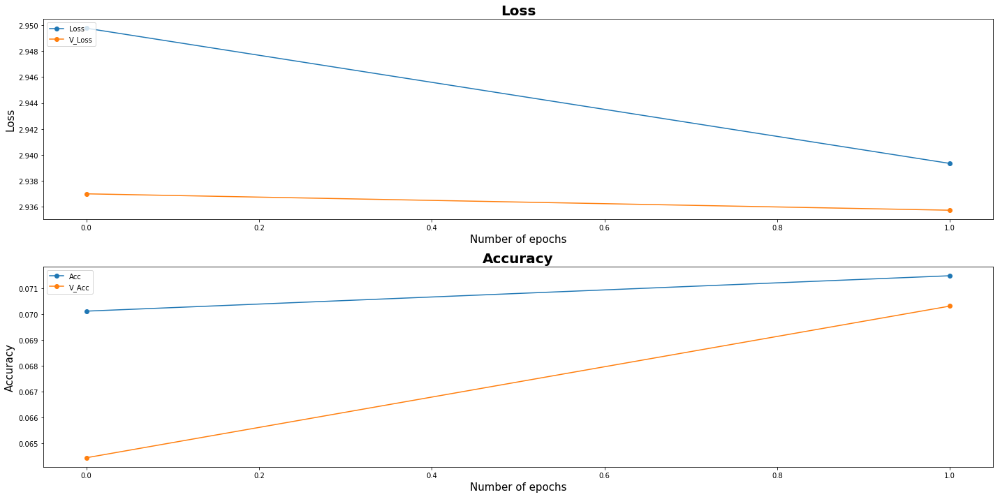

| Epoch [2] | Step [200] | lr [0.020000] | Loss: [2.9899] | Acc: [0.0391] | Time: 0.0s
| Epoch [2] | Validation | Step [0] |  Loss: [2.9654] | Acc: [0.0469] | Time: 0.0s
| Epoch [2] | Validation | Step [1] |  Loss: [2.9190] | Acc: [0.1328] | Time: 0.0s
| Epoch [2] | Validation | Step [2] |  Loss: [2.9118] | Acc: [0.0469] | Time: 0.0s
| Epoch [2] | Validation | Step [3] |  Loss: [2.9214] | Acc: [0.0625] | Time: 0.0s


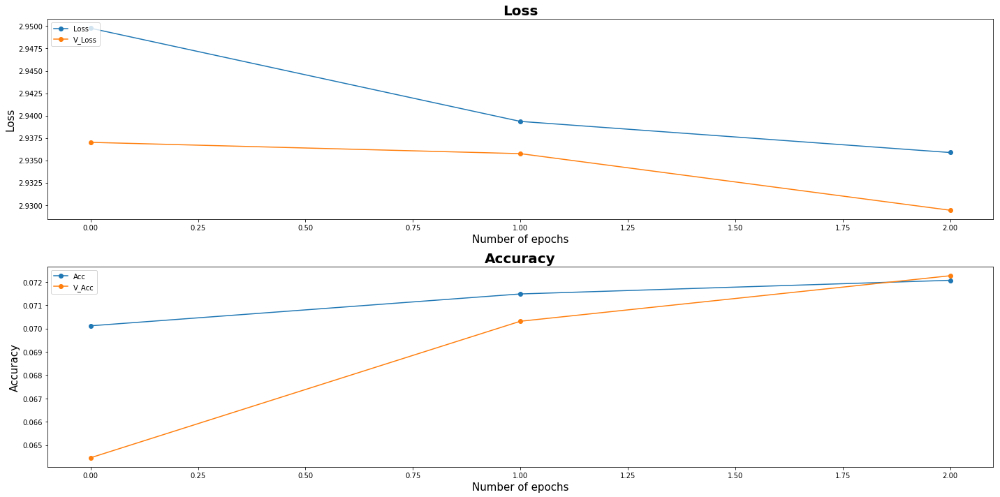

| Epoch [3] | Step [250] | lr [0.020000] | Loss: [2.9229] | Acc: [0.0703] | Time: 0.0s
| Epoch [3] | Step [300] | lr [0.020000] | Loss: [2.9854] | Acc: [0.0391] | Time: 0.0s
| Epoch [3] | Validation | Step [0] |  Loss: [2.9586] | Acc: [0.0547] | Time: 0.0s
| Epoch [3] | Validation | Step [1] |  Loss: [2.9093] | Acc: [0.0859] | Time: 0.0s
| Epoch [3] | Validation | Step [2] |  Loss: [2.9281] | Acc: [0.0938] | Time: 0.0s
| Epoch [3] | Validation | Step [3] |  Loss: [2.9584] | Acc: [0.0547] | Time: 0.0s


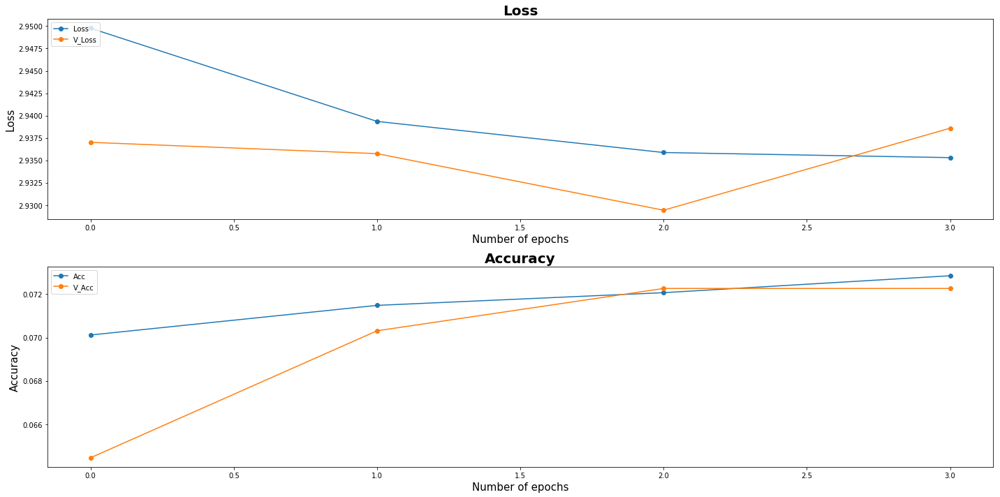

| Epoch [4] | Step [350] | lr [0.020000] | Loss: [2.9211] | Acc: [0.0781] | Time: 0.0s
| Epoch [4] | Step [400] | lr [0.020000] | Loss: [2.9352] | Acc: [0.0703] | Time: 0.0s
| Epoch [4] | Validation | Step [0] |  Loss: [2.9385] | Acc: [0.0859] | Time: 0.0s
| Epoch [4] | Validation | Step [1] |  Loss: [2.9038] | Acc: [0.0781] | Time: 0.0s
| Epoch [4] | Validation | Step [2] |  Loss: [2.9624] | Acc: [0.0547] | Time: 0.0s
| Epoch [4] | Validation | Step [3] |  Loss: [2.9353] | Acc: [0.0312] | Time: 0.0s


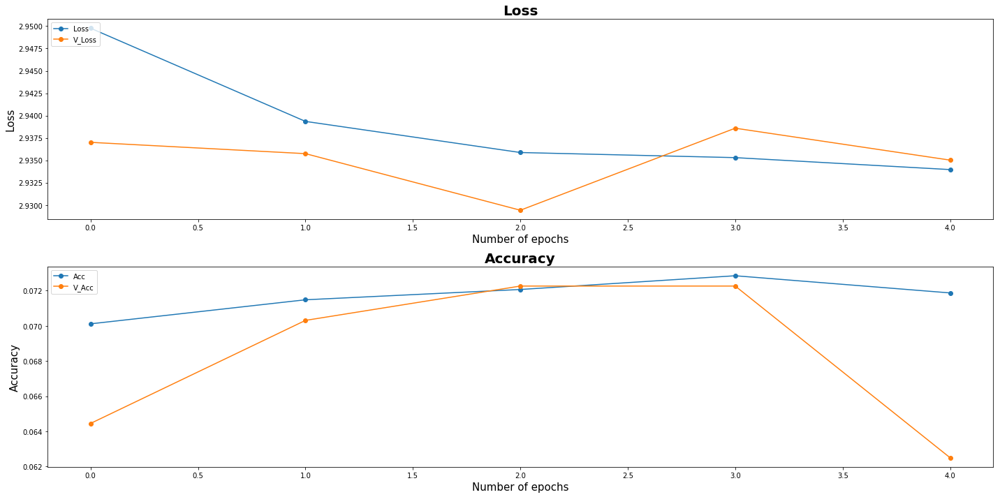

| Epoch [5] | Step [450] | lr [0.020000] | Loss: [2.9208] | Acc: [0.1094] | Time: 0.0s
| Epoch [5] | Validation | Step [0] |  Loss: [2.9449] | Acc: [0.0859] | Time: 0.0s
| Epoch [5] | Validation | Step [1] |  Loss: [2.9295] | Acc: [0.0547] | Time: 0.0s
| Epoch [5] | Validation | Step [2] |  Loss: [2.9316] | Acc: [0.0703] | Time: 0.0s
| Epoch [5] | Validation | Step [3] |  Loss: [2.9398] | Acc: [0.0469] | Time: 0.0s


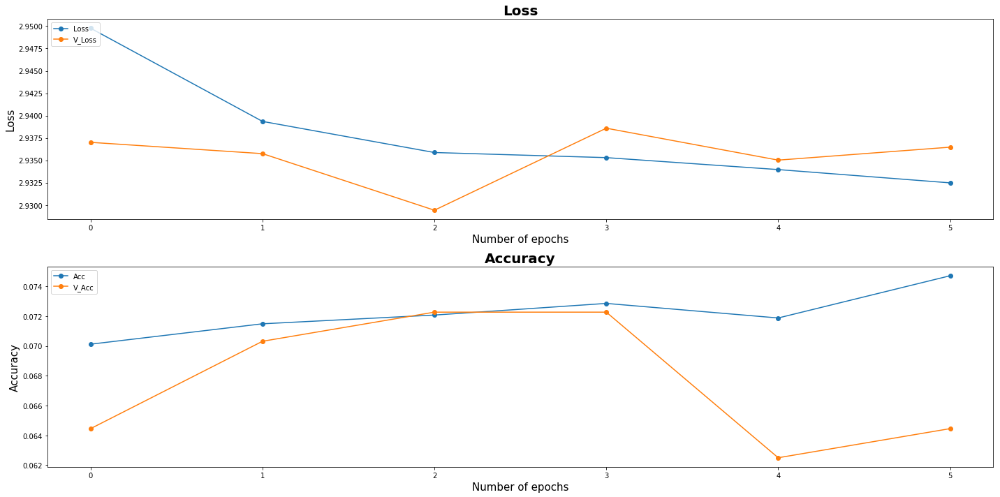

| Epoch [6] | Step [500] | lr [0.020000] | Loss: [2.9641] | Acc: [0.0703] | Time: 0.0s
| Epoch [6] | Step [550] | lr [0.020000] | Loss: [2.9534] | Acc: [0.0625] | Time: 0.0s
| Epoch [6] | Validation | Step [0] |  Loss: [2.9222] | Acc: [0.0703] | Time: 0.0s
| Epoch [6] | Validation | Step [1] |  Loss: [2.9109] | Acc: [0.0938] | Time: 0.0s
| Epoch [6] | Validation | Step [2] |  Loss: [2.9436] | Acc: [0.0547] | Time: 0.0s
| Epoch [6] | Validation | Step [3] |  Loss: [2.9416] | Acc: [0.0391] | Time: 0.0s


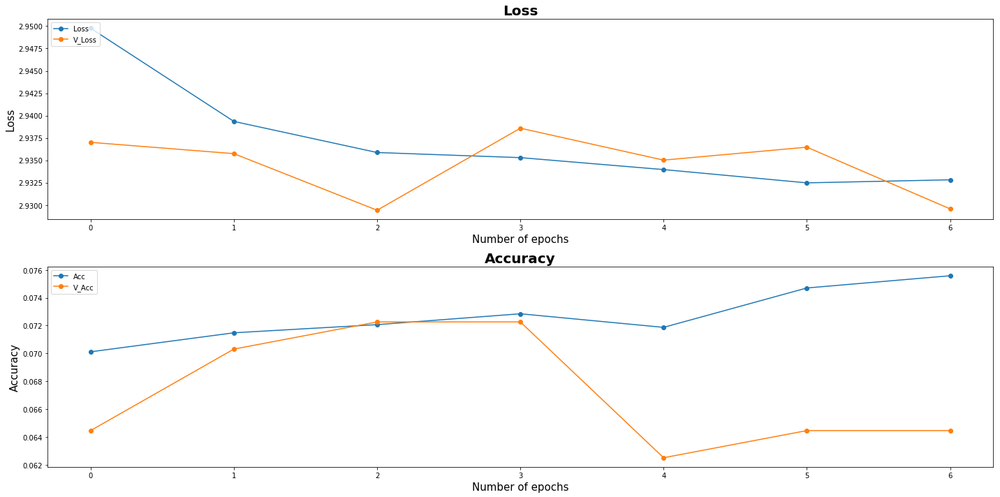

| Epoch [7] | Step [600] | lr [0.020000] | Loss: [2.9077] | Acc: [0.1016] | Time: 0.0s
| Epoch [7] | Validation | Step [0] |  Loss: [2.8914] | Acc: [0.0859] | Time: 0.0s
| Epoch [7] | Validation | Step [1] |  Loss: [2.9350] | Acc: [0.0234] | Time: 0.0s
| Epoch [7] | Validation | Step [2] |  Loss: [2.9141] | Acc: [0.0469] | Time: 0.0s
| Epoch [7] | Validation | Step [3] |  Loss: [2.9601] | Acc: [0.0703] | Time: 0.0s


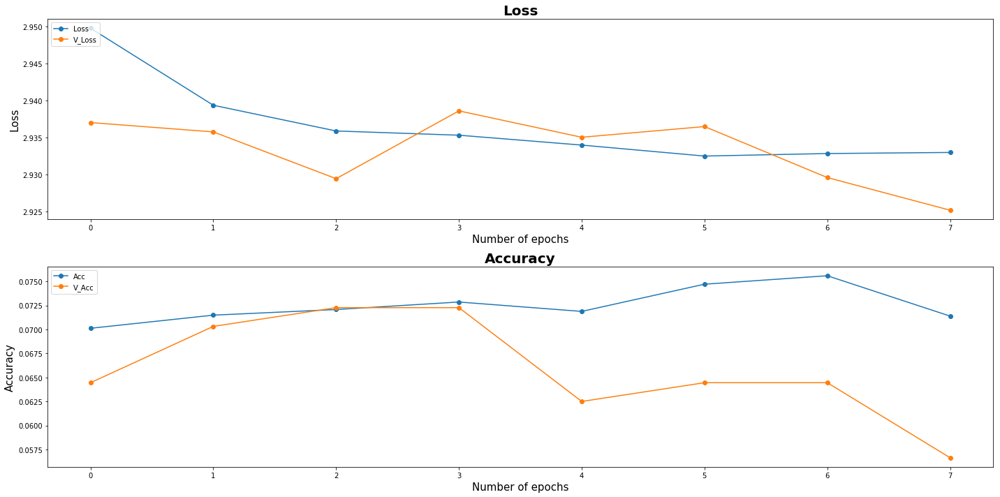

| Epoch [8] | Step [650] | lr [0.020000] | Loss: [2.9501] | Acc: [0.0625] | Time: 0.0s
| Epoch [8] | Step [700] | lr [0.020000] | Loss: [2.9451] | Acc: [0.0781] | Time: 0.0s
| Epoch [8] | Validation | Step [0] |  Loss: [2.9435] | Acc: [0.0859] | Time: 0.0s
| Epoch [8] | Validation | Step [1] |  Loss: [2.9353] | Acc: [0.0625] | Time: 0.0s
| Epoch [8] | Validation | Step [2] |  Loss: [2.9558] | Acc: [0.0469] | Time: 0.0s
| Epoch [8] | Validation | Step [3] |  Loss: [2.9079] | Acc: [0.1094] | Time: 0.0s


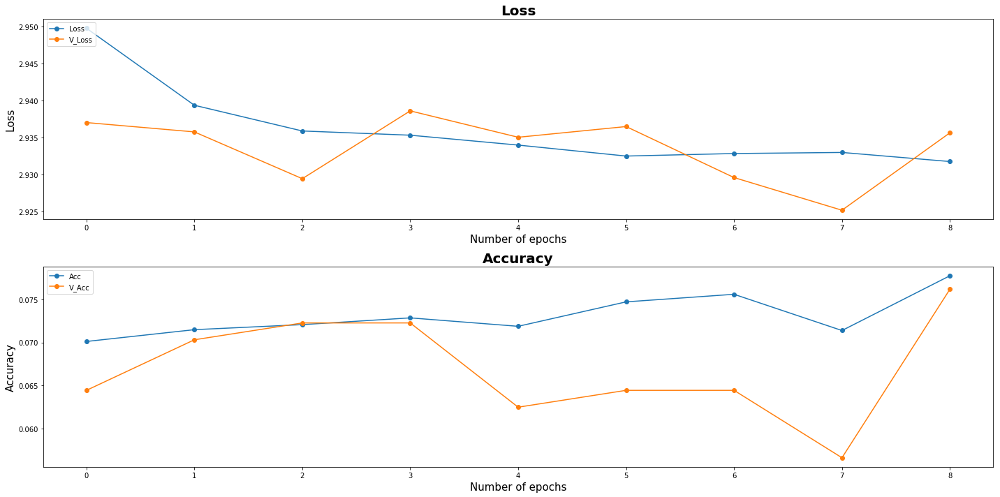

| Epoch [9] | Step [750] | lr [0.020000] | Loss: [2.9334] | Acc: [0.0469] | Time: 0.0s
| Epoch [9] | Step [800] | lr [0.020000] | Loss: [2.9662] | Acc: [0.0625] | Time: 0.0s
| Epoch [9] | Validation | Step [0] |  Loss: [2.9510] | Acc: [0.0859] | Time: 0.0s
| Epoch [9] | Validation | Step [1] |  Loss: [2.9410] | Acc: [0.0625] | Time: 0.0s
| Epoch [9] | Validation | Step [2] |  Loss: [2.9344] | Acc: [0.0781] | Time: 0.0s
| Epoch [9] | Validation | Step [3] |  Loss: [2.9408] | Acc: [0.0391] | Time: 0.0s


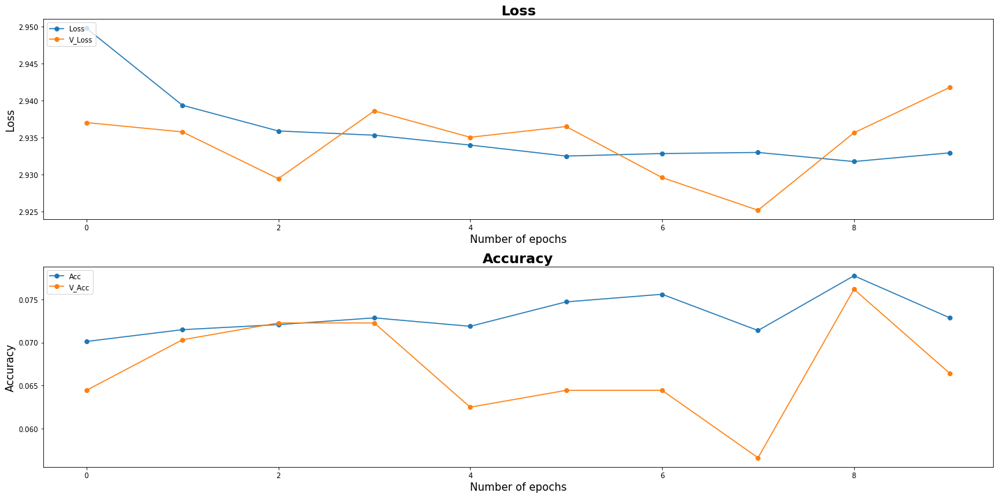

Model Saved
| Epoch [10] | Step [850] | lr [0.020000] | Loss: [2.9476] | Acc: [0.0156] | Time: 0.0s
| Epoch [10] | Validation | Step [0] |  Loss: [2.9771] | Acc: [0.0547] | Time: 0.0s
| Epoch [10] | Validation | Step [1] |  Loss: [2.9434] | Acc: [0.0625] | Time: 0.0s
| Epoch [10] | Validation | Step [2] |  Loss: [2.9034] | Acc: [0.0938] | Time: 0.0s
| Epoch [10] | Validation | Step [3] |  Loss: [2.9071] | Acc: [0.0938] | Time: 0.0s


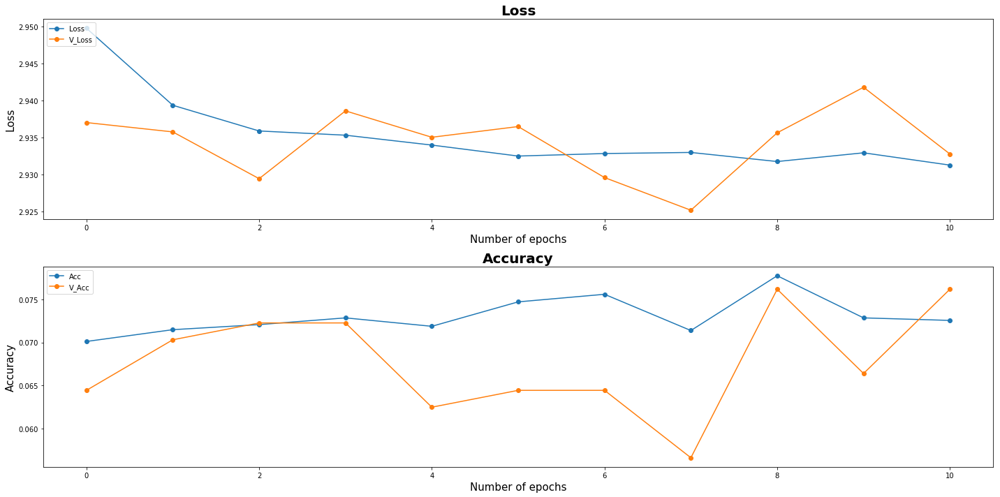

| Epoch [11] | Step [900] | lr [0.020000] | Loss: [2.9171] | Acc: [0.0938] | Time: 0.0s
| Epoch [11] | Step [950] | lr [0.020000] | Loss: [2.9485] | Acc: [0.0625] | Time: 0.0s
| Epoch [11] | Validation | Step [0] |  Loss: [2.9375] | Acc: [0.0859] | Time: 0.0s
| Epoch [11] | Validation | Step [1] |  Loss: [2.9805] | Acc: [0.0469] | Time: 0.0s
| Epoch [11] | Validation | Step [2] |  Loss: [2.9464] | Acc: [0.0859] | Time: 0.0s
| Epoch [11] | Validation | Step [3] |  Loss: [2.9164] | Acc: [0.0547] | Time: 0.0s


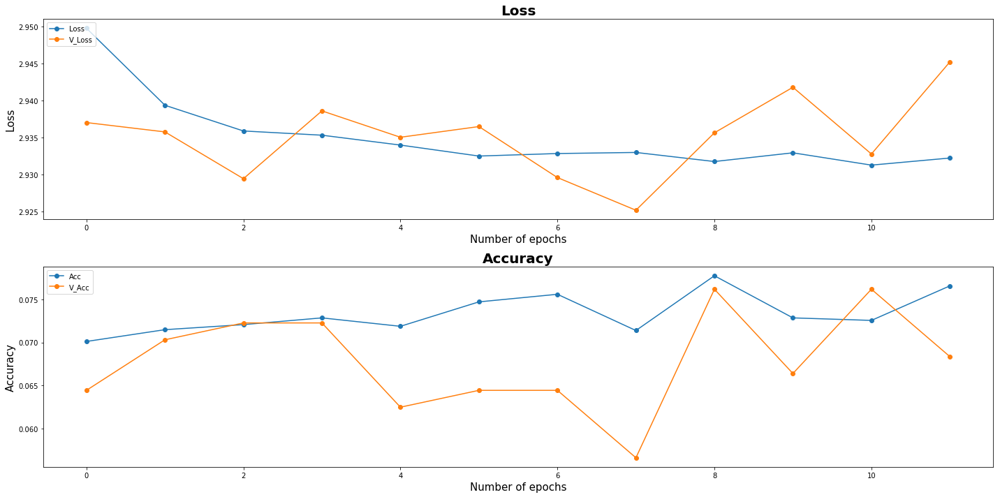

| Epoch [12] | Step [1000] | lr [0.020000] | Loss: [2.9197] | Acc: [0.0391] | Time: 0.0s
| Epoch [12] | Validation | Step [0] |  Loss: [2.9539] | Acc: [0.0312] | Time: 0.0s
| Epoch [12] | Validation | Step [1] |  Loss: [2.9586] | Acc: [0.0547] | Time: 0.0s
| Epoch [12] | Validation | Step [2] |  Loss: [2.9274] | Acc: [0.1016] | Time: 0.0s
| Epoch [12] | Validation | Step [3] |  Loss: [2.8924] | Acc: [0.0625] | Time: 0.0s


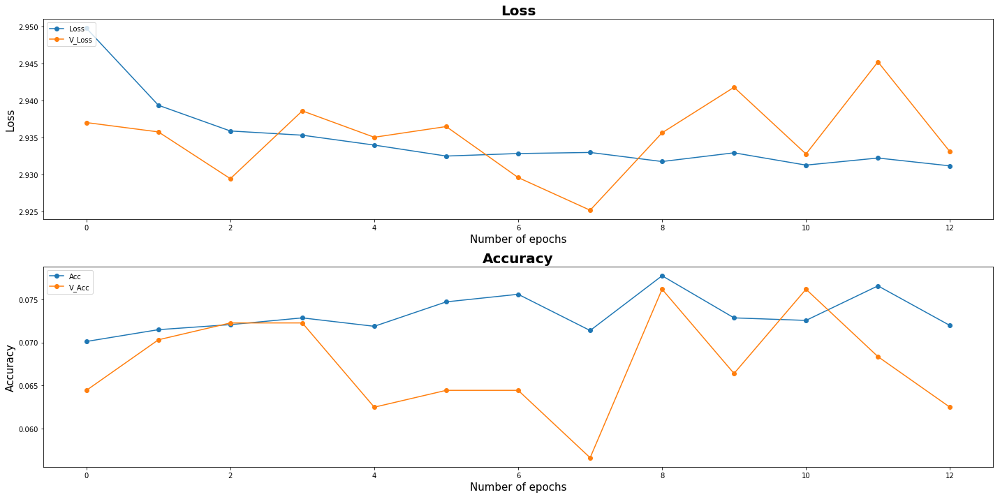

| Epoch [13] | Step [1050] | lr [0.020000] | Loss: [2.9534] | Acc: [0.0312] | Time: 0.0s
| Epoch [13] | Step [1100] | lr [0.020000] | Loss: [2.9509] | Acc: [0.0625] | Time: 0.0s
| Epoch [13] | Validation | Step [0] |  Loss: [2.9264] | Acc: [0.0781] | Time: 0.0s
| Epoch [13] | Validation | Step [1] |  Loss: [2.9149] | Acc: [0.0859] | Time: 0.0s
| Epoch [13] | Validation | Step [2] |  Loss: [2.9382] | Acc: [0.0703] | Time: 0.0s
| Epoch [13] | Validation | Step [3] |  Loss: [2.9525] | Acc: [0.0625] | Time: 0.0s


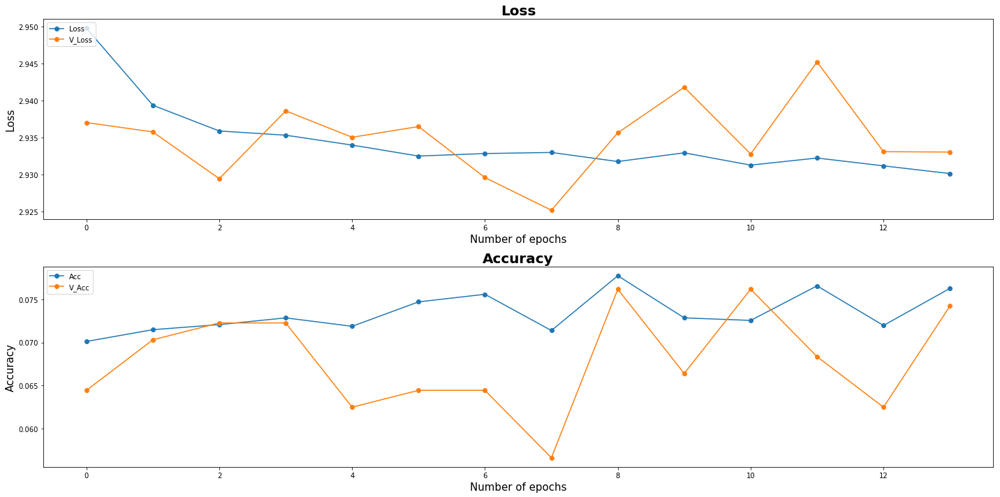

| Epoch [14] | Step [1150] | lr [0.020000] | Loss: [2.9357] | Acc: [0.0781] | Time: 0.0s
| Epoch [14] | Step [1200] | lr [0.020000] | Loss: [2.9417] | Acc: [0.0547] | Time: 0.0s
| Epoch [14] | Validation | Step [0] |  Loss: [2.9610] | Acc: [0.0391] | Time: 0.0s
| Epoch [14] | Validation | Step [1] |  Loss: [2.9454] | Acc: [0.0391] | Time: 0.0s
| Epoch [14] | Validation | Step [2] |  Loss: [2.9308] | Acc: [0.0859] | Time: 0.0s
| Epoch [14] | Validation | Step [3] |  Loss: [2.9208] | Acc: [0.0859] | Time: 0.0s


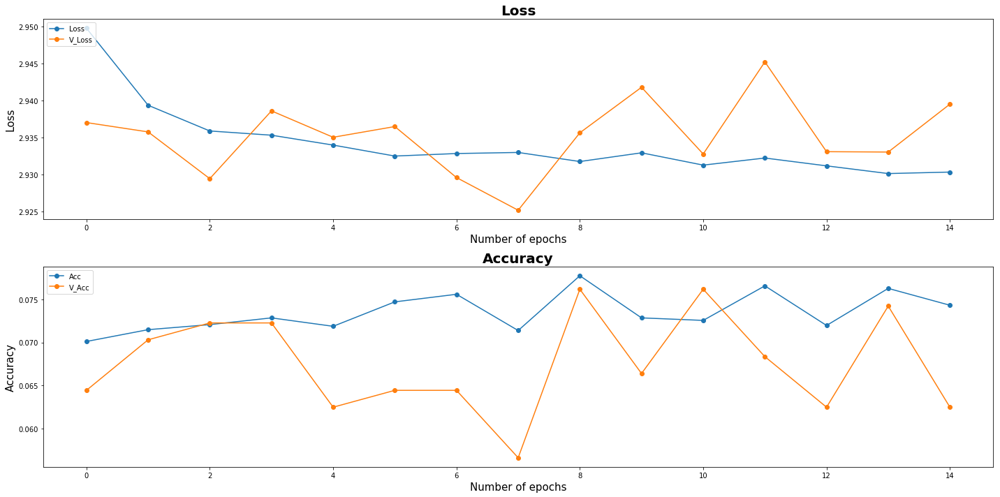

| Epoch [15] | Step [1250] | lr [0.020000] | Loss: [2.8892] | Acc: [0.1172] | Time: 0.0s
| Epoch [15] | Validation | Step [0] |  Loss: [2.9421] | Acc: [0.0547] | Time: 0.0s
| Epoch [15] | Validation | Step [1] |  Loss: [2.9233] | Acc: [0.0781] | Time: 0.0s
| Epoch [15] | Validation | Step [2] |  Loss: [2.9075] | Acc: [0.1094] | Time: 0.0s
| Epoch [15] | Validation | Step [3] |  Loss: [2.9447] | Acc: [0.0469] | Time: 0.0s


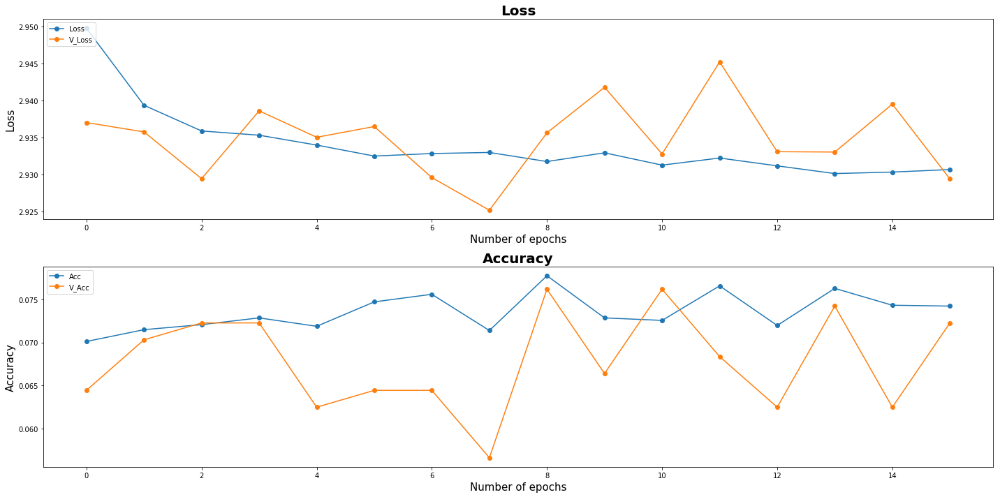

| Epoch [16] | Step [1300] | lr [0.020000] | Loss: [2.9152] | Acc: [0.0938] | Time: 0.0s
| Epoch [16] | Step [1350] | lr [0.020000] | Loss: [2.9459] | Acc: [0.0391] | Time: 0.0s
| Epoch [16] | Validation | Step [0] |  Loss: [2.9310] | Acc: [0.1094] | Time: 0.0s
| Epoch [16] | Validation | Step [1] |  Loss: [2.9507] | Acc: [0.0547] | Time: 0.0s
| Epoch [16] | Validation | Step [2] |  Loss: [2.9148] | Acc: [0.0625] | Time: 0.0s
| Epoch [16] | Validation | Step [3] |  Loss: [2.9257] | Acc: [0.0781] | Time: 0.0s


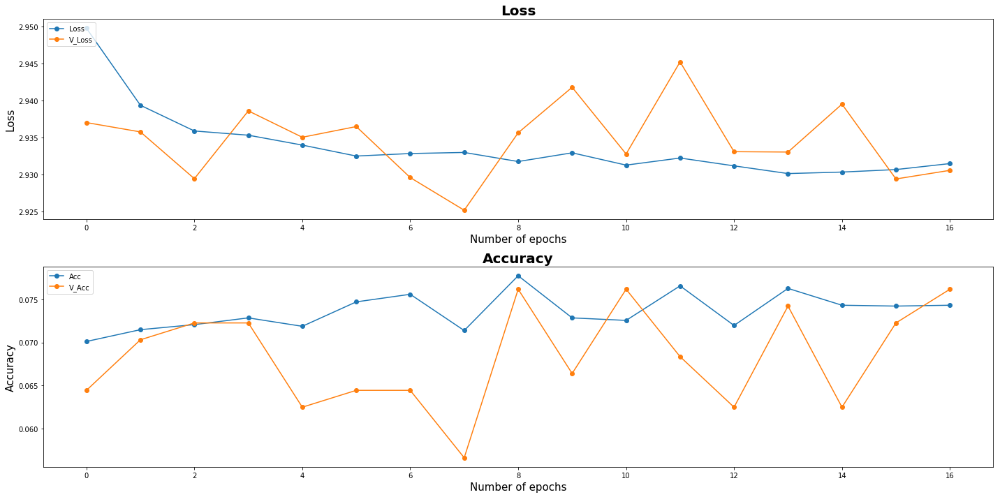

| Epoch [17] | Step [1400] | lr [0.020000] | Loss: [2.8948] | Acc: [0.0938] | Time: 0.0s
| Epoch [17] | Validation | Step [0] |  Loss: [2.9523] | Acc: [0.0938] | Time: 0.0s
| Epoch [17] | Validation | Step [1] |  Loss: [2.9432] | Acc: [0.0703] | Time: 0.0s
| Epoch [17] | Validation | Step [2] |  Loss: [2.9235] | Acc: [0.0234] | Time: 0.0s
| Epoch [17] | Validation | Step [3] |  Loss: [2.9220] | Acc: [0.0703] | Time: 0.0s


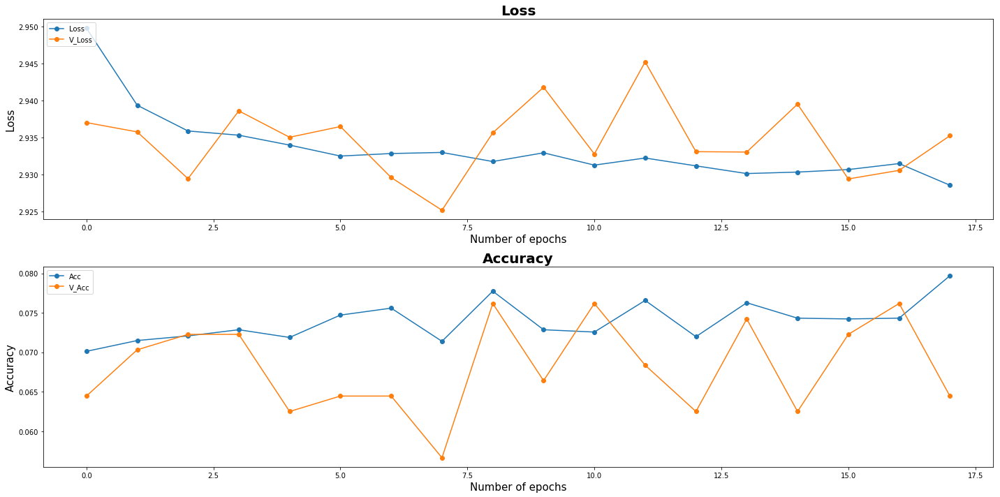

| Epoch [18] | Step [1450] | lr [0.020000] | Loss: [2.9221] | Acc: [0.1172] | Time: 0.0s
| Epoch [18] | Step [1500] | lr [0.020000] | Loss: [2.9386] | Acc: [0.0625] | Time: 0.0s
| Epoch [18] | Validation | Step [0] |  Loss: [2.9410] | Acc: [0.0703] | Time: 0.0s
| Epoch [18] | Validation | Step [1] |  Loss: [2.9275] | Acc: [0.0703] | Time: 0.0s
| Epoch [18] | Validation | Step [2] |  Loss: [2.9053] | Acc: [0.0859] | Time: 0.0s
| Epoch [18] | Validation | Step [3] |  Loss: [2.9621] | Acc: [0.0703] | Time: 0.0s


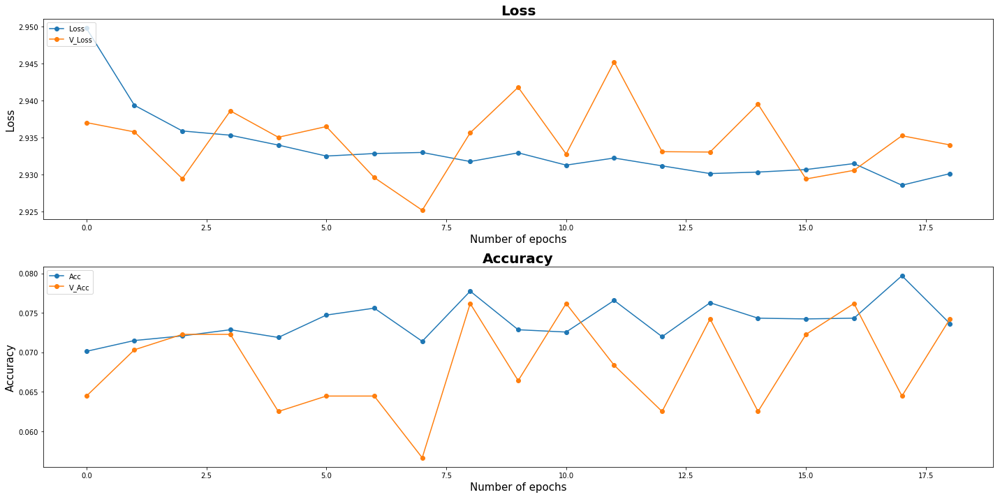

| Epoch [19] | Step [1550] | lr [0.020000] | Loss: [2.9591] | Acc: [0.0625] | Time: 0.0s
| Epoch [19] | Step [1600] | lr [0.020000] | Loss: [2.9193] | Acc: [0.0938] | Time: 0.0s
| Epoch [19] | Validation | Step [0] |  Loss: [2.9444] | Acc: [0.0781] | Time: 0.0s
| Epoch [19] | Validation | Step [1] |  Loss: [2.9151] | Acc: [0.0938] | Time: 0.0s
| Epoch [19] | Validation | Step [2] |  Loss: [2.9563] | Acc: [0.0703] | Time: 0.0s
| Epoch [19] | Validation | Step [3] |  Loss: [2.9311] | Acc: [0.0391] | Time: 0.0s


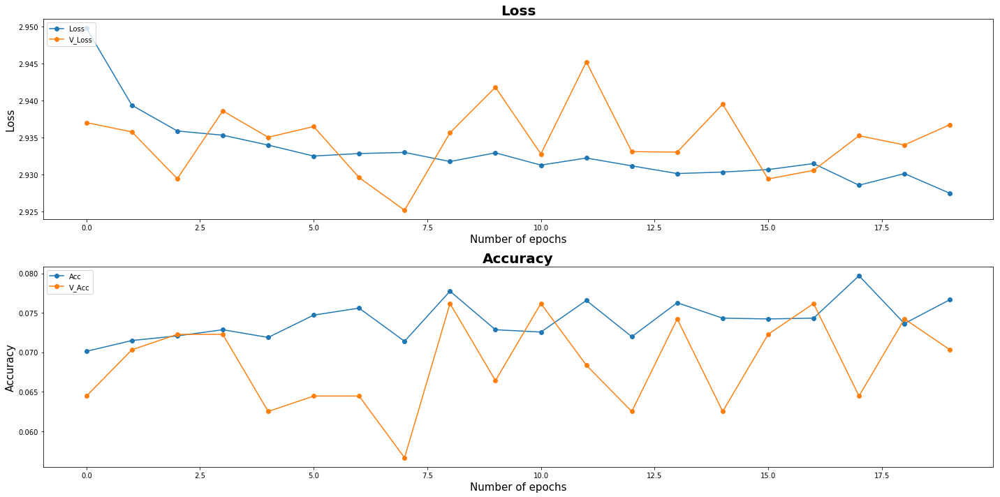

Model Saved
| Epoch [20] | Step [1650] | lr [0.020000] | Loss: [2.9044] | Acc: [0.0859] | Time: 0.0s
| Epoch [20] | Validation | Step [0] |  Loss: [2.9030] | Acc: [0.0703] | Time: 0.0s
| Epoch [20] | Validation | Step [1] |  Loss: [2.9390] | Acc: [0.0547] | Time: 0.0s
| Epoch [20] | Validation | Step [2] |  Loss: [2.9527] | Acc: [0.0781] | Time: 0.0s
| Epoch [20] | Validation | Step [3] |  Loss: [2.9577] | Acc: [0.0469] | Time: 0.0s


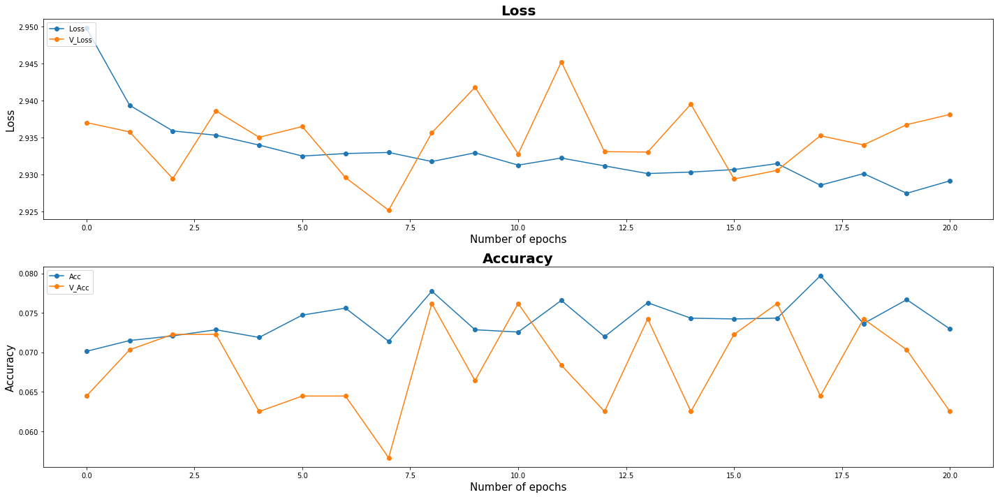

| Epoch [21] | Step [1700] | lr [0.020000] | Loss: [2.8966] | Acc: [0.1016] | Time: 0.0s
| Epoch [21] | Step [1750] | lr [0.020000] | Loss: [2.9518] | Acc: [0.0859] | Time: 0.0s
| Epoch [21] | Validation | Step [0] |  Loss: [2.9463] | Acc: [0.0703] | Time: 0.0s
| Epoch [21] | Validation | Step [1] |  Loss: [2.9348] | Acc: [0.0859] | Time: 0.0s
| Epoch [21] | Validation | Step [2] |  Loss: [2.9308] | Acc: [0.0859] | Time: 0.0s
| Epoch [21] | Validation | Step [3] |  Loss: [2.9423] | Acc: [0.0625] | Time: 0.0s


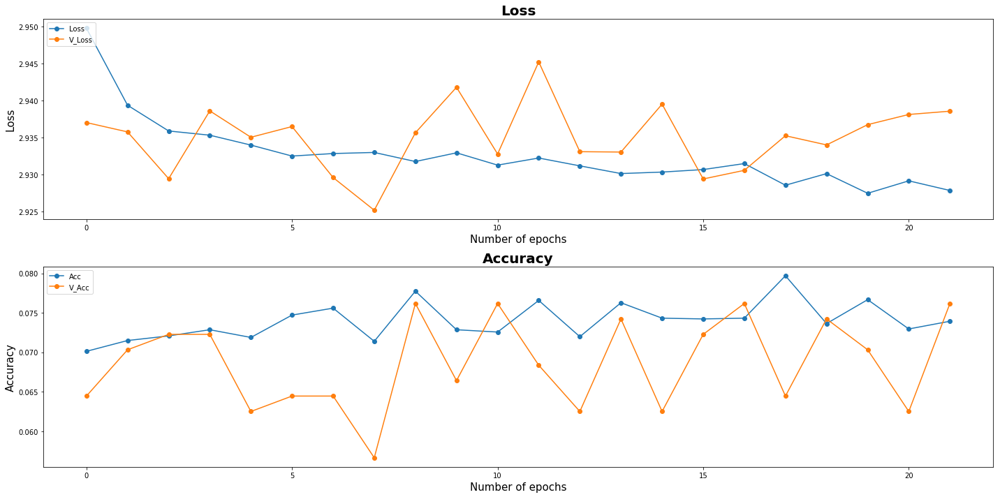

| Epoch [22] | Step [1800] | lr [0.020000] | Loss: [2.9397] | Acc: [0.0625] | Time: 0.0s
| Epoch [22] | Validation | Step [0] |  Loss: [2.9376] | Acc: [0.0625] | Time: 0.0s
| Epoch [22] | Validation | Step [1] |  Loss: [2.9360] | Acc: [0.0469] | Time: 0.0s
| Epoch [22] | Validation | Step [2] |  Loss: [2.9307] | Acc: [0.0859] | Time: 0.0s
| Epoch [22] | Validation | Step [3] |  Loss: [2.9197] | Acc: [0.0781] | Time: 0.0s


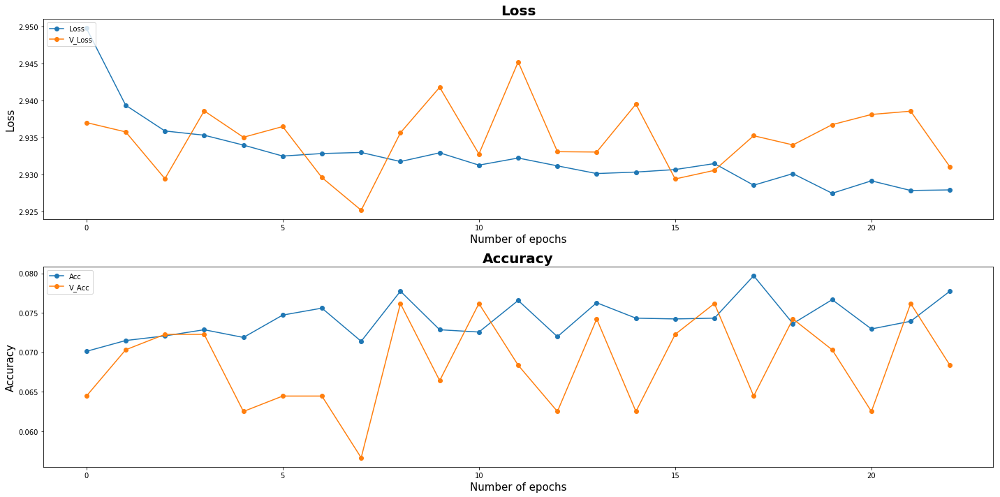

| Epoch [23] | Step [1850] | lr [0.020000] | Loss: [2.9419] | Acc: [0.0312] | Time: 0.0s
| Epoch [23] | Step [1900] | lr [0.020000] | Loss: [2.9642] | Acc: [0.0703] | Time: 0.0s
| Epoch [23] | Validation | Step [0] |  Loss: [2.9203] | Acc: [0.0703] | Time: 0.0s
| Epoch [23] | Validation | Step [1] |  Loss: [2.9232] | Acc: [0.0547] | Time: 0.0s
| Epoch [23] | Validation | Step [2] |  Loss: [2.9604] | Acc: [0.0625] | Time: 0.0s
| Epoch [23] | Validation | Step [3] |  Loss: [2.9522] | Acc: [0.0469] | Time: 0.0s


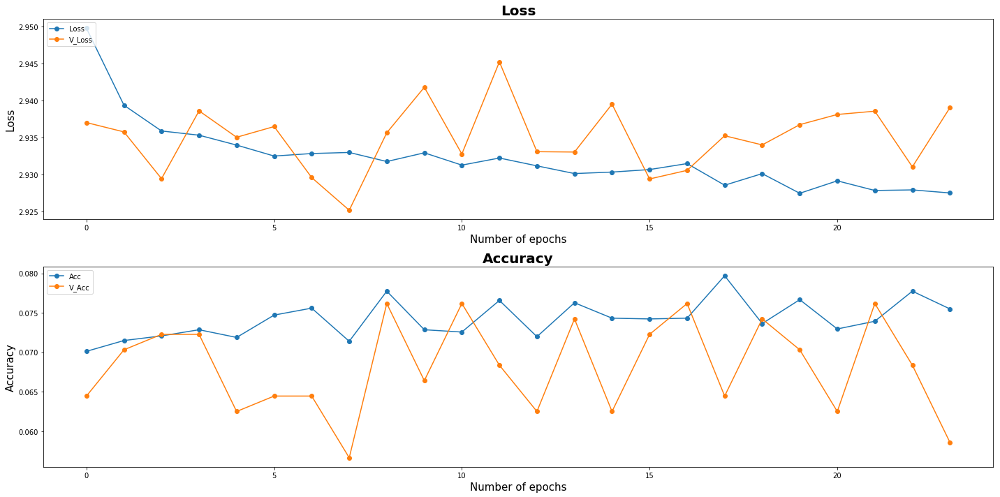

| Epoch [24] | Step [1950] | lr [0.020000] | Loss: [2.9382] | Acc: [0.0938] | Time: 0.0s
| Epoch [24] | Step [2000] | lr [0.020000] | Loss: [2.9486] | Acc: [0.0703] | Time: 0.0s
| Epoch [24] | Validation | Step [0] |  Loss: [2.9354] | Acc: [0.0781] | Time: 0.0s
| Epoch [24] | Validation | Step [1] |  Loss: [2.9739] | Acc: [0.0547] | Time: 0.0s
| Epoch [24] | Validation | Step [2] |  Loss: [2.9022] | Acc: [0.0938] | Time: 0.0s
| Epoch [24] | Validation | Step [3] |  Loss: [2.9494] | Acc: [0.0469] | Time: 0.0s


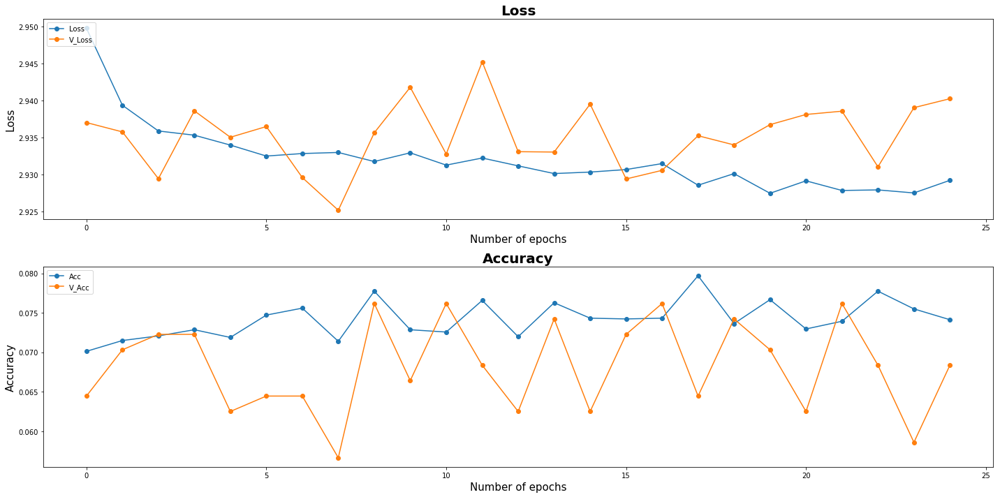

| Epoch [25] | Step [2050] | lr [0.020000] | Loss: [2.9023] | Acc: [0.0469] | Time: 0.0s
| Epoch [25] | Validation | Step [0] |  Loss: [2.9718] | Acc: [0.0312] | Time: 0.0s
| Epoch [25] | Validation | Step [1] |  Loss: [2.9186] | Acc: [0.1016] | Time: 0.0s
| Epoch [25] | Validation | Step [2] |  Loss: [2.8818] | Acc: [0.1172] | Time: 0.0s
| Epoch [25] | Validation | Step [3] |  Loss: [2.9594] | Acc: [0.0234] | Time: 0.0s


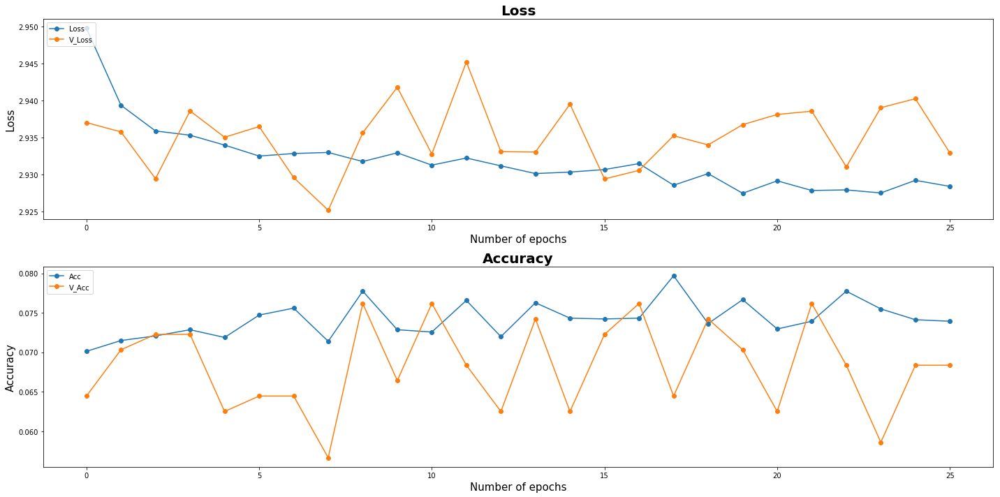

| Epoch [26] | Step [2100] | lr [0.020000] | Loss: [2.9456] | Acc: [0.0938] | Time: 0.0s
| Epoch [26] | Step [2150] | lr [0.020000] | Loss: [2.9343] | Acc: [0.1016] | Time: 0.0s
| Epoch [26] | Validation | Step [0] |  Loss: [2.9377] | Acc: [0.0781] | Time: 0.0s
| Epoch [26] | Validation | Step [1] |  Loss: [2.9478] | Acc: [0.0469] | Time: 0.0s
| Epoch [26] | Validation | Step [2] |  Loss: [2.9032] | Acc: [0.0859] | Time: 0.0s
| Epoch [26] | Validation | Step [3] |  Loss: [2.9464] | Acc: [0.0312] | Time: 0.0s


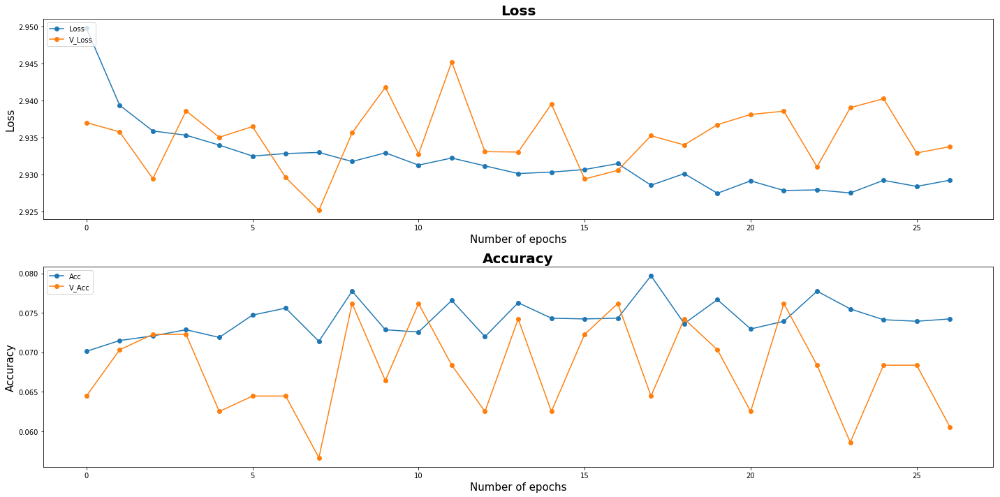

| Epoch [27] | Step [2200] | lr [0.020000] | Loss: [2.9531] | Acc: [0.0703] | Time: 0.0s
| Epoch [27] | Validation | Step [0] |  Loss: [2.9344] | Acc: [0.0312] | Time: 0.0s
| Epoch [27] | Validation | Step [1] |  Loss: [2.9390] | Acc: [0.0547] | Time: 0.0s
| Epoch [27] | Validation | Step [2] |  Loss: [2.9284] | Acc: [0.0781] | Time: 0.0s
| Epoch [27] | Validation | Step [3] |  Loss: [2.9454] | Acc: [0.0703] | Time: 0.0s


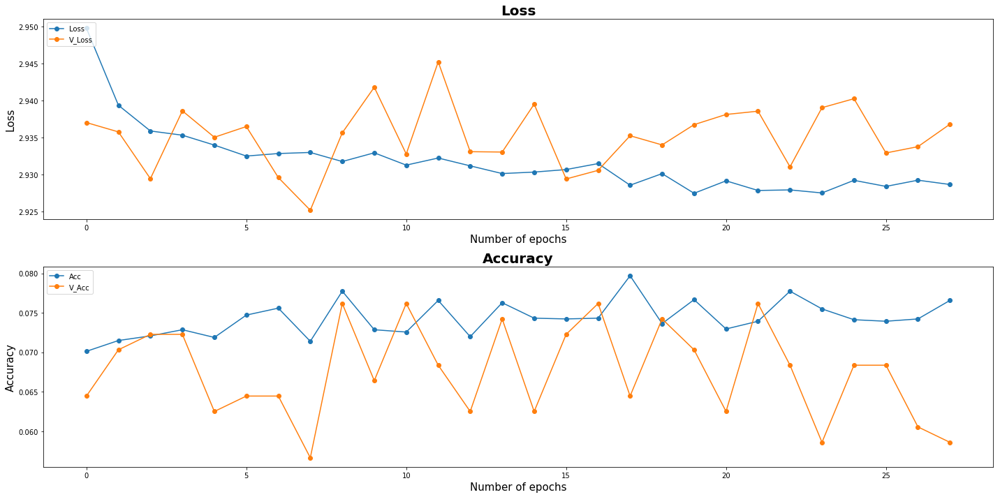

| Epoch [28] | Step [2250] | lr [0.020000] | Loss: [2.9454] | Acc: [0.0781] | Time: 0.0s
| Epoch [28] | Step [2300] | lr [0.020000] | Loss: [2.9124] | Acc: [0.0547] | Time: 0.0s
| Epoch [28] | Validation | Step [0] |  Loss: [2.9122] | Acc: [0.1328] | Time: 0.0s
| Epoch [28] | Validation | Step [1] |  Loss: [2.9224] | Acc: [0.0625] | Time: 0.0s
| Epoch [28] | Validation | Step [2] |  Loss: [2.9576] | Acc: [0.0156] | Time: 0.0s
| Epoch [28] | Validation | Step [3] |  Loss: [2.9395] | Acc: [0.0391] | Time: 0.0s


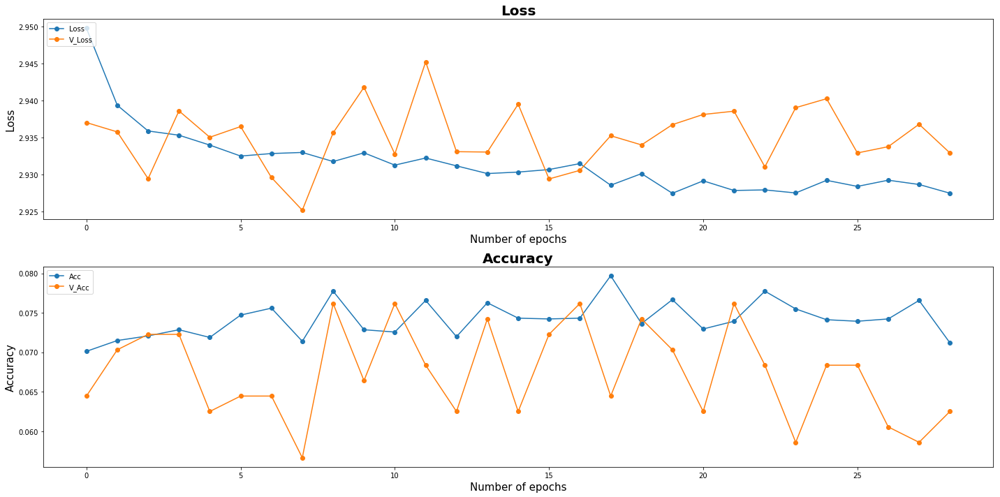

| Epoch [29] | Step [2350] | lr [0.014000] | Loss: [2.8832] | Acc: [0.1172] | Time: 0.0s
| Epoch [29] | Step [2400] | lr [0.014000] | Loss: [2.9649] | Acc: [0.0625] | Time: 0.0s
| Epoch [29] | Validation | Step [0] |  Loss: [2.9592] | Acc: [0.0547] | Time: 0.0s
| Epoch [29] | Validation | Step [1] |  Loss: [2.9276] | Acc: [0.0469] | Time: 0.0s
| Epoch [29] | Validation | Step [2] |  Loss: [2.9255] | Acc: [0.1016] | Time: 0.0s
| Epoch [29] | Validation | Step [3] |  Loss: [2.9298] | Acc: [0.0625] | Time: 0.0s


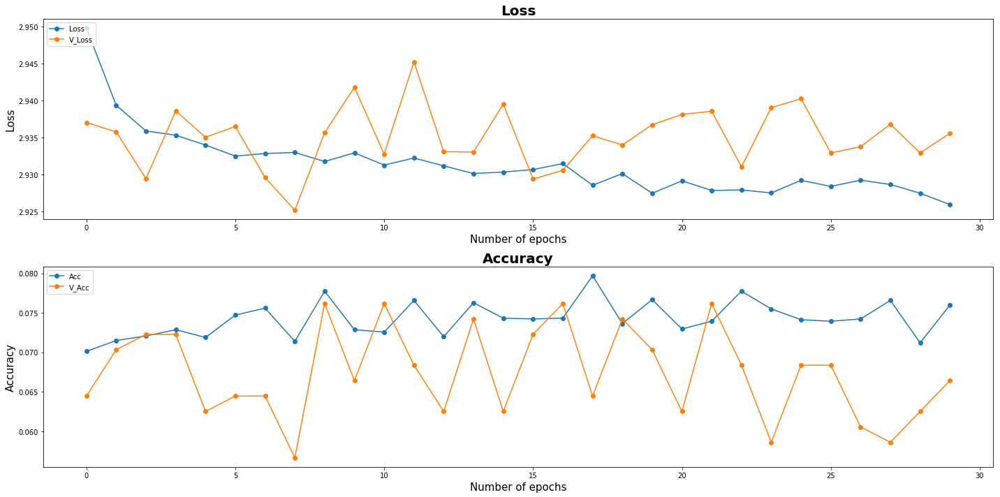

Model Saved
| Epoch [30] | Step [2450] | lr [0.014000] | Loss: [2.9039] | Acc: [0.0938] | Time: 0.0s
| Epoch [30] | Validation | Step [0] |  Loss: [2.9474] | Acc: [0.0391] | Time: 0.0s
| Epoch [30] | Validation | Step [1] |  Loss: [2.9407] | Acc: [0.0781] | Time: 0.0s
| Epoch [30] | Validation | Step [2] |  Loss: [2.9240] | Acc: [0.0859] | Time: 0.0s
| Epoch [30] | Validation | Step [3] |  Loss: [2.9523] | Acc: [0.0469] | Time: 0.0s


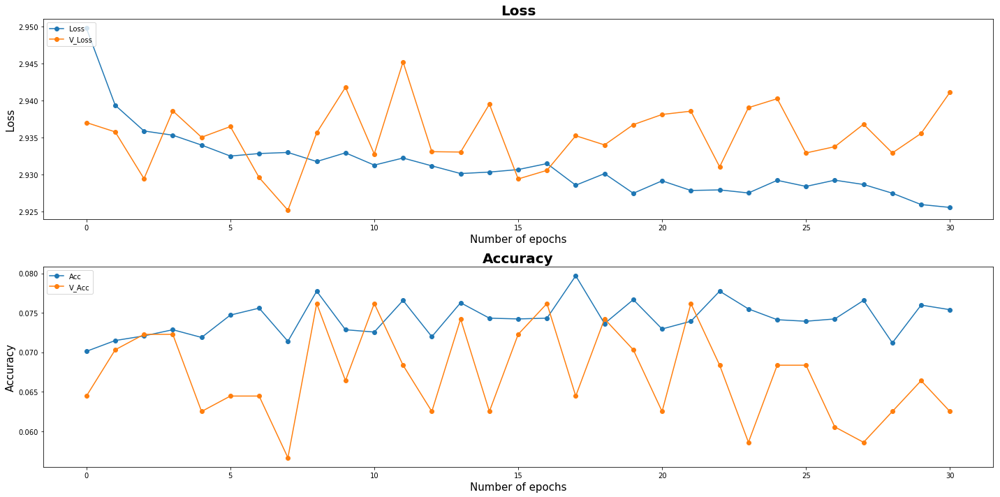

| Epoch [31] | Step [2500] | lr [0.014000] | Loss: [2.9020] | Acc: [0.0938] | Time: 0.0s
| Epoch [31] | Step [2550] | lr [0.014000] | Loss: [2.9438] | Acc: [0.0781] | Time: 0.0s
| Epoch [31] | Validation | Step [0] |  Loss: [2.9567] | Acc: [0.0547] | Time: 0.0s
| Epoch [31] | Validation | Step [1] |  Loss: [2.9231] | Acc: [0.0781] | Time: 0.0s
| Epoch [31] | Validation | Step [2] |  Loss: [2.9146] | Acc: [0.0781] | Time: 0.0s
| Epoch [31] | Validation | Step [3] |  Loss: [2.9395] | Acc: [0.0547] | Time: 0.0s


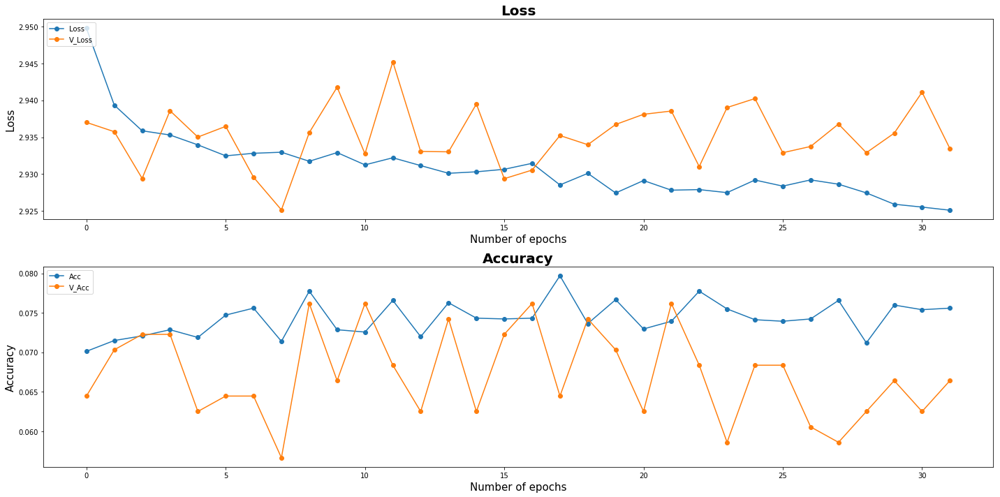

| Epoch [32] | Step [2600] | lr [0.014000] | Loss: [2.9652] | Acc: [0.0391] | Time: 0.0s
| Epoch [32] | Validation | Step [0] |  Loss: [2.9501] | Acc: [0.0547] | Time: 0.0s
| Epoch [32] | Validation | Step [1] |  Loss: [2.9246] | Acc: [0.0859] | Time: 0.0s
| Epoch [32] | Validation | Step [2] |  Loss: [2.9496] | Acc: [0.0234] | Time: 0.0s
| Epoch [32] | Validation | Step [3] |  Loss: [2.9249] | Acc: [0.0703] | Time: 0.0s


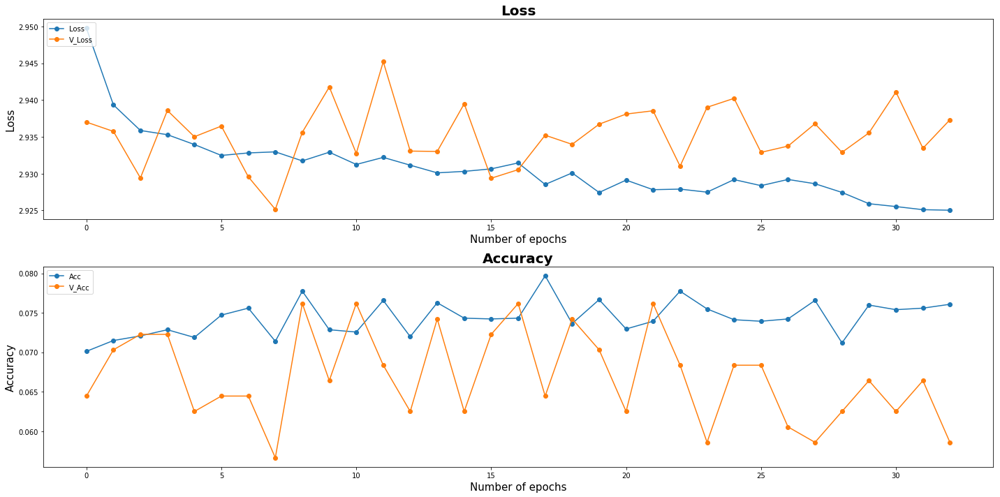

| Epoch [33] | Step [2650] | lr [0.014000] | Loss: [2.9269] | Acc: [0.0703] | Time: 0.0s
| Epoch [33] | Step [2700] | lr [0.014000] | Loss: [2.9018] | Acc: [0.0859] | Time: 0.0s
| Epoch [33] | Validation | Step [0] |  Loss: [2.9614] | Acc: [0.0469] | Time: 0.0s
| Epoch [33] | Validation | Step [1] |  Loss: [2.9419] | Acc: [0.0703] | Time: 0.0s
| Epoch [33] | Validation | Step [2] |  Loss: [2.9395] | Acc: [0.0469] | Time: 0.0s
| Epoch [33] | Validation | Step [3] |  Loss: [2.9330] | Acc: [0.0625] | Time: 0.0s


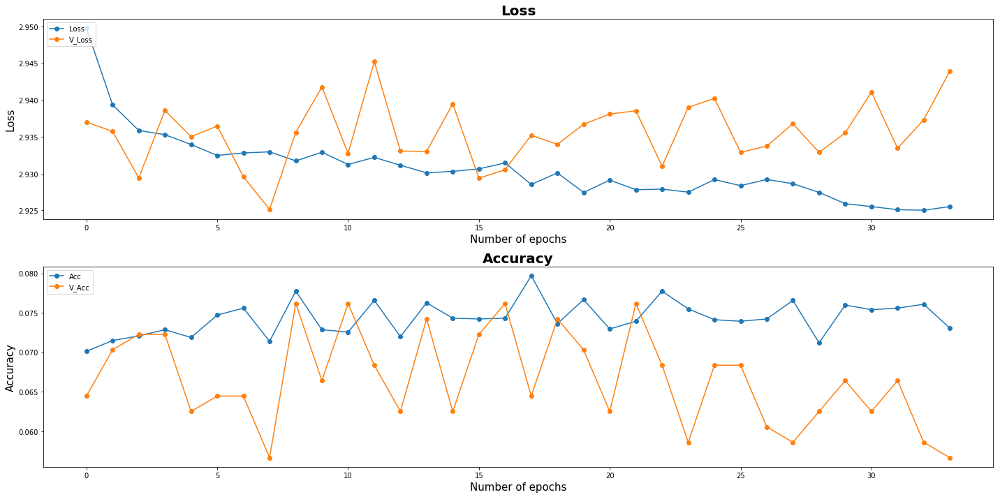

| Epoch [34] | Step [2750] | lr [0.014000] | Loss: [2.9175] | Acc: [0.0938] | Time: 0.0s
| Epoch [34] | Step [2800] | lr [0.014000] | Loss: [2.9181] | Acc: [0.0859] | Time: 0.0s
| Epoch [34] | Validation | Step [0] |  Loss: [2.9572] | Acc: [0.0781] | Time: 0.0s
| Epoch [34] | Validation | Step [1] |  Loss: [2.9334] | Acc: [0.0391] | Time: 0.0s
| Epoch [34] | Validation | Step [2] |  Loss: [2.9110] | Acc: [0.0625] | Time: 0.0s
| Epoch [34] | Validation | Step [3] |  Loss: [2.9409] | Acc: [0.0547] | Time: 0.0s


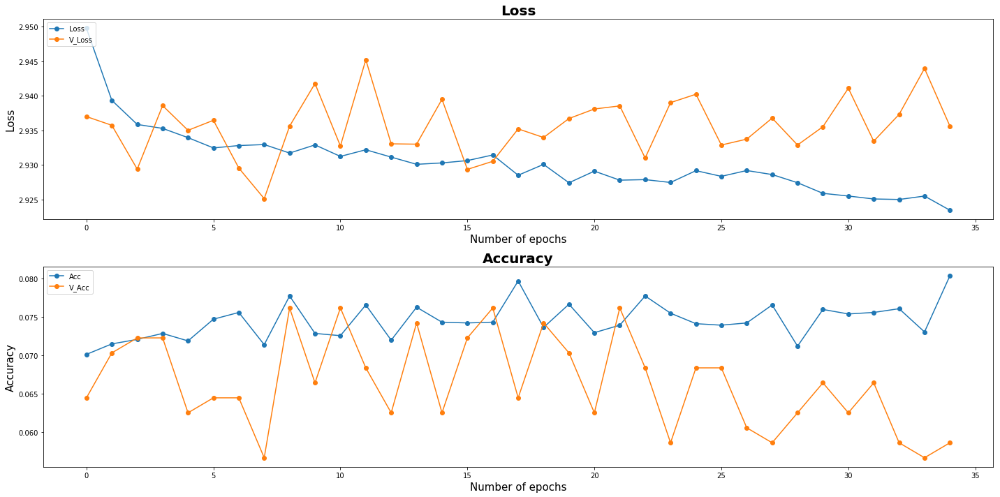

| Epoch [35] | Step [2850] | lr [0.014000] | Loss: [2.8822] | Acc: [0.1250] | Time: 0.0s
| Epoch [35] | Validation | Step [0] |  Loss: [2.9538] | Acc: [0.0547] | Time: 0.0s
| Epoch [35] | Validation | Step [1] |  Loss: [2.9552] | Acc: [0.0625] | Time: 0.0s
| Epoch [35] | Validation | Step [2] |  Loss: [2.9055] | Acc: [0.0781] | Time: 0.0s
| Epoch [35] | Validation | Step [3] |  Loss: [2.9442] | Acc: [0.0312] | Time: 0.0s


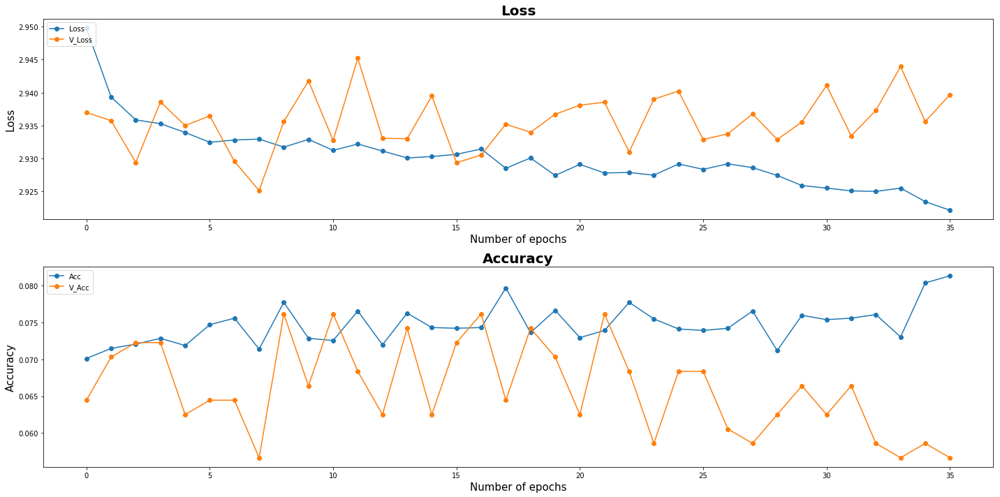

| Epoch [36] | Step [2900] | lr [0.014000] | Loss: [2.9144] | Acc: [0.0703] | Time: 0.0s
| Epoch [36] | Step [2950] | lr [0.014000] | Loss: [2.9267] | Acc: [0.0859] | Time: 0.0s
| Epoch [36] | Validation | Step [0] |  Loss: [2.9247] | Acc: [0.0625] | Time: 0.0s
| Epoch [36] | Validation | Step [1] |  Loss: [2.9583] | Acc: [0.0391] | Time: 0.0s
| Epoch [36] | Validation | Step [2] |  Loss: [2.9113] | Acc: [0.1172] | Time: 0.0s
| Epoch [36] | Validation | Step [3] |  Loss: [2.9691] | Acc: [0.0625] | Time: 0.0s


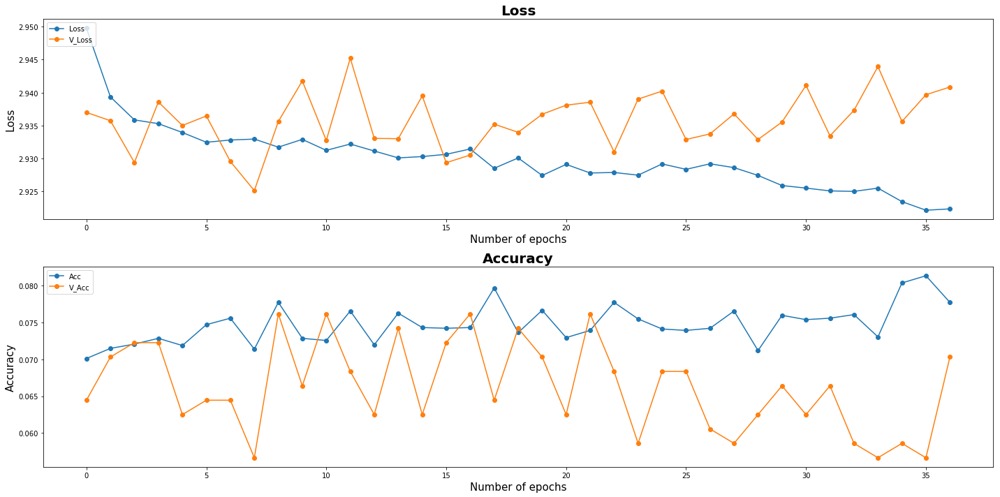

| Epoch [37] | Step [3000] | lr [0.014000] | Loss: [2.9248] | Acc: [0.0625] | Time: 0.0s
| Epoch [37] | Validation | Step [0] |  Loss: [2.9428] | Acc: [0.0781] | Time: 0.0s
| Epoch [37] | Validation | Step [1] |  Loss: [2.9463] | Acc: [0.0312] | Time: 0.0s
| Epoch [37] | Validation | Step [2] |  Loss: [2.9556] | Acc: [0.0547] | Time: 0.0s
| Epoch [37] | Validation | Step [3] |  Loss: [2.8963] | Acc: [0.1250] | Time: 0.0s


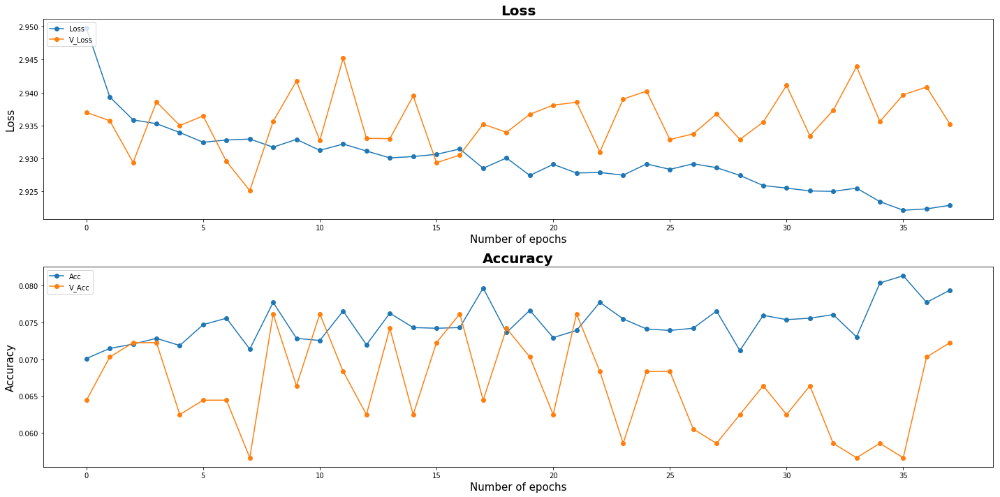

| Epoch [38] | Step [3050] | lr [0.014000] | Loss: [2.9377] | Acc: [0.0625] | Time: 0.0s
| Epoch [38] | Step [3100] | lr [0.014000] | Loss: [2.9530] | Acc: [0.0859] | Time: 0.0s
| Epoch [38] | Validation | Step [0] |  Loss: [2.9029] | Acc: [0.0781] | Time: 0.0s
| Epoch [38] | Validation | Step [1] |  Loss: [2.9464] | Acc: [0.0859] | Time: 0.0s
| Epoch [38] | Validation | Step [2] |  Loss: [2.9349] | Acc: [0.0469] | Time: 0.0s
| Epoch [38] | Validation | Step [3] |  Loss: [2.9568] | Acc: [0.0312] | Time: 0.0s


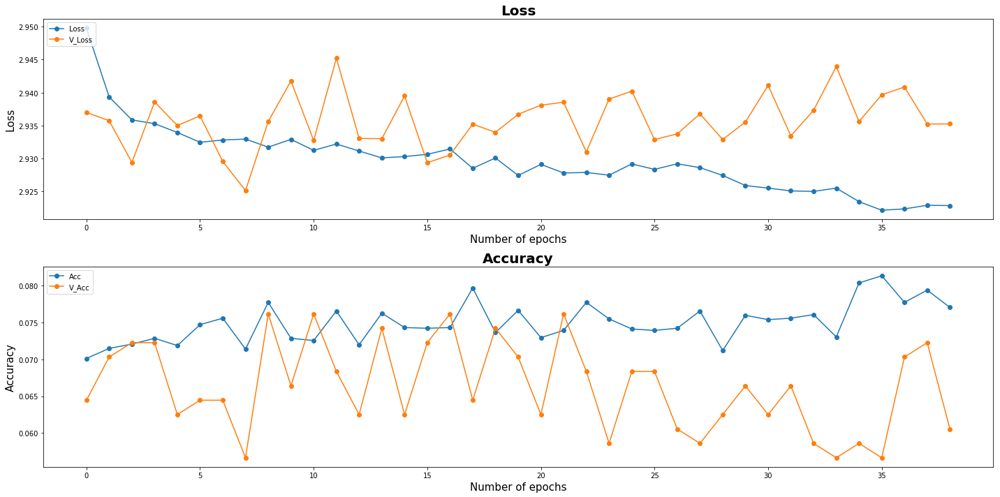

| Epoch [39] | Step [3150] | lr [0.014000] | Loss: [2.9560] | Acc: [0.0625] | Time: 0.0s
| Epoch [39] | Step [3200] | lr [0.014000] | Loss: [2.9251] | Acc: [0.0625] | Time: 0.0s
| Epoch [39] | Validation | Step [0] |  Loss: [2.9197] | Acc: [0.0625] | Time: 0.0s
| Epoch [39] | Validation | Step [1] |  Loss: [2.9345] | Acc: [0.0703] | Time: 0.0s
| Epoch [39] | Validation | Step [2] |  Loss: [2.9402] | Acc: [0.0625] | Time: 0.0s
| Epoch [39] | Validation | Step [3] |  Loss: [2.9544] | Acc: [0.0547] | Time: 0.0s


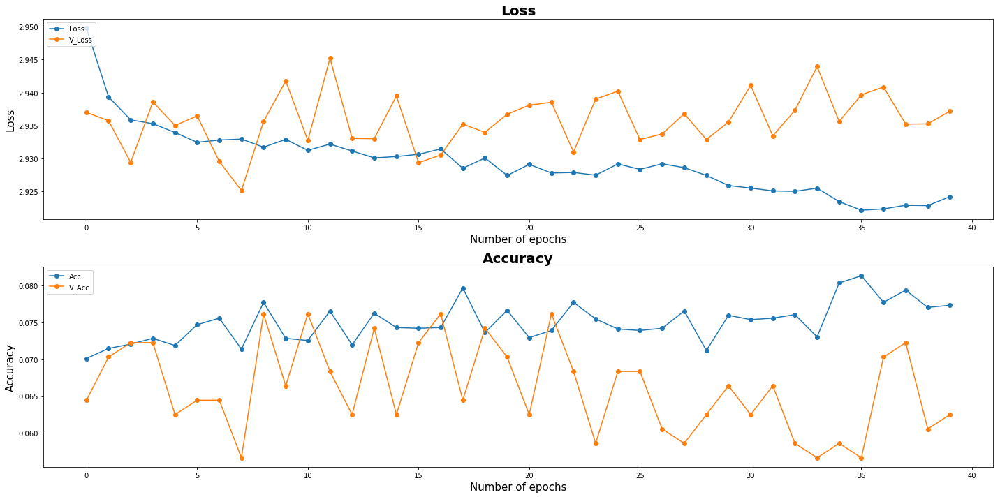

Model Saved
| Epoch [40] | Step [3250] | lr [0.014000] | Loss: [2.9038] | Acc: [0.0859] | Time: 0.0s
| Epoch [40] | Validation | Step [0] |  Loss: [2.9571] | Acc: [0.0234] | Time: 0.0s
| Epoch [40] | Validation | Step [1] |  Loss: [2.9184] | Acc: [0.0938] | Time: 0.0s
| Epoch [40] | Validation | Step [2] |  Loss: [2.9272] | Acc: [0.0859] | Time: 0.0s
| Epoch [40] | Validation | Step [3] |  Loss: [2.9221] | Acc: [0.0625] | Time: 0.0s


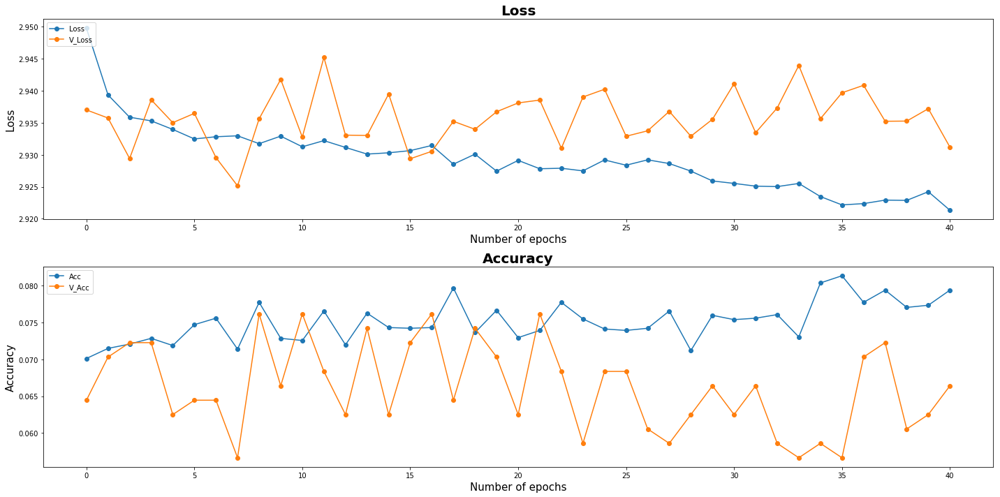

| Epoch [41] | Step [3300] | lr [0.014000] | Loss: [2.8872] | Acc: [0.0781] | Time: 0.0s
| Epoch [41] | Step [3350] | lr [0.014000] | Loss: [2.9455] | Acc: [0.0547] | Time: 0.0s
| Epoch [41] | Validation | Step [0] |  Loss: [2.9367] | Acc: [0.0625] | Time: 0.0s
| Epoch [41] | Validation | Step [1] |  Loss: [2.9213] | Acc: [0.0469] | Time: 0.0s
| Epoch [41] | Validation | Step [2] |  Loss: [2.9257] | Acc: [0.0625] | Time: 0.0s
| Epoch [41] | Validation | Step [3] |  Loss: [2.9325] | Acc: [0.0938] | Time: 0.0s


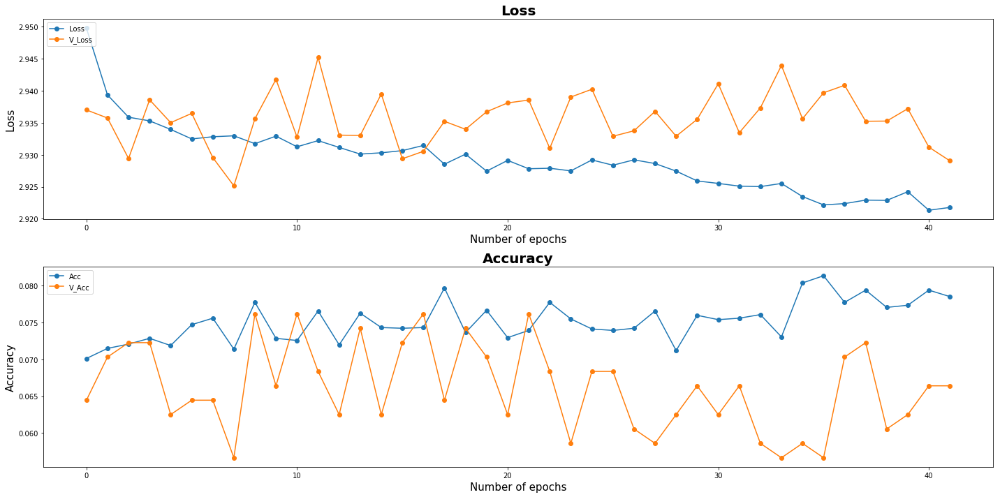

| Epoch [42] | Step [3400] | lr [0.014000] | Loss: [2.9248] | Acc: [0.0859] | Time: 0.0s
| Epoch [42] | Validation | Step [0] |  Loss: [2.9584] | Acc: [0.0625] | Time: 0.0s
| Epoch [42] | Validation | Step [1] |  Loss: [2.9322] | Acc: [0.0859] | Time: 0.0s
| Epoch [42] | Validation | Step [2] |  Loss: [2.9579] | Acc: [0.0547] | Time: 0.0s
| Epoch [42] | Validation | Step [3] |  Loss: [2.9434] | Acc: [0.0859] | Time: 0.0s


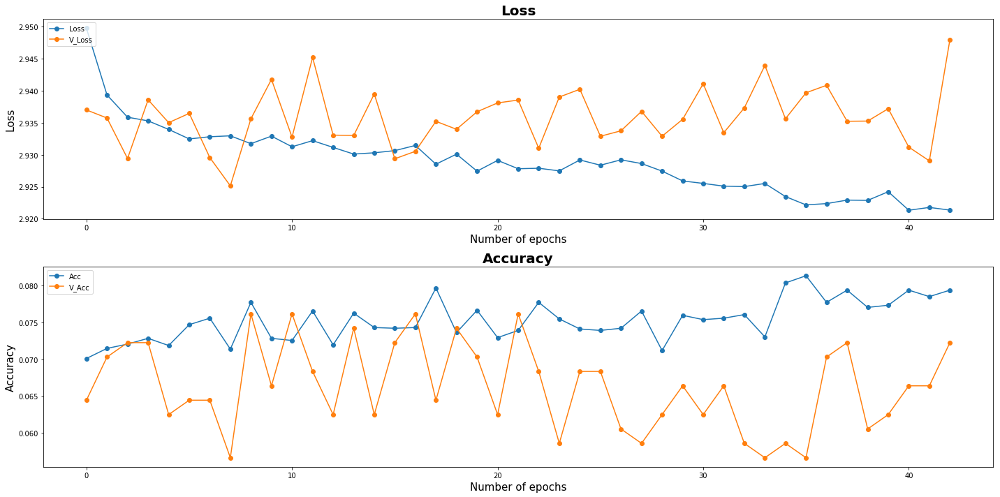

| Epoch [43] | Step [3450] | lr [0.014000] | Loss: [2.9303] | Acc: [0.0547] | Time: 0.0s
| Epoch [43] | Step [3500] | lr [0.014000] | Loss: [2.8889] | Acc: [0.1094] | Time: 0.0s
| Epoch [43] | Validation | Step [0] |  Loss: [2.9209] | Acc: [0.0781] | Time: 0.0s
| Epoch [43] | Validation | Step [1] |  Loss: [2.9324] | Acc: [0.0391] | Time: 0.0s
| Epoch [43] | Validation | Step [2] |  Loss: [2.9531] | Acc: [0.0391] | Time: 0.0s
| Epoch [43] | Validation | Step [3] |  Loss: [2.9243] | Acc: [0.0547] | Time: 0.0s


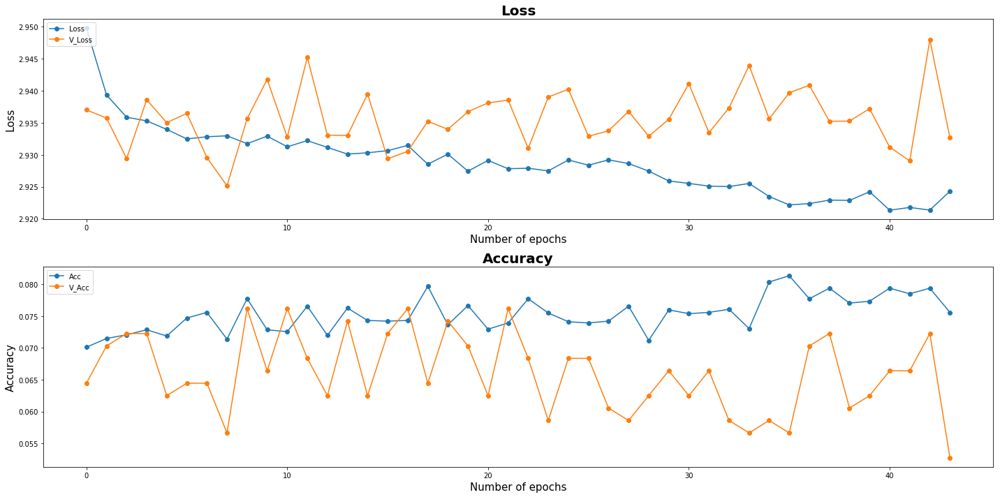

| Epoch [44] | Step [3550] | lr [0.014000] | Loss: [2.8900] | Acc: [0.1250] | Time: 0.0s
| Epoch [44] | Step [3600] | lr [0.014000] | Loss: [2.9578] | Acc: [0.0938] | Time: 0.0s
| Epoch [44] | Validation | Step [0] |  Loss: [2.9691] | Acc: [0.0391] | Time: 0.0s
| Epoch [44] | Validation | Step [1] |  Loss: [2.9665] | Acc: [0.0312] | Time: 0.0s
| Epoch [44] | Validation | Step [2] |  Loss: [2.9539] | Acc: [0.0547] | Time: 0.0s
| Epoch [44] | Validation | Step [3] |  Loss: [2.9033] | Acc: [0.1016] | Time: 0.0s


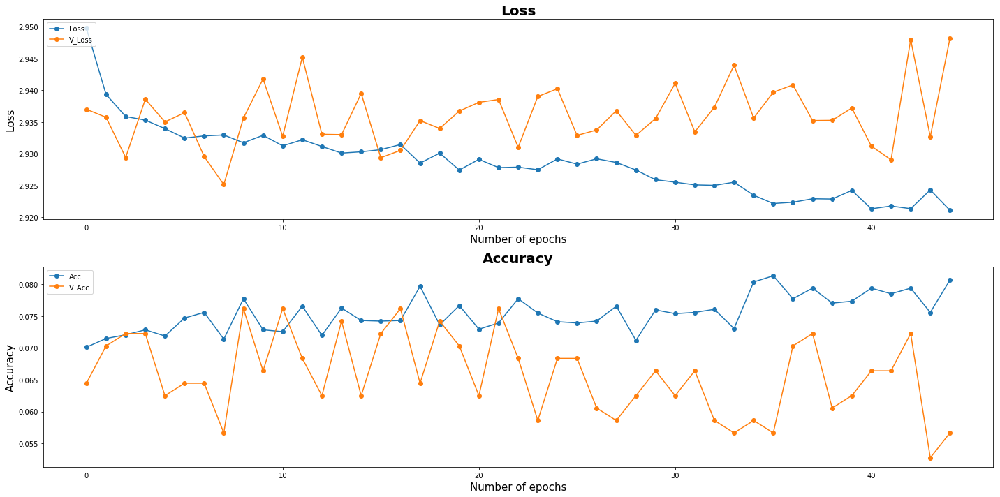

| Epoch [45] | Step [3650] | lr [0.014000] | Loss: [2.9610] | Acc: [0.0703] | Time: 0.0s
| Epoch [45] | Validation | Step [0] |  Loss: [2.9588] | Acc: [0.0859] | Time: 0.0s
| Epoch [45] | Validation | Step [1] |  Loss: [2.8935] | Acc: [0.0781] | Time: 0.0s
| Epoch [45] | Validation | Step [2] |  Loss: [2.9129] | Acc: [0.0625] | Time: 0.0s
| Epoch [45] | Validation | Step [3] |  Loss: [2.9645] | Acc: [0.0469] | Time: 0.0s


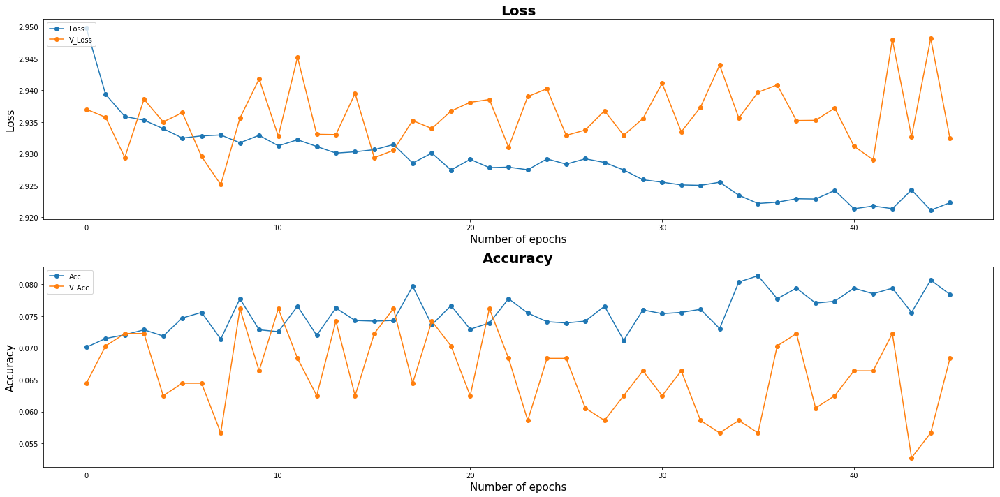

| Epoch [46] | Step [3700] | lr [0.014000] | Loss: [2.9068] | Acc: [0.0703] | Time: 0.0s
| Epoch [46] | Step [3750] | lr [0.014000] | Loss: [2.9303] | Acc: [0.0625] | Time: 0.0s
| Epoch [46] | Validation | Step [0] |  Loss: [2.9463] | Acc: [0.0859] | Time: 0.0s
| Epoch [46] | Validation | Step [1] |  Loss: [2.9279] | Acc: [0.0703] | Time: 0.0s
| Epoch [46] | Validation | Step [2] |  Loss: [2.9731] | Acc: [0.0156] | Time: 0.0s
| Epoch [46] | Validation | Step [3] |  Loss: [2.9249] | Acc: [0.0547] | Time: 0.0s


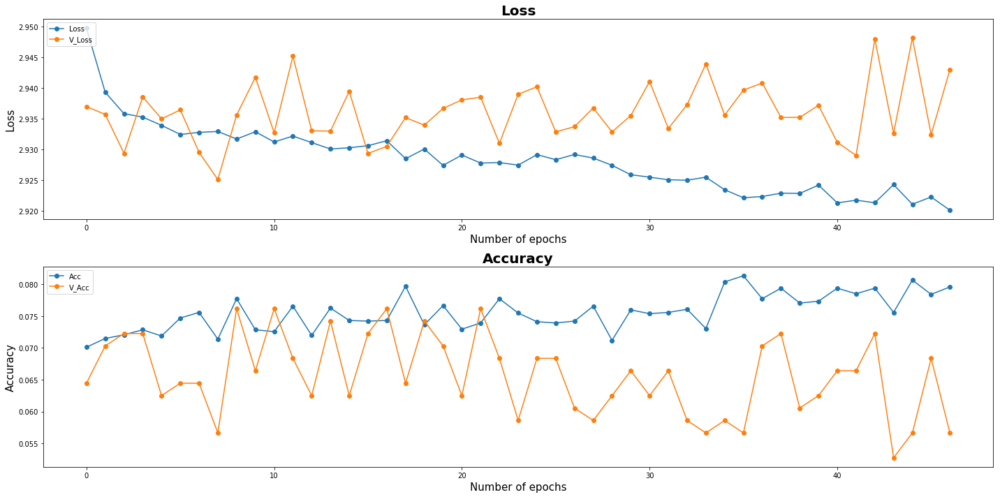

| Epoch [47] | Step [3800] | lr [0.009800] | Loss: [2.8987] | Acc: [0.1016] | Time: 0.0s
| Epoch [47] | Validation | Step [0] |  Loss: [2.9506] | Acc: [0.0312] | Time: 0.0s
| Epoch [47] | Validation | Step [1] |  Loss: [2.9359] | Acc: [0.0703] | Time: 0.0s
| Epoch [47] | Validation | Step [2] |  Loss: [2.9689] | Acc: [0.0703] | Time: 0.0s
| Epoch [47] | Validation | Step [3] |  Loss: [2.9216] | Acc: [0.0469] | Time: 0.0s


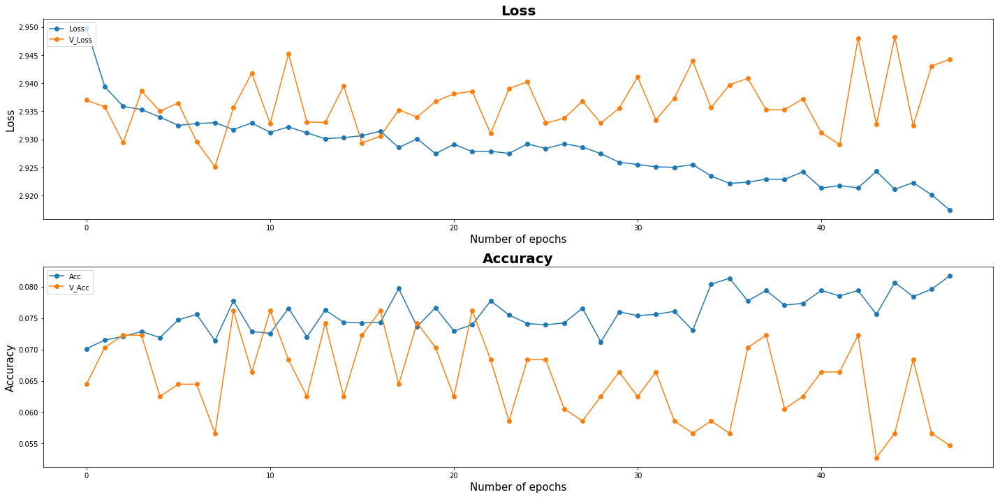

| Epoch [48] | Step [3850] | lr [0.009800] | Loss: [2.8998] | Acc: [0.0938] | Time: 0.0s
| Epoch [48] | Step [3900] | lr [0.009800] | Loss: [2.9516] | Acc: [0.0312] | Time: 0.0s
| Epoch [48] | Validation | Step [0] |  Loss: [2.9505] | Acc: [0.0625] | Time: 0.0s
| Epoch [48] | Validation | Step [1] |  Loss: [2.9600] | Acc: [0.0547] | Time: 0.0s
| Epoch [48] | Validation | Step [2] |  Loss: [2.9290] | Acc: [0.0625] | Time: 0.0s
| Epoch [48] | Validation | Step [3] |  Loss: [2.9179] | Acc: [0.0781] | Time: 0.0s


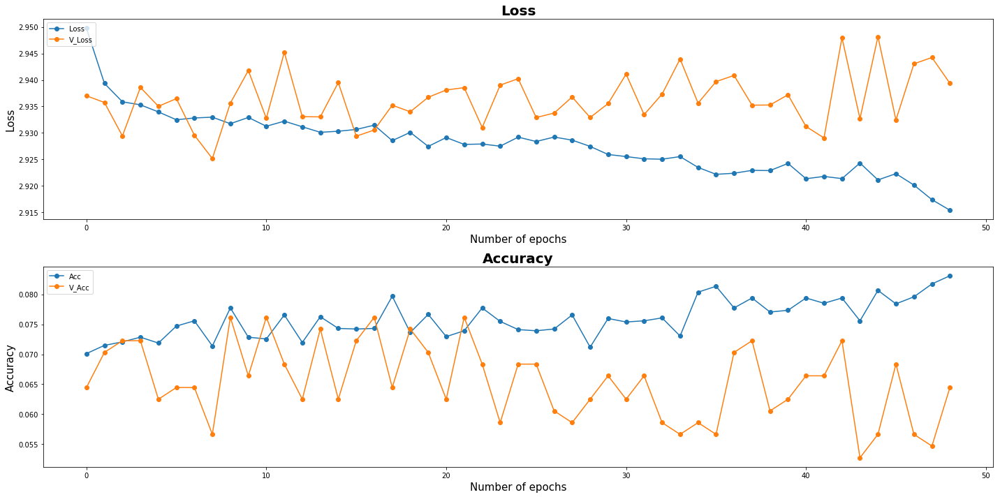

| Epoch [49] | Step [3950] | lr [0.009800] | Loss: [2.9239] | Acc: [0.0781] | Time: 0.0s
| Epoch [49] | Step [4000] | lr [0.009800] | Loss: [2.9483] | Acc: [0.0312] | Time: 0.0s
| Epoch [49] | Validation | Step [0] |  Loss: [2.9767] | Acc: [0.0625] | Time: 0.0s
| Epoch [49] | Validation | Step [1] |  Loss: [2.9403] | Acc: [0.0469] | Time: 0.0s
| Epoch [49] | Validation | Step [2] |  Loss: [2.9431] | Acc: [0.0625] | Time: 0.0s
| Epoch [49] | Validation | Step [3] |  Loss: [2.9543] | Acc: [0.0703] | Time: 0.0s


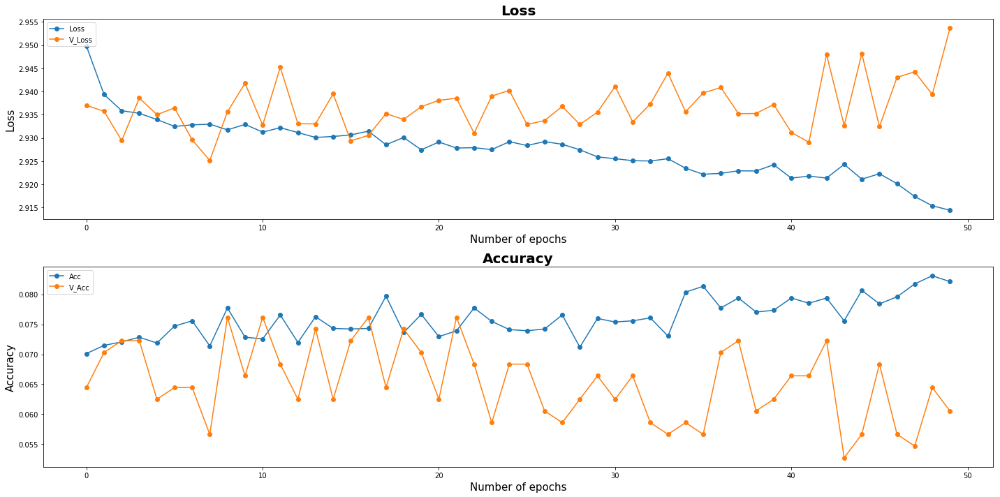

Model Saved
| Epoch [50] | Step [4050] | lr [0.009800] | Loss: [2.9523] | Acc: [0.0469] | Time: 0.0s
| Epoch [50] | Validation | Step [0] |  Loss: [2.9184] | Acc: [0.0781] | Time: 0.0s
| Epoch [50] | Validation | Step [1] |  Loss: [2.9686] | Acc: [0.0234] | Time: 0.0s
| Epoch [50] | Validation | Step [2] |  Loss: [2.9753] | Acc: [0.0547] | Time: 0.0s
| Epoch [50] | Validation | Step [3] |  Loss: [2.9117] | Acc: [0.1016] | Time: 0.0s


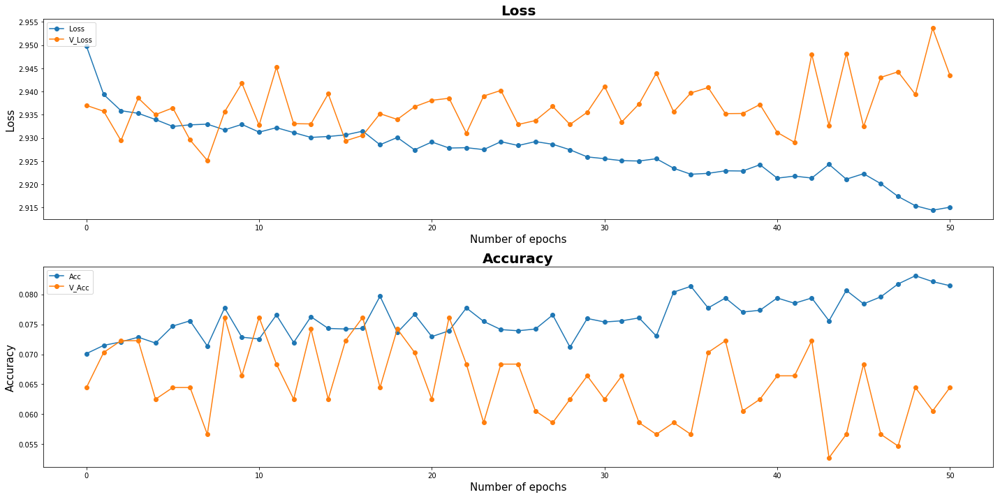

| Epoch [51] | Step [4100] | lr [0.009800] | Loss: [2.9294] | Acc: [0.1094] | Time: 0.0s
| Epoch [51] | Step [4150] | lr [0.009800] | Loss: [2.9012] | Acc: [0.0938] | Time: 0.0s
| Epoch [51] | Validation | Step [0] |  Loss: [2.9848] | Acc: [0.0703] | Time: 0.0s
| Epoch [51] | Validation | Step [1] |  Loss: [2.9450] | Acc: [0.0391] | Time: 0.0s
| Epoch [51] | Validation | Step [2] |  Loss: [2.9617] | Acc: [0.0547] | Time: 0.0s
| Epoch [51] | Validation | Step [3] |  Loss: [2.9351] | Acc: [0.0781] | Time: 0.0s


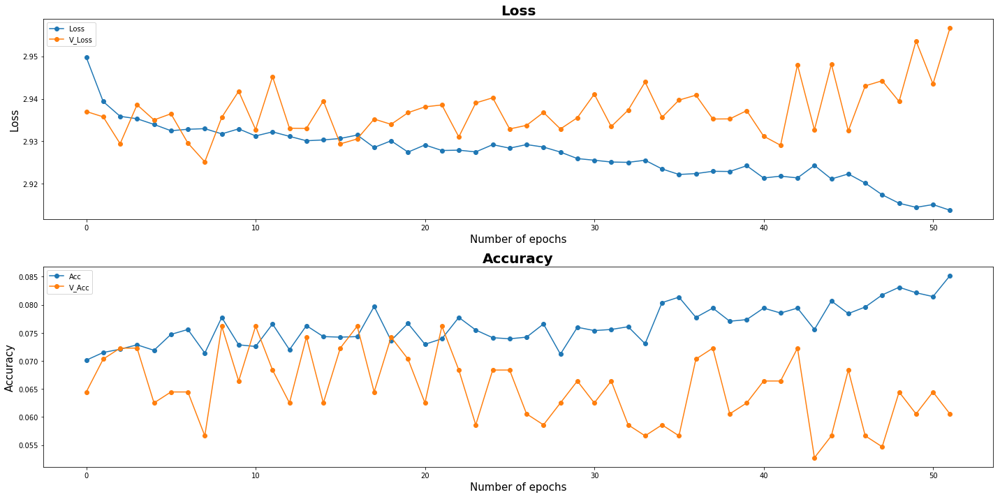

| Epoch [52] | Step [4200] | lr [0.009800] | Loss: [2.9048] | Acc: [0.0625] | Time: 0.0s
| Epoch [52] | Validation | Step [0] |  Loss: [2.9546] | Acc: [0.0391] | Time: 0.0s
| Epoch [52] | Validation | Step [1] |  Loss: [2.9434] | Acc: [0.1094] | Time: 0.0s
| Epoch [52] | Validation | Step [2] |  Loss: [2.9396] | Acc: [0.0625] | Time: 0.0s
| Epoch [52] | Validation | Step [3] |  Loss: [2.9565] | Acc: [0.0156] | Time: 0.0s


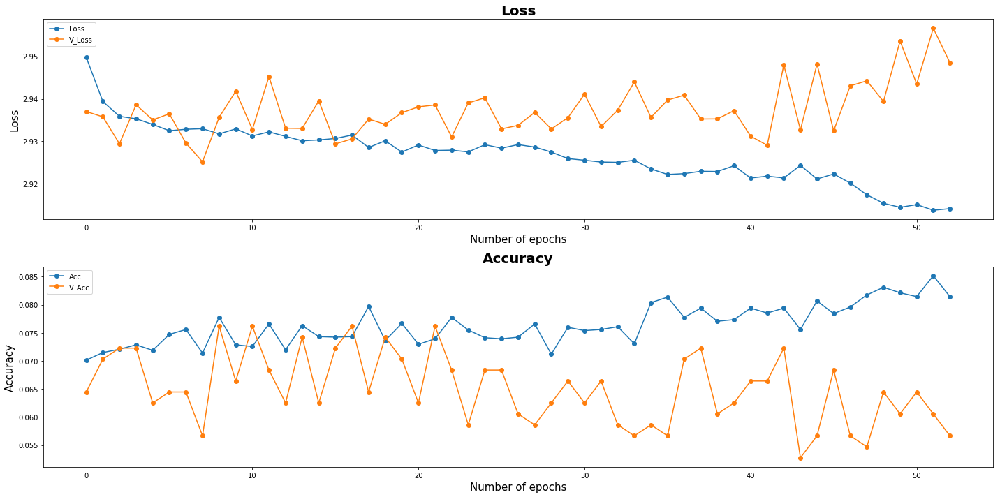

| Epoch [53] | Step [4250] | lr [0.009800] | Loss: [2.8814] | Acc: [0.0938] | Time: 0.0s
| Epoch [53] | Step [4300] | lr [0.009800] | Loss: [2.9298] | Acc: [0.0625] | Time: 0.0s
| Epoch [53] | Validation | Step [0] |  Loss: [2.9643] | Acc: [0.0547] | Time: 0.0s
| Epoch [53] | Validation | Step [1] |  Loss: [2.9358] | Acc: [0.0859] | Time: 0.0s
| Epoch [53] | Validation | Step [2] |  Loss: [2.9407] | Acc: [0.0469] | Time: 0.0s
| Epoch [53] | Validation | Step [3] |  Loss: [2.9831] | Acc: [0.0625] | Time: 0.0s


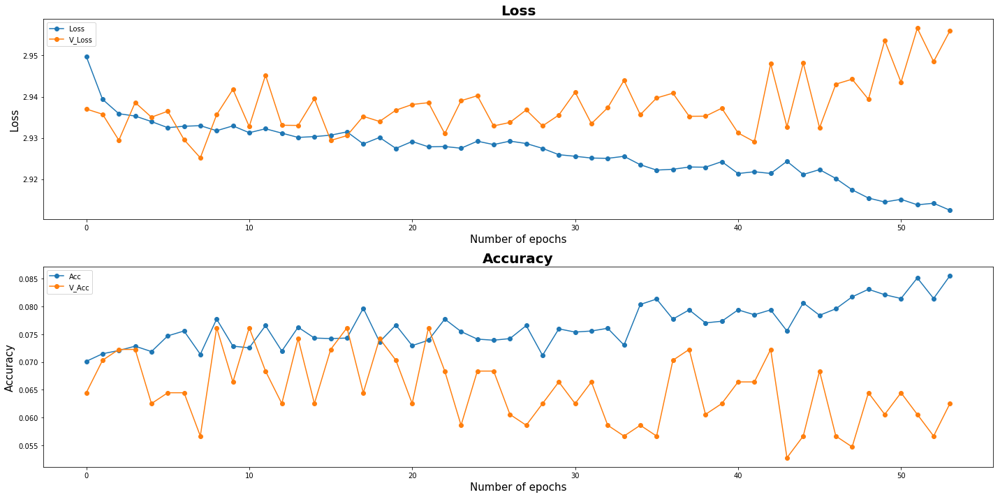

| Epoch [54] | Step [4350] | lr [0.009800] | Loss: [2.8879] | Acc: [0.1328] | Time: 0.0s
| Epoch [54] | Step [4400] | lr [0.009800] | Loss: [2.9163] | Acc: [0.0469] | Time: 0.0s
| Epoch [54] | Validation | Step [0] |  Loss: [2.9355] | Acc: [0.0703] | Time: 0.0s
| Epoch [54] | Validation | Step [1] |  Loss: [2.9427] | Acc: [0.0781] | Time: 0.0s
| Epoch [54] | Validation | Step [2] |  Loss: [2.9694] | Acc: [0.0391] | Time: 0.0s
| Epoch [54] | Validation | Step [3] |  Loss: [2.9481] | Acc: [0.0859] | Time: 0.0s


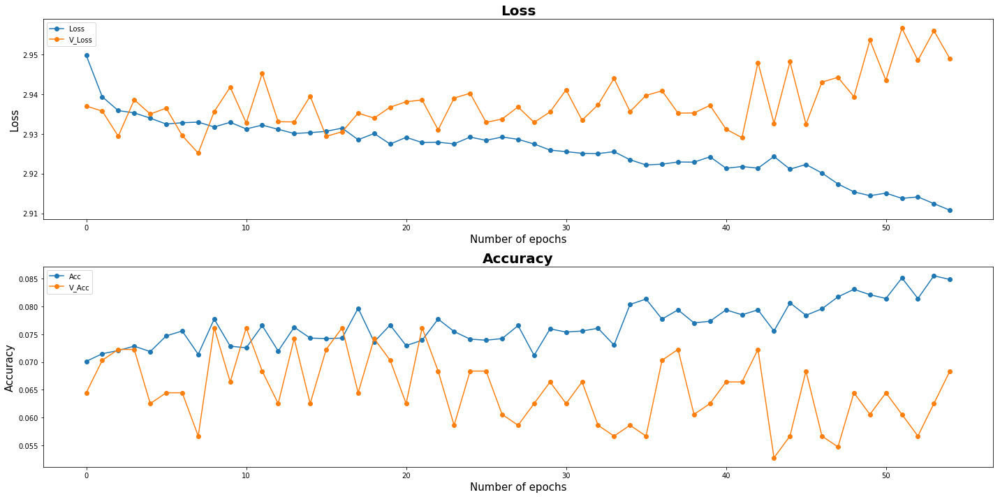

| Epoch [55] | Step [4450] | lr [0.009800] | Loss: [2.9363] | Acc: [0.1172] | Time: 0.0s
| Epoch [55] | Validation | Step [0] |  Loss: [2.9399] | Acc: [0.0859] | Time: 0.0s
| Epoch [55] | Validation | Step [1] |  Loss: [2.9159] | Acc: [0.0625] | Time: 0.0s
| Epoch [55] | Validation | Step [2] |  Loss: [2.9706] | Acc: [0.0625] | Time: 0.0s
| Epoch [55] | Validation | Step [3] |  Loss: [2.9711] | Acc: [0.0469] | Time: 0.0s


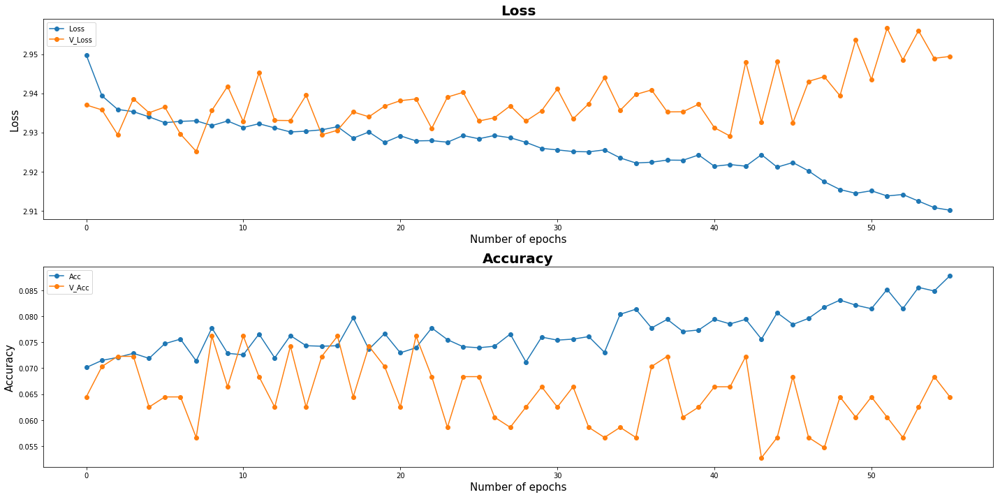

| Epoch [56] | Step [4500] | lr [0.009800] | Loss: [2.9434] | Acc: [0.0625] | Time: 0.0s
| Epoch [56] | Step [4550] | lr [0.009800] | Loss: [2.9423] | Acc: [0.0781] | Time: 0.0s
| Epoch [56] | Validation | Step [0] |  Loss: [2.9635] | Acc: [0.0625] | Time: 0.0s
| Epoch [56] | Validation | Step [1] |  Loss: [2.9158] | Acc: [0.0703] | Time: 0.0s
| Epoch [56] | Validation | Step [2] |  Loss: [2.9468] | Acc: [0.0703] | Time: 0.0s
| Epoch [56] | Validation | Step [3] |  Loss: [2.9674] | Acc: [0.0469] | Time: 0.0s


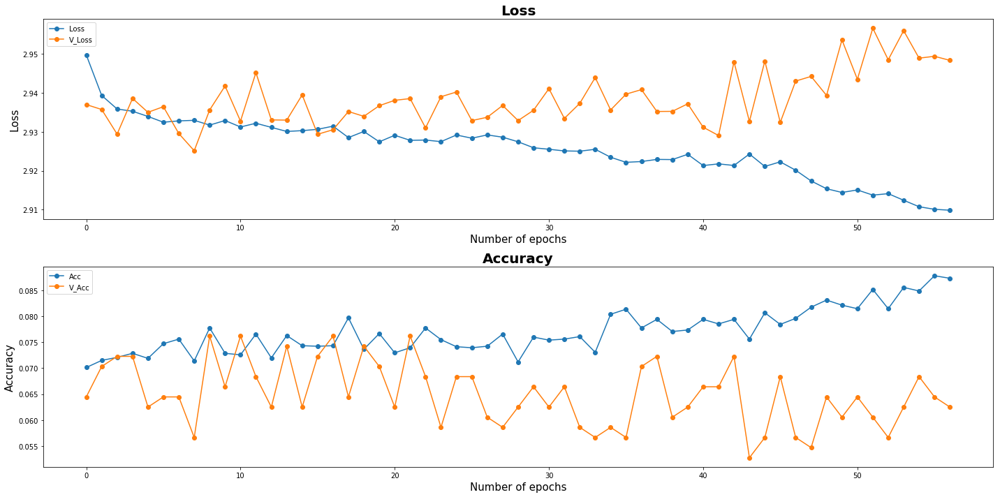

| Epoch [57] | Step [4600] | lr [0.009800] | Loss: [2.9136] | Acc: [0.0547] | Time: 0.0s
| Epoch [57] | Validation | Step [0] |  Loss: [2.9588] | Acc: [0.1016] | Time: 0.0s
| Epoch [57] | Validation | Step [1] |  Loss: [2.9284] | Acc: [0.0781] | Time: 0.0s
| Epoch [57] | Validation | Step [2] |  Loss: [2.9755] | Acc: [0.0312] | Time: 0.0s
| Epoch [57] | Validation | Step [3] |  Loss: [2.9625] | Acc: [0.0781] | Time: 0.0s


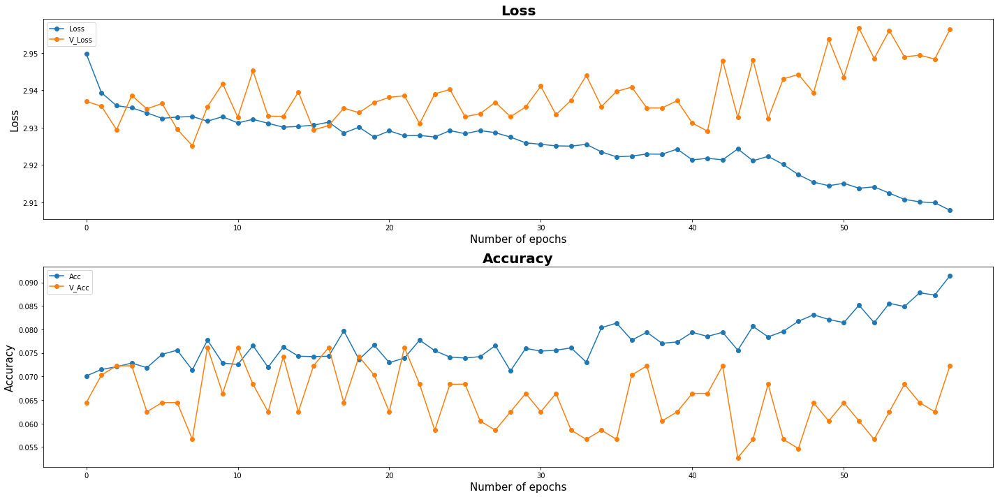

| Epoch [58] | Step [4650] | lr [0.009800] | Loss: [2.8785] | Acc: [0.1094] | Time: 0.0s
| Epoch [58] | Step [4700] | lr [0.009800] | Loss: [2.9115] | Acc: [0.1172] | Time: 0.0s
| Epoch [58] | Validation | Step [0] |  Loss: [2.9415] | Acc: [0.0781] | Time: 0.0s
| Epoch [58] | Validation | Step [1] |  Loss: [2.9940] | Acc: [0.0312] | Time: 0.0s
| Epoch [58] | Validation | Step [2] |  Loss: [2.9405] | Acc: [0.0703] | Time: 0.0s
| Epoch [58] | Validation | Step [3] |  Loss: [2.9510] | Acc: [0.0547] | Time: 0.0s


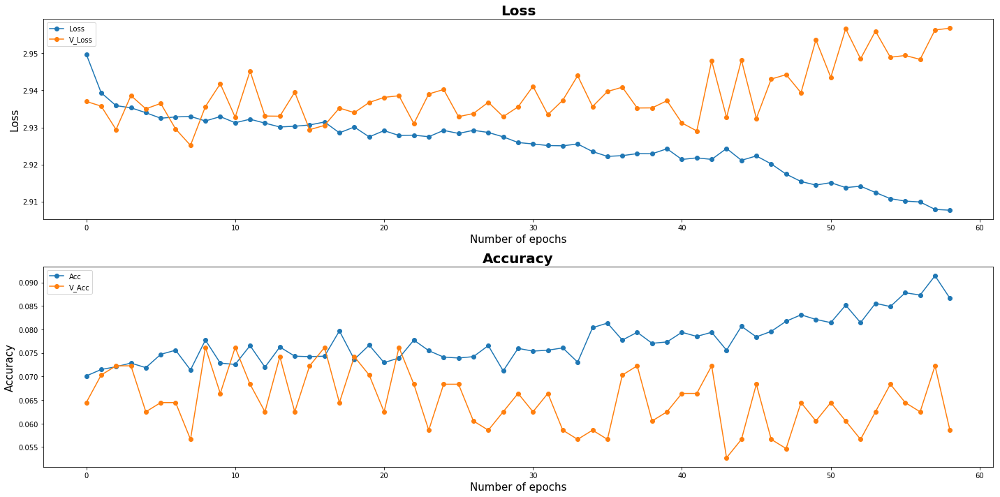

| Epoch [59] | Step [4750] | lr [0.009800] | Loss: [2.8766] | Acc: [0.1094] | Time: 0.0s
| Epoch [59] | Step [4800] | lr [0.009800] | Loss: [2.9368] | Acc: [0.1172] | Time: 0.0s
| Epoch [59] | Validation | Step [0] |  Loss: [2.9317] | Acc: [0.0703] | Time: 0.0s
| Epoch [59] | Validation | Step [1] |  Loss: [2.9539] | Acc: [0.0312] | Time: 0.0s
| Epoch [59] | Validation | Step [2] |  Loss: [2.9526] | Acc: [0.0781] | Time: 0.0s
| Epoch [59] | Validation | Step [3] |  Loss: [2.9775] | Acc: [0.0703] | Time: 0.0s


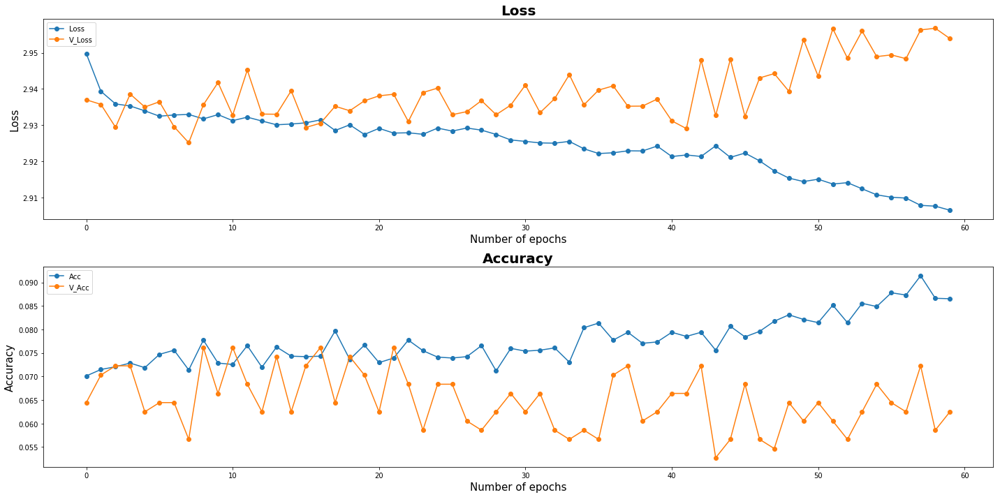

Model Saved
| Epoch [60] | Step [4850] | lr [0.009800] | Loss: [2.9098] | Acc: [0.0625] | Time: 0.0s
| Epoch [60] | Validation | Step [0] |  Loss: [2.9679] | Acc: [0.0859] | Time: 0.0s
| Epoch [60] | Validation | Step [1] |  Loss: [2.9676] | Acc: [0.0469] | Time: 0.0s
| Epoch [60] | Validation | Step [2] |  Loss: [2.9350] | Acc: [0.0391] | Time: 0.0s
| Epoch [60] | Validation | Step [3] |  Loss: [2.9588] | Acc: [0.0547] | Time: 0.0s


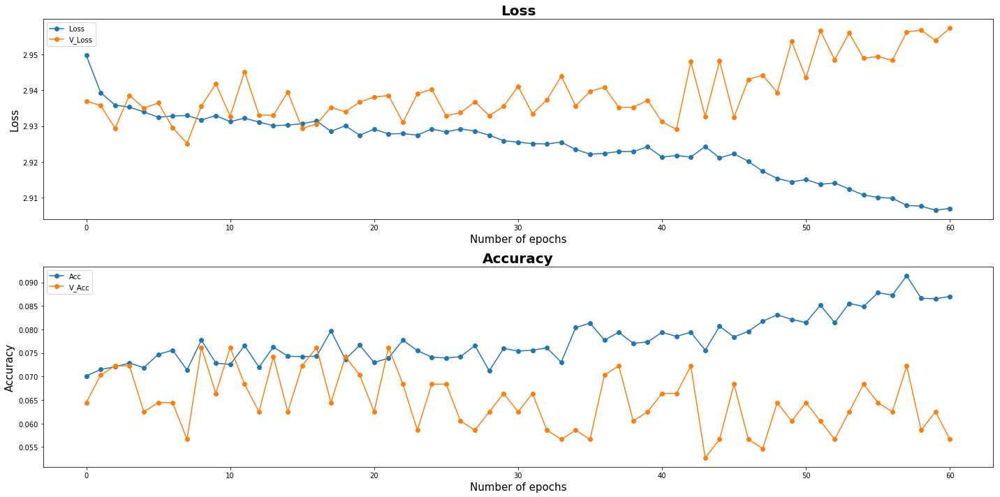

| Epoch [61] | Step [4900] | lr [0.009800] | Loss: [2.9399] | Acc: [0.0547] | Time: 0.0s
| Epoch [61] | Step [4950] | lr [0.009800] | Loss: [2.9118] | Acc: [0.0859] | Time: 0.0s
| Epoch [61] | Validation | Step [0] |  Loss: [2.9480] | Acc: [0.0781] | Time: 0.0s
| Epoch [61] | Validation | Step [1] |  Loss: [2.9598] | Acc: [0.0625] | Time: 0.0s
| Epoch [61] | Validation | Step [2] |  Loss: [2.9166] | Acc: [0.1016] | Time: 0.0s
| Epoch [61] | Validation | Step [3] |  Loss: [2.9927] | Acc: [0.0547] | Time: 0.0s


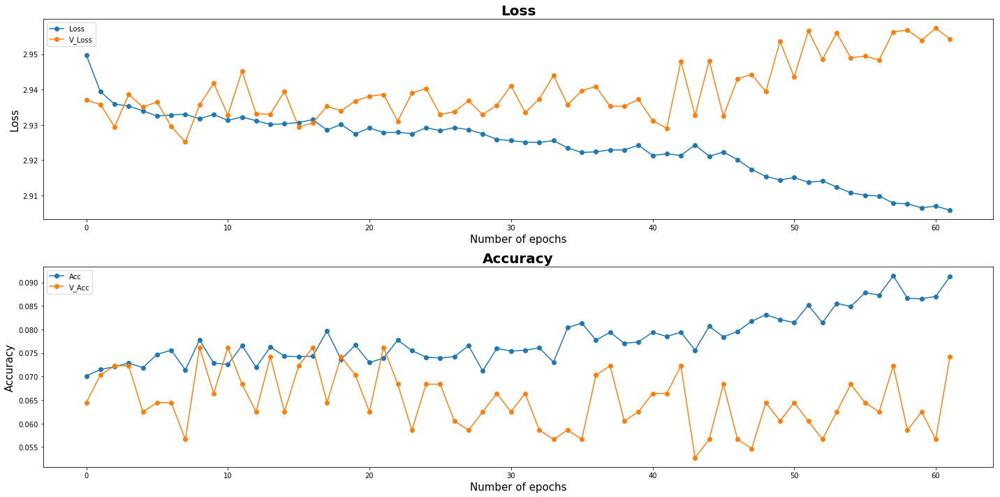

| Epoch [62] | Step [5000] | lr [0.009800] | Loss: [2.8869] | Acc: [0.0781] | Time: 0.0s
| Epoch [62] | Validation | Step [0] |  Loss: [2.9773] | Acc: [0.0859] | Time: 0.0s
| Epoch [62] | Validation | Step [1] |  Loss: [2.9650] | Acc: [0.0625] | Time: 0.0s
| Epoch [62] | Validation | Step [2] |  Loss: [2.9422] | Acc: [0.0469] | Time: 0.0s
| Epoch [62] | Validation | Step [3] |  Loss: [2.9875] | Acc: [0.0625] | Time: 0.0s


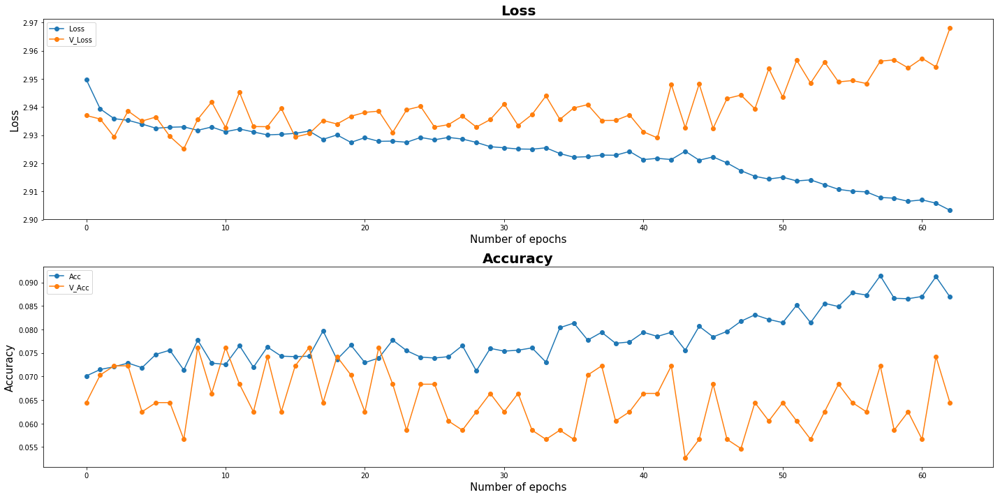

| Epoch [63] | Step [5050] | lr [0.009800] | Loss: [2.8632] | Acc: [0.1094] | Time: 0.0s
| Epoch [63] | Step [5100] | lr [0.009800] | Loss: [2.9525] | Acc: [0.0547] | Time: 0.0s
| Epoch [63] | Validation | Step [0] |  Loss: [2.9793] | Acc: [0.0547] | Time: 0.0s
| Epoch [63] | Validation | Step [1] |  Loss: [2.9805] | Acc: [0.0391] | Time: 0.0s
| Epoch [63] | Validation | Step [2] |  Loss: [2.9640] | Acc: [0.0859] | Time: 0.0s
| Epoch [63] | Validation | Step [3] |  Loss: [2.9409] | Acc: [0.0547] | Time: 0.0s


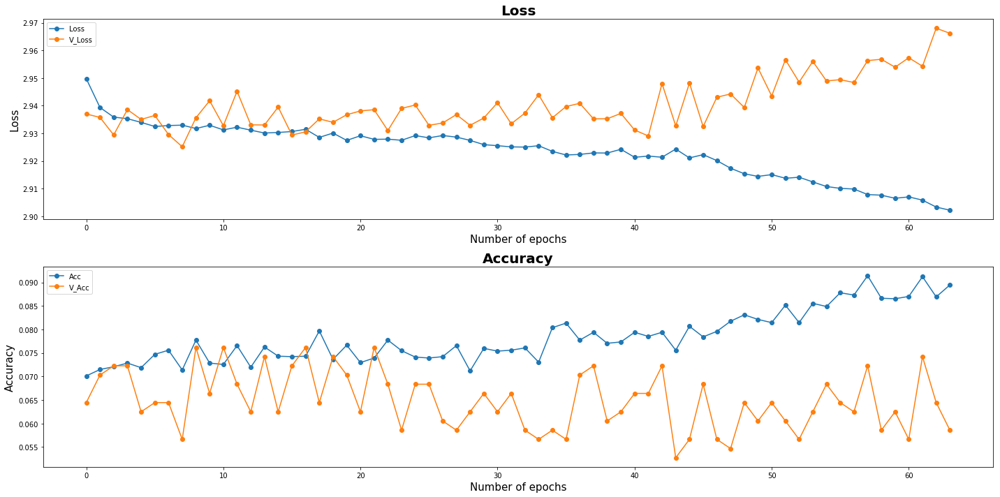

| Epoch [64] | Step [5150] | lr [0.009800] | Loss: [2.9363] | Acc: [0.0547] | Time: 0.0s
| Epoch [64] | Step [5200] | lr [0.009800] | Loss: [2.9122] | Acc: [0.1016] | Time: 0.0s
| Epoch [64] | Validation | Step [0] |  Loss: [2.9767] | Acc: [0.0703] | Time: 0.0s
| Epoch [64] | Validation | Step [1] |  Loss: [2.9529] | Acc: [0.0547] | Time: 0.0s
| Epoch [64] | Validation | Step [2] |  Loss: [2.9684] | Acc: [0.0625] | Time: 0.0s
| Epoch [64] | Validation | Step [3] |  Loss: [2.9519] | Acc: [0.0781] | Time: 0.0s


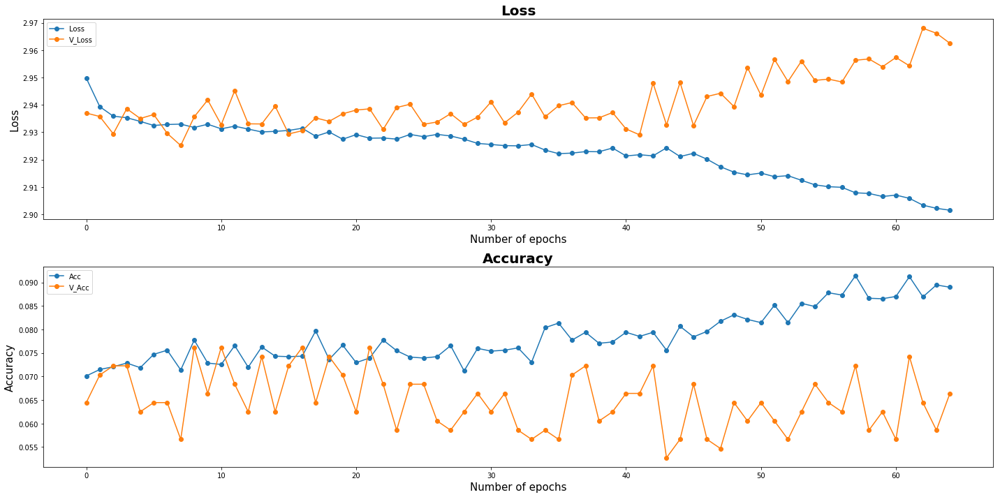

| Epoch [65] | Step [5250] | lr [0.009800] | Loss: [2.8313] | Acc: [0.1484] | Time: 0.0s
| Epoch [65] | Validation | Step [0] |  Loss: [3.0034] | Acc: [0.0547] | Time: 0.0s
| Epoch [65] | Validation | Step [1] |  Loss: [2.9630] | Acc: [0.0703] | Time: 0.0s
| Epoch [65] | Validation | Step [2] |  Loss: [2.9373] | Acc: [0.0547] | Time: 0.0s
| Epoch [65] | Validation | Step [3] |  Loss: [2.9573] | Acc: [0.0469] | Time: 0.0s


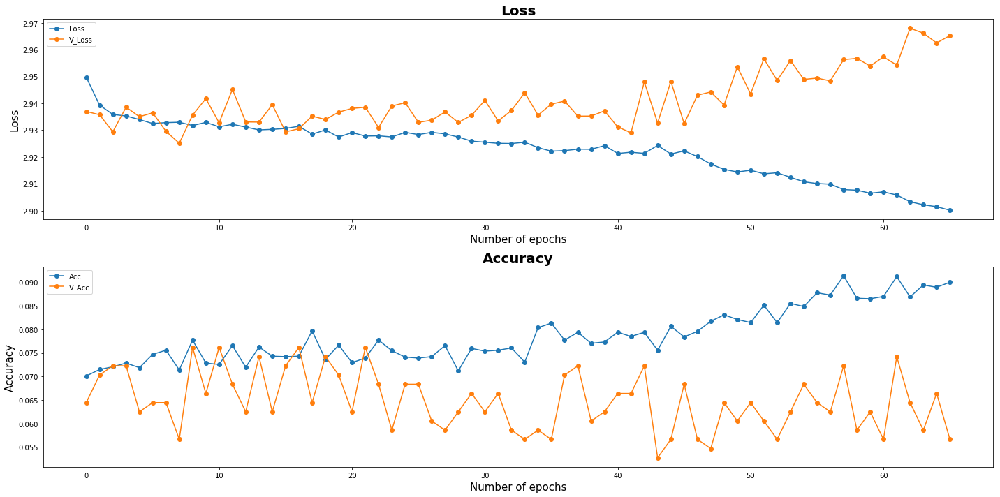

| Epoch [66] | Step [5300] | lr [0.009800] | Loss: [2.9189] | Acc: [0.0781] | Time: 0.0s
| Epoch [66] | Step [5350] | lr [0.009800] | Loss: [2.8893] | Acc: [0.0938] | Time: 0.0s
| Epoch [66] | Validation | Step [0] |  Loss: [2.9503] | Acc: [0.1250] | Time: 0.0s
| Epoch [66] | Validation | Step [1] |  Loss: [2.9539] | Acc: [0.0547] | Time: 0.0s
| Epoch [66] | Validation | Step [2] |  Loss: [2.9860] | Acc: [0.0234] | Time: 0.0s
| Epoch [66] | Validation | Step [3] |  Loss: [2.9903] | Acc: [0.0391] | Time: 0.0s


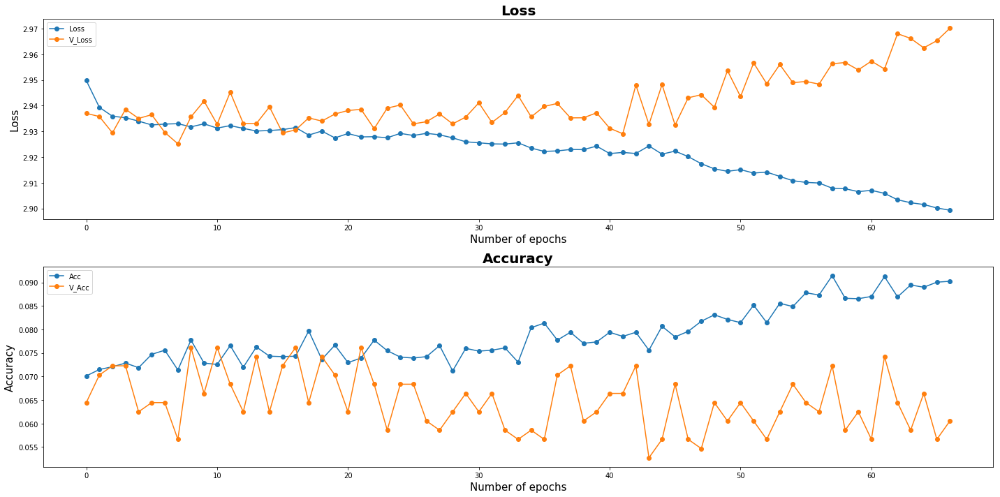

| Epoch [67] | Step [5400] | lr [0.009800] | Loss: [2.9318] | Acc: [0.0938] | Time: 0.0s
| Epoch [67] | Validation | Step [0] |  Loss: [2.9520] | Acc: [0.0625] | Time: 0.0s
| Epoch [67] | Validation | Step [1] |  Loss: [3.0219] | Acc: [0.0234] | Time: 0.0s
| Epoch [67] | Validation | Step [2] |  Loss: [2.9476] | Acc: [0.0703] | Time: 0.0s
| Epoch [67] | Validation | Step [3] |  Loss: [2.9872] | Acc: [0.0703] | Time: 0.0s


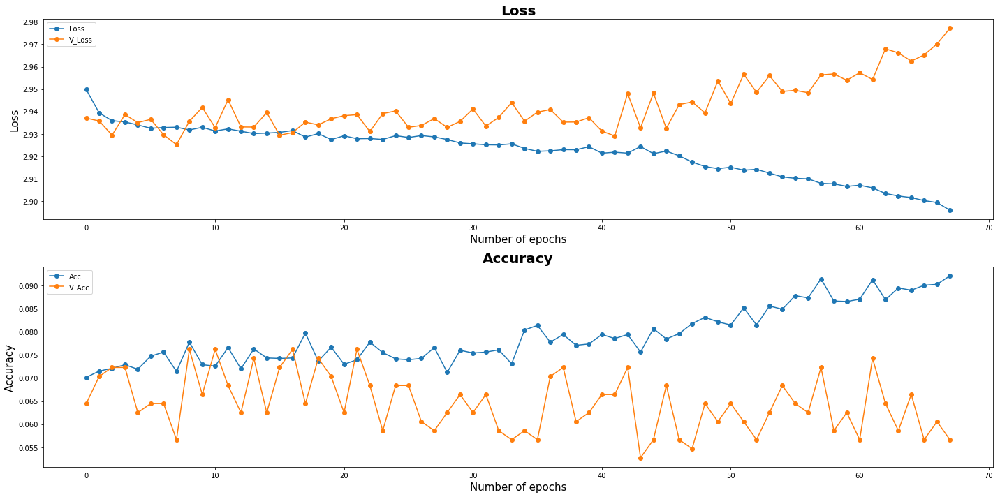

| Epoch [68] | Step [5450] | lr [0.009800] | Loss: [2.8754] | Acc: [0.1172] | Time: 0.0s
| Epoch [68] | Step [5500] | lr [0.009800] | Loss: [2.9075] | Acc: [0.0859] | Time: 0.0s
| Epoch [68] | Validation | Step [0] |  Loss: [2.9366] | Acc: [0.0781] | Time: 0.0s
| Epoch [68] | Validation | Step [1] |  Loss: [2.9598] | Acc: [0.0391] | Time: 0.0s
| Epoch [68] | Validation | Step [2] |  Loss: [2.9861] | Acc: [0.0625] | Time: 0.0s
| Epoch [68] | Validation | Step [3] |  Loss: [2.9896] | Acc: [0.0625] | Time: 0.0s


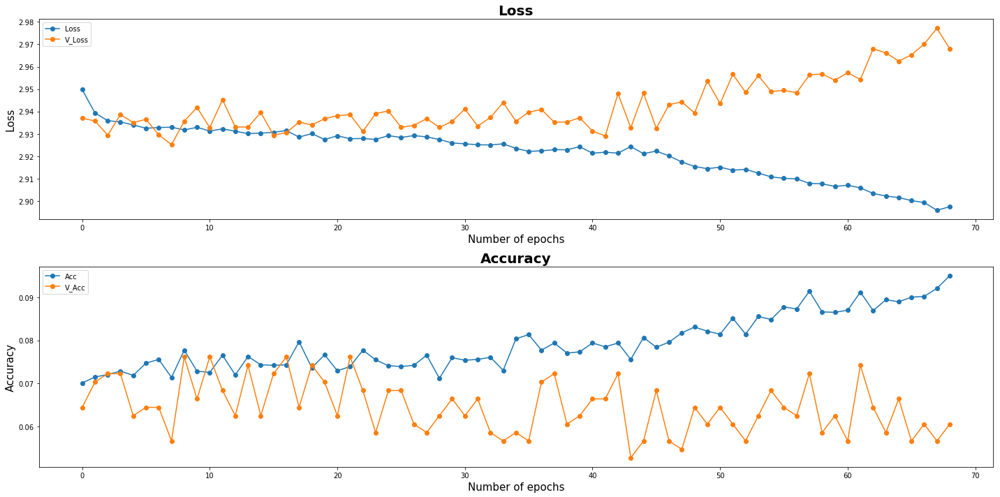

| Epoch [69] | Step [5550] | lr [0.009800] | Loss: [2.8855] | Acc: [0.1484] | Time: 0.0s
| Epoch [69] | Step [5600] | lr [0.009800] | Loss: [2.9398] | Acc: [0.0859] | Time: 0.0s
| Epoch [69] | Validation | Step [0] |  Loss: [2.9725] | Acc: [0.0547] | Time: 0.0s
| Epoch [69] | Validation | Step [1] |  Loss: [2.9345] | Acc: [0.0625] | Time: 0.0s
| Epoch [69] | Validation | Step [2] |  Loss: [2.9481] | Acc: [0.0703] | Time: 0.0s
| Epoch [69] | Validation | Step [3] |  Loss: [3.0084] | Acc: [0.0469] | Time: 0.0s


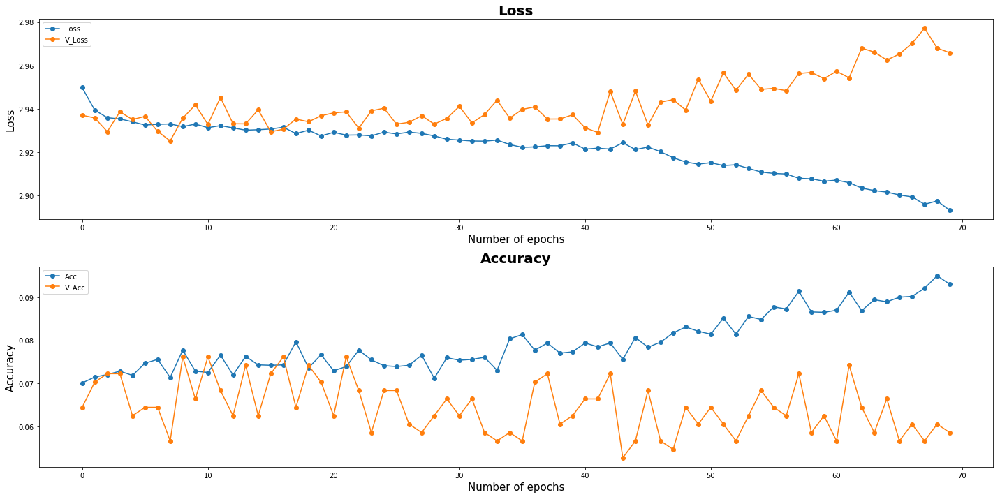

Model Saved
| Epoch [70] | Step [5650] | lr [0.009800] | Loss: [2.9099] | Acc: [0.0859] | Time: 0.0s
| Epoch [70] | Validation | Step [0] |  Loss: [2.9502] | Acc: [0.0625] | Time: 0.0s
| Epoch [70] | Validation | Step [1] |  Loss: [2.9987] | Acc: [0.0703] | Time: 0.0s
| Epoch [70] | Validation | Step [2] |  Loss: [2.8910] | Acc: [0.1016] | Time: 0.0s
| Epoch [70] | Validation | Step [3] |  Loss: [2.9839] | Acc: [0.0547] | Time: 0.0s


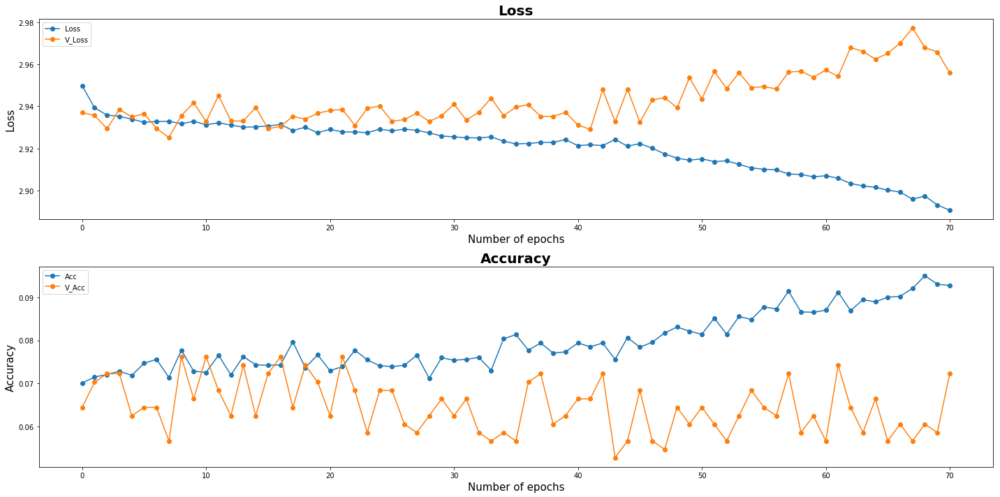

| Epoch [71] | Step [5700] | lr [0.009800] | Loss: [2.9003] | Acc: [0.0547] | Time: 0.0s
| Epoch [71] | Step [5750] | lr [0.009800] | Loss: [2.9085] | Acc: [0.0781] | Time: 0.0s
| Epoch [71] | Validation | Step [0] |  Loss: [2.9486] | Acc: [0.1172] | Time: 0.0s
| Epoch [71] | Validation | Step [1] |  Loss: [3.0006] | Acc: [0.0391] | Time: 0.0s
| Epoch [71] | Validation | Step [2] |  Loss: [2.9776] | Acc: [0.1094] | Time: 0.0s
| Epoch [71] | Validation | Step [3] |  Loss: [2.9659] | Acc: [0.0312] | Time: 0.0s


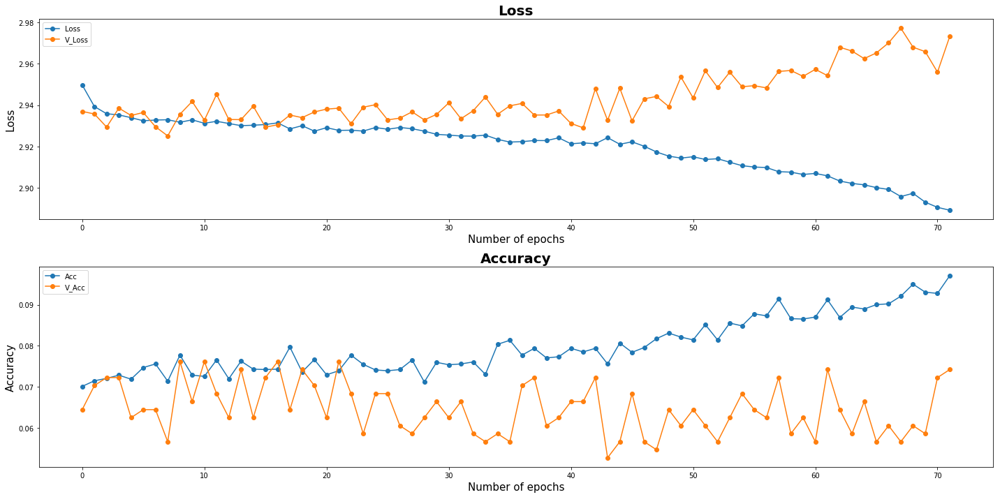

| Epoch [72] | Step [5800] | lr [0.009800] | Loss: [2.8757] | Acc: [0.1016] | Time: 0.0s
| Epoch [72] | Validation | Step [0] |  Loss: [2.9683] | Acc: [0.0625] | Time: 0.0s
| Epoch [72] | Validation | Step [1] |  Loss: [2.9949] | Acc: [0.0469] | Time: 0.0s
| Epoch [72] | Validation | Step [2] |  Loss: [2.9548] | Acc: [0.0391] | Time: 0.0s
| Epoch [72] | Validation | Step [3] |  Loss: [2.9507] | Acc: [0.0859] | Time: 0.0s


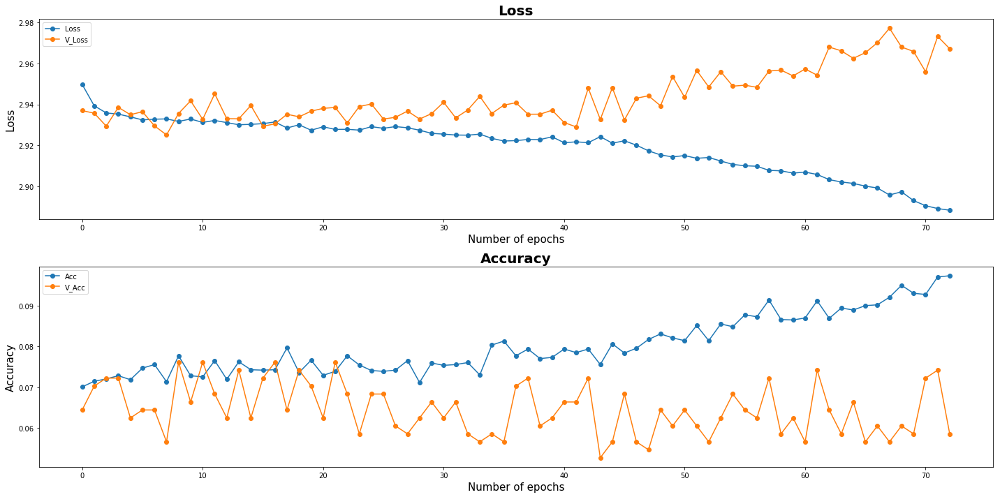

| Epoch [73] | Step [5850] | lr [0.009800] | Loss: [2.8684] | Acc: [0.1328] | Time: 0.0s
| Epoch [73] | Step [5900] | lr [0.009800] | Loss: [2.9482] | Acc: [0.0703] | Time: 0.0s
| Epoch [73] | Validation | Step [0] |  Loss: [2.9341] | Acc: [0.0938] | Time: 0.0s
| Epoch [73] | Validation | Step [1] |  Loss: [2.9763] | Acc: [0.0391] | Time: 0.0s
| Epoch [73] | Validation | Step [2] |  Loss: [2.9691] | Acc: [0.0391] | Time: 0.0s
| Epoch [73] | Validation | Step [3] |  Loss: [2.9879] | Acc: [0.0781] | Time: 0.0s


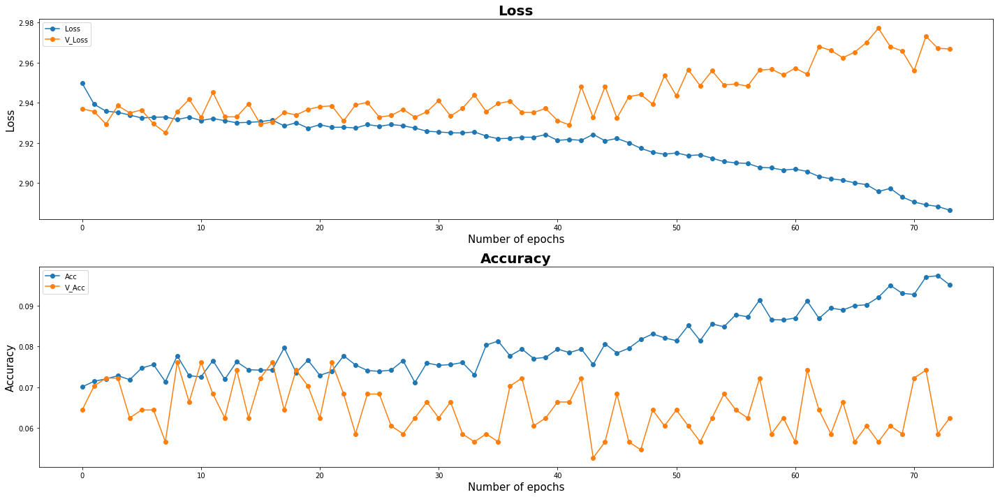

| Epoch [74] | Step [5950] | lr [0.009800] | Loss: [2.8929] | Acc: [0.0469] | Time: 0.0s
| Epoch [74] | Step [6000] | lr [0.009800] | Loss: [2.8739] | Acc: [0.1250] | Time: 0.0s
| Epoch [74] | Validation | Step [0] |  Loss: [2.9771] | Acc: [0.0547] | Time: 0.0s
| Epoch [74] | Validation | Step [1] |  Loss: [3.0015] | Acc: [0.0469] | Time: 0.0s
| Epoch [74] | Validation | Step [2] |  Loss: [2.9552] | Acc: [0.0703] | Time: 0.0s
| Epoch [74] | Validation | Step [3] |  Loss: [2.9723] | Acc: [0.0625] | Time: 0.0s


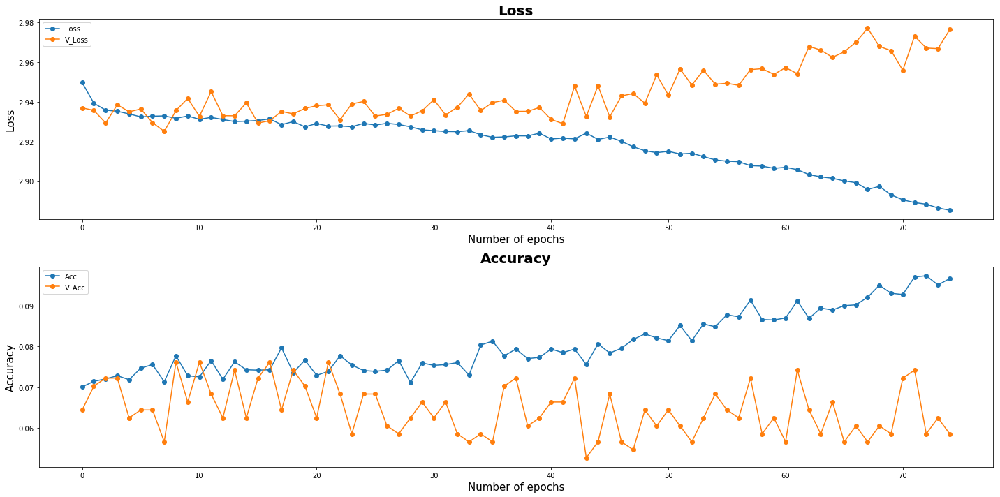

| Epoch [75] | Step [6050] | lr [0.009800] | Loss: [2.8657] | Acc: [0.0859] | Time: 0.0s
| Epoch [75] | Validation | Step [0] |  Loss: [2.9516] | Acc: [0.0781] | Time: 0.0s
| Epoch [75] | Validation | Step [1] |  Loss: [3.0249] | Acc: [0.0547] | Time: 0.0s
| Epoch [75] | Validation | Step [2] |  Loss: [2.9813] | Acc: [0.0547] | Time: 0.0s
| Epoch [75] | Validation | Step [3] |  Loss: [2.9821] | Acc: [0.0391] | Time: 0.0s


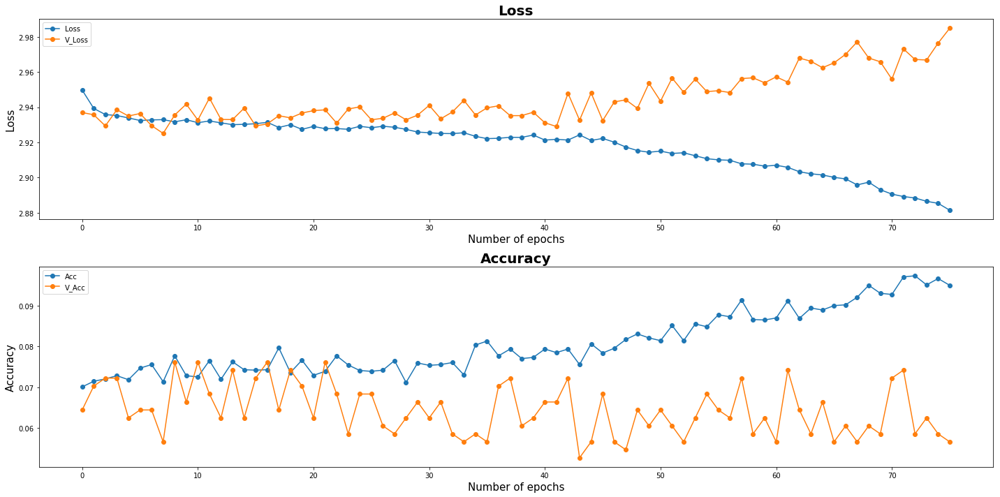

| Epoch [76] | Step [6100] | lr [0.009800] | Loss: [2.8814] | Acc: [0.1328] | Time: 0.0s
| Epoch [76] | Step [6150] | lr [0.009800] | Loss: [2.8940] | Acc: [0.1016] | Time: 0.0s
| Epoch [76] | Validation | Step [0] |  Loss: [2.9819] | Acc: [0.0547] | Time: 0.0s
| Epoch [76] | Validation | Step [1] |  Loss: [2.9620] | Acc: [0.0625] | Time: 0.0s
| Epoch [76] | Validation | Step [2] |  Loss: [2.9624] | Acc: [0.0469] | Time: 0.0s
| Epoch [76] | Validation | Step [3] |  Loss: [3.0009] | Acc: [0.0625] | Time: 0.0s


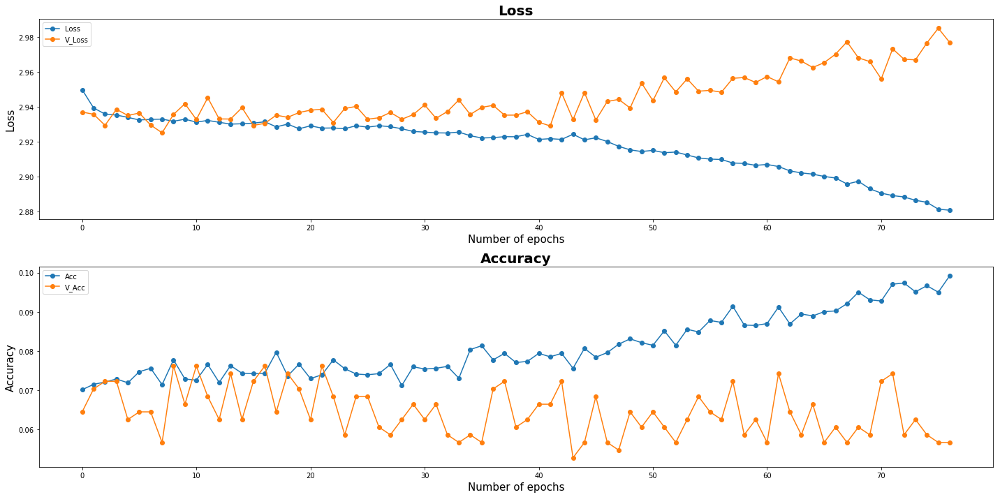

| Epoch [77] | Step [6200] | lr [0.009800] | Loss: [2.7973] | Acc: [0.1484] | Time: 0.0s
| Epoch [77] | Validation | Step [0] |  Loss: [3.0292] | Acc: [0.0078] | Time: 0.0s
| Epoch [77] | Validation | Step [1] |  Loss: [3.0046] | Acc: [0.0859] | Time: 0.0s
| Epoch [77] | Validation | Step [2] |  Loss: [2.9862] | Acc: [0.0547] | Time: 0.0s
| Epoch [77] | Validation | Step [3] |  Loss: [2.9306] | Acc: [0.0938] | Time: 0.0s


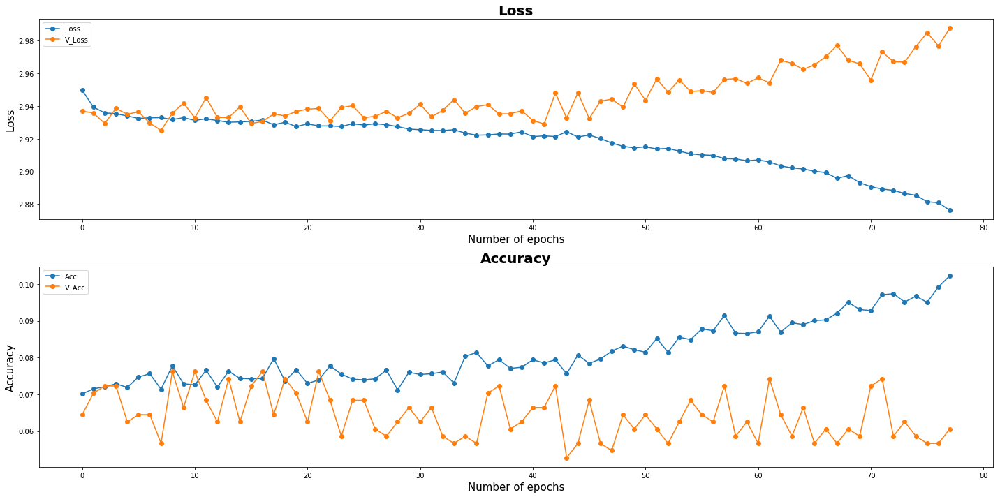

| Epoch [78] | Step [6250] | lr [0.009800] | Loss: [2.8634] | Acc: [0.0859] | Time: 0.0s
| Epoch [78] | Step [6300] | lr [0.009800] | Loss: [2.8900] | Acc: [0.0781] | Time: 0.0s
| Epoch [78] | Validation | Step [0] |  Loss: [2.9531] | Acc: [0.0469] | Time: 0.0s
| Epoch [78] | Validation | Step [1] |  Loss: [2.9602] | Acc: [0.0547] | Time: 0.0s
| Epoch [78] | Validation | Step [2] |  Loss: [3.0401] | Acc: [0.0469] | Time: 0.0s
| Epoch [78] | Validation | Step [3] |  Loss: [2.9347] | Acc: [0.0703] | Time: 0.0s


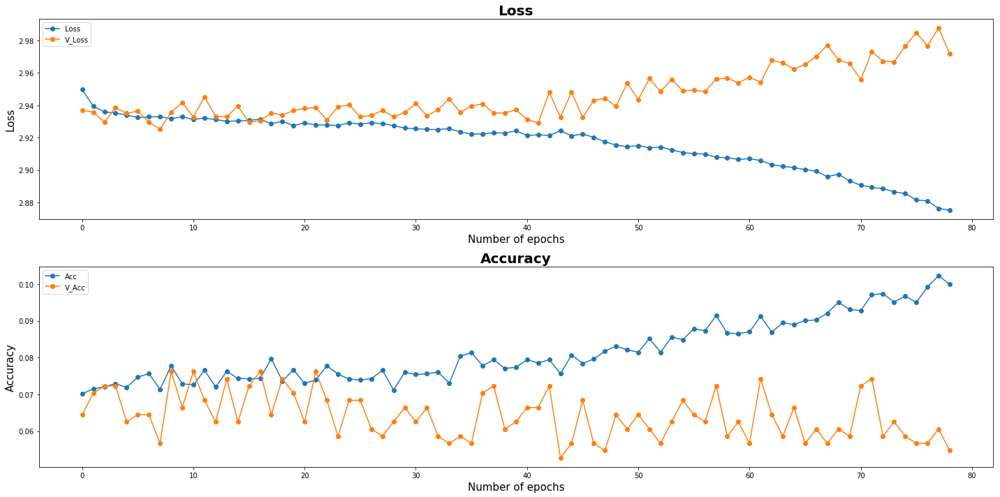

| Epoch [79] | Step [6350] | lr [0.009800] | Loss: [2.9447] | Acc: [0.0938] | Time: 0.0s
| Epoch [79] | Step [6400] | lr [0.009800] | Loss: [2.8993] | Acc: [0.1016] | Time: 0.0s
| Epoch [79] | Validation | Step [0] |  Loss: [3.0100] | Acc: [0.0312] | Time: 0.0s
| Epoch [79] | Validation | Step [1] |  Loss: [3.0632] | Acc: [0.0469] | Time: 0.0s
| Epoch [79] | Validation | Step [2] |  Loss: [2.9634] | Acc: [0.0859] | Time: 0.0s
| Epoch [79] | Validation | Step [3] |  Loss: [2.9698] | Acc: [0.0547] | Time: 0.0s


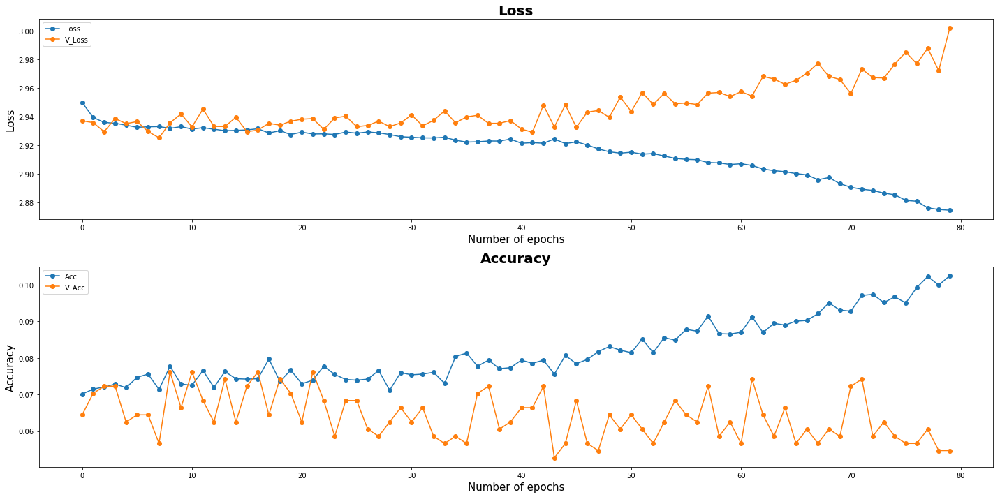

Model Saved
| Epoch [80] | Step [6450] | lr [0.009800] | Loss: [2.8643] | Acc: [0.1328] | Time: 0.0s
| Epoch [80] | Validation | Step [0] |  Loss: [3.0058] | Acc: [0.0469] | Time: 0.0s
| Epoch [80] | Validation | Step [1] |  Loss: [2.9792] | Acc: [0.0391] | Time: 0.0s
| Epoch [80] | Validation | Step [2] |  Loss: [3.0055] | Acc: [0.0547] | Time: 0.0s
| Epoch [80] | Validation | Step [3] |  Loss: [2.9670] | Acc: [0.0703] | Time: 0.0s


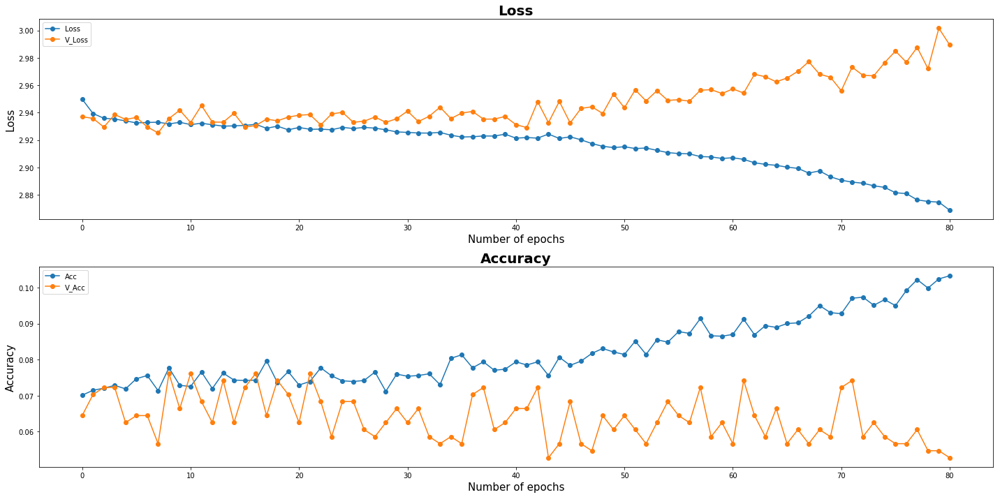

| Epoch [81] | Step [6500] | lr [0.009800] | Loss: [2.8778] | Acc: [0.0859] | Time: 0.0s
| Epoch [81] | Step [6550] | lr [0.009800] | Loss: [2.8620] | Acc: [0.1016] | Time: 0.0s
| Epoch [81] | Validation | Step [0] |  Loss: [2.9541] | Acc: [0.0625] | Time: 0.0s
| Epoch [81] | Validation | Step [1] |  Loss: [3.0019] | Acc: [0.0234] | Time: 0.0s
| Epoch [81] | Validation | Step [2] |  Loss: [2.9886] | Acc: [0.1016] | Time: 0.0s
| Epoch [81] | Validation | Step [3] |  Loss: [3.0531] | Acc: [0.0469] | Time: 0.0s


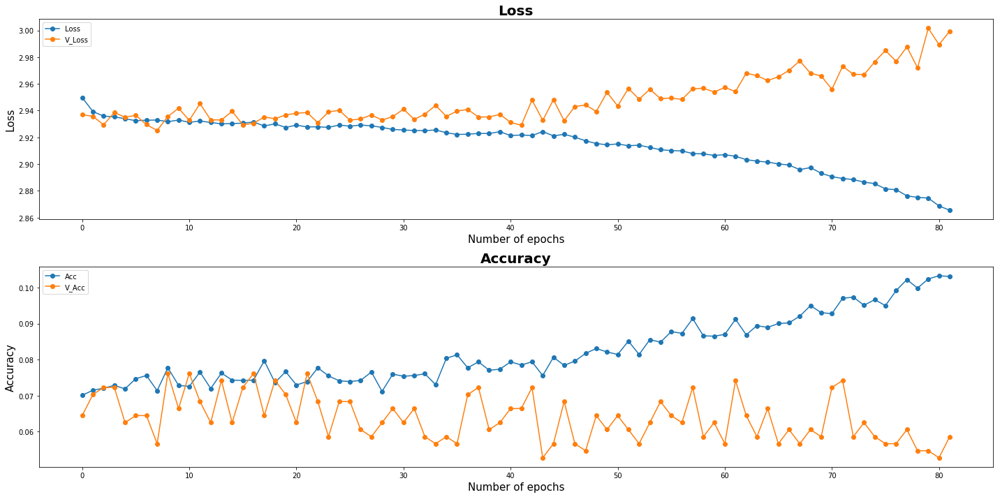

| Epoch [82] | Step [6600] | lr [0.009800] | Loss: [2.9412] | Acc: [0.0938] | Time: 0.0s
| Epoch [82] | Validation | Step [0] |  Loss: [3.0414] | Acc: [0.0156] | Time: 0.0s
| Epoch [82] | Validation | Step [1] |  Loss: [2.9544] | Acc: [0.0391] | Time: 0.0s
| Epoch [82] | Validation | Step [2] |  Loss: [3.0148] | Acc: [0.0469] | Time: 0.0s
| Epoch [82] | Validation | Step [3] |  Loss: [2.9848] | Acc: [0.0625] | Time: 0.0s


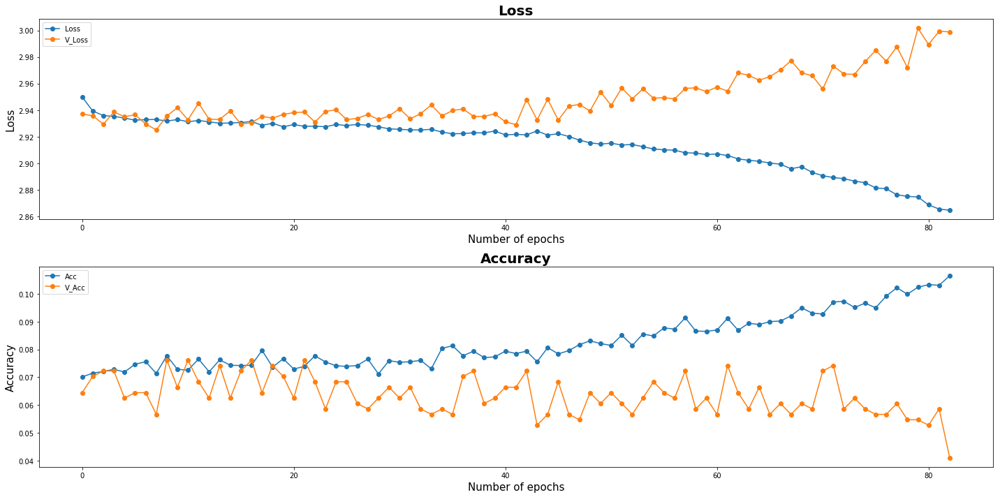

| Epoch [83] | Step [6650] | lr [0.009800] | Loss: [2.9297] | Acc: [0.0547] | Time: 0.0s
| Epoch [83] | Step [6700] | lr [0.009800] | Loss: [2.8455] | Acc: [0.1094] | Time: 0.0s
| Epoch [83] | Validation | Step [0] |  Loss: [3.0343] | Acc: [0.0625] | Time: 0.0s
| Epoch [83] | Validation | Step [1] |  Loss: [3.0317] | Acc: [0.0312] | Time: 0.0s
| Epoch [83] | Validation | Step [2] |  Loss: [3.0221] | Acc: [0.0625] | Time: 0.0s
| Epoch [83] | Validation | Step [3] |  Loss: [2.9376] | Acc: [0.0547] | Time: 0.0s


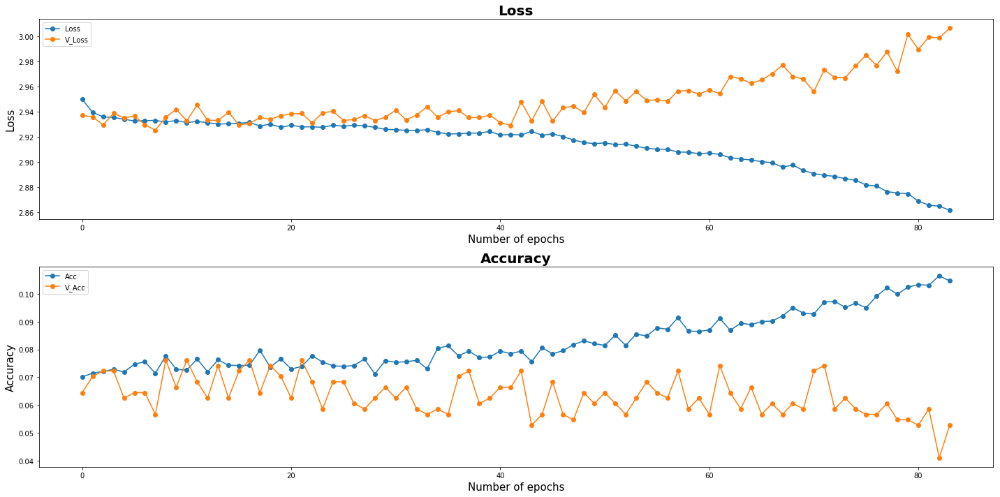

| Epoch [84] | Step [6750] | lr [0.009800] | Loss: [2.8443] | Acc: [0.1250] | Time: 0.0s
| Epoch [84] | Step [6800] | lr [0.009800] | Loss: [2.9048] | Acc: [0.1250] | Time: 0.0s
| Epoch [84] | Validation | Step [0] |  Loss: [2.9876] | Acc: [0.0547] | Time: 0.0s
| Epoch [84] | Validation | Step [1] |  Loss: [3.0125] | Acc: [0.0625] | Time: 0.0s
| Epoch [84] | Validation | Step [2] |  Loss: [3.0005] | Acc: [0.0703] | Time: 0.0s
| Epoch [84] | Validation | Step [3] |  Loss: [2.9589] | Acc: [0.0859] | Time: 0.0s


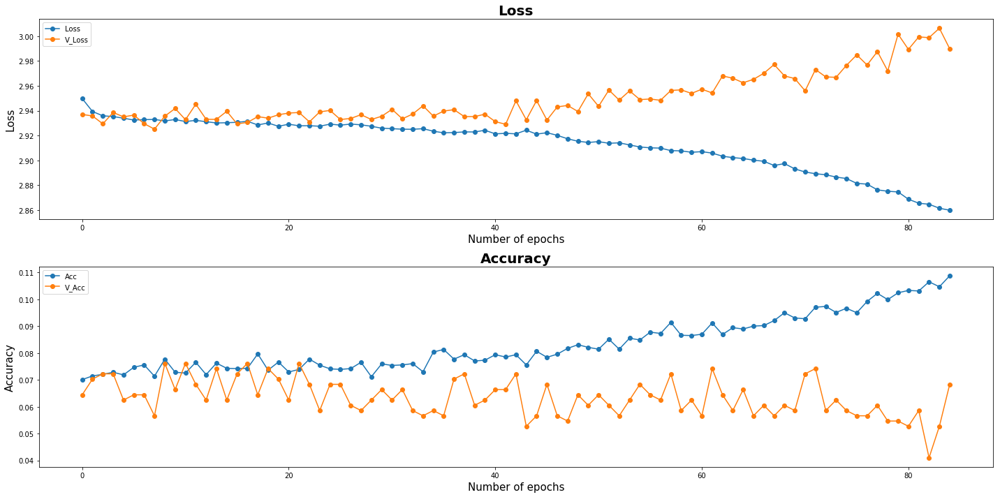

| Epoch [85] | Step [6850] | lr [0.009800] | Loss: [2.8244] | Acc: [0.1719] | Time: 0.0s
| Epoch [85] | Validation | Step [0] |  Loss: [3.0343] | Acc: [0.0234] | Time: 0.0s
| Epoch [85] | Validation | Step [1] |  Loss: [3.0121] | Acc: [0.0547] | Time: 0.0s
| Epoch [85] | Validation | Step [2] |  Loss: [2.9784] | Acc: [0.0703] | Time: 0.0s
| Epoch [85] | Validation | Step [3] |  Loss: [2.9544] | Acc: [0.0859] | Time: 0.0s


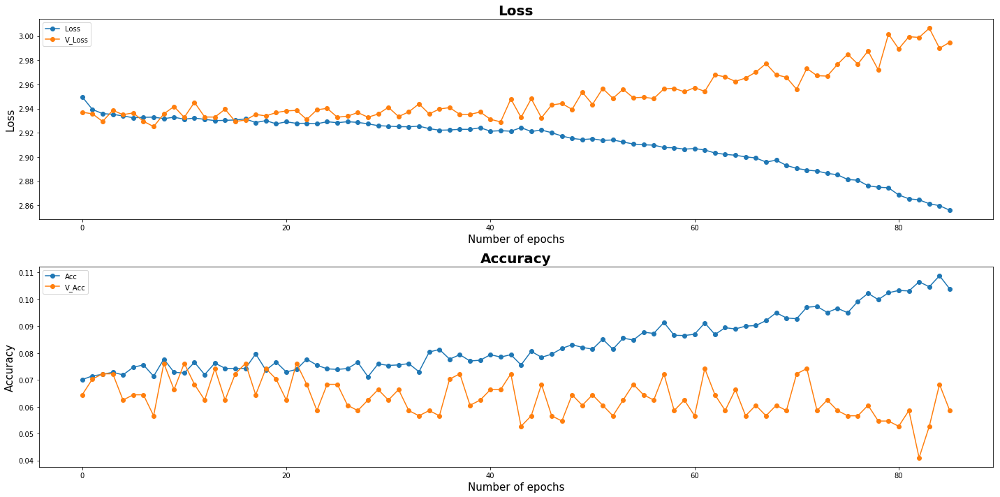

| Epoch [86] | Step [6900] | lr [0.009800] | Loss: [2.8286] | Acc: [0.1328] | Time: 0.0s
| Epoch [86] | Step [6950] | lr [0.009800] | Loss: [2.8995] | Acc: [0.0391] | Time: 0.0s
| Epoch [86] | Validation | Step [0] |  Loss: [2.9906] | Acc: [0.0703] | Time: 0.0s
| Epoch [86] | Validation | Step [1] |  Loss: [2.9663] | Acc: [0.0547] | Time: 0.0s
| Epoch [86] | Validation | Step [2] |  Loss: [2.9925] | Acc: [0.0547] | Time: 0.0s
| Epoch [86] | Validation | Step [3] |  Loss: [3.0532] | Acc: [0.0391] | Time: 0.0s


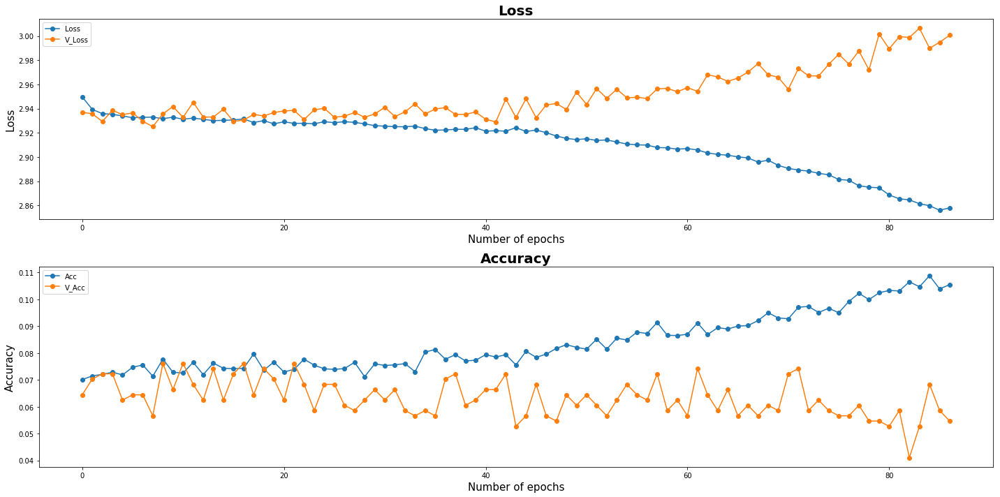

| Epoch [87] | Step [7000] | lr [0.009800] | Loss: [2.8612] | Acc: [0.0938] | Time: 0.0s
| Epoch [87] | Validation | Step [0] |  Loss: [2.9460] | Acc: [0.0625] | Time: 0.0s
| Epoch [87] | Validation | Step [1] |  Loss: [3.0136] | Acc: [0.0234] | Time: 0.0s
| Epoch [87] | Validation | Step [2] |  Loss: [3.0279] | Acc: [0.0859] | Time: 0.0s
| Epoch [87] | Validation | Step [3] |  Loss: [2.9727] | Acc: [0.0703] | Time: 0.0s


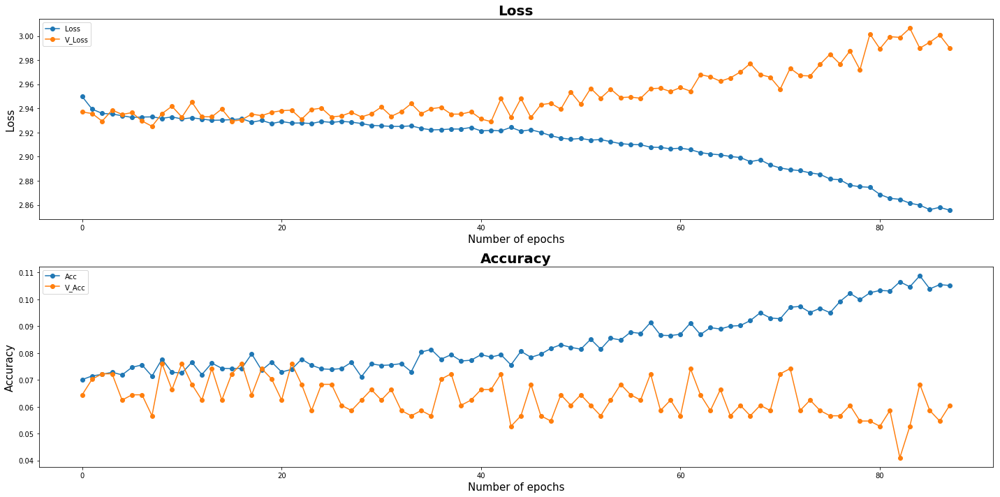

| Epoch [88] | Step [7050] | lr [0.009800] | Loss: [2.8300] | Acc: [0.1406] | Time: 0.0s
| Epoch [88] | Step [7100] | lr [0.009800] | Loss: [2.8065] | Acc: [0.1406] | Time: 0.0s
| Epoch [88] | Validation | Step [0] |  Loss: [2.9976] | Acc: [0.0781] | Time: 0.0s
| Epoch [88] | Validation | Step [1] |  Loss: [3.0354] | Acc: [0.0312] | Time: 0.0s
| Epoch [88] | Validation | Step [2] |  Loss: [2.9611] | Acc: [0.0469] | Time: 0.0s
| Epoch [88] | Validation | Step [3] |  Loss: [2.9723] | Acc: [0.0469] | Time: 0.0s


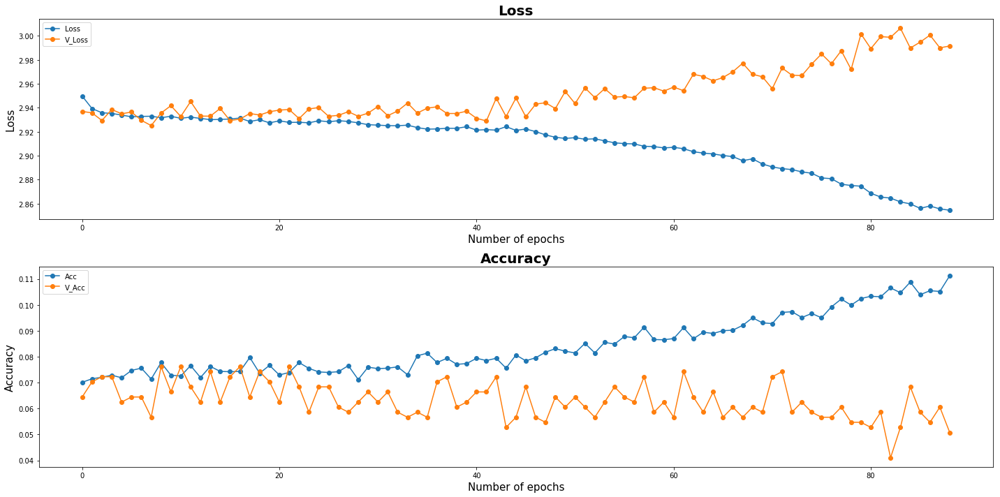

| Epoch [89] | Step [7150] | lr [0.009800] | Loss: [2.8333] | Acc: [0.1406] | Time: 0.0s
| Epoch [89] | Step [7200] | lr [0.009800] | Loss: [2.7999] | Acc: [0.1250] | Time: 0.0s
| Epoch [89] | Validation | Step [0] |  Loss: [2.9641] | Acc: [0.0625] | Time: 0.0s
| Epoch [89] | Validation | Step [1] |  Loss: [2.9993] | Acc: [0.0938] | Time: 0.0s
| Epoch [89] | Validation | Step [2] |  Loss: [3.0673] | Acc: [0.0547] | Time: 0.0s
| Epoch [89] | Validation | Step [3] |  Loss: [2.9771] | Acc: [0.0469] | Time: 0.0s


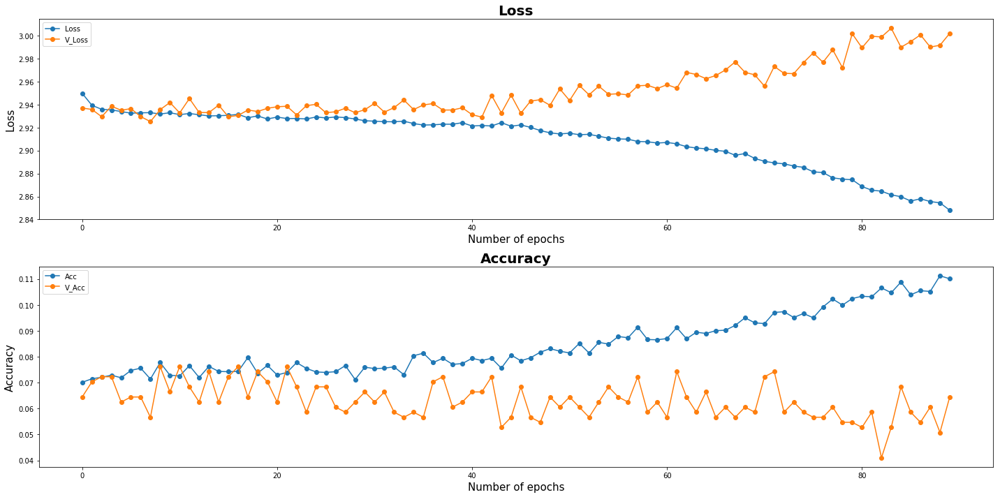

Model Saved
| Epoch [90] | Step [7250] | lr [0.009800] | Loss: [2.8655] | Acc: [0.1016] | Time: 0.0s
| Epoch [90] | Validation | Step [0] |  Loss: [3.0196] | Acc: [0.0703] | Time: 0.0s
| Epoch [90] | Validation | Step [1] |  Loss: [3.0857] | Acc: [0.0391] | Time: 0.0s
| Epoch [90] | Validation | Step [2] |  Loss: [3.0508] | Acc: [0.0625] | Time: 0.0s
| Epoch [90] | Validation | Step [3] |  Loss: [2.9602] | Acc: [0.0703] | Time: 0.0s


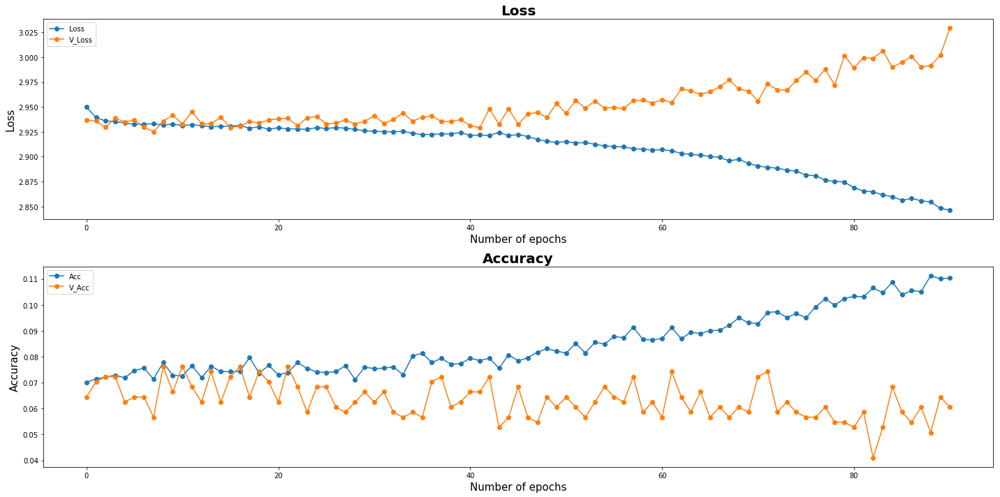

| Epoch [91] | Step [7300] | lr [0.009800] | Loss: [2.8201] | Acc: [0.1562] | Time: 0.0s
| Epoch [91] | Step [7350] | lr [0.009800] | Loss: [2.8315] | Acc: [0.1250] | Time: 0.0s
| Epoch [91] | Validation | Step [0] |  Loss: [3.0380] | Acc: [0.0469] | Time: 0.0s
| Epoch [91] | Validation | Step [1] |  Loss: [3.0040] | Acc: [0.0547] | Time: 0.0s
| Epoch [91] | Validation | Step [2] |  Loss: [3.0300] | Acc: [0.0234] | Time: 0.0s
| Epoch [91] | Validation | Step [3] |  Loss: [3.0704] | Acc: [0.0234] | Time: 0.0s


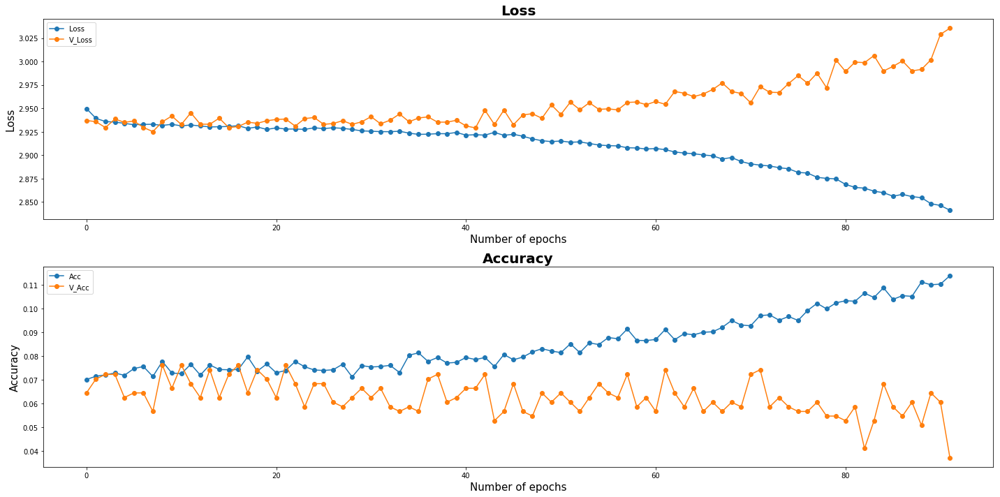

| Epoch [92] | Step [7400] | lr [0.009800] | Loss: [2.8637] | Acc: [0.1797] | Time: 0.0s
| Epoch [92] | Validation | Step [0] |  Loss: [2.9885] | Acc: [0.0703] | Time: 0.0s
| Epoch [92] | Validation | Step [1] |  Loss: [3.0821] | Acc: [0.0156] | Time: 0.0s
| Epoch [92] | Validation | Step [2] |  Loss: [3.0522] | Acc: [0.0391] | Time: 0.0s
| Epoch [92] | Validation | Step [3] |  Loss: [2.9618] | Acc: [0.1250] | Time: 0.0s


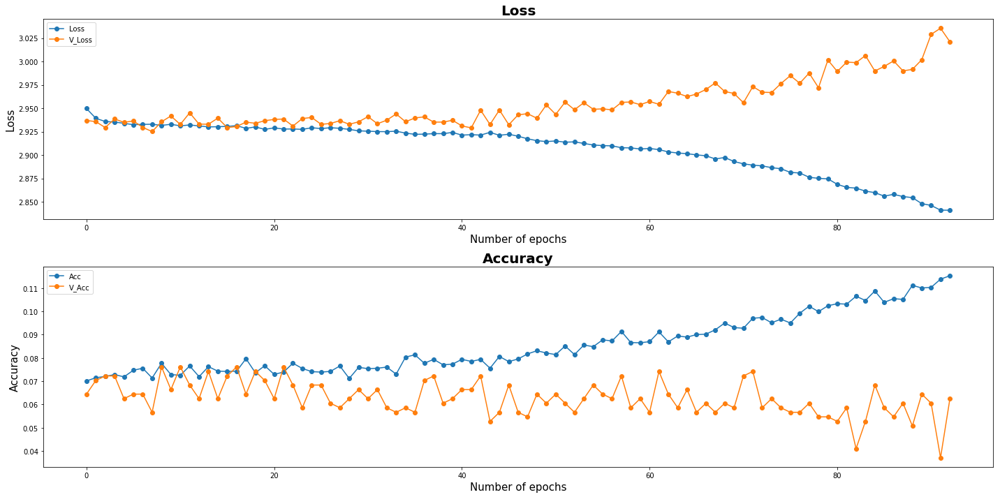

| Epoch [93] | Step [7450] | lr [0.009800] | Loss: [2.8285] | Acc: [0.1641] | Time: 0.0s
| Epoch [93] | Step [7500] | lr [0.009800] | Loss: [2.8519] | Acc: [0.0859] | Time: 0.0s
| Epoch [93] | Validation | Step [0] |  Loss: [3.0360] | Acc: [0.0625] | Time: 0.0s
| Epoch [93] | Validation | Step [1] |  Loss: [3.0963] | Acc: [0.0234] | Time: 0.0s
| Epoch [93] | Validation | Step [2] |  Loss: [3.0073] | Acc: [0.0469] | Time: 0.0s
| Epoch [93] | Validation | Step [3] |  Loss: [2.9805] | Acc: [0.0859] | Time: 0.0s


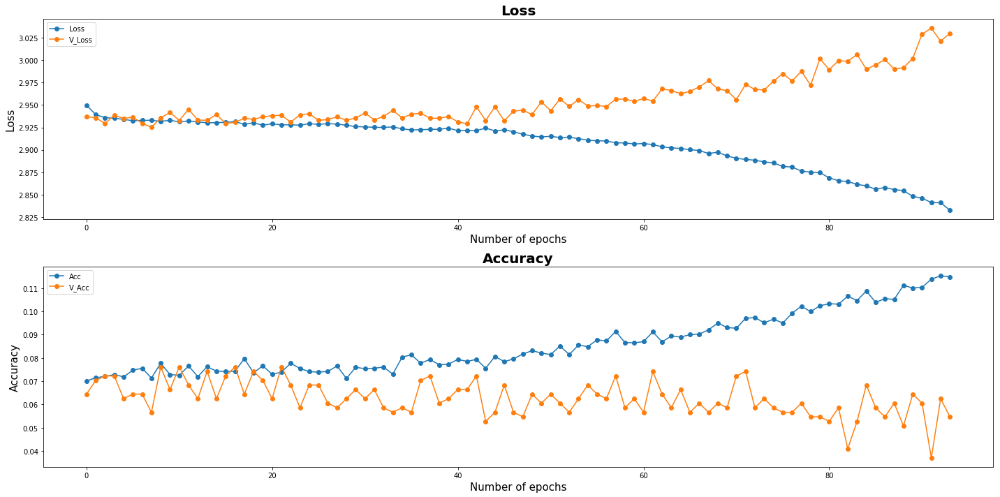

| Epoch [94] | Step [7550] | lr [0.009800] | Loss: [2.8333] | Acc: [0.1562] | Time: 0.0s
| Epoch [94] | Step [7600] | lr [0.009800] | Loss: [2.8518] | Acc: [0.1094] | Time: 0.0s
| Epoch [94] | Validation | Step [0] |  Loss: [2.9924] | Acc: [0.0391] | Time: 0.0s
| Epoch [94] | Validation | Step [1] |  Loss: [2.9708] | Acc: [0.0703] | Time: 0.0s
| Epoch [94] | Validation | Step [2] |  Loss: [3.0218] | Acc: [0.0781] | Time: 0.0s
| Epoch [94] | Validation | Step [3] |  Loss: [3.1276] | Acc: [0.0391] | Time: 0.0s


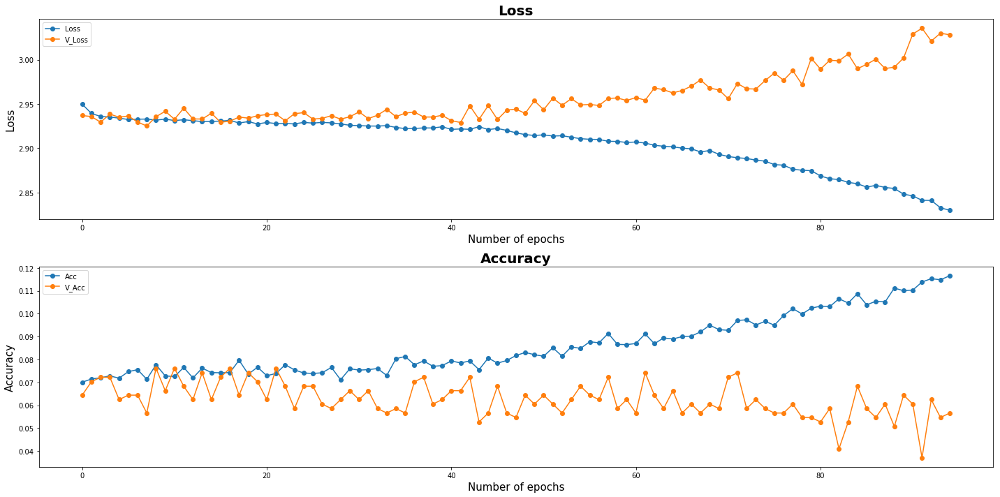

| Epoch [95] | Step [7650] | lr [0.009800] | Loss: [2.8147] | Acc: [0.1016] | Time: 0.0s
| Epoch [95] | Validation | Step [0] |  Loss: [2.9773] | Acc: [0.0703] | Time: 0.0s
| Epoch [95] | Validation | Step [1] |  Loss: [3.0550] | Acc: [0.0703] | Time: 0.0s
| Epoch [95] | Validation | Step [2] |  Loss: [3.0460] | Acc: [0.0469] | Time: 0.0s
| Epoch [95] | Validation | Step [3] |  Loss: [3.0776] | Acc: [0.0391] | Time: 0.0s


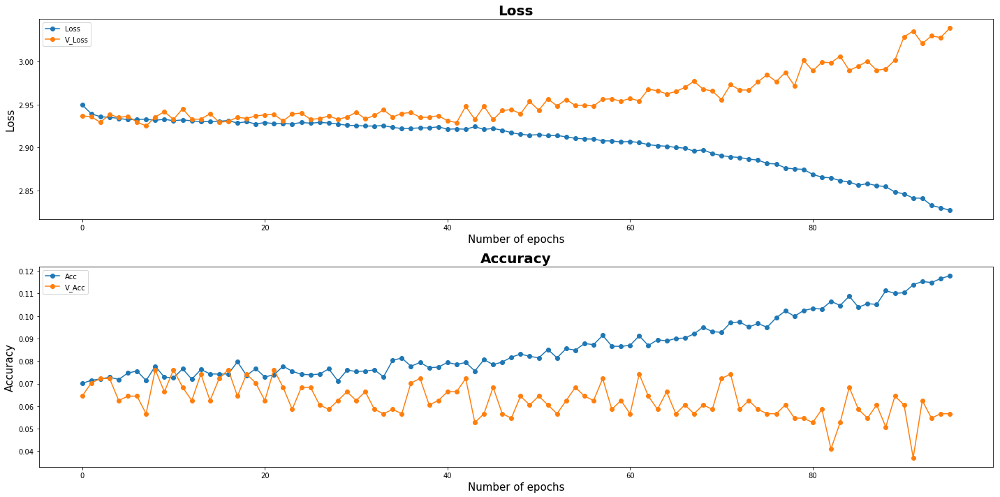

| Epoch [96] | Step [7700] | lr [0.009800] | Loss: [2.7211] | Acc: [0.1406] | Time: 0.0s
| Epoch [96] | Step [7750] | lr [0.009800] | Loss: [2.7632] | Acc: [0.1328] | Time: 0.0s
| Epoch [96] | Validation | Step [0] |  Loss: [3.0503] | Acc: [0.0547] | Time: 0.0s
| Epoch [96] | Validation | Step [1] |  Loss: [3.0534] | Acc: [0.0781] | Time: 0.0s
| Epoch [96] | Validation | Step [2] |  Loss: [3.0131] | Acc: [0.0547] | Time: 0.0s
| Epoch [96] | Validation | Step [3] |  Loss: [3.0238] | Acc: [0.0312] | Time: 0.0s


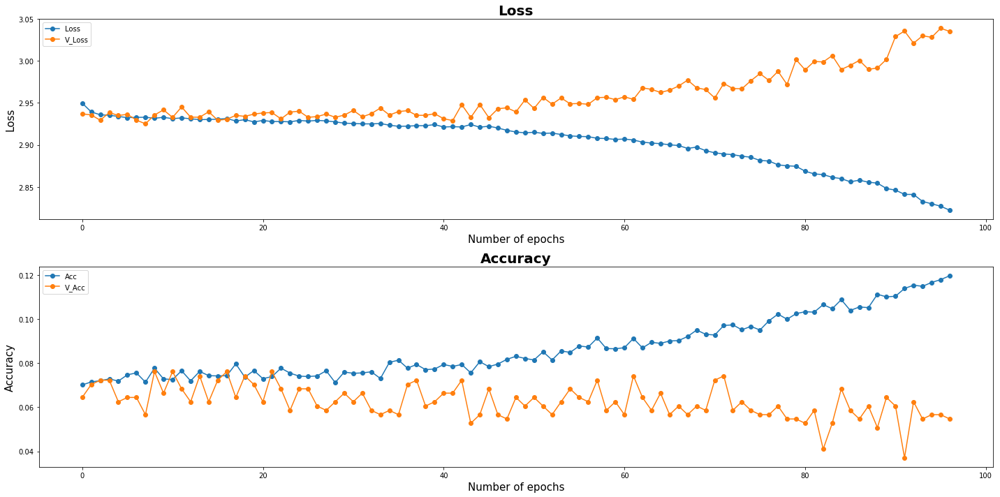

| Epoch [97] | Step [7800] | lr [0.009800] | Loss: [2.8487] | Acc: [0.1172] | Time: 0.0s
| Epoch [97] | Validation | Step [0] |  Loss: [3.1120] | Acc: [0.0469] | Time: 0.0s
| Epoch [97] | Validation | Step [1] |  Loss: [3.0489] | Acc: [0.0547] | Time: 0.0s
| Epoch [97] | Validation | Step [2] |  Loss: [3.0142] | Acc: [0.0547] | Time: 0.0s
| Epoch [97] | Validation | Step [3] |  Loss: [3.0836] | Acc: [0.0703] | Time: 0.0s


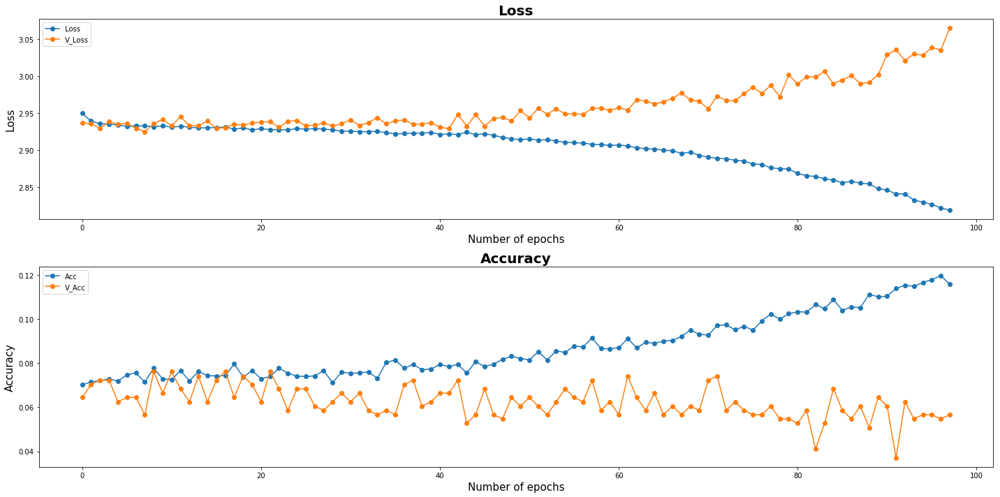

| Epoch [98] | Step [7850] | lr [0.009800] | Loss: [2.8068] | Acc: [0.1250] | Time: 0.0s
| Epoch [98] | Step [7900] | lr [0.009800] | Loss: [2.7530] | Acc: [0.1641] | Time: 0.0s
| Epoch [98] | Validation | Step [0] |  Loss: [3.1479] | Acc: [0.0156] | Time: 0.0s
| Epoch [98] | Validation | Step [1] |  Loss: [3.0537] | Acc: [0.0234] | Time: 0.0s
| Epoch [98] | Validation | Step [2] |  Loss: [2.9956] | Acc: [0.0547] | Time: 0.0s
| Epoch [98] | Validation | Step [3] |  Loss: [3.0575] | Acc: [0.0469] | Time: 0.0s


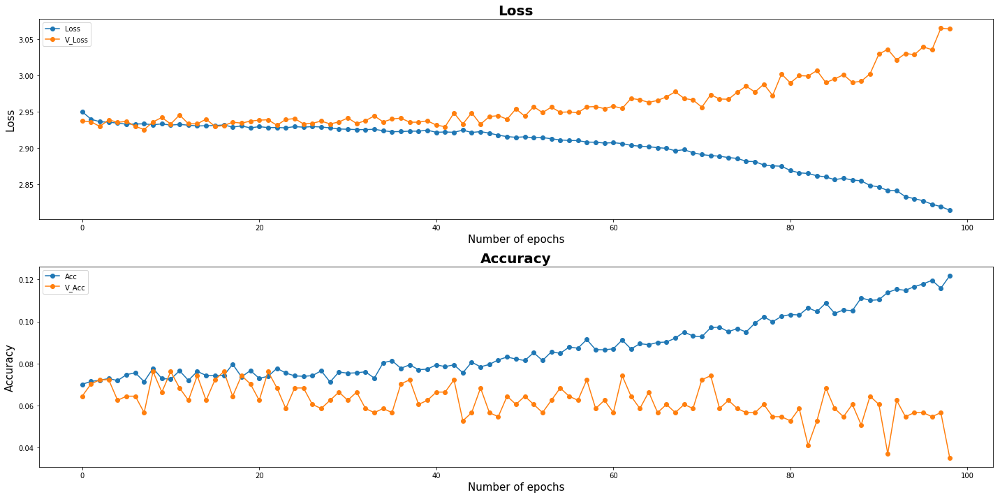

| Epoch [99] | Step [7950] | lr [0.009800] | Loss: [2.8117] | Acc: [0.1328] | Time: 0.0s
| Epoch [99] | Step [8000] | lr [0.009800] | Loss: [2.8183] | Acc: [0.1406] | Time: 0.0s
| Epoch [99] | Validation | Step [0] |  Loss: [3.0605] | Acc: [0.0312] | Time: 0.0s
| Epoch [99] | Validation | Step [1] |  Loss: [3.0191] | Acc: [0.0547] | Time: 0.0s
| Epoch [99] | Validation | Step [2] |  Loss: [3.0662] | Acc: [0.0469] | Time: 0.0s
| Epoch [99] | Validation | Step [3] |  Loss: [3.1012] | Acc: [0.0469] | Time: 0.0s


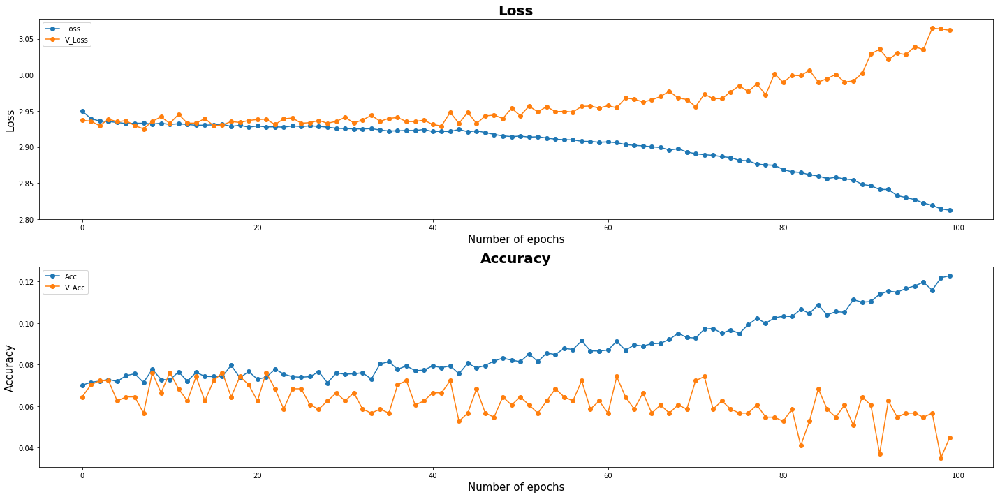

Model Saved
| Epoch [100] | Step [8050] | lr [0.009800] | Loss: [2.8701] | Acc: [0.1250] | Time: 0.0s
| Epoch [100] | Validation | Step [0] |  Loss: [3.0804] | Acc: [0.0312] | Time: 0.0s
| Epoch [100] | Validation | Step [1] |  Loss: [3.0676] | Acc: [0.0391] | Time: 0.0s
| Epoch [100] | Validation | Step [2] |  Loss: [3.0608] | Acc: [0.0234] | Time: 0.0s
| Epoch [100] | Validation | Step [3] |  Loss: [3.0318] | Acc: [0.0312] | Time: 0.0s


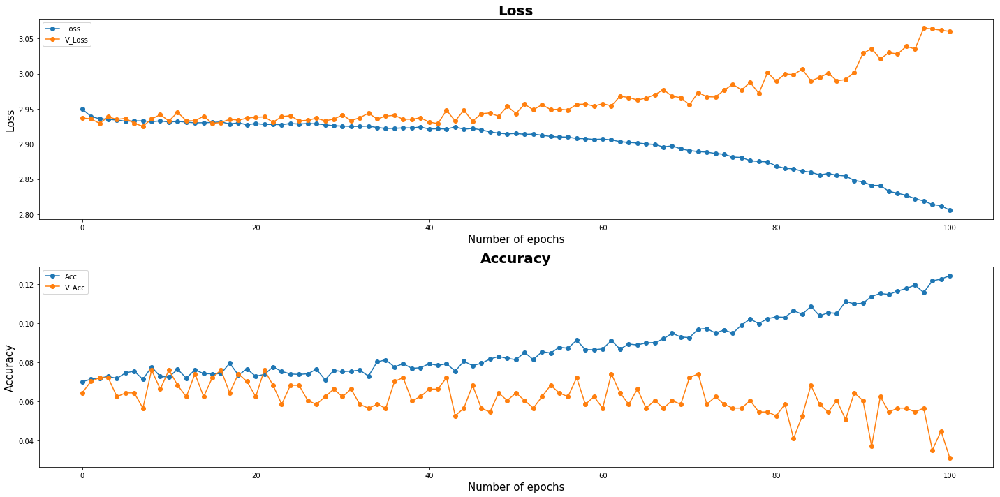

| Epoch [101] | Step [8100] | lr [0.009800] | Loss: [2.7251] | Acc: [0.1250] | Time: 0.0s
| Epoch [101] | Step [8150] | lr [0.009800] | Loss: [2.8303] | Acc: [0.0703] | Time: 0.0s
| Epoch [101] | Validation | Step [0] |  Loss: [3.0854] | Acc: [0.0781] | Time: 0.0s
| Epoch [101] | Validation | Step [1] |  Loss: [3.0333] | Acc: [0.0391] | Time: 0.0s
| Epoch [101] | Validation | Step [2] |  Loss: [3.0686] | Acc: [0.0234] | Time: 0.0s
| Epoch [101] | Validation | Step [3] |  Loss: [3.1235] | Acc: [0.0469] | Time: 0.0s


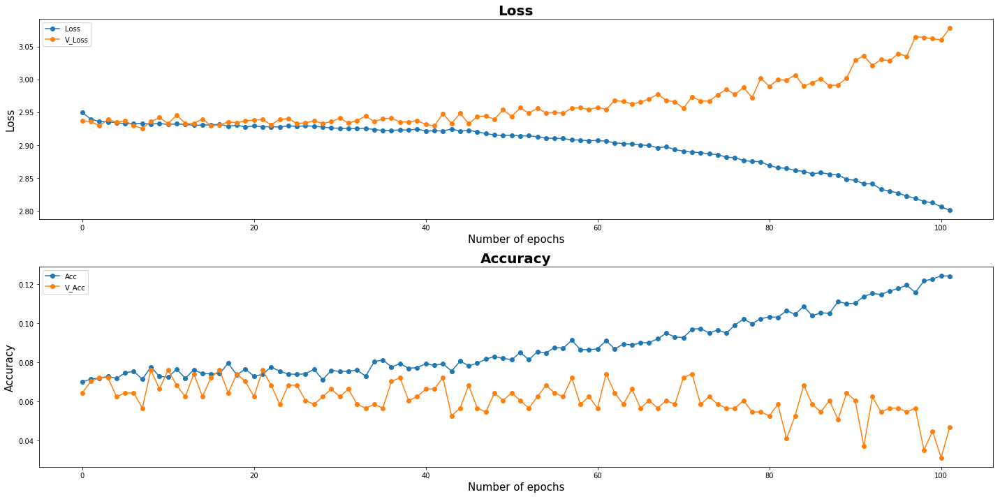

| Epoch [102] | Step [8200] | lr [0.009800] | Loss: [2.9011] | Acc: [0.0625] | Time: 0.0s
| Epoch [102] | Validation | Step [0] |  Loss: [3.1396] | Acc: [0.0312] | Time: 0.0s
| Epoch [102] | Validation | Step [1] |  Loss: [3.0507] | Acc: [0.0625] | Time: 0.0s
| Epoch [102] | Validation | Step [2] |  Loss: [3.0279] | Acc: [0.0625] | Time: 0.0s
| Epoch [102] | Validation | Step [3] |  Loss: [3.0711] | Acc: [0.0625] | Time: 0.0s


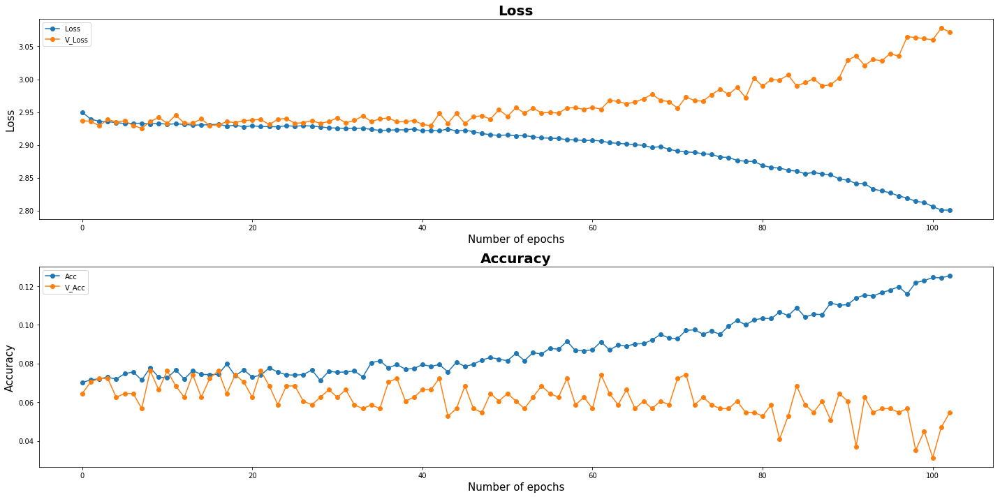

| Epoch [103] | Step [8250] | lr [0.009800] | Loss: [2.7111] | Acc: [0.1562] | Time: 0.0s
| Epoch [103] | Step [8300] | lr [0.009800] | Loss: [2.7914] | Acc: [0.1562] | Time: 0.0s
| Epoch [103] | Validation | Step [0] |  Loss: [3.0581] | Acc: [0.0703] | Time: 0.0s
| Epoch [103] | Validation | Step [1] |  Loss: [3.1193] | Acc: [0.0312] | Time: 0.0s
| Epoch [103] | Validation | Step [2] |  Loss: [3.0698] | Acc: [0.0469] | Time: 0.0s
| Epoch [103] | Validation | Step [3] |  Loss: [3.0945] | Acc: [0.0781] | Time: 0.0s


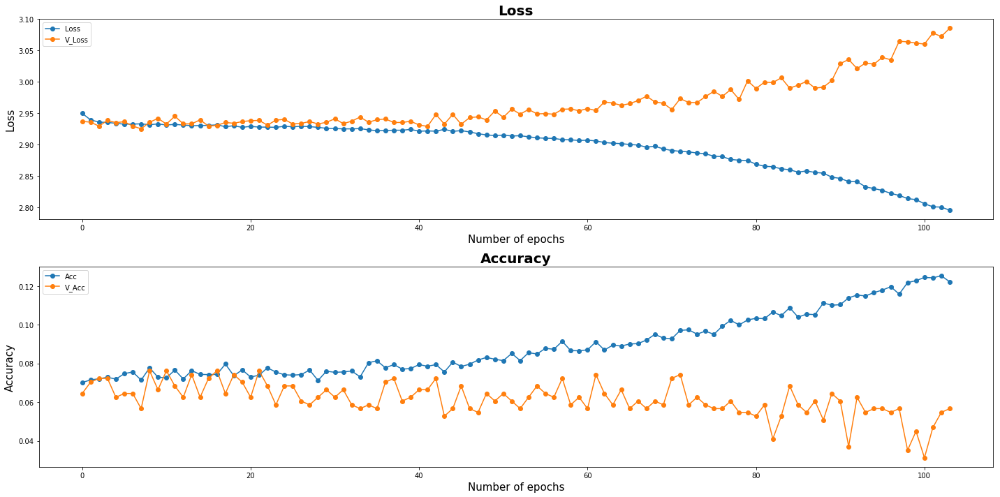

| Epoch [104] | Step [8350] | lr [0.009800] | Loss: [2.8212] | Acc: [0.1094] | Time: 0.0s
| Epoch [104] | Step [8400] | lr [0.009800] | Loss: [2.7674] | Acc: [0.1016] | Time: 0.0s
| Epoch [104] | Validation | Step [0] |  Loss: [3.0282] | Acc: [0.0469] | Time: 0.0s
| Epoch [104] | Validation | Step [1] |  Loss: [3.1720] | Acc: [0.0625] | Time: 0.0s
| Epoch [104] | Validation | Step [2] |  Loss: [3.1477] | Acc: [0.0234] | Time: 0.0s
| Epoch [104] | Validation | Step [3] |  Loss: [3.1024] | Acc: [0.0469] | Time: 0.0s


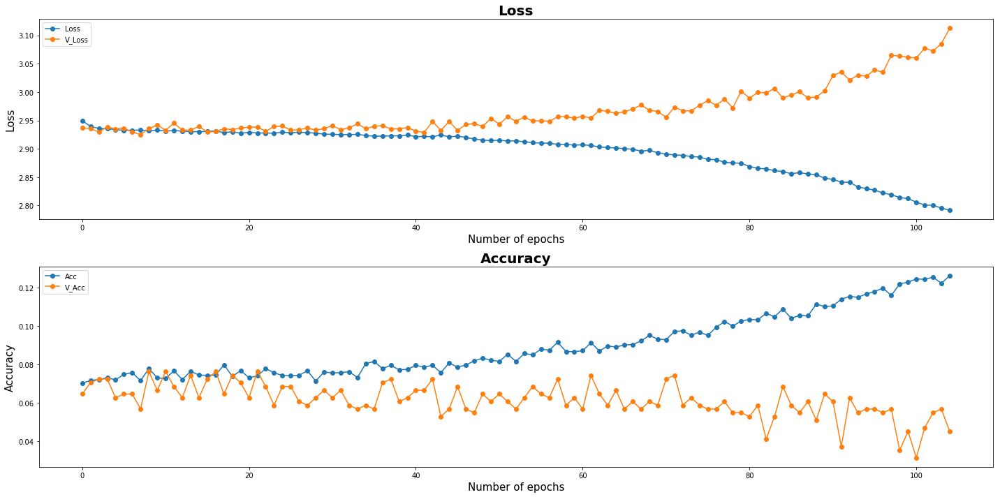

| Epoch [105] | Step [8450] | lr [0.009800] | Loss: [2.7340] | Acc: [0.1562] | Time: 0.0s
| Epoch [105] | Validation | Step [0] |  Loss: [3.1194] | Acc: [0.0391] | Time: 0.0s
| Epoch [105] | Validation | Step [1] |  Loss: [3.0885] | Acc: [0.0312] | Time: 0.0s
| Epoch [105] | Validation | Step [2] |  Loss: [3.1637] | Acc: [0.0547] | Time: 0.0s
| Epoch [105] | Validation | Step [3] |  Loss: [3.0501] | Acc: [0.0781] | Time: 0.0s


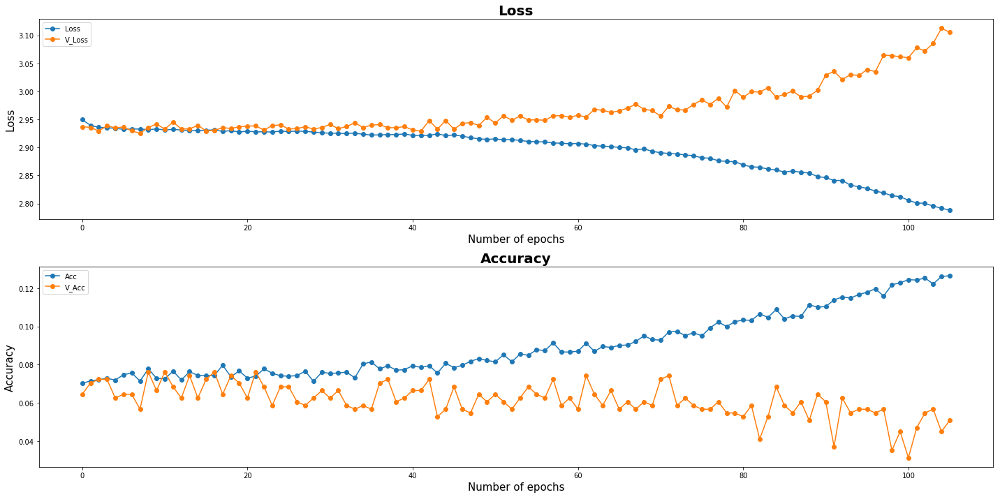

| Epoch [106] | Step [8500] | lr [0.009800] | Loss: [2.8155] | Acc: [0.1328] | Time: 0.0s
| Epoch [106] | Step [8550] | lr [0.009800] | Loss: [2.8179] | Acc: [0.1172] | Time: 0.0s
| Epoch [106] | Validation | Step [0] |  Loss: [3.0848] | Acc: [0.0625] | Time: 0.0s
| Epoch [106] | Validation | Step [1] |  Loss: [3.0691] | Acc: [0.1016] | Time: 0.0s
| Epoch [106] | Validation | Step [2] |  Loss: [3.0342] | Acc: [0.0312] | Time: 0.0s
| Epoch [106] | Validation | Step [3] |  Loss: [3.0994] | Acc: [0.0547] | Time: 0.0s


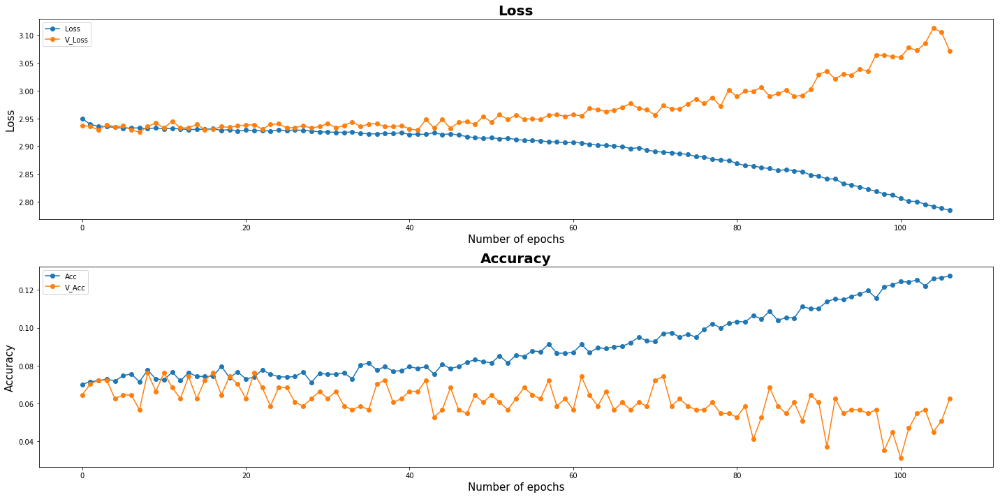

| Epoch [107] | Step [8600] | lr [0.009800] | Loss: [2.8143] | Acc: [0.1250] | Time: 0.0s
| Epoch [107] | Validation | Step [0] |  Loss: [3.0929] | Acc: [0.0469] | Time: 0.0s
| Epoch [107] | Validation | Step [1] |  Loss: [3.1048] | Acc: [0.0391] | Time: 0.0s
| Epoch [107] | Validation | Step [2] |  Loss: [3.0495] | Acc: [0.0859] | Time: 0.0s
| Epoch [107] | Validation | Step [3] |  Loss: [2.9860] | Acc: [0.0703] | Time: 0.0s


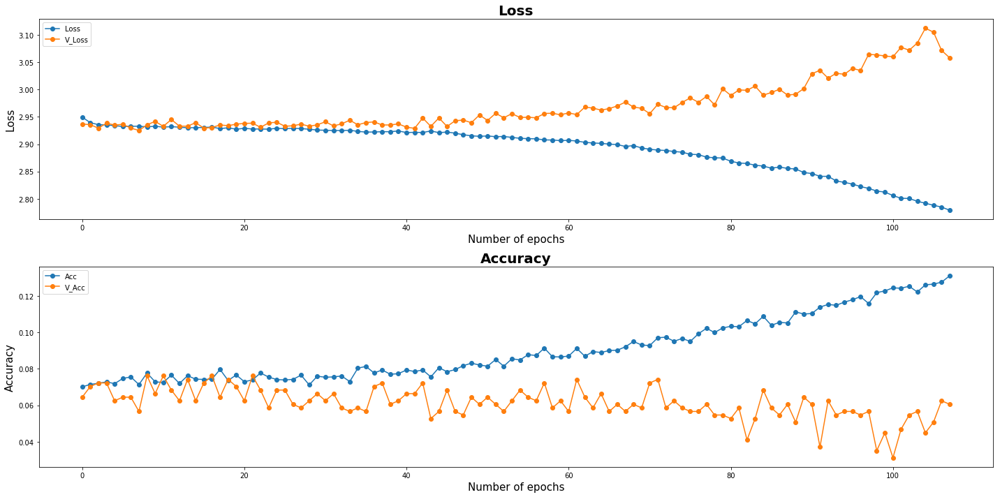

| Epoch [108] | Step [8650] | lr [0.009800] | Loss: [2.7664] | Acc: [0.1328] | Time: 0.0s
| Epoch [108] | Step [8700] | lr [0.009800] | Loss: [2.7834] | Acc: [0.1172] | Time: 0.0s
| Epoch [108] | Validation | Step [0] |  Loss: [3.1107] | Acc: [0.0625] | Time: 0.0s
| Epoch [108] | Validation | Step [1] |  Loss: [3.1197] | Acc: [0.0469] | Time: 0.0s
| Epoch [108] | Validation | Step [2] |  Loss: [3.0533] | Acc: [0.0938] | Time: 0.0s
| Epoch [108] | Validation | Step [3] |  Loss: [3.1658] | Acc: [0.0391] | Time: 0.0s


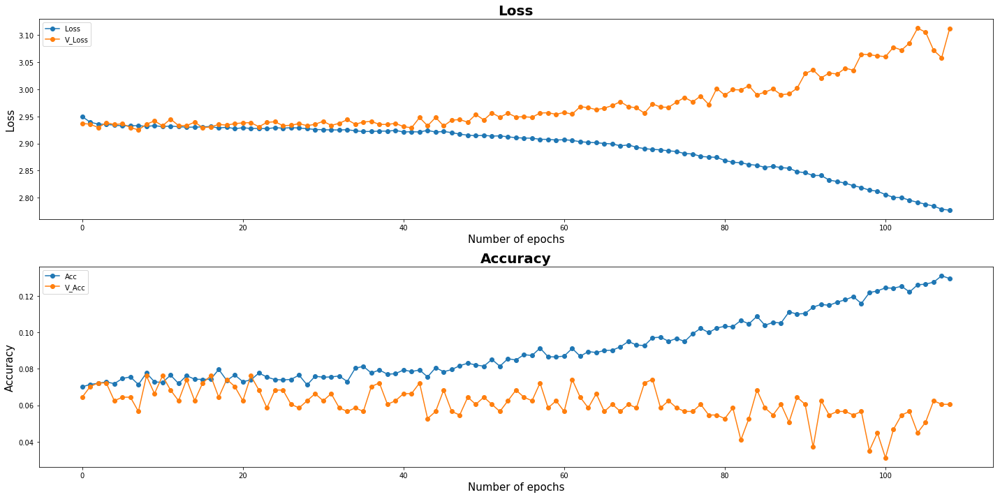

| Epoch [109] | Step [8750] | lr [0.009800] | Loss: [2.7576] | Acc: [0.1094] | Time: 0.0s
| Epoch [109] | Step [8800] | lr [0.009800] | Loss: [2.8769] | Acc: [0.0703] | Time: 0.0s
| Epoch [109] | Validation | Step [0] |  Loss: [3.1641] | Acc: [0.0312] | Time: 0.0s
| Epoch [109] | Validation | Step [1] |  Loss: [3.0940] | Acc: [0.0625] | Time: 0.0s
| Epoch [109] | Validation | Step [2] |  Loss: [2.9872] | Acc: [0.0547] | Time: 0.0s
| Epoch [109] | Validation | Step [3] |  Loss: [3.1351] | Acc: [0.0781] | Time: 0.0s


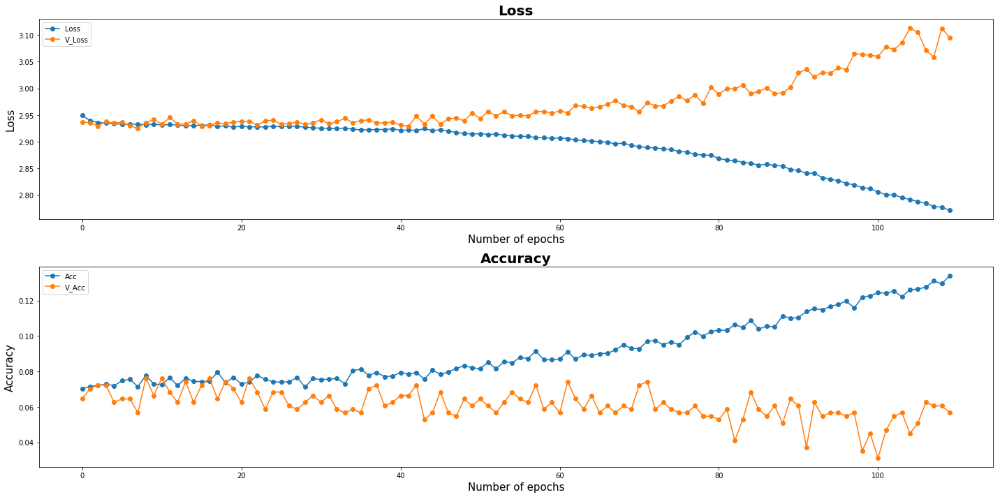

Model Saved
| Epoch [110] | Step [8850] | lr [0.009800] | Loss: [2.7045] | Acc: [0.1172] | Time: 0.0s
| Epoch [110] | Validation | Step [0] |  Loss: [3.1463] | Acc: [0.0312] | Time: 0.0s
| Epoch [110] | Validation | Step [1] |  Loss: [3.0578] | Acc: [0.0703] | Time: 0.0s
| Epoch [110] | Validation | Step [2] |  Loss: [3.0611] | Acc: [0.0859] | Time: 0.0s
| Epoch [110] | Validation | Step [3] |  Loss: [3.0487] | Acc: [0.0547] | Time: 0.0s


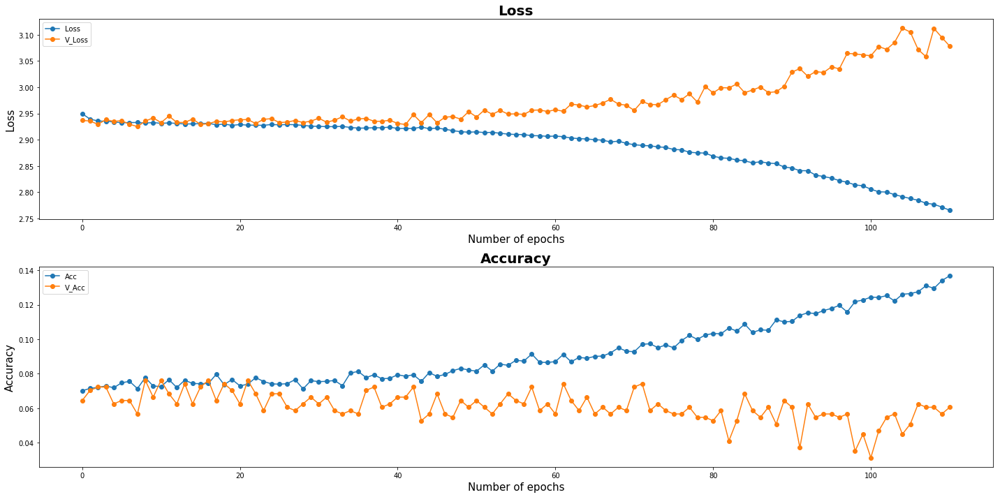

| Epoch [111] | Step [8900] | lr [0.009800] | Loss: [2.7539] | Acc: [0.1484] | Time: 0.0s
| Epoch [111] | Step [8950] | lr [0.009800] | Loss: [2.7530] | Acc: [0.1797] | Time: 0.0s
| Epoch [111] | Validation | Step [0] |  Loss: [3.1237] | Acc: [0.0312] | Time: 0.0s
| Epoch [111] | Validation | Step [1] |  Loss: [3.2050] | Acc: [0.0781] | Time: 0.0s
| Epoch [111] | Validation | Step [2] |  Loss: [3.0826] | Acc: [0.0781] | Time: 0.0s
| Epoch [111] | Validation | Step [3] |  Loss: [3.0172] | Acc: [0.0391] | Time: 0.0s


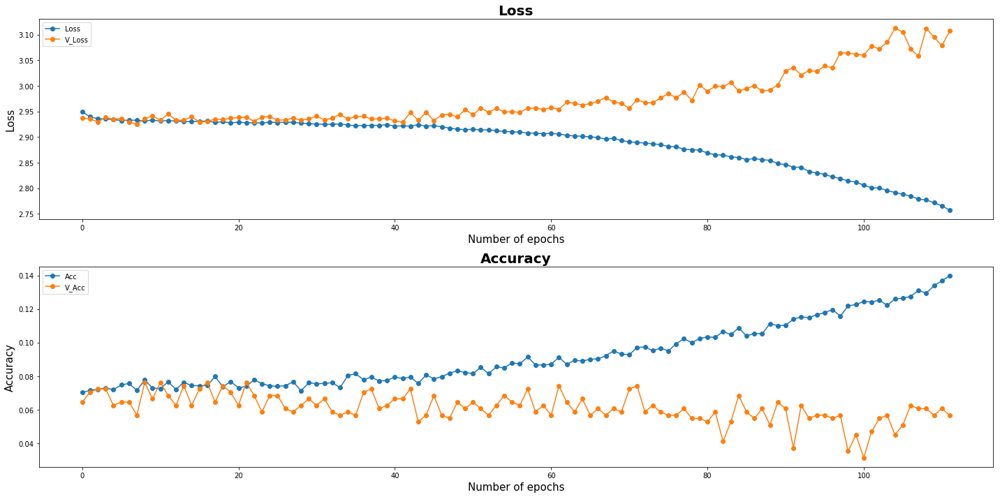

| Epoch [112] | Step [9000] | lr [0.009800] | Loss: [2.8494] | Acc: [0.0703] | Time: 0.0s
| Epoch [112] | Validation | Step [0] |  Loss: [3.0987] | Acc: [0.0469] | Time: 0.0s
| Epoch [112] | Validation | Step [1] |  Loss: [3.1035] | Acc: [0.0781] | Time: 0.0s
| Epoch [112] | Validation | Step [2] |  Loss: [3.1161] | Acc: [0.0625] | Time: 0.0s
| Epoch [112] | Validation | Step [3] |  Loss: [3.1517] | Acc: [0.0625] | Time: 0.0s


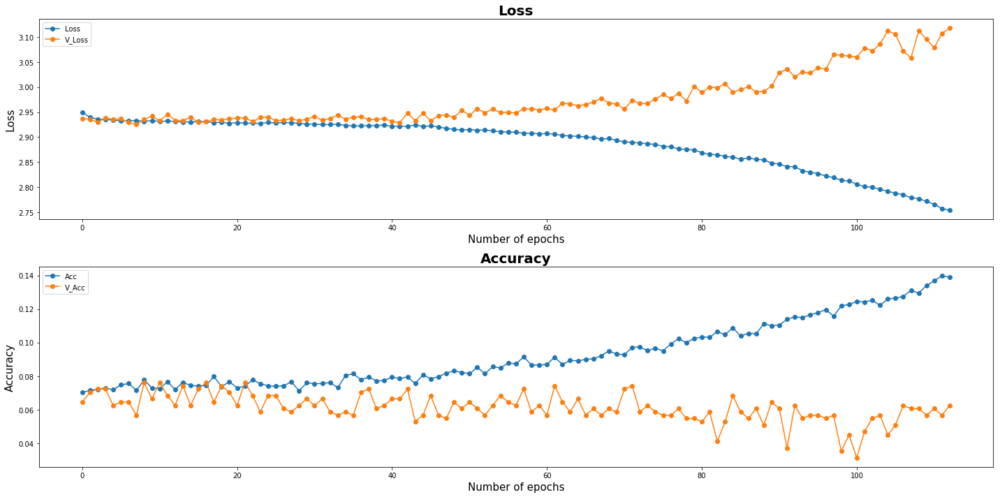

| Epoch [113] | Step [9050] | lr [0.009800] | Loss: [2.7056] | Acc: [0.1484] | Time: 0.0s
| Epoch [113] | Step [9100] | lr [0.009800] | Loss: [2.7534] | Acc: [0.1172] | Time: 0.0s
| Epoch [113] | Validation | Step [0] |  Loss: [3.1265] | Acc: [0.0312] | Time: 0.0s
| Epoch [113] | Validation | Step [1] |  Loss: [3.0581] | Acc: [0.0625] | Time: 0.0s
| Epoch [113] | Validation | Step [2] |  Loss: [3.0748] | Acc: [0.0938] | Time: 0.0s
| Epoch [113] | Validation | Step [3] |  Loss: [3.1285] | Acc: [0.0547] | Time: 0.0s


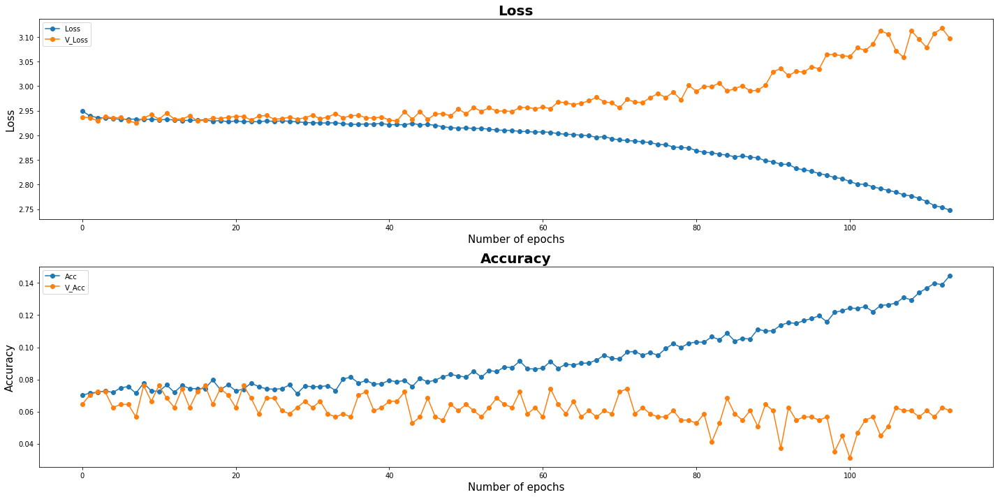

| Epoch [114] | Step [9150] | lr [0.009800] | Loss: [2.7564] | Acc: [0.1094] | Time: 0.0s
| Epoch [114] | Step [9200] | lr [0.009800] | Loss: [2.7442] | Acc: [0.1094] | Time: 0.0s
| Epoch [114] | Validation | Step [0] |  Loss: [3.1214] | Acc: [0.0547] | Time: 0.0s
| Epoch [114] | Validation | Step [1] |  Loss: [3.1362] | Acc: [0.0469] | Time: 0.0s
| Epoch [114] | Validation | Step [2] |  Loss: [3.1311] | Acc: [0.0469] | Time: 0.0s
| Epoch [114] | Validation | Step [3] |  Loss: [3.1596] | Acc: [0.0469] | Time: 0.0s


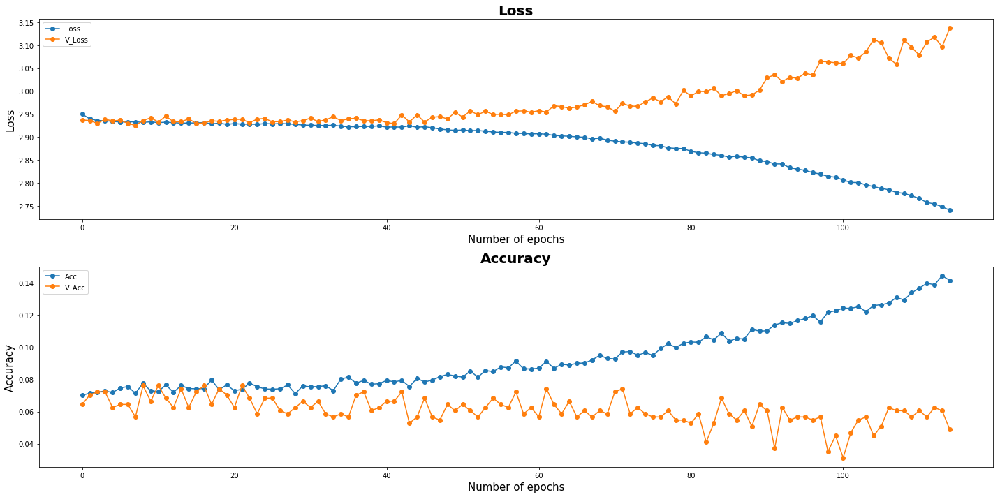

| Epoch [115] | Step [9250] | lr [0.009800] | Loss: [2.7522] | Acc: [0.1875] | Time: 0.0s
| Epoch [115] | Validation | Step [0] |  Loss: [3.0715] | Acc: [0.0391] | Time: 0.0s
| Epoch [115] | Validation | Step [1] |  Loss: [3.1689] | Acc: [0.0391] | Time: 0.0s
| Epoch [115] | Validation | Step [2] |  Loss: [3.1479] | Acc: [0.0625] | Time: 0.0s
| Epoch [115] | Validation | Step [3] |  Loss: [3.1073] | Acc: [0.0469] | Time: 0.0s


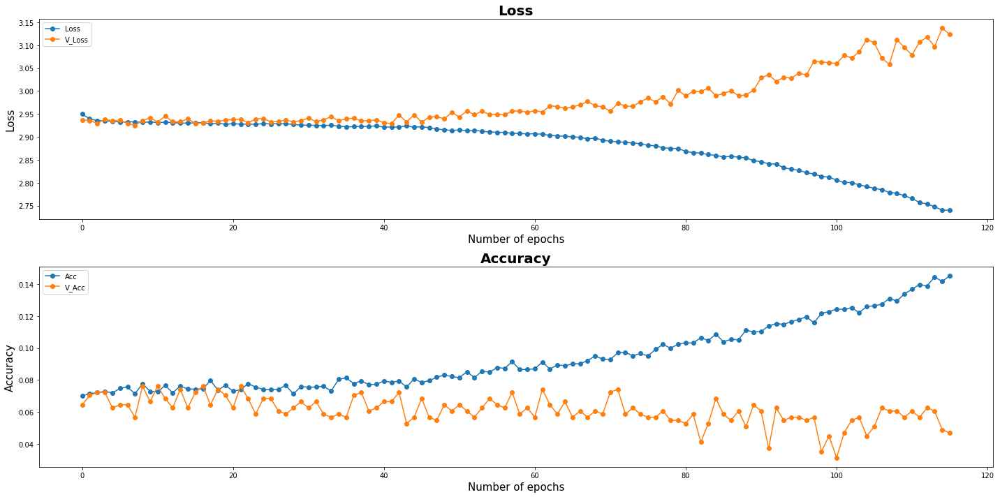

| Epoch [116] | Step [9300] | lr [0.009800] | Loss: [2.6730] | Acc: [0.1172] | Time: 0.0s
| Epoch [116] | Step [9350] | lr [0.009800] | Loss: [2.7093] | Acc: [0.1016] | Time: 0.0s
| Epoch [116] | Validation | Step [0] |  Loss: [3.1662] | Acc: [0.0625] | Time: 0.0s
| Epoch [116] | Validation | Step [1] |  Loss: [3.0850] | Acc: [0.0312] | Time: 0.0s
| Epoch [116] | Validation | Step [2] |  Loss: [3.1333] | Acc: [0.0156] | Time: 0.0s
| Epoch [116] | Validation | Step [3] |  Loss: [3.1274] | Acc: [0.0703] | Time: 0.0s


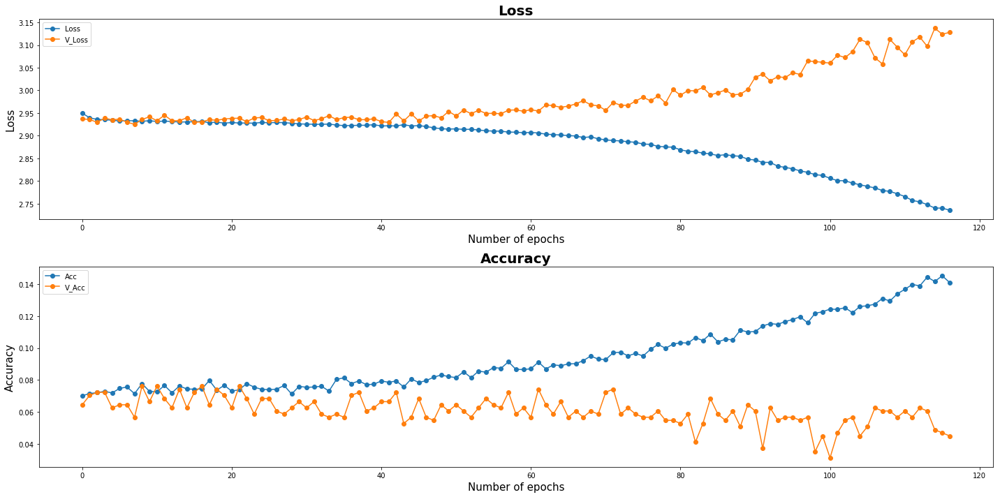

| Epoch [117] | Step [9400] | lr [0.009800] | Loss: [2.7508] | Acc: [0.1328] | Time: 0.0s
| Epoch [117] | Validation | Step [0] |  Loss: [3.0773] | Acc: [0.0312] | Time: 0.0s
| Epoch [117] | Validation | Step [1] |  Loss: [3.1442] | Acc: [0.0625] | Time: 0.0s
| Epoch [117] | Validation | Step [2] |  Loss: [3.1576] | Acc: [0.0312] | Time: 0.0s
| Epoch [117] | Validation | Step [3] |  Loss: [3.2017] | Acc: [0.0469] | Time: 0.0s


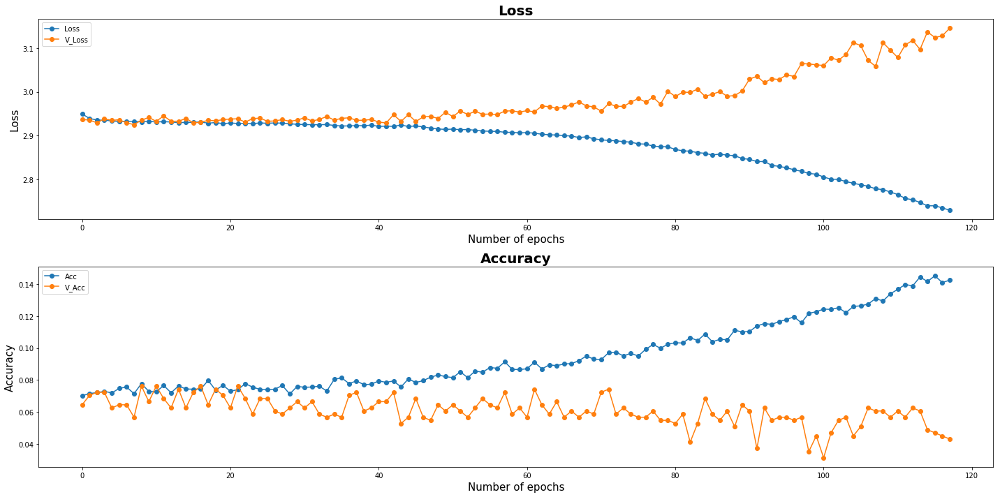

| Epoch [118] | Step [9450] | lr [0.009800] | Loss: [2.6914] | Acc: [0.1562] | Time: 0.0s
| Epoch [118] | Step [9500] | lr [0.009800] | Loss: [2.8373] | Acc: [0.1719] | Time: 0.0s
| Epoch [118] | Validation | Step [0] |  Loss: [3.0796] | Acc: [0.0391] | Time: 0.0s
| Epoch [118] | Validation | Step [1] |  Loss: [3.1212] | Acc: [0.0391] | Time: 0.0s
| Epoch [118] | Validation | Step [2] |  Loss: [3.2011] | Acc: [0.0469] | Time: 0.0s
| Epoch [118] | Validation | Step [3] |  Loss: [3.1833] | Acc: [0.0391] | Time: 0.0s


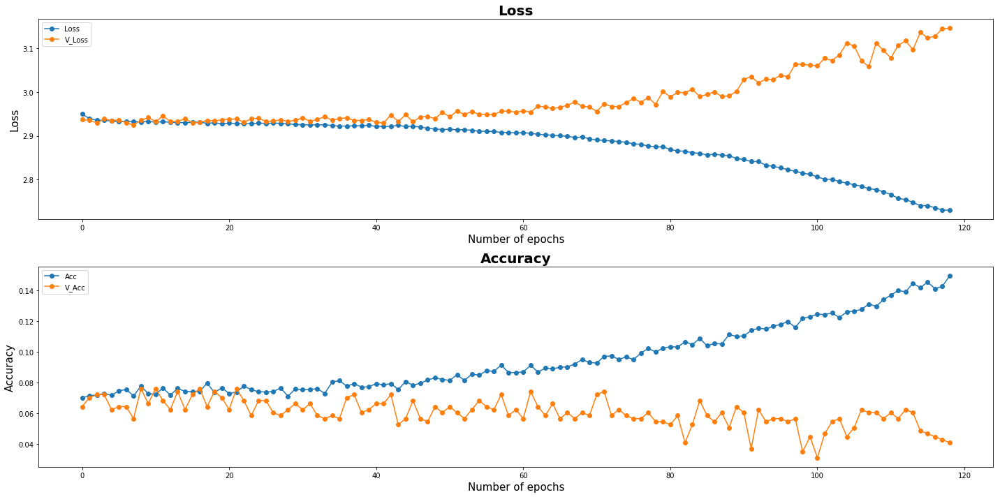

| Epoch [119] | Step [9550] | lr [0.009800] | Loss: [2.7839] | Acc: [0.1172] | Time: 0.0s
| Epoch [119] | Step [9600] | lr [0.009800] | Loss: [2.6935] | Acc: [0.1719] | Time: 0.0s
| Epoch [119] | Validation | Step [0] |  Loss: [3.1245] | Acc: [0.0547] | Time: 0.0s
| Epoch [119] | Validation | Step [1] |  Loss: [3.1548] | Acc: [0.0547] | Time: 0.0s
| Epoch [119] | Validation | Step [2] |  Loss: [3.0923] | Acc: [0.0703] | Time: 0.0s
| Epoch [119] | Validation | Step [3] |  Loss: [3.1788] | Acc: [0.0547] | Time: 0.0s


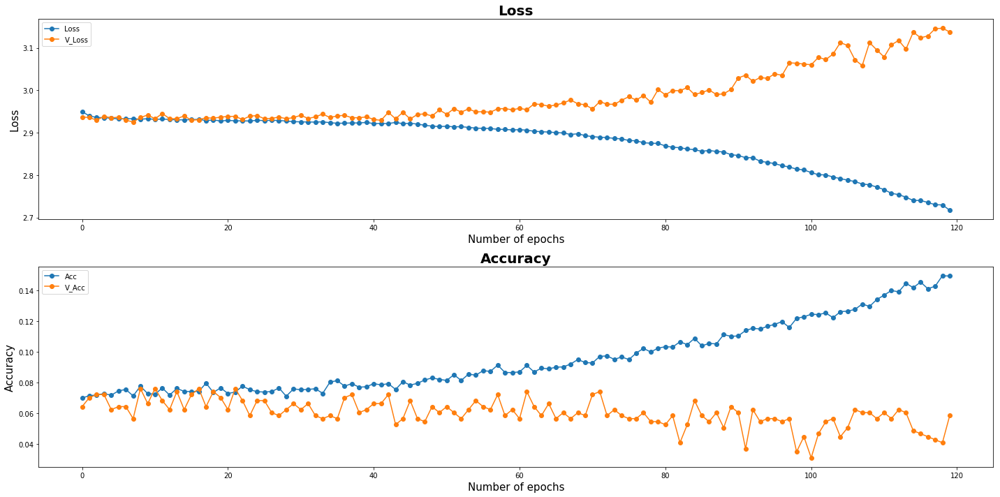

Model Saved
| Epoch [120] | Step [9650] | lr [0.009800] | Loss: [2.7752] | Acc: [0.1094] | Time: 0.0s
| Epoch [120] | Validation | Step [0] |  Loss: [3.1591] | Acc: [0.0938] | Time: 0.0s
| Epoch [120] | Validation | Step [1] |  Loss: [3.1027] | Acc: [0.0859] | Time: 0.0s
| Epoch [120] | Validation | Step [2] |  Loss: [3.0341] | Acc: [0.0703] | Time: 0.0s
| Epoch [120] | Validation | Step [3] |  Loss: [3.1759] | Acc: [0.0391] | Time: 0.0s


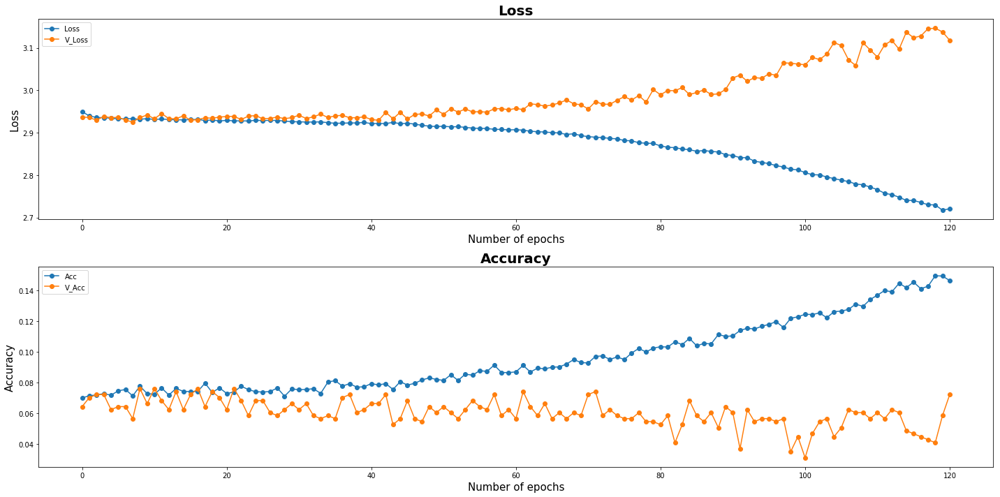

| Epoch [121] | Step [9700] | lr [0.009800] | Loss: [2.7056] | Acc: [0.1094] | Time: 0.0s
| Epoch [121] | Step [9750] | lr [0.009800] | Loss: [2.7384] | Acc: [0.1094] | Time: 0.0s
| Epoch [121] | Validation | Step [0] |  Loss: [3.1159] | Acc: [0.0547] | Time: 0.0s
| Epoch [121] | Validation | Step [1] |  Loss: [3.1245] | Acc: [0.0547] | Time: 0.0s
| Epoch [121] | Validation | Step [2] |  Loss: [3.1865] | Acc: [0.0391] | Time: 0.0s
| Epoch [121] | Validation | Step [3] |  Loss: [3.0816] | Acc: [0.0703] | Time: 0.0s


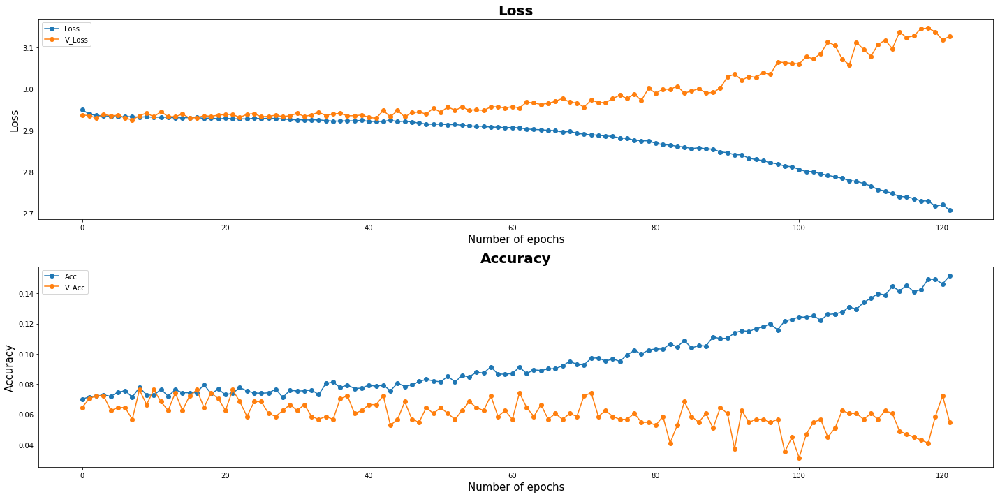

| Epoch [122] | Step [9800] | lr [0.009800] | Loss: [2.7651] | Acc: [0.0859] | Time: 0.0s
| Epoch [122] | Validation | Step [0] |  Loss: [3.0977] | Acc: [0.0938] | Time: 0.0s
| Epoch [122] | Validation | Step [1] |  Loss: [3.1214] | Acc: [0.0625] | Time: 0.0s
| Epoch [122] | Validation | Step [2] |  Loss: [3.1418] | Acc: [0.0703] | Time: 0.0s
| Epoch [122] | Validation | Step [3] |  Loss: [3.1843] | Acc: [0.0156] | Time: 0.0s


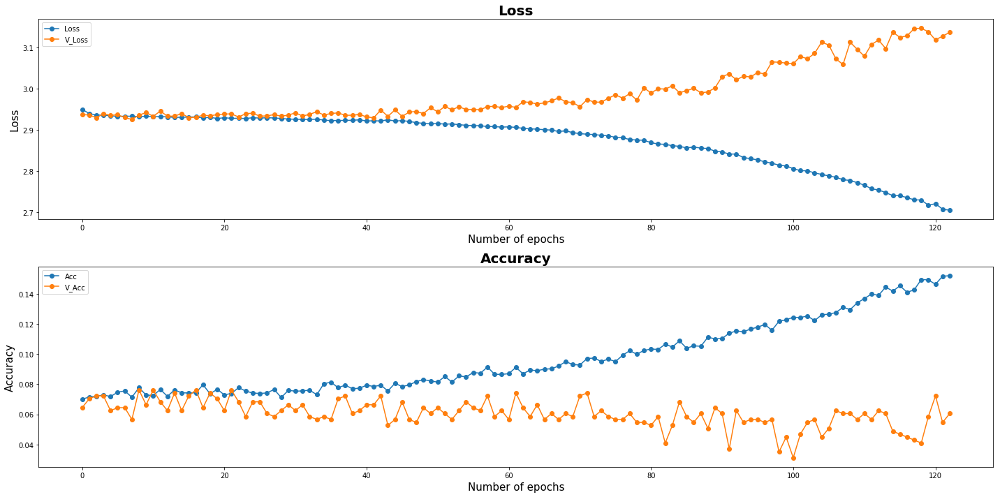

| Epoch [123] | Step [9850] | lr [0.009800] | Loss: [2.6344] | Acc: [0.1719] | Time: 0.0s
| Epoch [123] | Step [9900] | lr [0.009800] | Loss: [2.7910] | Acc: [0.1484] | Time: 0.0s
| Epoch [123] | Validation | Step [0] |  Loss: [3.1743] | Acc: [0.0625] | Time: 0.0s
| Epoch [123] | Validation | Step [1] |  Loss: [3.2320] | Acc: [0.0547] | Time: 0.0s
| Epoch [123] | Validation | Step [2] |  Loss: [3.0697] | Acc: [0.0781] | Time: 0.0s
| Epoch [123] | Validation | Step [3] |  Loss: [3.0600] | Acc: [0.0625] | Time: 0.0s


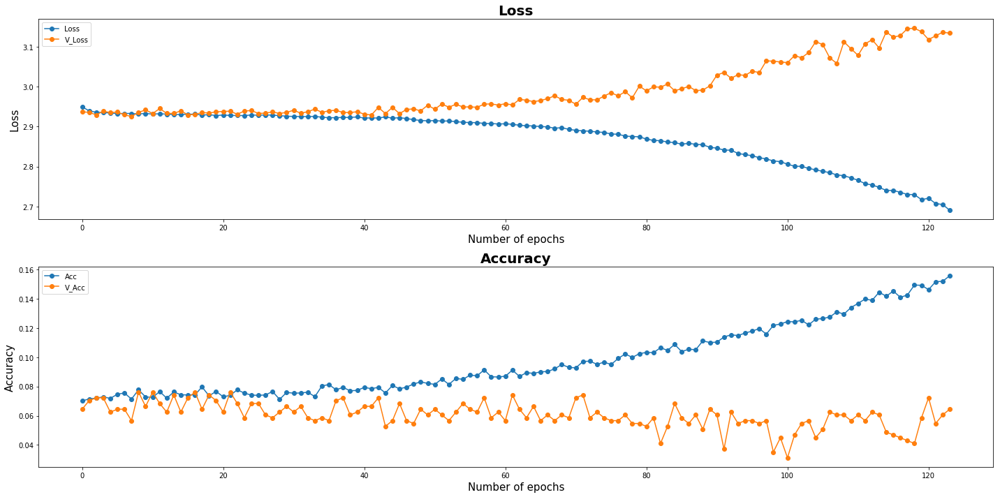

| Epoch [124] | Step [9950] | lr [0.009800] | Loss: [2.6243] | Acc: [0.1797] | Time: 0.0s
| Epoch [124] | Step [10000] | lr [0.009800] | Loss: [2.7518] | Acc: [0.1797] | Time: 0.0s
| Epoch [124] | Validation | Step [0] |  Loss: [3.1266] | Acc: [0.0547] | Time: 0.0s
| Epoch [124] | Validation | Step [1] |  Loss: [3.0753] | Acc: [0.0859] | Time: 0.0s
| Epoch [124] | Validation | Step [2] |  Loss: [3.1612] | Acc: [0.0547] | Time: 0.0s
| Epoch [124] | Validation | Step [3] |  Loss: [3.1855] | Acc: [0.0156] | Time: 0.0s


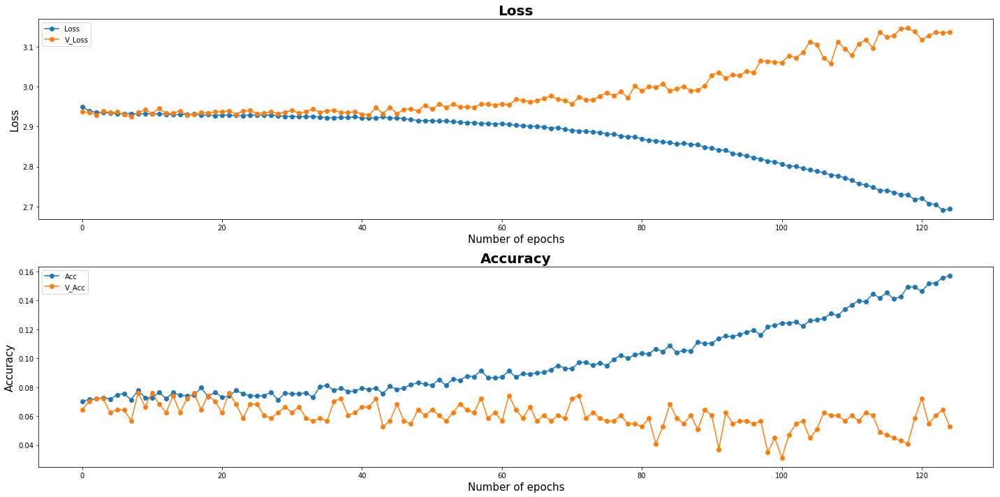

| Epoch [125] | Step [10050] | lr [0.009800] | Loss: [2.6430] | Acc: [0.1641] | Time: 0.0s
| Epoch [125] | Validation | Step [0] |  Loss: [3.2737] | Acc: [0.0391] | Time: 0.0s
| Epoch [125] | Validation | Step [1] |  Loss: [3.1814] | Acc: [0.0781] | Time: 0.0s
| Epoch [125] | Validation | Step [2] |  Loss: [3.1309] | Acc: [0.0234] | Time: 0.0s
| Epoch [125] | Validation | Step [3] |  Loss: [3.1604] | Acc: [0.0547] | Time: 0.0s


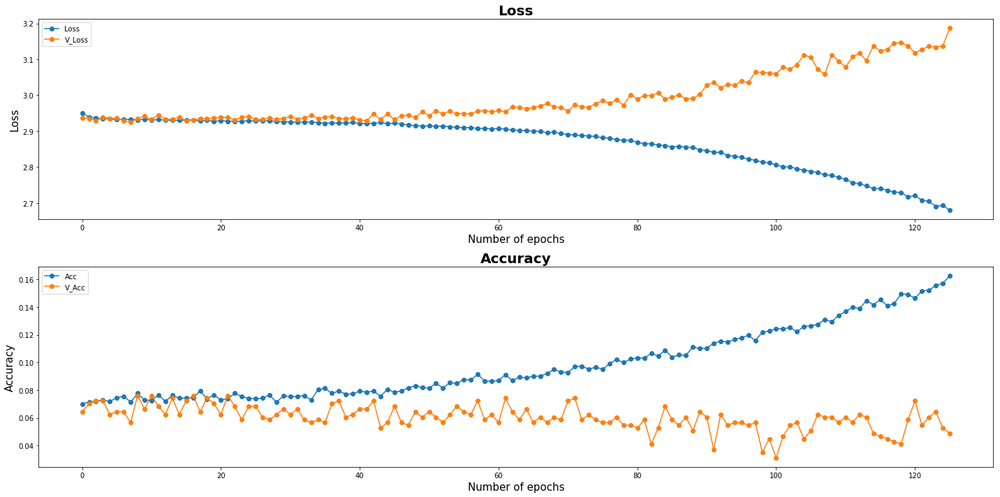

| Epoch [126] | Step [10100] | lr [0.009800] | Loss: [2.7029] | Acc: [0.1641] | Time: 0.0s
| Epoch [126] | Step [10150] | lr [0.009800] | Loss: [2.5387] | Acc: [0.2344] | Time: 0.0s
| Epoch [126] | Validation | Step [0] |  Loss: [3.1989] | Acc: [0.0625] | Time: 0.0s
| Epoch [126] | Validation | Step [1] |  Loss: [3.2009] | Acc: [0.0312] | Time: 0.0s
| Epoch [126] | Validation | Step [2] |  Loss: [3.1604] | Acc: [0.0391] | Time: 0.0s
| Epoch [126] | Validation | Step [3] |  Loss: [3.1231] | Acc: [0.0156] | Time: 0.0s


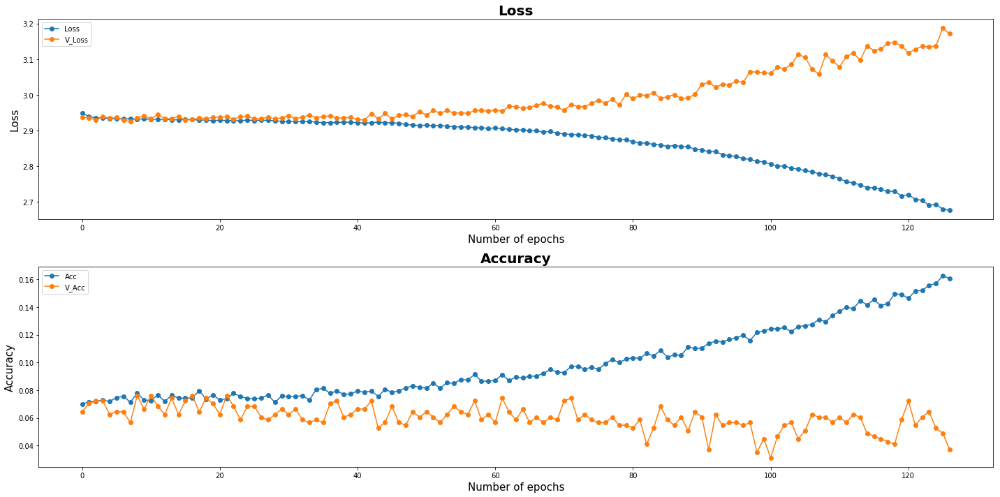

| Epoch [127] | Step [10200] | lr [0.009800] | Loss: [2.6385] | Acc: [0.1641] | Time: 0.0s
| Epoch [127] | Validation | Step [0] |  Loss: [3.2197] | Acc: [0.0625] | Time: 0.0s
| Epoch [127] | Validation | Step [1] |  Loss: [3.1287] | Acc: [0.0625] | Time: 0.0s
| Epoch [127] | Validation | Step [2] |  Loss: [3.1788] | Acc: [0.0547] | Time: 0.0s
| Epoch [127] | Validation | Step [3] |  Loss: [3.2711] | Acc: [0.0547] | Time: 0.0s


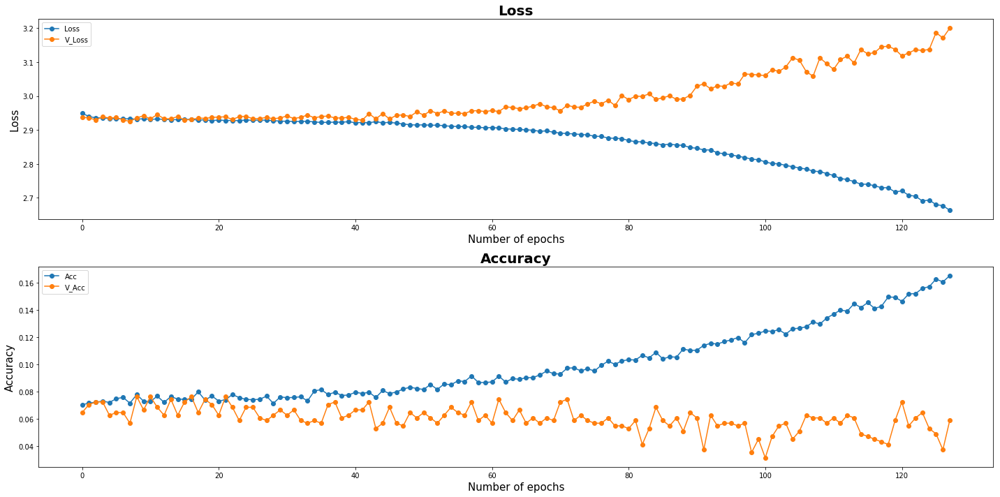

| Epoch [128] | Step [10250] | lr [0.009800] | Loss: [2.5974] | Acc: [0.1797] | Time: 0.0s
| Epoch [128] | Step [10300] | lr [0.009800] | Loss: [2.6469] | Acc: [0.1797] | Time: 0.0s
| Epoch [128] | Validation | Step [0] |  Loss: [3.2452] | Acc: [0.0391] | Time: 0.0s
| Epoch [128] | Validation | Step [1] |  Loss: [3.0313] | Acc: [0.0625] | Time: 0.0s
| Epoch [128] | Validation | Step [2] |  Loss: [3.2430] | Acc: [0.0312] | Time: 0.0s
| Epoch [128] | Validation | Step [3] |  Loss: [3.1680] | Acc: [0.0312] | Time: 0.0s


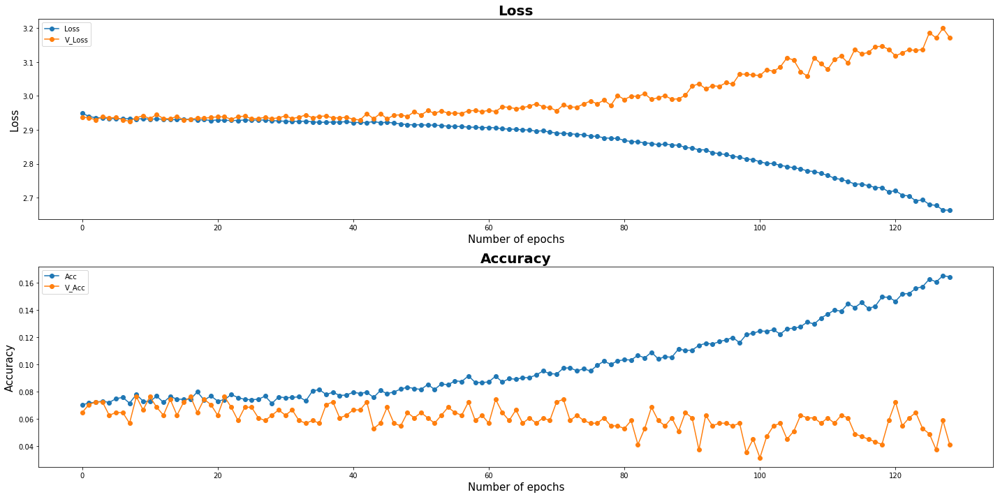

| Epoch [129] | Step [10350] | lr [0.009800] | Loss: [2.5920] | Acc: [0.1797] | Time: 0.0s
| Epoch [129] | Step [10400] | lr [0.009800] | Loss: [2.7391] | Acc: [0.1641] | Time: 0.0s
| Epoch [129] | Validation | Step [0] |  Loss: [3.2418] | Acc: [0.0469] | Time: 0.0s
| Epoch [129] | Validation | Step [1] |  Loss: [3.1791] | Acc: [0.0781] | Time: 0.0s
| Epoch [129] | Validation | Step [2] |  Loss: [3.2624] | Acc: [0.0625] | Time: 0.0s
| Epoch [129] | Validation | Step [3] |  Loss: [3.2202] | Acc: [0.0625] | Time: 0.0s


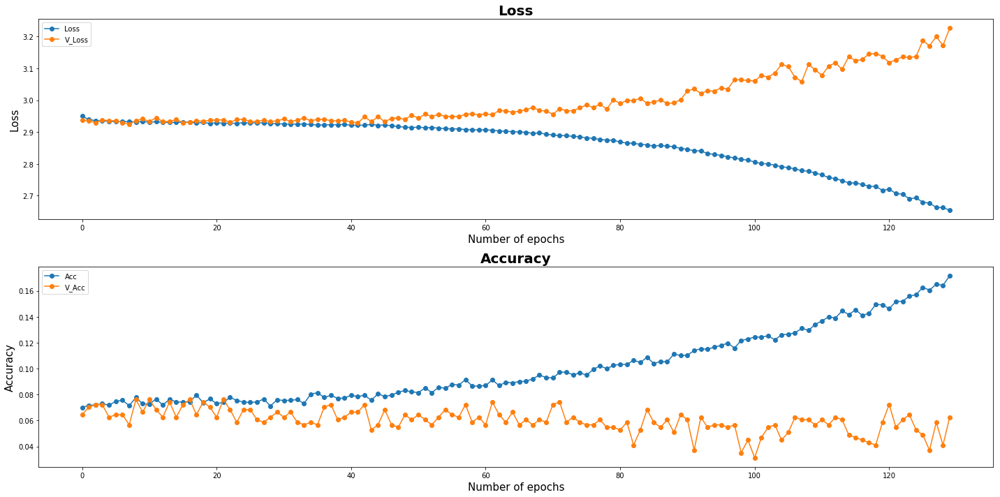

Model Saved
| Epoch [130] | Step [10450] | lr [0.009800] | Loss: [2.7075] | Acc: [0.1406] | Time: 0.0s
| Epoch [130] | Validation | Step [0] |  Loss: [3.0797] | Acc: [0.0938] | Time: 0.0s
| Epoch [130] | Validation | Step [1] |  Loss: [3.2412] | Acc: [0.0391] | Time: 0.0s
| Epoch [130] | Validation | Step [2] |  Loss: [3.1791] | Acc: [0.0312] | Time: 0.0s
| Epoch [130] | Validation | Step [3] |  Loss: [3.2838] | Acc: [0.0391] | Time: 0.0s


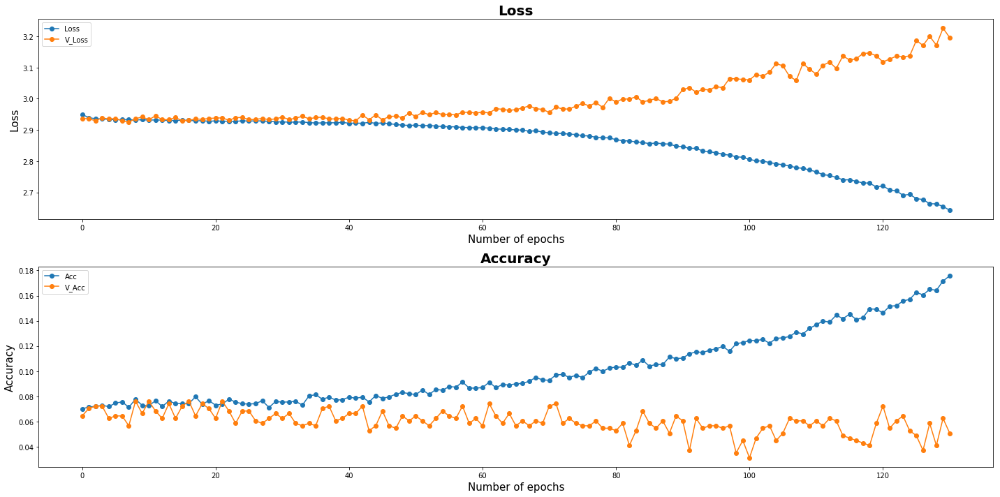

| Epoch [131] | Step [10500] | lr [0.009800] | Loss: [2.5412] | Acc: [0.2188] | Time: 0.0s
| Epoch [131] | Step [10550] | lr [0.009800] | Loss: [2.6271] | Acc: [0.1797] | Time: 0.0s
| Epoch [131] | Validation | Step [0] |  Loss: [3.2256] | Acc: [0.0547] | Time: 0.0s
| Epoch [131] | Validation | Step [1] |  Loss: [3.1790] | Acc: [0.0312] | Time: 0.0s
| Epoch [131] | Validation | Step [2] |  Loss: [3.2260] | Acc: [0.0547] | Time: 0.0s
| Epoch [131] | Validation | Step [3] |  Loss: [3.1777] | Acc: [0.0859] | Time: 0.0s


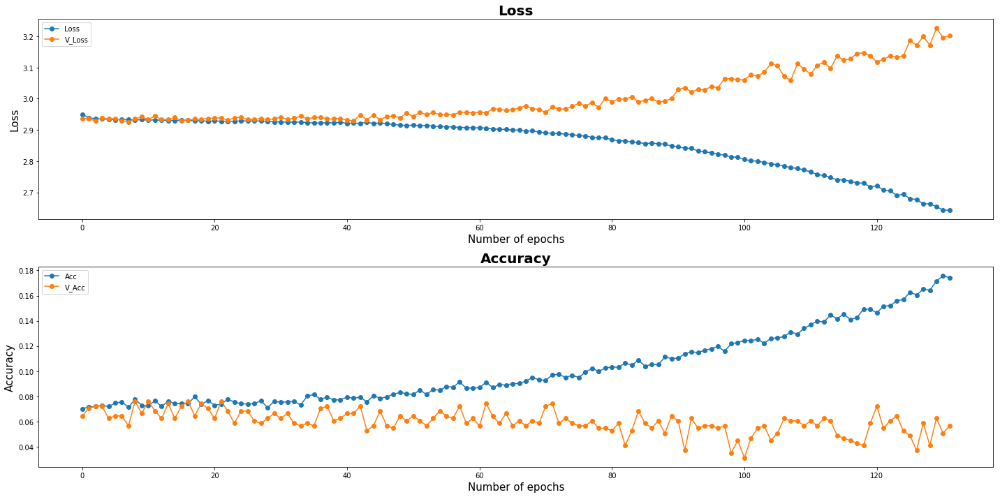

| Epoch [132] | Step [10600] | lr [0.009800] | Loss: [2.6000] | Acc: [0.1719] | Time: 0.0s
| Epoch [132] | Validation | Step [0] |  Loss: [3.2316] | Acc: [0.0781] | Time: 0.0s
| Epoch [132] | Validation | Step [1] |  Loss: [3.1620] | Acc: [0.0469] | Time: 0.0s
| Epoch [132] | Validation | Step [2] |  Loss: [3.1810] | Acc: [0.0312] | Time: 0.0s
| Epoch [132] | Validation | Step [3] |  Loss: [3.1859] | Acc: [0.0469] | Time: 0.0s


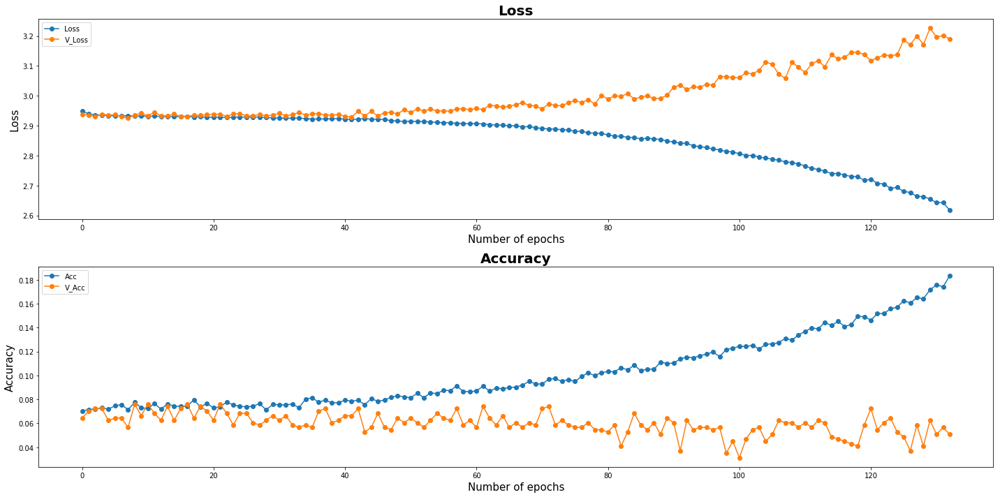

| Epoch [133] | Step [10650] | lr [0.009800] | Loss: [2.5921] | Acc: [0.1875] | Time: 0.0s
| Epoch [133] | Step [10700] | lr [0.009800] | Loss: [2.7534] | Acc: [0.1719] | Time: 0.0s
| Epoch [133] | Validation | Step [0] |  Loss: [3.2135] | Acc: [0.0391] | Time: 0.0s
| Epoch [133] | Validation | Step [1] |  Loss: [3.2389] | Acc: [0.0312] | Time: 0.0s
| Epoch [133] | Validation | Step [2] |  Loss: [3.2287] | Acc: [0.0781] | Time: 0.0s
| Epoch [133] | Validation | Step [3] |  Loss: [3.3185] | Acc: [0.0625] | Time: 0.0s


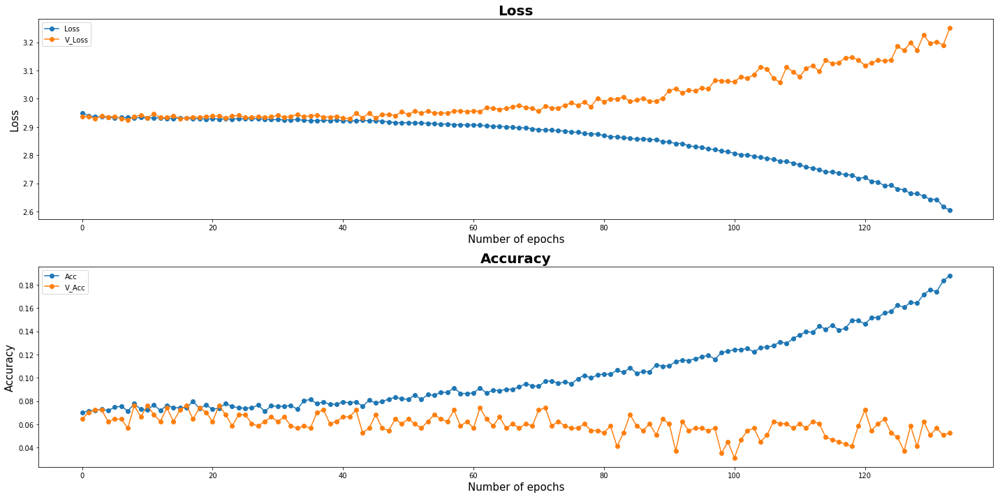

| Epoch [134] | Step [10750] | lr [0.009800] | Loss: [2.5430] | Acc: [0.2578] | Time: 0.0s
| Epoch [134] | Step [10800] | lr [0.009800] | Loss: [2.6157] | Acc: [0.1719] | Time: 0.0s
| Epoch [134] | Validation | Step [0] |  Loss: [3.3116] | Acc: [0.0391] | Time: 0.0s
| Epoch [134] | Validation | Step [1] |  Loss: [3.1993] | Acc: [0.0625] | Time: 0.0s
| Epoch [134] | Validation | Step [2] |  Loss: [3.2599] | Acc: [0.0625] | Time: 0.0s
| Epoch [134] | Validation | Step [3] |  Loss: [3.1928] | Acc: [0.0625] | Time: 0.0s


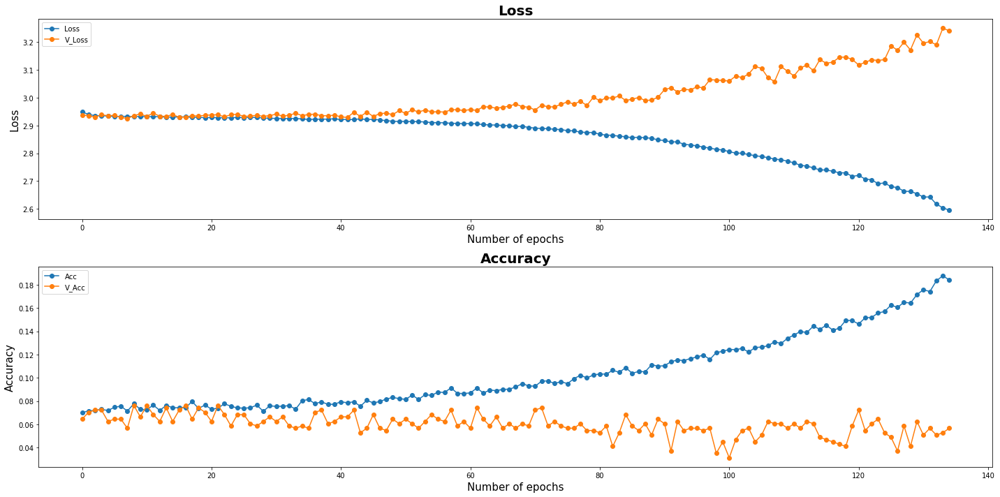

| Epoch [135] | Step [10850] | lr [0.009800] | Loss: [2.6097] | Acc: [0.1875] | Time: 0.0s
| Epoch [135] | Validation | Step [0] |  Loss: [3.2863] | Acc: [0.0938] | Time: 0.0s
| Epoch [135] | Validation | Step [1] |  Loss: [3.0592] | Acc: [0.0938] | Time: 0.0s
| Epoch [135] | Validation | Step [2] |  Loss: [3.3624] | Acc: [0.0469] | Time: 0.0s
| Epoch [135] | Validation | Step [3] |  Loss: [3.2891] | Acc: [0.0547] | Time: 0.0s


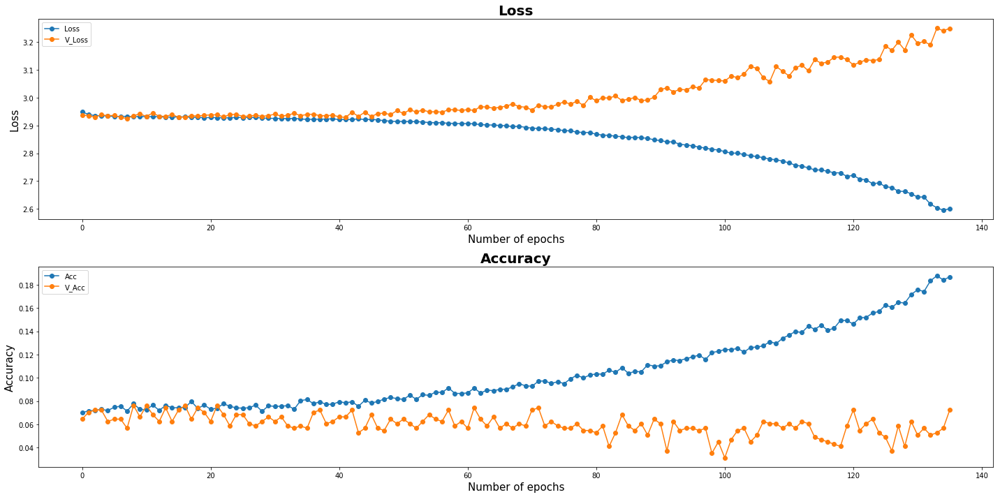

| Epoch [136] | Step [10900] | lr [0.009800] | Loss: [2.5939] | Acc: [0.1953] | Time: 0.0s
| Epoch [136] | Step [10950] | lr [0.009800] | Loss: [2.5633] | Acc: [0.2109] | Time: 0.0s
| Epoch [136] | Validation | Step [0] |  Loss: [3.2713] | Acc: [0.0547] | Time: 0.0s
| Epoch [136] | Validation | Step [1] |  Loss: [3.3086] | Acc: [0.0859] | Time: 0.0s
| Epoch [136] | Validation | Step [2] |  Loss: [3.2388] | Acc: [0.0781] | Time: 0.0s
| Epoch [136] | Validation | Step [3] |  Loss: [3.2289] | Acc: [0.0781] | Time: 0.0s


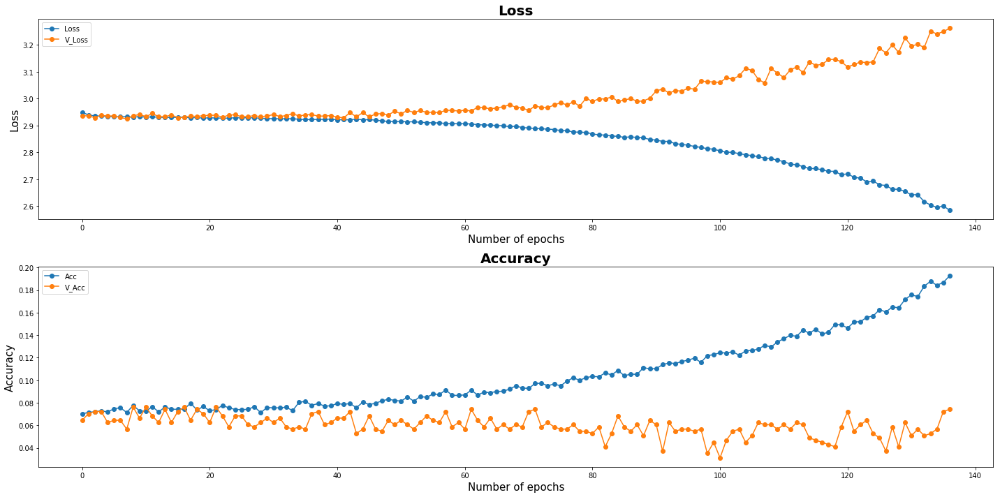

| Epoch [137] | Step [11000] | lr [0.009800] | Loss: [2.5379] | Acc: [0.2031] | Time: 0.0s
| Epoch [137] | Validation | Step [0] |  Loss: [3.1712] | Acc: [0.0781] | Time: 0.0s
| Epoch [137] | Validation | Step [1] |  Loss: [3.3960] | Acc: [0.0312] | Time: 0.0s
| Epoch [137] | Validation | Step [2] |  Loss: [3.1453] | Acc: [0.0703] | Time: 0.0s
| Epoch [137] | Validation | Step [3] |  Loss: [3.3250] | Acc: [0.0703] | Time: 0.0s


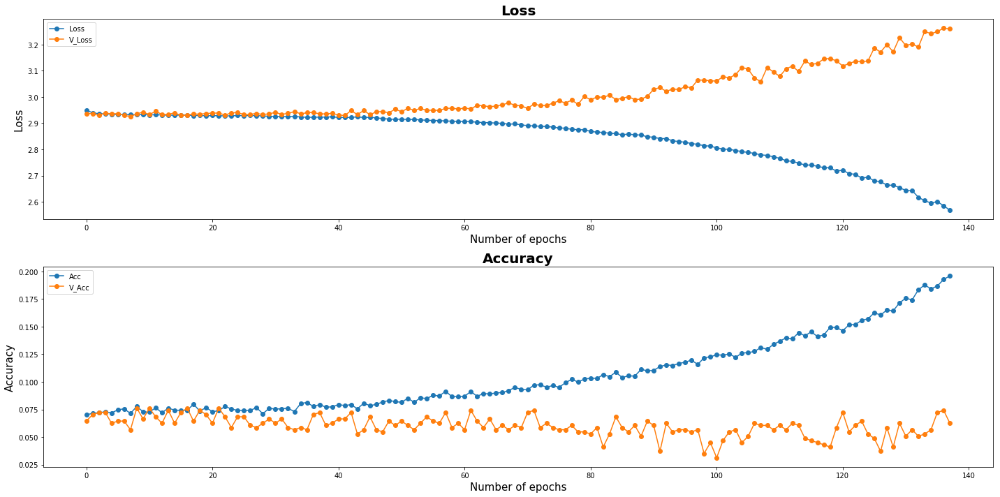

| Epoch [138] | Step [11050] | lr [0.009800] | Loss: [2.4562] | Acc: [0.2656] | Time: 0.0s
| Epoch [138] | Step [11100] | lr [0.009800] | Loss: [2.5388] | Acc: [0.1953] | Time: 0.0s
| Epoch [138] | Validation | Step [0] |  Loss: [3.1941] | Acc: [0.0625] | Time: 0.0s
| Epoch [138] | Validation | Step [1] |  Loss: [3.3816] | Acc: [0.0391] | Time: 0.0s
| Epoch [138] | Validation | Step [2] |  Loss: [3.2924] | Acc: [0.0391] | Time: 0.0s
| Epoch [138] | Validation | Step [3] |  Loss: [3.2842] | Acc: [0.0859] | Time: 0.0s


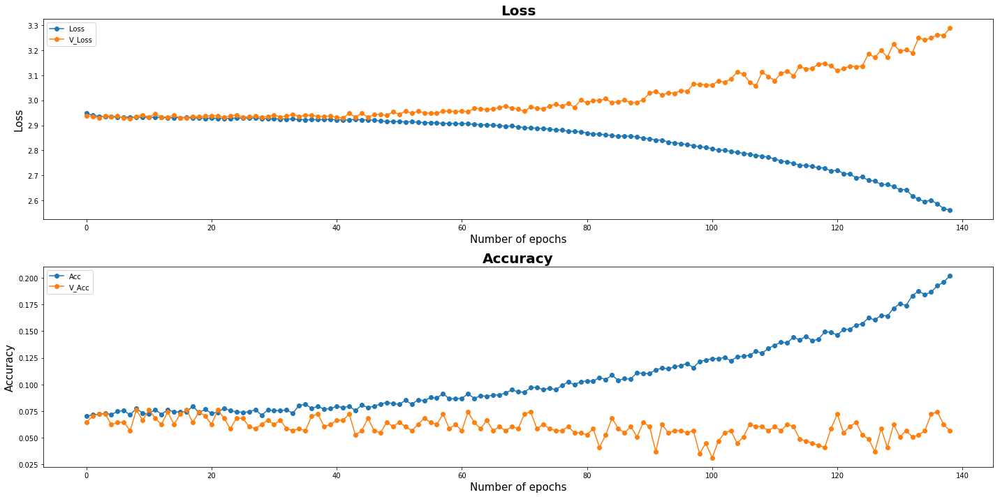

| Epoch [139] | Step [11150] | lr [0.009800] | Loss: [2.4836] | Acc: [0.1484] | Time: 0.0s
| Epoch [139] | Step [11200] | lr [0.009800] | Loss: [2.5202] | Acc: [0.2031] | Time: 0.0s
| Epoch [139] | Validation | Step [0] |  Loss: [3.2928] | Acc: [0.0547] | Time: 0.0s
| Epoch [139] | Validation | Step [1] |  Loss: [3.4073] | Acc: [0.0547] | Time: 0.0s
| Epoch [139] | Validation | Step [2] |  Loss: [3.2440] | Acc: [0.0469] | Time: 0.0s
| Epoch [139] | Validation | Step [3] |  Loss: [3.2415] | Acc: [0.0859] | Time: 0.0s


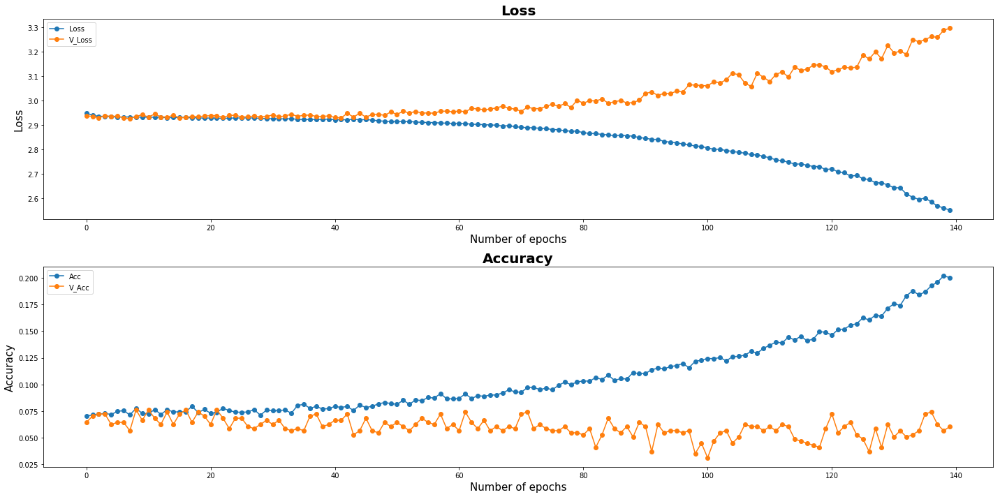

Model Saved
| Epoch [140] | Step [11250] | lr [0.009800] | Loss: [2.6208] | Acc: [0.1484] | Time: 0.0s
| Epoch [140] | Validation | Step [0] |  Loss: [3.5003] | Acc: [0.0547] | Time: 0.0s
| Epoch [140] | Validation | Step [1] |  Loss: [3.3742] | Acc: [0.0469] | Time: 0.0s
| Epoch [140] | Validation | Step [2] |  Loss: [3.2929] | Acc: [0.0859] | Time: 0.0s
| Epoch [140] | Validation | Step [3] |  Loss: [3.1954] | Acc: [0.0391] | Time: 0.0s


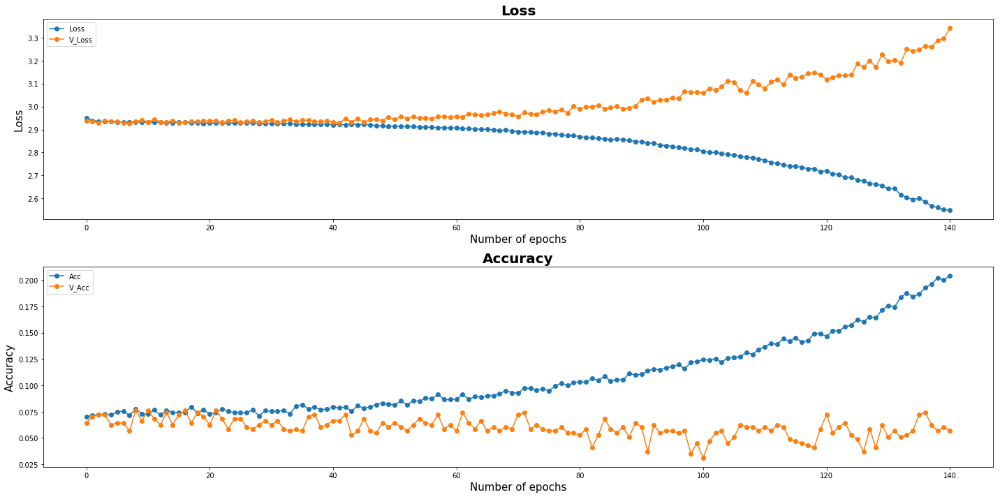

| Epoch [141] | Step [11300] | lr [0.009800] | Loss: [2.3860] | Acc: [0.2109] | Time: 0.0s
| Epoch [141] | Step [11350] | lr [0.009800] | Loss: [2.5921] | Acc: [0.2344] | Time: 0.0s
| Epoch [141] | Validation | Step [0] |  Loss: [3.3223] | Acc: [0.0547] | Time: 0.0s
| Epoch [141] | Validation | Step [1] |  Loss: [3.2993] | Acc: [0.0781] | Time: 0.0s
| Epoch [141] | Validation | Step [2] |  Loss: [3.4469] | Acc: [0.0391] | Time: 0.0s
| Epoch [141] | Validation | Step [3] |  Loss: [3.3226] | Acc: [0.0859] | Time: 0.0s


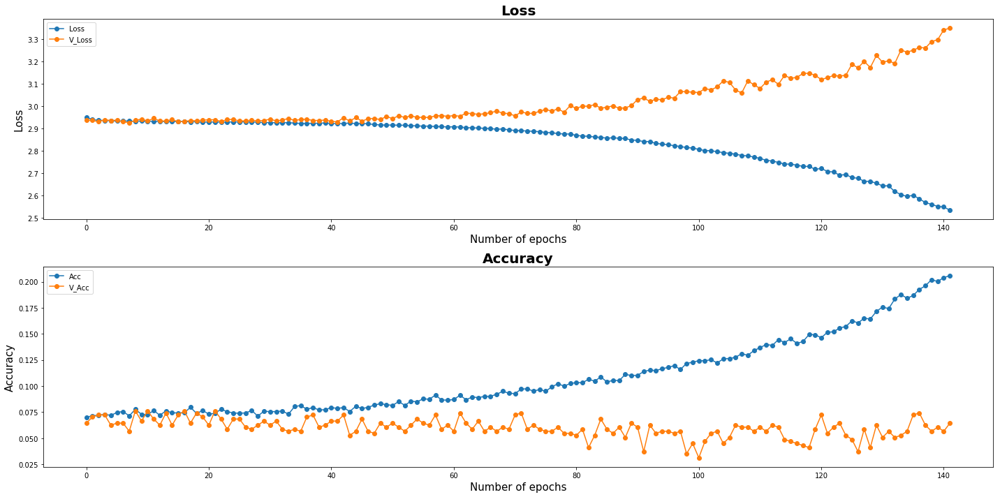

| Epoch [142] | Step [11400] | lr [0.009800] | Loss: [2.4251] | Acc: [0.2344] | Time: 0.0s
| Epoch [142] | Validation | Step [0] |  Loss: [3.2939] | Acc: [0.0234] | Time: 0.0s
| Epoch [142] | Validation | Step [1] |  Loss: [3.3031] | Acc: [0.0859] | Time: 0.0s
| Epoch [142] | Validation | Step [2] |  Loss: [3.3630] | Acc: [0.0781] | Time: 0.0s
| Epoch [142] | Validation | Step [3] |  Loss: [3.3067] | Acc: [0.0391] | Time: 0.0s


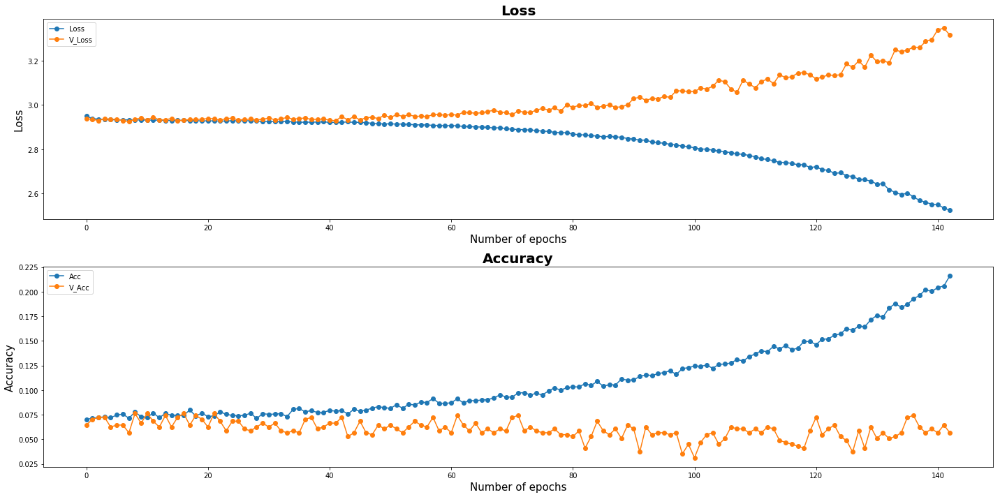

| Epoch [143] | Step [11450] | lr [0.009800] | Loss: [2.4724] | Acc: [0.2266] | Time: 0.0s
| Epoch [143] | Step [11500] | lr [0.009800] | Loss: [2.4713] | Acc: [0.2266] | Time: 0.0s
| Epoch [143] | Validation | Step [0] |  Loss: [3.3490] | Acc: [0.0312] | Time: 0.0s
| Epoch [143] | Validation | Step [1] |  Loss: [3.4275] | Acc: [0.0469] | Time: 0.0s
| Epoch [143] | Validation | Step [2] |  Loss: [3.3538] | Acc: [0.0234] | Time: 0.0s
| Epoch [143] | Validation | Step [3] |  Loss: [3.0924] | Acc: [0.0859] | Time: 0.0s


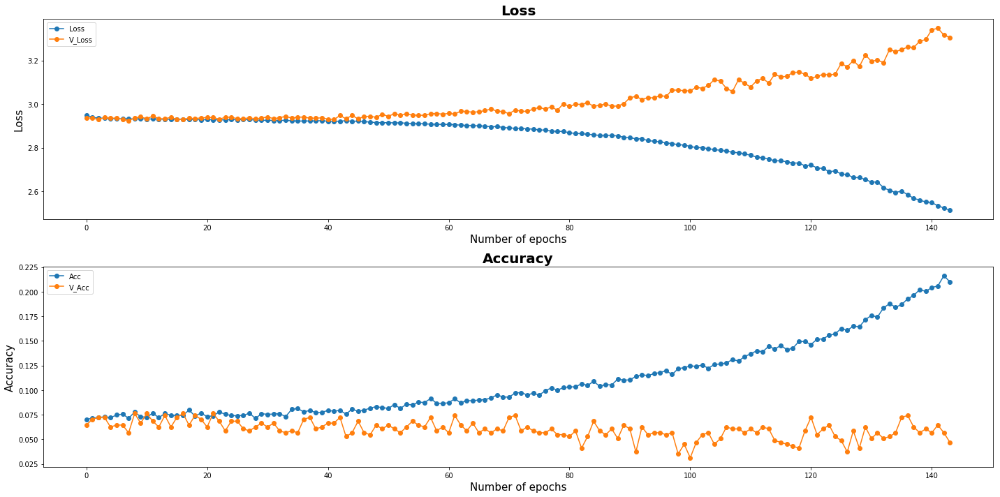

| Epoch [144] | Step [11550] | lr [0.009800] | Loss: [2.4094] | Acc: [0.2578] | Time: 0.0s
| Epoch [144] | Step [11600] | lr [0.009800] | Loss: [2.6019] | Acc: [0.1953] | Time: 0.0s
| Epoch [144] | Validation | Step [0] |  Loss: [3.4456] | Acc: [0.0469] | Time: 0.0s
| Epoch [144] | Validation | Step [1] |  Loss: [3.2785] | Acc: [0.0859] | Time: 0.0s
| Epoch [144] | Validation | Step [2] |  Loss: [3.2485] | Acc: [0.0547] | Time: 0.0s
| Epoch [144] | Validation | Step [3] |  Loss: [3.3021] | Acc: [0.0547] | Time: 0.0s


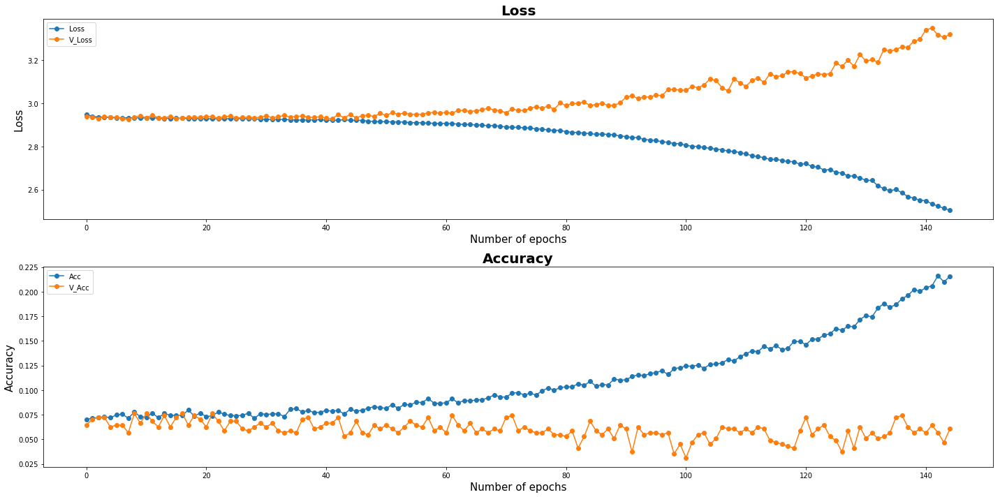

| Epoch [145] | Step [11650] | lr [0.009800] | Loss: [2.4986] | Acc: [0.2188] | Time: 0.0s
| Epoch [145] | Validation | Step [0] |  Loss: [3.3169] | Acc: [0.0391] | Time: 0.0s
| Epoch [145] | Validation | Step [1] |  Loss: [3.3557] | Acc: [0.0547] | Time: 0.0s
| Epoch [145] | Validation | Step [2] |  Loss: [3.3951] | Acc: [0.0703] | Time: 0.0s
| Epoch [145] | Validation | Step [3] |  Loss: [3.5046] | Acc: [0.0312] | Time: 0.0s


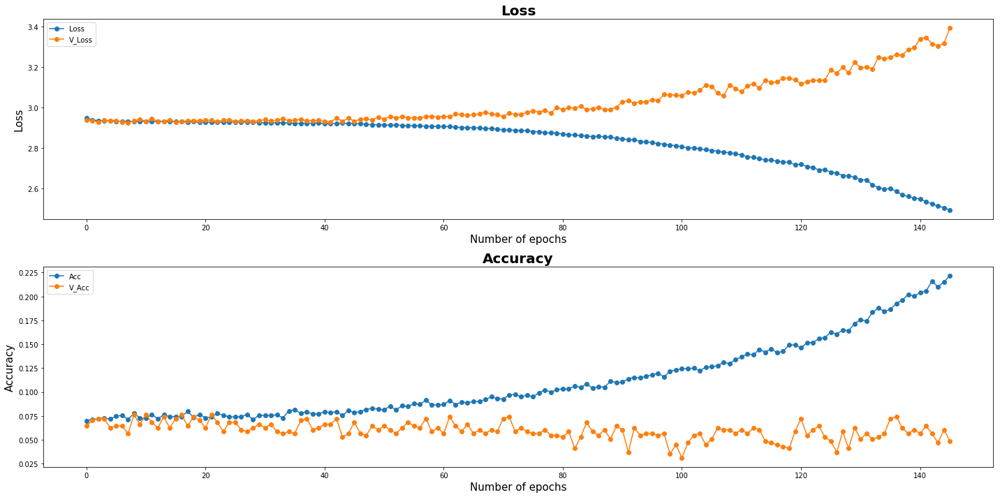

| Epoch [146] | Step [11700] | lr [0.009800] | Loss: [2.4242] | Acc: [0.2344] | Time: 0.0s
| Epoch [146] | Step [11750] | lr [0.009800] | Loss: [2.4561] | Acc: [0.2344] | Time: 0.0s
| Epoch [146] | Validation | Step [0] |  Loss: [3.4354] | Acc: [0.0156] | Time: 0.0s
| Epoch [146] | Validation | Step [1] |  Loss: [3.2385] | Acc: [0.0625] | Time: 0.0s
| Epoch [146] | Validation | Step [2] |  Loss: [3.3875] | Acc: [0.0938] | Time: 0.0s
| Epoch [146] | Validation | Step [3] |  Loss: [3.4540] | Acc: [0.0156] | Time: 0.0s


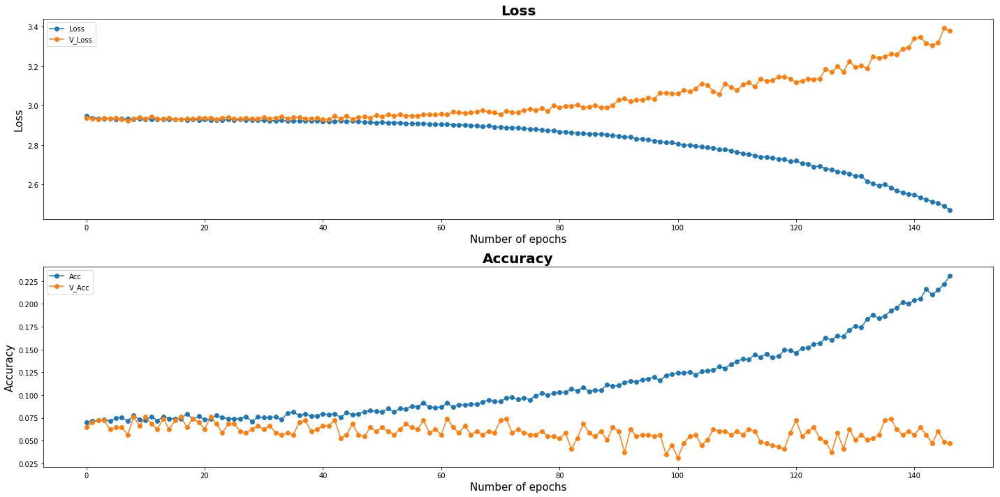

| Epoch [147] | Step [11800] | lr [0.009800] | Loss: [2.4295] | Acc: [0.2344] | Time: 0.0s
| Epoch [147] | Validation | Step [0] |  Loss: [3.3157] | Acc: [0.0547] | Time: 0.0s
| Epoch [147] | Validation | Step [1] |  Loss: [3.2998] | Acc: [0.0469] | Time: 0.0s
| Epoch [147] | Validation | Step [2] |  Loss: [3.5545] | Acc: [0.0625] | Time: 0.0s
| Epoch [147] | Validation | Step [3] |  Loss: [3.3581] | Acc: [0.0938] | Time: 0.0s


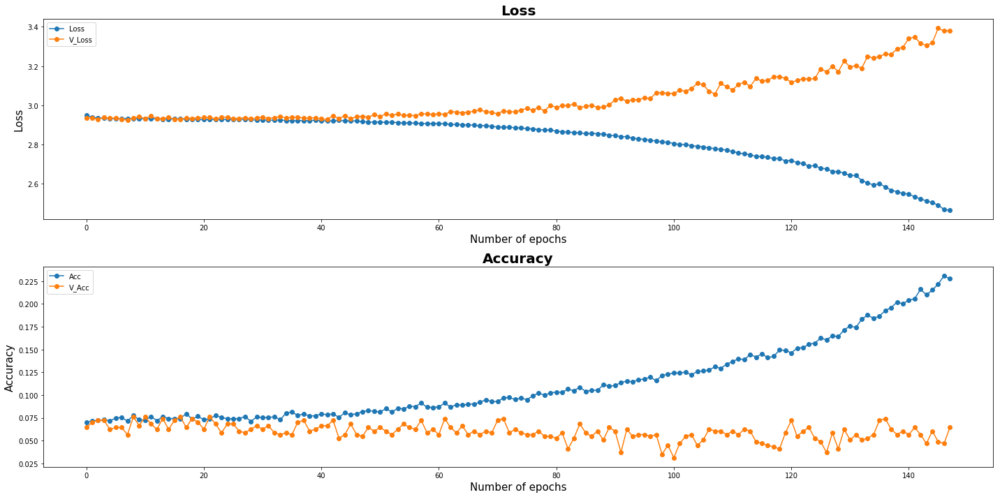

| Epoch [148] | Step [11850] | lr [0.009800] | Loss: [2.3432] | Acc: [0.2500] | Time: 0.0s
| Epoch [148] | Step [11900] | lr [0.009800] | Loss: [2.6015] | Acc: [0.2188] | Time: 0.0s
| Epoch [148] | Validation | Step [0] |  Loss: [3.2525] | Acc: [0.1094] | Time: 0.0s
| Epoch [148] | Validation | Step [1] |  Loss: [3.3166] | Acc: [0.0391] | Time: 0.0s
| Epoch [148] | Validation | Step [2] |  Loss: [3.4955] | Acc: [0.0547] | Time: 0.0s
| Epoch [148] | Validation | Step [3] |  Loss: [3.4861] | Acc: [0.0312] | Time: 0.0s


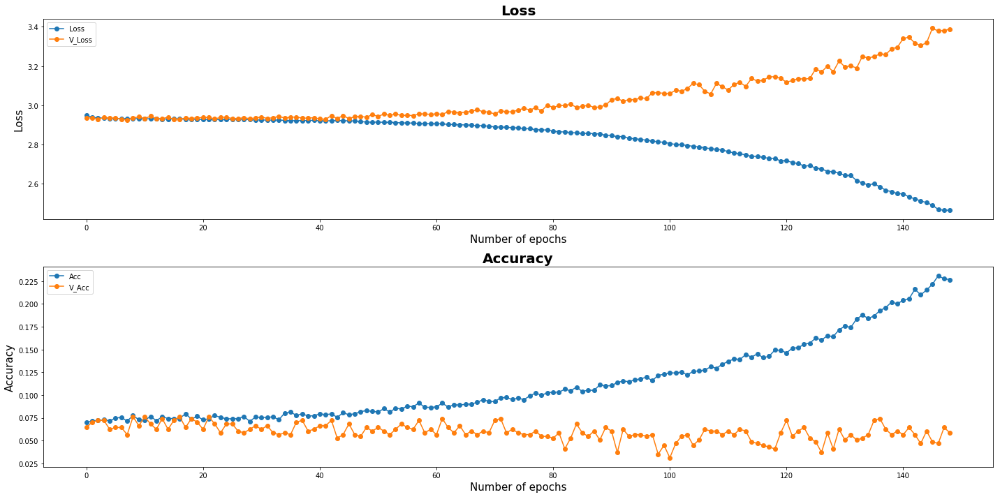

| Epoch [149] | Step [11950] | lr [0.009800] | Loss: [2.4571] | Acc: [0.2109] | Time: 0.0s
| Epoch [149] | Step [12000] | lr [0.009800] | Loss: [2.4875] | Acc: [0.2031] | Time: 0.0s
| Epoch [149] | Validation | Step [0] |  Loss: [3.3554] | Acc: [0.0703] | Time: 0.0s
| Epoch [149] | Validation | Step [1] |  Loss: [3.5208] | Acc: [0.0391] | Time: 0.0s
| Epoch [149] | Validation | Step [2] |  Loss: [3.4858] | Acc: [0.0625] | Time: 0.0s
| Epoch [149] | Validation | Step [3] |  Loss: [3.3173] | Acc: [0.0156] | Time: 0.0s


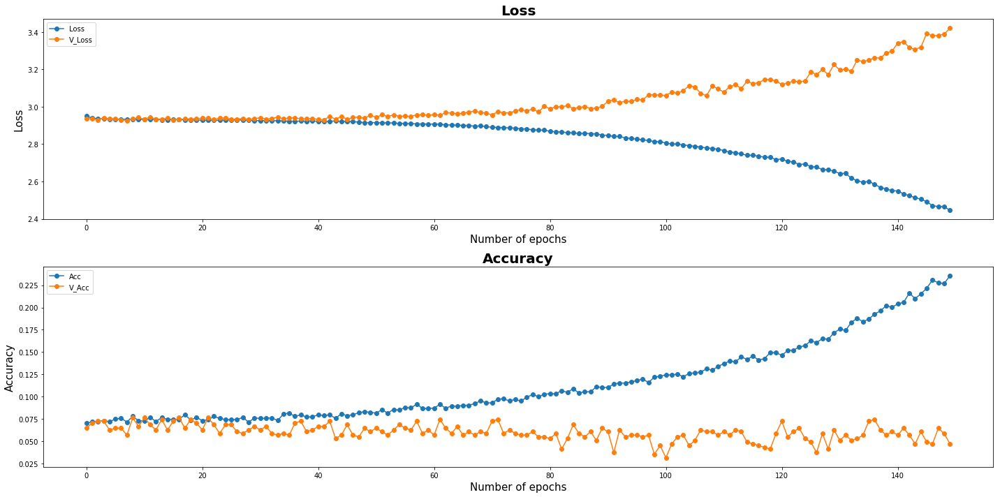

Model Saved
| Epoch [150] | Step [12050] | lr [0.009800] | Loss: [2.5525] | Acc: [0.1797] | Time: 0.0s
| Epoch [150] | Validation | Step [0] |  Loss: [3.3442] | Acc: [0.0703] | Time: 0.0s
| Epoch [150] | Validation | Step [1] |  Loss: [3.4362] | Acc: [0.0469] | Time: 0.0s
| Epoch [150] | Validation | Step [2] |  Loss: [3.4401] | Acc: [0.0469] | Time: 0.0s
| Epoch [150] | Validation | Step [3] |  Loss: [3.4103] | Acc: [0.0781] | Time: 0.0s


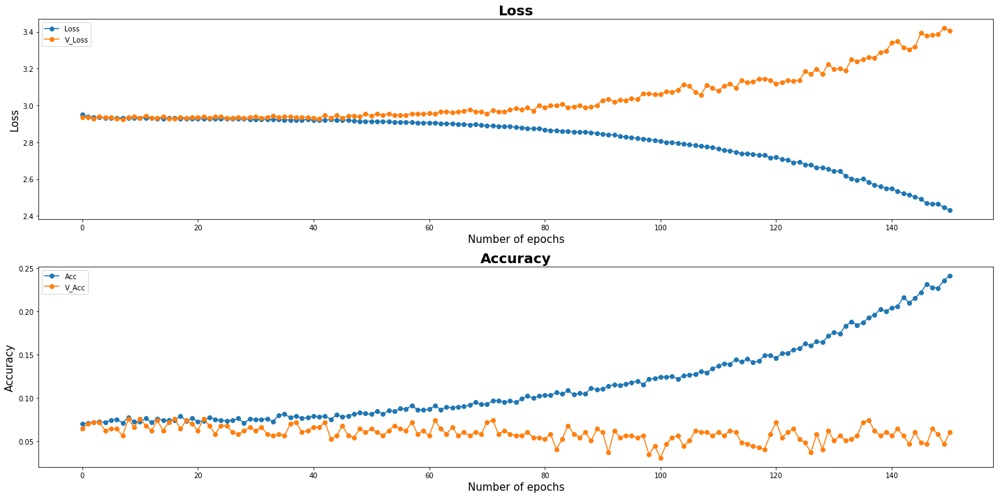

| Epoch [151] | Step [12100] | lr [0.009800] | Loss: [2.3421] | Acc: [0.2734] | Time: 0.0s
| Epoch [151] | Step [12150] | lr [0.009800] | Loss: [2.4239] | Acc: [0.2188] | Time: 0.0s
| Epoch [151] | Validation | Step [0] |  Loss: [3.5027] | Acc: [0.0547] | Time: 0.0s
| Epoch [151] | Validation | Step [1] |  Loss: [3.4923] | Acc: [0.0547] | Time: 0.0s
| Epoch [151] | Validation | Step [2] |  Loss: [3.3958] | Acc: [0.0859] | Time: 0.0s
| Epoch [151] | Validation | Step [3] |  Loss: [3.4505] | Acc: [0.0156] | Time: 0.0s


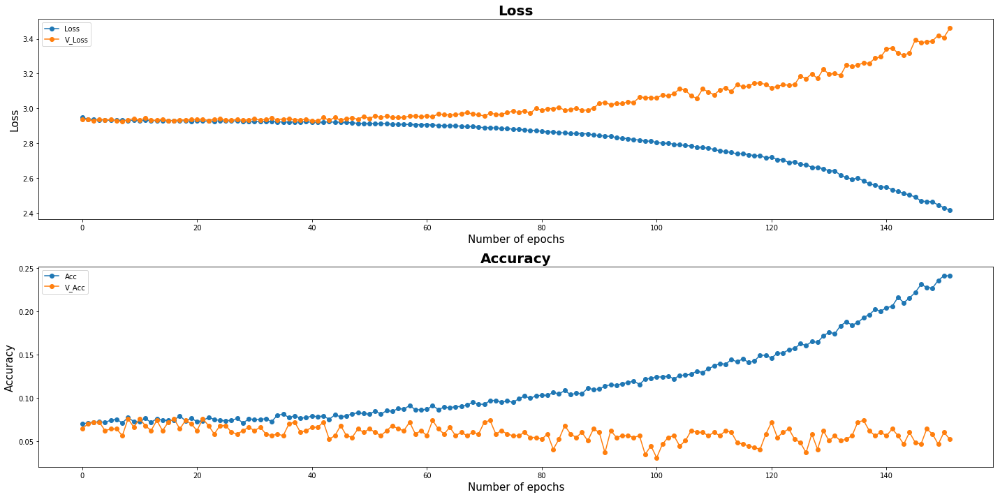

| Epoch [152] | Step [12200] | lr [0.009800] | Loss: [2.3466] | Acc: [0.2422] | Time: 0.0s
| Epoch [152] | Validation | Step [0] |  Loss: [3.4358] | Acc: [0.0469] | Time: 0.0s
| Epoch [152] | Validation | Step [1] |  Loss: [3.5035] | Acc: [0.0547] | Time: 0.0s
| Epoch [152] | Validation | Step [2] |  Loss: [3.4513] | Acc: [0.0781] | Time: 0.0s
| Epoch [152] | Validation | Step [3] |  Loss: [3.5040] | Acc: [0.0312] | Time: 0.0s


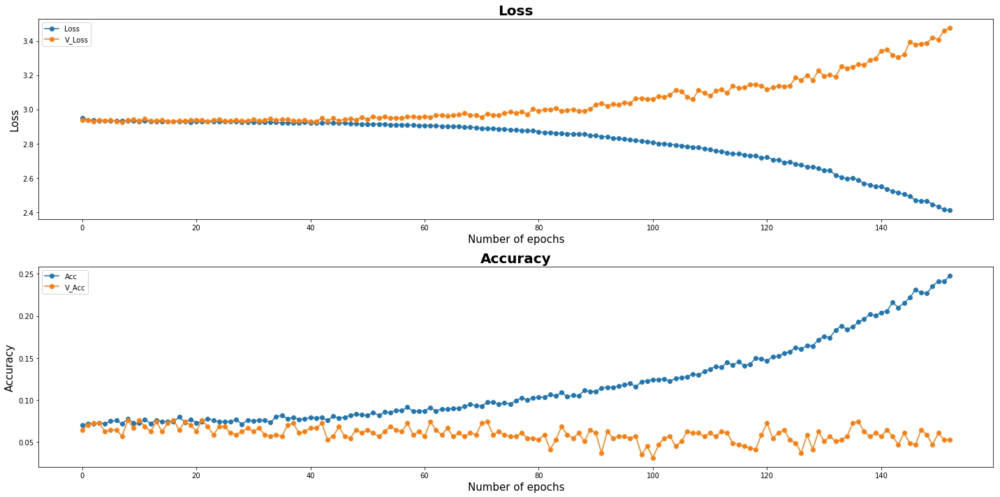

| Epoch [153] | Step [12250] | lr [0.009800] | Loss: [2.3728] | Acc: [0.2656] | Time: 0.0s
| Epoch [153] | Step [12300] | lr [0.009800] | Loss: [2.4438] | Acc: [0.2031] | Time: 0.0s
| Epoch [153] | Validation | Step [0] |  Loss: [3.2703] | Acc: [0.0547] | Time: 0.0s
| Epoch [153] | Validation | Step [1] |  Loss: [3.5201] | Acc: [0.0703] | Time: 0.0s
| Epoch [153] | Validation | Step [2] |  Loss: [3.3997] | Acc: [0.0547] | Time: 0.0s
| Epoch [153] | Validation | Step [3] |  Loss: [3.6375] | Acc: [0.0781] | Time: 0.0s


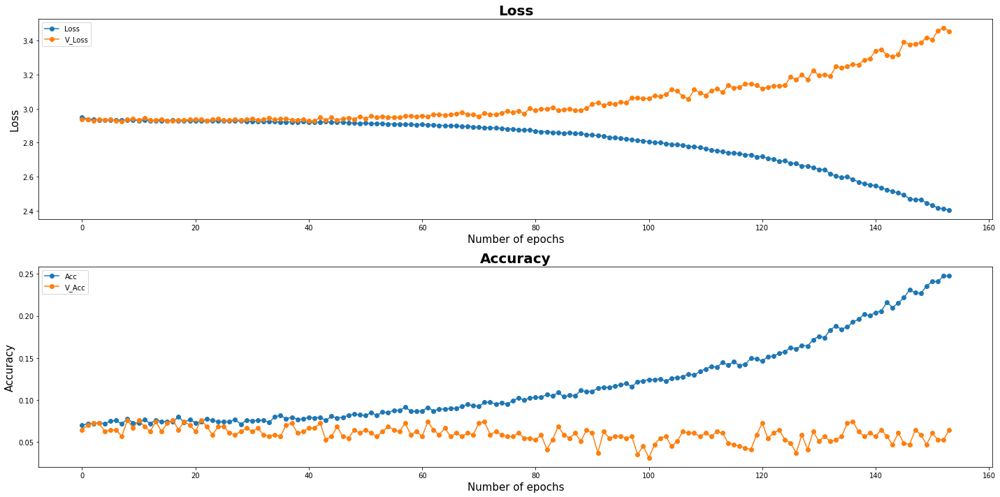

| Epoch [154] | Step [12350] | lr [0.009800] | Loss: [2.3779] | Acc: [0.2422] | Time: 0.0s
| Epoch [154] | Step [12400] | lr [0.009800] | Loss: [2.4436] | Acc: [0.2422] | Time: 0.0s
| Epoch [154] | Validation | Step [0] |  Loss: [3.5226] | Acc: [0.0625] | Time: 0.0s
| Epoch [154] | Validation | Step [1] |  Loss: [3.4420] | Acc: [0.0703] | Time: 0.0s
| Epoch [154] | Validation | Step [2] |  Loss: [3.3849] | Acc: [0.0156] | Time: 0.0s
| Epoch [154] | Validation | Step [3] |  Loss: [3.4716] | Acc: [0.0469] | Time: 0.0s


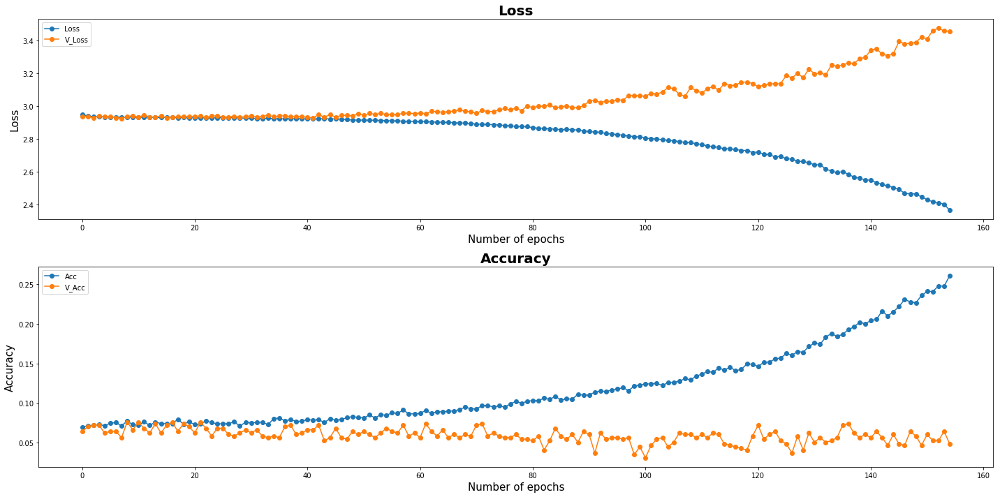

| Epoch [155] | Step [12450] | lr [0.009800] | Loss: [2.4742] | Acc: [0.2500] | Time: 0.0s
| Epoch [155] | Validation | Step [0] |  Loss: [3.5288] | Acc: [0.0156] | Time: 0.0s
| Epoch [155] | Validation | Step [1] |  Loss: [3.4513] | Acc: [0.1016] | Time: 0.0s
| Epoch [155] | Validation | Step [2] |  Loss: [3.4302] | Acc: [0.0312] | Time: 0.0s
| Epoch [155] | Validation | Step [3] |  Loss: [3.4848] | Acc: [0.0312] | Time: 0.0s


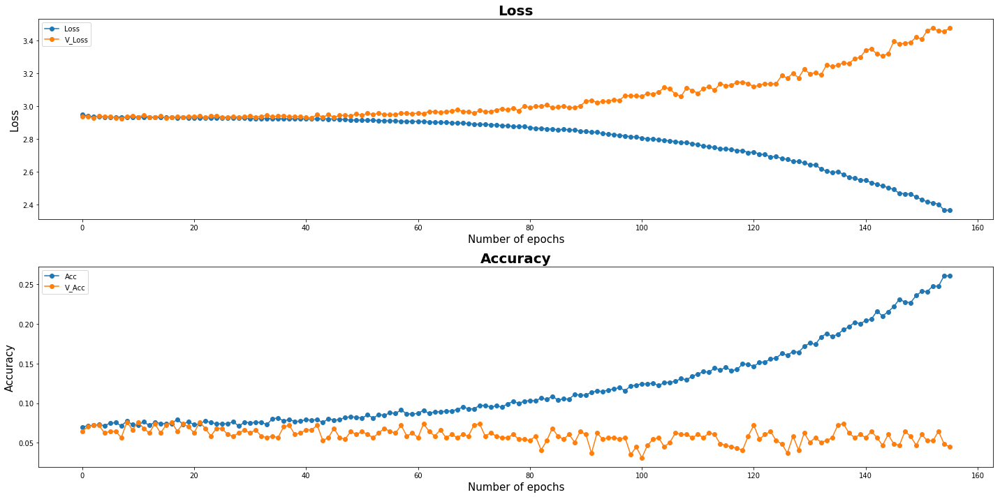

| Epoch [156] | Step [12500] | lr [0.009800] | Loss: [2.2738] | Acc: [0.2578] | Time: 0.0s
| Epoch [156] | Step [12550] | lr [0.009800] | Loss: [2.4176] | Acc: [0.2266] | Time: 0.0s
| Epoch [156] | Validation | Step [0] |  Loss: [3.5140] | Acc: [0.0547] | Time: 0.0s
| Epoch [156] | Validation | Step [1] |  Loss: [3.3461] | Acc: [0.0469] | Time: 0.0s
| Epoch [156] | Validation | Step [2] |  Loss: [3.6759] | Acc: [0.0469] | Time: 0.0s
| Epoch [156] | Validation | Step [3] |  Loss: [3.4203] | Acc: [0.0547] | Time: 0.0s


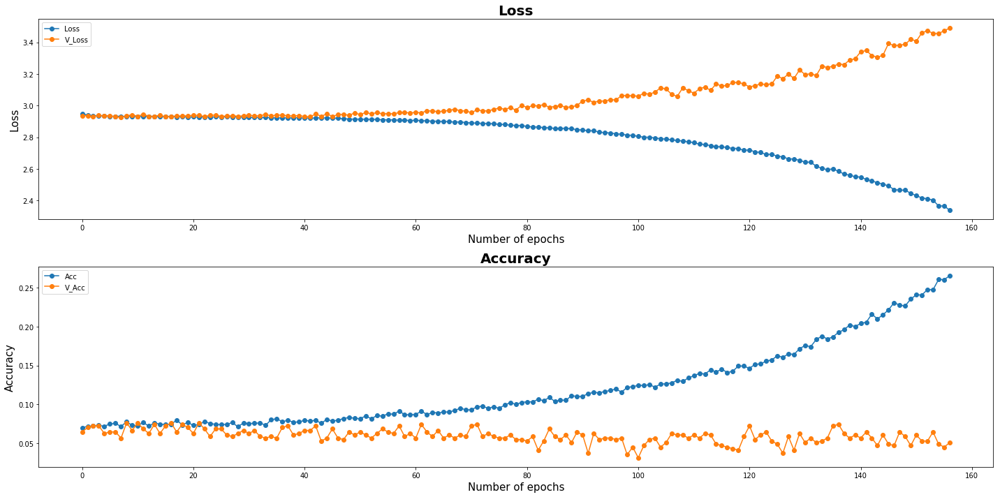

| Epoch [157] | Step [12600] | lr [0.009800] | Loss: [2.3232] | Acc: [0.2500] | Time: 0.0s
| Epoch [157] | Validation | Step [0] |  Loss: [3.4776] | Acc: [0.0625] | Time: 0.0s
| Epoch [157] | Validation | Step [1] |  Loss: [3.5091] | Acc: [0.0234] | Time: 0.0s
| Epoch [157] | Validation | Step [2] |  Loss: [3.5212] | Acc: [0.0391] | Time: 0.0s
| Epoch [157] | Validation | Step [3] |  Loss: [3.6414] | Acc: [0.0156] | Time: 0.0s


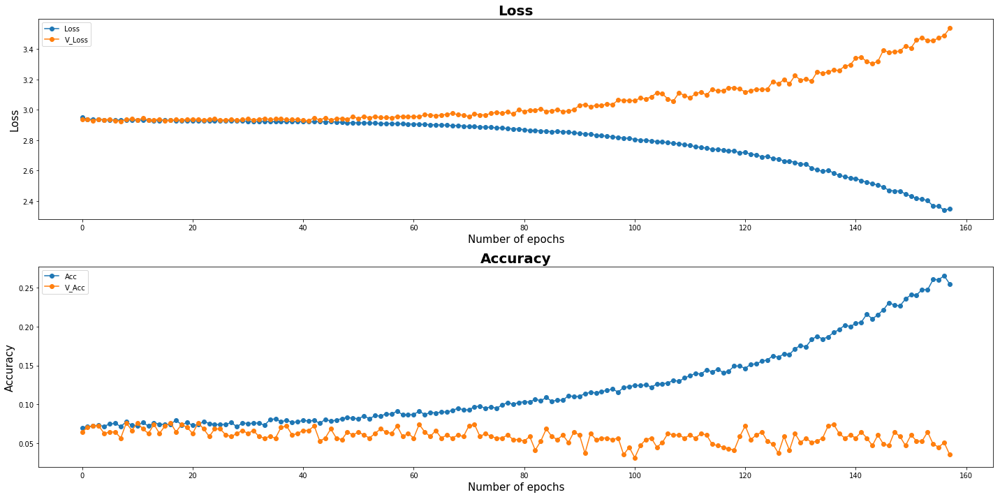

| Epoch [158] | Step [12650] | lr [0.009800] | Loss: [2.2285] | Acc: [0.2891] | Time: 0.0s
| Epoch [158] | Step [12700] | lr [0.009800] | Loss: [2.3209] | Acc: [0.2969] | Time: 0.0s
| Epoch [158] | Validation | Step [0] |  Loss: [3.5064] | Acc: [0.0469] | Time: 0.0s
| Epoch [158] | Validation | Step [1] |  Loss: [3.5973] | Acc: [0.0234] | Time: 0.0s
| Epoch [158] | Validation | Step [2] |  Loss: [3.4412] | Acc: [0.1094] | Time: 0.0s
| Epoch [158] | Validation | Step [3] |  Loss: [3.6365] | Acc: [0.0312] | Time: 0.0s


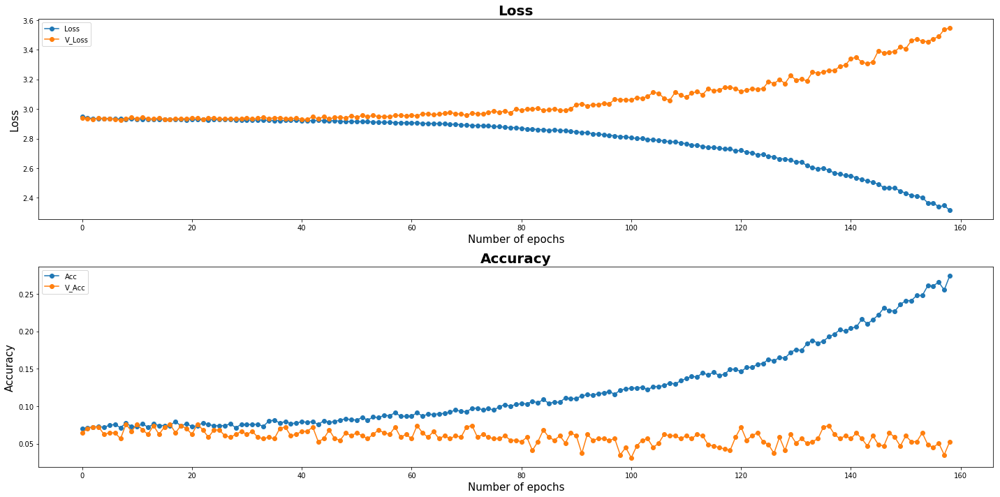

| Epoch [159] | Step [12750] | lr [0.009800] | Loss: [2.3170] | Acc: [0.2500] | Time: 0.0s
| Epoch [159] | Step [12800] | lr [0.009800] | Loss: [2.5901] | Acc: [0.2031] | Time: 0.0s
| Epoch [159] | Validation | Step [0] |  Loss: [3.4224] | Acc: [0.0234] | Time: 0.0s
| Epoch [159] | Validation | Step [1] |  Loss: [3.6927] | Acc: [0.0547] | Time: 0.0s
| Epoch [159] | Validation | Step [2] |  Loss: [3.7181] | Acc: [0.0391] | Time: 0.0s
| Epoch [159] | Validation | Step [3] |  Loss: [3.6231] | Acc: [0.0625] | Time: 0.0s


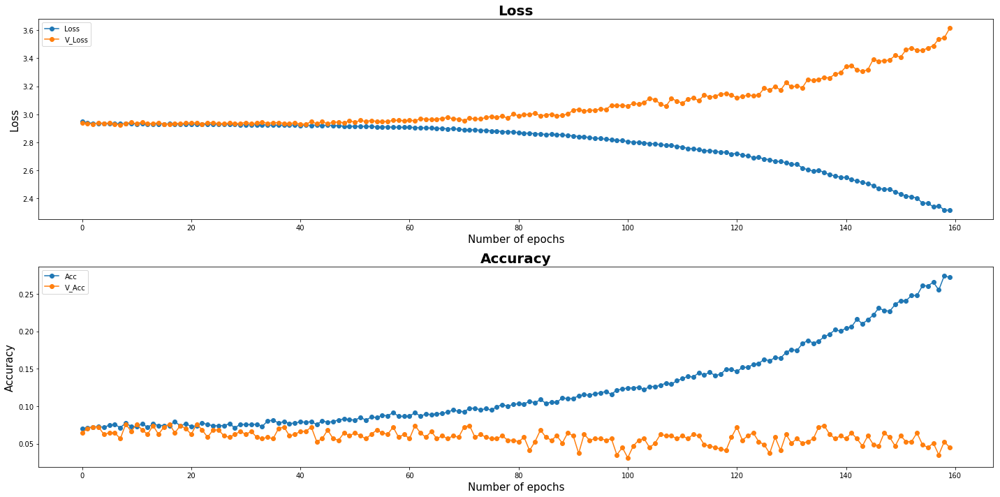

Model Saved
| Epoch [160] | Step [12850] | lr [0.009800] | Loss: [2.3383] | Acc: [0.2422] | Time: 0.0s
| Epoch [160] | Validation | Step [0] |  Loss: [3.5722] | Acc: [0.0391] | Time: 0.0s
| Epoch [160] | Validation | Step [1] |  Loss: [3.7305] | Acc: [0.0391] | Time: 0.0s
| Epoch [160] | Validation | Step [2] |  Loss: [3.6217] | Acc: [0.0547] | Time: 0.0s
| Epoch [160] | Validation | Step [3] |  Loss: [3.7083] | Acc: [0.0625] | Time: 0.0s


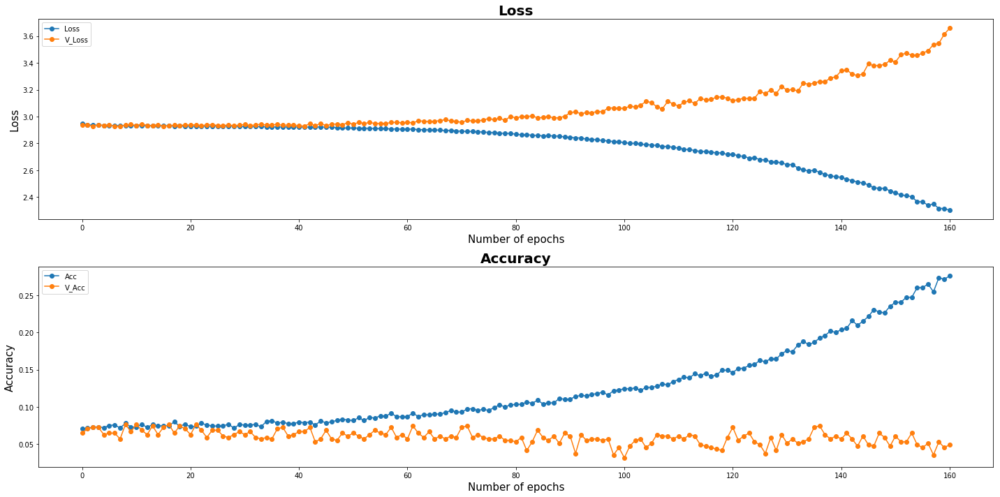

| Epoch [161] | Step [12900] | lr [0.009800] | Loss: [2.1433] | Acc: [0.3594] | Time: 0.0s
| Epoch [161] | Step [12950] | lr [0.009800] | Loss: [2.2165] | Acc: [0.2500] | Time: 0.0s
| Epoch [161] | Validation | Step [0] |  Loss: [3.4065] | Acc: [0.0781] | Time: 0.0s
| Epoch [161] | Validation | Step [1] |  Loss: [3.6372] | Acc: [0.0625] | Time: 0.0s
| Epoch [161] | Validation | Step [2] |  Loss: [3.3488] | Acc: [0.0391] | Time: 0.0s
| Epoch [161] | Validation | Step [3] |  Loss: [3.7284] | Acc: [0.0547] | Time: 0.0s


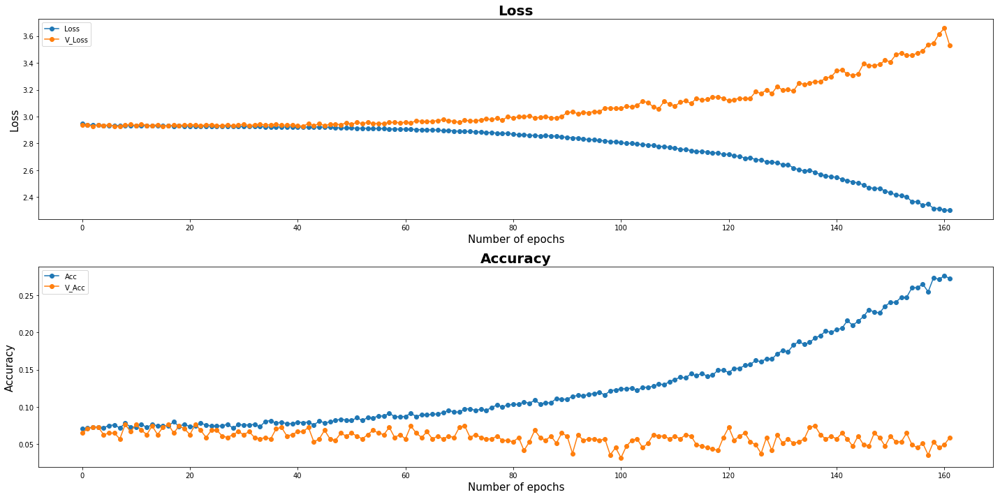

| Epoch [162] | Step [13000] | lr [0.009800] | Loss: [2.1624] | Acc: [0.2812] | Time: 0.0s
| Epoch [162] | Validation | Step [0] |  Loss: [3.6476] | Acc: [0.0078] | Time: 0.0s
| Epoch [162] | Validation | Step [1] |  Loss: [3.3687] | Acc: [0.0781] | Time: 0.0s
| Epoch [162] | Validation | Step [2] |  Loss: [3.7219] | Acc: [0.0469] | Time: 0.0s
| Epoch [162] | Validation | Step [3] |  Loss: [3.5120] | Acc: [0.0469] | Time: 0.0s


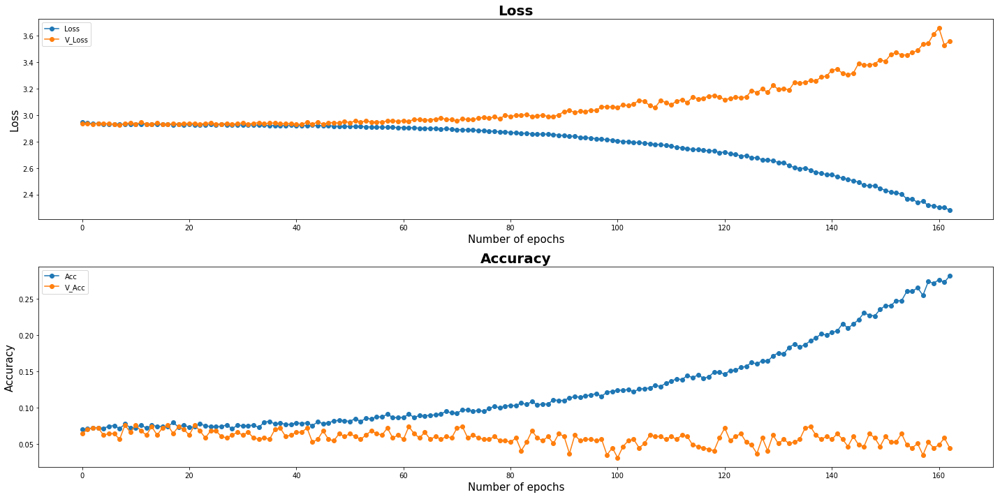

| Epoch [163] | Step [13050] | lr [0.009800] | Loss: [2.1941] | Acc: [0.3047] | Time: 0.0s
| Epoch [163] | Step [13100] | lr [0.009800] | Loss: [2.2943] | Acc: [0.2344] | Time: 0.0s
| Epoch [163] | Validation | Step [0] |  Loss: [3.5015] | Acc: [0.0625] | Time: 0.0s
| Epoch [163] | Validation | Step [1] |  Loss: [3.5904] | Acc: [0.0547] | Time: 0.0s
| Epoch [163] | Validation | Step [2] |  Loss: [3.6132] | Acc: [0.0625] | Time: 0.0s
| Epoch [163] | Validation | Step [3] |  Loss: [3.6318] | Acc: [0.0469] | Time: 0.0s


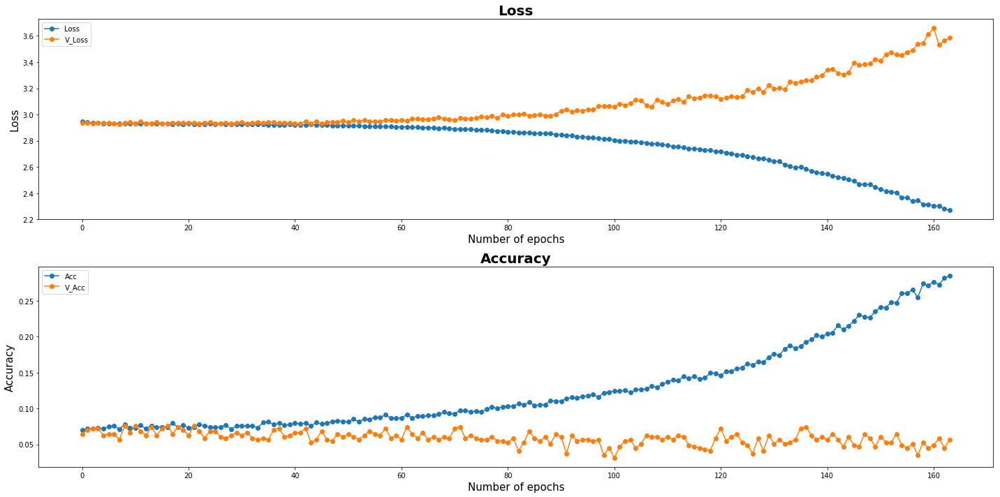

| Epoch [164] | Step [13150] | lr [0.009800] | Loss: [2.3842] | Acc: [0.2188] | Time: 0.0s
| Epoch [164] | Step [13200] | lr [0.009800] | Loss: [2.3369] | Acc: [0.2578] | Time: 0.0s
| Epoch [164] | Validation | Step [0] |  Loss: [3.6868] | Acc: [0.0625] | Time: 0.0s
| Epoch [164] | Validation | Step [1] |  Loss: [3.6703] | Acc: [0.0547] | Time: 0.0s
| Epoch [164] | Validation | Step [2] |  Loss: [3.7711] | Acc: [0.0234] | Time: 0.0s
| Epoch [164] | Validation | Step [3] |  Loss: [3.5820] | Acc: [0.0391] | Time: 0.0s


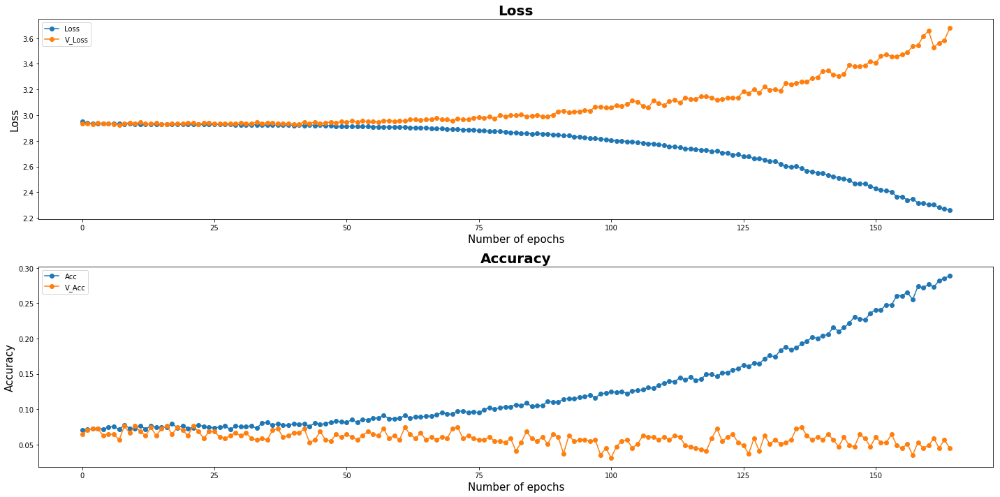

| Epoch [165] | Step [13250] | lr [0.009800] | Loss: [2.2855] | Acc: [0.2344] | Time: 0.0s
| Epoch [165] | Validation | Step [0] |  Loss: [3.6880] | Acc: [0.0547] | Time: 0.0s
| Epoch [165] | Validation | Step [1] |  Loss: [3.4921] | Acc: [0.0703] | Time: 0.0s
| Epoch [165] | Validation | Step [2] |  Loss: [3.6677] | Acc: [0.0469] | Time: 0.0s
| Epoch [165] | Validation | Step [3] |  Loss: [3.7175] | Acc: [0.0312] | Time: 0.0s


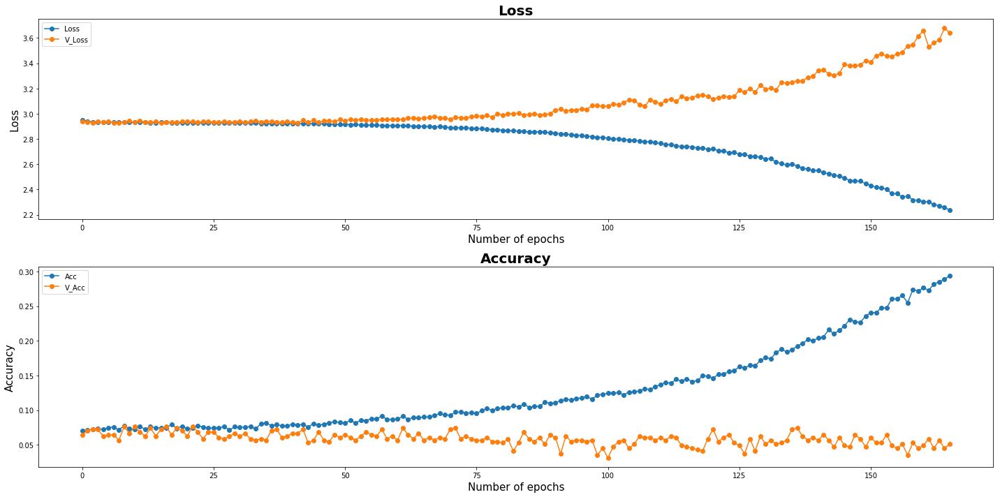

| Epoch [166] | Step [13300] | lr [0.009800] | Loss: [2.1788] | Acc: [0.3047] | Time: 0.0s
| Epoch [166] | Step [13350] | lr [0.009800] | Loss: [2.2530] | Acc: [0.2891] | Time: 0.0s
| Epoch [166] | Validation | Step [0] |  Loss: [3.5599] | Acc: [0.0781] | Time: 0.0s
| Epoch [166] | Validation | Step [1] |  Loss: [3.5962] | Acc: [0.0703] | Time: 0.0s
| Epoch [166] | Validation | Step [2] |  Loss: [3.5757] | Acc: [0.0469] | Time: 0.0s
| Epoch [166] | Validation | Step [3] |  Loss: [3.7508] | Acc: [0.0469] | Time: 0.0s


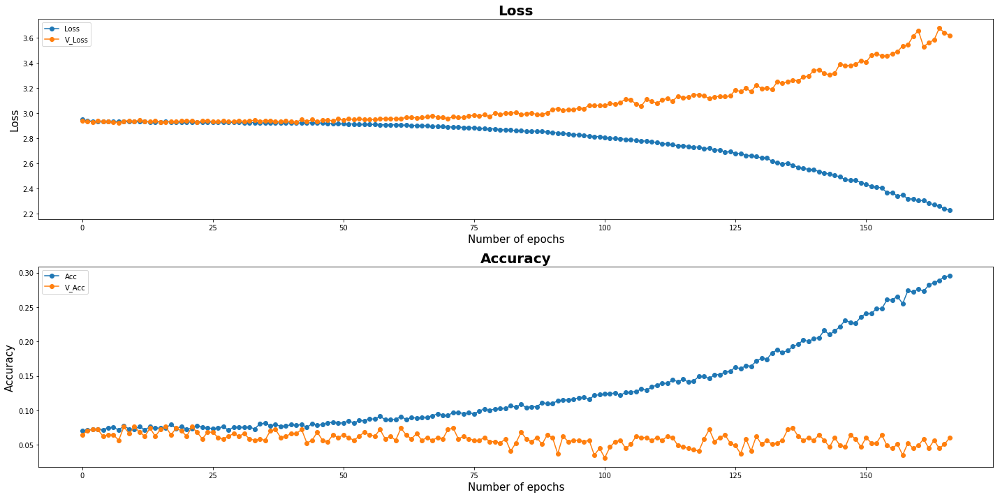

| Epoch [167] | Step [13400] | lr [0.009800] | Loss: [2.2432] | Acc: [0.2969] | Time: 0.0s
| Epoch [167] | Validation | Step [0] |  Loss: [3.5267] | Acc: [0.0547] | Time: 0.0s
| Epoch [167] | Validation | Step [1] |  Loss: [3.8377] | Acc: [0.0312] | Time: 0.0s
| Epoch [167] | Validation | Step [2] |  Loss: [3.5417] | Acc: [0.0625] | Time: 0.0s
| Epoch [167] | Validation | Step [3] |  Loss: [3.5907] | Acc: [0.0312] | Time: 0.0s


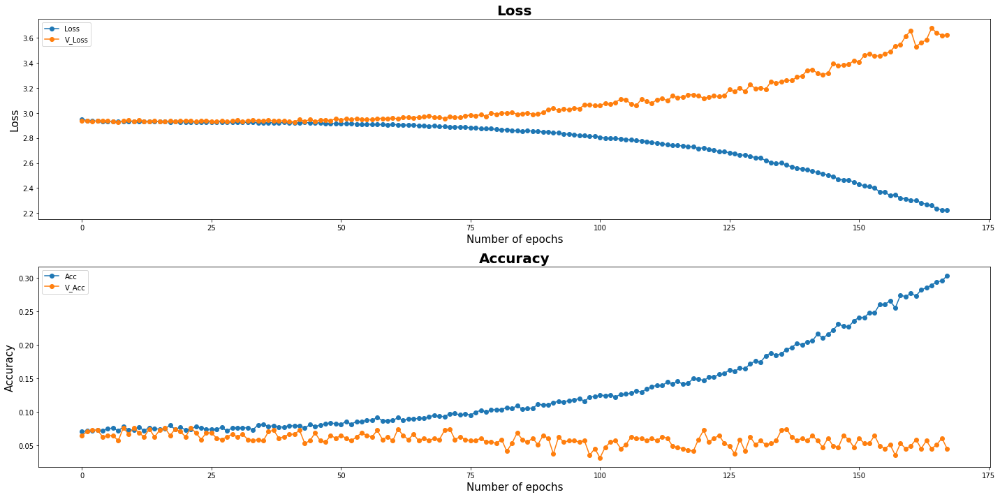

| Epoch [168] | Step [13450] | lr [0.009800] | Loss: [2.0164] | Acc: [0.3828] | Time: 0.0s
| Epoch [168] | Step [13500] | lr [0.009800] | Loss: [2.4263] | Acc: [0.1719] | Time: 0.0s
| Epoch [168] | Validation | Step [0] |  Loss: [3.8065] | Acc: [0.0469] | Time: 0.0s
| Epoch [168] | Validation | Step [1] |  Loss: [3.8034] | Acc: [0.0234] | Time: 0.0s
| Epoch [168] | Validation | Step [2] |  Loss: [3.5537] | Acc: [0.0703] | Time: 0.0s
| Epoch [168] | Validation | Step [3] |  Loss: [3.5417] | Acc: [0.0469] | Time: 0.0s


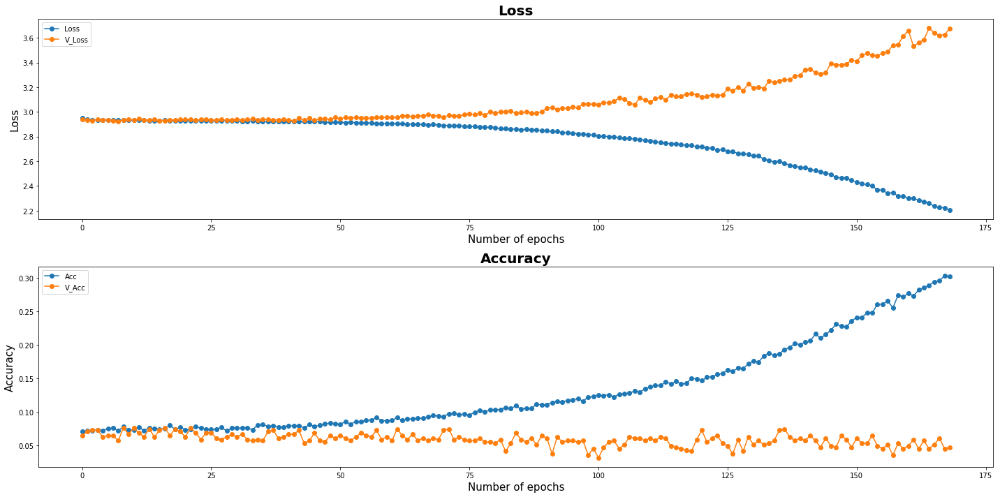

| Epoch [169] | Step [13550] | lr [0.009800] | Loss: [2.1466] | Acc: [0.3203] | Time: 0.0s
| Epoch [169] | Step [13600] | lr [0.009800] | Loss: [2.0239] | Acc: [0.3984] | Time: 0.0s
| Epoch [169] | Validation | Step [0] |  Loss: [3.6654] | Acc: [0.0547] | Time: 0.0s
| Epoch [169] | Validation | Step [1] |  Loss: [3.6059] | Acc: [0.0703] | Time: 0.0s
| Epoch [169] | Validation | Step [2] |  Loss: [3.8089] | Acc: [0.0547] | Time: 0.0s
| Epoch [169] | Validation | Step [3] |  Loss: [3.7852] | Acc: [0.0391] | Time: 0.0s


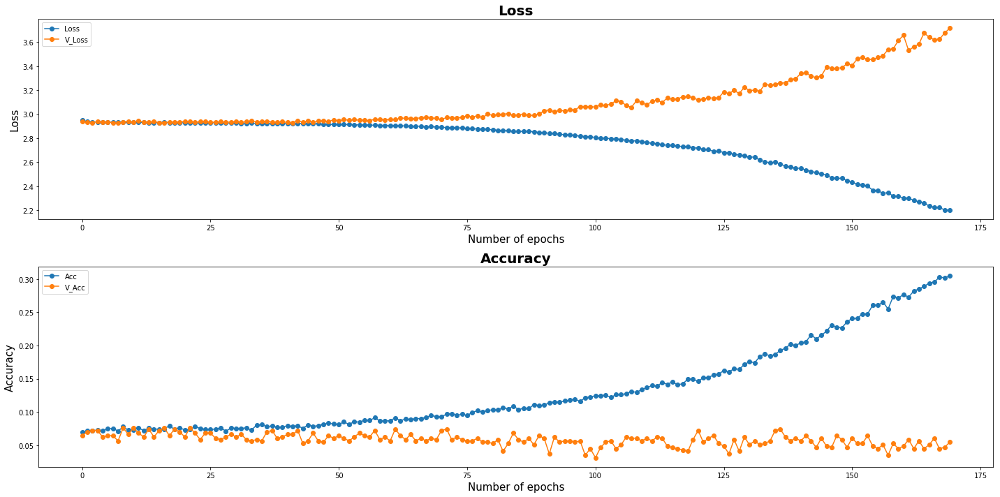

Model Saved
| Epoch [170] | Step [13650] | lr [0.009800] | Loss: [2.0936] | Acc: [0.3984] | Time: 0.0s
| Epoch [170] | Validation | Step [0] |  Loss: [3.7375] | Acc: [0.0469] | Time: 0.0s
| Epoch [170] | Validation | Step [1] |  Loss: [3.7588] | Acc: [0.0703] | Time: 0.0s
| Epoch [170] | Validation | Step [2] |  Loss: [3.6152] | Acc: [0.0234] | Time: 0.0s
| Epoch [170] | Validation | Step [3] |  Loss: [3.7442] | Acc: [0.0312] | Time: 0.0s


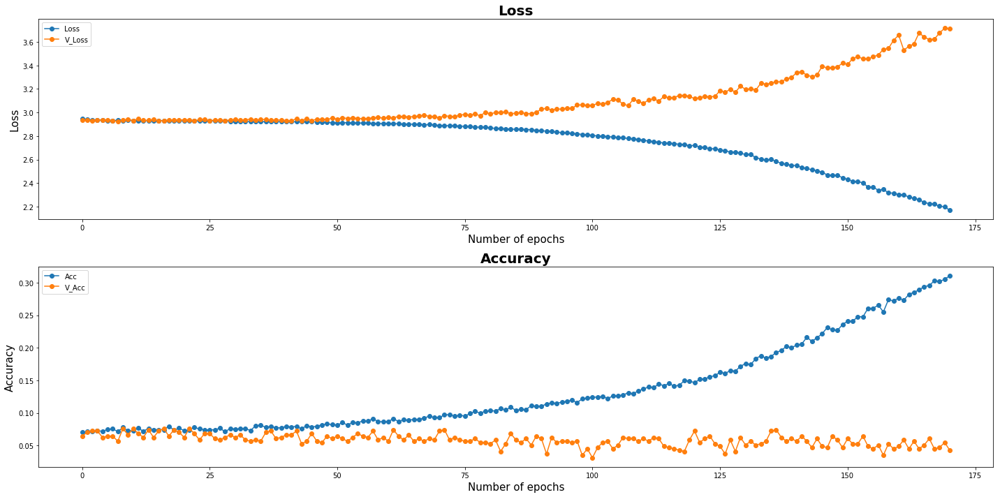

| Epoch [171] | Step [13700] | lr [0.009800] | Loss: [2.1590] | Acc: [0.3281] | Time: 0.0s
| Epoch [171] | Step [13750] | lr [0.009800] | Loss: [2.1941] | Acc: [0.2734] | Time: 0.0s
| Epoch [171] | Validation | Step [0] |  Loss: [3.6664] | Acc: [0.0547] | Time: 0.0s
| Epoch [171] | Validation | Step [1] |  Loss: [3.6068] | Acc: [0.0781] | Time: 0.0s
| Epoch [171] | Validation | Step [2] |  Loss: [3.8032] | Acc: [0.0234] | Time: 0.0s
| Epoch [171] | Validation | Step [3] |  Loss: [3.8816] | Acc: [0.0625] | Time: 0.0s


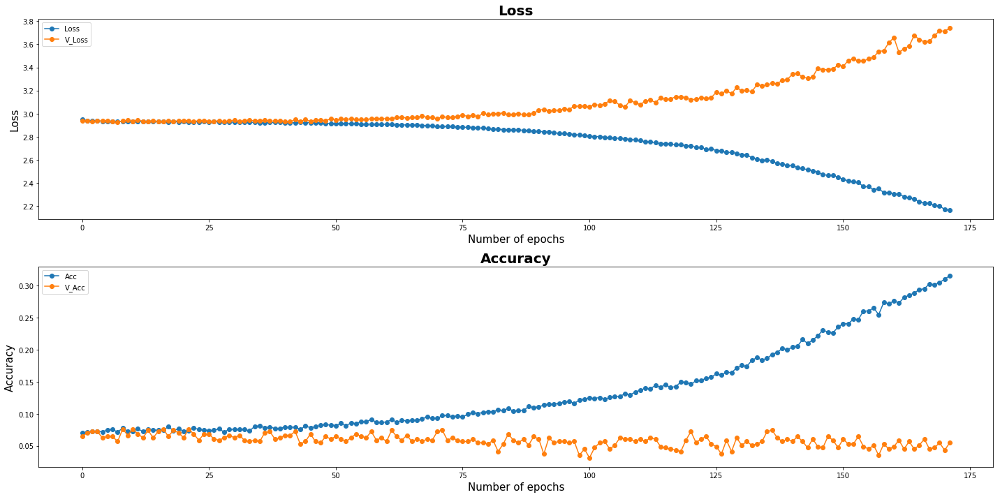

| Epoch [172] | Step [13800] | lr [0.009800] | Loss: [2.2452] | Acc: [0.2891] | Time: 0.0s
| Epoch [172] | Validation | Step [0] |  Loss: [3.7613] | Acc: [0.0469] | Time: 0.0s
| Epoch [172] | Validation | Step [1] |  Loss: [3.8714] | Acc: [0.0625] | Time: 0.0s
| Epoch [172] | Validation | Step [2] |  Loss: [3.8466] | Acc: [0.0547] | Time: 0.0s
| Epoch [172] | Validation | Step [3] |  Loss: [3.7843] | Acc: [0.0234] | Time: 0.0s


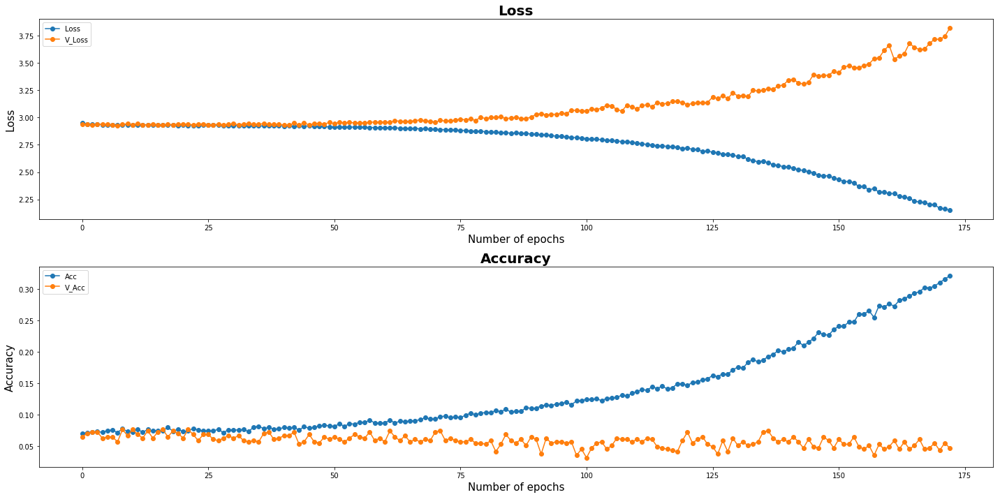

| Epoch [173] | Step [13850] | lr [0.009800] | Loss: [1.8890] | Acc: [0.4375] | Time: 0.0s
| Epoch [173] | Step [13900] | lr [0.009800] | Loss: [2.3847] | Acc: [0.2812] | Time: 0.0s
| Epoch [173] | Validation | Step [0] |  Loss: [3.9038] | Acc: [0.0547] | Time: 0.0s
| Epoch [173] | Validation | Step [1] |  Loss: [3.9101] | Acc: [0.0391] | Time: 0.0s
| Epoch [173] | Validation | Step [2] |  Loss: [3.8399] | Acc: [0.0547] | Time: 0.0s
| Epoch [173] | Validation | Step [3] |  Loss: [3.7154] | Acc: [0.0625] | Time: 0.0s


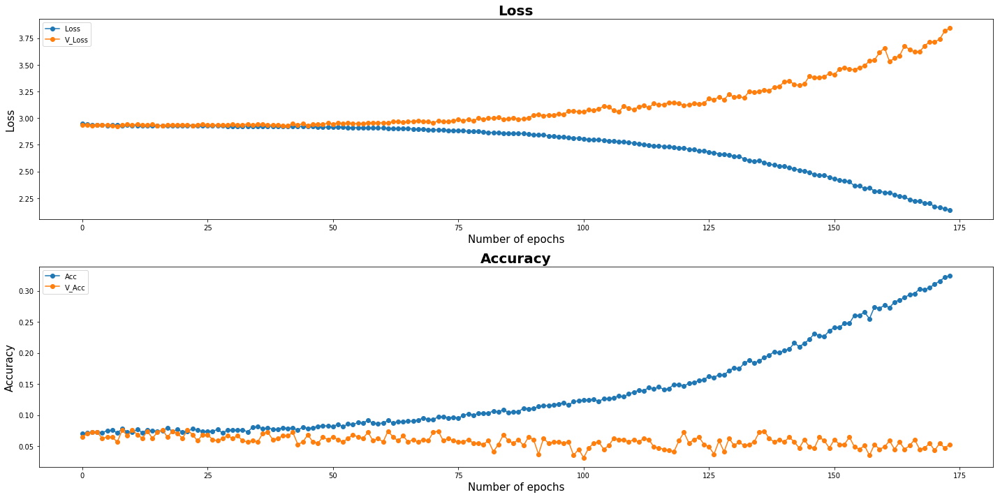

| Epoch [174] | Step [13950] | lr [0.009800] | Loss: [2.0583] | Acc: [0.3438] | Time: 0.0s
| Epoch [174] | Step [14000] | lr [0.009800] | Loss: [2.1468] | Acc: [0.3438] | Time: 0.0s
| Epoch [174] | Validation | Step [0] |  Loss: [3.9016] | Acc: [0.0234] | Time: 0.0s
| Epoch [174] | Validation | Step [1] |  Loss: [4.0509] | Acc: [0.0312] | Time: 0.0s
| Epoch [174] | Validation | Step [2] |  Loss: [3.7378] | Acc: [0.0391] | Time: 0.0s
| Epoch [174] | Validation | Step [3] |  Loss: [3.6481] | Acc: [0.0391] | Time: 0.0s


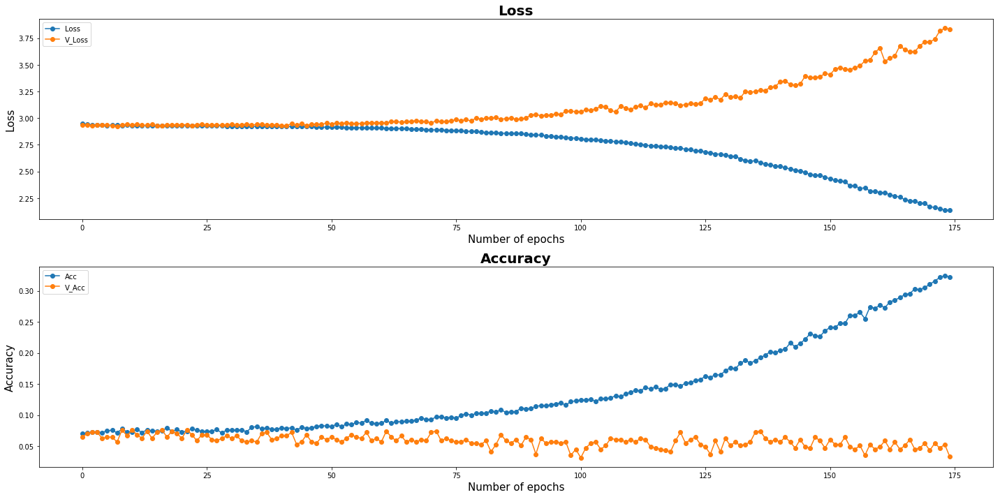

| Epoch [175] | Step [14050] | lr [0.009800] | Loss: [2.0904] | Acc: [0.3281] | Time: 0.0s
| Epoch [175] | Validation | Step [0] |  Loss: [3.9003] | Acc: [0.0781] | Time: 0.0s
| Epoch [175] | Validation | Step [1] |  Loss: [3.7024] | Acc: [0.0938] | Time: 0.0s
| Epoch [175] | Validation | Step [2] |  Loss: [3.9927] | Acc: [0.0703] | Time: 0.0s
| Epoch [175] | Validation | Step [3] |  Loss: [3.6731] | Acc: [0.0469] | Time: 0.0s


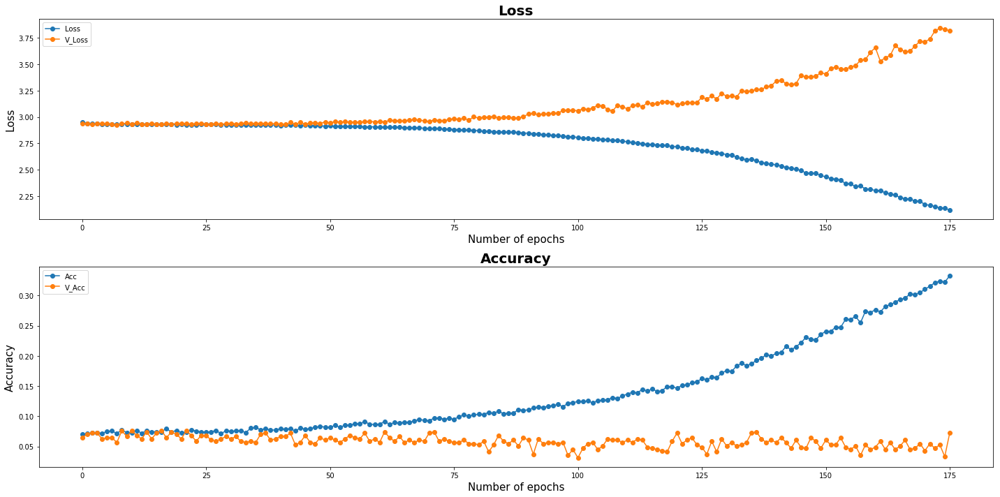

| Epoch [176] | Step [14100] | lr [0.009800] | Loss: [2.1943] | Acc: [0.2734] | Time: 0.0s
| Epoch [176] | Step [14150] | lr [0.009800] | Loss: [2.3090] | Acc: [0.2734] | Time: 0.0s
| Epoch [176] | Validation | Step [0] |  Loss: [3.7884] | Acc: [0.0312] | Time: 0.0s
| Epoch [176] | Validation | Step [1] |  Loss: [3.8963] | Acc: [0.0469] | Time: 0.0s
| Epoch [176] | Validation | Step [2] |  Loss: [3.9049] | Acc: [0.0547] | Time: 0.0s
| Epoch [176] | Validation | Step [3] |  Loss: [3.6959] | Acc: [0.0703] | Time: 0.0s


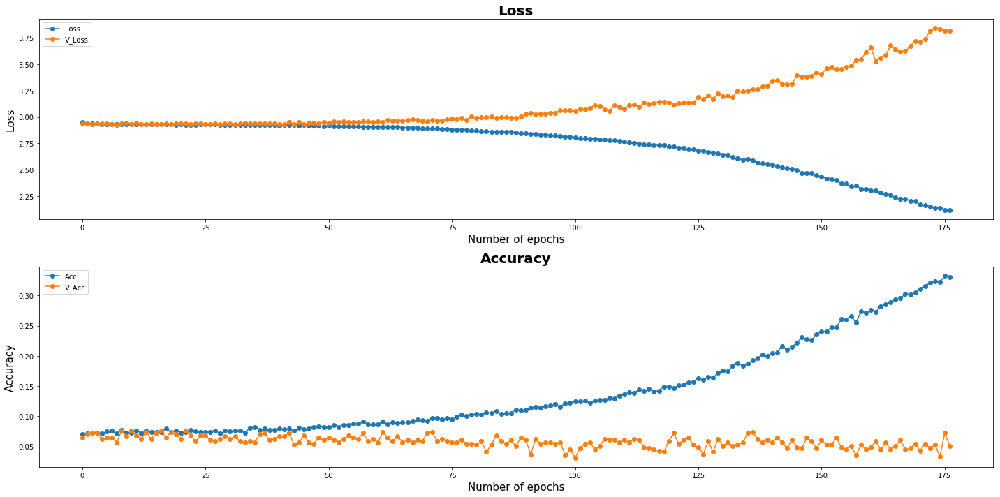

| Epoch [177] | Step [14200] | lr [0.009800] | Loss: [2.0927] | Acc: [0.3438] | Time: 0.0s
| Epoch [177] | Validation | Step [0] |  Loss: [3.9477] | Acc: [0.0469] | Time: 0.0s
| Epoch [177] | Validation | Step [1] |  Loss: [3.5902] | Acc: [0.0938] | Time: 0.0s
| Epoch [177] | Validation | Step [2] |  Loss: [3.8708] | Acc: [0.0703] | Time: 0.0s
| Epoch [177] | Validation | Step [3] |  Loss: [3.8045] | Acc: [0.0234] | Time: 0.0s


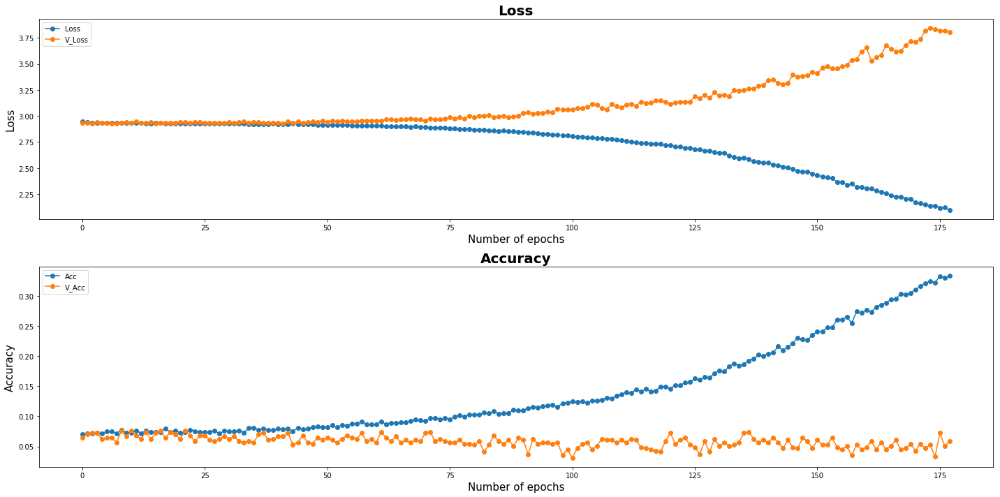

| Epoch [178] | Step [14250] | lr [0.009800] | Loss: [1.8246] | Acc: [0.4453] | Time: 0.0s
| Epoch [178] | Step [14300] | lr [0.009800] | Loss: [1.9054] | Acc: [0.3984] | Time: 0.0s
| Epoch [178] | Validation | Step [0] |  Loss: [3.9180] | Acc: [0.0703] | Time: 0.0s
| Epoch [178] | Validation | Step [1] |  Loss: [3.8120] | Acc: [0.0703] | Time: 0.0s
| Epoch [178] | Validation | Step [2] |  Loss: [3.9943] | Acc: [0.0625] | Time: 0.0s
| Epoch [178] | Validation | Step [3] |  Loss: [3.8637] | Acc: [0.0781] | Time: 0.0s


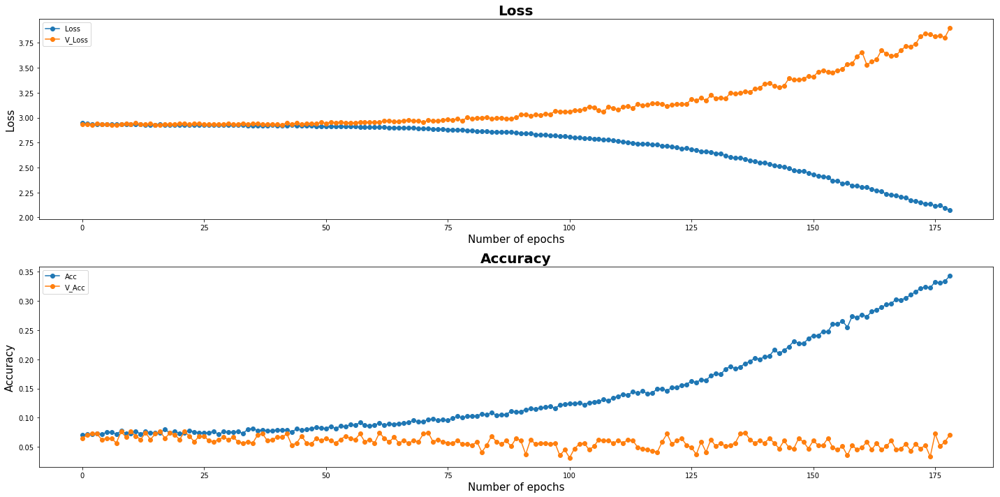

| Epoch [179] | Step [14350] | lr [0.009800] | Loss: [2.0350] | Acc: [0.3281] | Time: 0.0s
| Epoch [179] | Step [14400] | lr [0.009800] | Loss: [2.1982] | Acc: [0.2578] | Time: 0.0s
| Epoch [179] | Validation | Step [0] |  Loss: [4.1018] | Acc: [0.0469] | Time: 0.0s
| Epoch [179] | Validation | Step [1] |  Loss: [4.1087] | Acc: [0.0469] | Time: 0.0s
| Epoch [179] | Validation | Step [2] |  Loss: [3.8316] | Acc: [0.0938] | Time: 0.0s
| Epoch [179] | Validation | Step [3] |  Loss: [3.6378] | Acc: [0.0703] | Time: 0.0s


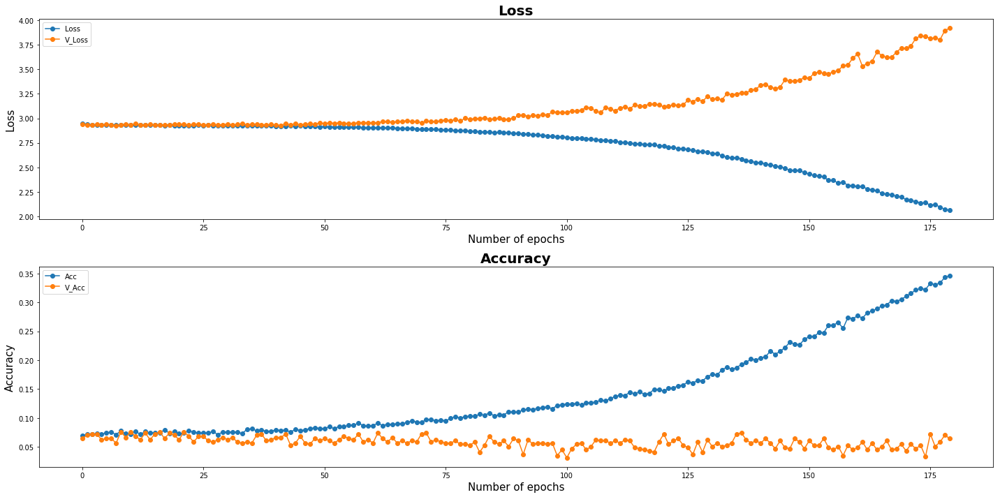

Model Saved
| Epoch [180] | Step [14450] | lr [0.009800] | Loss: [2.0681] | Acc: [0.3203] | Time: 0.0s
| Epoch [180] | Validation | Step [0] |  Loss: [3.9002] | Acc: [0.0547] | Time: 0.0s
| Epoch [180] | Validation | Step [1] |  Loss: [3.7160] | Acc: [0.0312] | Time: 0.0s
| Epoch [180] | Validation | Step [2] |  Loss: [3.9848] | Acc: [0.0391] | Time: 0.0s
| Epoch [180] | Validation | Step [3] |  Loss: [3.8213] | Acc: [0.0469] | Time: 0.0s


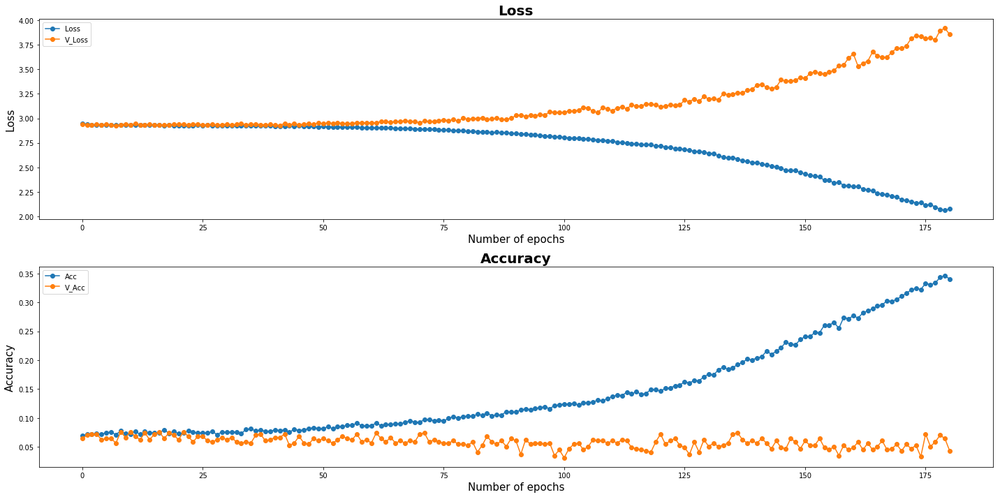

| Epoch [181] | Step [14500] | lr [0.009800] | Loss: [2.0923] | Acc: [0.3125] | Time: 0.0s
| Epoch [181] | Step [14550] | lr [0.009800] | Loss: [2.1652] | Acc: [0.2812] | Time: 0.0s
| Epoch [181] | Validation | Step [0] |  Loss: [4.1395] | Acc: [0.0547] | Time: 0.0s
| Epoch [181] | Validation | Step [1] |  Loss: [3.8352] | Acc: [0.0547] | Time: 0.0s
| Epoch [181] | Validation | Step [2] |  Loss: [3.7516] | Acc: [0.0391] | Time: 0.0s
| Epoch [181] | Validation | Step [3] |  Loss: [4.0033] | Acc: [0.0234] | Time: 0.0s


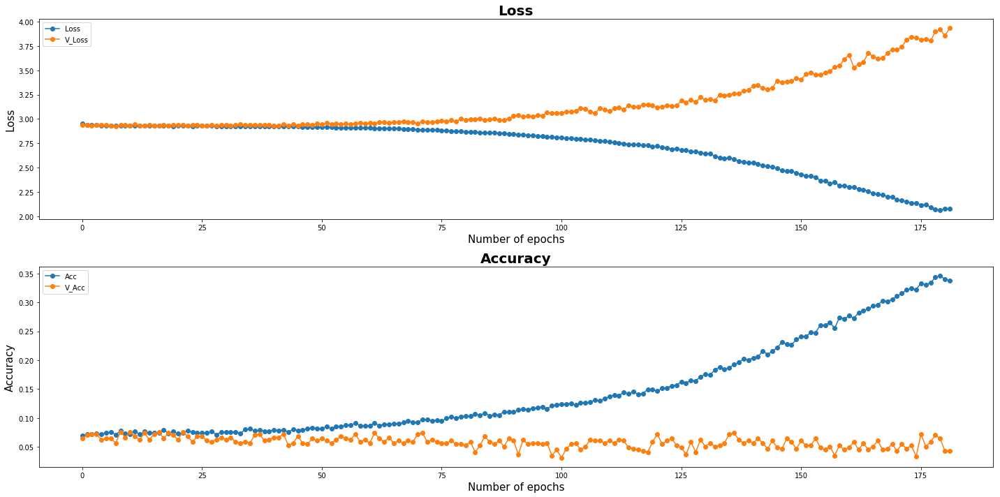

| Epoch [182] | Step [14600] | lr [0.009800] | Loss: [1.9351] | Acc: [0.4062] | Time: 0.0s
| Epoch [182] | Validation | Step [0] |  Loss: [3.9815] | Acc: [0.0391] | Time: 0.0s
| Epoch [182] | Validation | Step [1] |  Loss: [3.8534] | Acc: [0.0312] | Time: 0.0s
| Epoch [182] | Validation | Step [2] |  Loss: [3.7596] | Acc: [0.0547] | Time: 0.0s
| Epoch [182] | Validation | Step [3] |  Loss: [3.8830] | Acc: [0.0469] | Time: 0.0s


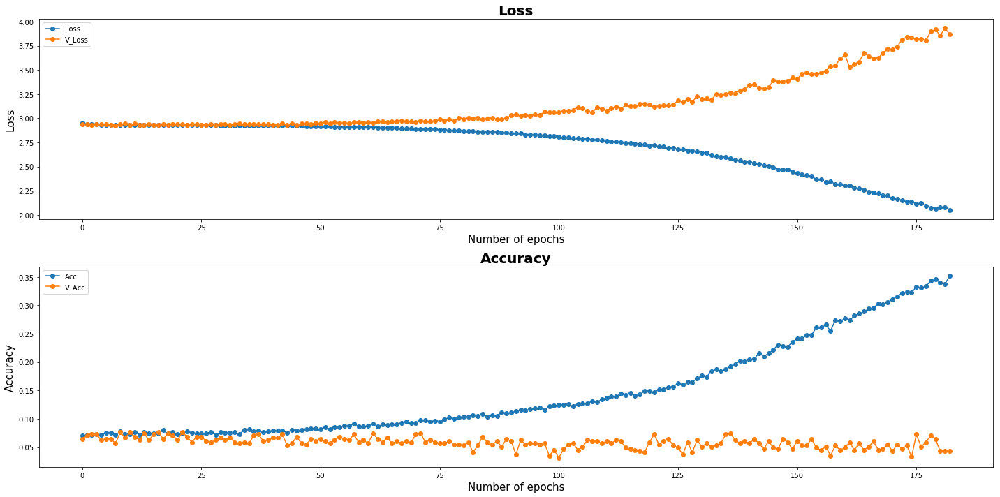

| Epoch [183] | Step [14650] | lr [0.009800] | Loss: [1.7832] | Acc: [0.4297] | Time: 0.0s
| Epoch [183] | Step [14700] | lr [0.009800] | Loss: [2.1391] | Acc: [0.3281] | Time: 0.0s
| Epoch [183] | Validation | Step [0] |  Loss: [4.0310] | Acc: [0.0391] | Time: 0.0s
| Epoch [183] | Validation | Step [1] |  Loss: [3.8890] | Acc: [0.0625] | Time: 0.0s
| Epoch [183] | Validation | Step [2] |  Loss: [3.9861] | Acc: [0.0391] | Time: 0.0s
| Epoch [183] | Validation | Step [3] |  Loss: [3.8991] | Acc: [0.0391] | Time: 0.0s


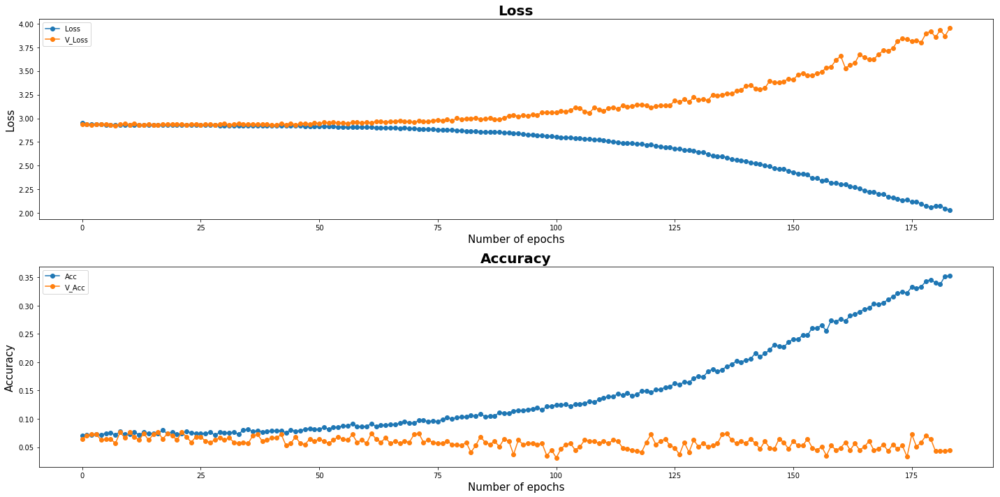

| Epoch [184] | Step [14750] | lr [0.009800] | Loss: [1.8640] | Acc: [0.3672] | Time: 0.0s
| Epoch [184] | Step [14800] | lr [0.009800] | Loss: [2.1203] | Acc: [0.3203] | Time: 0.0s
| Epoch [184] | Validation | Step [0] |  Loss: [3.8536] | Acc: [0.0234] | Time: 0.0s
| Epoch [184] | Validation | Step [1] |  Loss: [4.1013] | Acc: [0.0859] | Time: 0.0s
| Epoch [184] | Validation | Step [2] |  Loss: [4.1241] | Acc: [0.0625] | Time: 0.0s
| Epoch [184] | Validation | Step [3] |  Loss: [3.8348] | Acc: [0.0469] | Time: 0.0s


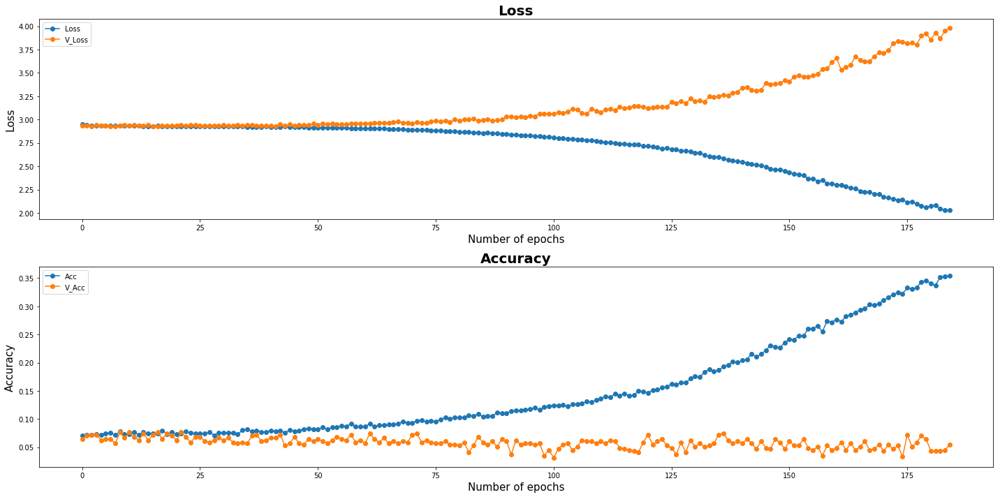

| Epoch [185] | Step [14850] | lr [0.009800] | Loss: [2.0417] | Acc: [0.3828] | Time: 0.0s
| Epoch [185] | Validation | Step [0] |  Loss: [4.0107] | Acc: [0.0391] | Time: 0.0s
| Epoch [185] | Validation | Step [1] |  Loss: [4.0237] | Acc: [0.0312] | Time: 0.0s
| Epoch [185] | Validation | Step [2] |  Loss: [4.0650] | Acc: [0.0469] | Time: 0.0s
| Epoch [185] | Validation | Step [3] |  Loss: [4.0850] | Acc: [0.0078] | Time: 0.0s


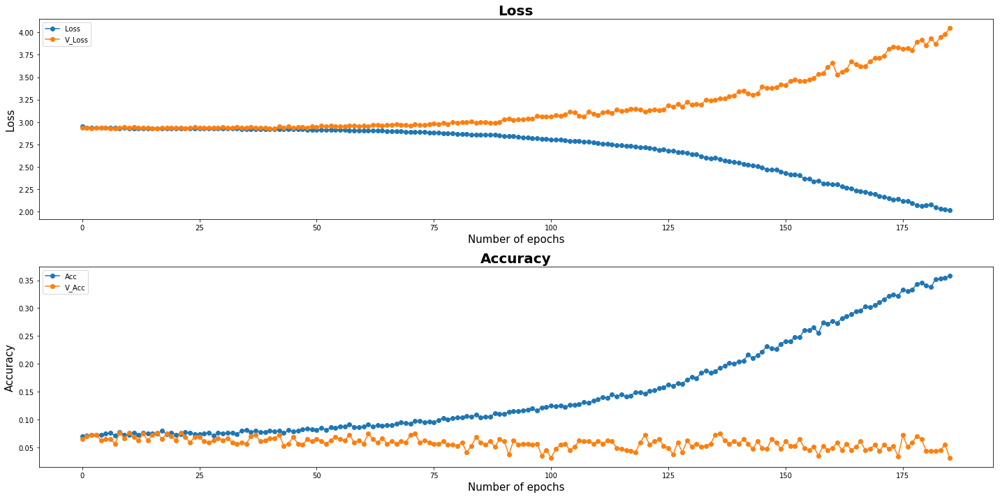

| Epoch [186] | Step [14900] | lr [0.009800] | Loss: [1.9560] | Acc: [0.4453] | Time: 0.0s
| Epoch [186] | Step [14950] | lr [0.009800] | Loss: [2.2730] | Acc: [0.2969] | Time: 0.0s
| Epoch [186] | Validation | Step [0] |  Loss: [4.0668] | Acc: [0.0312] | Time: 0.0s
| Epoch [186] | Validation | Step [1] |  Loss: [3.9454] | Acc: [0.1250] | Time: 0.0s
| Epoch [186] | Validation | Step [2] |  Loss: [4.1722] | Acc: [0.0312] | Time: 0.0s
| Epoch [186] | Validation | Step [3] |  Loss: [3.9415] | Acc: [0.0469] | Time: 0.0s


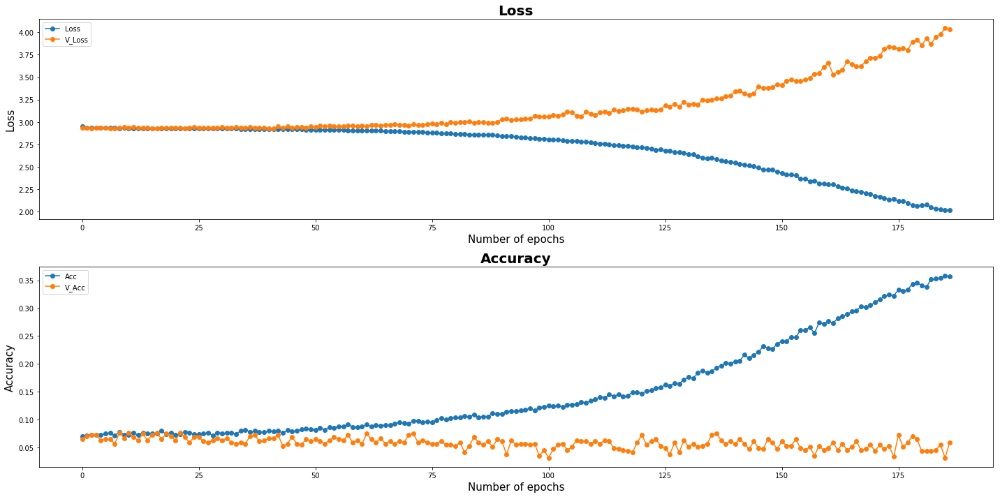

| Epoch [187] | Step [15000] | lr [0.009800] | Loss: [1.9246] | Acc: [0.3594] | Time: 0.0s
| Epoch [187] | Validation | Step [0] |  Loss: [4.2219] | Acc: [0.0391] | Time: 0.0s
| Epoch [187] | Validation | Step [1] |  Loss: [3.9055] | Acc: [0.0547] | Time: 0.0s
| Epoch [187] | Validation | Step [2] |  Loss: [4.0602] | Acc: [0.0391] | Time: 0.0s
| Epoch [187] | Validation | Step [3] |  Loss: [4.0316] | Acc: [0.0547] | Time: 0.0s


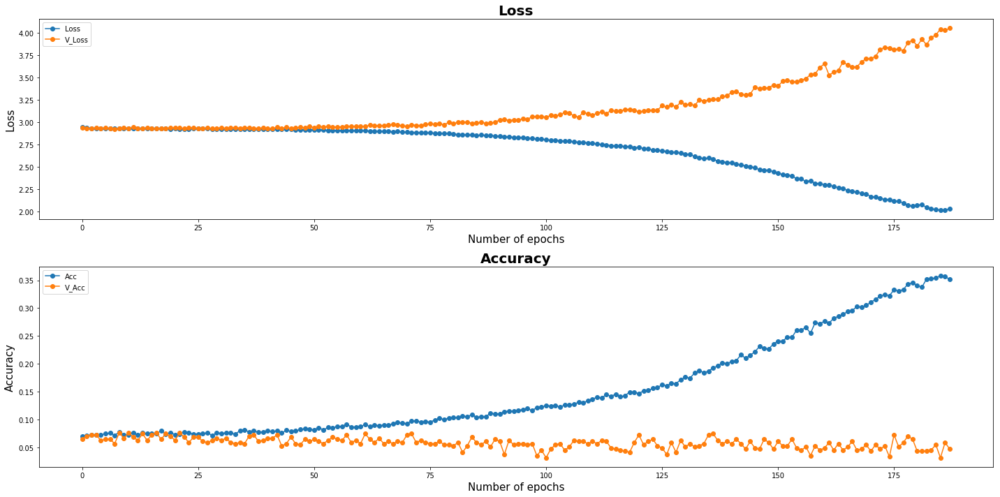

| Epoch [188] | Step [15050] | lr [0.009800] | Loss: [1.8046] | Acc: [0.3906] | Time: 0.0s
| Epoch [188] | Step [15100] | lr [0.009800] | Loss: [2.1443] | Acc: [0.2969] | Time: 0.0s
| Epoch [188] | Validation | Step [0] |  Loss: [3.7695] | Acc: [0.0625] | Time: 0.0s
| Epoch [188] | Validation | Step [1] |  Loss: [4.1005] | Acc: [0.0781] | Time: 0.0s
| Epoch [188] | Validation | Step [2] |  Loss: [4.0498] | Acc: [0.0469] | Time: 0.0s
| Epoch [188] | Validation | Step [3] |  Loss: [4.1460] | Acc: [0.0547] | Time: 0.0s


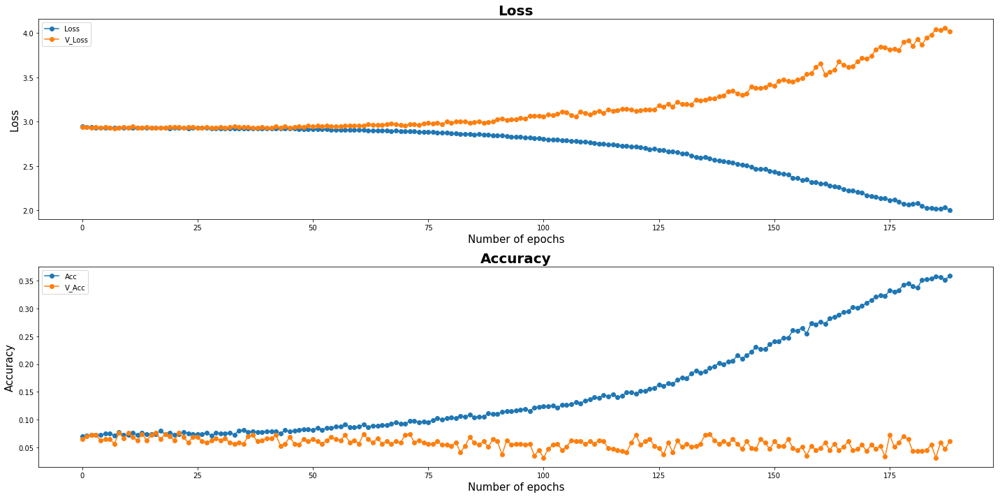

| Epoch [189] | Step [15150] | lr [0.009800] | Loss: [2.0079] | Acc: [0.3516] | Time: 0.0s
| Epoch [189] | Step [15200] | lr [0.009800] | Loss: [2.0683] | Acc: [0.3594] | Time: 0.0s
| Epoch [189] | Validation | Step [0] |  Loss: [4.0614] | Acc: [0.0391] | Time: 0.0s
| Epoch [189] | Validation | Step [1] |  Loss: [4.0558] | Acc: [0.0469] | Time: 0.0s
| Epoch [189] | Validation | Step [2] |  Loss: [4.0688] | Acc: [0.0547] | Time: 0.0s
| Epoch [189] | Validation | Step [3] |  Loss: [4.0753] | Acc: [0.0547] | Time: 0.0s


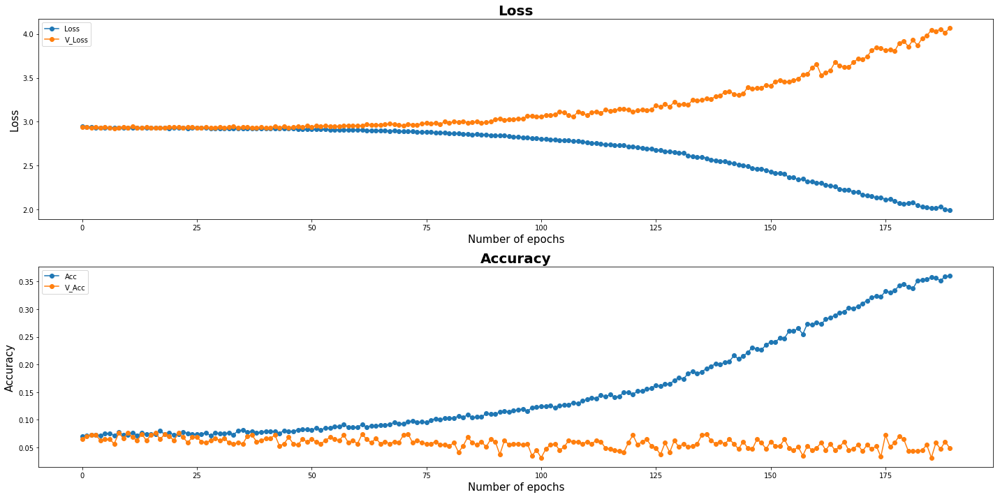

Model Saved
| Epoch [190] | Step [15250] | lr [0.009800] | Loss: [1.9037] | Acc: [0.3828] | Time: 0.0s
| Epoch [190] | Validation | Step [0] |  Loss: [4.0538] | Acc: [0.0391] | Time: 0.0s
| Epoch [190] | Validation | Step [1] |  Loss: [3.8222] | Acc: [0.0625] | Time: 0.0s
| Epoch [190] | Validation | Step [2] |  Loss: [4.2477] | Acc: [0.0547] | Time: 0.0s
| Epoch [190] | Validation | Step [3] |  Loss: [4.1782] | Acc: [0.0625] | Time: 0.0s


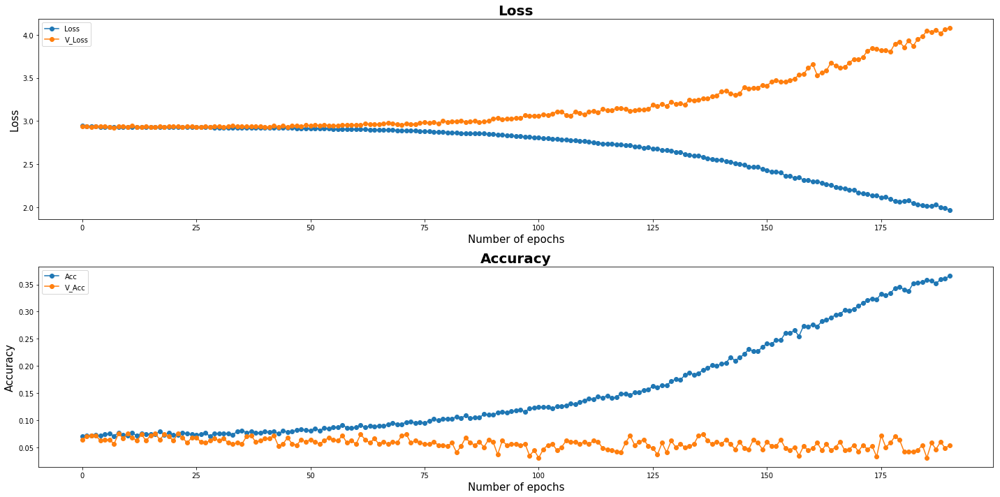

| Epoch [191] | Step [15300] | lr [0.009800] | Loss: [1.8966] | Acc: [0.3750] | Time: 0.0s
| Epoch [191] | Step [15350] | lr [0.009800] | Loss: [2.0335] | Acc: [0.3750] | Time: 0.0s
| Epoch [191] | Validation | Step [0] |  Loss: [4.1171] | Acc: [0.0703] | Time: 0.0s
| Epoch [191] | Validation | Step [1] |  Loss: [3.9064] | Acc: [0.0391] | Time: 0.0s
| Epoch [191] | Validation | Step [2] |  Loss: [4.0313] | Acc: [0.0547] | Time: 0.0s
| Epoch [191] | Validation | Step [3] |  Loss: [4.2870] | Acc: [0.0078] | Time: 0.0s


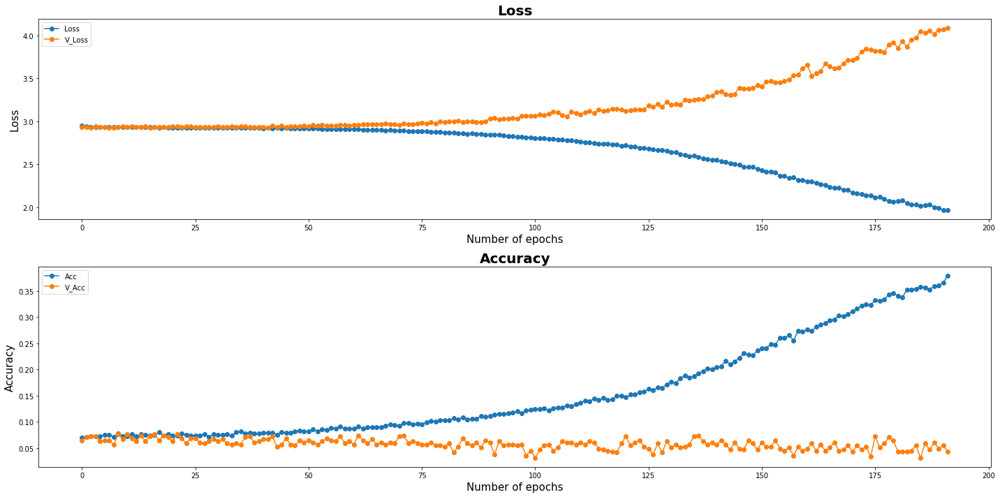

| Epoch [192] | Step [15400] | lr [0.009800] | Loss: [1.9425] | Acc: [0.3594] | Time: 0.0s
| Epoch [192] | Validation | Step [0] |  Loss: [4.0721] | Acc: [0.0469] | Time: 0.0s
| Epoch [192] | Validation | Step [1] |  Loss: [4.3118] | Acc: [0.0391] | Time: 0.0s
| Epoch [192] | Validation | Step [2] |  Loss: [4.0588] | Acc: [0.0547] | Time: 0.0s
| Epoch [192] | Validation | Step [3] |  Loss: [4.0696] | Acc: [0.0391] | Time: 0.0s


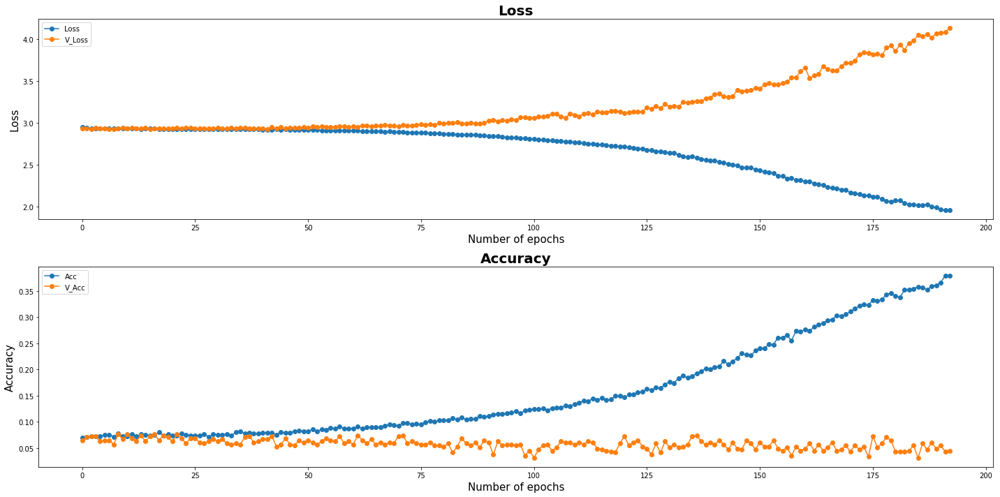

| Epoch [193] | Step [15450] | lr [0.009800] | Loss: [1.7676] | Acc: [0.4609] | Time: 0.0s
| Epoch [193] | Step [15500] | lr [0.009800] | Loss: [2.1290] | Acc: [0.3438] | Time: 0.0s
| Epoch [193] | Validation | Step [0] |  Loss: [3.8857] | Acc: [0.0781] | Time: 0.0s
| Epoch [193] | Validation | Step [1] |  Loss: [4.0560] | Acc: [0.0469] | Time: 0.0s
| Epoch [193] | Validation | Step [2] |  Loss: [4.3602] | Acc: [0.0391] | Time: 0.0s
| Epoch [193] | Validation | Step [3] |  Loss: [4.2576] | Acc: [0.0391] | Time: 0.0s


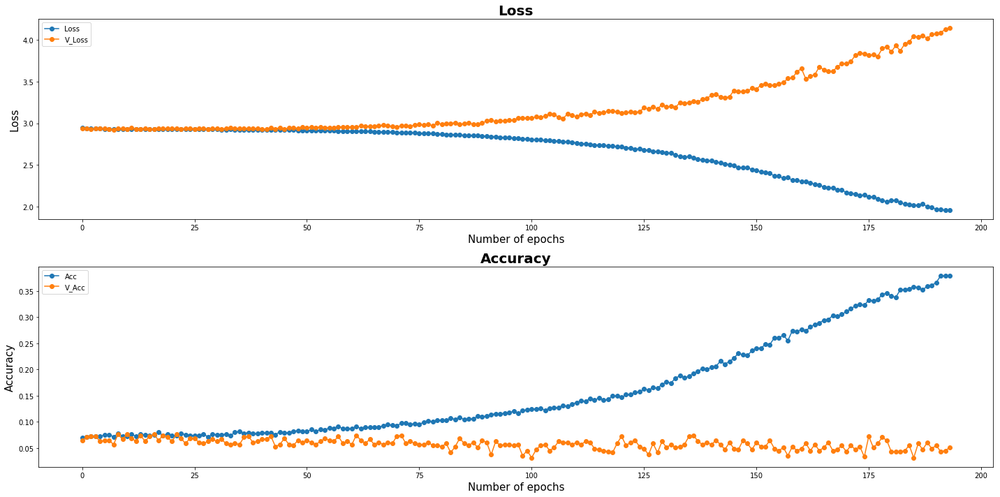

| Epoch [194] | Step [15550] | lr [0.009800] | Loss: [1.8507] | Acc: [0.3984] | Time: 0.0s
| Epoch [194] | Step [15600] | lr [0.009800] | Loss: [2.0786] | Acc: [0.3125] | Time: 0.0s
| Epoch [194] | Validation | Step [0] |  Loss: [4.0534] | Acc: [0.0703] | Time: 0.0s
| Epoch [194] | Validation | Step [1] |  Loss: [4.1094] | Acc: [0.0625] | Time: 0.0s
| Epoch [194] | Validation | Step [2] |  Loss: [4.0060] | Acc: [0.0547] | Time: 0.0s
| Epoch [194] | Validation | Step [3] |  Loss: [4.0258] | Acc: [0.0391] | Time: 0.0s


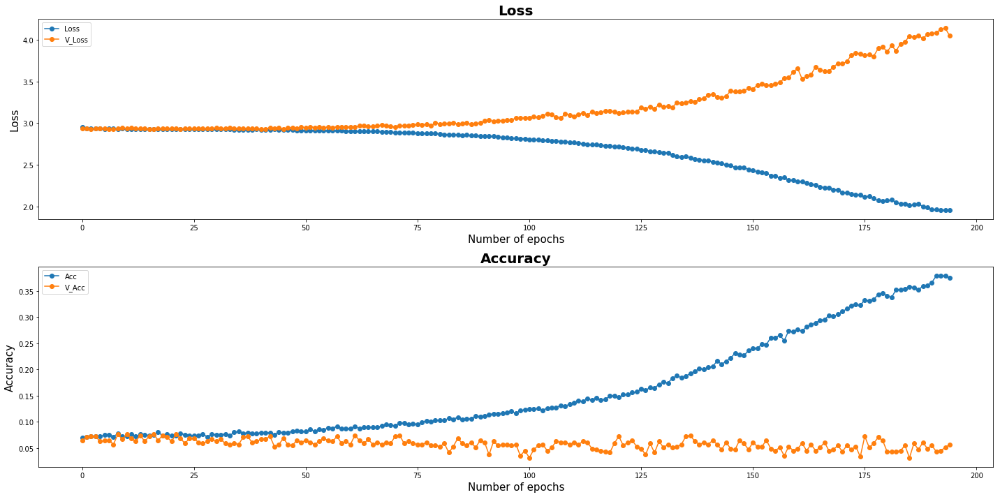

| Epoch [195] | Step [15650] | lr [0.009800] | Loss: [1.8442] | Acc: [0.4141] | Time: 0.0s
| Epoch [195] | Validation | Step [0] |  Loss: [4.2643] | Acc: [0.0391] | Time: 0.0s
| Epoch [195] | Validation | Step [1] |  Loss: [3.9220] | Acc: [0.0781] | Time: 0.0s
| Epoch [195] | Validation | Step [2] |  Loss: [4.2893] | Acc: [0.0391] | Time: 0.0s
| Epoch [195] | Validation | Step [3] |  Loss: [4.0827] | Acc: [0.0547] | Time: 0.0s


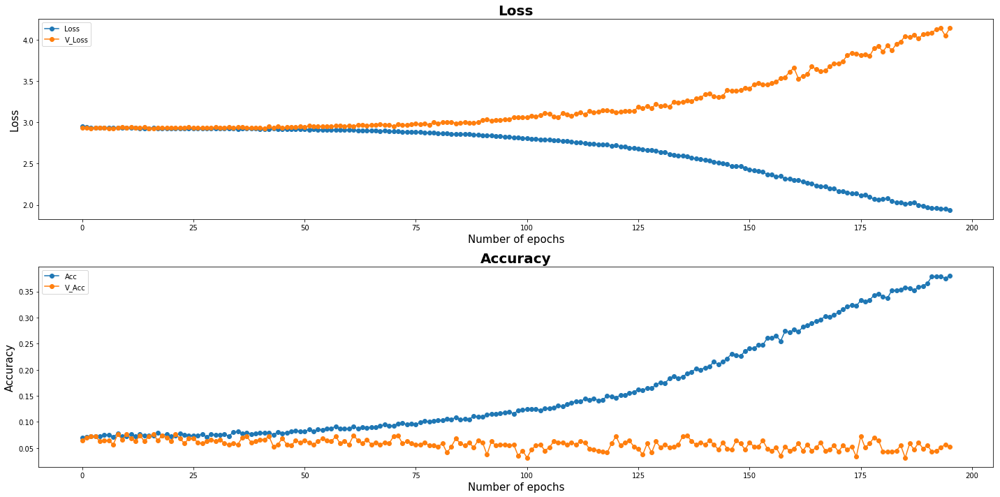

| Epoch [196] | Step [15700] | lr [0.009800] | Loss: [1.7453] | Acc: [0.4141] | Time: 0.0s
| Epoch [196] | Step [15750] | lr [0.009800] | Loss: [2.0690] | Acc: [0.3359] | Time: 0.0s
| Epoch [196] | Validation | Step [0] |  Loss: [4.2793] | Acc: [0.0469] | Time: 0.0s
| Epoch [196] | Validation | Step [1] |  Loss: [4.0087] | Acc: [0.0781] | Time: 0.0s
| Epoch [196] | Validation | Step [2] |  Loss: [4.1669] | Acc: [0.0312] | Time: 0.0s
| Epoch [196] | Validation | Step [3] |  Loss: [4.0505] | Acc: [0.0469] | Time: 0.0s


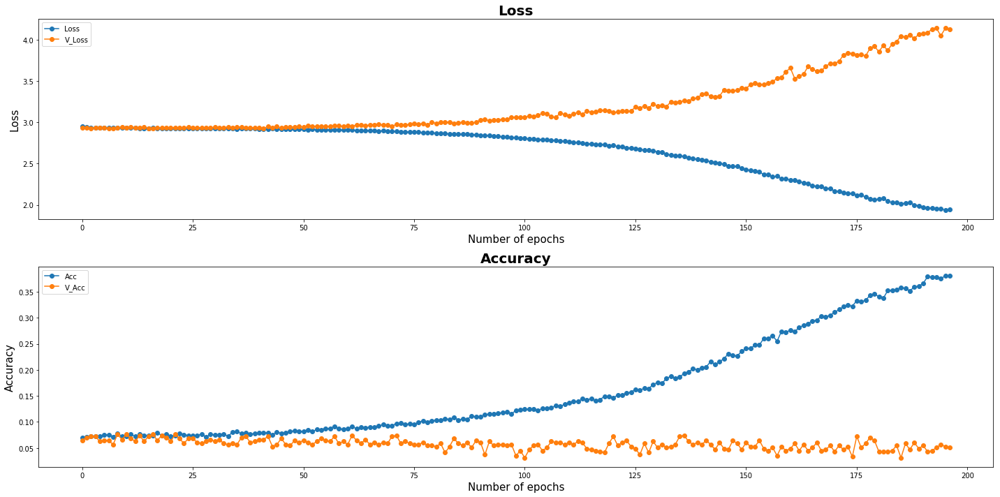

| Epoch [197] | Step [15800] | lr [0.009800] | Loss: [1.8427] | Acc: [0.3516] | Time: 0.0s
| Epoch [197] | Validation | Step [0] |  Loss: [4.2529] | Acc: [0.0469] | Time: 0.0s
| Epoch [197] | Validation | Step [1] |  Loss: [4.2136] | Acc: [0.0547] | Time: 0.0s
| Epoch [197] | Validation | Step [2] |  Loss: [4.1266] | Acc: [0.0391] | Time: 0.0s
| Epoch [197] | Validation | Step [3] |  Loss: [4.1170] | Acc: [0.0703] | Time: 0.0s


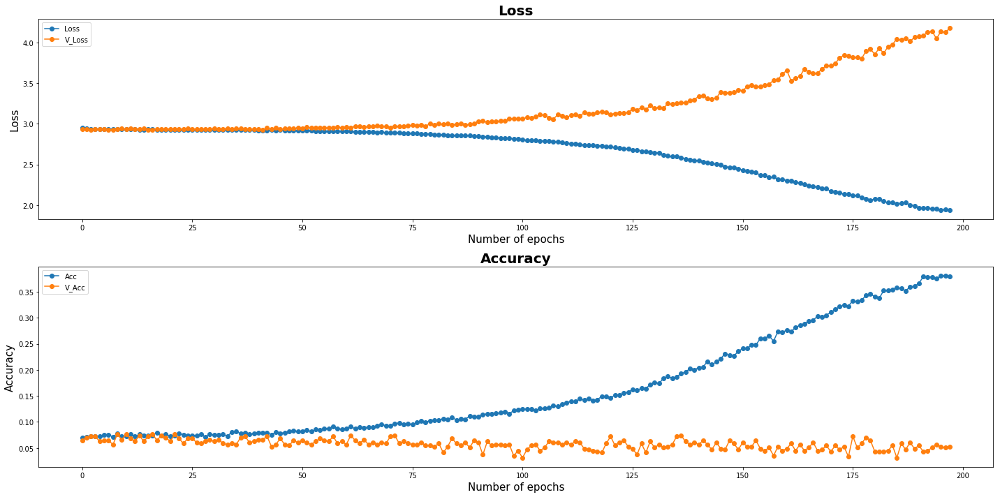

| Epoch [198] | Step [15850] | lr [0.009800] | Loss: [1.8252] | Acc: [0.4297] | Time: 0.0s
| Epoch [198] | Step [15900] | lr [0.009800] | Loss: [2.0695] | Acc: [0.3828] | Time: 0.0s
| Epoch [198] | Validation | Step [0] |  Loss: [4.1230] | Acc: [0.0703] | Time: 0.0s
| Epoch [198] | Validation | Step [1] |  Loss: [4.0186] | Acc: [0.0547] | Time: 0.0s
| Epoch [198] | Validation | Step [2] |  Loss: [4.1737] | Acc: [0.0547] | Time: 0.0s
| Epoch [198] | Validation | Step [3] |  Loss: [3.8814] | Acc: [0.0781] | Time: 0.0s


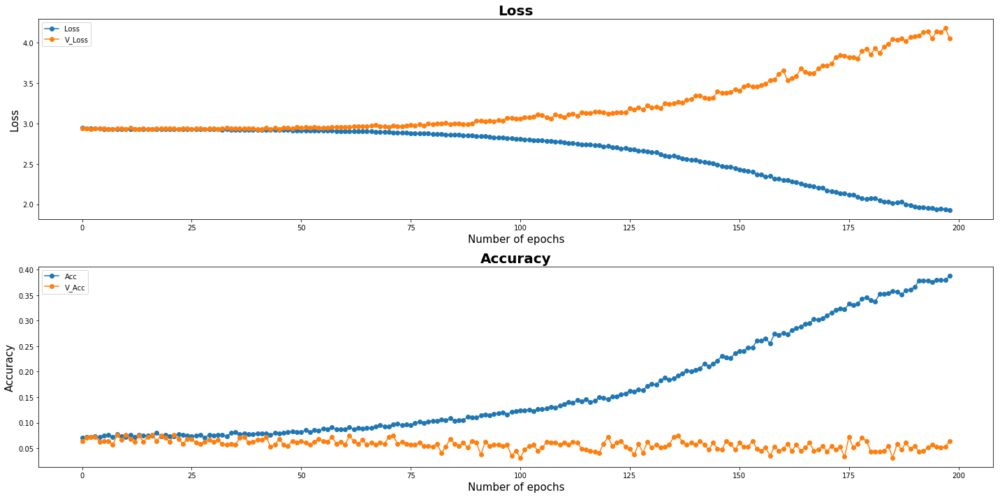

| Epoch [199] | Step [15950] | lr [0.009800] | Loss: [1.9178] | Acc: [0.3359] | Time: 0.0s
| Epoch [199] | Step [16000] | lr [0.009800] | Loss: [2.1828] | Acc: [0.3125] | Time: 0.0s
| Epoch [199] | Validation | Step [0] |  Loss: [4.1577] | Acc: [0.0547] | Time: 0.0s
| Epoch [199] | Validation | Step [1] |  Loss: [4.0847] | Acc: [0.0781] | Time: 0.0s
| Epoch [199] | Validation | Step [2] |  Loss: [4.3281] | Acc: [0.0312] | Time: 0.0s
| Epoch [199] | Validation | Step [3] |  Loss: [4.0219] | Acc: [0.0703] | Time: 0.0s


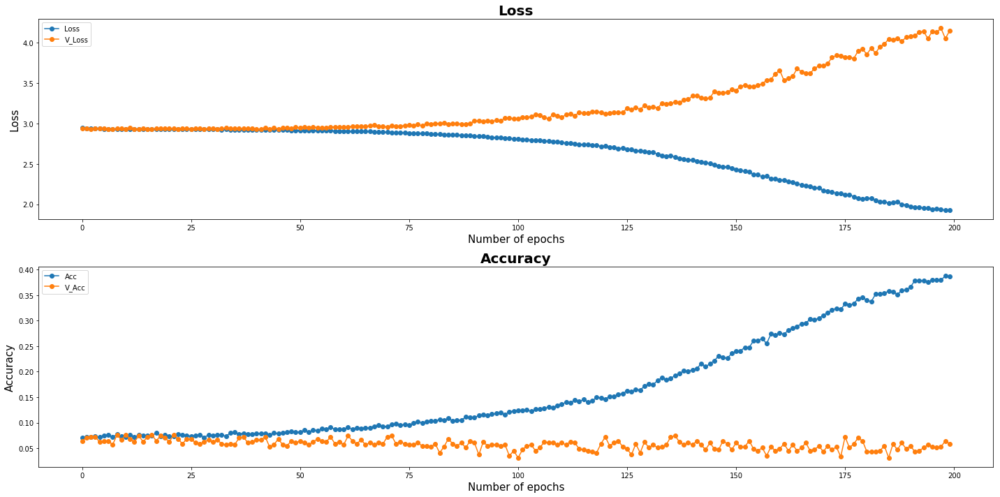

Model Saved
| Epoch [200] | Step [16050] | lr [0.009800] | Loss: [1.9355] | Acc: [0.3828] | Time: 0.0s
| Epoch [200] | Validation | Step [0] |  Loss: [3.8519] | Acc: [0.0547] | Time: 0.0s
| Epoch [200] | Validation | Step [1] |  Loss: [4.0800] | Acc: [0.0703] | Time: 0.0s
| Epoch [200] | Validation | Step [2] |  Loss: [4.0973] | Acc: [0.0781] | Time: 0.0s
| Epoch [200] | Validation | Step [3] |  Loss: [4.4282] | Acc: [0.0234] | Time: 0.0s


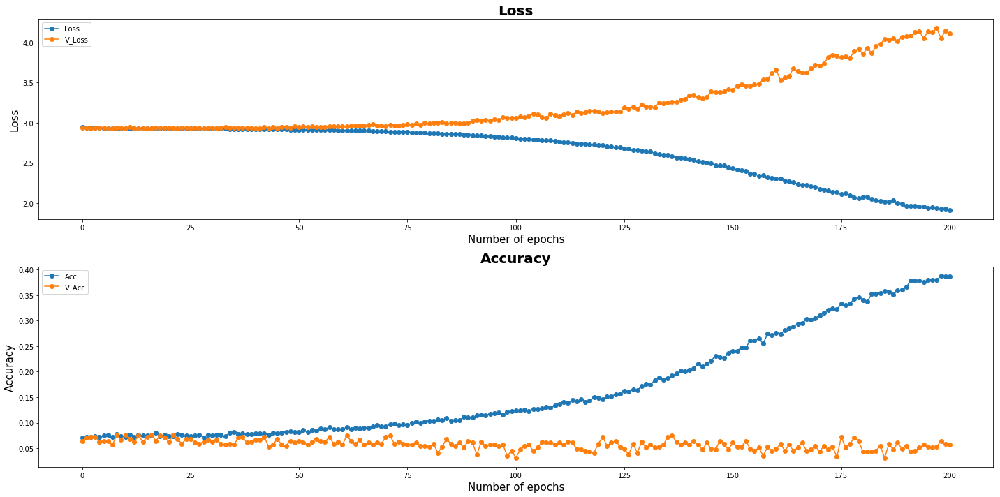

| Epoch [201] | Step [16100] | lr [0.009800] | Loss: [1.7543] | Acc: [0.4453] | Time: 0.0s
| Epoch [201] | Step [16150] | lr [0.009800] | Loss: [2.1481] | Acc: [0.2578] | Time: 0.0s
| Epoch [201] | Validation | Step [0] |  Loss: [3.9996] | Acc: [0.0547] | Time: 0.0s
| Epoch [201] | Validation | Step [1] |  Loss: [4.3717] | Acc: [0.0391] | Time: 0.0s
| Epoch [201] | Validation | Step [2] |  Loss: [4.1950] | Acc: [0.0391] | Time: 0.0s
| Epoch [201] | Validation | Step [3] |  Loss: [4.2482] | Acc: [0.0625] | Time: 0.0s


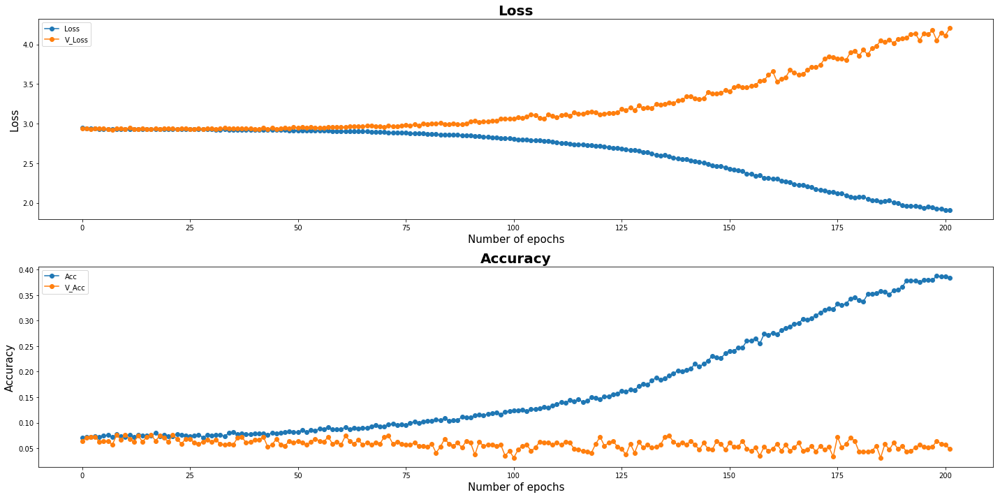

| Epoch [202] | Step [16200] | lr [0.009800] | Loss: [1.9787] | Acc: [0.3516] | Time: 0.0s
| Epoch [202] | Validation | Step [0] |  Loss: [4.0726] | Acc: [0.0312] | Time: 0.0s
| Epoch [202] | Validation | Step [1] |  Loss: [4.1117] | Acc: [0.0703] | Time: 0.0s
| Epoch [202] | Validation | Step [2] |  Loss: [4.1490] | Acc: [0.0391] | Time: 0.0s
| Epoch [202] | Validation | Step [3] |  Loss: [4.1268] | Acc: [0.0391] | Time: 0.0s


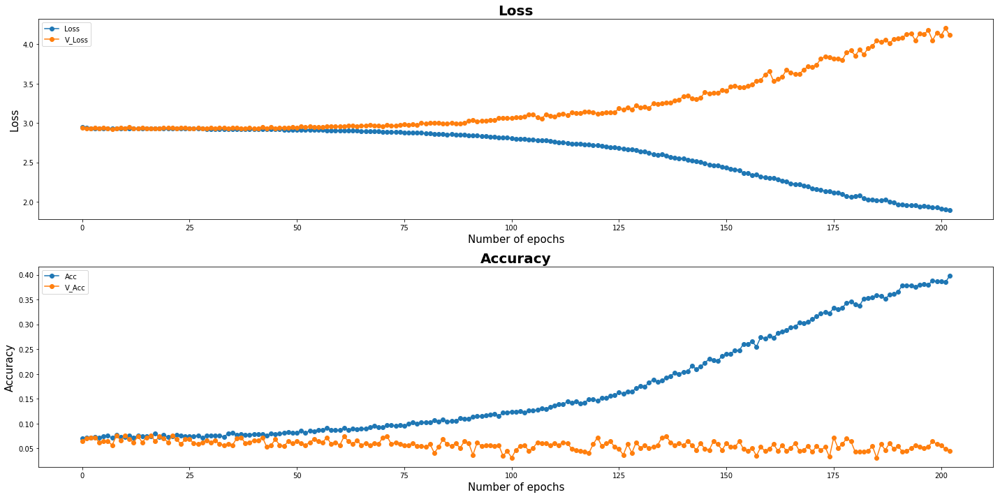

| Epoch [203] | Step [16250] | lr [0.009800] | Loss: [1.7533] | Acc: [0.3984] | Time: 0.0s
| Epoch [203] | Step [16300] | lr [0.009800] | Loss: [2.0236] | Acc: [0.3125] | Time: 0.0s
| Epoch [203] | Validation | Step [0] |  Loss: [4.0187] | Acc: [0.0703] | Time: 0.0s
| Epoch [203] | Validation | Step [1] |  Loss: [4.2358] | Acc: [0.0547] | Time: 0.0s
| Epoch [203] | Validation | Step [2] |  Loss: [4.1688] | Acc: [0.0312] | Time: 0.0s
| Epoch [203] | Validation | Step [3] |  Loss: [4.2587] | Acc: [0.0703] | Time: 0.0s


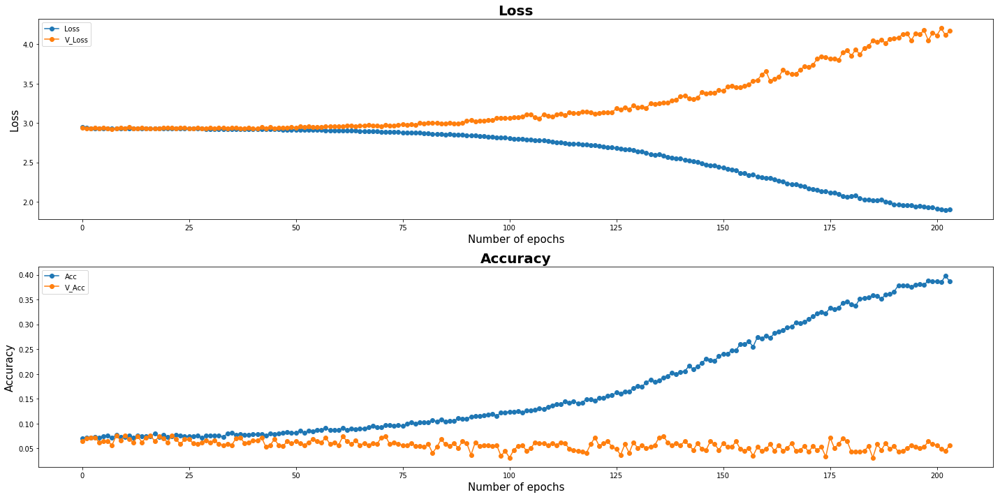

| Epoch [204] | Step [16350] | lr [0.009800] | Loss: [1.8356] | Acc: [0.3984] | Time: 0.0s
| Epoch [204] | Step [16400] | lr [0.009800] | Loss: [1.9753] | Acc: [0.3203] | Time: 0.0s
| Epoch [204] | Validation | Step [0] |  Loss: [4.3090] | Acc: [0.0547] | Time: 0.0s
| Epoch [204] | Validation | Step [1] |  Loss: [4.2224] | Acc: [0.0469] | Time: 0.0s
| Epoch [204] | Validation | Step [2] |  Loss: [4.2314] | Acc: [0.0625] | Time: 0.0s
| Epoch [204] | Validation | Step [3] |  Loss: [4.3687] | Acc: [0.0156] | Time: 0.0s


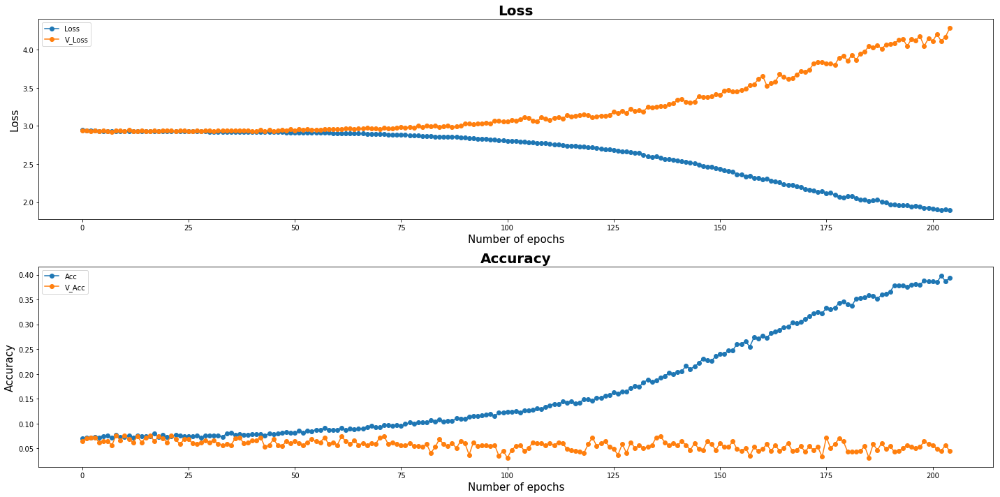

| Epoch [205] | Step [16450] | lr [0.009800] | Loss: [2.0528] | Acc: [0.3281] | Time: 0.0s
| Epoch [205] | Validation | Step [0] |  Loss: [4.1061] | Acc: [0.0312] | Time: 0.0s
| Epoch [205] | Validation | Step [1] |  Loss: [3.9743] | Acc: [0.0859] | Time: 0.0s
| Epoch [205] | Validation | Step [2] |  Loss: [4.0531] | Acc: [0.0625] | Time: 0.0s
| Epoch [205] | Validation | Step [3] |  Loss: [4.2944] | Acc: [0.0312] | Time: 0.0s


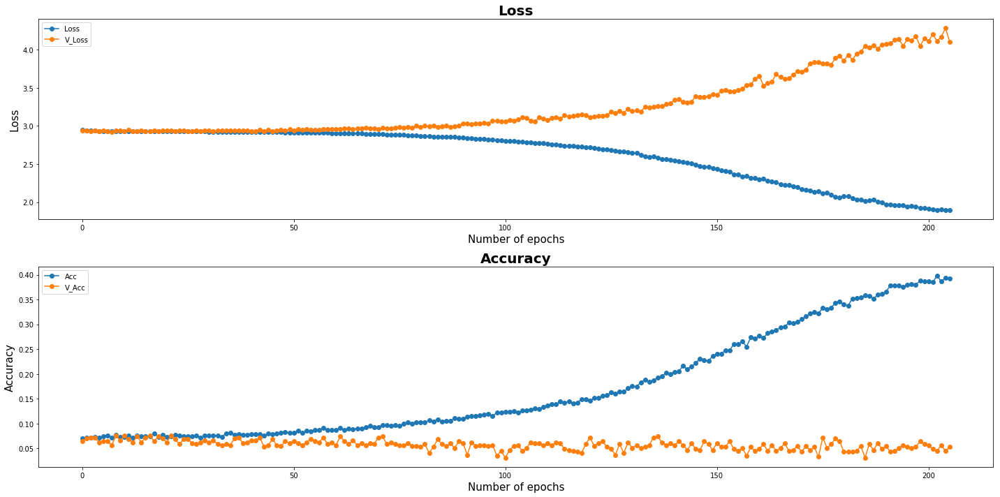

| Epoch [206] | Step [16500] | lr [0.009800] | Loss: [1.8075] | Acc: [0.4375] | Time: 0.0s
| Epoch [206] | Step [16550] | lr [0.009800] | Loss: [2.0872] | Acc: [0.2891] | Time: 0.0s
| Epoch [206] | Validation | Step [0] |  Loss: [3.8710] | Acc: [0.0781] | Time: 0.0s
| Epoch [206] | Validation | Step [1] |  Loss: [4.1547] | Acc: [0.0391] | Time: 0.0s
| Epoch [206] | Validation | Step [2] |  Loss: [4.3828] | Acc: [0.0547] | Time: 0.0s
| Epoch [206] | Validation | Step [3] |  Loss: [4.2891] | Acc: [0.0312] | Time: 0.0s


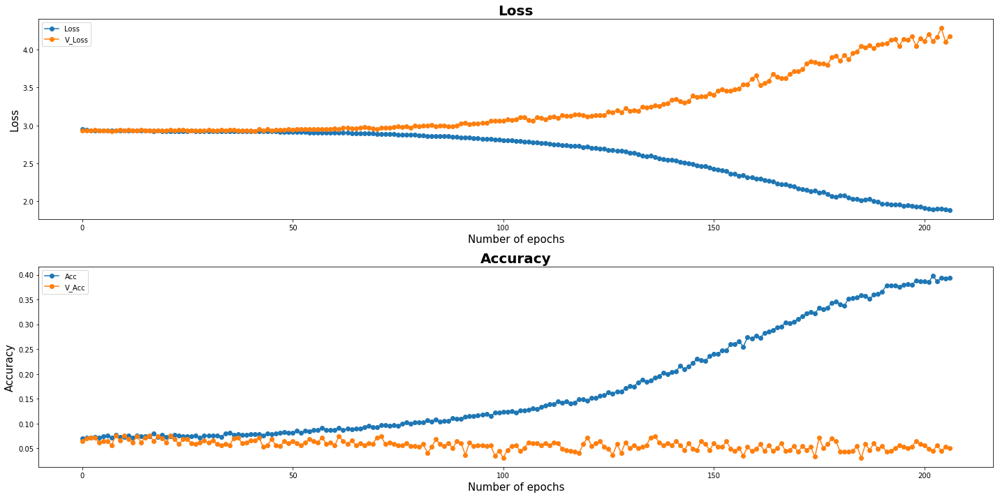

| Epoch [207] | Step [16600] | lr [0.009800] | Loss: [1.8540] | Acc: [0.3828] | Time: 0.0s
| Epoch [207] | Validation | Step [0] |  Loss: [4.0432] | Acc: [0.0625] | Time: 0.0s
| Epoch [207] | Validation | Step [1] |  Loss: [4.3482] | Acc: [0.0469] | Time: 0.0s
| Epoch [207] | Validation | Step [2] |  Loss: [4.2186] | Acc: [0.0625] | Time: 0.0s
| Epoch [207] | Validation | Step [3] |  Loss: [4.1952] | Acc: [0.0547] | Time: 0.0s


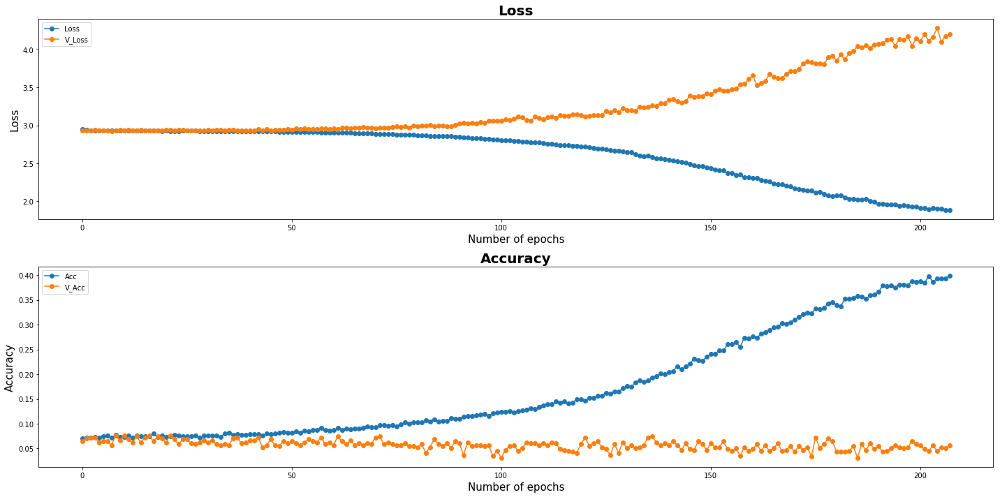

| Epoch [208] | Step [16650] | lr [0.009800] | Loss: [1.7295] | Acc: [0.4609] | Time: 0.0s
| Epoch [208] | Step [16700] | lr [0.009800] | Loss: [1.8632] | Acc: [0.4219] | Time: 0.0s
| Epoch [208] | Validation | Step [0] |  Loss: [3.9417] | Acc: [0.1016] | Time: 0.0s
| Epoch [208] | Validation | Step [1] |  Loss: [4.1529] | Acc: [0.0234] | Time: 0.0s
| Epoch [208] | Validation | Step [2] |  Loss: [4.2583] | Acc: [0.0469] | Time: 0.0s
| Epoch [208] | Validation | Step [3] |  Loss: [4.0791] | Acc: [0.0781] | Time: 0.0s


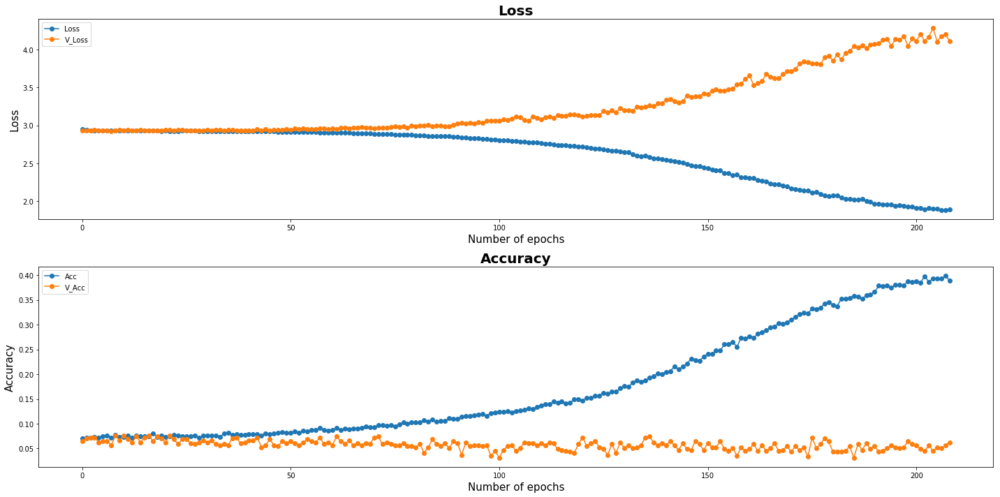

| Epoch [209] | Step [16750] | lr [0.009800] | Loss: [1.7630] | Acc: [0.4219] | Time: 0.0s
| Epoch [209] | Step [16800] | lr [0.009800] | Loss: [1.8909] | Acc: [0.4062] | Time: 0.0s
| Epoch [209] | Validation | Step [0] |  Loss: [4.1150] | Acc: [0.0469] | Time: 0.0s
| Epoch [209] | Validation | Step [1] |  Loss: [4.2222] | Acc: [0.0547] | Time: 0.0s
| Epoch [209] | Validation | Step [2] |  Loss: [4.1314] | Acc: [0.0703] | Time: 0.0s
| Epoch [209] | Validation | Step [3] |  Loss: [3.9777] | Acc: [0.0391] | Time: 0.0s


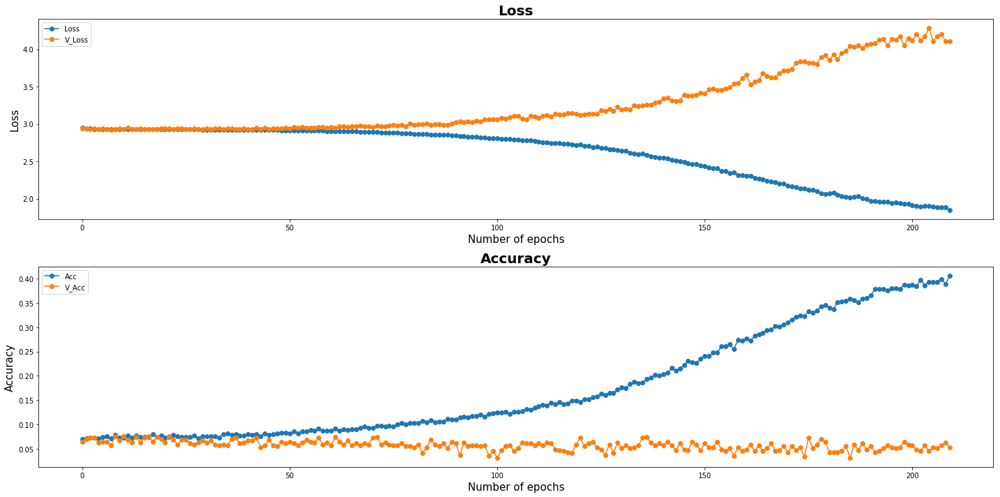

Model Saved
| Epoch [210] | Step [16850] | lr [0.009800] | Loss: [1.7822] | Acc: [0.4141] | Time: 0.0s
| Epoch [210] | Validation | Step [0] |  Loss: [4.0442] | Acc: [0.0703] | Time: 0.0s
| Epoch [210] | Validation | Step [1] |  Loss: [4.1100] | Acc: [0.0391] | Time: 0.0s
| Epoch [210] | Validation | Step [2] |  Loss: [4.2491] | Acc: [0.0703] | Time: 0.0s
| Epoch [210] | Validation | Step [3] |  Loss: [4.1638] | Acc: [0.0547] | Time: 0.0s


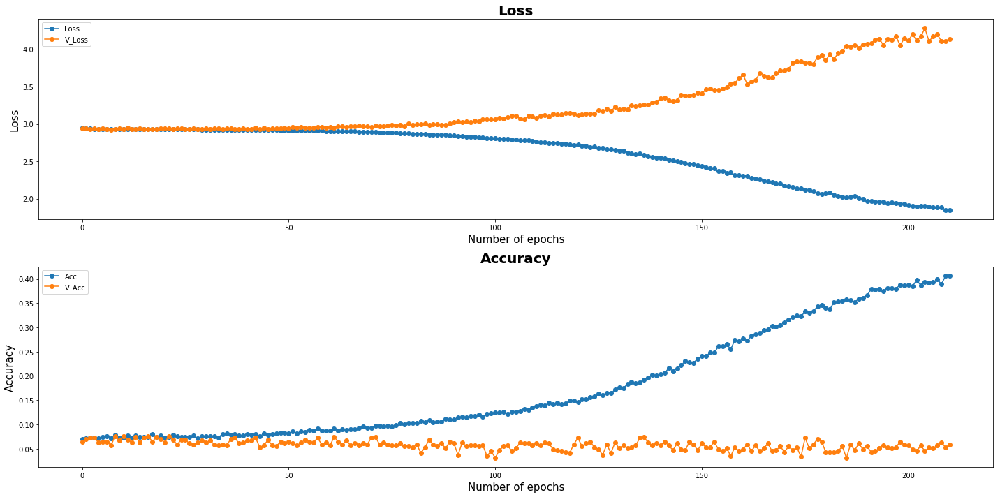

| Epoch [211] | Step [16900] | lr [0.009800] | Loss: [1.7307] | Acc: [0.4375] | Time: 0.0s
| Epoch [211] | Step [16950] | lr [0.009800] | Loss: [2.0241] | Acc: [0.3359] | Time: 0.0s
| Epoch [211] | Validation | Step [0] |  Loss: [4.1585] | Acc: [0.0547] | Time: 0.0s
| Epoch [211] | Validation | Step [1] |  Loss: [4.3349] | Acc: [0.0391] | Time: 0.0s
| Epoch [211] | Validation | Step [2] |  Loss: [4.1602] | Acc: [0.0547] | Time: 0.0s
| Epoch [211] | Validation | Step [3] |  Loss: [4.1335] | Acc: [0.1016] | Time: 0.0s


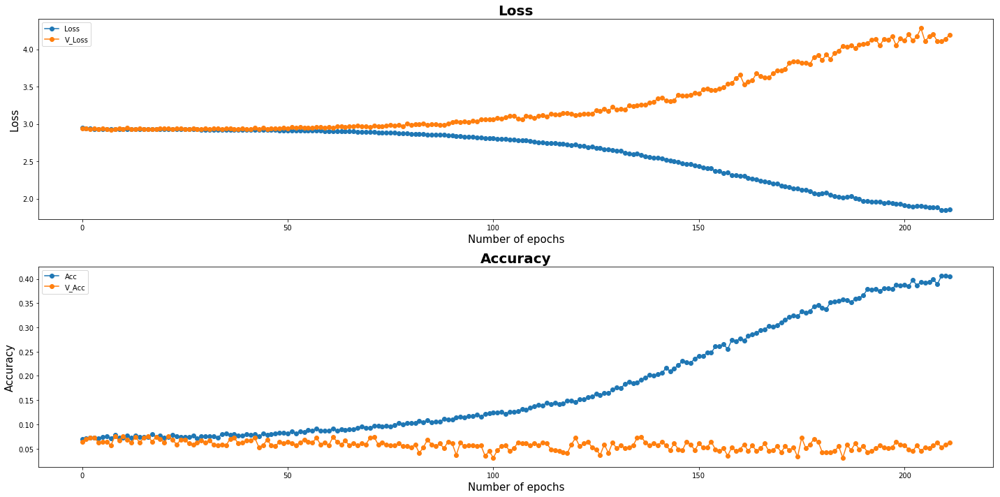

| Epoch [212] | Step [17000] | lr [0.009800] | Loss: [1.9311] | Acc: [0.4297] | Time: 0.0s
| Epoch [212] | Validation | Step [0] |  Loss: [4.2437] | Acc: [0.0469] | Time: 0.0s
| Epoch [212] | Validation | Step [1] |  Loss: [4.2787] | Acc: [0.0234] | Time: 0.0s
| Epoch [212] | Validation | Step [2] |  Loss: [4.1247] | Acc: [0.0859] | Time: 0.0s
| Epoch [212] | Validation | Step [3] |  Loss: [4.3578] | Acc: [0.0312] | Time: 0.0s


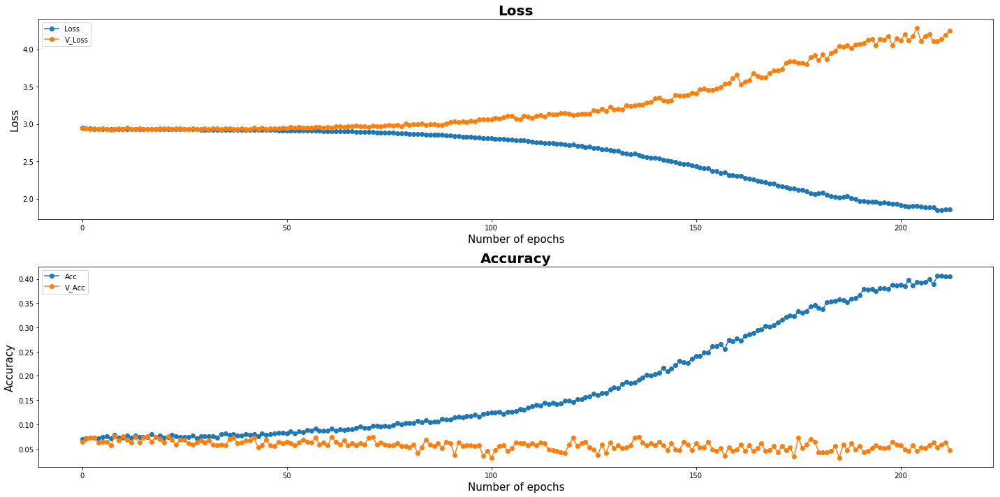

| Epoch [213] | Step [17050] | lr [0.009800] | Loss: [1.7818] | Acc: [0.4531] | Time: 0.0s
| Epoch [213] | Step [17100] | lr [0.009800] | Loss: [1.9532] | Acc: [0.2812] | Time: 0.0s
| Epoch [213] | Validation | Step [0] |  Loss: [4.2343] | Acc: [0.0469] | Time: 0.0s
| Epoch [213] | Validation | Step [1] |  Loss: [4.3142] | Acc: [0.0703] | Time: 0.0s
| Epoch [213] | Validation | Step [2] |  Loss: [4.1356] | Acc: [0.0469] | Time: 0.0s
| Epoch [213] | Validation | Step [3] |  Loss: [4.1702] | Acc: [0.0859] | Time: 0.0s


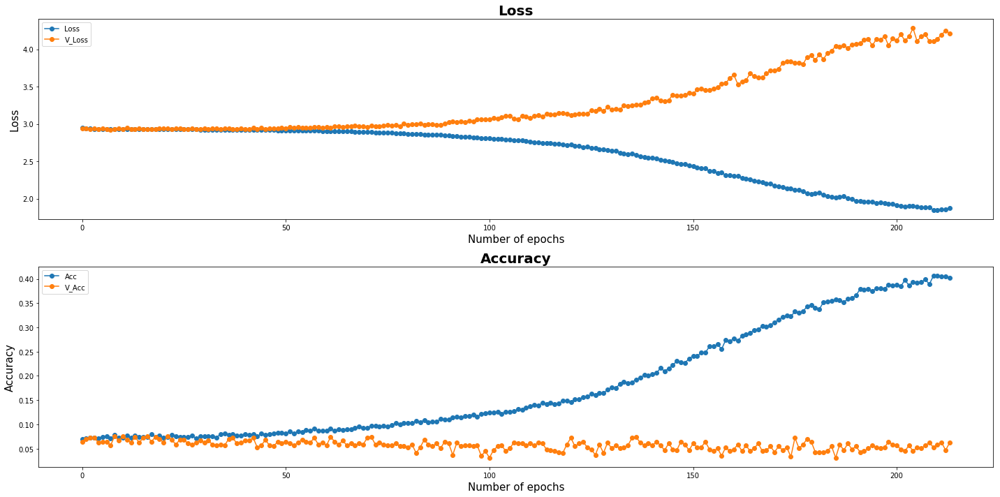

| Epoch [214] | Step [17150] | lr [0.009800] | Loss: [1.7629] | Acc: [0.4297] | Time: 0.0s
| Epoch [214] | Step [17200] | lr [0.009800] | Loss: [2.0339] | Acc: [0.3281] | Time: 0.0s
| Epoch [214] | Validation | Step [0] |  Loss: [3.8573] | Acc: [0.1094] | Time: 0.0s
| Epoch [214] | Validation | Step [1] |  Loss: [4.2328] | Acc: [0.0547] | Time: 0.0s
| Epoch [214] | Validation | Step [2] |  Loss: [4.1702] | Acc: [0.0469] | Time: 0.0s
| Epoch [214] | Validation | Step [3] |  Loss: [4.2270] | Acc: [0.0312] | Time: 0.0s


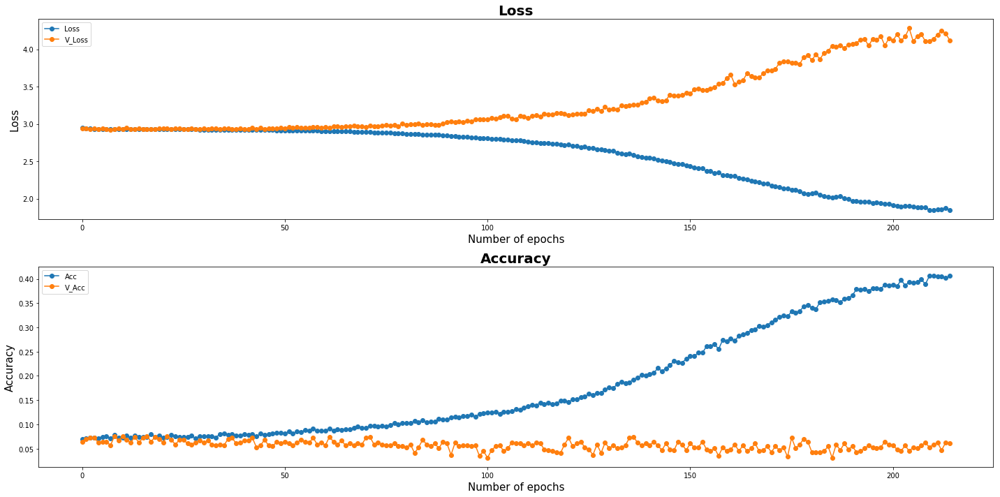

| Epoch [215] | Step [17250] | lr [0.009800] | Loss: [1.7906] | Acc: [0.3750] | Time: 0.0s
| Epoch [215] | Validation | Step [0] |  Loss: [4.1370] | Acc: [0.0547] | Time: 0.0s
| Epoch [215] | Validation | Step [1] |  Loss: [4.1961] | Acc: [0.0234] | Time: 0.0s
| Epoch [215] | Validation | Step [2] |  Loss: [4.3304] | Acc: [0.0625] | Time: 0.0s
| Epoch [215] | Validation | Step [3] |  Loss: [4.1519] | Acc: [0.0469] | Time: 0.0s


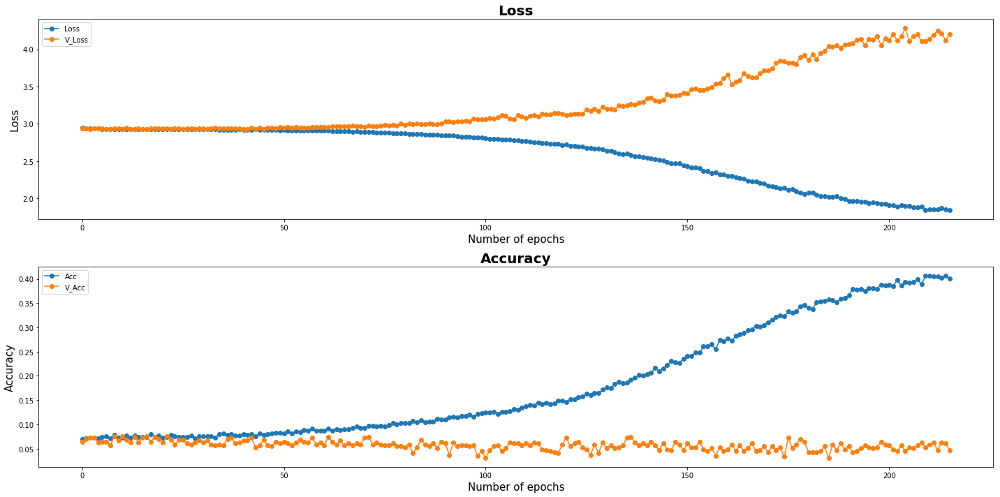

| Epoch [216] | Step [17300] | lr [0.009800] | Loss: [1.7426] | Acc: [0.4219] | Time: 0.0s
| Epoch [216] | Step [17350] | lr [0.009800] | Loss: [2.0251] | Acc: [0.3594] | Time: 0.0s
| Epoch [216] | Validation | Step [0] |  Loss: [4.0993] | Acc: [0.0547] | Time: 0.0s
| Epoch [216] | Validation | Step [1] |  Loss: [4.2703] | Acc: [0.0938] | Time: 0.0s
| Epoch [216] | Validation | Step [2] |  Loss: [4.4420] | Acc: [0.0234] | Time: 0.0s
| Epoch [216] | Validation | Step [3] |  Loss: [4.1186] | Acc: [0.0547] | Time: 0.0s


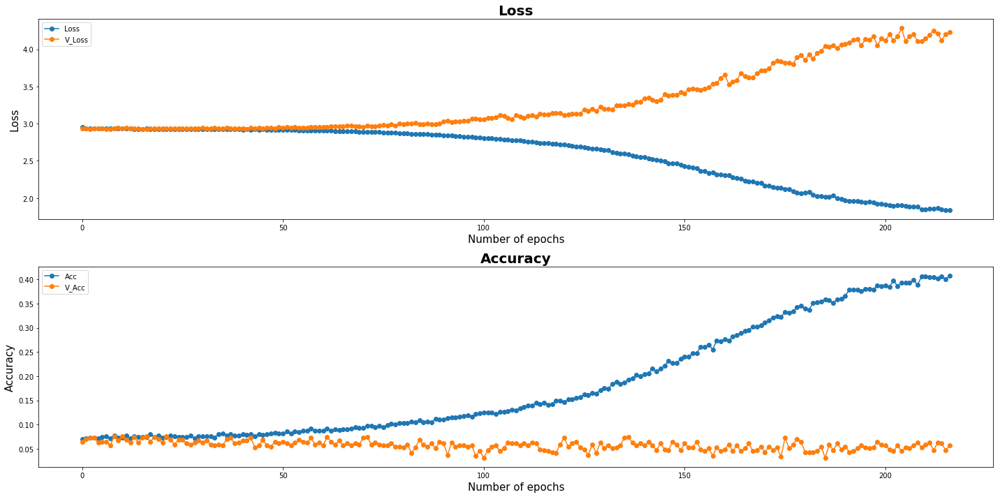

| Epoch [217] | Step [17400] | lr [0.009800] | Loss: [1.7650] | Acc: [0.3828] | Time: 0.0s
| Epoch [217] | Validation | Step [0] |  Loss: [4.2955] | Acc: [0.0547] | Time: 0.0s
| Epoch [217] | Validation | Step [1] |  Loss: [4.1086] | Acc: [0.0469] | Time: 0.0s
| Epoch [217] | Validation | Step [2] |  Loss: [4.2220] | Acc: [0.0703] | Time: 0.0s
| Epoch [217] | Validation | Step [3] |  Loss: [4.1167] | Acc: [0.0391] | Time: 0.0s


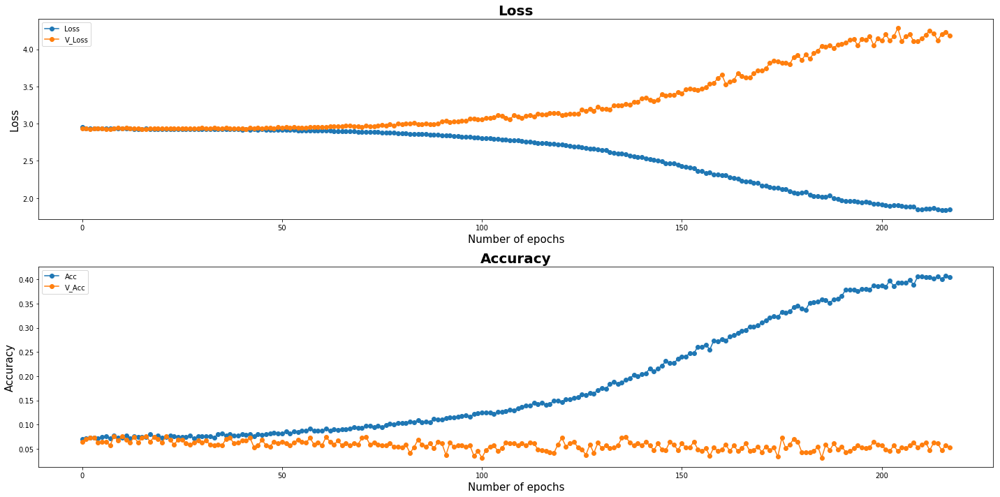

| Epoch [218] | Step [17450] | lr [0.009800] | Loss: [1.7475] | Acc: [0.4219] | Time: 0.0s
| Epoch [218] | Step [17500] | lr [0.009800] | Loss: [1.8712] | Acc: [0.3516] | Time: 0.0s
| Epoch [218] | Validation | Step [0] |  Loss: [4.2314] | Acc: [0.0547] | Time: 0.0s
| Epoch [218] | Validation | Step [1] |  Loss: [4.0844] | Acc: [0.0391] | Time: 0.0s
| Epoch [218] | Validation | Step [2] |  Loss: [4.2710] | Acc: [0.0391] | Time: 0.0s
| Epoch [218] | Validation | Step [3] |  Loss: [4.2098] | Acc: [0.0469] | Time: 0.0s


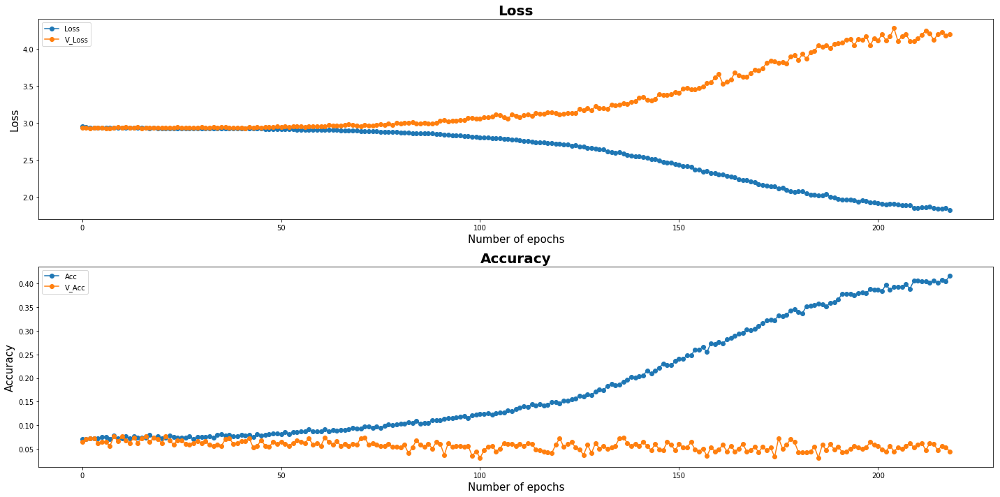

| Epoch [219] | Step [17550] | lr [0.009800] | Loss: [1.8379] | Acc: [0.4141] | Time: 0.0s
| Epoch [219] | Step [17600] | lr [0.009800] | Loss: [2.0208] | Acc: [0.3750] | Time: 0.0s
| Epoch [219] | Validation | Step [0] |  Loss: [4.4016] | Acc: [0.0938] | Time: 0.0s
| Epoch [219] | Validation | Step [1] |  Loss: [4.3211] | Acc: [0.0391] | Time: 0.0s
| Epoch [219] | Validation | Step [2] |  Loss: [4.3255] | Acc: [0.0547] | Time: 0.0s
| Epoch [219] | Validation | Step [3] |  Loss: [4.3982] | Acc: [0.0391] | Time: 0.0s


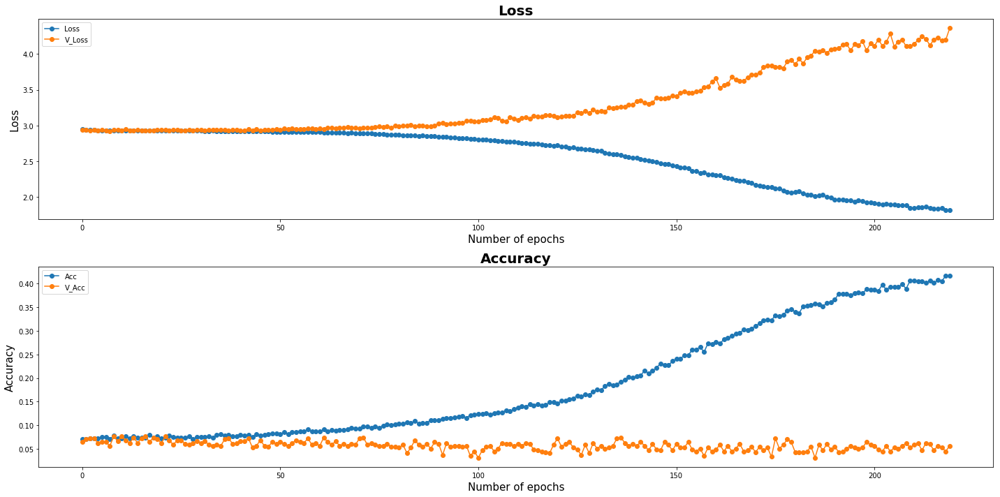

Model Saved
| Epoch [220] | Step [17650] | lr [0.009800] | Loss: [1.9019] | Acc: [0.3750] | Time: 0.0s
| Epoch [220] | Validation | Step [0] |  Loss: [4.2379] | Acc: [0.0391] | Time: 0.0s
| Epoch [220] | Validation | Step [1] |  Loss: [4.0640] | Acc: [0.0547] | Time: 0.0s
| Epoch [220] | Validation | Step [2] |  Loss: [4.2362] | Acc: [0.0625] | Time: 0.0s
| Epoch [220] | Validation | Step [3] |  Loss: [4.6347] | Acc: [0.0391] | Time: 0.0s


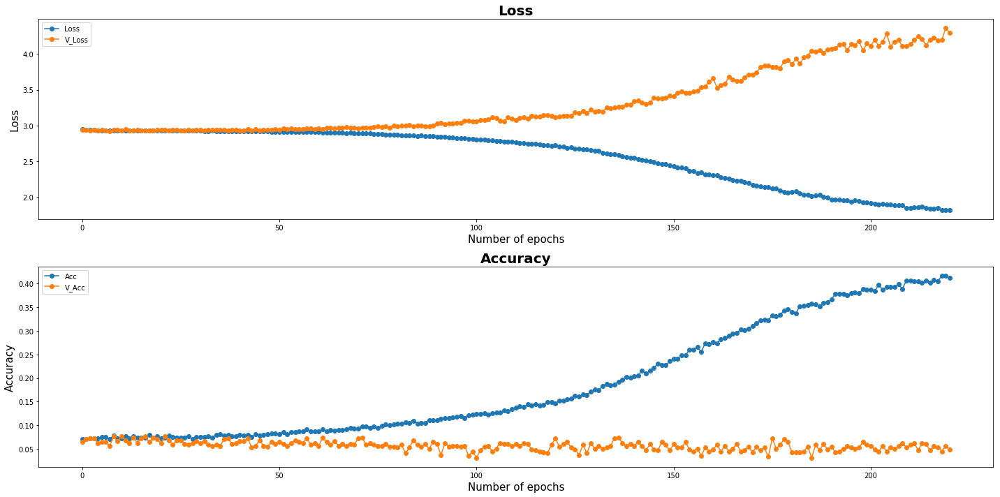

| Epoch [221] | Step [17700] | lr [0.009800] | Loss: [1.8045] | Acc: [0.3672] | Time: 0.0s
| Epoch [221] | Step [17750] | lr [0.009800] | Loss: [2.0337] | Acc: [0.3672] | Time: 0.0s
| Epoch [221] | Validation | Step [0] |  Loss: [4.2964] | Acc: [0.0469] | Time: 0.0s
| Epoch [221] | Validation | Step [1] |  Loss: [4.2845] | Acc: [0.0391] | Time: 0.0s
| Epoch [221] | Validation | Step [2] |  Loss: [4.2592] | Acc: [0.0547] | Time: 0.0s
| Epoch [221] | Validation | Step [3] |  Loss: [4.2654] | Acc: [0.0625] | Time: 0.0s


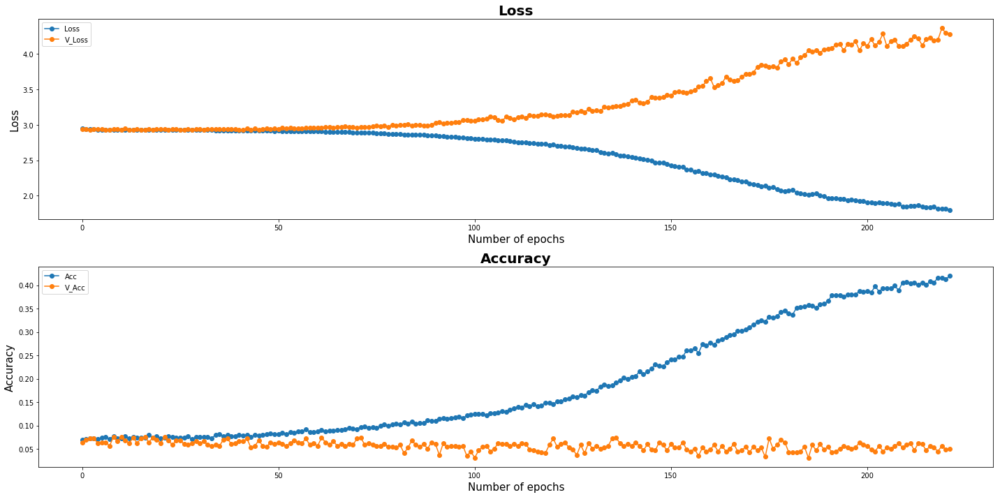

| Epoch [222] | Step [17800] | lr [0.009800] | Loss: [1.9805] | Acc: [0.3516] | Time: 0.0s
| Epoch [222] | Validation | Step [0] |  Loss: [4.3812] | Acc: [0.0234] | Time: 0.0s
| Epoch [222] | Validation | Step [1] |  Loss: [4.3375] | Acc: [0.0703] | Time: 0.0s
| Epoch [222] | Validation | Step [2] |  Loss: [4.1266] | Acc: [0.0703] | Time: 0.0s
| Epoch [222] | Validation | Step [3] |  Loss: [4.3894] | Acc: [0.0391] | Time: 0.0s


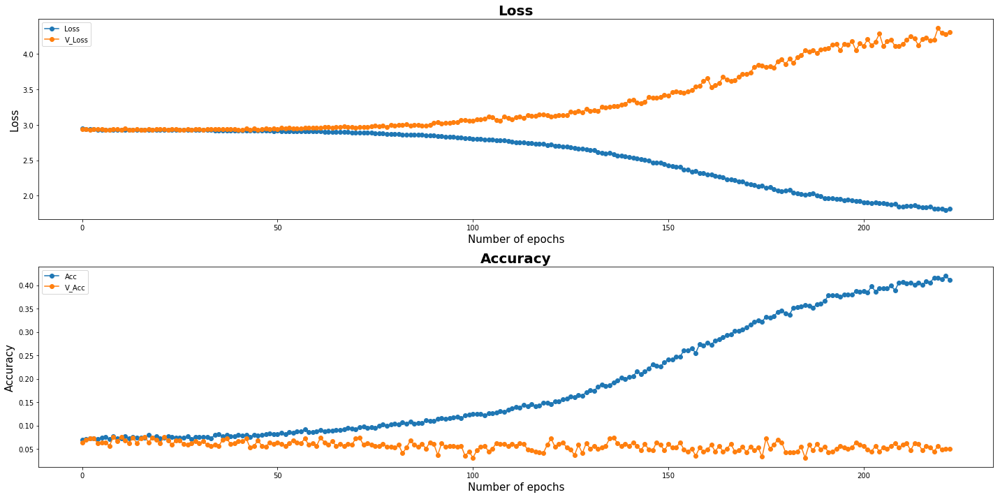

| Epoch [223] | Step [17850] | lr [0.009800] | Loss: [1.6182] | Acc: [0.4375] | Time: 0.0s
| Epoch [223] | Step [17900] | lr [0.009800] | Loss: [1.8430] | Acc: [0.4219] | Time: 0.0s
| Epoch [223] | Validation | Step [0] |  Loss: [4.6557] | Acc: [0.0312] | Time: 0.0s
| Epoch [223] | Validation | Step [1] |  Loss: [4.3335] | Acc: [0.0625] | Time: 0.0s
| Epoch [223] | Validation | Step [2] |  Loss: [4.2994] | Acc: [0.0547] | Time: 0.0s
| Epoch [223] | Validation | Step [3] |  Loss: [4.3785] | Acc: [0.0469] | Time: 0.0s


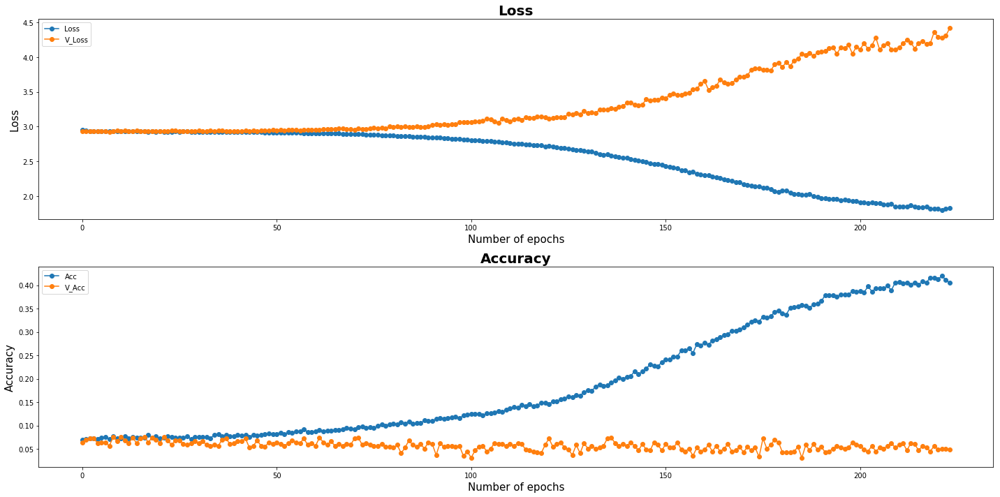

| Epoch [224] | Step [17950] | lr [0.009800] | Loss: [1.7822] | Acc: [0.4688] | Time: 0.0s
| Epoch [224] | Step [18000] | lr [0.009800] | Loss: [1.7805] | Acc: [0.4141] | Time: 0.0s
| Epoch [224] | Validation | Step [0] |  Loss: [4.3494] | Acc: [0.0547] | Time: 0.0s
| Epoch [224] | Validation | Step [1] |  Loss: [4.4921] | Acc: [0.0312] | Time: 0.0s
| Epoch [224] | Validation | Step [2] |  Loss: [4.4210] | Acc: [0.0469] | Time: 0.0s
| Epoch [224] | Validation | Step [3] |  Loss: [4.1546] | Acc: [0.0781] | Time: 0.0s


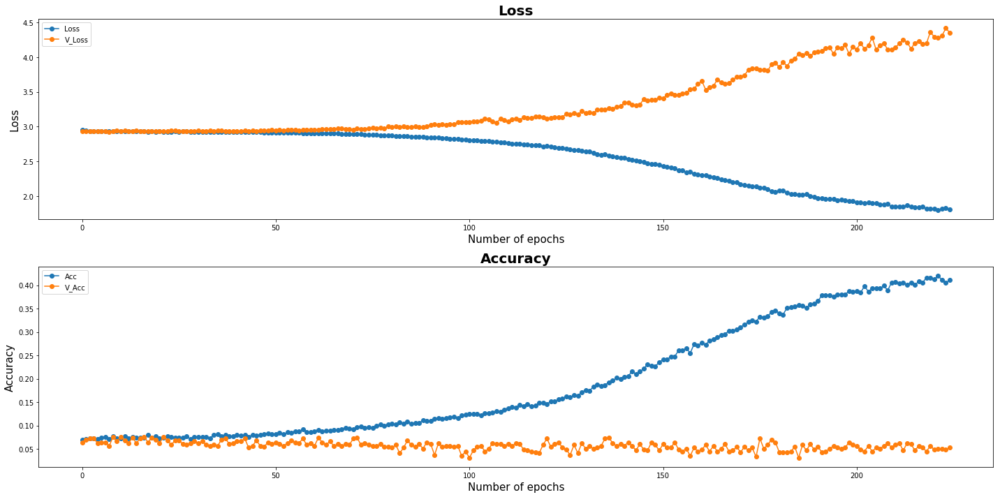

| Epoch [225] | Step [18050] | lr [0.009800] | Loss: [1.8027] | Acc: [0.4609] | Time: 0.0s
| Epoch [225] | Validation | Step [0] |  Loss: [4.3322] | Acc: [0.0391] | Time: 0.0s
| Epoch [225] | Validation | Step [1] |  Loss: [4.4738] | Acc: [0.0391] | Time: 0.0s
| Epoch [225] | Validation | Step [2] |  Loss: [4.4360] | Acc: [0.0469] | Time: 0.0s
| Epoch [225] | Validation | Step [3] |  Loss: [4.0642] | Acc: [0.0938] | Time: 0.0s


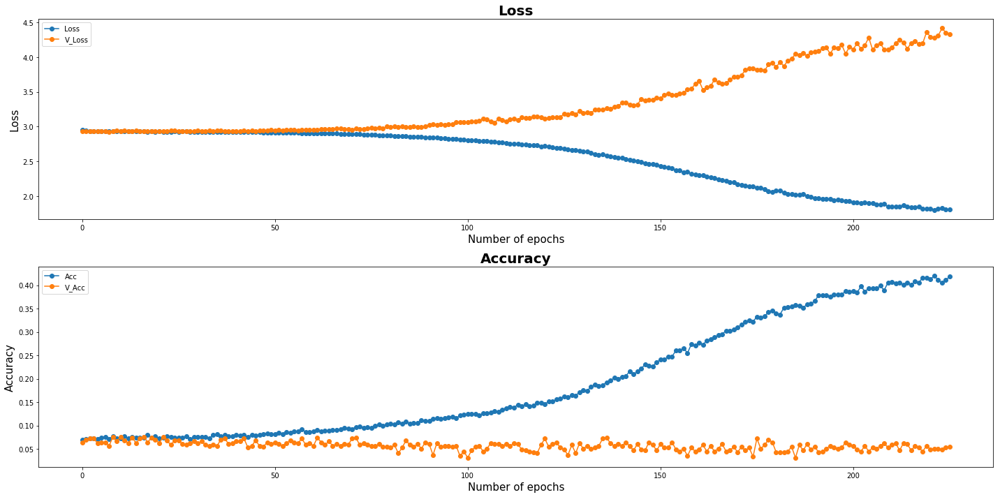

| Epoch [226] | Step [18100] | lr [0.009800] | Loss: [1.5621] | Acc: [0.5391] | Time: 0.0s
| Epoch [226] | Step [18150] | lr [0.009800] | Loss: [2.0521] | Acc: [0.3594] | Time: 0.0s
| Epoch [226] | Validation | Step [0] |  Loss: [4.3257] | Acc: [0.0859] | Time: 0.0s
| Epoch [226] | Validation | Step [1] |  Loss: [4.4163] | Acc: [0.0312] | Time: 0.0s
| Epoch [226] | Validation | Step [2] |  Loss: [4.3629] | Acc: [0.0547] | Time: 0.0s
| Epoch [226] | Validation | Step [3] |  Loss: [4.2145] | Acc: [0.0547] | Time: 0.0s


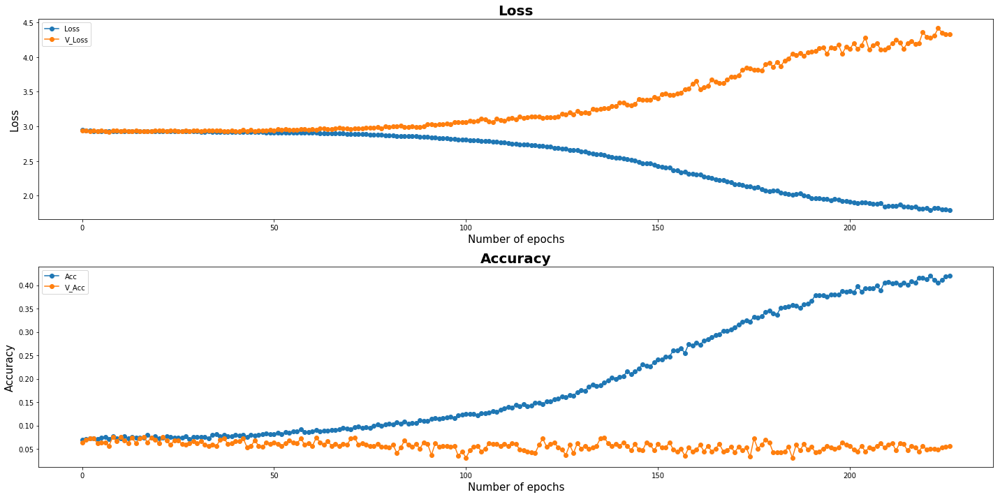

| Epoch [227] | Step [18200] | lr [0.009800] | Loss: [1.8670] | Acc: [0.3906] | Time: 0.0s
| Epoch [227] | Validation | Step [0] |  Loss: [4.0929] | Acc: [0.0938] | Time: 0.0s
| Epoch [227] | Validation | Step [1] |  Loss: [4.3822] | Acc: [0.0312] | Time: 0.0s
| Epoch [227] | Validation | Step [2] |  Loss: [4.7013] | Acc: [0.0469] | Time: 0.0s
| Epoch [227] | Validation | Step [3] |  Loss: [4.1638] | Acc: [0.0547] | Time: 0.0s


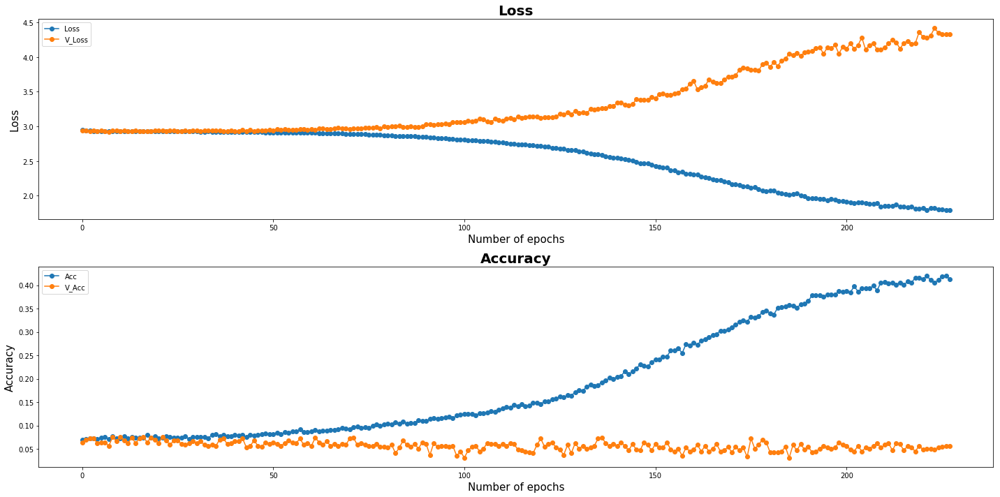

| Epoch [228] | Step [18250] | lr [0.009800] | Loss: [1.7724] | Acc: [0.4609] | Time: 0.0s
| Epoch [228] | Step [18300] | lr [0.009800] | Loss: [1.8515] | Acc: [0.3828] | Time: 0.0s
| Epoch [228] | Validation | Step [0] |  Loss: [4.1361] | Acc: [0.0625] | Time: 0.0s
| Epoch [228] | Validation | Step [1] |  Loss: [4.5757] | Acc: [0.0469] | Time: 0.0s
| Epoch [228] | Validation | Step [2] |  Loss: [4.3444] | Acc: [0.0938] | Time: 0.0s
| Epoch [228] | Validation | Step [3] |  Loss: [4.5102] | Acc: [0.0391] | Time: 0.0s


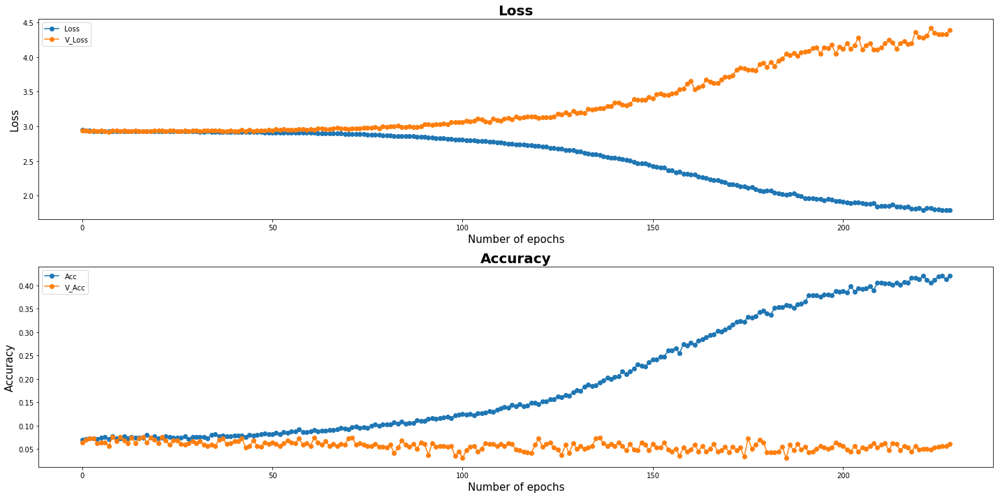

| Epoch [229] | Step [18350] | lr [0.009800] | Loss: [1.4697] | Acc: [0.5469] | Time: 0.0s
| Epoch [229] | Step [18400] | lr [0.009800] | Loss: [1.9186] | Acc: [0.4141] | Time: 0.0s
| Epoch [229] | Validation | Step [0] |  Loss: [4.2444] | Acc: [0.0234] | Time: 0.0s
| Epoch [229] | Validation | Step [1] |  Loss: [4.6966] | Acc: [0.0391] | Time: 0.0s
| Epoch [229] | Validation | Step [2] |  Loss: [4.2313] | Acc: [0.0469] | Time: 0.0s
| Epoch [229] | Validation | Step [3] |  Loss: [4.4113] | Acc: [0.0703] | Time: 0.0s


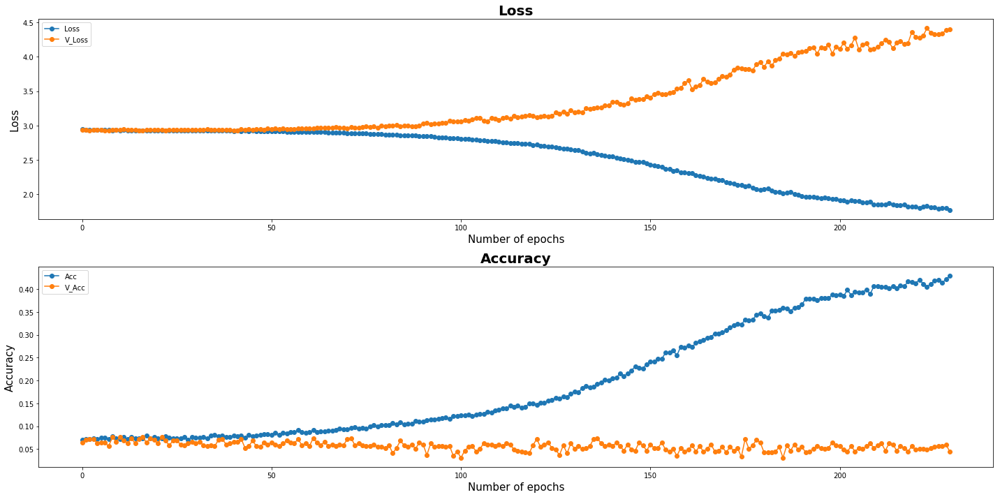

Model Saved
| Epoch [230] | Step [18450] | lr [0.009800] | Loss: [1.9083] | Acc: [0.3672] | Time: 0.0s
| Epoch [230] | Validation | Step [0] |  Loss: [4.3706] | Acc: [0.0312] | Time: 0.0s
| Epoch [230] | Validation | Step [1] |  Loss: [4.3250] | Acc: [0.0547] | Time: 0.0s
| Epoch [230] | Validation | Step [2] |  Loss: [4.5029] | Acc: [0.0312] | Time: 0.0s
| Epoch [230] | Validation | Step [3] |  Loss: [4.4471] | Acc: [0.0391] | Time: 0.0s


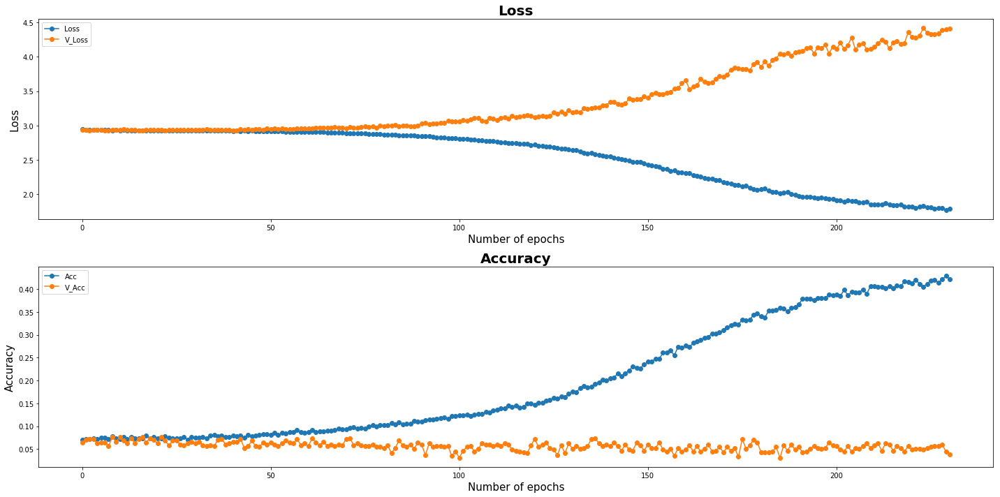

| Epoch [231] | Step [18500] | lr [0.009800] | Loss: [1.7576] | Acc: [0.4375] | Time: 0.0s
| Epoch [231] | Step [18550] | lr [0.009800] | Loss: [1.8529] | Acc: [0.3516] | Time: 0.0s
| Epoch [231] | Validation | Step [0] |  Loss: [4.6100] | Acc: [0.0703] | Time: 0.0s
| Epoch [231] | Validation | Step [1] |  Loss: [4.2326] | Acc: [0.1016] | Time: 0.0s
| Epoch [231] | Validation | Step [2] |  Loss: [4.1958] | Acc: [0.0625] | Time: 0.0s
| Epoch [231] | Validation | Step [3] |  Loss: [4.3290] | Acc: [0.0547] | Time: 0.0s


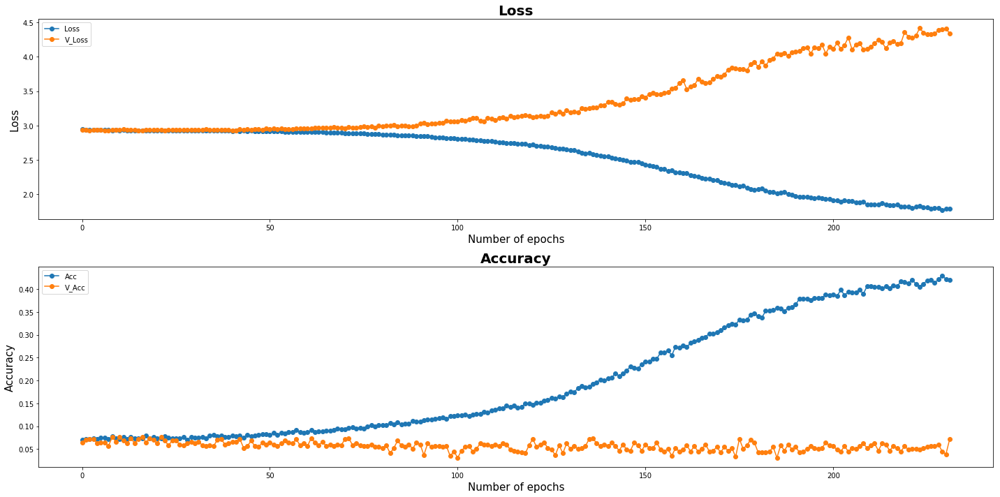

| Epoch [232] | Step [18600] | lr [0.009800] | Loss: [1.7712] | Acc: [0.4531] | Time: 0.0s
| Epoch [232] | Validation | Step [0] |  Loss: [4.7207] | Acc: [0.0469] | Time: 0.0s
| Epoch [232] | Validation | Step [1] |  Loss: [4.5850] | Acc: [0.0391] | Time: 0.0s
| Epoch [232] | Validation | Step [2] |  Loss: [4.1006] | Acc: [0.0859] | Time: 0.0s
| Epoch [232] | Validation | Step [3] |  Loss: [4.3126] | Acc: [0.0859] | Time: 0.0s


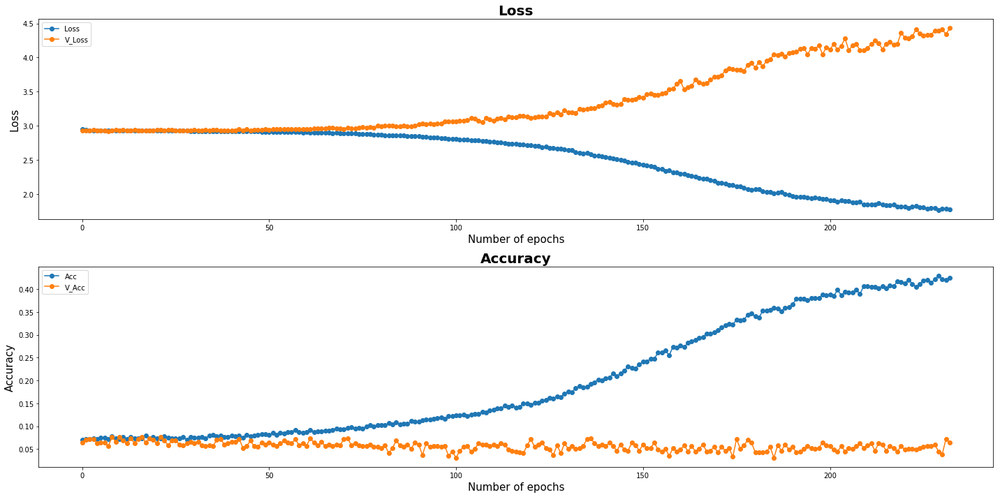

| Epoch [233] | Step [18650] | lr [0.009800] | Loss: [1.8077] | Acc: [0.4375] | Time: 0.0s
| Epoch [233] | Step [18700] | lr [0.009800] | Loss: [1.8437] | Acc: [0.4297] | Time: 0.0s
| Epoch [233] | Validation | Step [0] |  Loss: [4.2839] | Acc: [0.0625] | Time: 0.0s
| Epoch [233] | Validation | Step [1] |  Loss: [4.1488] | Acc: [0.0703] | Time: 0.0s
| Epoch [233] | Validation | Step [2] |  Loss: [4.6731] | Acc: [0.0391] | Time: 0.0s
| Epoch [233] | Validation | Step [3] |  Loss: [4.4815] | Acc: [0.0391] | Time: 0.0s


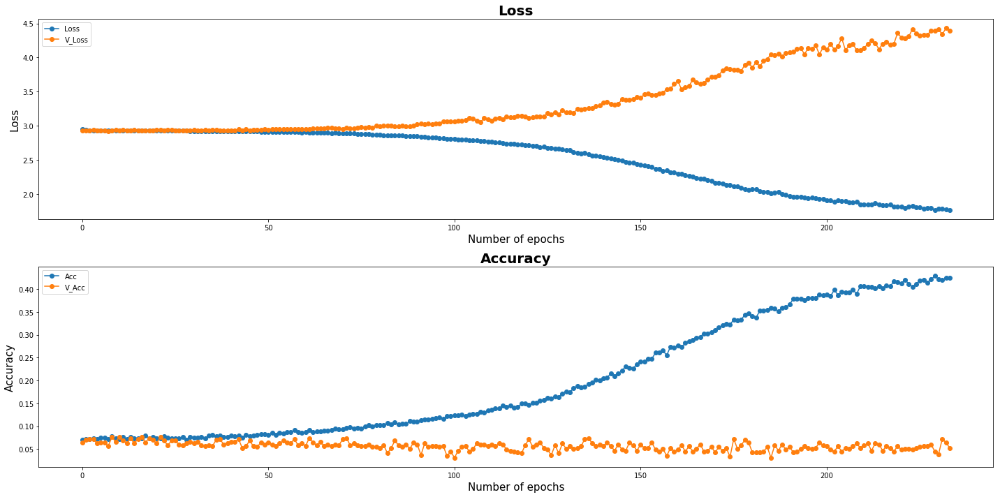

| Epoch [234] | Step [18750] | lr [0.009800] | Loss: [1.9975] | Acc: [0.3438] | Time: 0.0s
| Epoch [234] | Step [18800] | lr [0.009800] | Loss: [1.9699] | Acc: [0.3438] | Time: 0.0s
| Epoch [234] | Validation | Step [0] |  Loss: [4.4264] | Acc: [0.0547] | Time: 0.0s
| Epoch [234] | Validation | Step [1] |  Loss: [4.5588] | Acc: [0.0547] | Time: 0.0s
| Epoch [234] | Validation | Step [2] |  Loss: [4.3695] | Acc: [0.1016] | Time: 0.0s
| Epoch [234] | Validation | Step [3] |  Loss: [4.3293] | Acc: [0.0625] | Time: 0.0s


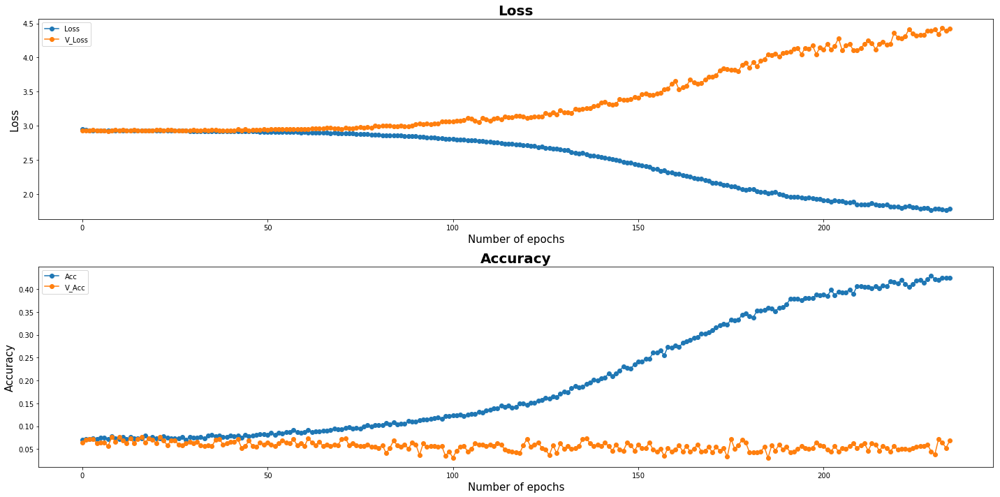

| Epoch [235] | Step [18850] | lr [0.009800] | Loss: [1.6789] | Acc: [0.4688] | Time: 0.0s
| Epoch [235] | Validation | Step [0] |  Loss: [4.5132] | Acc: [0.0938] | Time: 0.0s
| Epoch [235] | Validation | Step [1] |  Loss: [4.4707] | Acc: [0.0625] | Time: 0.0s
| Epoch [235] | Validation | Step [2] |  Loss: [4.3599] | Acc: [0.0625] | Time: 0.0s
| Epoch [235] | Validation | Step [3] |  Loss: [4.4101] | Acc: [0.0469] | Time: 0.0s


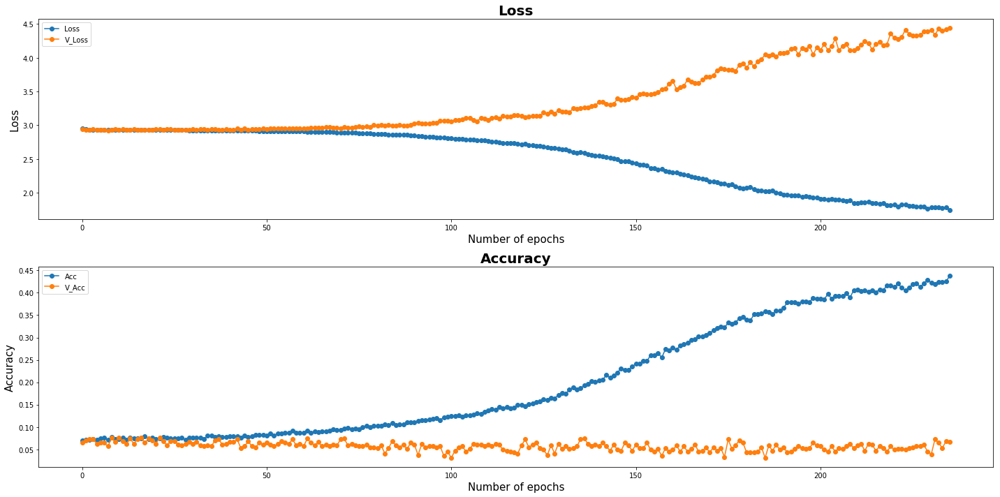

| Epoch [236] | Step [18900] | lr [0.009800] | Loss: [1.5880] | Acc: [0.4688] | Time: 0.0s
| Epoch [236] | Step [18950] | lr [0.009800] | Loss: [2.0915] | Acc: [0.3438] | Time: 0.0s
| Epoch [236] | Validation | Step [0] |  Loss: [4.6407] | Acc: [0.0625] | Time: 0.0s
| Epoch [236] | Validation | Step [1] |  Loss: [3.9545] | Acc: [0.0625] | Time: 0.0s
| Epoch [236] | Validation | Step [2] |  Loss: [4.6401] | Acc: [0.0312] | Time: 0.0s
| Epoch [236] | Validation | Step [3] |  Loss: [4.5137] | Acc: [0.0312] | Time: 0.0s


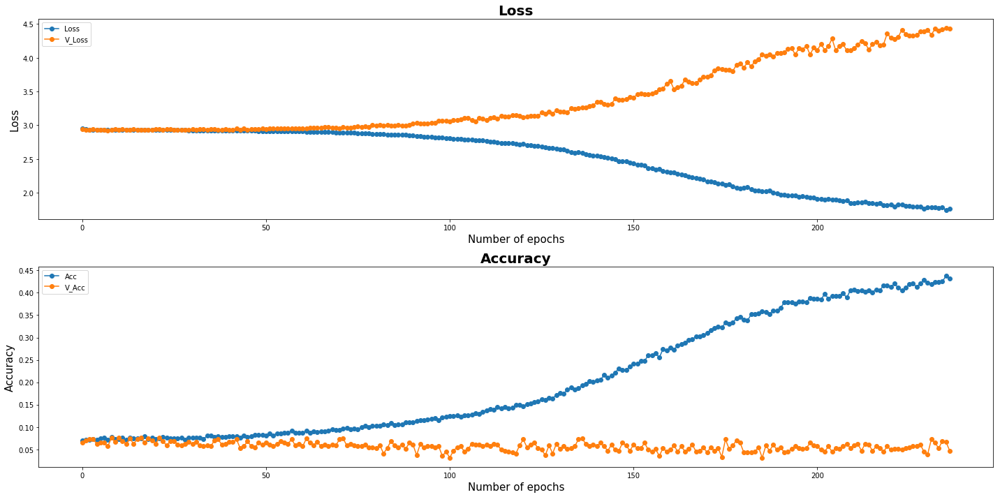

| Epoch [237] | Step [19000] | lr [0.009800] | Loss: [1.7717] | Acc: [0.4609] | Time: 0.0s
| Epoch [237] | Validation | Step [0] |  Loss: [4.4138] | Acc: [0.0547] | Time: 0.0s
| Epoch [237] | Validation | Step [1] |  Loss: [4.4092] | Acc: [0.0781] | Time: 0.0s
| Epoch [237] | Validation | Step [2] |  Loss: [4.5444] | Acc: [0.0547] | Time: 0.0s
| Epoch [237] | Validation | Step [3] |  Loss: [4.3094] | Acc: [0.0781] | Time: 0.0s


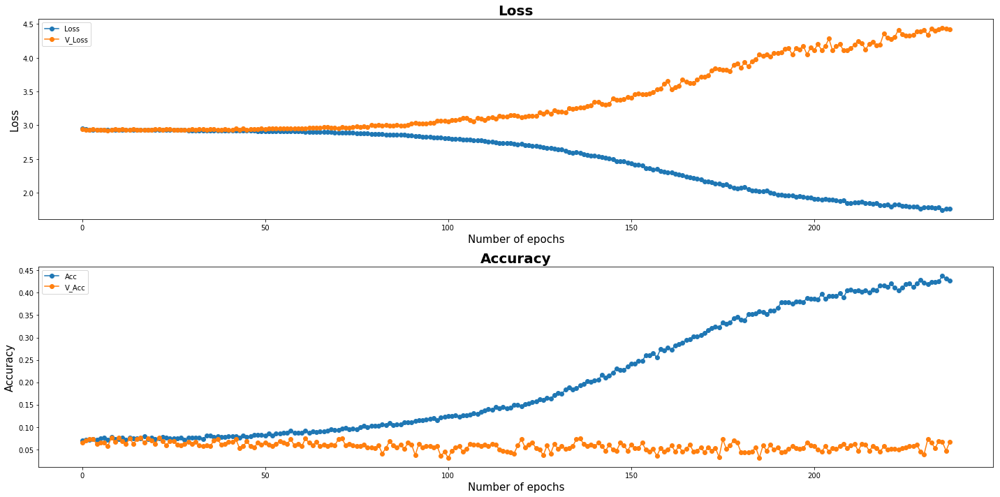

| Epoch [238] | Step [19050] | lr [0.009800] | Loss: [1.4696] | Acc: [0.5156] | Time: 0.0s
| Epoch [238] | Step [19100] | lr [0.009800] | Loss: [1.8294] | Acc: [0.3984] | Time: 0.0s
| Epoch [238] | Validation | Step [0] |  Loss: [4.4869] | Acc: [0.0547] | Time: 0.0s
| Epoch [238] | Validation | Step [1] |  Loss: [4.3804] | Acc: [0.0391] | Time: 0.0s
| Epoch [238] | Validation | Step [2] |  Loss: [4.3759] | Acc: [0.0625] | Time: 0.0s
| Epoch [238] | Validation | Step [3] |  Loss: [4.3524] | Acc: [0.0391] | Time: 0.0s


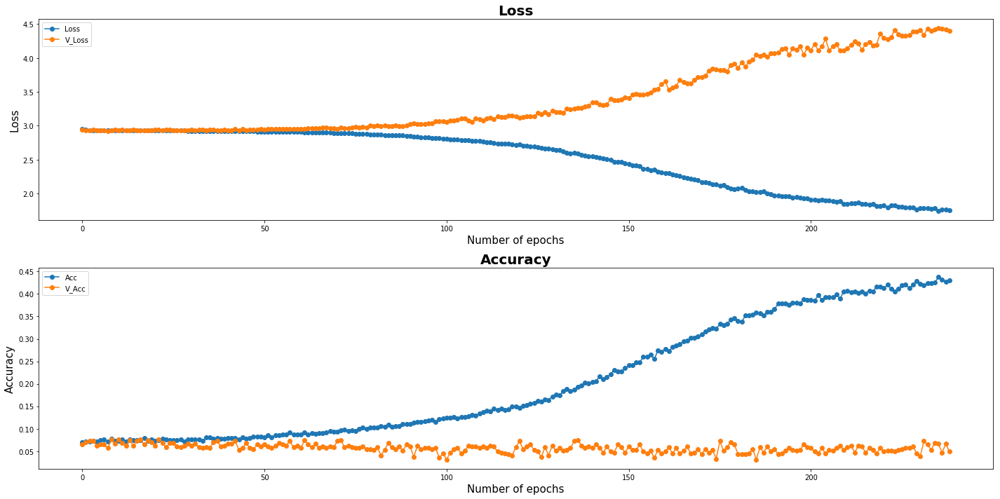

| Epoch [239] | Step [19150] | lr [0.009800] | Loss: [1.7309] | Acc: [0.4375] | Time: 0.0s
| Epoch [239] | Step [19200] | lr [0.009800] | Loss: [1.9637] | Acc: [0.3672] | Time: 0.0s
| Epoch [239] | Validation | Step [0] |  Loss: [4.6564] | Acc: [0.0703] | Time: 0.0s
| Epoch [239] | Validation | Step [1] |  Loss: [4.4020] | Acc: [0.0859] | Time: 0.0s
| Epoch [239] | Validation | Step [2] |  Loss: [4.3191] | Acc: [0.0391] | Time: 0.0s
| Epoch [239] | Validation | Step [3] |  Loss: [4.2986] | Acc: [0.0469] | Time: 0.0s


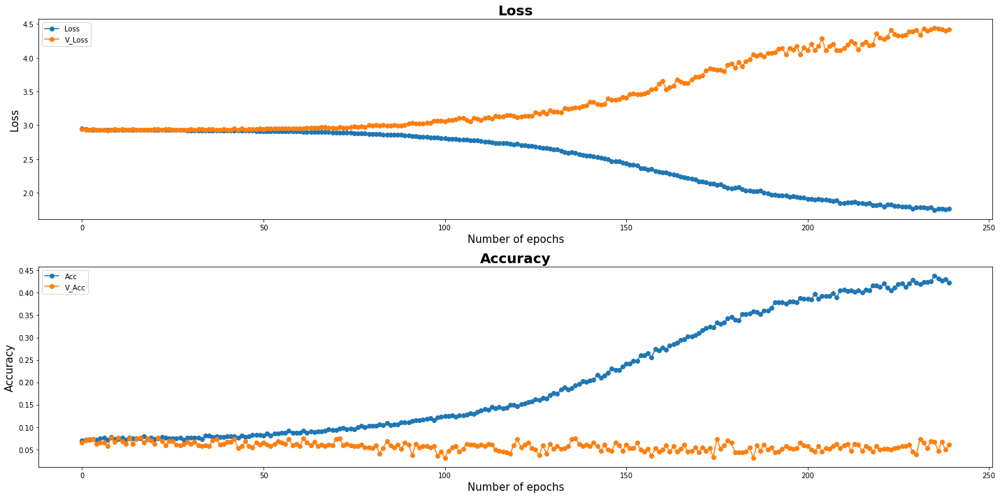

Model Saved
| Epoch [240] | Step [19250] | lr [0.009800] | Loss: [1.8156] | Acc: [0.4219] | Time: 0.0s
| Epoch [240] | Validation | Step [0] |  Loss: [4.4393] | Acc: [0.0781] | Time: 0.0s
| Epoch [240] | Validation | Step [1] |  Loss: [3.9341] | Acc: [0.0625] | Time: 0.0s
| Epoch [240] | Validation | Step [2] |  Loss: [4.8135] | Acc: [0.0469] | Time: 0.0s
| Epoch [240] | Validation | Step [3] |  Loss: [4.4835] | Acc: [0.0859] | Time: 0.0s


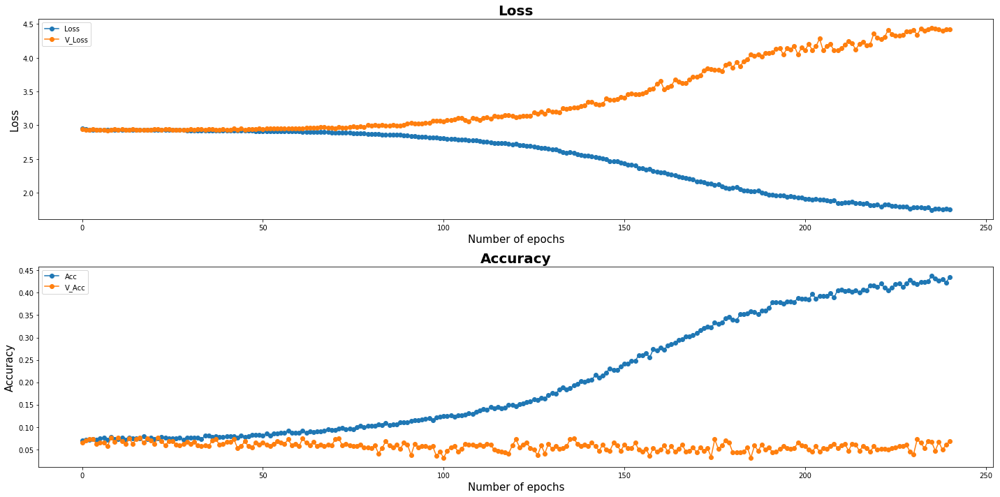

| Epoch [241] | Step [19300] | lr [0.009800] | Loss: [1.7698] | Acc: [0.4219] | Time: 0.0s
| Epoch [241] | Step [19350] | lr [0.009800] | Loss: [1.7234] | Acc: [0.4141] | Time: 0.0s
| Epoch [241] | Validation | Step [0] |  Loss: [4.6188] | Acc: [0.0391] | Time: 0.0s
| Epoch [241] | Validation | Step [1] |  Loss: [4.3597] | Acc: [0.0469] | Time: 0.0s
| Epoch [241] | Validation | Step [2] |  Loss: [4.6166] | Acc: [0.0469] | Time: 0.0s
| Epoch [241] | Validation | Step [3] |  Loss: [4.3721] | Acc: [0.0703] | Time: 0.0s


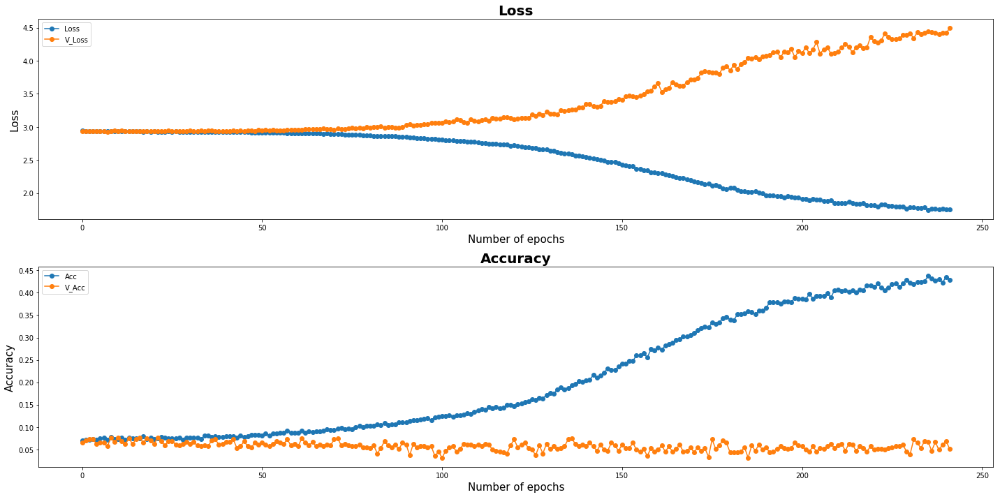

| Epoch [242] | Step [19400] | lr [0.009800] | Loss: [1.7405] | Acc: [0.4609] | Time: 0.0s
| Epoch [242] | Validation | Step [0] |  Loss: [4.6134] | Acc: [0.0703] | Time: 0.0s
| Epoch [242] | Validation | Step [1] |  Loss: [4.4487] | Acc: [0.0391] | Time: 0.0s
| Epoch [242] | Validation | Step [2] |  Loss: [4.5022] | Acc: [0.0156] | Time: 0.0s
| Epoch [242] | Validation | Step [3] |  Loss: [4.6552] | Acc: [0.0234] | Time: 0.0s


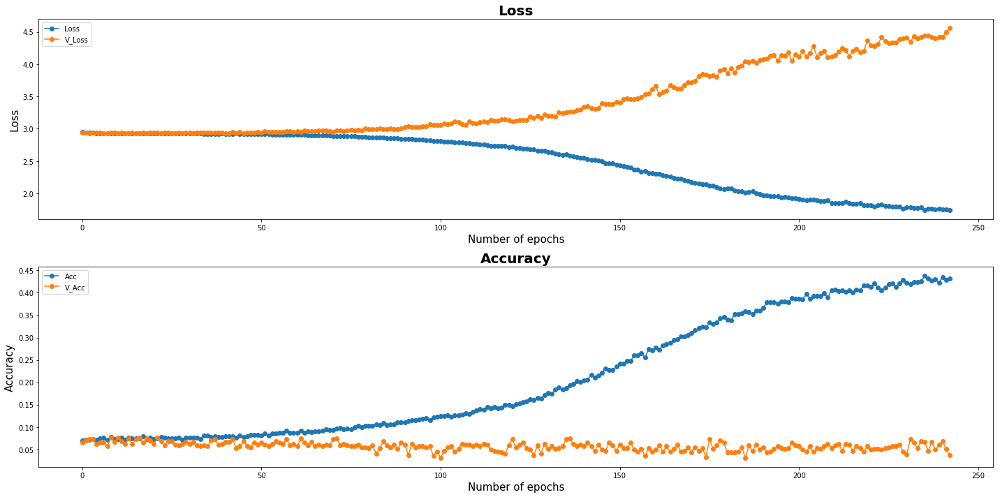

| Epoch [243] | Step [19450] | lr [0.009800] | Loss: [1.6326] | Acc: [0.4688] | Time: 0.0s
| Epoch [243] | Step [19500] | lr [0.009800] | Loss: [1.6806] | Acc: [0.4531] | Time: 0.0s
| Epoch [243] | Validation | Step [0] |  Loss: [4.4523] | Acc: [0.0312] | Time: 0.0s
| Epoch [243] | Validation | Step [1] |  Loss: [4.5525] | Acc: [0.0781] | Time: 0.0s
| Epoch [243] | Validation | Step [2] |  Loss: [4.4442] | Acc: [0.0391] | Time: 0.0s
| Epoch [243] | Validation | Step [3] |  Loss: [4.4134] | Acc: [0.0391] | Time: 0.0s


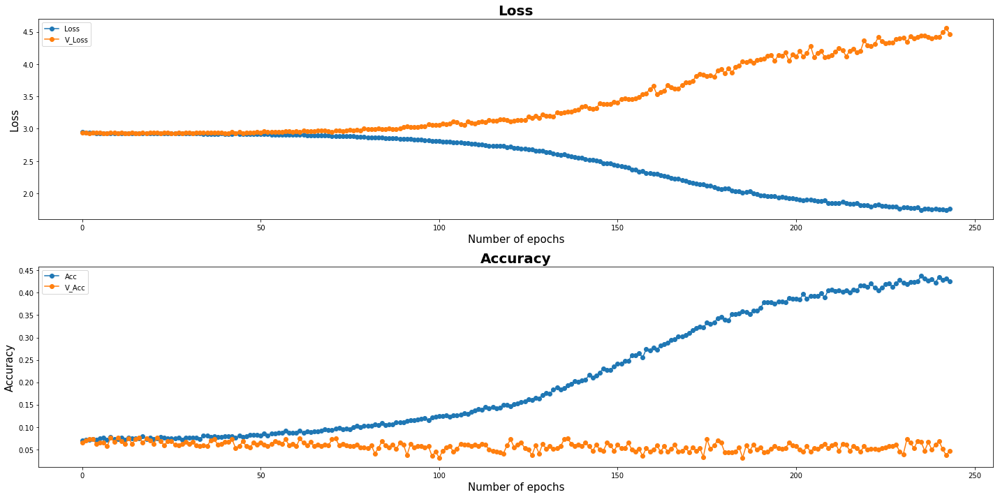

| Epoch [244] | Step [19550] | lr [0.009800] | Loss: [1.7428] | Acc: [0.4922] | Time: 0.0s
| Epoch [244] | Step [19600] | lr [0.009800] | Loss: [1.8850] | Acc: [0.4297] | Time: 0.0s
| Epoch [244] | Validation | Step [0] |  Loss: [4.5130] | Acc: [0.0469] | Time: 0.0s
| Epoch [244] | Validation | Step [1] |  Loss: [4.6002] | Acc: [0.0547] | Time: 0.0s
| Epoch [244] | Validation | Step [2] |  Loss: [4.3200] | Acc: [0.0703] | Time: 0.0s
| Epoch [244] | Validation | Step [3] |  Loss: [4.3249] | Acc: [0.0469] | Time: 0.0s


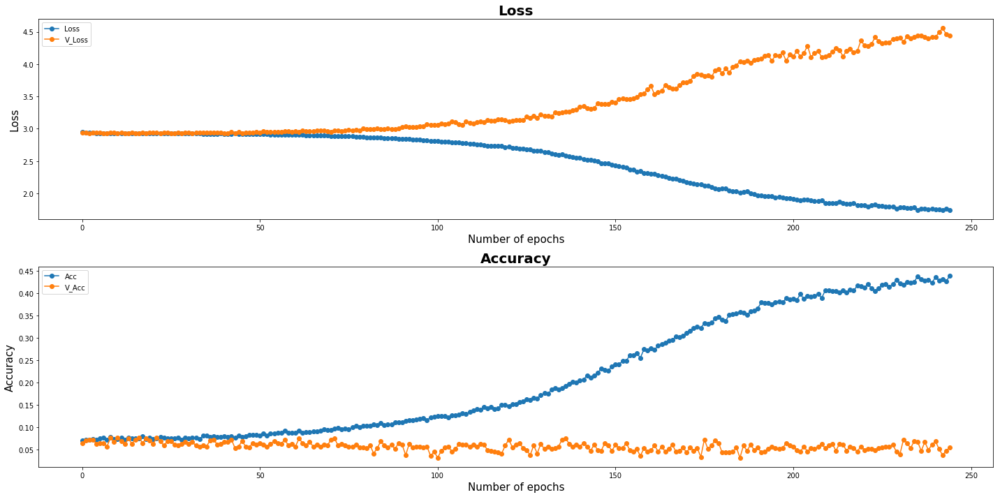

| Epoch [245] | Step [19650] | lr [0.009800] | Loss: [1.6407] | Acc: [0.4688] | Time: 0.0s
| Epoch [245] | Validation | Step [0] |  Loss: [4.5520] | Acc: [0.0312] | Time: 0.0s
| Epoch [245] | Validation | Step [1] |  Loss: [4.3035] | Acc: [0.0312] | Time: 0.0s
| Epoch [245] | Validation | Step [2] |  Loss: [4.4282] | Acc: [0.0469] | Time: 0.0s
| Epoch [245] | Validation | Step [3] |  Loss: [4.5048] | Acc: [0.0547] | Time: 0.0s


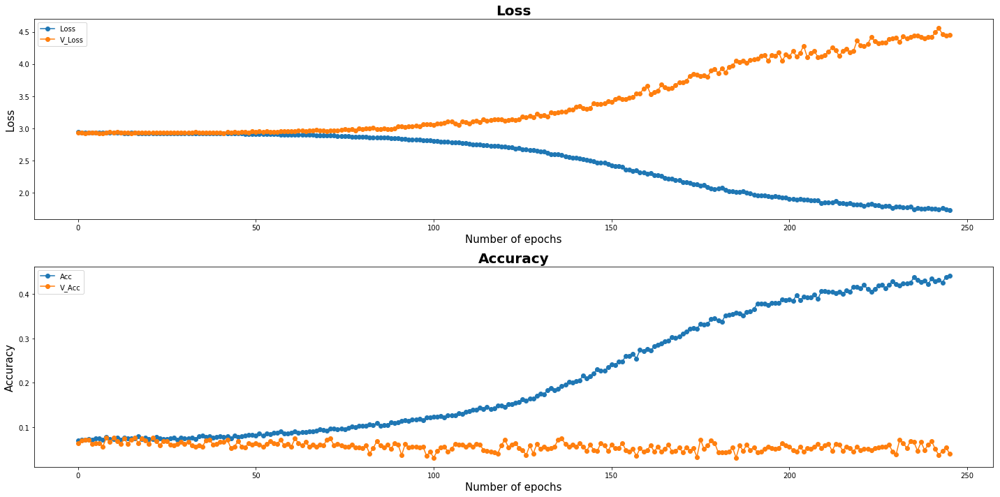

| Epoch [246] | Step [19700] | lr [0.009800] | Loss: [1.7858] | Acc: [0.4219] | Time: 0.0s
| Epoch [246] | Step [19750] | lr [0.009800] | Loss: [2.1058] | Acc: [0.3125] | Time: 0.0s
| Epoch [246] | Validation | Step [0] |  Loss: [4.6273] | Acc: [0.0391] | Time: 0.0s
| Epoch [246] | Validation | Step [1] |  Loss: [4.6323] | Acc: [0.0547] | Time: 0.0s
| Epoch [246] | Validation | Step [2] |  Loss: [4.4346] | Acc: [0.0625] | Time: 0.0s
| Epoch [246] | Validation | Step [3] |  Loss: [4.2333] | Acc: [0.0547] | Time: 0.0s


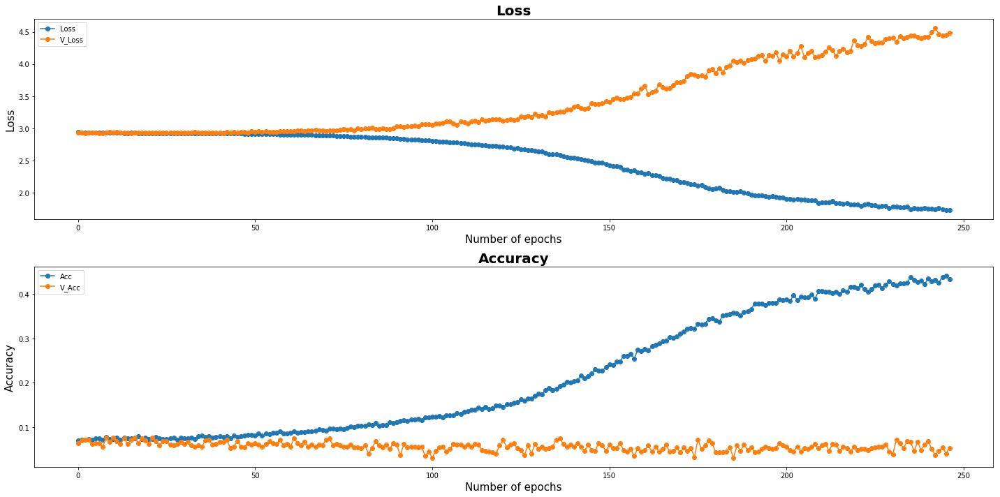

| Epoch [247] | Step [19800] | lr [0.009800] | Loss: [1.8552] | Acc: [0.3359] | Time: 0.0s
| Epoch [247] | Validation | Step [0] |  Loss: [4.7340] | Acc: [0.0312] | Time: 0.0s
| Epoch [247] | Validation | Step [1] |  Loss: [4.7270] | Acc: [0.0156] | Time: 0.0s
| Epoch [247] | Validation | Step [2] |  Loss: [4.3938] | Acc: [0.0781] | Time: 0.0s
| Epoch [247] | Validation | Step [3] |  Loss: [4.3897] | Acc: [0.0625] | Time: 0.0s


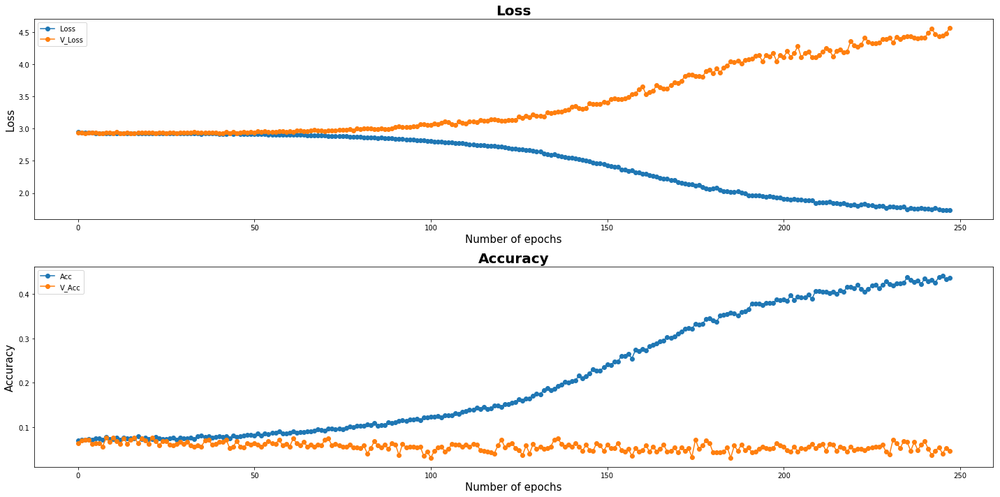

| Epoch [248] | Step [19850] | lr [0.009800] | Loss: [1.6609] | Acc: [0.4922] | Time: 0.0s
| Epoch [248] | Step [19900] | lr [0.009800] | Loss: [1.6818] | Acc: [0.4609] | Time: 0.0s
| Epoch [248] | Validation | Step [0] |  Loss: [4.2545] | Acc: [0.0234] | Time: 0.0s
| Epoch [248] | Validation | Step [1] |  Loss: [4.2536] | Acc: [0.0625] | Time: 0.0s
| Epoch [248] | Validation | Step [2] |  Loss: [4.5509] | Acc: [0.0078] | Time: 0.0s
| Epoch [248] | Validation | Step [3] |  Loss: [4.4856] | Acc: [0.0781] | Time: 0.0s


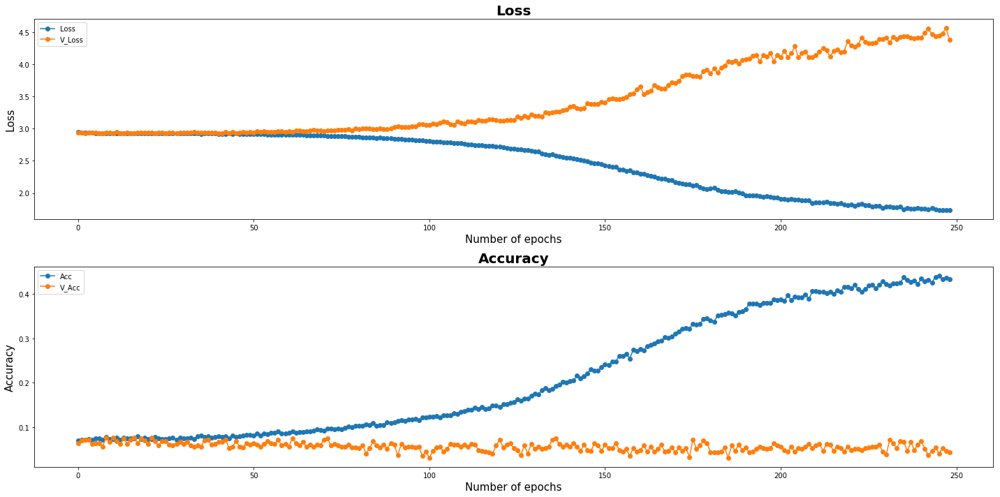

| Epoch [249] | Step [19950] | lr [0.009800] | Loss: [1.7364] | Acc: [0.4141] | Time: 0.0s
| Epoch [249] | Step [20000] | lr [0.009800] | Loss: [1.8913] | Acc: [0.3828] | Time: 0.0s
| Epoch [249] | Validation | Step [0] |  Loss: [4.5237] | Acc: [0.0625] | Time: 0.0s
| Epoch [249] | Validation | Step [1] |  Loss: [4.3845] | Acc: [0.0547] | Time: 0.0s
| Epoch [249] | Validation | Step [2] |  Loss: [4.5115] | Acc: [0.0625] | Time: 0.0s
| Epoch [249] | Validation | Step [3] |  Loss: [4.5564] | Acc: [0.0469] | Time: 0.0s


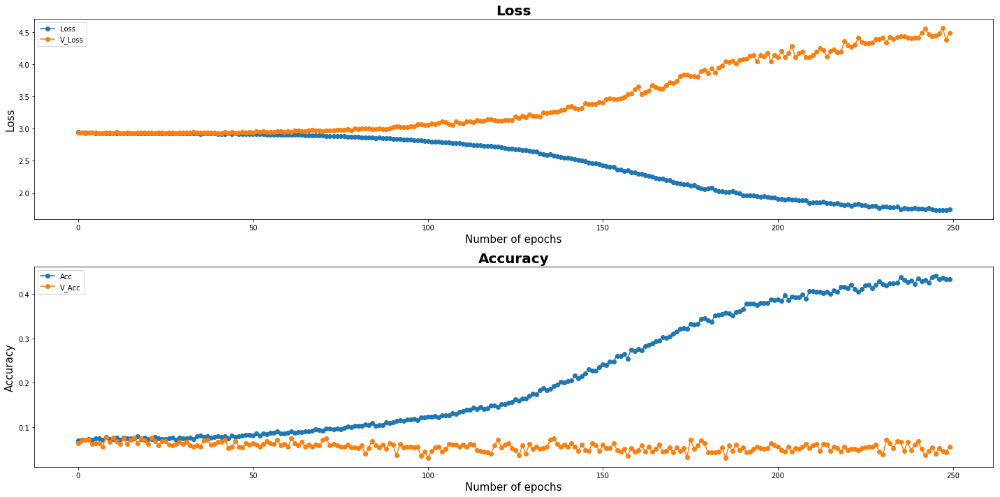

Model Saved
| Epoch [250] | Step [20050] | lr [0.009800] | Loss: [1.9257] | Acc: [0.3906] | Time: 0.0s
| Epoch [250] | Validation | Step [0] |  Loss: [4.3888] | Acc: [0.0312] | Time: 0.0s
| Epoch [250] | Validation | Step [1] |  Loss: [4.5878] | Acc: [0.0625] | Time: 0.0s
| Epoch [250] | Validation | Step [2] |  Loss: [4.7114] | Acc: [0.0547] | Time: 0.0s
| Epoch [250] | Validation | Step [3] |  Loss: [4.1957] | Acc: [0.0781] | Time: 0.0s


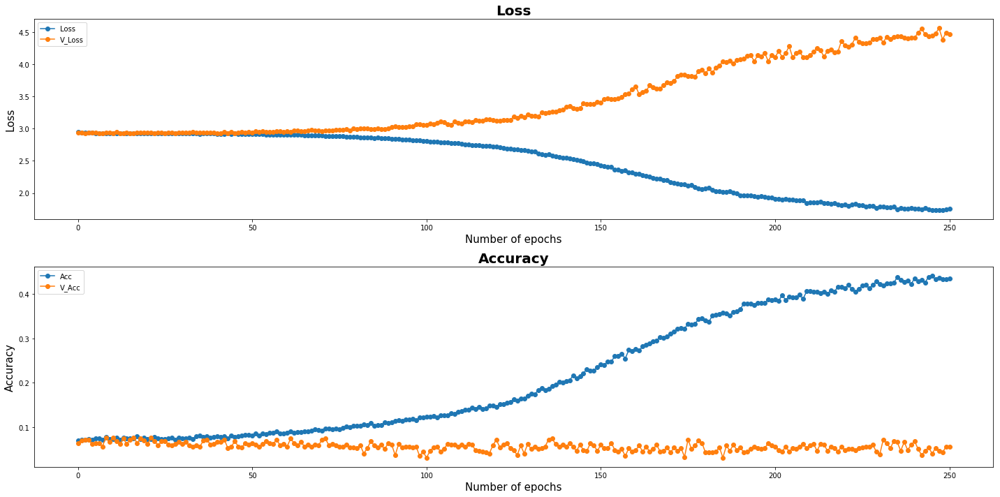

| Epoch [251] | Step [20100] | lr [0.009800] | Loss: [1.6877] | Acc: [0.4531] | Time: 0.0s
| Epoch [251] | Step [20150] | lr [0.009800] | Loss: [1.6348] | Acc: [0.5000] | Time: 0.0s
| Epoch [251] | Validation | Step [0] |  Loss: [4.4272] | Acc: [0.0547] | Time: 0.0s
| Epoch [251] | Validation | Step [1] |  Loss: [4.5157] | Acc: [0.0312] | Time: 0.0s
| Epoch [251] | Validation | Step [2] |  Loss: [4.4470] | Acc: [0.0234] | Time: 0.0s
| Epoch [251] | Validation | Step [3] |  Loss: [4.5343] | Acc: [0.0859] | Time: 0.0s


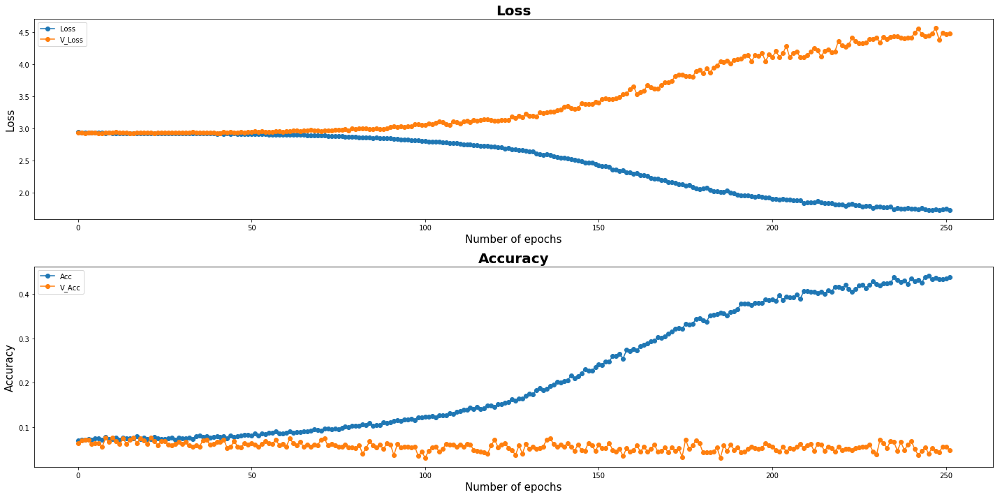

| Epoch [252] | Step [20200] | lr [0.009800] | Loss: [1.7656] | Acc: [0.4375] | Time: 0.0s
| Epoch [252] | Validation | Step [0] |  Loss: [4.4739] | Acc: [0.0781] | Time: 0.0s
| Epoch [252] | Validation | Step [1] |  Loss: [4.4555] | Acc: [0.0391] | Time: 0.0s
| Epoch [252] | Validation | Step [2] |  Loss: [4.3733] | Acc: [0.0469] | Time: 0.0s
| Epoch [252] | Validation | Step [3] |  Loss: [4.7071] | Acc: [0.0625] | Time: 0.0s


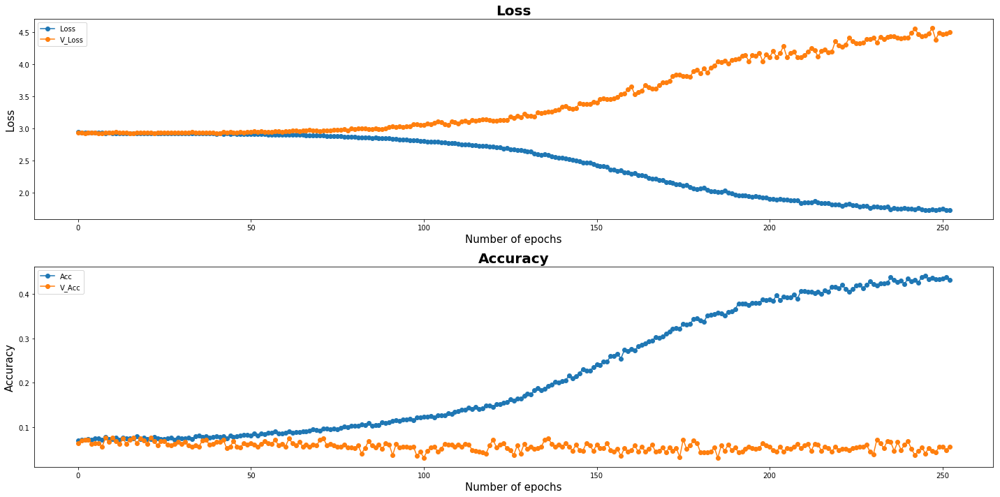

| Epoch [253] | Step [20250] | lr [0.009800] | Loss: [1.6021] | Acc: [0.4844] | Time: 0.0s
| Epoch [253] | Step [20300] | lr [0.009800] | Loss: [1.7918] | Acc: [0.3906] | Time: 0.0s
| Epoch [253] | Validation | Step [0] |  Loss: [4.3521] | Acc: [0.0859] | Time: 0.0s
| Epoch [253] | Validation | Step [1] |  Loss: [4.8661] | Acc: [0.0547] | Time: 0.0s
| Epoch [253] | Validation | Step [2] |  Loss: [4.4549] | Acc: [0.0625] | Time: 0.0s
| Epoch [253] | Validation | Step [3] |  Loss: [4.5421] | Acc: [0.0625] | Time: 0.0s


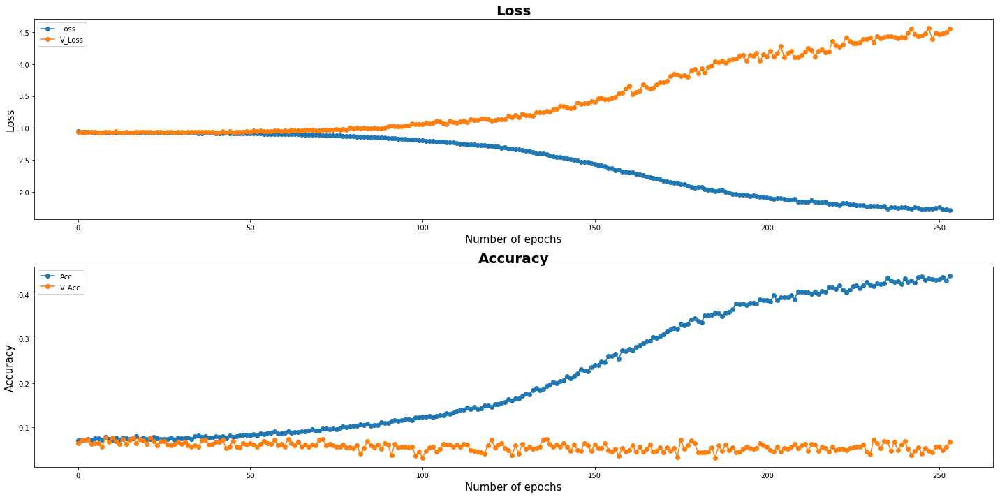

| Epoch [254] | Step [20350] | lr [0.009800] | Loss: [1.6404] | Acc: [0.4766] | Time: 0.0s
| Epoch [254] | Step [20400] | lr [0.009800] | Loss: [1.8553] | Acc: [0.4062] | Time: 0.0s
| Epoch [254] | Validation | Step [0] |  Loss: [4.4949] | Acc: [0.0391] | Time: 0.0s
| Epoch [254] | Validation | Step [1] |  Loss: [4.4478] | Acc: [0.0312] | Time: 0.0s
| Epoch [254] | Validation | Step [2] |  Loss: [4.6245] | Acc: [0.0625] | Time: 0.0s
| Epoch [254] | Validation | Step [3] |  Loss: [4.3767] | Acc: [0.0469] | Time: 0.0s


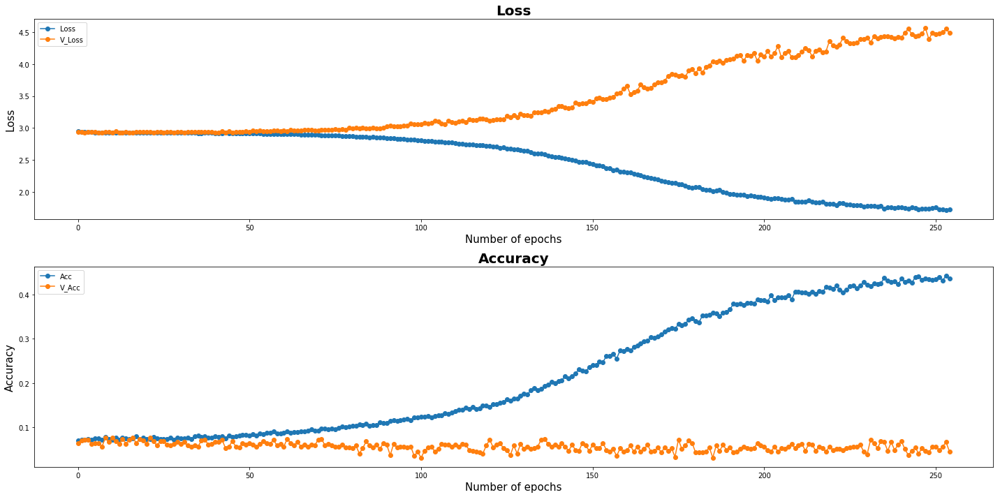

| Epoch [255] | Step [20450] | lr [0.009800] | Loss: [1.7924] | Acc: [0.4375] | Time: 0.0s
| Epoch [255] | Validation | Step [0] |  Loss: [4.5838] | Acc: [0.0469] | Time: 0.0s
| Epoch [255] | Validation | Step [1] |  Loss: [4.5665] | Acc: [0.0391] | Time: 0.0s
| Epoch [255] | Validation | Step [2] |  Loss: [4.2553] | Acc: [0.0703] | Time: 0.0s
| Epoch [255] | Validation | Step [3] |  Loss: [4.5897] | Acc: [0.0938] | Time: 0.0s


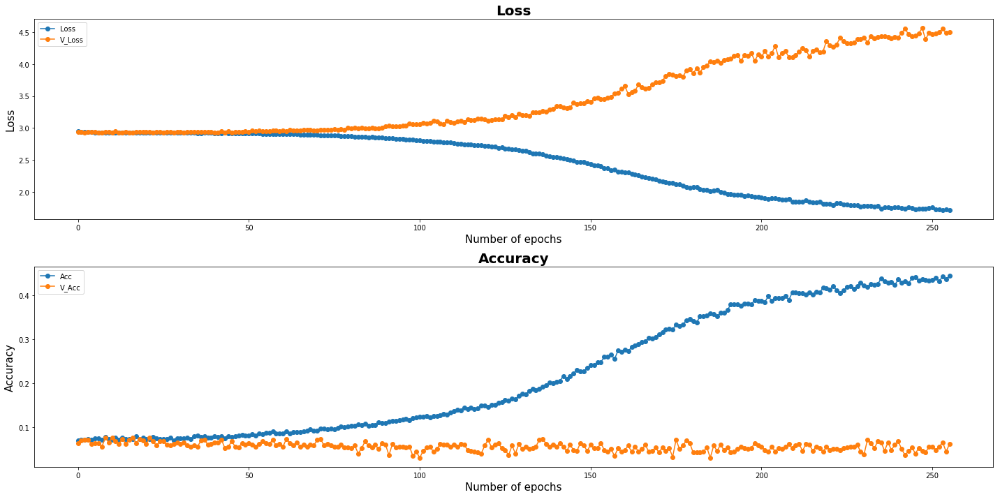

| Epoch [256] | Step [20500] | lr [0.009800] | Loss: [1.7840] | Acc: [0.4531] | Time: 0.0s
| Epoch [256] | Step [20550] | lr [0.009800] | Loss: [1.8863] | Acc: [0.3906] | Time: 0.0s
| Epoch [256] | Validation | Step [0] |  Loss: [4.5932] | Acc: [0.0391] | Time: 0.0s
| Epoch [256] | Validation | Step [1] |  Loss: [4.6925] | Acc: [0.0391] | Time: 0.0s
| Epoch [256] | Validation | Step [2] |  Loss: [4.2103] | Acc: [0.0625] | Time: 0.0s
| Epoch [256] | Validation | Step [3] |  Loss: [4.5486] | Acc: [0.1016] | Time: 0.0s


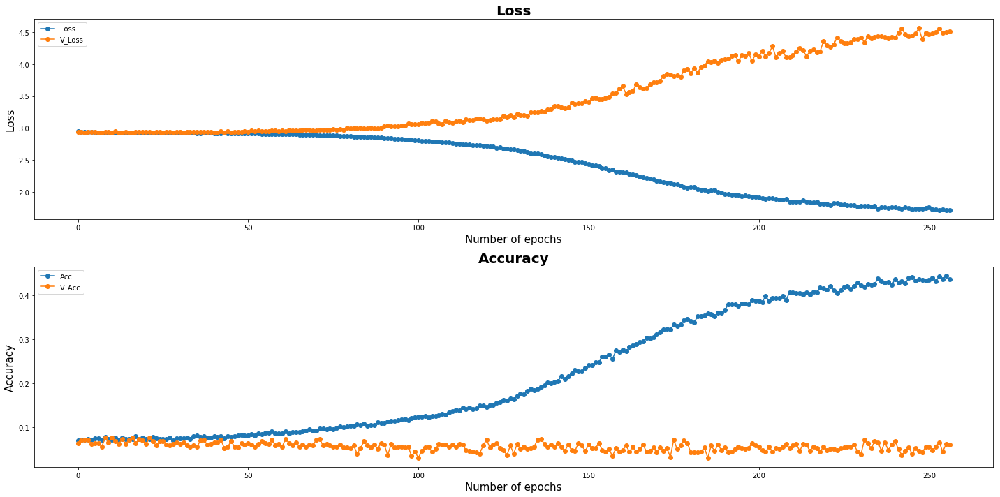

| Epoch [257] | Step [20600] | lr [0.009800] | Loss: [1.6730] | Acc: [0.5078] | Time: 0.0s
| Epoch [257] | Validation | Step [0] |  Loss: [4.1195] | Acc: [0.0938] | Time: 0.0s
| Epoch [257] | Validation | Step [1] |  Loss: [4.2693] | Acc: [0.0469] | Time: 0.0s
| Epoch [257] | Validation | Step [2] |  Loss: [4.6278] | Acc: [0.0703] | Time: 0.0s
| Epoch [257] | Validation | Step [3] |  Loss: [4.6613] | Acc: [0.0625] | Time: 0.0s


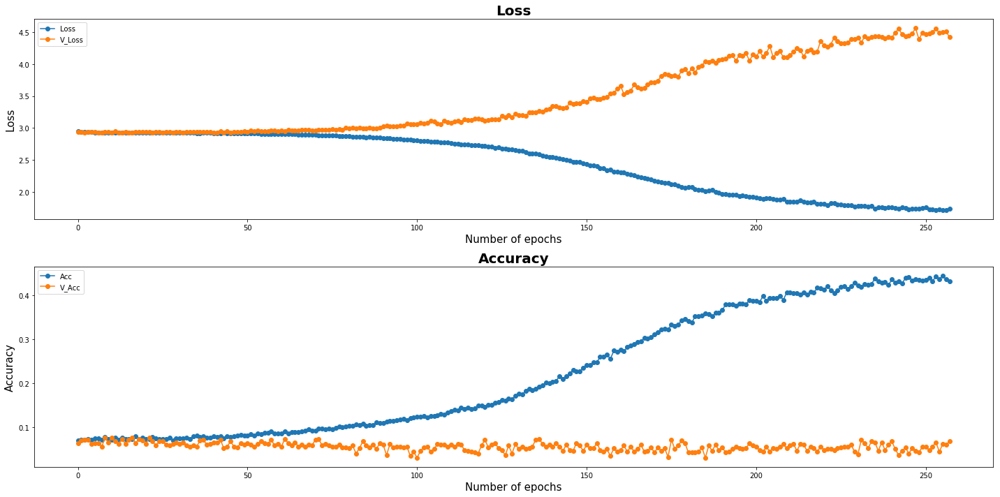

| Epoch [258] | Step [20650] | lr [0.009800] | Loss: [1.7004] | Acc: [0.4219] | Time: 0.0s
| Epoch [258] | Step [20700] | lr [0.009800] | Loss: [1.8598] | Acc: [0.3984] | Time: 0.0s
| Epoch [258] | Validation | Step [0] |  Loss: [4.4668] | Acc: [0.0625] | Time: 0.0s
| Epoch [258] | Validation | Step [1] |  Loss: [4.5974] | Acc: [0.0859] | Time: 0.0s
| Epoch [258] | Validation | Step [2] |  Loss: [4.7039] | Acc: [0.0156] | Time: 0.0s
| Epoch [258] | Validation | Step [3] |  Loss: [4.0604] | Acc: [0.0703] | Time: 0.0s


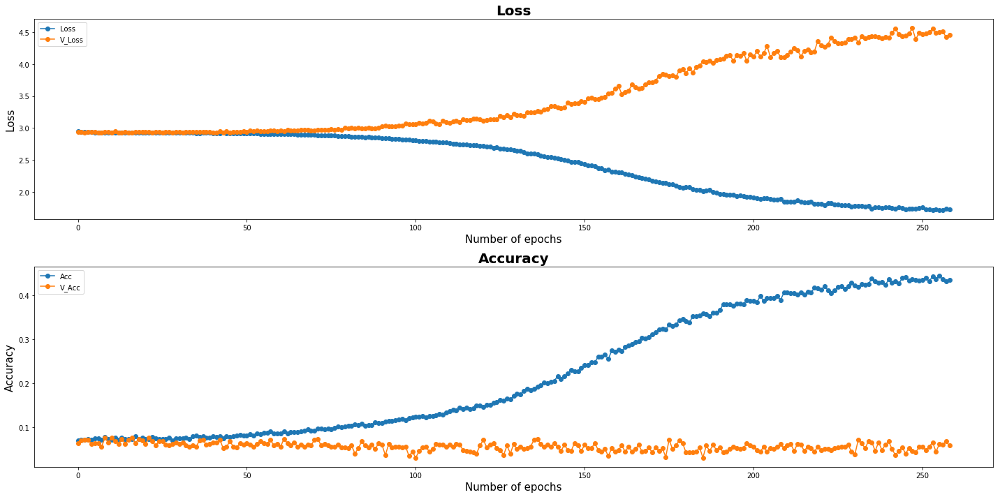

| Epoch [259] | Step [20750] | lr [0.009800] | Loss: [1.6604] | Acc: [0.4609] | Time: 0.0s
| Epoch [259] | Step [20800] | lr [0.009800] | Loss: [1.7831] | Acc: [0.4141] | Time: 0.0s
| Epoch [259] | Validation | Step [0] |  Loss: [4.5267] | Acc: [0.0625] | Time: 0.0s
| Epoch [259] | Validation | Step [1] |  Loss: [4.4878] | Acc: [0.0312] | Time: 0.0s
| Epoch [259] | Validation | Step [2] |  Loss: [4.4717] | Acc: [0.0547] | Time: 0.0s
| Epoch [259] | Validation | Step [3] |  Loss: [4.5490] | Acc: [0.0469] | Time: 0.0s


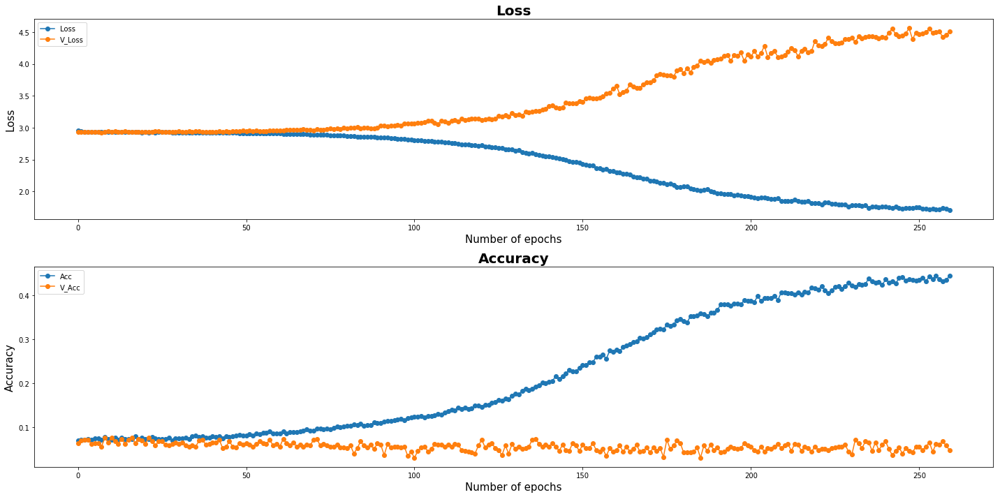

Model Saved
| Epoch [260] | Step [20850] | lr [0.009800] | Loss: [1.7139] | Acc: [0.4141] | Time: 0.0s
| Epoch [260] | Validation | Step [0] |  Loss: [4.3963] | Acc: [0.0547] | Time: 0.0s
| Epoch [260] | Validation | Step [1] |  Loss: [4.5715] | Acc: [0.0625] | Time: 0.0s
| Epoch [260] | Validation | Step [2] |  Loss: [4.5275] | Acc: [0.0312] | Time: 0.0s
| Epoch [260] | Validation | Step [3] |  Loss: [4.5230] | Acc: [0.0625] | Time: 0.0s


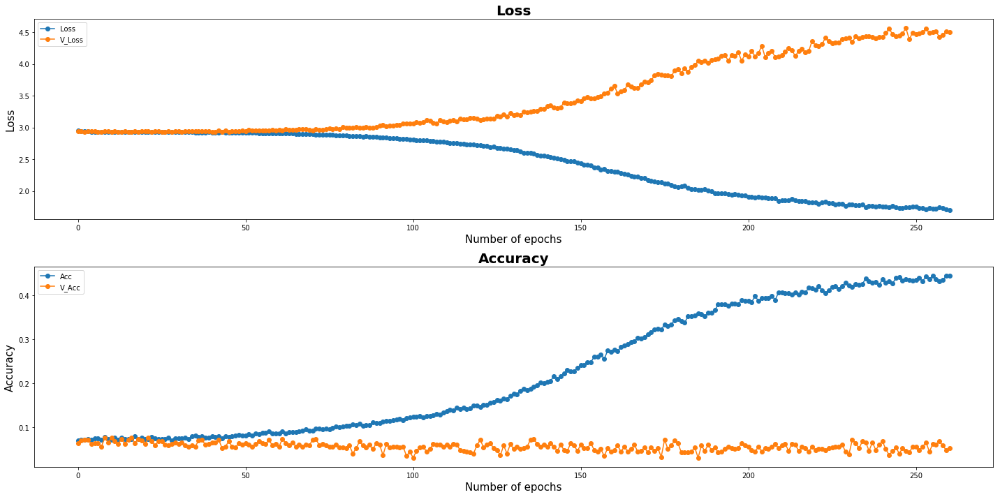

| Epoch [261] | Step [20900] | lr [0.009800] | Loss: [1.6117] | Acc: [0.4609] | Time: 0.0s
| Epoch [261] | Step [20950] | lr [0.009800] | Loss: [1.9962] | Acc: [0.3359] | Time: 0.0s
| Epoch [261] | Validation | Step [0] |  Loss: [4.3589] | Acc: [0.0859] | Time: 0.0s
| Epoch [261] | Validation | Step [1] |  Loss: [4.6030] | Acc: [0.0547] | Time: 0.0s
| Epoch [261] | Validation | Step [2] |  Loss: [4.6373] | Acc: [0.0469] | Time: 0.0s
| Epoch [261] | Validation | Step [3] |  Loss: [4.3105] | Acc: [0.0469] | Time: 0.0s


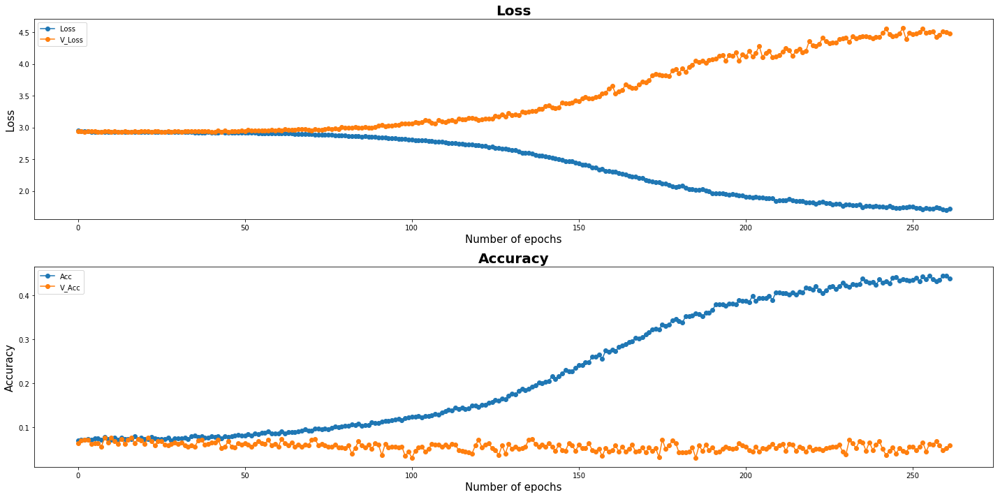

| Epoch [262] | Step [21000] | lr [0.009800] | Loss: [1.8849] | Acc: [0.3594] | Time: 0.0s
| Epoch [262] | Validation | Step [0] |  Loss: [4.7266] | Acc: [0.0469] | Time: 0.0s
| Epoch [262] | Validation | Step [1] |  Loss: [4.4892] | Acc: [0.0625] | Time: 0.0s
| Epoch [262] | Validation | Step [2] |  Loss: [4.4051] | Acc: [0.0547] | Time: 0.0s
| Epoch [262] | Validation | Step [3] |  Loss: [4.4737] | Acc: [0.0859] | Time: 0.0s


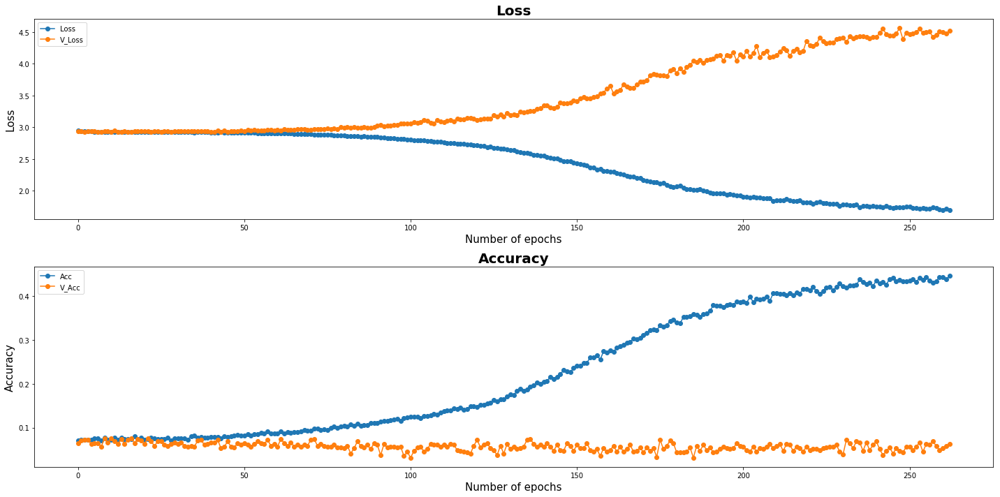

| Epoch [263] | Step [21050] | lr [0.009800] | Loss: [1.8177] | Acc: [0.4219] | Time: 0.0s
| Epoch [263] | Step [21100] | lr [0.009800] | Loss: [1.7007] | Acc: [0.4375] | Time: 0.0s
| Epoch [263] | Validation | Step [0] |  Loss: [4.5920] | Acc: [0.0703] | Time: 0.0s
| Epoch [263] | Validation | Step [1] |  Loss: [4.5464] | Acc: [0.0859] | Time: 0.0s
| Epoch [263] | Validation | Step [2] |  Loss: [4.4439] | Acc: [0.0625] | Time: 0.0s
| Epoch [263] | Validation | Step [3] |  Loss: [4.7143] | Acc: [0.0547] | Time: 0.0s


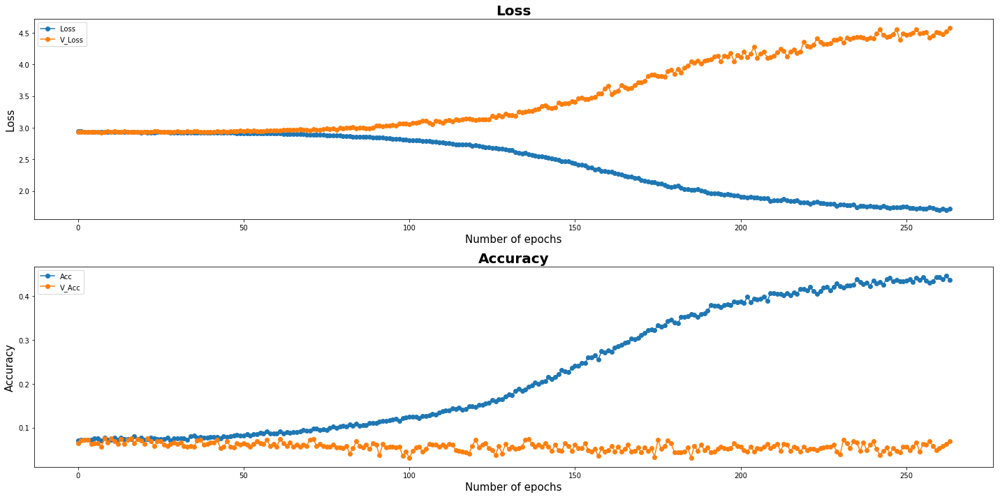

| Epoch [264] | Step [21150] | lr [0.009800] | Loss: [1.6621] | Acc: [0.4453] | Time: 0.0s
| Epoch [264] | Step [21200] | lr [0.009800] | Loss: [1.7945] | Acc: [0.4062] | Time: 0.0s
| Epoch [264] | Validation | Step [0] |  Loss: [4.5043] | Acc: [0.0938] | Time: 0.0s
| Epoch [264] | Validation | Step [1] |  Loss: [4.7061] | Acc: [0.0391] | Time: 0.0s
| Epoch [264] | Validation | Step [2] |  Loss: [4.7867] | Acc: [0.0391] | Time: 0.0s
| Epoch [264] | Validation | Step [3] |  Loss: [4.3262] | Acc: [0.0469] | Time: 0.0s


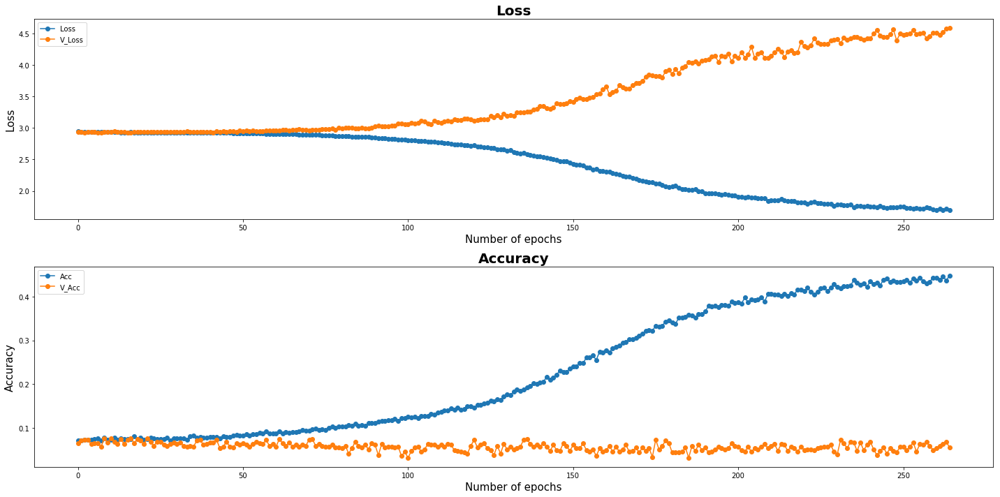

| Epoch [265] | Step [21250] | lr [0.009800] | Loss: [1.6793] | Acc: [0.4062] | Time: 0.0s
| Epoch [265] | Validation | Step [0] |  Loss: [4.2781] | Acc: [0.0703] | Time: 0.0s
| Epoch [265] | Validation | Step [1] |  Loss: [4.6278] | Acc: [0.0391] | Time: 0.0s
| Epoch [265] | Validation | Step [2] |  Loss: [4.4034] | Acc: [0.0625] | Time: 0.0s
| Epoch [265] | Validation | Step [3] |  Loss: [4.5832] | Acc: [0.0391] | Time: 0.0s


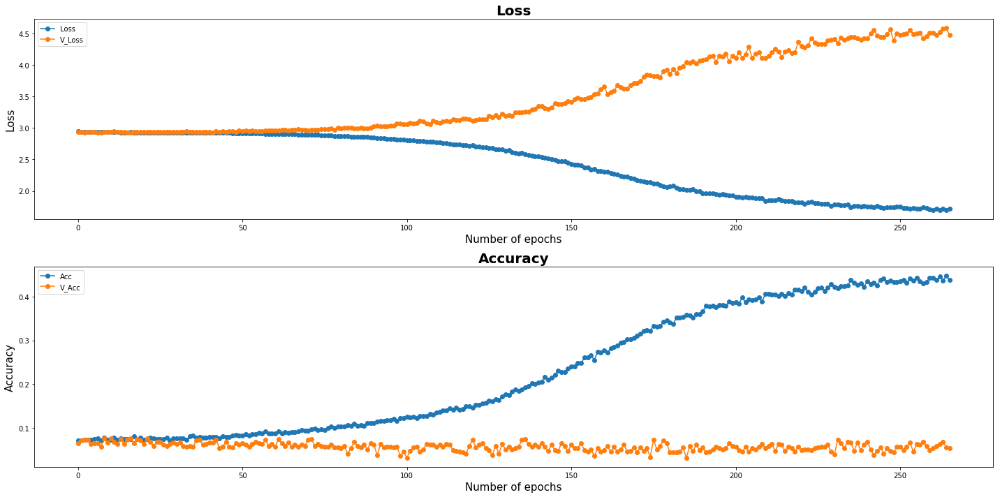

| Epoch [266] | Step [21300] | lr [0.009800] | Loss: [1.5938] | Acc: [0.5234] | Time: 0.0s
| Epoch [266] | Step [21350] | lr [0.009800] | Loss: [1.7146] | Acc: [0.4141] | Time: 0.0s
| Epoch [266] | Validation | Step [0] |  Loss: [4.4886] | Acc: [0.0469] | Time: 0.0s
| Epoch [266] | Validation | Step [1] |  Loss: [4.8945] | Acc: [0.0547] | Time: 0.0s
| Epoch [266] | Validation | Step [2] |  Loss: [4.7423] | Acc: [0.0547] | Time: 0.0s
| Epoch [266] | Validation | Step [3] |  Loss: [4.2950] | Acc: [0.0781] | Time: 0.0s


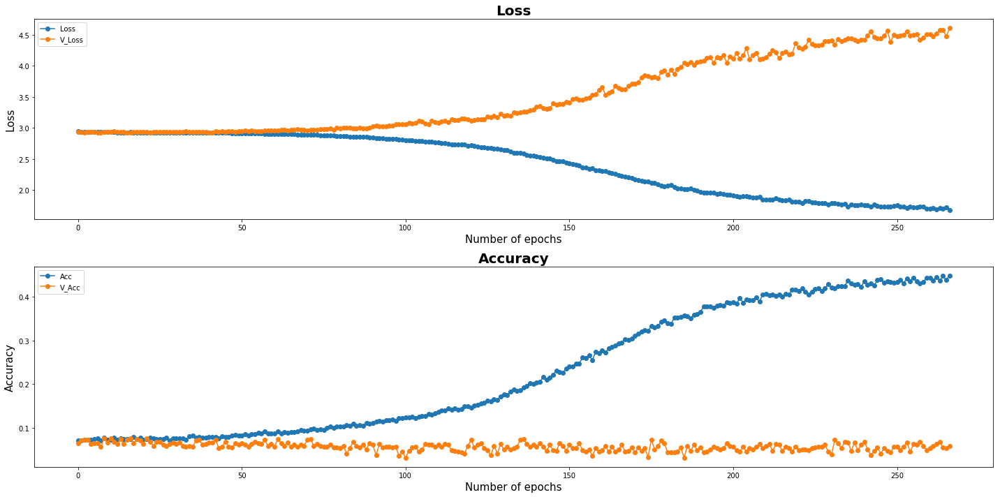

| Epoch [267] | Step [21400] | lr [0.009800] | Loss: [1.8744] | Acc: [0.4297] | Time: 0.0s
| Epoch [267] | Validation | Step [0] |  Loss: [4.4238] | Acc: [0.0312] | Time: 0.0s
| Epoch [267] | Validation | Step [1] |  Loss: [4.3668] | Acc: [0.0469] | Time: 0.0s
| Epoch [267] | Validation | Step [2] |  Loss: [4.4780] | Acc: [0.0547] | Time: 0.0s
| Epoch [267] | Validation | Step [3] |  Loss: [4.6938] | Acc: [0.0156] | Time: 0.0s


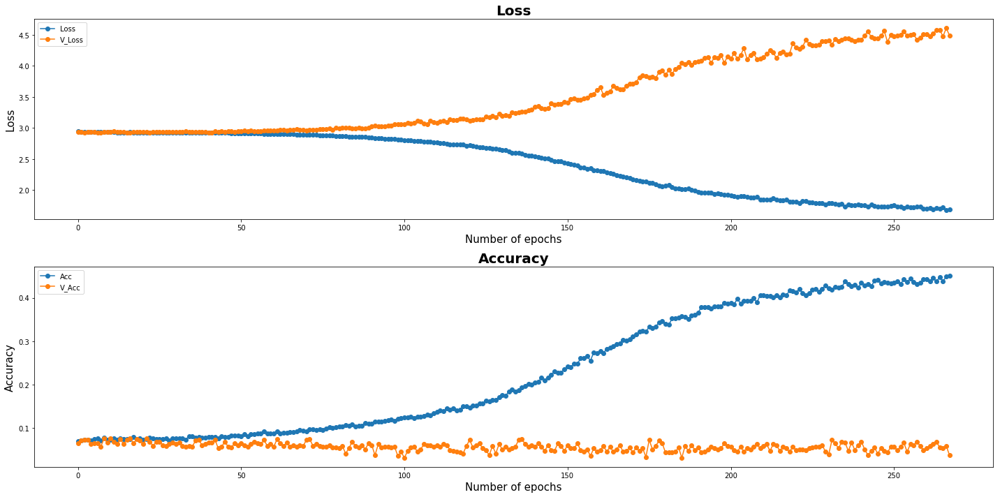

| Epoch [268] | Step [21450] | lr [0.009800] | Loss: [1.5978] | Acc: [0.4922] | Time: 0.0s
| Epoch [268] | Step [21500] | lr [0.009800] | Loss: [1.7643] | Acc: [0.3906] | Time: 0.0s
| Epoch [268] | Validation | Step [0] |  Loss: [4.8489] | Acc: [0.0469] | Time: 0.0s
| Epoch [268] | Validation | Step [1] |  Loss: [4.5844] | Acc: [0.0703] | Time: 0.0s
| Epoch [268] | Validation | Step [2] |  Loss: [4.4829] | Acc: [0.0781] | Time: 0.0s
| Epoch [268] | Validation | Step [3] |  Loss: [4.2870] | Acc: [0.0625] | Time: 0.0s


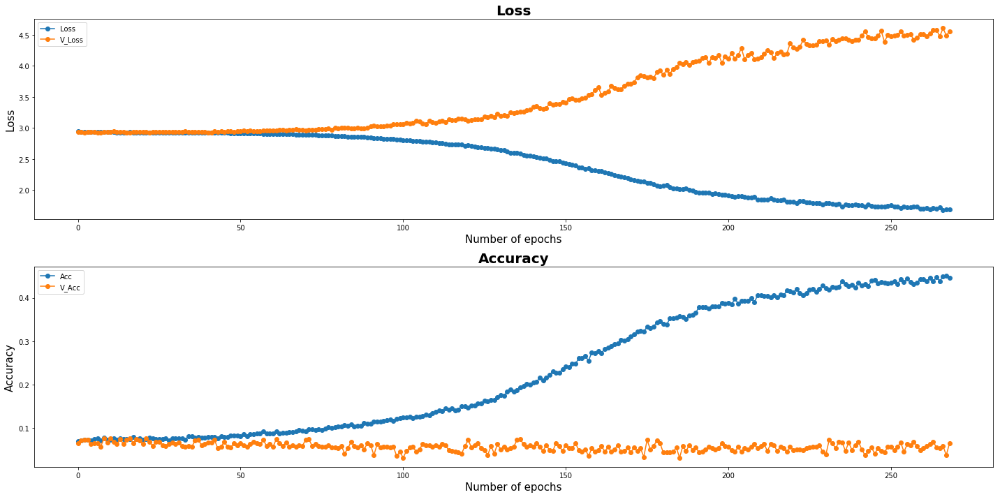

| Epoch [269] | Step [21550] | lr [0.009800] | Loss: [1.7078] | Acc: [0.4297] | Time: 0.0s
| Epoch [269] | Step [21600] | lr [0.009800] | Loss: [1.9188] | Acc: [0.3438] | Time: 0.0s
| Epoch [269] | Validation | Step [0] |  Loss: [4.5214] | Acc: [0.0859] | Time: 0.0s
| Epoch [269] | Validation | Step [1] |  Loss: [4.5211] | Acc: [0.0781] | Time: 0.0s
| Epoch [269] | Validation | Step [2] |  Loss: [4.6079] | Acc: [0.0547] | Time: 0.0s
| Epoch [269] | Validation | Step [3] |  Loss: [4.6850] | Acc: [0.0547] | Time: 0.0s


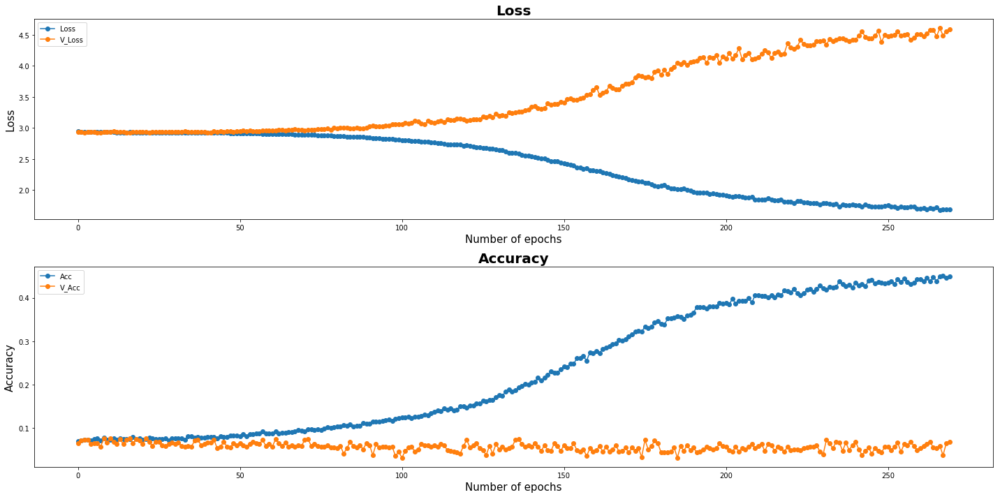

Model Saved
| Epoch [270] | Step [21650] | lr [0.009800] | Loss: [1.8915] | Acc: [0.3750] | Time: 0.0s
| Epoch [270] | Validation | Step [0] |  Loss: [4.2900] | Acc: [0.0625] | Time: 0.0s
| Epoch [270] | Validation | Step [1] |  Loss: [4.3198] | Acc: [0.0859] | Time: 0.0s
| Epoch [270] | Validation | Step [2] |  Loss: [4.4376] | Acc: [0.0547] | Time: 0.0s
| Epoch [270] | Validation | Step [3] |  Loss: [4.6146] | Acc: [0.0391] | Time: 0.0s


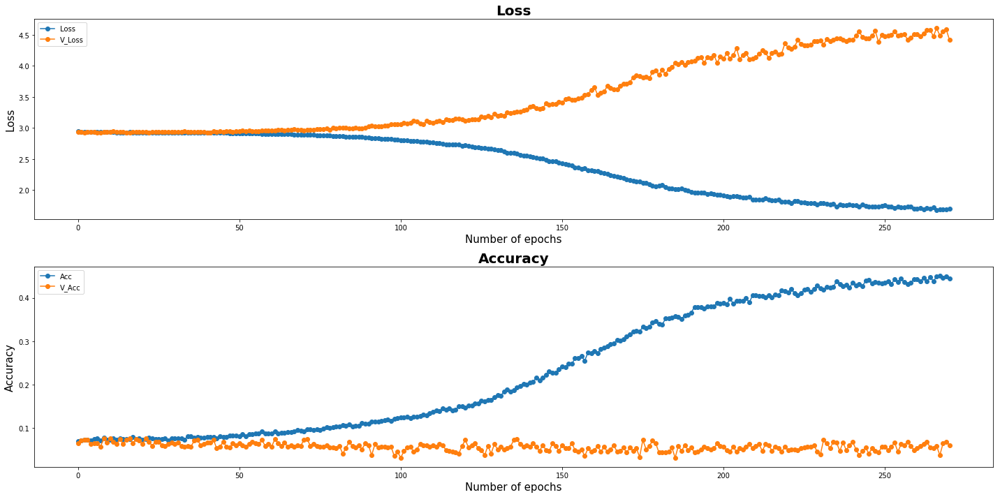

| Epoch [271] | Step [21700] | lr [0.009800] | Loss: [1.5756] | Acc: [0.5000] | Time: 0.0s
| Epoch [271] | Step [21750] | lr [0.009800] | Loss: [1.8344] | Acc: [0.4453] | Time: 0.0s
| Epoch [271] | Validation | Step [0] |  Loss: [4.8453] | Acc: [0.0625] | Time: 0.0s
| Epoch [271] | Validation | Step [1] |  Loss: [4.7014] | Acc: [0.0469] | Time: 0.0s
| Epoch [271] | Validation | Step [2] |  Loss: [4.3401] | Acc: [0.0625] | Time: 0.0s
| Epoch [271] | Validation | Step [3] |  Loss: [4.5318] | Acc: [0.0703] | Time: 0.0s


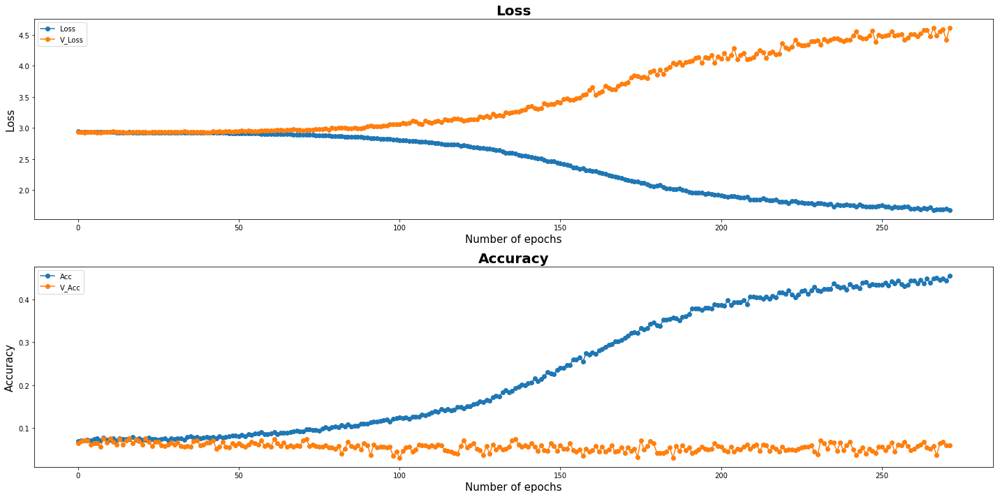

| Epoch [272] | Step [21800] | lr [0.009800] | Loss: [1.6674] | Acc: [0.4531] | Time: 0.0s
| Epoch [272] | Validation | Step [0] |  Loss: [4.5858] | Acc: [0.1016] | Time: 0.0s
| Epoch [272] | Validation | Step [1] |  Loss: [4.7538] | Acc: [0.0078] | Time: 0.0s
| Epoch [272] | Validation | Step [2] |  Loss: [4.8086] | Acc: [0.0312] | Time: 0.0s
| Epoch [272] | Validation | Step [3] |  Loss: [4.2335] | Acc: [0.0703] | Time: 0.0s


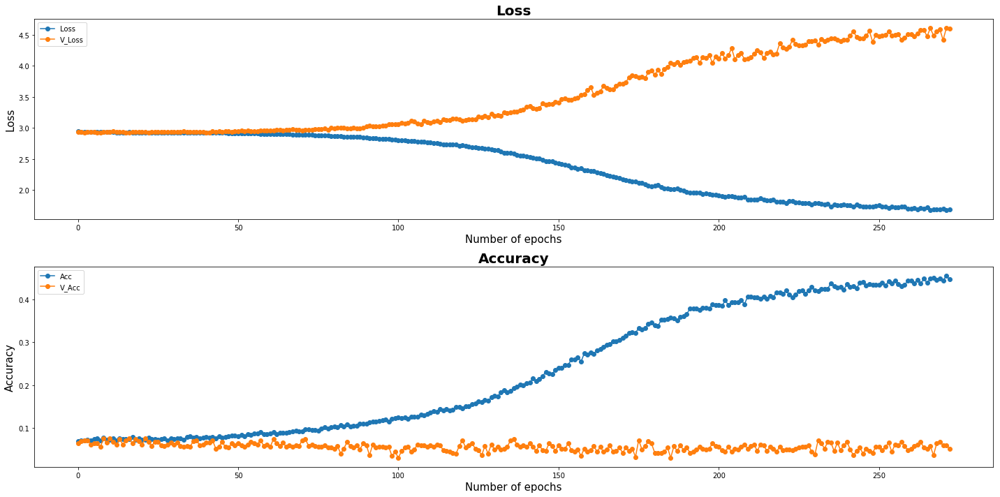

| Epoch [273] | Step [21850] | lr [0.009800] | Loss: [1.5186] | Acc: [0.5078] | Time: 0.0s
| Epoch [273] | Step [21900] | lr [0.009800] | Loss: [1.7106] | Acc: [0.4531] | Time: 0.0s
| Epoch [273] | Validation | Step [0] |  Loss: [4.6607] | Acc: [0.0625] | Time: 0.0s
| Epoch [273] | Validation | Step [1] |  Loss: [4.6529] | Acc: [0.0547] | Time: 0.0s
| Epoch [273] | Validation | Step [2] |  Loss: [4.4362] | Acc: [0.0781] | Time: 0.0s
| Epoch [273] | Validation | Step [3] |  Loss: [4.6098] | Acc: [0.0547] | Time: 0.0s


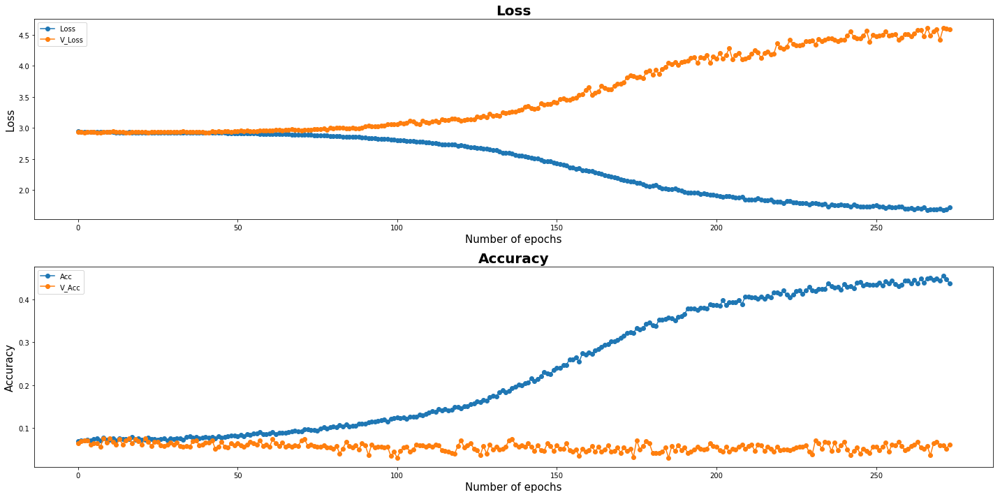

| Epoch [274] | Step [21950] | lr [0.009800] | Loss: [1.3844] | Acc: [0.5156] | Time: 0.0s
| Epoch [274] | Step [22000] | lr [0.009800] | Loss: [1.7044] | Acc: [0.4766] | Time: 0.0s
| Epoch [274] | Validation | Step [0] |  Loss: [4.2994] | Acc: [0.1016] | Time: 0.0s
| Epoch [274] | Validation | Step [1] |  Loss: [4.8258] | Acc: [0.0469] | Time: 0.0s
| Epoch [274] | Validation | Step [2] |  Loss: [4.5673] | Acc: [0.0391] | Time: 0.0s
| Epoch [274] | Validation | Step [3] |  Loss: [4.6980] | Acc: [0.1016] | Time: 0.0s


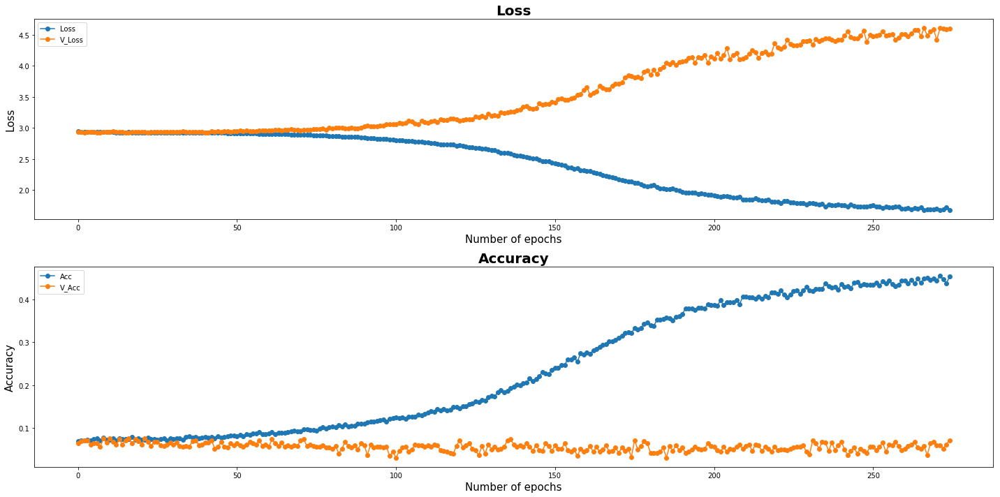

| Epoch [275] | Step [22050] | lr [0.009800] | Loss: [1.7664] | Acc: [0.4141] | Time: 0.0s
| Epoch [275] | Validation | Step [0] |  Loss: [4.5817] | Acc: [0.0781] | Time: 0.0s
| Epoch [275] | Validation | Step [1] |  Loss: [4.6722] | Acc: [0.0547] | Time: 0.0s
| Epoch [275] | Validation | Step [2] |  Loss: [4.6722] | Acc: [0.0469] | Time: 0.0s
| Epoch [275] | Validation | Step [3] |  Loss: [4.1876] | Acc: [0.1172] | Time: 0.0s


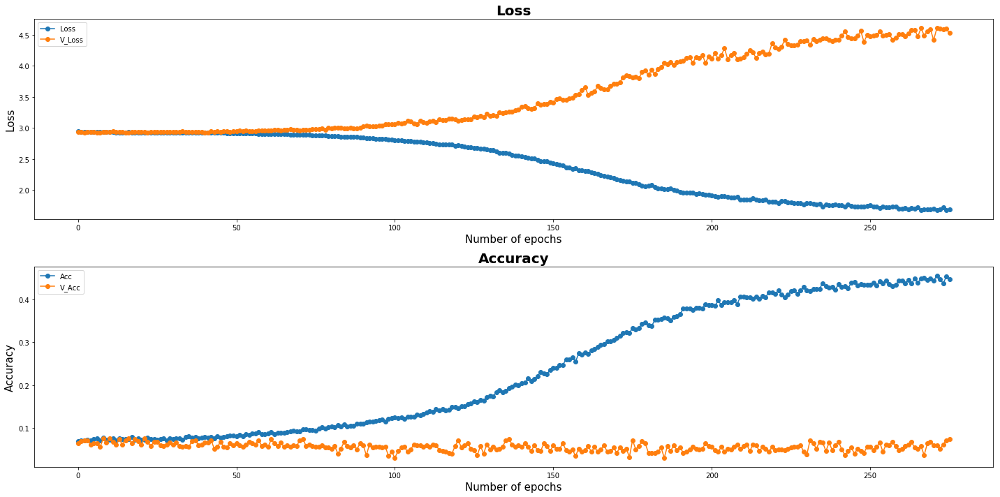

| Epoch [276] | Step [22100] | lr [0.009800] | Loss: [1.7821] | Acc: [0.4062] | Time: 0.0s
| Epoch [276] | Step [22150] | lr [0.009800] | Loss: [1.9536] | Acc: [0.3047] | Time: 0.0s
| Epoch [276] | Validation | Step [0] |  Loss: [4.4310] | Acc: [0.0469] | Time: 0.0s
| Epoch [276] | Validation | Step [1] |  Loss: [4.4511] | Acc: [0.0781] | Time: 0.0s
| Epoch [276] | Validation | Step [2] |  Loss: [4.7518] | Acc: [0.0625] | Time: 0.0s
| Epoch [276] | Validation | Step [3] |  Loss: [4.5279] | Acc: [0.0938] | Time: 0.0s


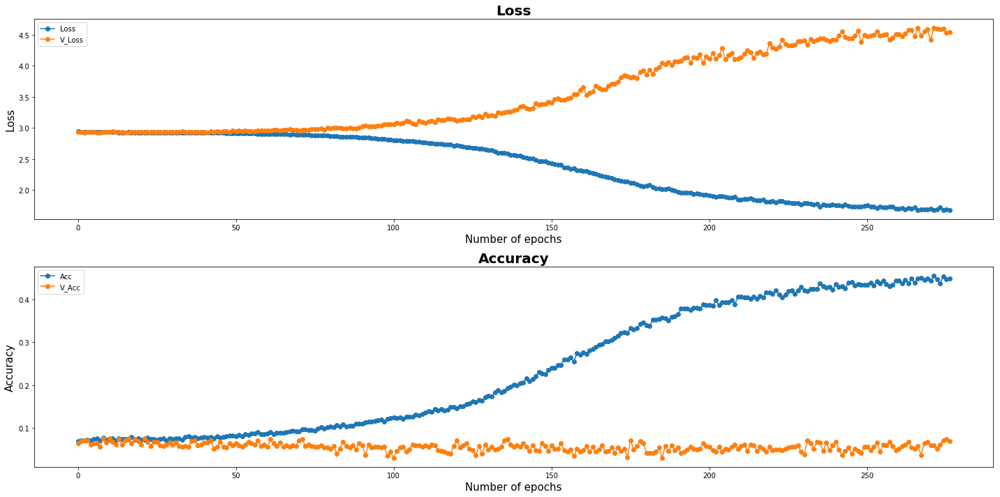

| Epoch [277] | Step [22200] | lr [0.009800] | Loss: [1.9621] | Acc: [0.3594] | Time: 0.0s
| Epoch [277] | Validation | Step [0] |  Loss: [4.3655] | Acc: [0.0547] | Time: 0.0s
| Epoch [277] | Validation | Step [1] |  Loss: [4.6810] | Acc: [0.0703] | Time: 0.0s
| Epoch [277] | Validation | Step [2] |  Loss: [4.5312] | Acc: [0.0234] | Time: 0.0s
| Epoch [277] | Validation | Step [3] |  Loss: [4.6354] | Acc: [0.0469] | Time: 0.0s


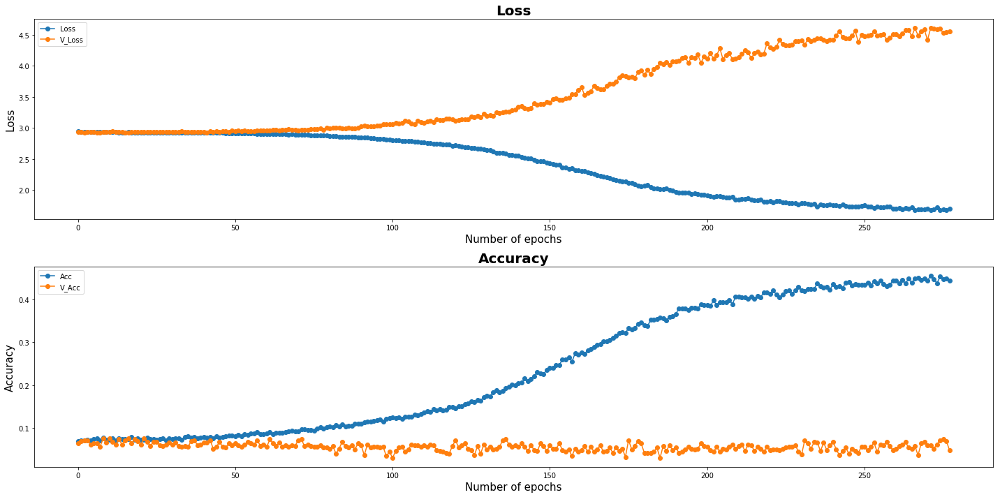

| Epoch [278] | Step [22250] | lr [0.009800] | Loss: [1.5240] | Acc: [0.5547] | Time: 0.0s
| Epoch [278] | Step [22300] | lr [0.009800] | Loss: [1.7276] | Acc: [0.3906] | Time: 0.0s
| Epoch [278] | Validation | Step [0] |  Loss: [4.5478] | Acc: [0.0312] | Time: 0.0s
| Epoch [278] | Validation | Step [1] |  Loss: [4.5517] | Acc: [0.0703] | Time: 0.0s
| Epoch [278] | Validation | Step [2] |  Loss: [4.4662] | Acc: [0.0625] | Time: 0.0s
| Epoch [278] | Validation | Step [3] |  Loss: [4.2583] | Acc: [0.0781] | Time: 0.0s


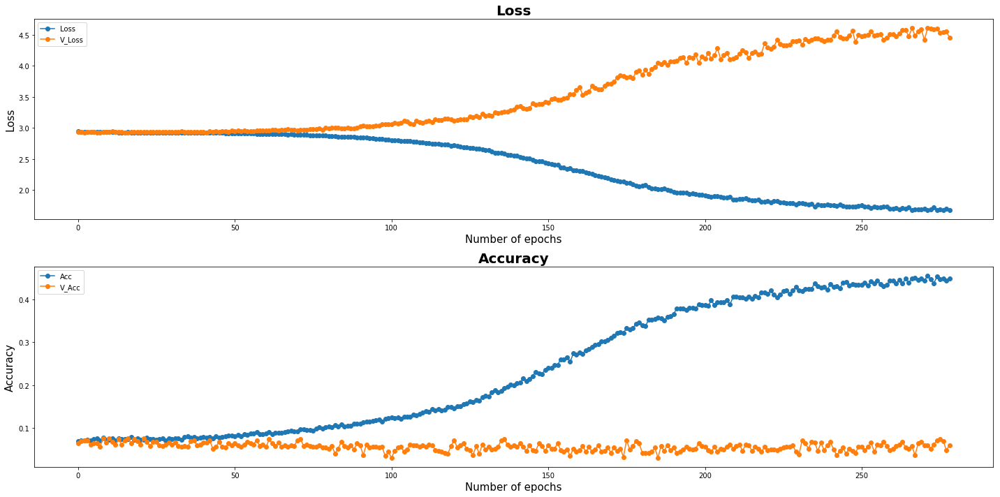

| Epoch [279] | Step [22350] | lr [0.009800] | Loss: [1.7538] | Acc: [0.4141] | Time: 0.0s
| Epoch [279] | Step [22400] | lr [0.009800] | Loss: [1.8621] | Acc: [0.4062] | Time: 0.0s
| Epoch [279] | Validation | Step [0] |  Loss: [5.0150] | Acc: [0.0391] | Time: 0.0s
| Epoch [279] | Validation | Step [1] |  Loss: [4.4088] | Acc: [0.0938] | Time: 0.0s
| Epoch [279] | Validation | Step [2] |  Loss: [4.5233] | Acc: [0.0312] | Time: 0.0s
| Epoch [279] | Validation | Step [3] |  Loss: [4.4705] | Acc: [0.0625] | Time: 0.0s


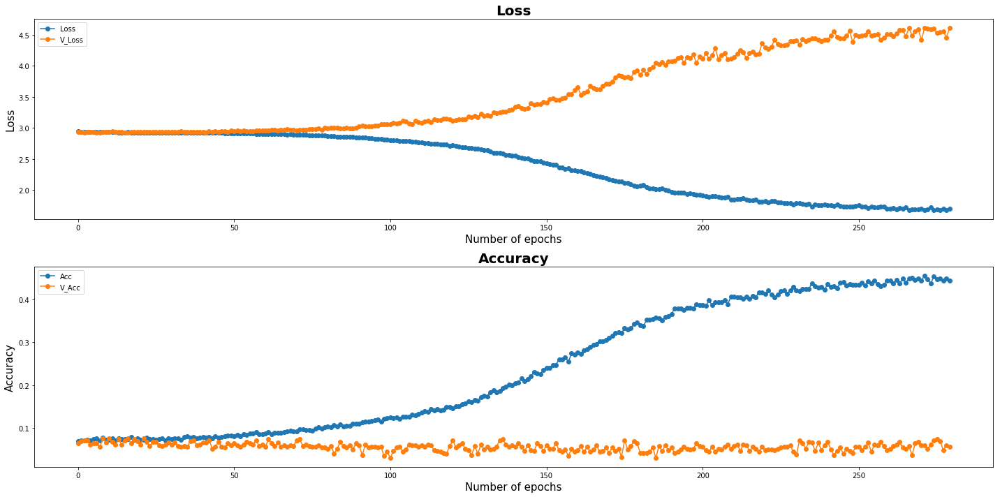

Model Saved
| Epoch [280] | Step [22450] | lr [0.009800] | Loss: [1.7970] | Acc: [0.4062] | Time: 0.0s
| Epoch [280] | Validation | Step [0] |  Loss: [4.7079] | Acc: [0.0625] | Time: 0.0s
| Epoch [280] | Validation | Step [1] |  Loss: [4.6507] | Acc: [0.0625] | Time: 0.0s
| Epoch [280] | Validation | Step [2] |  Loss: [4.3686] | Acc: [0.0625] | Time: 0.0s
| Epoch [280] | Validation | Step [3] |  Loss: [4.4455] | Acc: [0.0547] | Time: 0.0s


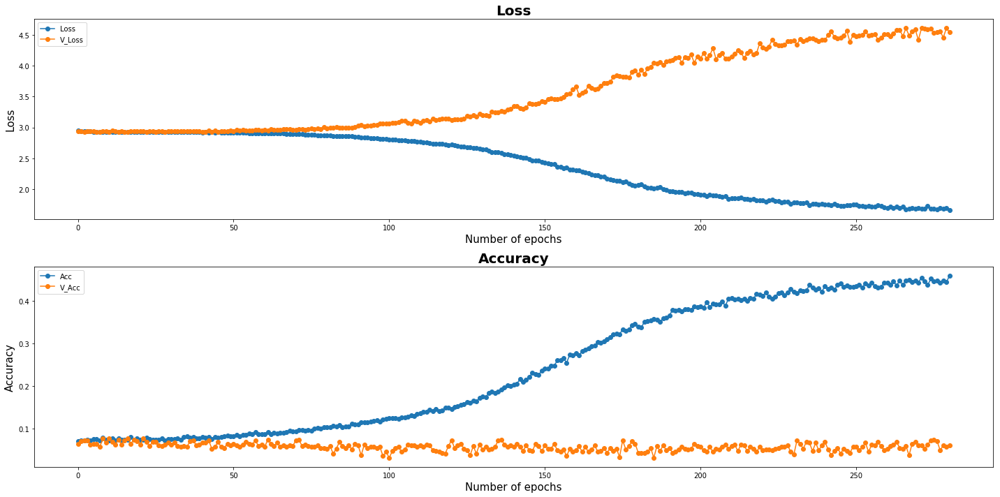

| Epoch [281] | Step [22500] | lr [0.009800] | Loss: [1.3990] | Acc: [0.5781] | Time: 0.0s
| Epoch [281] | Step [22550] | lr [0.009800] | Loss: [1.8708] | Acc: [0.3906] | Time: 0.0s
| Epoch [281] | Validation | Step [0] |  Loss: [4.6593] | Acc: [0.0312] | Time: 0.0s
| Epoch [281] | Validation | Step [1] |  Loss: [4.5882] | Acc: [0.0703] | Time: 0.0s
| Epoch [281] | Validation | Step [2] |  Loss: [4.3749] | Acc: [0.0703] | Time: 0.0s
| Epoch [281] | Validation | Step [3] |  Loss: [4.7488] | Acc: [0.0625] | Time: 0.0s


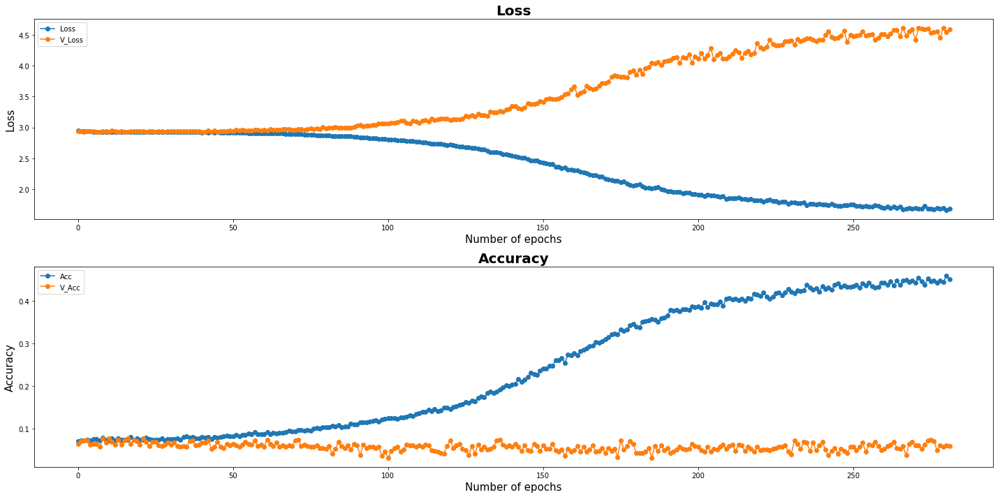

| Epoch [282] | Step [22600] | lr [0.009800] | Loss: [1.7225] | Acc: [0.4141] | Time: 0.0s
| Epoch [282] | Validation | Step [0] |  Loss: [4.6248] | Acc: [0.0547] | Time: 0.0s
| Epoch [282] | Validation | Step [1] |  Loss: [4.7701] | Acc: [0.0547] | Time: 0.0s
| Epoch [282] | Validation | Step [2] |  Loss: [4.6865] | Acc: [0.0625] | Time: 0.0s
| Epoch [282] | Validation | Step [3] |  Loss: [4.4372] | Acc: [0.0469] | Time: 0.0s


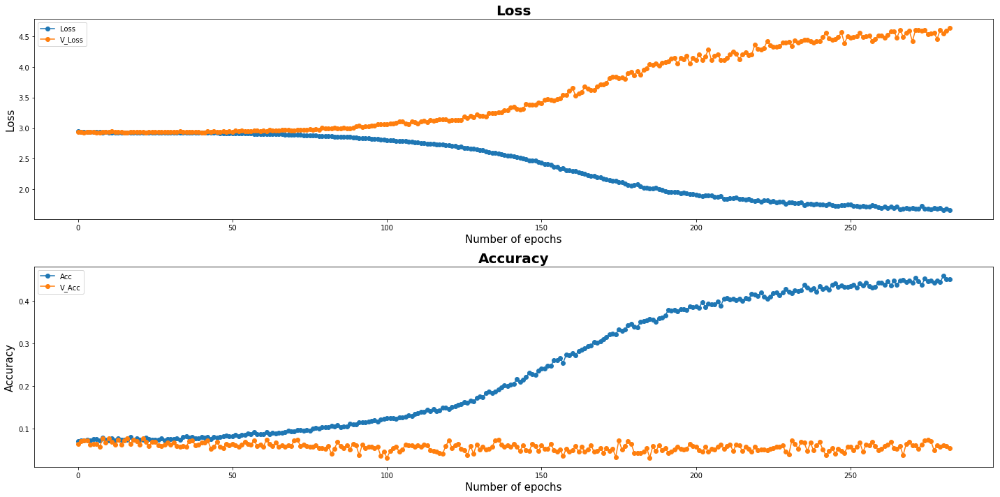

| Epoch [283] | Step [22650] | lr [0.009800] | Loss: [1.6501] | Acc: [0.4453] | Time: 0.0s
| Epoch [283] | Step [22700] | lr [0.009800] | Loss: [1.8307] | Acc: [0.3672] | Time: 0.0s
| Epoch [283] | Validation | Step [0] |  Loss: [4.5059] | Acc: [0.0703] | Time: 0.0s
| Epoch [283] | Validation | Step [1] |  Loss: [4.4840] | Acc: [0.0703] | Time: 0.0s
| Epoch [283] | Validation | Step [2] |  Loss: [4.6554] | Acc: [0.0391] | Time: 0.0s
| Epoch [283] | Validation | Step [3] |  Loss: [4.4534] | Acc: [0.0156] | Time: 0.0s


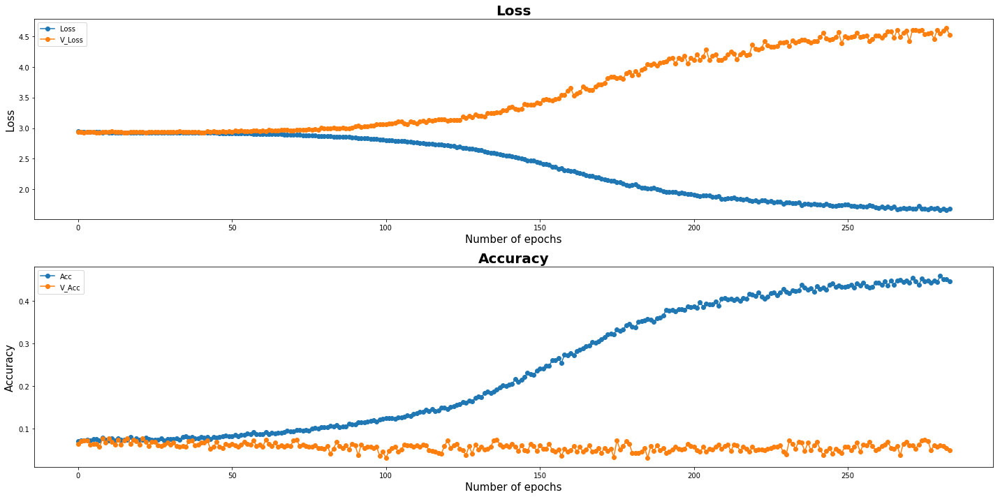

| Epoch [284] | Step [22750] | lr [0.009800] | Loss: [1.5337] | Acc: [0.5391] | Time: 0.0s
| Epoch [284] | Step [22800] | lr [0.009800] | Loss: [1.7801] | Acc: [0.3828] | Time: 0.0s
| Epoch [284] | Validation | Step [0] |  Loss: [4.4470] | Acc: [0.0703] | Time: 0.0s
| Epoch [284] | Validation | Step [1] |  Loss: [4.3848] | Acc: [0.0391] | Time: 0.0s
| Epoch [284] | Validation | Step [2] |  Loss: [4.6728] | Acc: [0.0547] | Time: 0.0s
| Epoch [284] | Validation | Step [3] |  Loss: [4.5769] | Acc: [0.0859] | Time: 0.0s


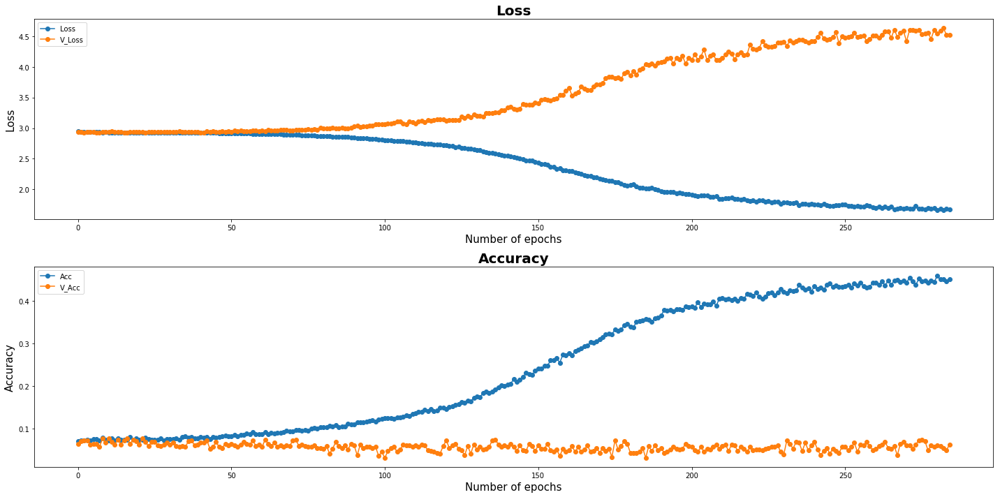

| Epoch [285] | Step [22850] | lr [0.009800] | Loss: [1.7239] | Acc: [0.4453] | Time: 0.0s
| Epoch [285] | Validation | Step [0] |  Loss: [4.6544] | Acc: [0.0547] | Time: 0.0s
| Epoch [285] | Validation | Step [1] |  Loss: [4.6173] | Acc: [0.0469] | Time: 0.0s
| Epoch [285] | Validation | Step [2] |  Loss: [4.3600] | Acc: [0.0781] | Time: 0.0s
| Epoch [285] | Validation | Step [3] |  Loss: [4.6507] | Acc: [0.0625] | Time: 0.0s


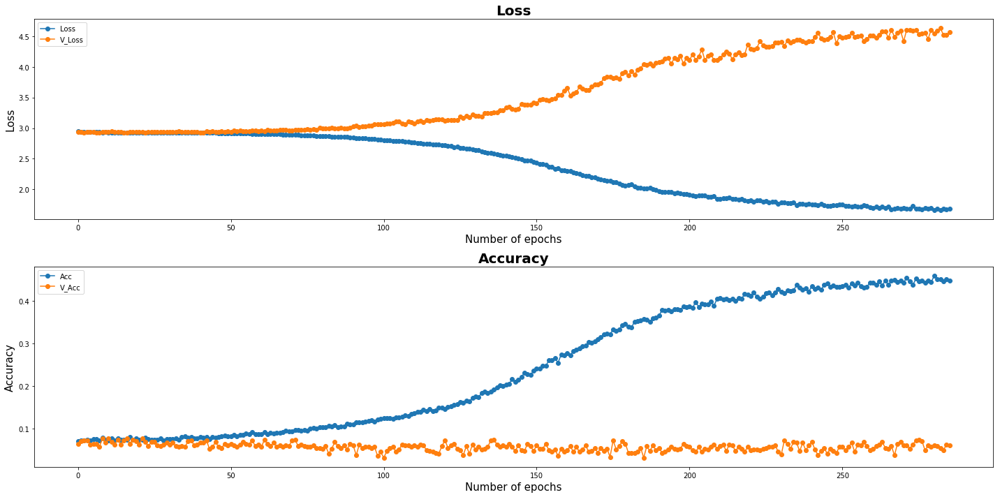

| Epoch [286] | Step [22900] | lr [0.009800] | Loss: [1.6226] | Acc: [0.4375] | Time: 0.0s
| Epoch [286] | Step [22950] | lr [0.009800] | Loss: [1.8165] | Acc: [0.4141] | Time: 0.0s
| Epoch [286] | Validation | Step [0] |  Loss: [4.4889] | Acc: [0.0703] | Time: 0.0s
| Epoch [286] | Validation | Step [1] |  Loss: [4.8981] | Acc: [0.0469] | Time: 0.0s
| Epoch [286] | Validation | Step [2] |  Loss: [4.5509] | Acc: [0.0625] | Time: 0.0s
| Epoch [286] | Validation | Step [3] |  Loss: [4.4615] | Acc: [0.0234] | Time: 0.0s


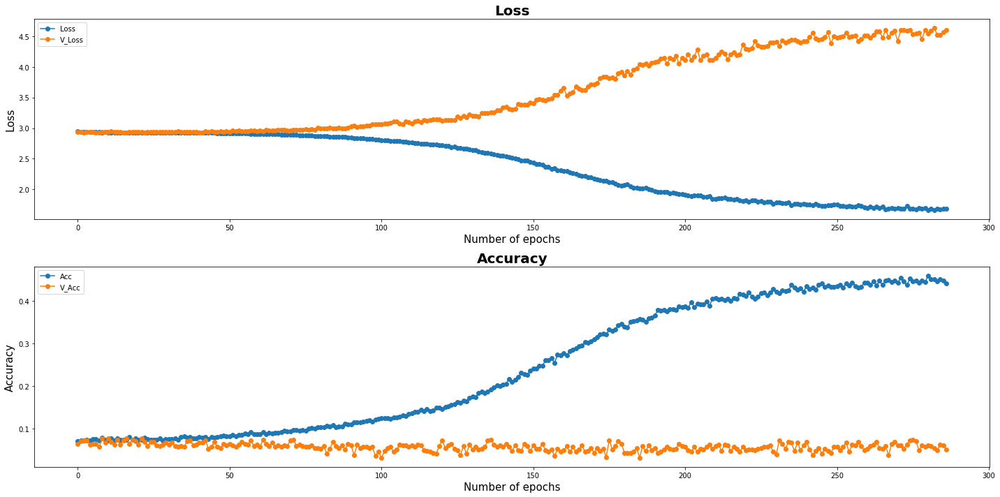

| Epoch [287] | Step [23000] | lr [0.009800] | Loss: [1.7040] | Acc: [0.4688] | Time: 0.0s
| Epoch [287] | Validation | Step [0] |  Loss: [4.4771] | Acc: [0.0625] | Time: 0.0s
| Epoch [287] | Validation | Step [1] |  Loss: [4.4565] | Acc: [0.0391] | Time: 0.0s
| Epoch [287] | Validation | Step [2] |  Loss: [4.7702] | Acc: [0.0312] | Time: 0.0s
| Epoch [287] | Validation | Step [3] |  Loss: [4.5452] | Acc: [0.0391] | Time: 0.0s


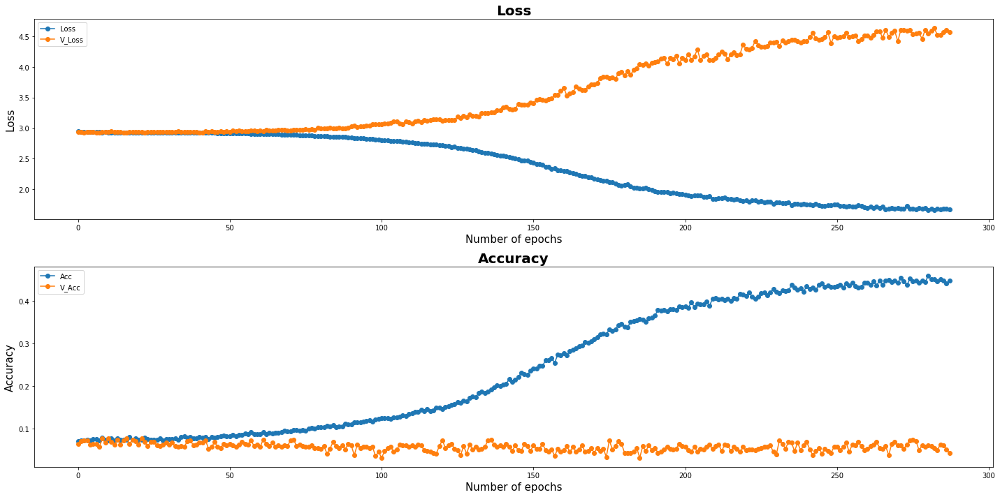

| Epoch [288] | Step [23050] | lr [0.009800] | Loss: [1.6013] | Acc: [0.4844] | Time: 0.0s
| Epoch [288] | Step [23100] | lr [0.009800] | Loss: [1.9138] | Acc: [0.3750] | Time: 0.0s
| Epoch [288] | Validation | Step [0] |  Loss: [4.6377] | Acc: [0.0547] | Time: 0.0s
| Epoch [288] | Validation | Step [1] |  Loss: [4.3013] | Acc: [0.0391] | Time: 0.0s
| Epoch [288] | Validation | Step [2] |  Loss: [4.8893] | Acc: [0.0625] | Time: 0.0s
| Epoch [288] | Validation | Step [3] |  Loss: [4.7207] | Acc: [0.0547] | Time: 0.0s


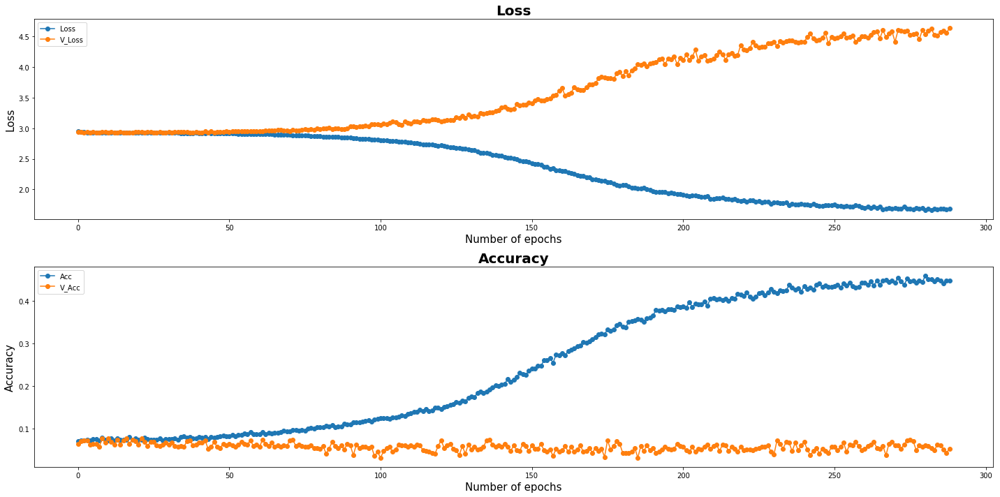

| Epoch [289] | Step [23150] | lr [0.009800] | Loss: [1.4340] | Acc: [0.5469] | Time: 0.0s
| Epoch [289] | Step [23200] | lr [0.009800] | Loss: [1.6193] | Acc: [0.4609] | Time: 0.0s
| Epoch [289] | Validation | Step [0] |  Loss: [4.6704] | Acc: [0.0391] | Time: 0.0s
| Epoch [289] | Validation | Step [1] |  Loss: [4.4848] | Acc: [0.0391] | Time: 0.0s
| Epoch [289] | Validation | Step [2] |  Loss: [4.7802] | Acc: [0.0703] | Time: 0.0s
| Epoch [289] | Validation | Step [3] |  Loss: [4.7027] | Acc: [0.0547] | Time: 0.0s


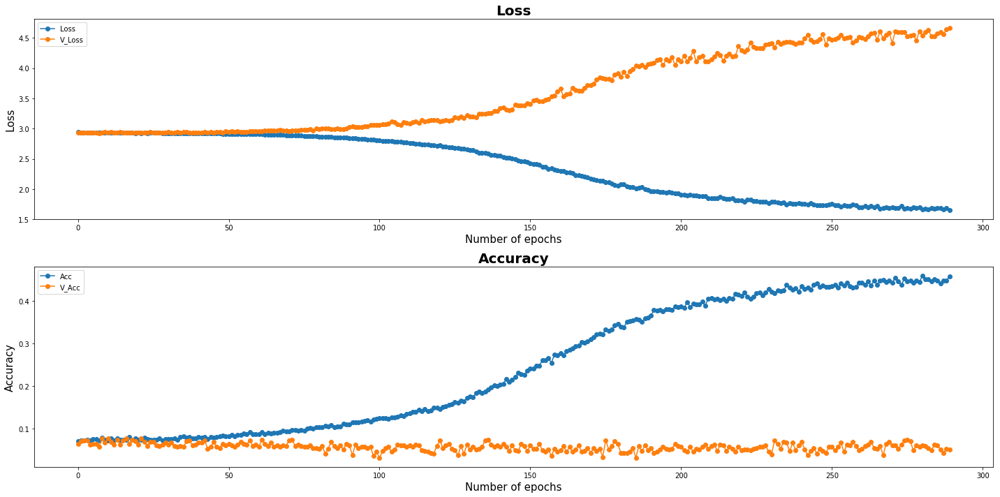

Model Saved
| Epoch [290] | Step [23250] | lr [0.009800] | Loss: [1.6840] | Acc: [0.4375] | Time: 0.0s
| Epoch [290] | Validation | Step [0] |  Loss: [4.7519] | Acc: [0.0625] | Time: 0.0s
| Epoch [290] | Validation | Step [1] |  Loss: [4.7451] | Acc: [0.0781] | Time: 0.0s
| Epoch [290] | Validation | Step [2] |  Loss: [4.4221] | Acc: [0.0625] | Time: 0.0s
| Epoch [290] | Validation | Step [3] |  Loss: [4.3359] | Acc: [0.0625] | Time: 0.0s


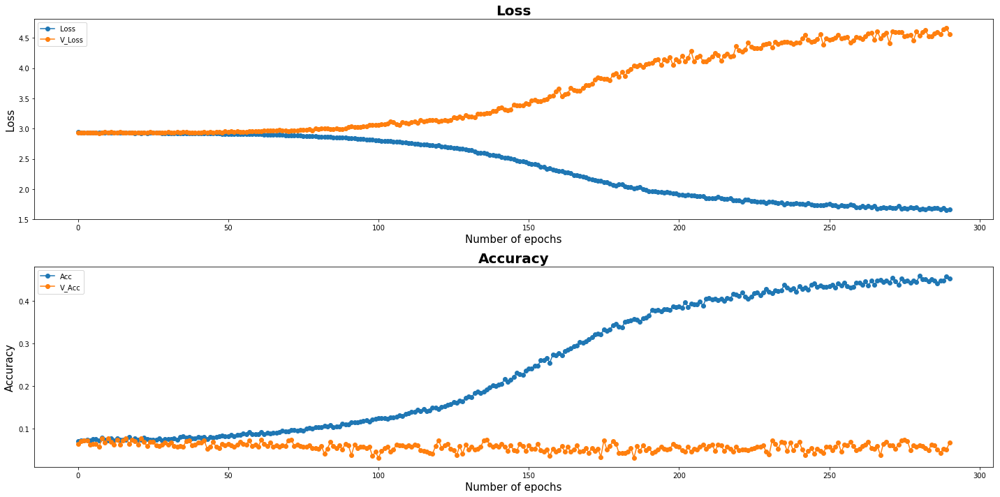

| Epoch [291] | Step [23300] | lr [0.009800] | Loss: [1.4832] | Acc: [0.4922] | Time: 0.0s
| Epoch [291] | Step [23350] | lr [0.009800] | Loss: [1.8590] | Acc: [0.4297] | Time: 0.0s
| Epoch [291] | Validation | Step [0] |  Loss: [4.2311] | Acc: [0.0781] | Time: 0.0s
| Epoch [291] | Validation | Step [1] |  Loss: [4.6515] | Acc: [0.0781] | Time: 0.0s
| Epoch [291] | Validation | Step [2] |  Loss: [4.6663] | Acc: [0.0781] | Time: 0.0s
| Epoch [291] | Validation | Step [3] |  Loss: [4.7244] | Acc: [0.0391] | Time: 0.0s


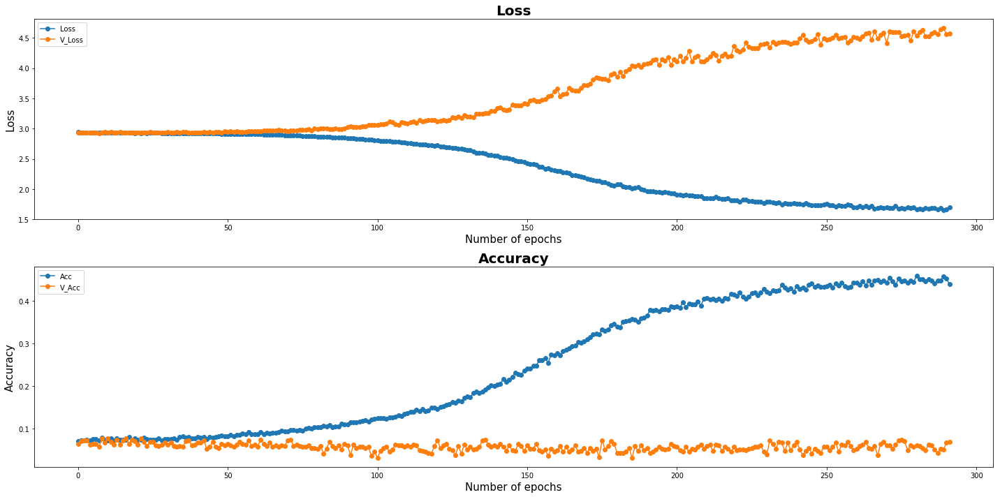

| Epoch [292] | Step [23400] | lr [0.006860] | Loss: [1.4544] | Acc: [0.5312] | Time: 0.0s
| Epoch [292] | Validation | Step [0] |  Loss: [4.3679] | Acc: [0.0547] | Time: 0.0s
| Epoch [292] | Validation | Step [1] |  Loss: [4.8753] | Acc: [0.0391] | Time: 0.0s
| Epoch [292] | Validation | Step [2] |  Loss: [4.6063] | Acc: [0.0469] | Time: 0.0s
| Epoch [292] | Validation | Step [3] |  Loss: [4.7855] | Acc: [0.0391] | Time: 0.0s


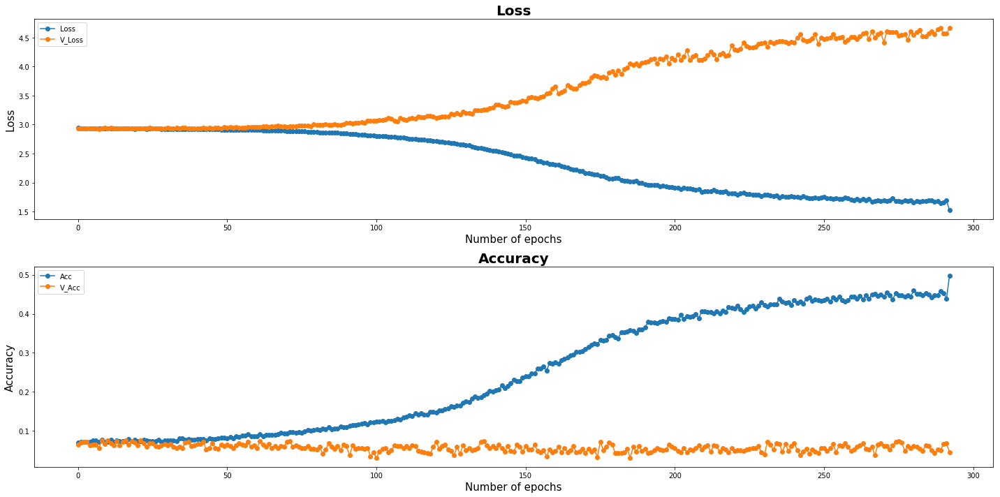

| Epoch [293] | Step [23450] | lr [0.006860] | Loss: [1.5320] | Acc: [0.4844] | Time: 0.0s
| Epoch [293] | Step [23500] | lr [0.006860] | Loss: [1.6726] | Acc: [0.4141] | Time: 0.0s
| Epoch [293] | Validation | Step [0] |  Loss: [4.5197] | Acc: [0.0547] | Time: 0.0s
| Epoch [293] | Validation | Step [1] |  Loss: [5.2196] | Acc: [0.0312] | Time: 0.0s
| Epoch [293] | Validation | Step [2] |  Loss: [4.8820] | Acc: [0.0781] | Time: 0.0s
| Epoch [293] | Validation | Step [3] |  Loss: [4.4383] | Acc: [0.0625] | Time: 0.0s


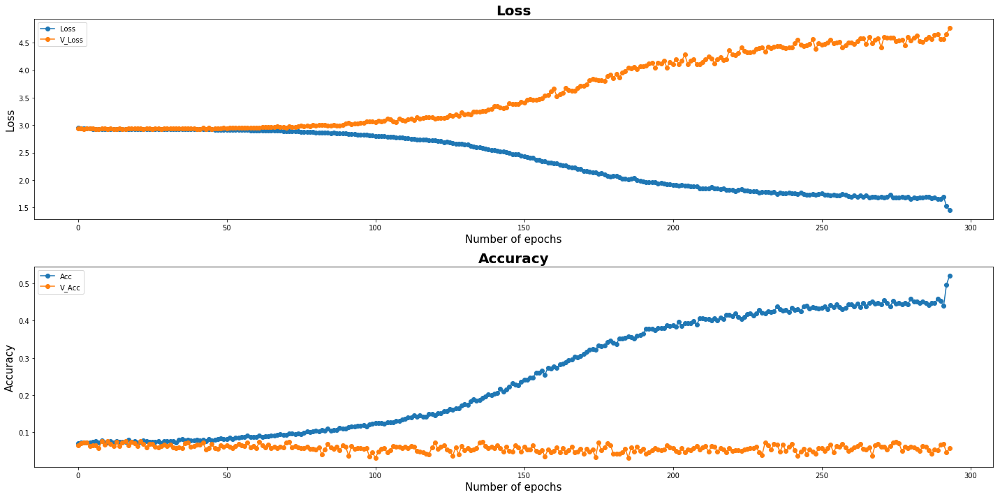

| Epoch [294] | Step [23550] | lr [0.006860] | Loss: [1.3556] | Acc: [0.5703] | Time: 0.0s
| Epoch [294] | Step [23600] | lr [0.006860] | Loss: [1.4469] | Acc: [0.5547] | Time: 0.0s
| Epoch [294] | Validation | Step [0] |  Loss: [4.2178] | Acc: [0.0938] | Time: 0.0s
| Epoch [294] | Validation | Step [1] |  Loss: [4.7708] | Acc: [0.0312] | Time: 0.0s
| Epoch [294] | Validation | Step [2] |  Loss: [5.1084] | Acc: [0.0625] | Time: 0.0s
| Epoch [294] | Validation | Step [3] |  Loss: [4.7962] | Acc: [0.0547] | Time: 0.0s


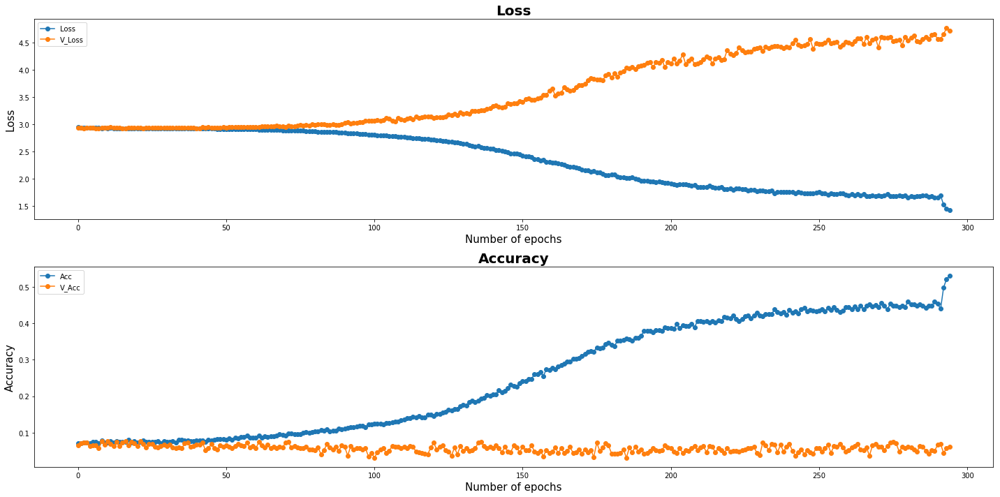

| Epoch [295] | Step [23650] | lr [0.006860] | Loss: [1.5932] | Acc: [0.4375] | Time: 0.0s
| Epoch [295] | Validation | Step [0] |  Loss: [4.8983] | Acc: [0.0391] | Time: 0.0s
| Epoch [295] | Validation | Step [1] |  Loss: [5.1860] | Acc: [0.0312] | Time: 0.0s
| Epoch [295] | Validation | Step [2] |  Loss: [4.6678] | Acc: [0.0547] | Time: 0.0s
| Epoch [295] | Validation | Step [3] |  Loss: [4.4942] | Acc: [0.0703] | Time: 0.0s


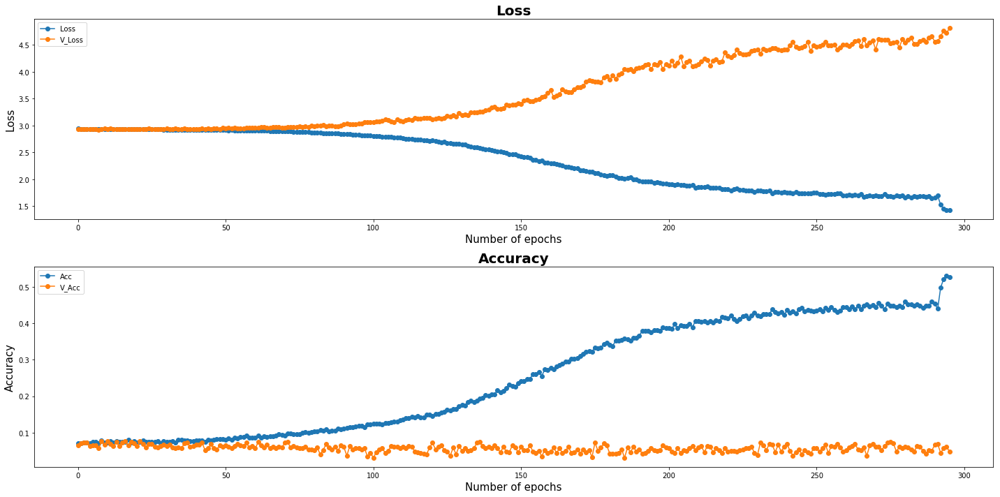

| Epoch [296] | Step [23700] | lr [0.006860] | Loss: [1.3609] | Acc: [0.5625] | Time: 0.0s
| Epoch [296] | Step [23750] | lr [0.006860] | Loss: [1.6325] | Acc: [0.4219] | Time: 0.0s
| Epoch [296] | Validation | Step [0] |  Loss: [4.6981] | Acc: [0.0625] | Time: 0.0s
| Epoch [296] | Validation | Step [1] |  Loss: [4.8587] | Acc: [0.0469] | Time: 0.0s
| Epoch [296] | Validation | Step [2] |  Loss: [5.0720] | Acc: [0.0703] | Time: 0.0s
| Epoch [296] | Validation | Step [3] |  Loss: [4.9202] | Acc: [0.0625] | Time: 0.0s


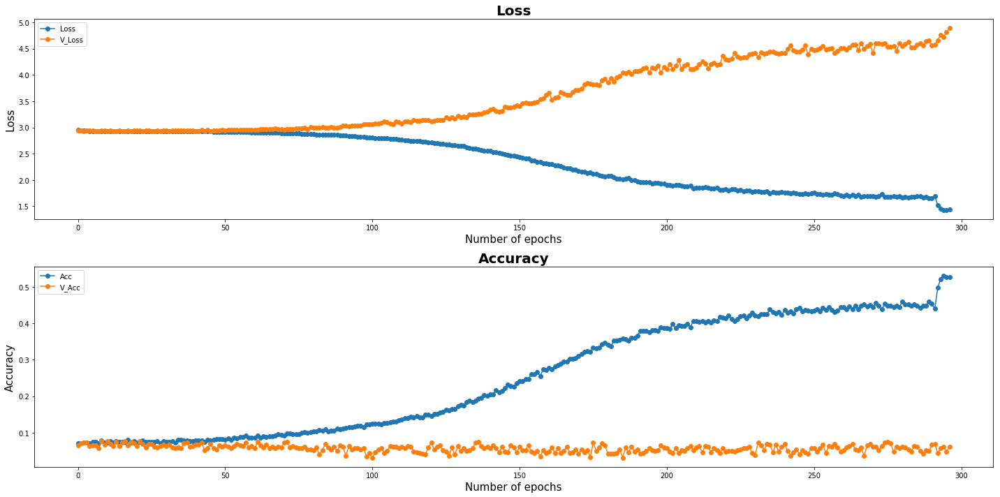

| Epoch [297] | Step [23800] | lr [0.006860] | Loss: [1.4997] | Acc: [0.4766] | Time: 0.0s
| Epoch [297] | Validation | Step [0] |  Loss: [4.6014] | Acc: [0.0781] | Time: 0.0s
| Epoch [297] | Validation | Step [1] |  Loss: [4.7479] | Acc: [0.0625] | Time: 0.0s
| Epoch [297] | Validation | Step [2] |  Loss: [4.6509] | Acc: [0.0703] | Time: 0.0s
| Epoch [297] | Validation | Step [3] |  Loss: [5.4539] | Acc: [0.0312] | Time: 0.0s


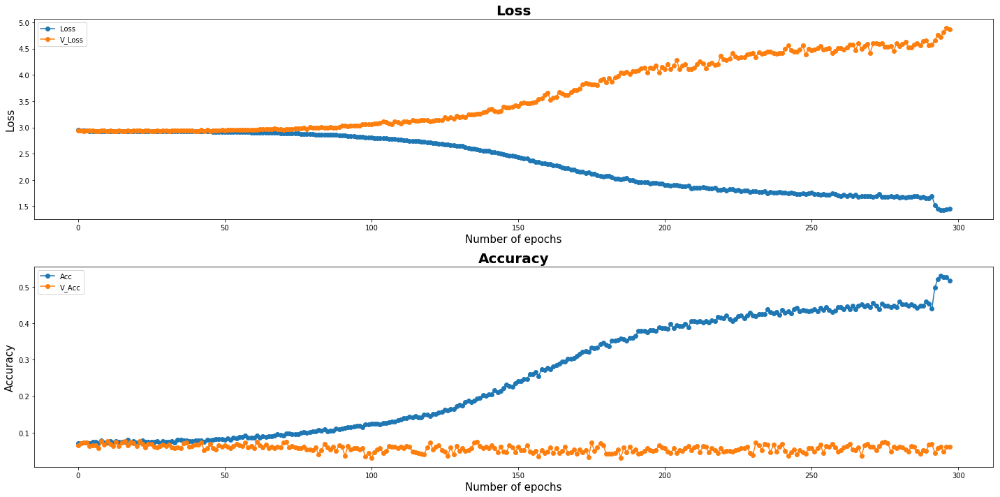

| Epoch [298] | Step [23850] | lr [0.006860] | Loss: [1.2603] | Acc: [0.5625] | Time: 0.0s
| Epoch [298] | Step [23900] | lr [0.006860] | Loss: [1.6286] | Acc: [0.4531] | Time: 0.0s
| Epoch [298] | Validation | Step [0] |  Loss: [4.6654] | Acc: [0.0469] | Time: 0.0s
| Epoch [298] | Validation | Step [1] |  Loss: [5.1418] | Acc: [0.0391] | Time: 0.0s
| Epoch [298] | Validation | Step [2] |  Loss: [4.9562] | Acc: [0.0625] | Time: 0.0s
| Epoch [298] | Validation | Step [3] |  Loss: [4.9222] | Acc: [0.0391] | Time: 0.0s


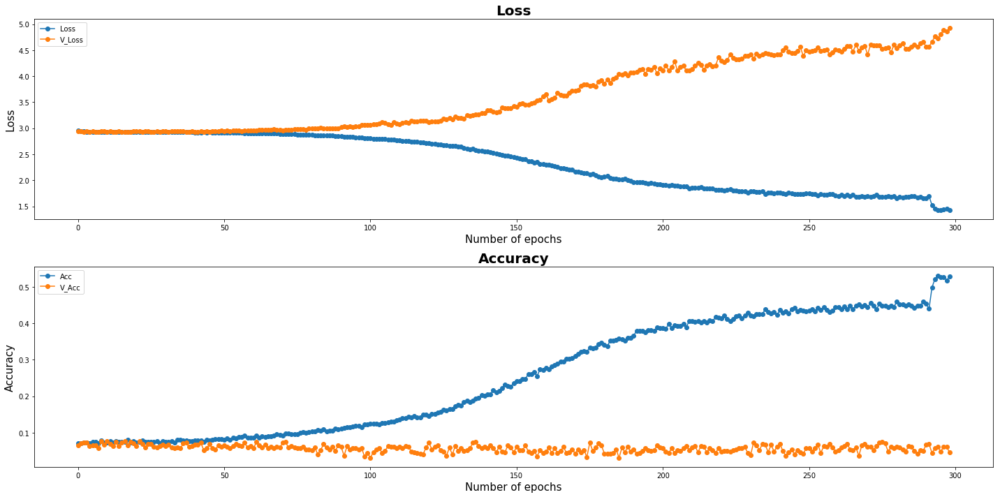

| Epoch [299] | Step [23950] | lr [0.006860] | Loss: [1.3955] | Acc: [0.5547] | Time: 0.0s
| Epoch [299] | Step [24000] | lr [0.006860] | Loss: [1.5220] | Acc: [0.4688] | Time: 0.0s
| Epoch [299] | Validation | Step [0] |  Loss: [5.1468] | Acc: [0.0469] | Time: 0.0s
| Epoch [299] | Validation | Step [1] |  Loss: [4.9010] | Acc: [0.0703] | Time: 0.0s
| Epoch [299] | Validation | Step [2] |  Loss: [5.2757] | Acc: [0.0625] | Time: 0.0s
| Epoch [299] | Validation | Step [3] |  Loss: [4.5220] | Acc: [0.0859] | Time: 0.0s


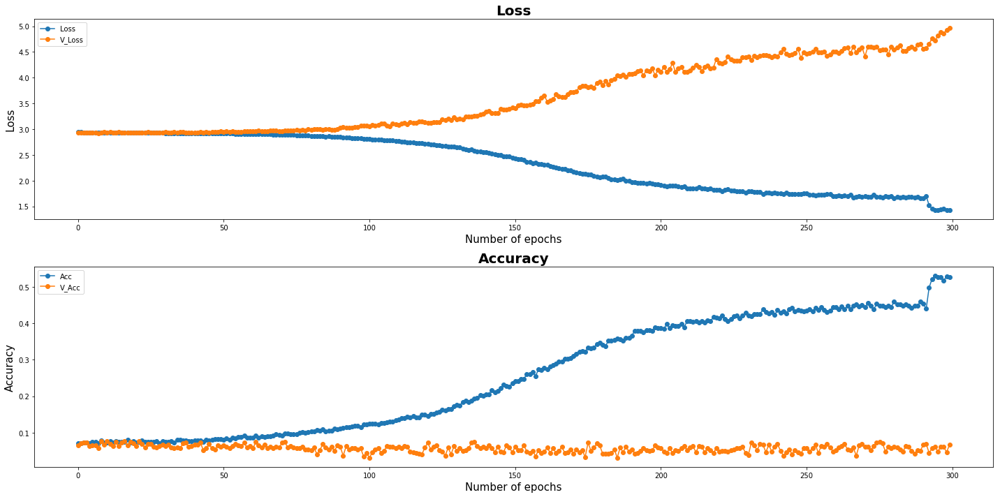

Model Saved
| Epoch [300] | Step [24050] | lr [0.006860] | Loss: [1.2632] | Acc: [0.6406] | Time: 0.0s
| Epoch [300] | Validation | Step [0] |  Loss: [4.9976] | Acc: [0.0547] | Time: 0.0s
| Epoch [300] | Validation | Step [1] |  Loss: [5.0599] | Acc: [0.0703] | Time: 0.0s
| Epoch [300] | Validation | Step [2] |  Loss: [4.8149] | Acc: [0.0547] | Time: 0.0s
| Epoch [300] | Validation | Step [3] |  Loss: [4.8562] | Acc: [0.0625] | Time: 0.0s


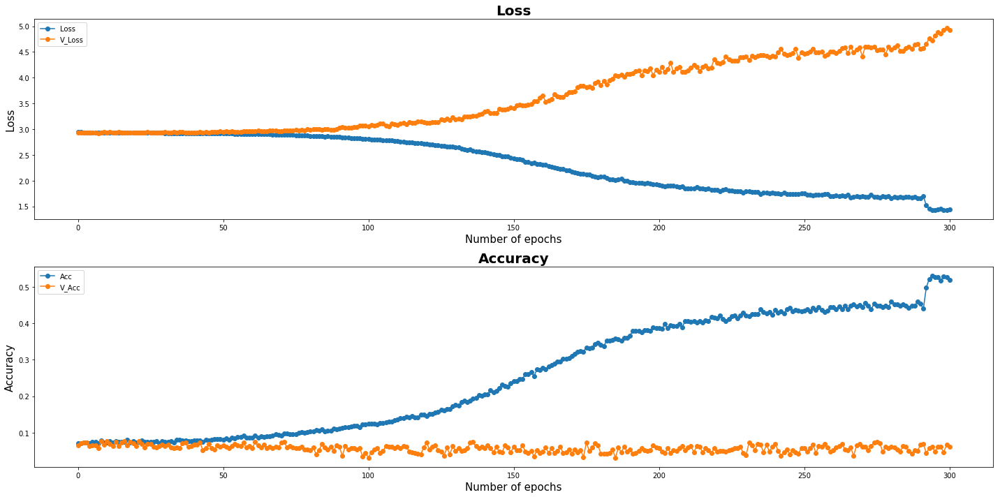

| Epoch [301] | Step [24100] | lr [0.006860] | Loss: [1.3899] | Acc: [0.5078] | Time: 0.0s
| Epoch [301] | Step [24150] | lr [0.006860] | Loss: [1.5645] | Acc: [0.4766] | Time: 0.0s
| Epoch [301] | Validation | Step [0] |  Loss: [4.9220] | Acc: [0.0625] | Time: 0.0s
| Epoch [301] | Validation | Step [1] |  Loss: [5.1246] | Acc: [0.0625] | Time: 0.0s
| Epoch [301] | Validation | Step [2] |  Loss: [5.1207] | Acc: [0.0391] | Time: 0.0s
| Epoch [301] | Validation | Step [3] |  Loss: [4.9008] | Acc: [0.0547] | Time: 0.0s


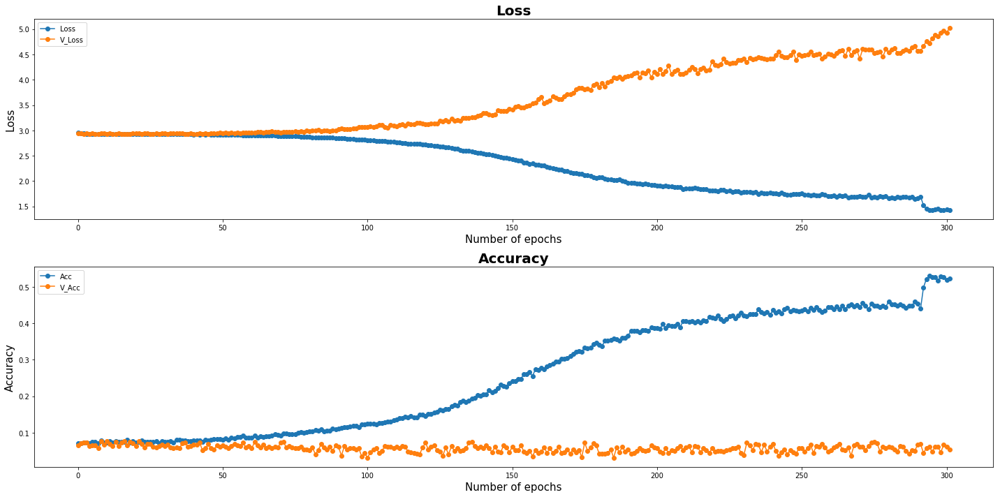

| Epoch [302] | Step [24200] | lr [0.006860] | Loss: [1.3813] | Acc: [0.5547] | Time: 0.0s
| Epoch [302] | Validation | Step [0] |  Loss: [5.1386] | Acc: [0.0625] | Time: 0.0s
| Epoch [302] | Validation | Step [1] |  Loss: [4.8183] | Acc: [0.0859] | Time: 0.0s
| Epoch [302] | Validation | Step [2] |  Loss: [4.9086] | Acc: [0.0781] | Time: 0.0s
| Epoch [302] | Validation | Step [3] |  Loss: [5.2753] | Acc: [0.0781] | Time: 0.0s


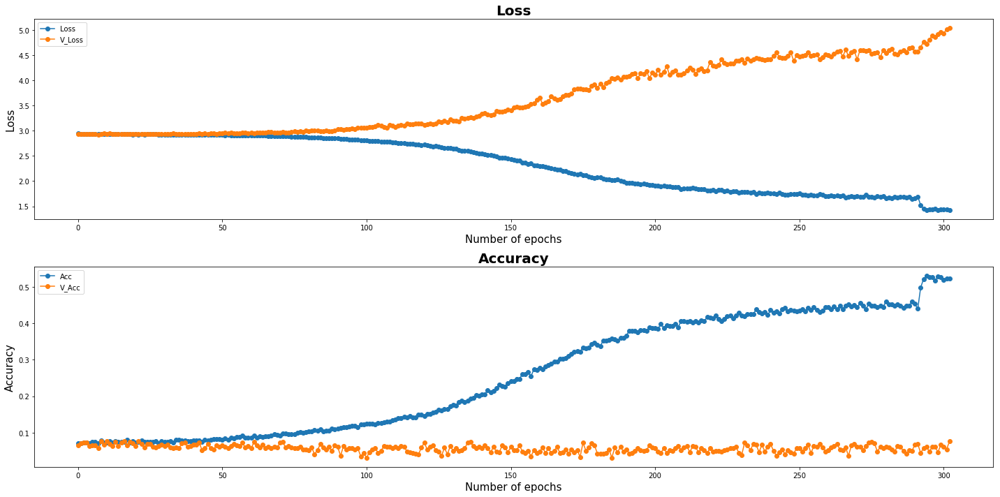

| Epoch [303] | Step [24250] | lr [0.006860] | Loss: [1.4328] | Acc: [0.5391] | Time: 0.0s
| Epoch [303] | Step [24300] | lr [0.006860] | Loss: [1.4893] | Acc: [0.5156] | Time: 0.0s
| Epoch [303] | Validation | Step [0] |  Loss: [5.1177] | Acc: [0.0859] | Time: 0.0s
| Epoch [303] | Validation | Step [1] |  Loss: [4.6857] | Acc: [0.0625] | Time: 0.0s
| Epoch [303] | Validation | Step [2] |  Loss: [4.9378] | Acc: [0.0469] | Time: 0.0s
| Epoch [303] | Validation | Step [3] |  Loss: [5.2312] | Acc: [0.0391] | Time: 0.0s


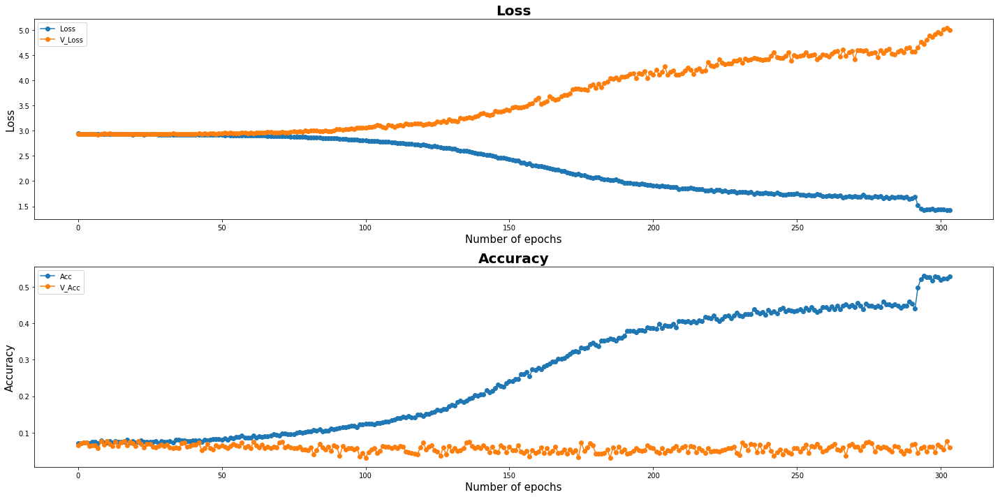

| Epoch [304] | Step [24350] | lr [0.006860] | Loss: [1.4442] | Acc: [0.5156] | Time: 0.0s
| Epoch [304] | Step [24400] | lr [0.006860] | Loss: [1.4092] | Acc: [0.4844] | Time: 0.0s
| Epoch [304] | Validation | Step [0] |  Loss: [4.6807] | Acc: [0.0703] | Time: 0.0s
| Epoch [304] | Validation | Step [1] |  Loss: [4.9587] | Acc: [0.0625] | Time: 0.0s
| Epoch [304] | Validation | Step [2] |  Loss: [4.9194] | Acc: [0.0781] | Time: 0.0s
| Epoch [304] | Validation | Step [3] |  Loss: [5.0057] | Acc: [0.0625] | Time: 0.0s


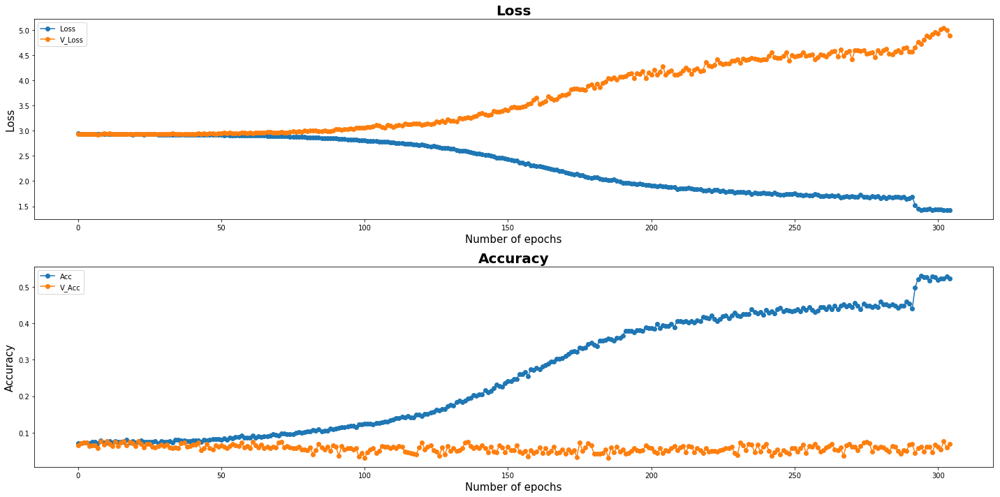

| Epoch [305] | Step [24450] | lr [0.006860] | Loss: [1.5119] | Acc: [0.4688] | Time: 0.0s
| Epoch [305] | Validation | Step [0] |  Loss: [5.4077] | Acc: [0.0469] | Time: 0.0s
| Epoch [305] | Validation | Step [1] |  Loss: [5.3101] | Acc: [0.0625] | Time: 0.0s
| Epoch [305] | Validation | Step [2] |  Loss: [4.6140] | Acc: [0.0781] | Time: 0.0s
| Epoch [305] | Validation | Step [3] |  Loss: [4.7703] | Acc: [0.0391] | Time: 0.0s


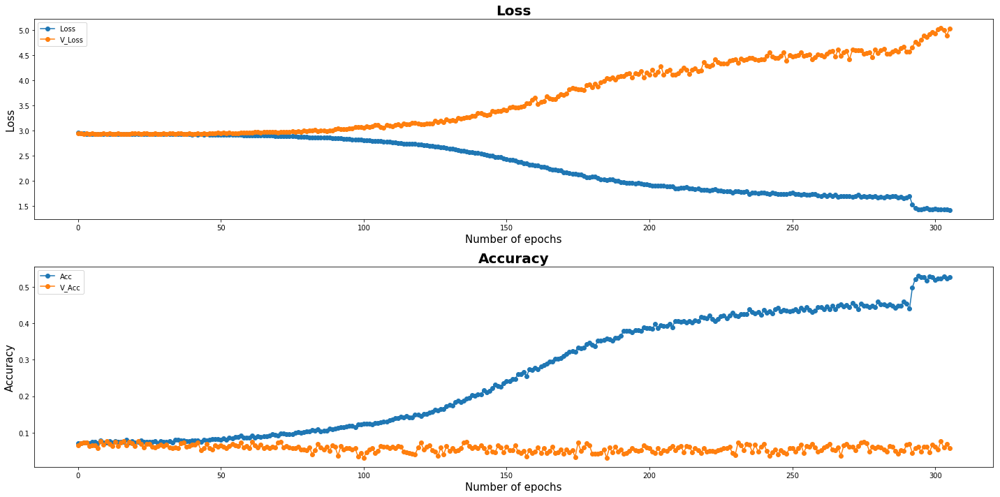

| Epoch [306] | Step [24500] | lr [0.004802] | Loss: [1.2974] | Acc: [0.5547] | Time: 0.0s
| Epoch [306] | Step [24550] | lr [0.004802] | Loss: [1.2922] | Acc: [0.5938] | Time: 0.0s
| Epoch [306] | Validation | Step [0] |  Loss: [5.1751] | Acc: [0.0703] | Time: 0.0s
| Epoch [306] | Validation | Step [1] |  Loss: [4.7891] | Acc: [0.1094] | Time: 0.0s
| Epoch [306] | Validation | Step [2] |  Loss: [5.3106] | Acc: [0.0469] | Time: 0.0s
| Epoch [306] | Validation | Step [3] |  Loss: [5.1541] | Acc: [0.0312] | Time: 0.0s


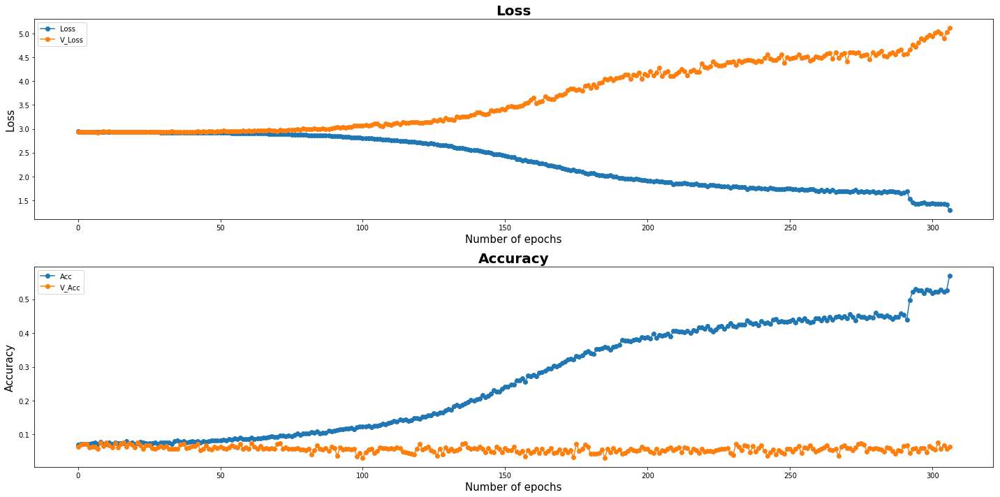

| Epoch [307] | Step [24600] | lr [0.004802] | Loss: [1.2193] | Acc: [0.5859] | Time: 0.0s
| Epoch [307] | Validation | Step [0] |  Loss: [5.2699] | Acc: [0.0391] | Time: 0.0s
| Epoch [307] | Validation | Step [1] |  Loss: [5.1139] | Acc: [0.0703] | Time: 0.0s
| Epoch [307] | Validation | Step [2] |  Loss: [5.0814] | Acc: [0.0859] | Time: 0.0s
| Epoch [307] | Validation | Step [3] |  Loss: [4.9570] | Acc: [0.0312] | Time: 0.0s


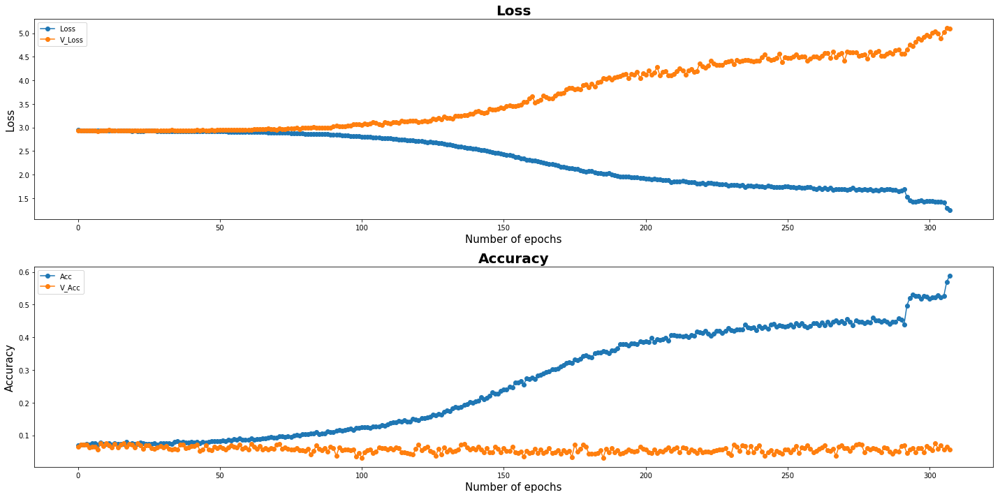

| Epoch [308] | Step [24650] | lr [0.004802] | Loss: [1.0211] | Acc: [0.7109] | Time: 0.0s
| Epoch [308] | Step [24700] | lr [0.004802] | Loss: [1.3157] | Acc: [0.5703] | Time: 0.0s
| Epoch [308] | Validation | Step [0] |  Loss: [4.9019] | Acc: [0.0703] | Time: 0.0s
| Epoch [308] | Validation | Step [1] |  Loss: [5.1324] | Acc: [0.0625] | Time: 0.0s
| Epoch [308] | Validation | Step [2] |  Loss: [5.7118] | Acc: [0.0234] | Time: 0.0s
| Epoch [308] | Validation | Step [3] |  Loss: [5.2373] | Acc: [0.0781] | Time: 0.0s


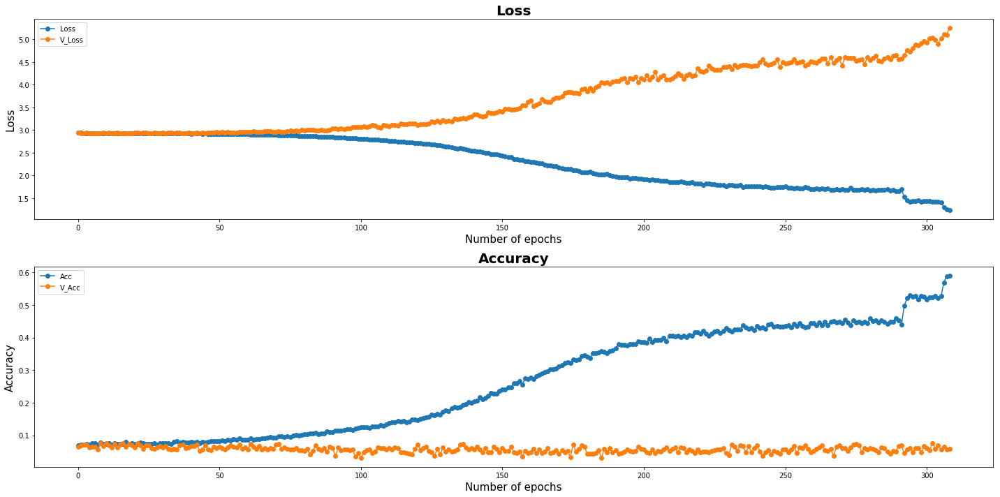

| Epoch [309] | Step [24750] | lr [0.004802] | Loss: [1.1998] | Acc: [0.6172] | Time: 0.0s
| Epoch [309] | Step [24800] | lr [0.004802] | Loss: [1.4790] | Acc: [0.4688] | Time: 0.0s
| Epoch [309] | Validation | Step [0] |  Loss: [5.1631] | Acc: [0.0859] | Time: 0.0s
| Epoch [309] | Validation | Step [1] |  Loss: [5.1471] | Acc: [0.0781] | Time: 0.0s
| Epoch [309] | Validation | Step [2] |  Loss: [5.5738] | Acc: [0.0469] | Time: 0.0s
| Epoch [309] | Validation | Step [3] |  Loss: [5.4065] | Acc: [0.0547] | Time: 0.0s


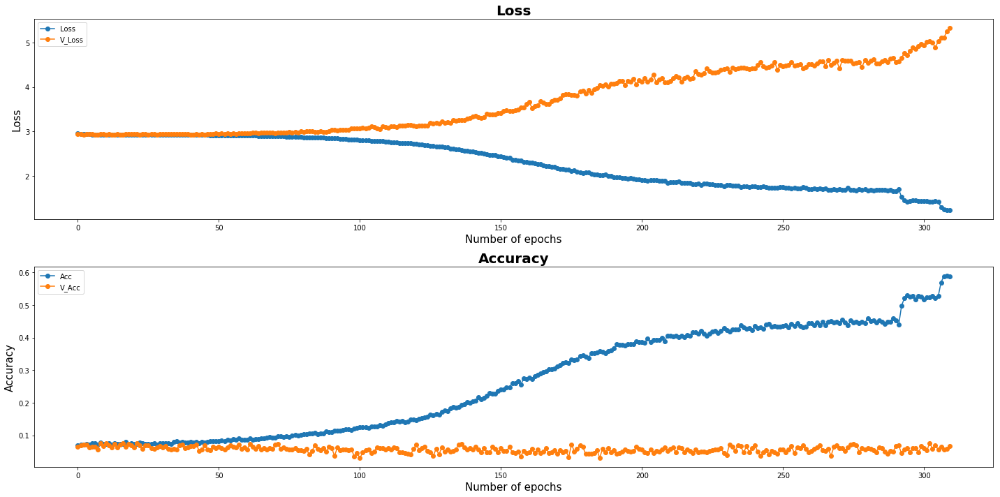

Model Saved
| Epoch [310] | Step [24850] | lr [0.004802] | Loss: [1.3926] | Acc: [0.4688] | Time: 0.0s
| Epoch [310] | Validation | Step [0] |  Loss: [5.3606] | Acc: [0.0703] | Time: 0.0s
| Epoch [310] | Validation | Step [1] |  Loss: [5.3811] | Acc: [0.0547] | Time: 0.0s
| Epoch [310] | Validation | Step [2] |  Loss: [5.3927] | Acc: [0.0703] | Time: 0.0s
| Epoch [310] | Validation | Step [3] |  Loss: [5.2382] | Acc: [0.0938] | Time: 0.0s


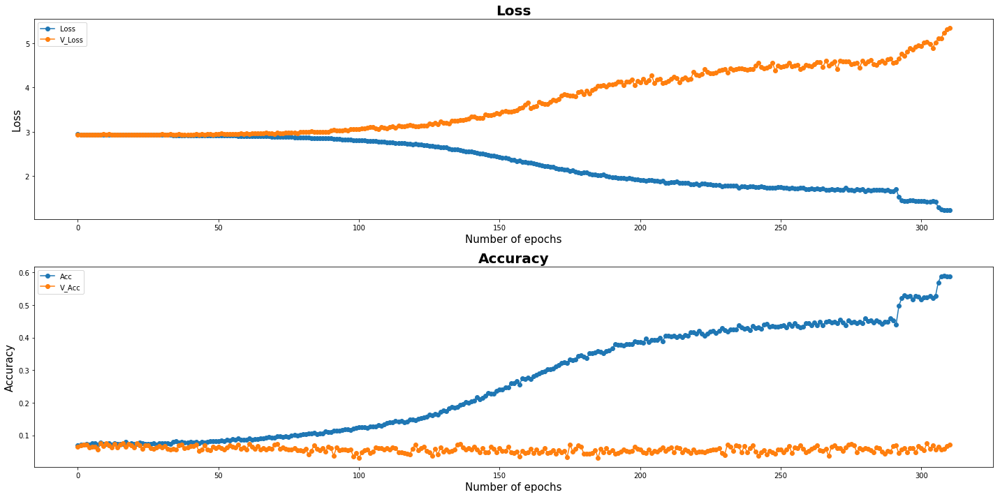

| Epoch [311] | Step [24900] | lr [0.004802] | Loss: [1.0453] | Acc: [0.6250] | Time: 0.0s
| Epoch [311] | Step [24950] | lr [0.004802] | Loss: [1.3250] | Acc: [0.5391] | Time: 0.0s
| Epoch [311] | Validation | Step [0] |  Loss: [5.4976] | Acc: [0.0078] | Time: 0.0s
| Epoch [311] | Validation | Step [1] |  Loss: [5.3192] | Acc: [0.0625] | Time: 0.0s
| Epoch [311] | Validation | Step [2] |  Loss: [5.1704] | Acc: [0.0781] | Time: 0.0s
| Epoch [311] | Validation | Step [3] |  Loss: [5.4338] | Acc: [0.0625] | Time: 0.0s


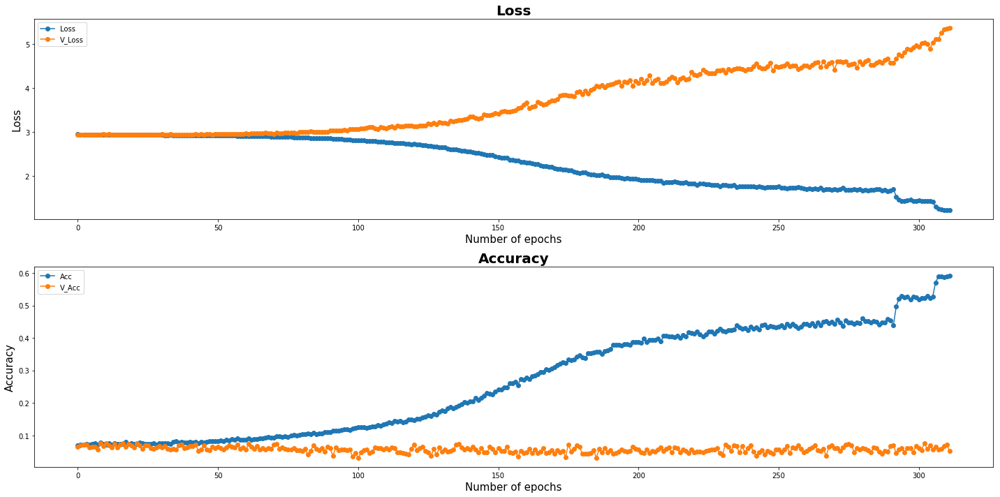

| Epoch [312] | Step [25000] | lr [0.004802] | Loss: [1.2241] | Acc: [0.6016] | Time: 0.0s
| Epoch [312] | Validation | Step [0] |  Loss: [5.5239] | Acc: [0.0781] | Time: 0.0s
| Epoch [312] | Validation | Step [1] |  Loss: [5.2492] | Acc: [0.0703] | Time: 0.0s
| Epoch [312] | Validation | Step [2] |  Loss: [5.0832] | Acc: [0.0781] | Time: 0.0s
| Epoch [312] | Validation | Step [3] |  Loss: [5.4845] | Acc: [0.0547] | Time: 0.0s


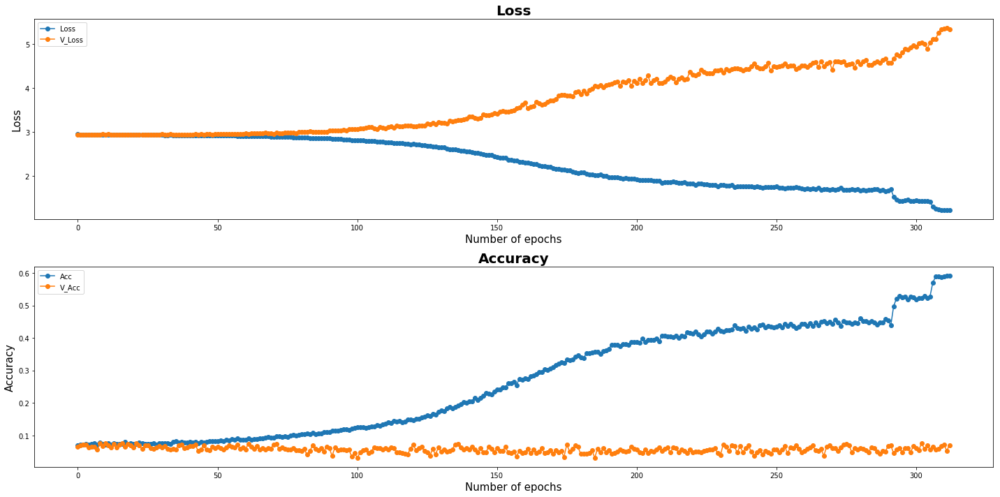

| Epoch [313] | Step [25050] | lr [0.004802] | Loss: [1.1128] | Acc: [0.6328] | Time: 0.0s
| Epoch [313] | Step [25100] | lr [0.004802] | Loss: [1.2316] | Acc: [0.5859] | Time: 0.0s
| Epoch [313] | Validation | Step [0] |  Loss: [5.7153] | Acc: [0.0469] | Time: 0.0s
| Epoch [313] | Validation | Step [1] |  Loss: [5.2525] | Acc: [0.0938] | Time: 0.0s
| Epoch [313] | Validation | Step [2] |  Loss: [4.9100] | Acc: [0.0781] | Time: 0.0s
| Epoch [313] | Validation | Step [3] |  Loss: [5.3758] | Acc: [0.0312] | Time: 0.0s


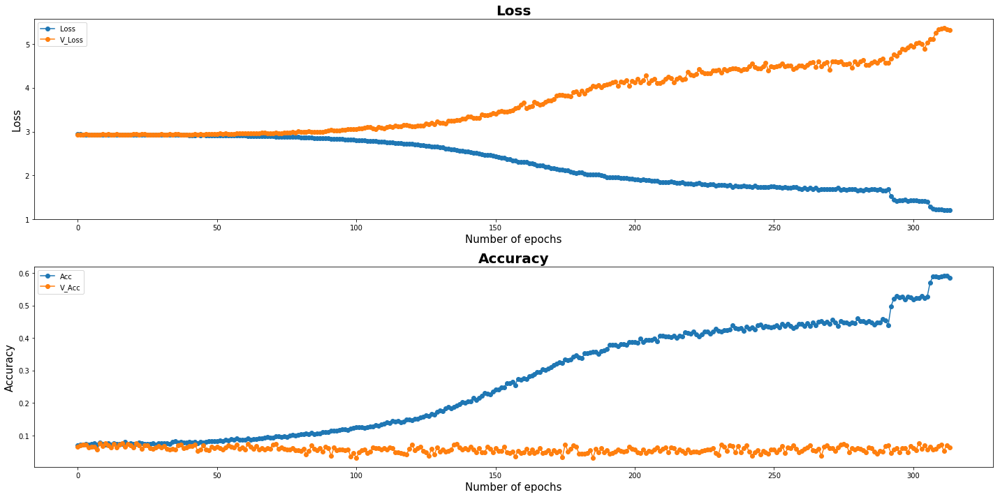

| Epoch [314] | Step [25150] | lr [0.004802] | Loss: [1.0789] | Acc: [0.6562] | Time: 0.0s
| Epoch [314] | Step [25200] | lr [0.004802] | Loss: [1.3436] | Acc: [0.5312] | Time: 0.0s
| Epoch [314] | Validation | Step [0] |  Loss: [5.4848] | Acc: [0.0625] | Time: 0.0s
| Epoch [314] | Validation | Step [1] |  Loss: [5.3805] | Acc: [0.0391] | Time: 0.0s
| Epoch [314] | Validation | Step [2] |  Loss: [5.4883] | Acc: [0.0469] | Time: 0.0s
| Epoch [314] | Validation | Step [3] |  Loss: [5.0680] | Acc: [0.0703] | Time: 0.0s


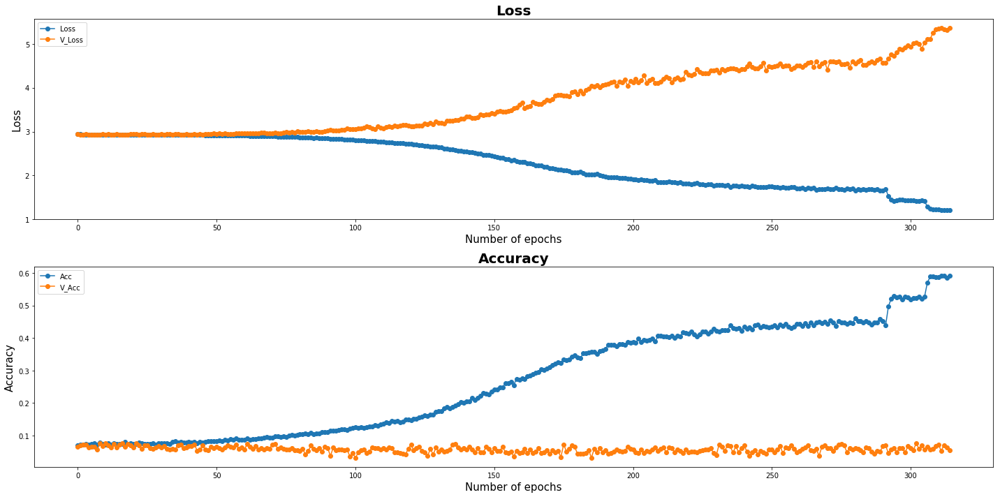

| Epoch [315] | Step [25250] | lr [0.004802] | Loss: [1.2060] | Acc: [0.5234] | Time: 0.0s
| Epoch [315] | Validation | Step [0] |  Loss: [5.5170] | Acc: [0.0703] | Time: 0.0s
| Epoch [315] | Validation | Step [1] |  Loss: [5.2736] | Acc: [0.0625] | Time: 0.0s
| Epoch [315] | Validation | Step [2] |  Loss: [5.5263] | Acc: [0.0391] | Time: 0.0s
| Epoch [315] | Validation | Step [3] |  Loss: [5.3501] | Acc: [0.0859] | Time: 0.0s


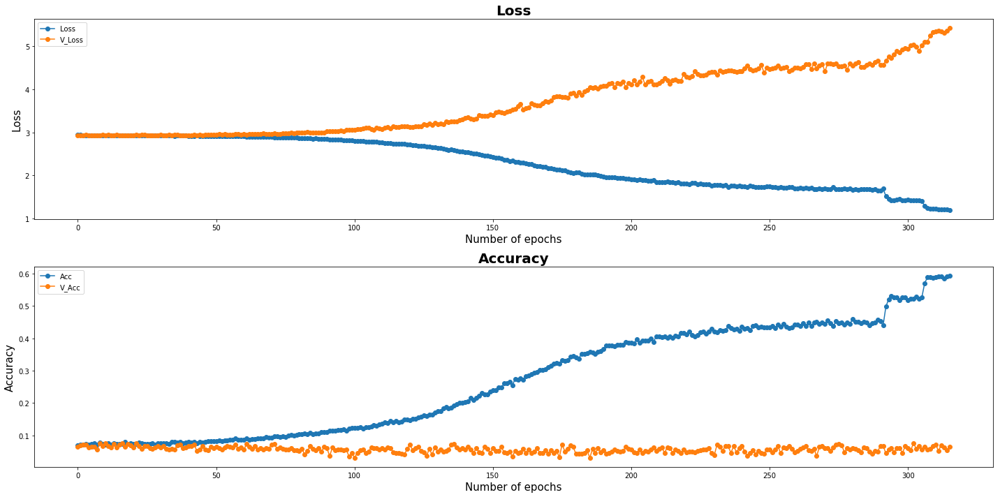

| Epoch [316] | Step [25300] | lr [0.004802] | Loss: [1.4096] | Acc: [0.4922] | Time: 0.0s
| Epoch [316] | Step [25350] | lr [0.004802] | Loss: [1.2878] | Acc: [0.5781] | Time: 0.0s
| Epoch [316] | Validation | Step [0] |  Loss: [5.0715] | Acc: [0.1016] | Time: 0.0s
| Epoch [316] | Validation | Step [1] |  Loss: [5.8496] | Acc: [0.0234] | Time: 0.0s
| Epoch [316] | Validation | Step [2] |  Loss: [5.3020] | Acc: [0.0938] | Time: 0.0s
| Epoch [316] | Validation | Step [3] |  Loss: [5.5131] | Acc: [0.0781] | Time: 0.0s


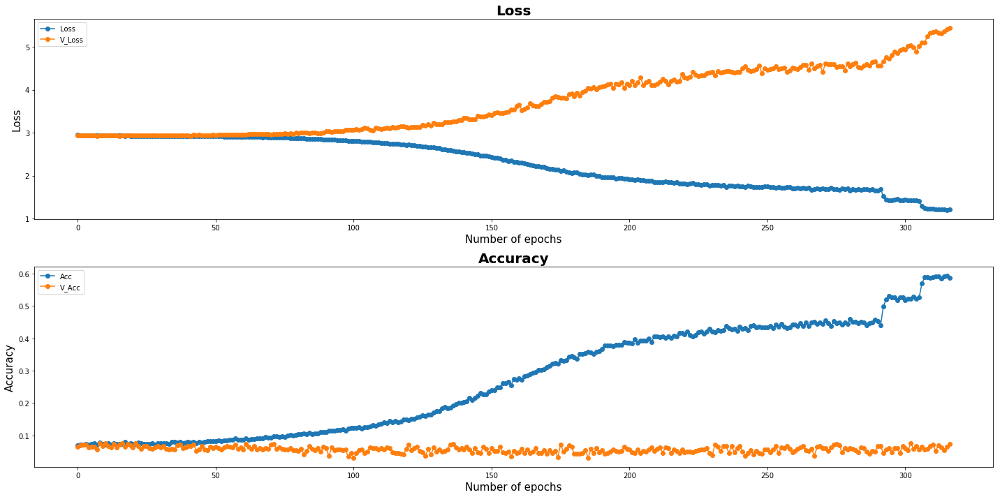

| Epoch [317] | Step [25400] | lr [0.004802] | Loss: [1.2083] | Acc: [0.5781] | Time: 0.0s
| Epoch [317] | Validation | Step [0] |  Loss: [5.5763] | Acc: [0.0469] | Time: 0.0s
| Epoch [317] | Validation | Step [1] |  Loss: [5.5486] | Acc: [0.0625] | Time: 0.0s
| Epoch [317] | Validation | Step [2] |  Loss: [5.2877] | Acc: [0.0547] | Time: 0.0s
| Epoch [317] | Validation | Step [3] |  Loss: [5.3099] | Acc: [0.0703] | Time: 0.0s


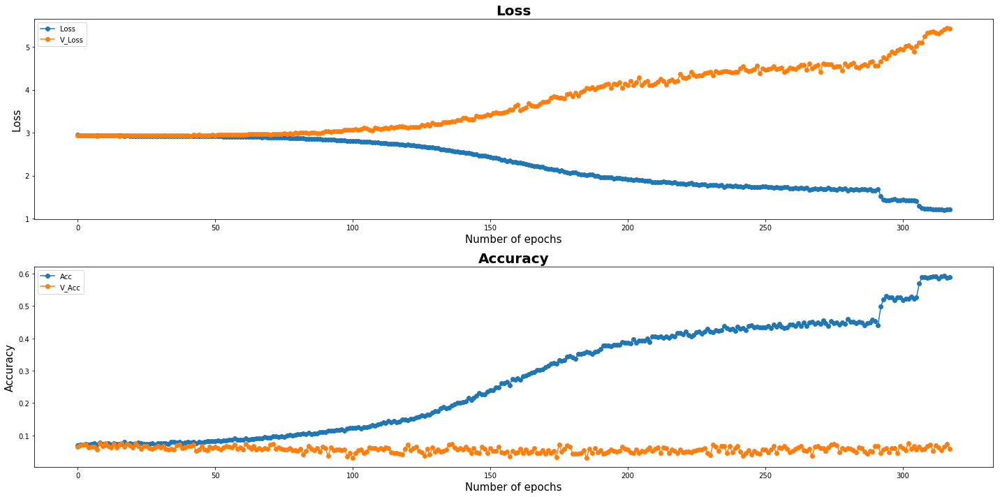

| Epoch [318] | Step [25450] | lr [0.004802] | Loss: [1.0749] | Acc: [0.6484] | Time: 0.0s
| Epoch [318] | Step [25500] | lr [0.004802] | Loss: [1.2200] | Acc: [0.5703] | Time: 0.0s
| Epoch [318] | Validation | Step [0] |  Loss: [5.6567] | Acc: [0.0938] | Time: 0.0s
| Epoch [318] | Validation | Step [1] |  Loss: [5.3718] | Acc: [0.0703] | Time: 0.0s
| Epoch [318] | Validation | Step [2] |  Loss: [5.2331] | Acc: [0.0703] | Time: 0.0s
| Epoch [318] | Validation | Step [3] |  Loss: [5.7118] | Acc: [0.0234] | Time: 0.0s


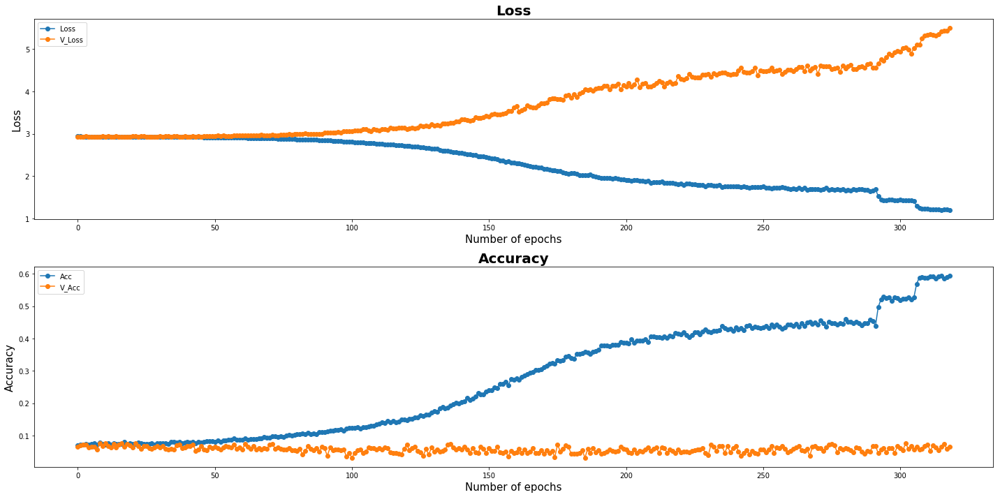

| Epoch [319] | Step [25550] | lr [0.004802] | Loss: [1.2146] | Acc: [0.5859] | Time: 0.0s
| Epoch [319] | Step [25600] | lr [0.004802] | Loss: [1.2581] | Acc: [0.5781] | Time: 0.0s
| Epoch [319] | Validation | Step [0] |  Loss: [5.0671] | Acc: [0.0625] | Time: 0.0s
| Epoch [319] | Validation | Step [1] |  Loss: [5.3178] | Acc: [0.0938] | Time: 0.0s
| Epoch [319] | Validation | Step [2] |  Loss: [5.9932] | Acc: [0.0391] | Time: 0.0s
| Epoch [319] | Validation | Step [3] |  Loss: [5.3559] | Acc: [0.0469] | Time: 0.0s


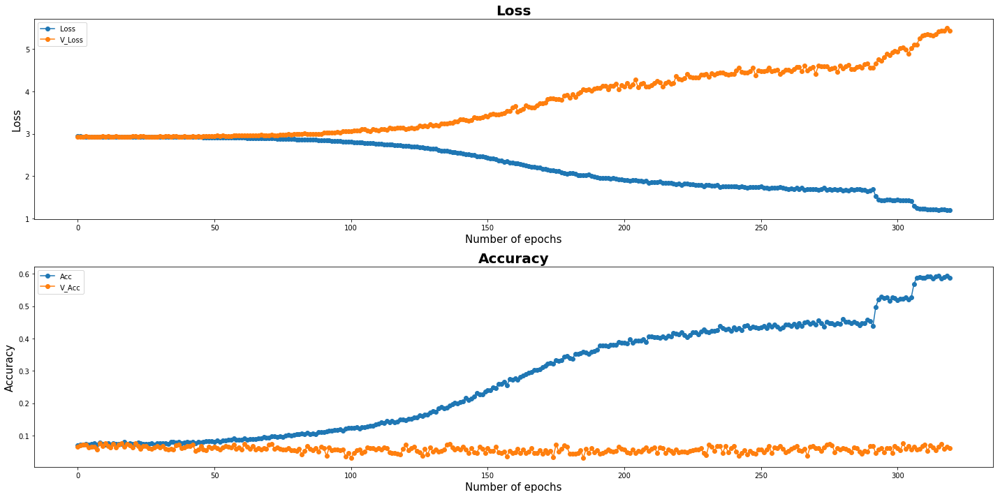

Model Saved
| Epoch [320] | Step [25650] | lr [0.004802] | Loss: [1.2924] | Acc: [0.5156] | Time: 0.0s
| Epoch [320] | Validation | Step [0] |  Loss: [5.4787] | Acc: [0.0391] | Time: 0.0s
| Epoch [320] | Validation | Step [1] |  Loss: [5.7708] | Acc: [0.0703] | Time: 0.0s
| Epoch [320] | Validation | Step [2] |  Loss: [5.5248] | Acc: [0.0781] | Time: 0.0s
| Epoch [320] | Validation | Step [3] |  Loss: [5.1223] | Acc: [0.0547] | Time: 0.0s


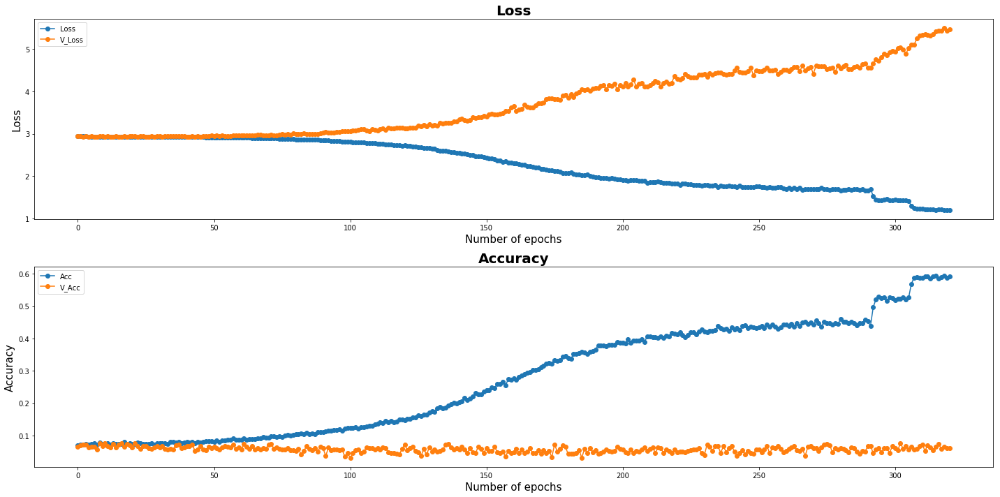

| Epoch [321] | Step [25700] | lr [0.004802] | Loss: [1.1063] | Acc: [0.6562] | Time: 0.0s
| Epoch [321] | Step [25750] | lr [0.004802] | Loss: [1.2676] | Acc: [0.5547] | Time: 0.0s
| Epoch [321] | Validation | Step [0] |  Loss: [5.6523] | Acc: [0.0312] | Time: 0.0s
| Epoch [321] | Validation | Step [1] |  Loss: [5.0078] | Acc: [0.1016] | Time: 0.0s
| Epoch [321] | Validation | Step [2] |  Loss: [5.4781] | Acc: [0.0703] | Time: 0.0s
| Epoch [321] | Validation | Step [3] |  Loss: [5.8917] | Acc: [0.0391] | Time: 0.0s


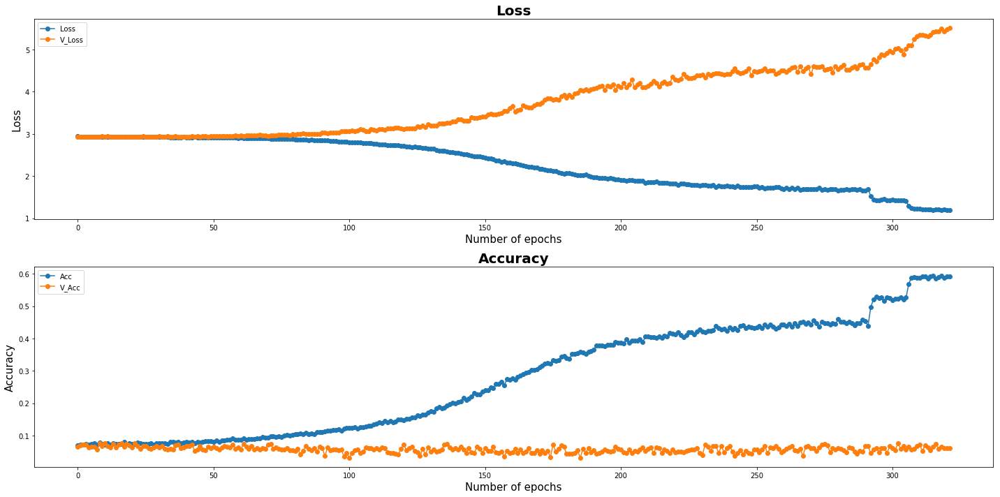

| Epoch [322] | Step [25800] | lr [0.004802] | Loss: [1.0420] | Acc: [0.6406] | Time: 0.0s
| Epoch [322] | Validation | Step [0] |  Loss: [5.9507] | Acc: [0.0703] | Time: 0.0s
| Epoch [322] | Validation | Step [1] |  Loss: [5.4560] | Acc: [0.0547] | Time: 0.0s
| Epoch [322] | Validation | Step [2] |  Loss: [5.5196] | Acc: [0.0625] | Time: 0.0s
| Epoch [322] | Validation | Step [3] |  Loss: [4.8020] | Acc: [0.0625] | Time: 0.0s


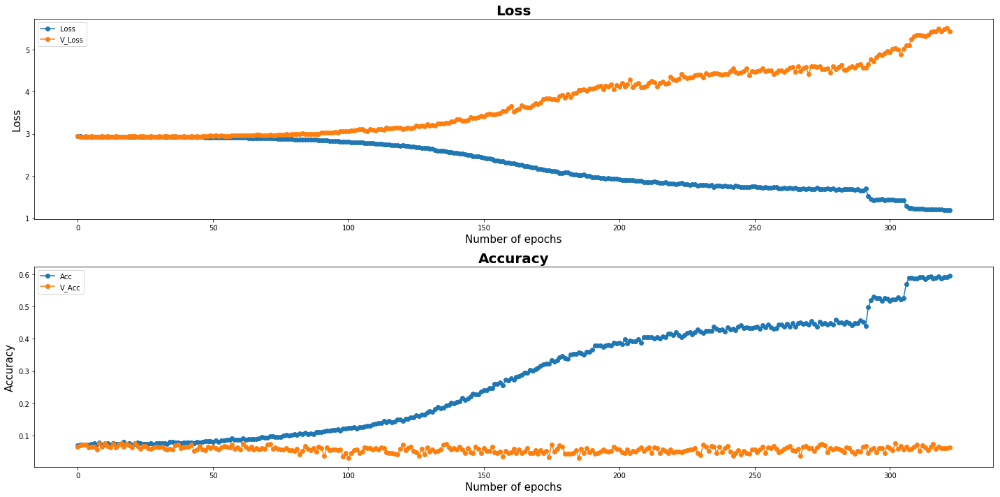

| Epoch [323] | Step [25850] | lr [0.004802] | Loss: [1.0985] | Acc: [0.6094] | Time: 0.0s
| Epoch [323] | Step [25900] | lr [0.004802] | Loss: [1.1307] | Acc: [0.6172] | Time: 0.0s
| Epoch [323] | Validation | Step [0] |  Loss: [5.2068] | Acc: [0.0938] | Time: 0.0s
| Epoch [323] | Validation | Step [1] |  Loss: [5.6019] | Acc: [0.0547] | Time: 0.0s
| Epoch [323] | Validation | Step [2] |  Loss: [5.1988] | Acc: [0.0938] | Time: 0.0s
| Epoch [323] | Validation | Step [3] |  Loss: [5.6753] | Acc: [0.0391] | Time: 0.0s


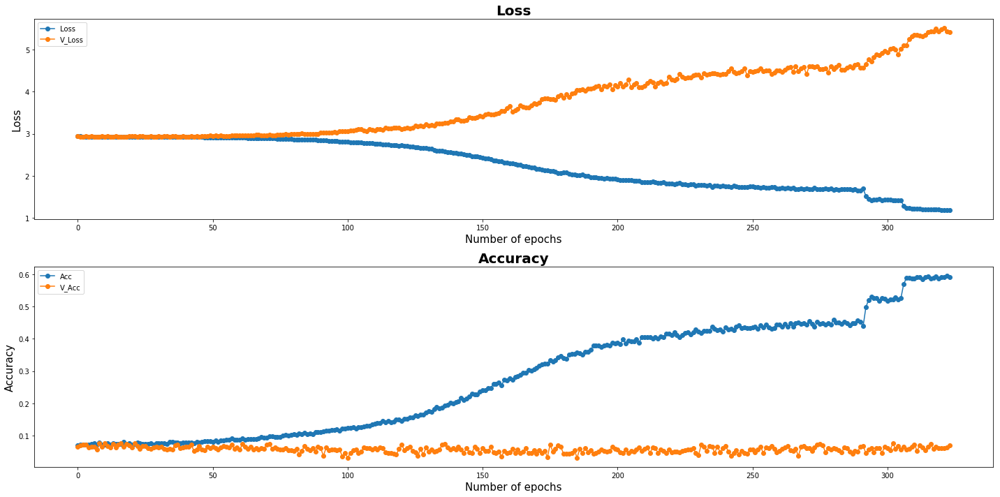

| Epoch [324] | Step [25950] | lr [0.004802] | Loss: [1.0856] | Acc: [0.6172] | Time: 0.0s
| Epoch [324] | Step [26000] | lr [0.004802] | Loss: [1.2556] | Acc: [0.6016] | Time: 0.0s
| Epoch [324] | Validation | Step [0] |  Loss: [5.9910] | Acc: [0.0391] | Time: 0.0s
| Epoch [324] | Validation | Step [1] |  Loss: [5.2233] | Acc: [0.0703] | Time: 0.0s
| Epoch [324] | Validation | Step [2] |  Loss: [5.2883] | Acc: [0.0938] | Time: 0.0s
| Epoch [324] | Validation | Step [3] |  Loss: [5.4196] | Acc: [0.0391] | Time: 0.0s


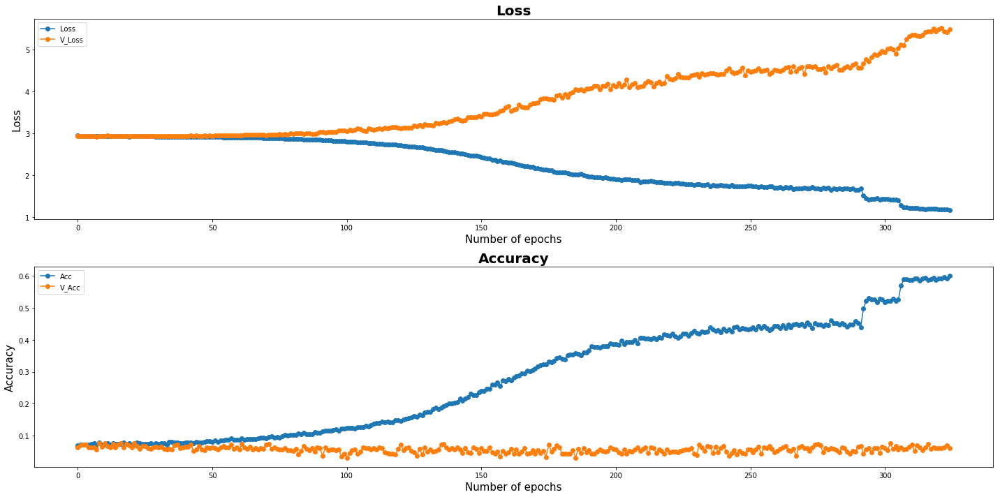

| Epoch [325] | Step [26050] | lr [0.004802] | Loss: [1.2441] | Acc: [0.6094] | Time: 0.0s
| Epoch [325] | Validation | Step [0] |  Loss: [5.6584] | Acc: [0.0469] | Time: 0.0s
| Epoch [325] | Validation | Step [1] |  Loss: [5.7373] | Acc: [0.0781] | Time: 0.0s
| Epoch [325] | Validation | Step [2] |  Loss: [5.4013] | Acc: [0.0781] | Time: 0.0s
| Epoch [325] | Validation | Step [3] |  Loss: [5.6234] | Acc: [0.0703] | Time: 0.0s


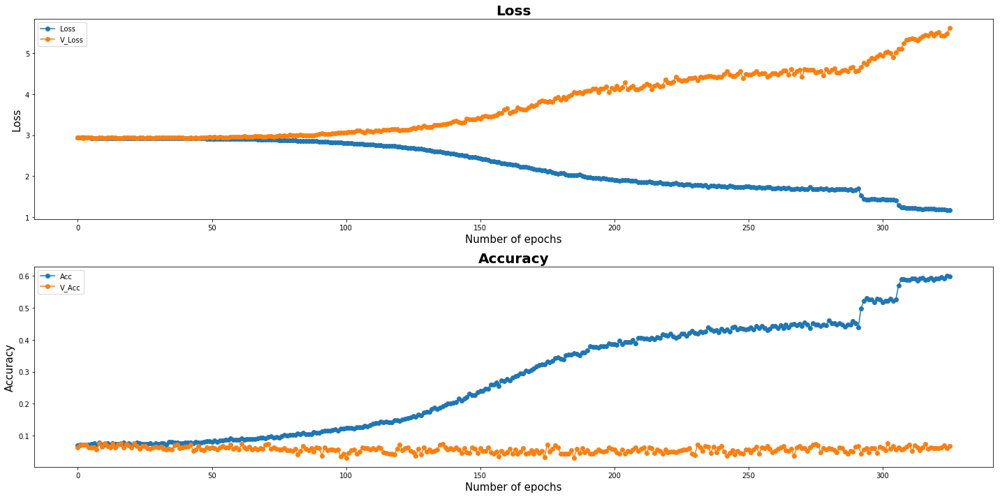

| Epoch [326] | Step [26100] | lr [0.004802] | Loss: [1.2045] | Acc: [0.6172] | Time: 0.0s
| Epoch [326] | Step [26150] | lr [0.004802] | Loss: [1.2804] | Acc: [0.5625] | Time: 0.0s
| Epoch [326] | Validation | Step [0] |  Loss: [5.4555] | Acc: [0.0703] | Time: 0.0s
| Epoch [326] | Validation | Step [1] |  Loss: [5.9276] | Acc: [0.0234] | Time: 0.0s
| Epoch [326] | Validation | Step [2] |  Loss: [5.2189] | Acc: [0.0859] | Time: 0.0s
| Epoch [326] | Validation | Step [3] |  Loss: [5.5917] | Acc: [0.0469] | Time: 0.0s


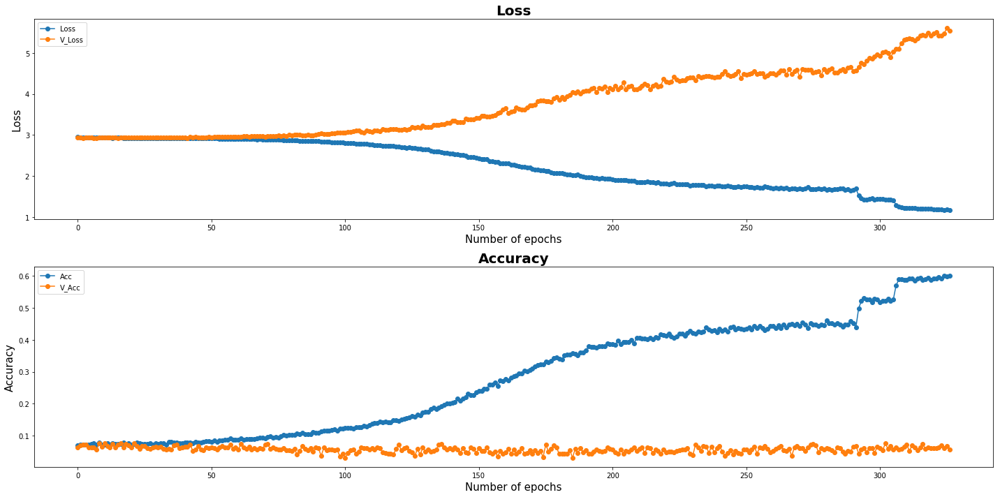

| Epoch [327] | Step [26200] | lr [0.004802] | Loss: [1.2729] | Acc: [0.5312] | Time: 0.0s
| Epoch [327] | Validation | Step [0] |  Loss: [5.4264] | Acc: [0.0234] | Time: 0.0s
| Epoch [327] | Validation | Step [1] |  Loss: [5.2688] | Acc: [0.0469] | Time: 0.0s
| Epoch [327] | Validation | Step [2] |  Loss: [6.0703] | Acc: [0.0625] | Time: 0.0s
| Epoch [327] | Validation | Step [3] |  Loss: [5.5772] | Acc: [0.0469] | Time: 0.0s


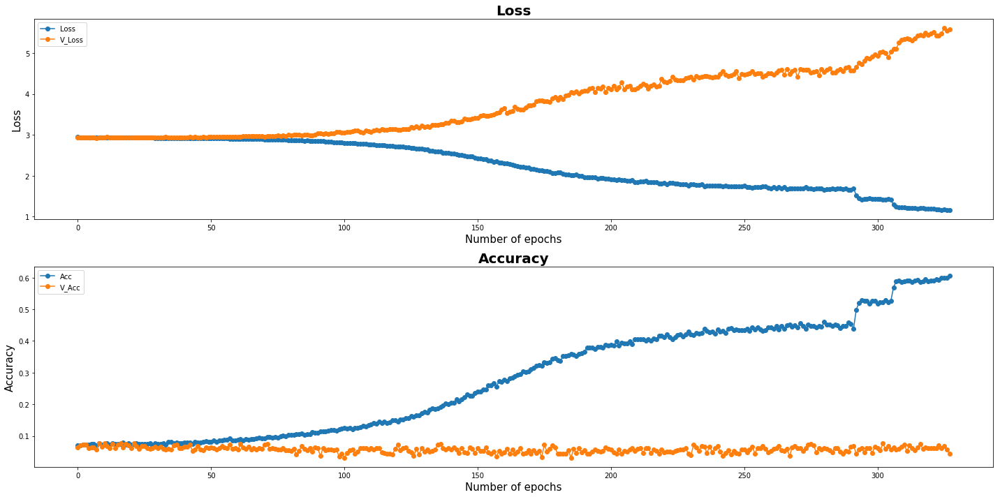

| Epoch [328] | Step [26250] | lr [0.004802] | Loss: [1.1070] | Acc: [0.6328] | Time: 0.0s
| Epoch [328] | Step [26300] | lr [0.004802] | Loss: [1.2245] | Acc: [0.5625] | Time: 0.0s
| Epoch [328] | Validation | Step [0] |  Loss: [5.8578] | Acc: [0.0312] | Time: 0.0s
| Epoch [328] | Validation | Step [1] |  Loss: [5.6995] | Acc: [0.0625] | Time: 0.0s
| Epoch [328] | Validation | Step [2] |  Loss: [5.7527] | Acc: [0.0625] | Time: 0.0s
| Epoch [328] | Validation | Step [3] |  Loss: [5.5189] | Acc: [0.0234] | Time: 0.0s


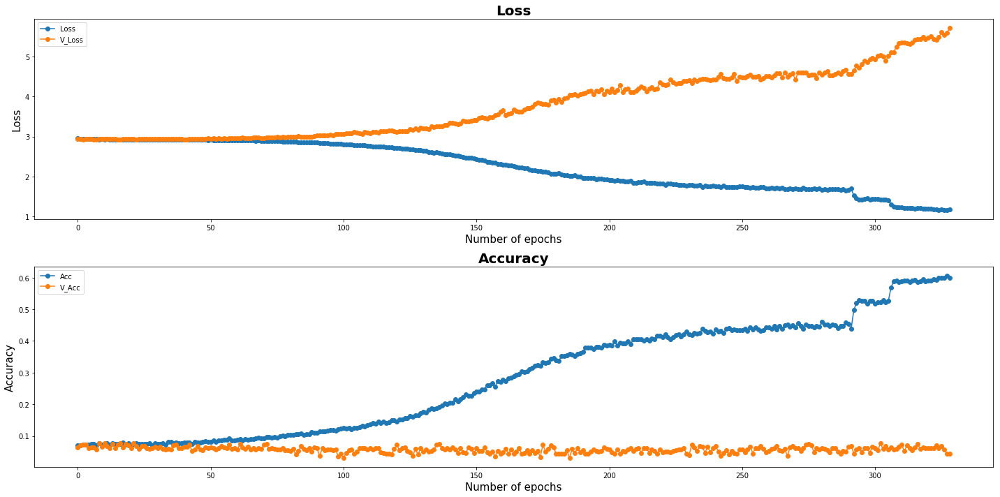

| Epoch [329] | Step [26350] | lr [0.004802] | Loss: [1.1852] | Acc: [0.6484] | Time: 0.0s
| Epoch [329] | Step [26400] | lr [0.004802] | Loss: [1.3226] | Acc: [0.6250] | Time: 0.0s
| Epoch [329] | Validation | Step [0] |  Loss: [5.1245] | Acc: [0.0938] | Time: 0.0s
| Epoch [329] | Validation | Step [1] |  Loss: [5.4092] | Acc: [0.0547] | Time: 0.0s
| Epoch [329] | Validation | Step [2] |  Loss: [5.4829] | Acc: [0.0625] | Time: 0.0s
| Epoch [329] | Validation | Step [3] |  Loss: [5.8239] | Acc: [0.0859] | Time: 0.0s


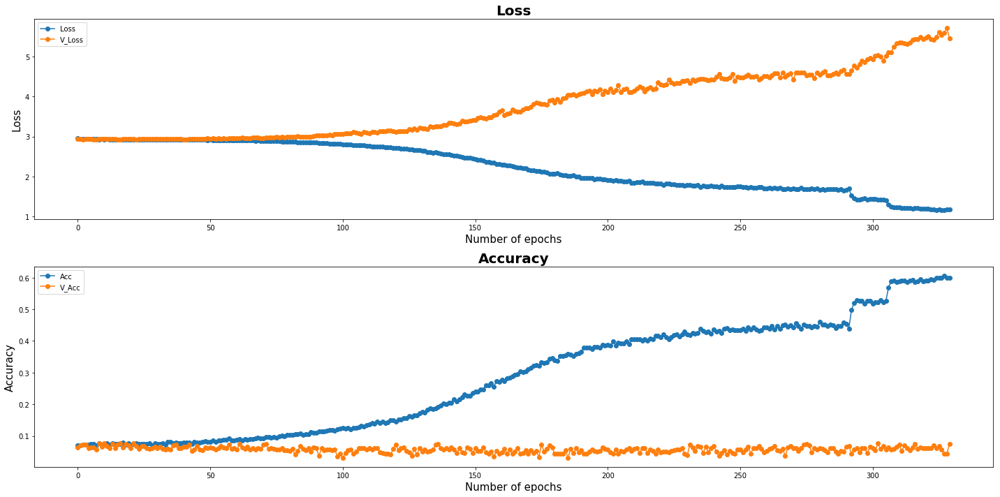

Model Saved
| Epoch [330] | Step [26450] | lr [0.004802] | Loss: [1.2616] | Acc: [0.5547] | Time: 0.0s
| Epoch [330] | Validation | Step [0] |  Loss: [5.7037] | Acc: [0.0469] | Time: 0.0s
| Epoch [330] | Validation | Step [1] |  Loss: [5.8291] | Acc: [0.0547] | Time: 0.0s
| Epoch [330] | Validation | Step [2] |  Loss: [5.5830] | Acc: [0.0625] | Time: 0.0s
| Epoch [330] | Validation | Step [3] |  Loss: [5.6527] | Acc: [0.0781] | Time: 0.0s


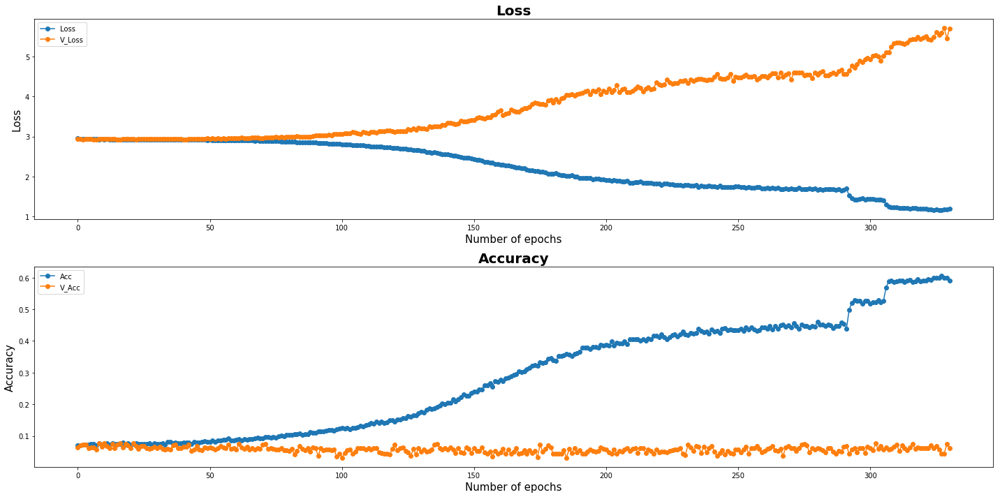

| Epoch [331] | Step [26500] | lr [0.004802] | Loss: [1.2000] | Acc: [0.6172] | Time: 0.0s
| Epoch [331] | Step [26550] | lr [0.004802] | Loss: [1.1426] | Acc: [0.6172] | Time: 0.0s
| Epoch [331] | Validation | Step [0] |  Loss: [6.1152] | Acc: [0.0469] | Time: 0.0s
| Epoch [331] | Validation | Step [1] |  Loss: [5.4713] | Acc: [0.0781] | Time: 0.0s
| Epoch [331] | Validation | Step [2] |  Loss: [5.6715] | Acc: [0.0859] | Time: 0.0s
| Epoch [331] | Validation | Step [3] |  Loss: [5.6049] | Acc: [0.0391] | Time: 0.0s


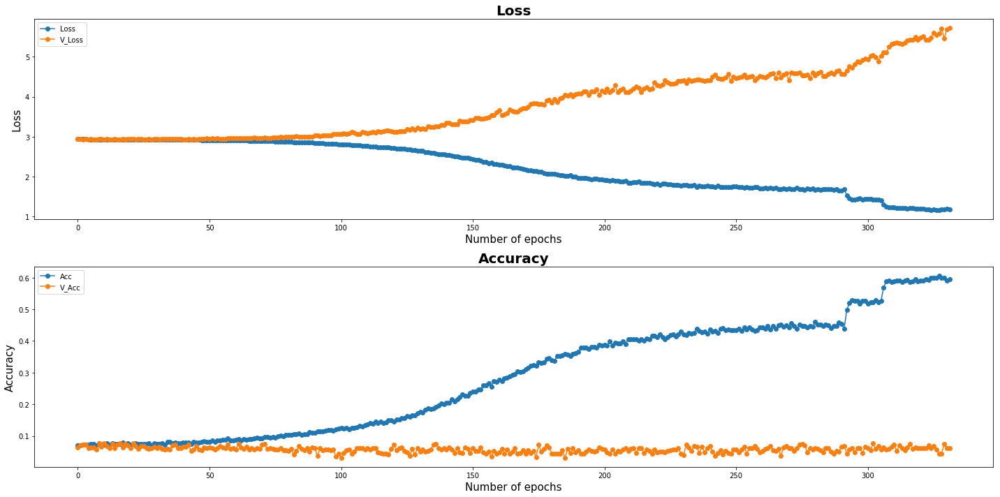

| Epoch [332] | Step [26600] | lr [0.004802] | Loss: [1.1742] | Acc: [0.5938] | Time: 0.0s
| Epoch [332] | Validation | Step [0] |  Loss: [5.5687] | Acc: [0.0625] | Time: 0.0s
| Epoch [332] | Validation | Step [1] |  Loss: [5.8639] | Acc: [0.0625] | Time: 0.0s
| Epoch [332] | Validation | Step [2] |  Loss: [5.4690] | Acc: [0.0781] | Time: 0.0s
| Epoch [332] | Validation | Step [3] |  Loss: [5.8539] | Acc: [0.0312] | Time: 0.0s


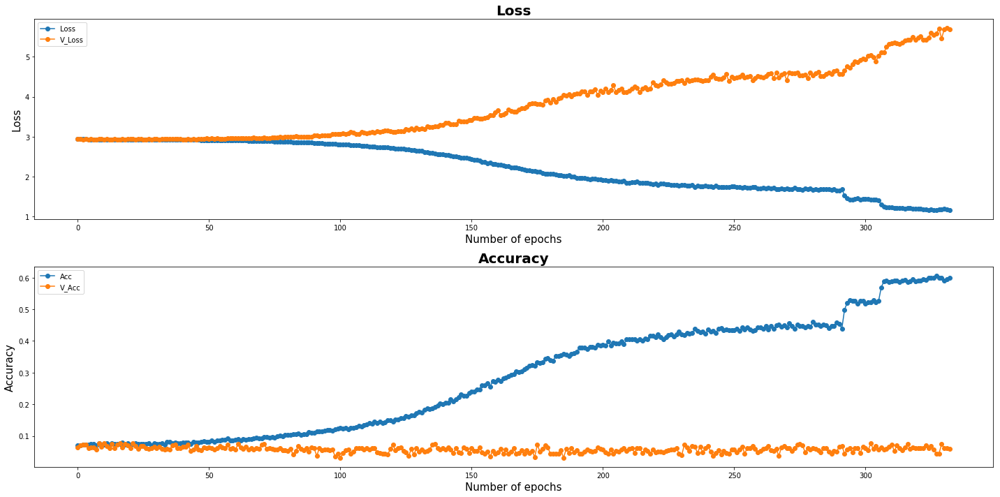

| Epoch [333] | Step [26650] | lr [0.004802] | Loss: [1.1274] | Acc: [0.6328] | Time: 0.0s
| Epoch [333] | Step [26700] | lr [0.004802] | Loss: [1.1109] | Acc: [0.5625] | Time: 0.0s
| Epoch [333] | Validation | Step [0] |  Loss: [5.5792] | Acc: [0.0469] | Time: 0.0s
| Epoch [333] | Validation | Step [1] |  Loss: [5.3612] | Acc: [0.0703] | Time: 0.0s
| Epoch [333] | Validation | Step [2] |  Loss: [5.7667] | Acc: [0.0547] | Time: 0.0s
| Epoch [333] | Validation | Step [3] |  Loss: [5.7546] | Acc: [0.0391] | Time: 0.0s


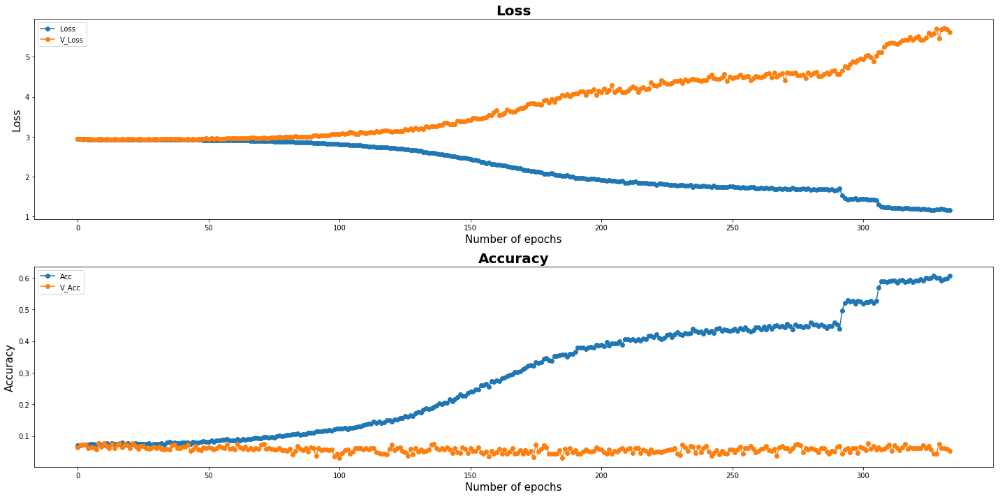

| Epoch [334] | Step [26750] | lr [0.004802] | Loss: [1.1021] | Acc: [0.6328] | Time: 0.0s
| Epoch [334] | Step [26800] | lr [0.004802] | Loss: [1.3144] | Acc: [0.5391] | Time: 0.0s
| Epoch [334] | Validation | Step [0] |  Loss: [5.5887] | Acc: [0.0625] | Time: 0.0s
| Epoch [334] | Validation | Step [1] |  Loss: [5.5149] | Acc: [0.0938] | Time: 0.0s
| Epoch [334] | Validation | Step [2] |  Loss: [6.0046] | Acc: [0.0547] | Time: 0.0s
| Epoch [334] | Validation | Step [3] |  Loss: [5.3137] | Acc: [0.0703] | Time: 0.0s


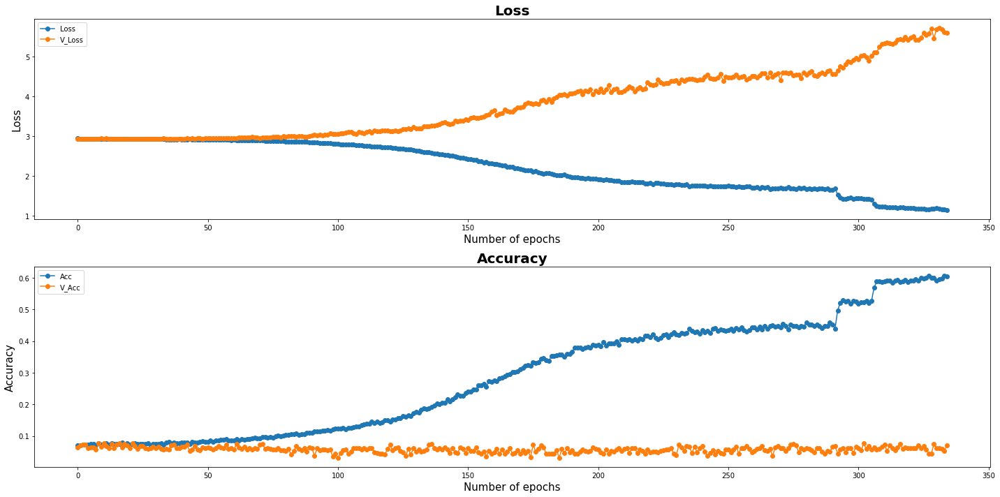

| Epoch [335] | Step [26850] | lr [0.004802] | Loss: [1.2715] | Acc: [0.5938] | Time: 0.0s
| Epoch [335] | Validation | Step [0] |  Loss: [6.5080] | Acc: [0.0547] | Time: 0.0s
| Epoch [335] | Validation | Step [1] |  Loss: [5.4353] | Acc: [0.0547] | Time: 0.0s
| Epoch [335] | Validation | Step [2] |  Loss: [5.3707] | Acc: [0.0703] | Time: 0.0s
| Epoch [335] | Validation | Step [3] |  Loss: [5.7646] | Acc: [0.0547] | Time: 0.0s


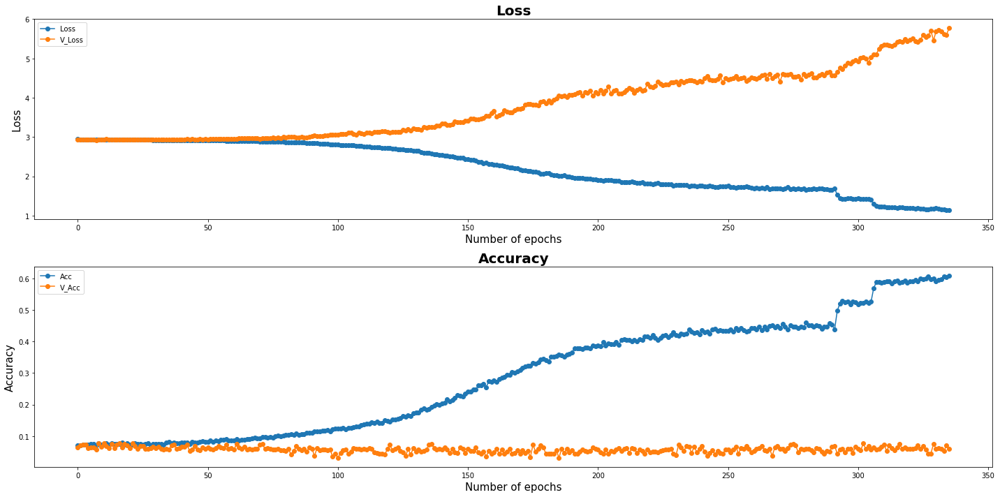

| Epoch [336] | Step [26900] | lr [0.004802] | Loss: [0.9726] | Acc: [0.6641] | Time: 0.0s
| Epoch [336] | Step [26950] | lr [0.004802] | Loss: [1.2519] | Acc: [0.5625] | Time: 0.0s
| Epoch [336] | Validation | Step [0] |  Loss: [5.6355] | Acc: [0.0859] | Time: 0.0s
| Epoch [336] | Validation | Step [1] |  Loss: [5.9764] | Acc: [0.0469] | Time: 0.0s
| Epoch [336] | Validation | Step [2] |  Loss: [5.5815] | Acc: [0.0703] | Time: 0.0s
| Epoch [336] | Validation | Step [3] |  Loss: [5.7169] | Acc: [0.0312] | Time: 0.0s


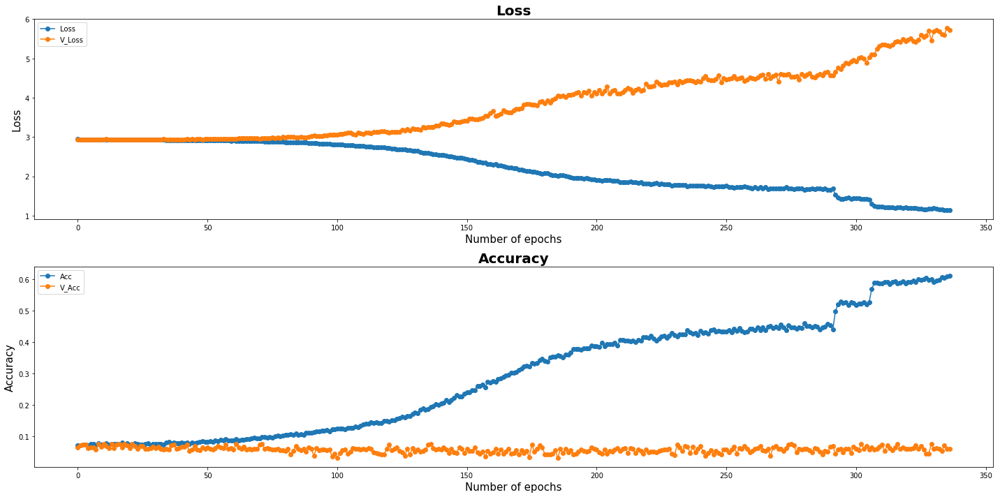

| Epoch [337] | Step [27000] | lr [0.004802] | Loss: [1.1496] | Acc: [0.6250] | Time: 0.0s
| Epoch [337] | Validation | Step [0] |  Loss: [5.4540] | Acc: [0.0703] | Time: 0.0s
| Epoch [337] | Validation | Step [1] |  Loss: [6.1004] | Acc: [0.0547] | Time: 0.0s
| Epoch [337] | Validation | Step [2] |  Loss: [5.9255] | Acc: [0.0391] | Time: 0.0s
| Epoch [337] | Validation | Step [3] |  Loss: [5.4060] | Acc: [0.1016] | Time: 0.0s


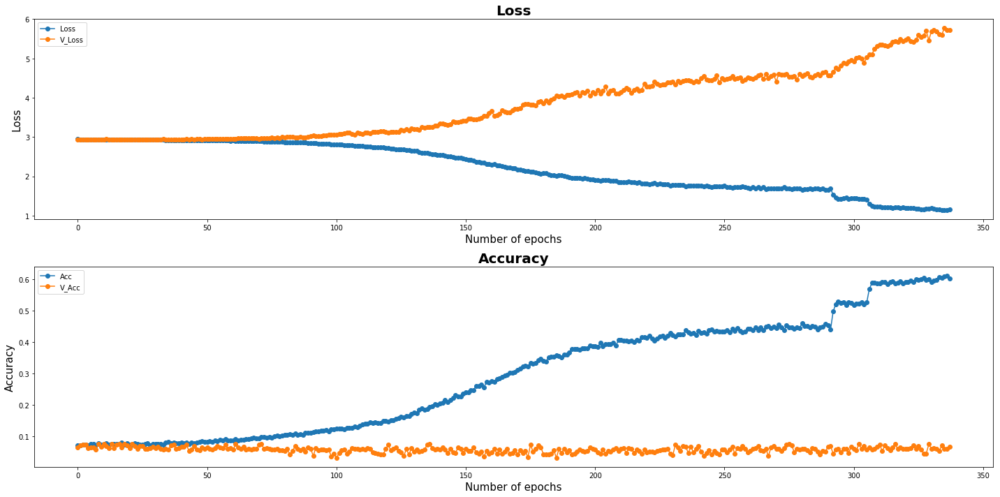

| Epoch [338] | Step [27050] | lr [0.004802] | Loss: [1.0802] | Acc: [0.6250] | Time: 0.0s
| Epoch [338] | Step [27100] | lr [0.004802] | Loss: [1.2152] | Acc: [0.5469] | Time: 0.0s
| Epoch [338] | Validation | Step [0] |  Loss: [5.5349] | Acc: [0.0625] | Time: 0.0s
| Epoch [338] | Validation | Step [1] |  Loss: [5.8719] | Acc: [0.0625] | Time: 0.0s
| Epoch [338] | Validation | Step [2] |  Loss: [6.0355] | Acc: [0.0625] | Time: 0.0s
| Epoch [338] | Validation | Step [3] |  Loss: [5.4689] | Acc: [0.0547] | Time: 0.0s


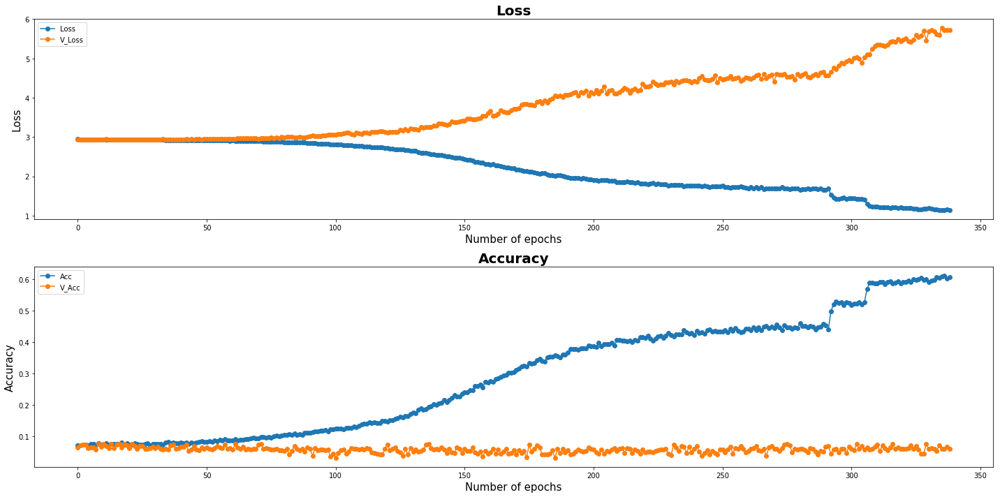

| Epoch [339] | Step [27150] | lr [0.004802] | Loss: [1.1039] | Acc: [0.6094] | Time: 0.0s
| Epoch [339] | Step [27200] | lr [0.004802] | Loss: [1.2267] | Acc: [0.5625] | Time: 0.0s
| Epoch [339] | Validation | Step [0] |  Loss: [5.4557] | Acc: [0.0625] | Time: 0.0s
| Epoch [339] | Validation | Step [1] |  Loss: [5.4932] | Acc: [0.0859] | Time: 0.0s
| Epoch [339] | Validation | Step [2] |  Loss: [5.6027] | Acc: [0.0312] | Time: 0.0s
| Epoch [339] | Validation | Step [3] |  Loss: [5.8235] | Acc: [0.0625] | Time: 0.0s


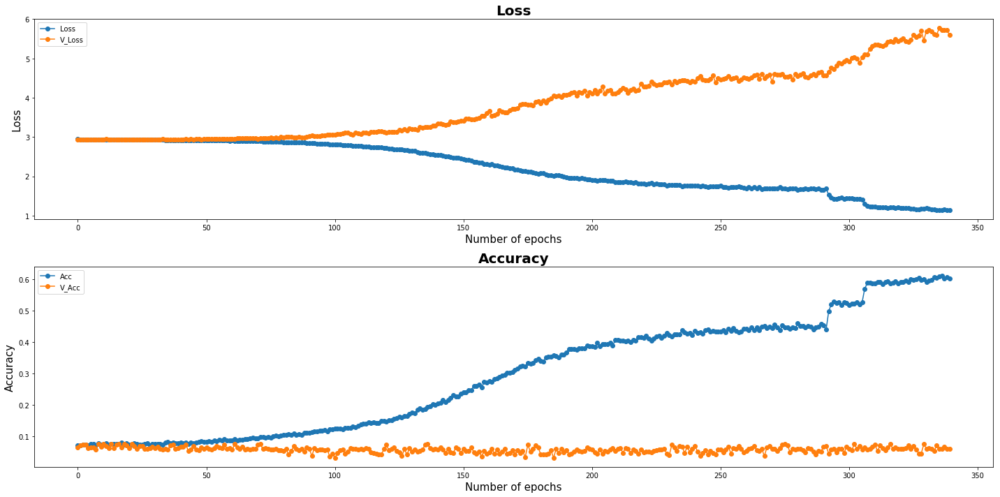

Model Saved
| Epoch [340] | Step [27250] | lr [0.004802] | Loss: [1.2430] | Acc: [0.6094] | Time: 0.0s
| Epoch [340] | Validation | Step [0] |  Loss: [5.5061] | Acc: [0.0703] | Time: 0.0s
| Epoch [340] | Validation | Step [1] |  Loss: [5.9051] | Acc: [0.0859] | Time: 0.0s
| Epoch [340] | Validation | Step [2] |  Loss: [5.9649] | Acc: [0.0859] | Time: 0.0s
| Epoch [340] | Validation | Step [3] |  Loss: [5.9227] | Acc: [0.0391] | Time: 0.0s


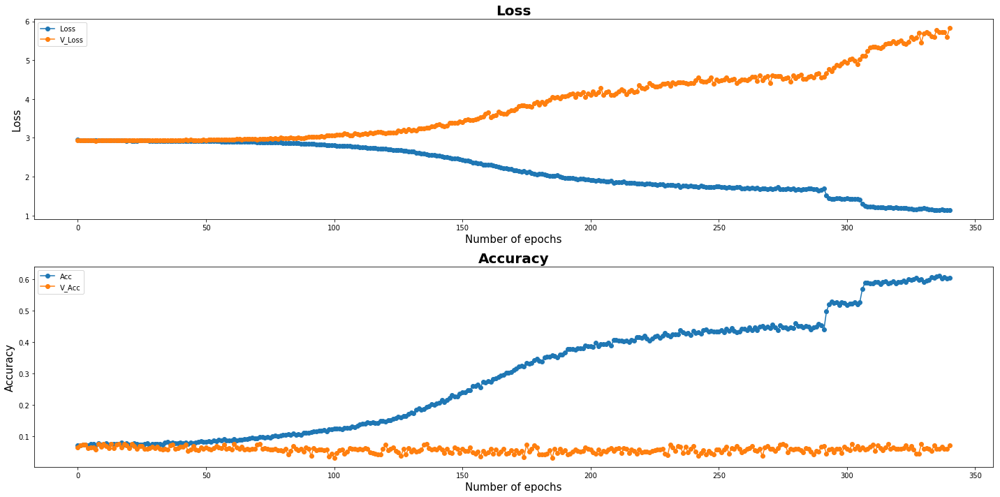

| Epoch [341] | Step [27300] | lr [0.004802] | Loss: [0.8555] | Acc: [0.7422] | Time: 0.0s
| Epoch [341] | Step [27350] | lr [0.004802] | Loss: [1.0791] | Acc: [0.6484] | Time: 0.0s
| Epoch [341] | Validation | Step [0] |  Loss: [5.8024] | Acc: [0.0781] | Time: 0.0s
| Epoch [341] | Validation | Step [1] |  Loss: [5.8191] | Acc: [0.0469] | Time: 0.0s
| Epoch [341] | Validation | Step [2] |  Loss: [5.7734] | Acc: [0.0703] | Time: 0.0s
| Epoch [341] | Validation | Step [3] |  Loss: [5.6324] | Acc: [0.0625] | Time: 0.0s


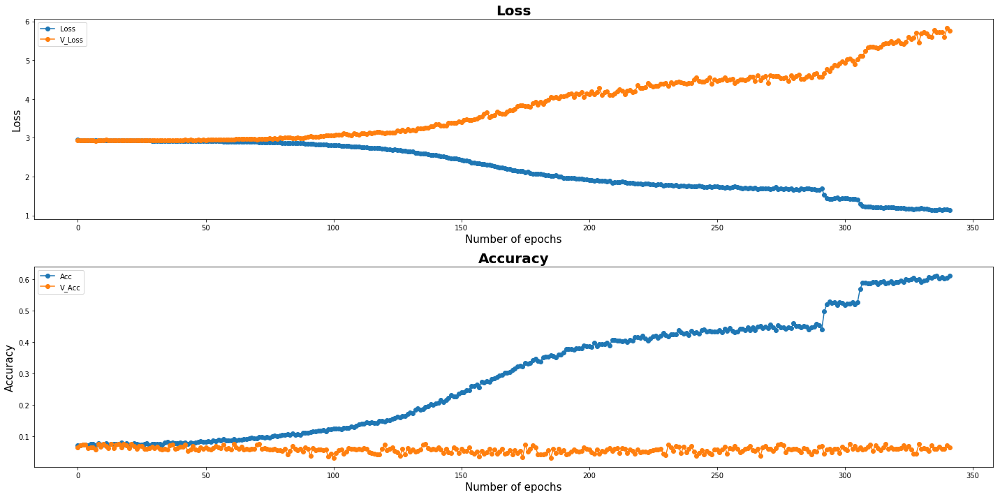

| Epoch [342] | Step [27400] | lr [0.004802] | Loss: [1.2606] | Acc: [0.5625] | Time: 0.0s
| Epoch [342] | Validation | Step [0] |  Loss: [5.3474] | Acc: [0.0625] | Time: 0.0s
| Epoch [342] | Validation | Step [1] |  Loss: [5.6295] | Acc: [0.0625] | Time: 0.0s
| Epoch [342] | Validation | Step [2] |  Loss: [5.9594] | Acc: [0.0859] | Time: 0.0s
| Epoch [342] | Validation | Step [3] |  Loss: [5.6134] | Acc: [0.0625] | Time: 0.0s


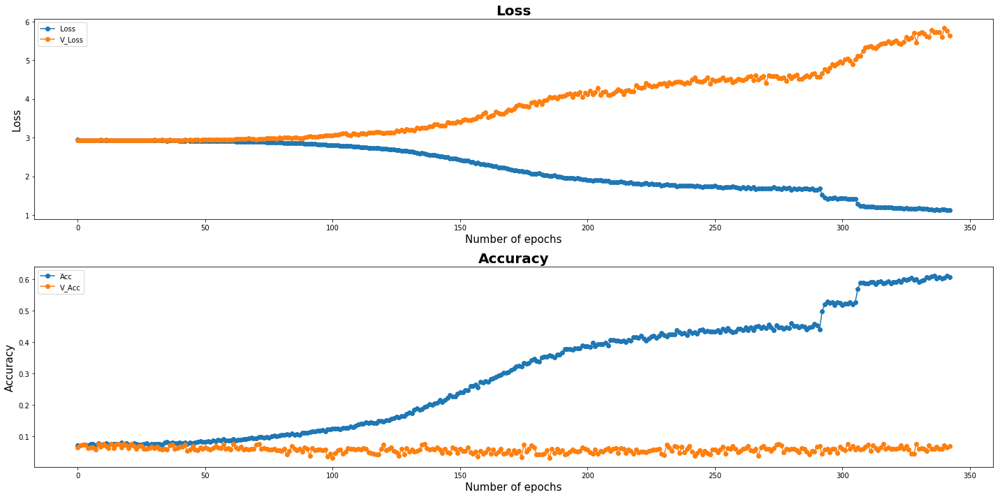

| Epoch [343] | Step [27450] | lr [0.004802] | Loss: [1.0492] | Acc: [0.6328] | Time: 0.0s
| Epoch [343] | Step [27500] | lr [0.004802] | Loss: [1.1764] | Acc: [0.5703] | Time: 0.0s
| Epoch [343] | Validation | Step [0] |  Loss: [5.4763] | Acc: [0.0938] | Time: 0.0s
| Epoch [343] | Validation | Step [1] |  Loss: [5.2800] | Acc: [0.0938] | Time: 0.0s
| Epoch [343] | Validation | Step [2] |  Loss: [6.0315] | Acc: [0.0547] | Time: 0.0s
| Epoch [343] | Validation | Step [3] |  Loss: [6.4470] | Acc: [0.0312] | Time: 0.0s


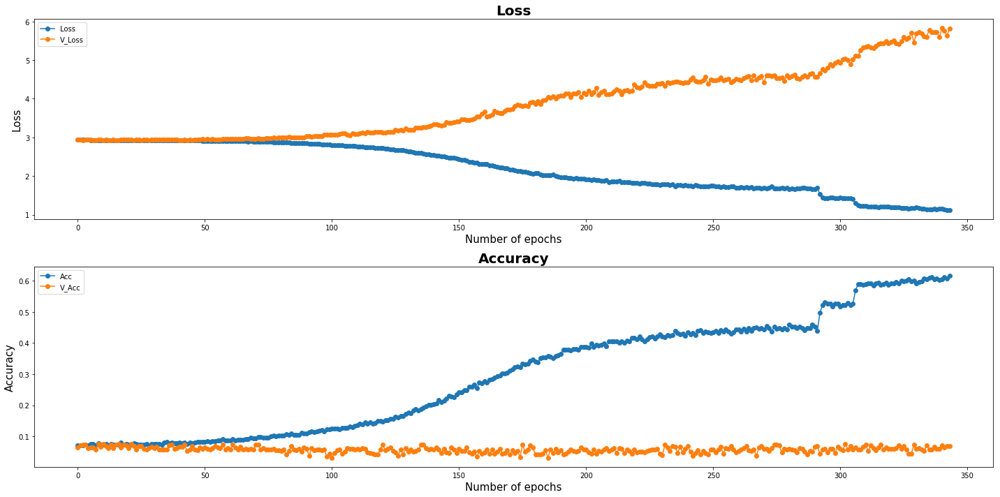

| Epoch [344] | Step [27550] | lr [0.004802] | Loss: [1.1255] | Acc: [0.5547] | Time: 0.0s
| Epoch [344] | Step [27600] | lr [0.004802] | Loss: [1.3227] | Acc: [0.5625] | Time: 0.0s
| Epoch [344] | Validation | Step [0] |  Loss: [5.5111] | Acc: [0.0547] | Time: 0.0s
| Epoch [344] | Validation | Step [1] |  Loss: [6.2046] | Acc: [0.0234] | Time: 0.0s
| Epoch [344] | Validation | Step [2] |  Loss: [5.9780] | Acc: [0.0859] | Time: 0.0s
| Epoch [344] | Validation | Step [3] |  Loss: [5.7274] | Acc: [0.0234] | Time: 0.0s


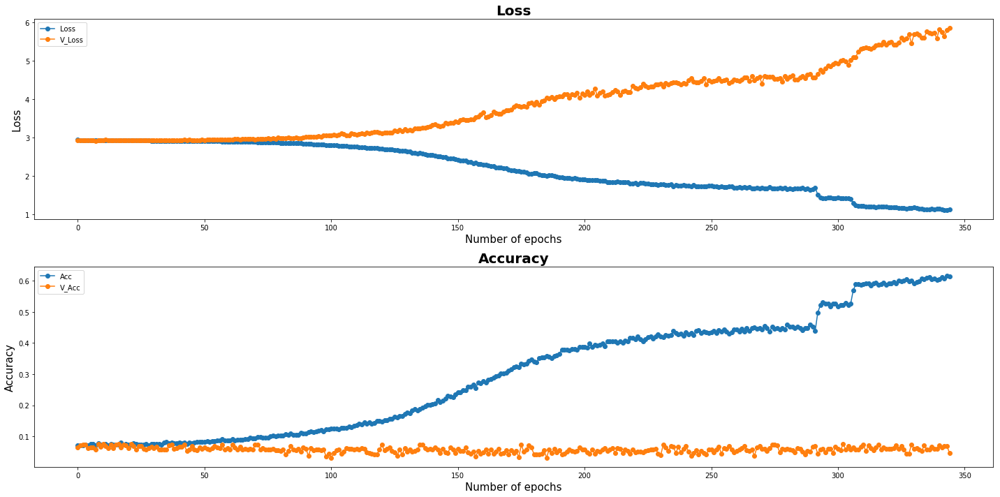

| Epoch [345] | Step [27650] | lr [0.004802] | Loss: [1.2389] | Acc: [0.5859] | Time: 0.0s
| Epoch [345] | Validation | Step [0] |  Loss: [5.5977] | Acc: [0.0703] | Time: 0.0s
| Epoch [345] | Validation | Step [1] |  Loss: [6.1786] | Acc: [0.0391] | Time: 0.0s
| Epoch [345] | Validation | Step [2] |  Loss: [5.8701] | Acc: [0.0469] | Time: 0.0s
| Epoch [345] | Validation | Step [3] |  Loss: [5.8726] | Acc: [0.0469] | Time: 0.0s


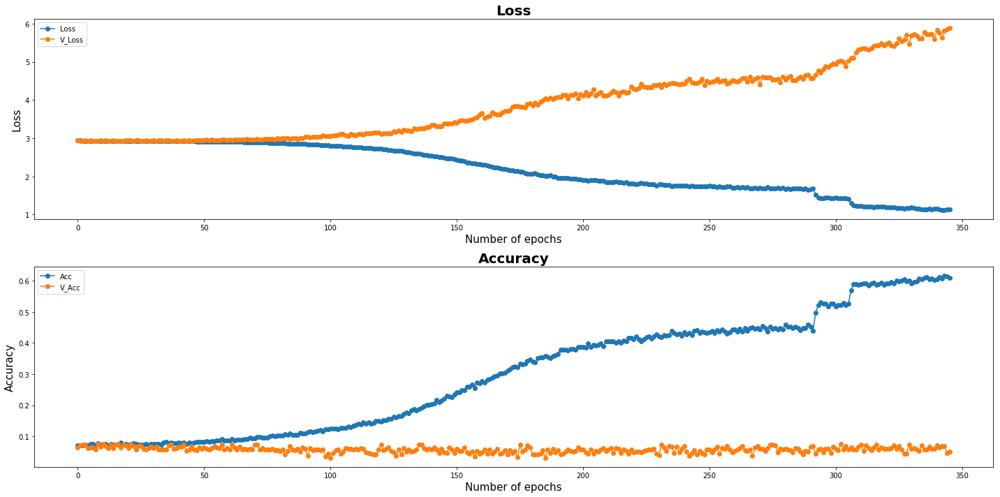

| Epoch [346] | Step [27700] | lr [0.004802] | Loss: [0.9495] | Acc: [0.6953] | Time: 0.0s
| Epoch [346] | Step [27750] | lr [0.004802] | Loss: [1.2426] | Acc: [0.5391] | Time: 0.0s
| Epoch [346] | Validation | Step [0] |  Loss: [5.9184] | Acc: [0.0625] | Time: 0.0s
| Epoch [346] | Validation | Step [1] |  Loss: [5.5346] | Acc: [0.0859] | Time: 0.0s
| Epoch [346] | Validation | Step [2] |  Loss: [6.0519] | Acc: [0.0391] | Time: 0.0s
| Epoch [346] | Validation | Step [3] |  Loss: [5.3929] | Acc: [0.0703] | Time: 0.0s


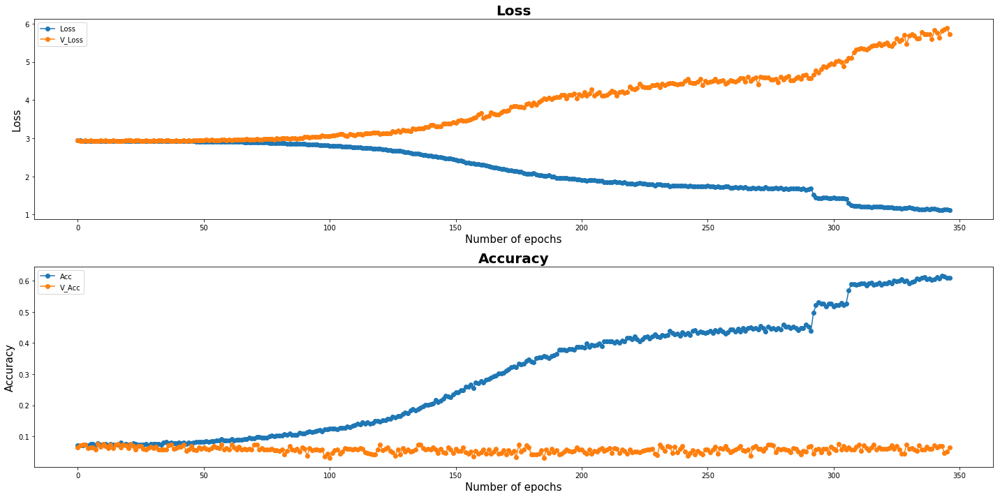

| Epoch [347] | Step [27800] | lr [0.004802] | Loss: [1.1279] | Acc: [0.5859] | Time: 0.0s
| Epoch [347] | Validation | Step [0] |  Loss: [5.7430] | Acc: [0.0547] | Time: 0.0s
| Epoch [347] | Validation | Step [1] |  Loss: [5.5120] | Acc: [0.0625] | Time: 0.0s
| Epoch [347] | Validation | Step [2] |  Loss: [5.9567] | Acc: [0.0781] | Time: 0.0s
| Epoch [347] | Validation | Step [3] |  Loss: [6.1633] | Acc: [0.0391] | Time: 0.0s


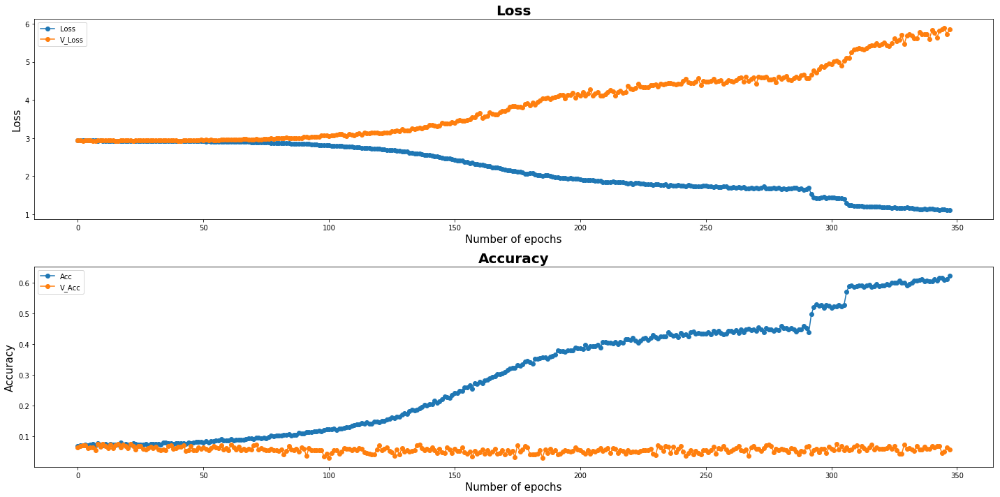

| Epoch [348] | Step [27850] | lr [0.004802] | Loss: [1.0826] | Acc: [0.5625] | Time: 0.0s
| Epoch [348] | Step [27900] | lr [0.004802] | Loss: [1.2518] | Acc: [0.5781] | Time: 0.0s
| Epoch [348] | Validation | Step [0] |  Loss: [5.3055] | Acc: [0.0938] | Time: 0.0s
| Epoch [348] | Validation | Step [1] |  Loss: [6.1505] | Acc: [0.0391] | Time: 0.0s
| Epoch [348] | Validation | Step [2] |  Loss: [6.1853] | Acc: [0.0391] | Time: 0.0s
| Epoch [348] | Validation | Step [3] |  Loss: [5.9157] | Acc: [0.0469] | Time: 0.0s


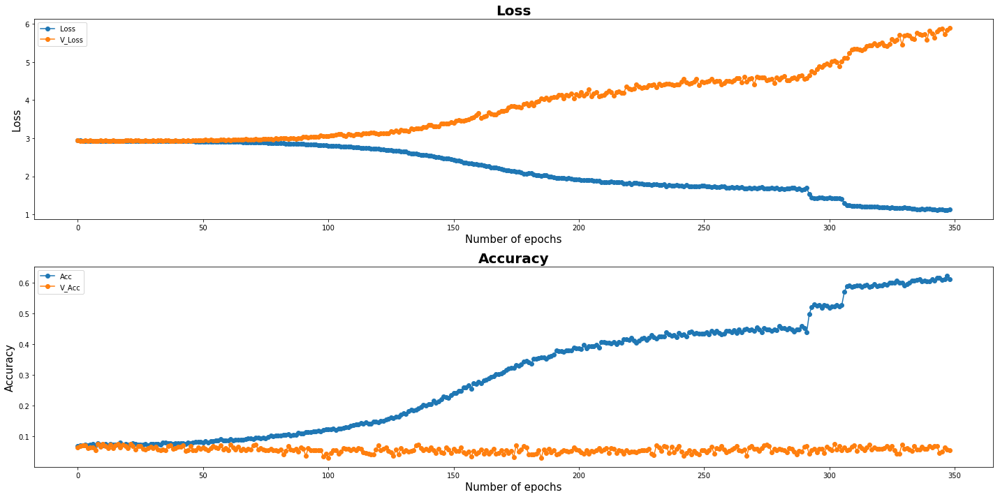

| Epoch [349] | Step [27950] | lr [0.004802] | Loss: [1.2053] | Acc: [0.6172] | Time: 0.0s
| Epoch [349] | Step [28000] | lr [0.004802] | Loss: [1.1186] | Acc: [0.6406] | Time: 0.0s
| Epoch [349] | Validation | Step [0] |  Loss: [5.6300] | Acc: [0.0781] | Time: 0.0s
| Epoch [349] | Validation | Step [1] |  Loss: [5.9776] | Acc: [0.0391] | Time: 0.0s
| Epoch [349] | Validation | Step [2] |  Loss: [5.9965] | Acc: [0.0781] | Time: 0.0s
| Epoch [349] | Validation | Step [3] |  Loss: [5.9164] | Acc: [0.0625] | Time: 0.0s


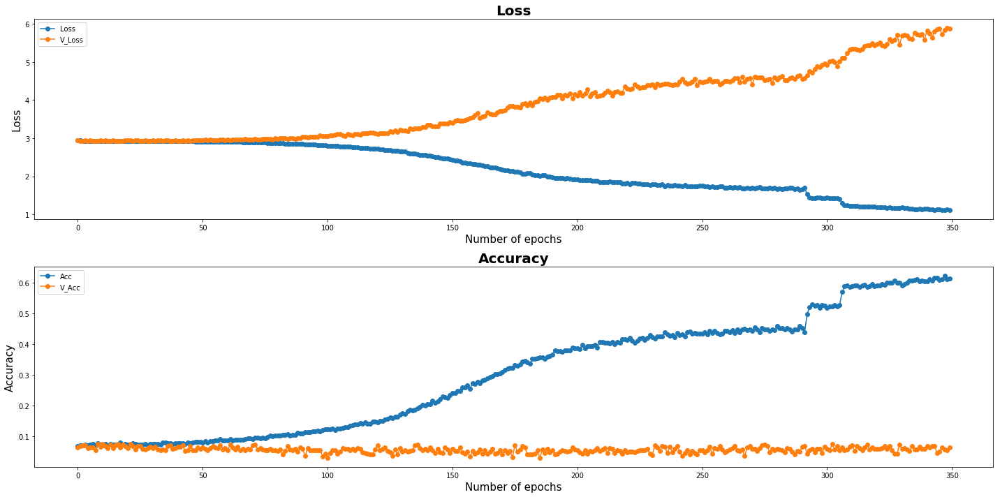

Model Saved
| Epoch [350] | Step [28050] | lr [0.004802] | Loss: [1.1107] | Acc: [0.6016] | Time: 0.0s
| Epoch [350] | Validation | Step [0] |  Loss: [5.9082] | Acc: [0.0703] | Time: 0.0s
| Epoch [350] | Validation | Step [1] |  Loss: [5.7604] | Acc: [0.0781] | Time: 0.0s
| Epoch [350] | Validation | Step [2] |  Loss: [5.7363] | Acc: [0.0625] | Time: 0.0s
| Epoch [350] | Validation | Step [3] |  Loss: [5.8820] | Acc: [0.0625] | Time: 0.0s


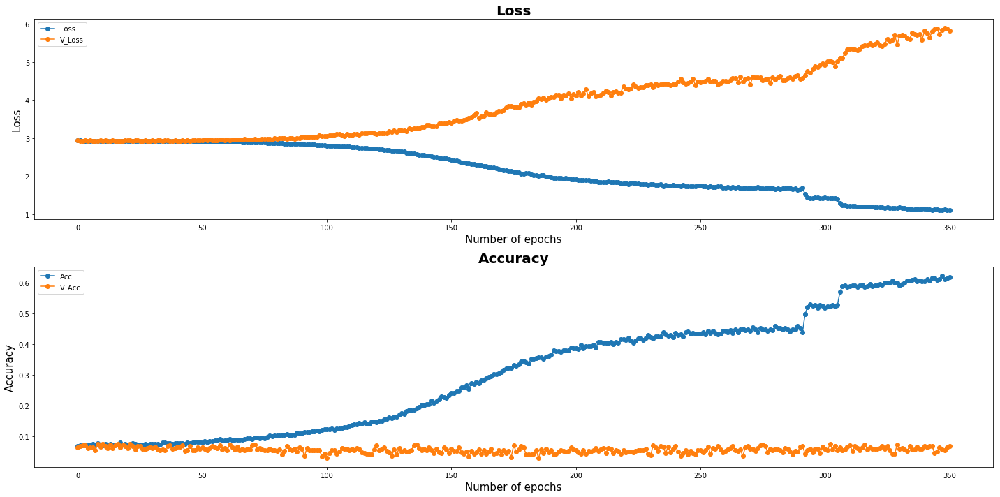

| Epoch [351] | Step [28100] | lr [0.004802] | Loss: [1.0039] | Acc: [0.6406] | Time: 0.0s
| Epoch [351] | Step [28150] | lr [0.004802] | Loss: [1.0495] | Acc: [0.6328] | Time: 0.0s
| Epoch [351] | Validation | Step [0] |  Loss: [5.5522] | Acc: [0.0703] | Time: 0.0s
| Epoch [351] | Validation | Step [1] |  Loss: [6.0160] | Acc: [0.0703] | Time: 0.0s
| Epoch [351] | Validation | Step [2] |  Loss: [5.8385] | Acc: [0.0859] | Time: 0.0s
| Epoch [351] | Validation | Step [3] |  Loss: [5.7964] | Acc: [0.0547] | Time: 0.0s


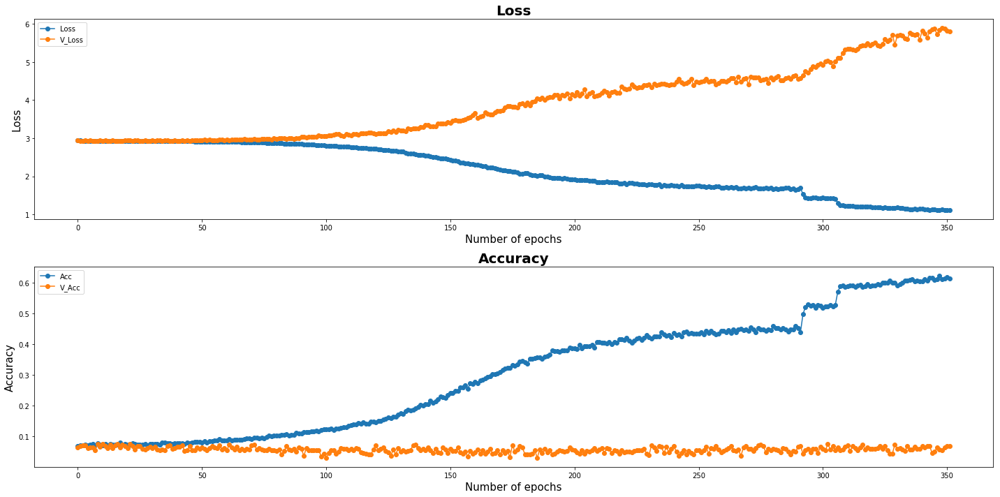

| Epoch [352] | Step [28200] | lr [0.004802] | Loss: [1.0109] | Acc: [0.6797] | Time: 0.0s
| Epoch [352] | Validation | Step [0] |  Loss: [5.6761] | Acc: [0.0547] | Time: 0.0s
| Epoch [352] | Validation | Step [1] |  Loss: [5.8945] | Acc: [0.0391] | Time: 0.0s
| Epoch [352] | Validation | Step [2] |  Loss: [5.9878] | Acc: [0.0625] | Time: 0.0s
| Epoch [352] | Validation | Step [3] |  Loss: [6.0519] | Acc: [0.0781] | Time: 0.0s


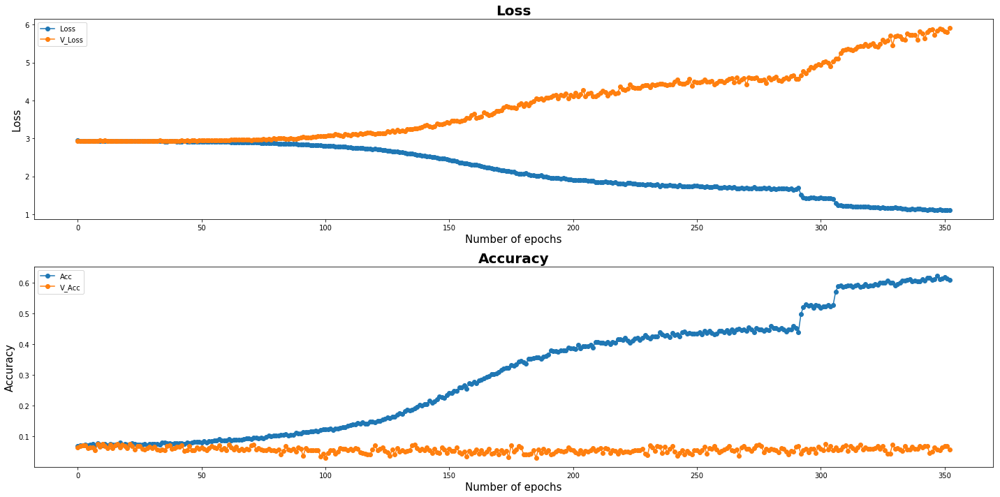

| Epoch [353] | Step [28250] | lr [0.004802] | Loss: [0.9981] | Acc: [0.6562] | Time: 0.0s
| Epoch [353] | Step [28300] | lr [0.004802] | Loss: [0.9683] | Acc: [0.6406] | Time: 0.0s
| Epoch [353] | Validation | Step [0] |  Loss: [6.4233] | Acc: [0.0703] | Time: 0.0s
| Epoch [353] | Validation | Step [1] |  Loss: [5.9488] | Acc: [0.0859] | Time: 0.0s
| Epoch [353] | Validation | Step [2] |  Loss: [6.0016] | Acc: [0.0469] | Time: 0.0s
| Epoch [353] | Validation | Step [3] |  Loss: [5.6178] | Acc: [0.0781] | Time: 0.0s


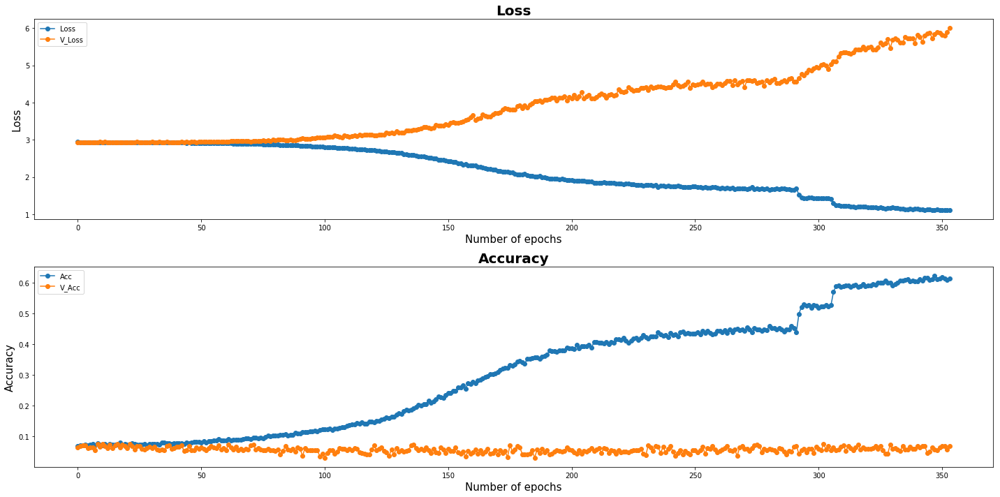

| Epoch [354] | Step [28350] | lr [0.004802] | Loss: [1.2289] | Acc: [0.5391] | Time: 0.0s
| Epoch [354] | Step [28400] | lr [0.004802] | Loss: [1.2052] | Acc: [0.5781] | Time: 0.0s
| Epoch [354] | Validation | Step [0] |  Loss: [6.1056] | Acc: [0.0781] | Time: 0.0s
| Epoch [354] | Validation | Step [1] |  Loss: [5.8051] | Acc: [0.0469] | Time: 0.0s
| Epoch [354] | Validation | Step [2] |  Loss: [6.5298] | Acc: [0.0469] | Time: 0.0s
| Epoch [354] | Validation | Step [3] |  Loss: [5.7281] | Acc: [0.0703] | Time: 0.0s


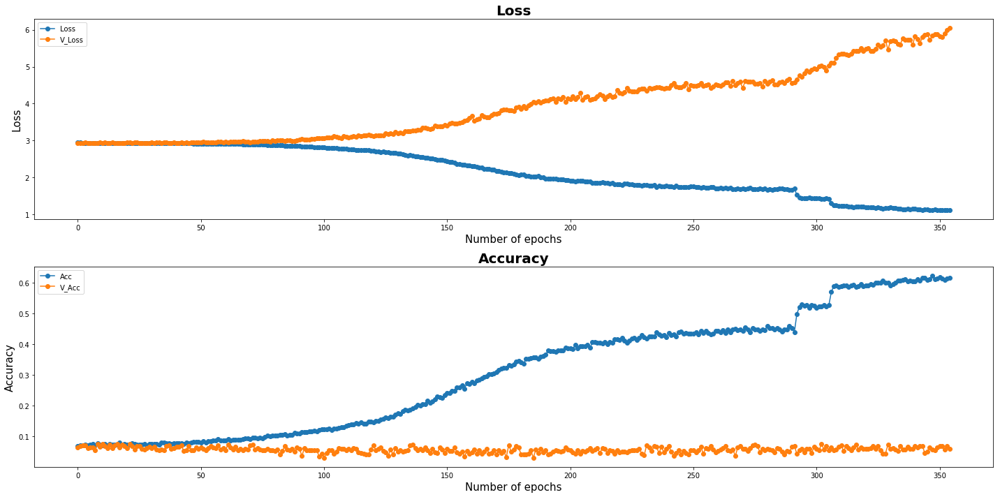

| Epoch [355] | Step [28450] | lr [0.004802] | Loss: [1.1553] | Acc: [0.5938] | Time: 0.0s
| Epoch [355] | Validation | Step [0] |  Loss: [5.8360] | Acc: [0.0781] | Time: 0.0s
| Epoch [355] | Validation | Step [1] |  Loss: [5.8133] | Acc: [0.0469] | Time: 0.0s
| Epoch [355] | Validation | Step [2] |  Loss: [5.8941] | Acc: [0.0625] | Time: 0.0s
| Epoch [355] | Validation | Step [3] |  Loss: [5.7196] | Acc: [0.0781] | Time: 0.0s


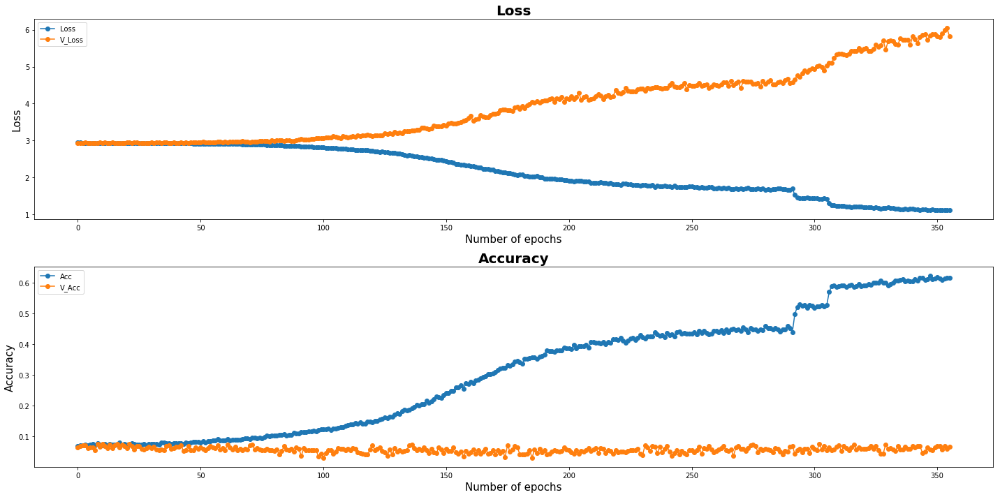

| Epoch [356] | Step [28500] | lr [0.004802] | Loss: [1.0487] | Acc: [0.6094] | Time: 0.0s
| Epoch [356] | Step [28550] | lr [0.004802] | Loss: [1.0595] | Acc: [0.6406] | Time: 0.0s
| Epoch [356] | Validation | Step [0] |  Loss: [5.4677] | Acc: [0.0781] | Time: 0.0s
| Epoch [356] | Validation | Step [1] |  Loss: [6.2388] | Acc: [0.0391] | Time: 0.0s
| Epoch [356] | Validation | Step [2] |  Loss: [5.5241] | Acc: [0.0859] | Time: 0.0s
| Epoch [356] | Validation | Step [3] |  Loss: [6.0131] | Acc: [0.0234] | Time: 0.0s


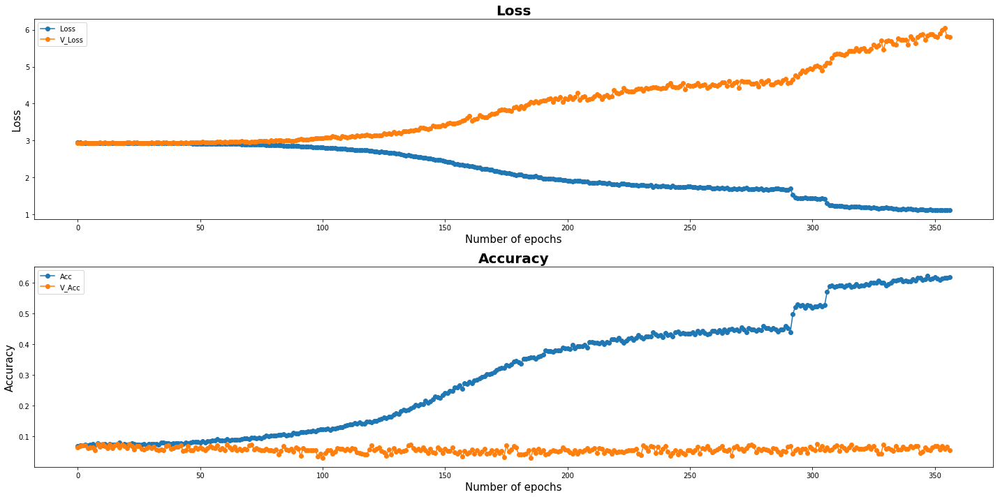

| Epoch [357] | Step [28600] | lr [0.004802] | Loss: [1.1254] | Acc: [0.5703] | Time: 0.0s
| Epoch [357] | Validation | Step [0] |  Loss: [6.3320] | Acc: [0.0391] | Time: 0.0s
| Epoch [357] | Validation | Step [1] |  Loss: [5.8662] | Acc: [0.0469] | Time: 0.0s
| Epoch [357] | Validation | Step [2] |  Loss: [5.4190] | Acc: [0.0938] | Time: 0.0s
| Epoch [357] | Validation | Step [3] |  Loss: [6.0632] | Acc: [0.0469] | Time: 0.0s


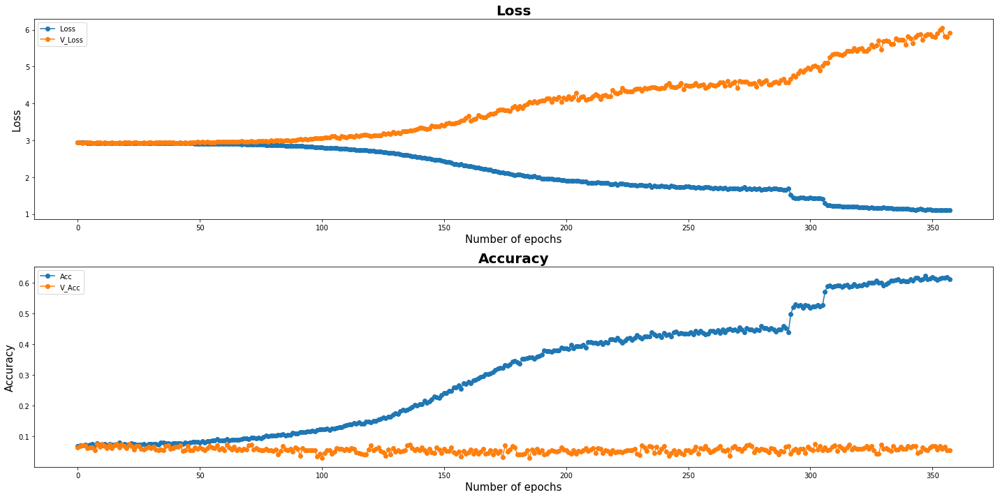

| Epoch [358] | Step [28650] | lr [0.004802] | Loss: [1.1292] | Acc: [0.5781] | Time: 0.0s
| Epoch [358] | Step [28700] | lr [0.004802] | Loss: [1.0552] | Acc: [0.6875] | Time: 0.0s
| Epoch [358] | Validation | Step [0] |  Loss: [6.0356] | Acc: [0.0312] | Time: 0.0s
| Epoch [358] | Validation | Step [1] |  Loss: [6.0944] | Acc: [0.0859] | Time: 0.0s
| Epoch [358] | Validation | Step [2] |  Loss: [5.6683] | Acc: [0.0781] | Time: 0.0s
| Epoch [358] | Validation | Step [3] |  Loss: [5.9032] | Acc: [0.0469] | Time: 0.0s


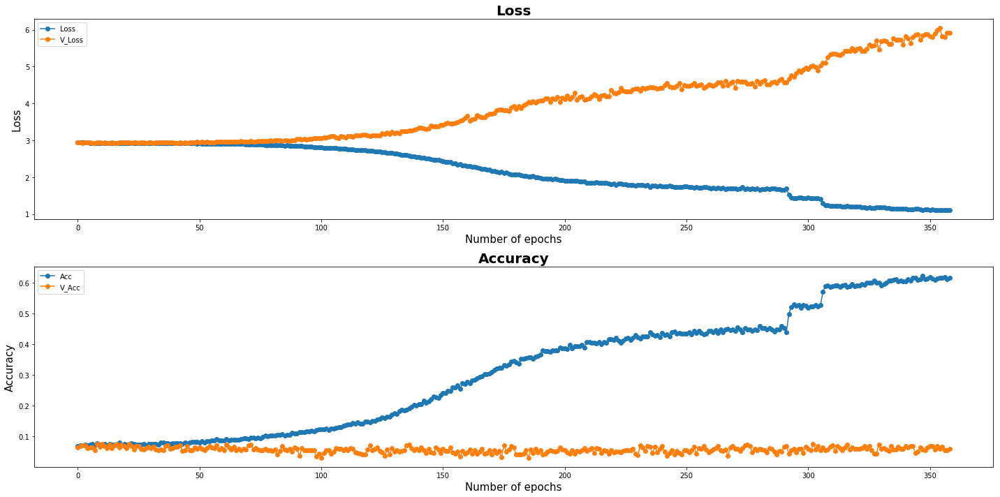

| Epoch [359] | Step [28750] | lr [0.003361] | Loss: [0.8164] | Acc: [0.7344] | Time: 0.0s
| Epoch [359] | Step [28800] | lr [0.003361] | Loss: [1.1122] | Acc: [0.5625] | Time: 0.0s
| Epoch [359] | Validation | Step [0] |  Loss: [6.6546] | Acc: [0.0859] | Time: 0.0s
| Epoch [359] | Validation | Step [1] |  Loss: [6.0071] | Acc: [0.0547] | Time: 0.0s
| Epoch [359] | Validation | Step [2] |  Loss: [5.6917] | Acc: [0.0469] | Time: 0.0s
| Epoch [359] | Validation | Step [3] |  Loss: [5.8142] | Acc: [0.0547] | Time: 0.0s


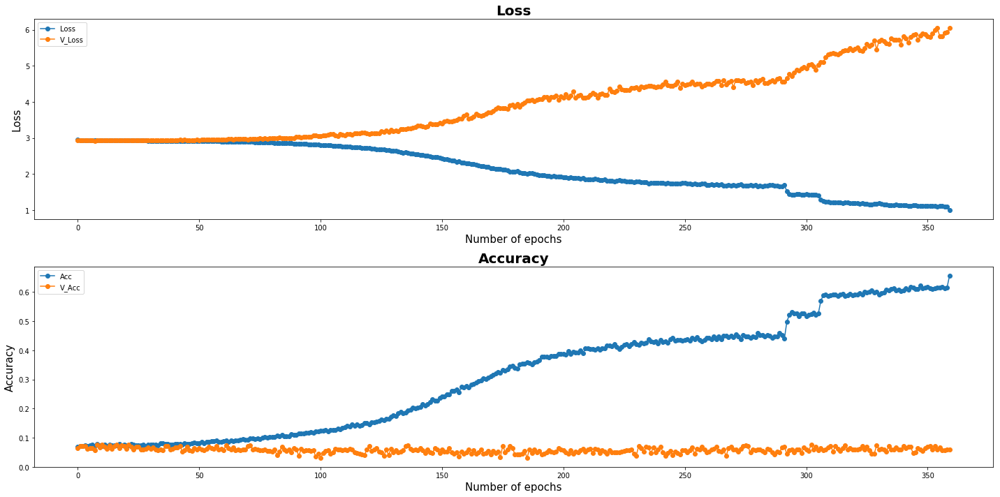

Model Saved
| Epoch [360] | Step [28850] | lr [0.003361] | Loss: [0.9564] | Acc: [0.7031] | Time: 0.0s
| Epoch [360] | Validation | Step [0] |  Loss: [6.1296] | Acc: [0.0469] | Time: 0.0s
| Epoch [360] | Validation | Step [1] |  Loss: [5.9417] | Acc: [0.0859] | Time: 0.0s
| Epoch [360] | Validation | Step [2] |  Loss: [6.0171] | Acc: [0.0547] | Time: 0.0s
| Epoch [360] | Validation | Step [3] |  Loss: [6.0043] | Acc: [0.0547] | Time: 0.0s


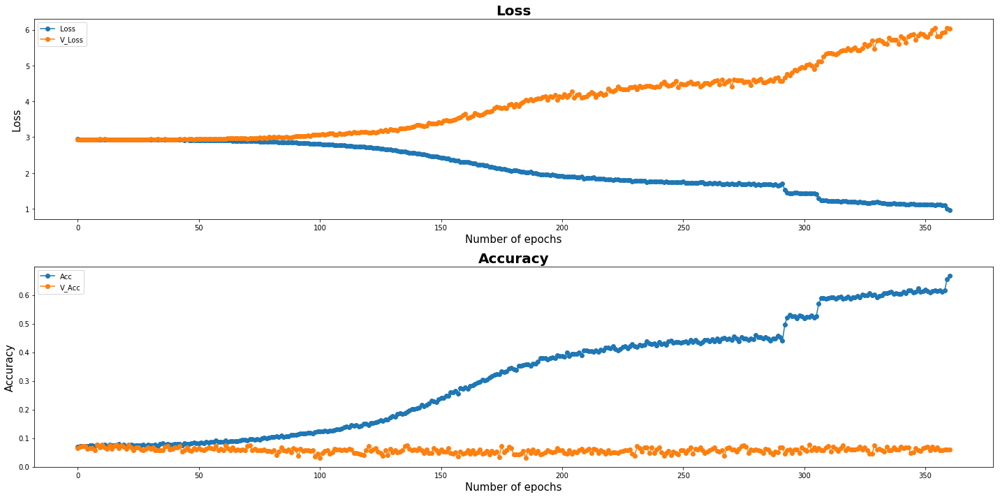

| Epoch [361] | Step [28900] | lr [0.003361] | Loss: [0.8538] | Acc: [0.7344] | Time: 0.0s
| Epoch [361] | Step [28950] | lr [0.003361] | Loss: [1.0085] | Acc: [0.6406] | Time: 0.0s
| Epoch [361] | Validation | Step [0] |  Loss: [5.8199] | Acc: [0.0781] | Time: 0.0s
| Epoch [361] | Validation | Step [1] |  Loss: [6.5626] | Acc: [0.0391] | Time: 0.0s
| Epoch [361] | Validation | Step [2] |  Loss: [6.0589] | Acc: [0.0859] | Time: 0.0s
| Epoch [361] | Validation | Step [3] |  Loss: [6.1397] | Acc: [0.0469] | Time: 0.0s


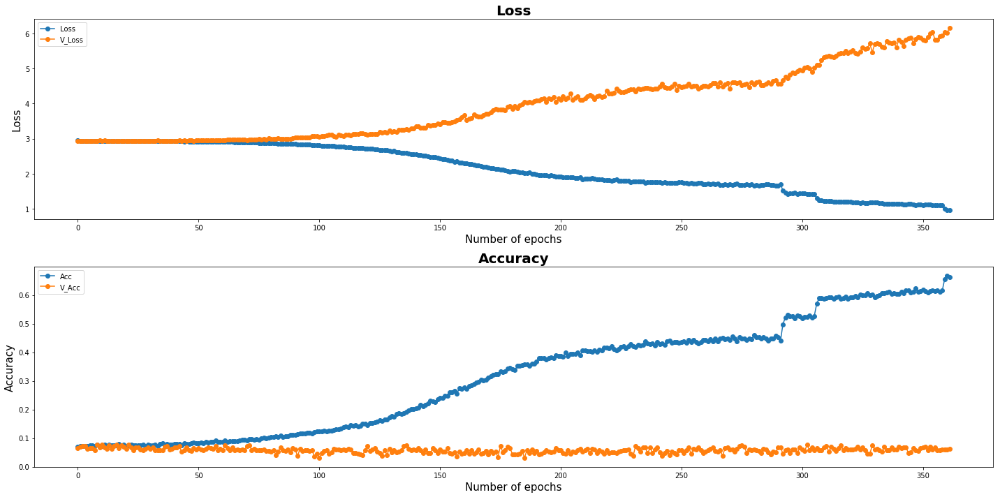

| Epoch [362] | Step [29000] | lr [0.003361] | Loss: [0.8316] | Acc: [0.7188] | Time: 0.0s
| Epoch [362] | Validation | Step [0] |  Loss: [6.5391] | Acc: [0.0547] | Time: 0.0s
| Epoch [362] | Validation | Step [1] |  Loss: [5.5861] | Acc: [0.0859] | Time: 0.0s
| Epoch [362] | Validation | Step [2] |  Loss: [5.9968] | Acc: [0.0469] | Time: 0.0s
| Epoch [362] | Validation | Step [3] |  Loss: [6.0553] | Acc: [0.0625] | Time: 0.0s


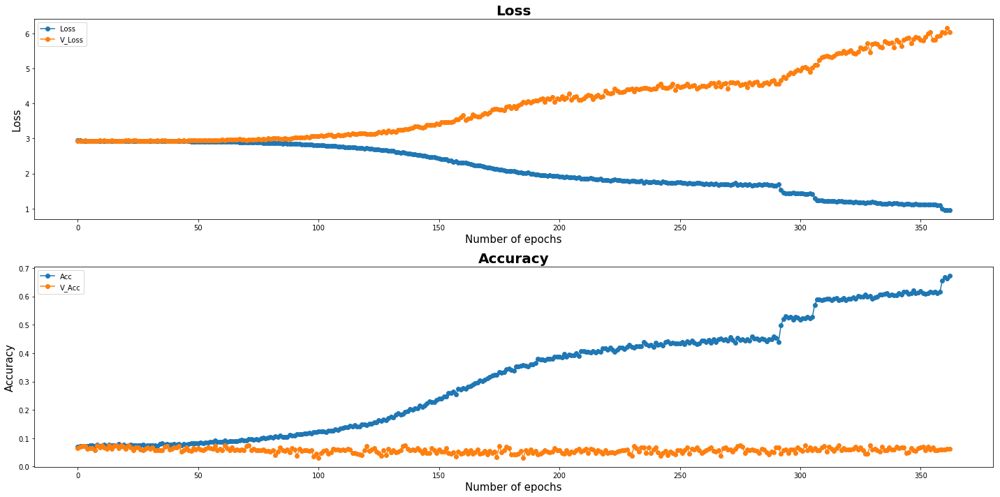

| Epoch [363] | Step [29050] | lr [0.003361] | Loss: [0.9146] | Acc: [0.6562] | Time: 0.0s
| Epoch [363] | Step [29100] | lr [0.003361] | Loss: [1.0133] | Acc: [0.6094] | Time: 0.0s
| Epoch [363] | Validation | Step [0] |  Loss: [5.8219] | Acc: [0.0859] | Time: 0.0s
| Epoch [363] | Validation | Step [1] |  Loss: [5.7419] | Acc: [0.0625] | Time: 0.0s
| Epoch [363] | Validation | Step [2] |  Loss: [6.4295] | Acc: [0.0625] | Time: 0.0s
| Epoch [363] | Validation | Step [3] |  Loss: [6.4509] | Acc: [0.0234] | Time: 0.0s


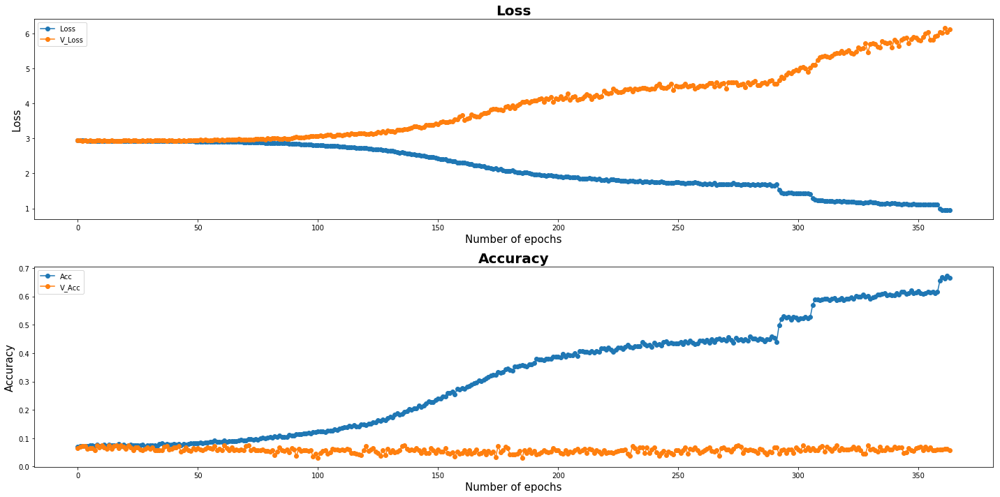

| Epoch [364] | Step [29150] | lr [0.003361] | Loss: [1.1040] | Acc: [0.6094] | Time: 0.0s
| Epoch [364] | Step [29200] | lr [0.003361] | Loss: [1.1183] | Acc: [0.6172] | Time: 0.0s
| Epoch [364] | Validation | Step [0] |  Loss: [6.2501] | Acc: [0.0625] | Time: 0.0s
| Epoch [364] | Validation | Step [1] |  Loss: [6.3055] | Acc: [0.0703] | Time: 0.0s
| Epoch [364] | Validation | Step [2] |  Loss: [6.1912] | Acc: [0.0781] | Time: 0.0s
| Epoch [364] | Validation | Step [3] |  Loss: [5.8605] | Acc: [0.0625] | Time: 0.0s


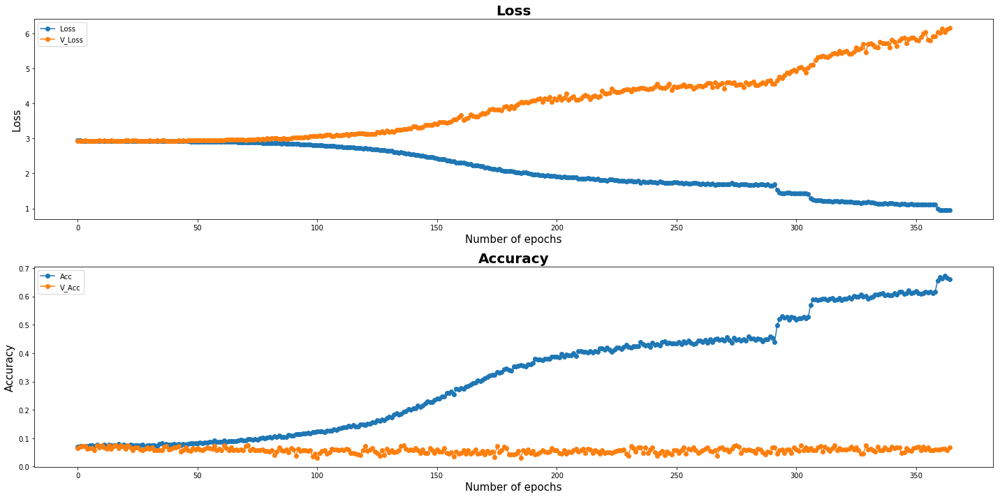

| Epoch [365] | Step [29250] | lr [0.003361] | Loss: [1.0648] | Acc: [0.5938] | Time: 0.0s
| Epoch [365] | Validation | Step [0] |  Loss: [6.5623] | Acc: [0.0469] | Time: 0.0s
| Epoch [365] | Validation | Step [1] |  Loss: [5.9802] | Acc: [0.0469] | Time: 0.0s
| Epoch [365] | Validation | Step [2] |  Loss: [5.5933] | Acc: [0.0781] | Time: 0.0s
| Epoch [365] | Validation | Step [3] |  Loss: [6.2090] | Acc: [0.0703] | Time: 0.0s


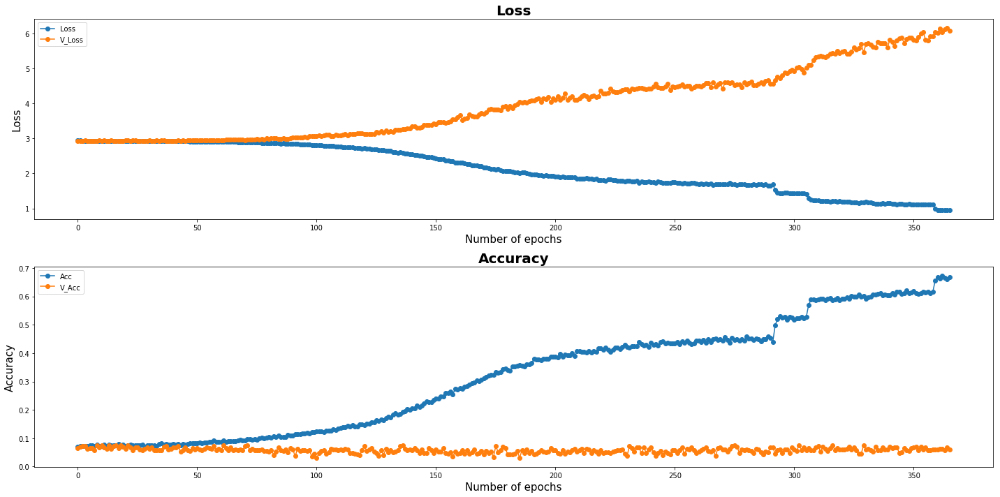

| Epoch [366] | Step [29300] | lr [0.003361] | Loss: [0.9111] | Acc: [0.6875] | Time: 0.0s
| Epoch [366] | Step [29350] | lr [0.003361] | Loss: [0.9944] | Acc: [0.6484] | Time: 0.0s
| Epoch [366] | Validation | Step [0] |  Loss: [5.6507] | Acc: [0.0625] | Time: 0.0s
| Epoch [366] | Validation | Step [1] |  Loss: [5.9248] | Acc: [0.0625] | Time: 0.0s
| Epoch [366] | Validation | Step [2] |  Loss: [6.3954] | Acc: [0.0312] | Time: 0.0s
| Epoch [366] | Validation | Step [3] |  Loss: [6.6183] | Acc: [0.0312] | Time: 0.0s


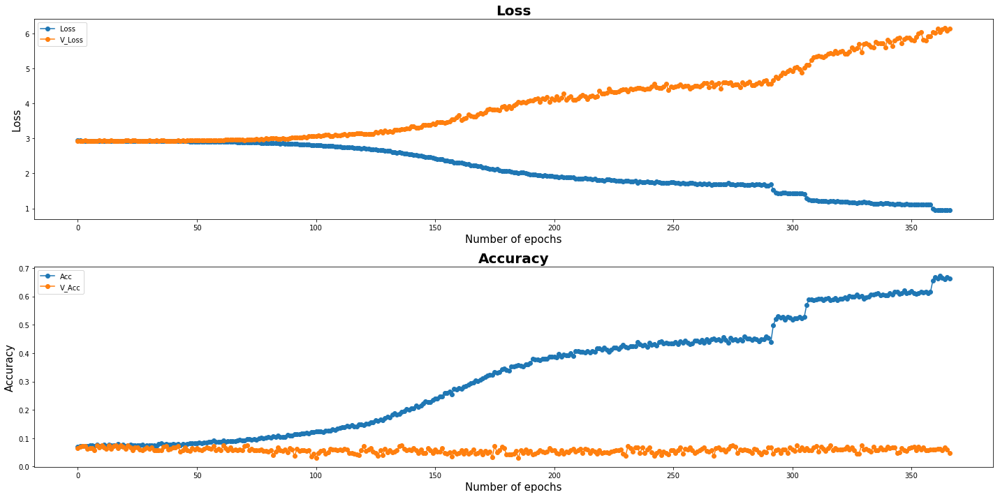

| Epoch [367] | Step [29400] | lr [0.003361] | Loss: [0.7750] | Acc: [0.7578] | Time: 0.0s
| Epoch [367] | Validation | Step [0] |  Loss: [6.6222] | Acc: [0.0625] | Time: 0.0s
| Epoch [367] | Validation | Step [1] |  Loss: [6.0276] | Acc: [0.0625] | Time: 0.0s
| Epoch [367] | Validation | Step [2] |  Loss: [5.9017] | Acc: [0.0469] | Time: 0.0s
| Epoch [367] | Validation | Step [3] |  Loss: [6.5751] | Acc: [0.0625] | Time: 0.0s


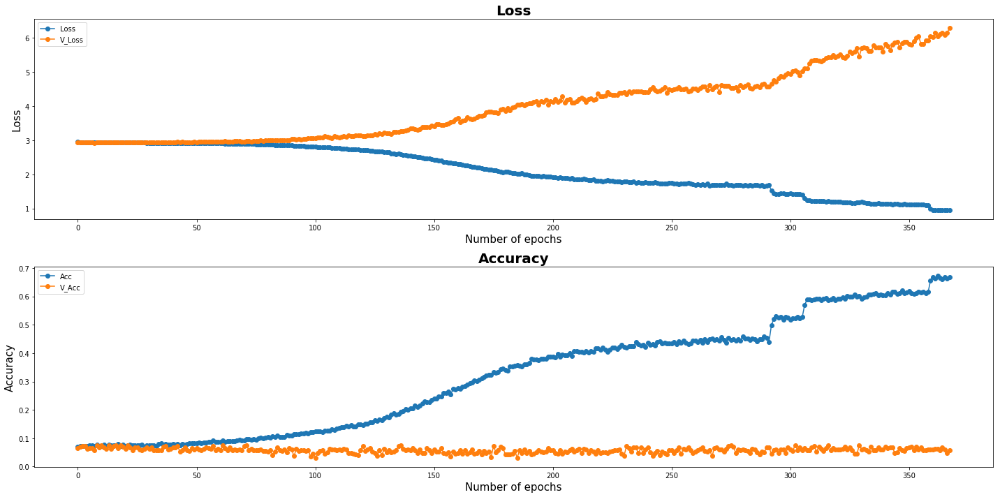

| Epoch [368] | Step [29450] | lr [0.003361] | Loss: [0.9142] | Acc: [0.6875] | Time: 0.0s
| Epoch [368] | Step [29500] | lr [0.003361] | Loss: [0.9376] | Acc: [0.6875] | Time: 0.0s
| Epoch [368] | Validation | Step [0] |  Loss: [5.6028] | Acc: [0.0625] | Time: 0.0s
| Epoch [368] | Validation | Step [1] |  Loss: [5.6702] | Acc: [0.0938] | Time: 0.0s
| Epoch [368] | Validation | Step [2] |  Loss: [6.5436] | Acc: [0.0625] | Time: 0.0s
| Epoch [368] | Validation | Step [3] |  Loss: [6.6792] | Acc: [0.0391] | Time: 0.0s


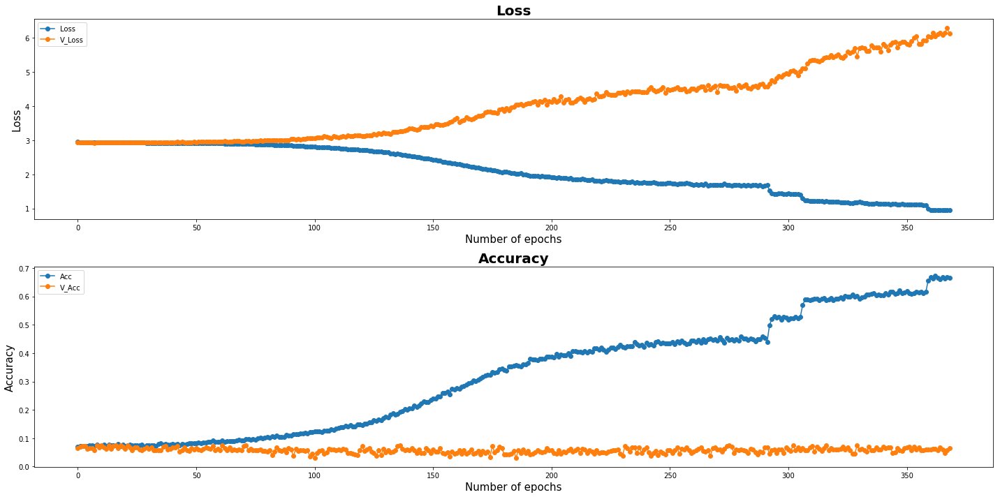

| Epoch [369] | Step [29550] | lr [0.003361] | Loss: [0.8748] | Acc: [0.6797] | Time: 0.0s
| Epoch [369] | Step [29600] | lr [0.003361] | Loss: [1.1076] | Acc: [0.5781] | Time: 0.0s
| Epoch [369] | Validation | Step [0] |  Loss: [6.2586] | Acc: [0.0391] | Time: 0.0s
| Epoch [369] | Validation | Step [1] |  Loss: [6.3736] | Acc: [0.0625] | Time: 0.0s
| Epoch [369] | Validation | Step [2] |  Loss: [6.2966] | Acc: [0.0859] | Time: 0.0s
| Epoch [369] | Validation | Step [3] |  Loss: [6.1245] | Acc: [0.0625] | Time: 0.0s


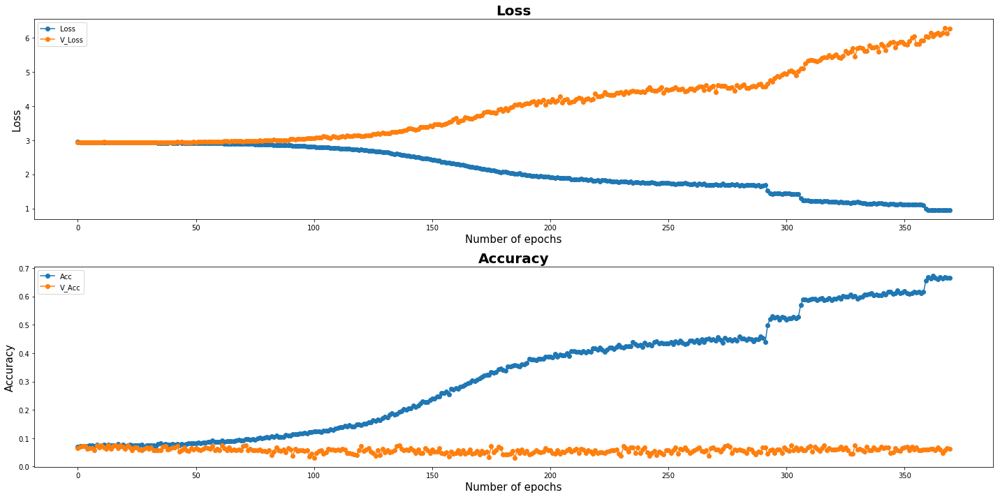

Model Saved
| Epoch [370] | Step [29650] | lr [0.003361] | Loss: [0.9056] | Acc: [0.6797] | Time: 0.0s
| Epoch [370] | Validation | Step [0] |  Loss: [6.0732] | Acc: [0.0859] | Time: 0.0s
| Epoch [370] | Validation | Step [1] |  Loss: [5.6155] | Acc: [0.0859] | Time: 0.0s
| Epoch [370] | Validation | Step [2] |  Loss: [6.8237] | Acc: [0.0312] | Time: 0.0s
| Epoch [370] | Validation | Step [3] |  Loss: [6.4005] | Acc: [0.0469] | Time: 0.0s


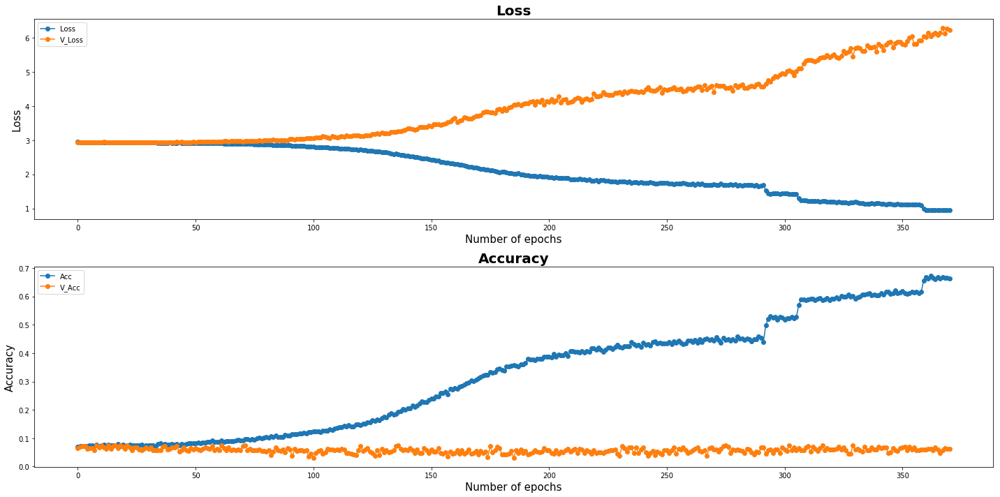

| Epoch [371] | Step [29700] | lr [0.003361] | Loss: [0.8949] | Acc: [0.6484] | Time: 0.0s
| Epoch [371] | Step [29750] | lr [0.003361] | Loss: [0.9858] | Acc: [0.6094] | Time: 0.0s
| Epoch [371] | Validation | Step [0] |  Loss: [6.2786] | Acc: [0.0938] | Time: 0.0s
| Epoch [371] | Validation | Step [1] |  Loss: [6.4181] | Acc: [0.0469] | Time: 0.0s
| Epoch [371] | Validation | Step [2] |  Loss: [6.2095] | Acc: [0.0391] | Time: 0.0s
| Epoch [371] | Validation | Step [3] |  Loss: [5.7982] | Acc: [0.0469] | Time: 0.0s


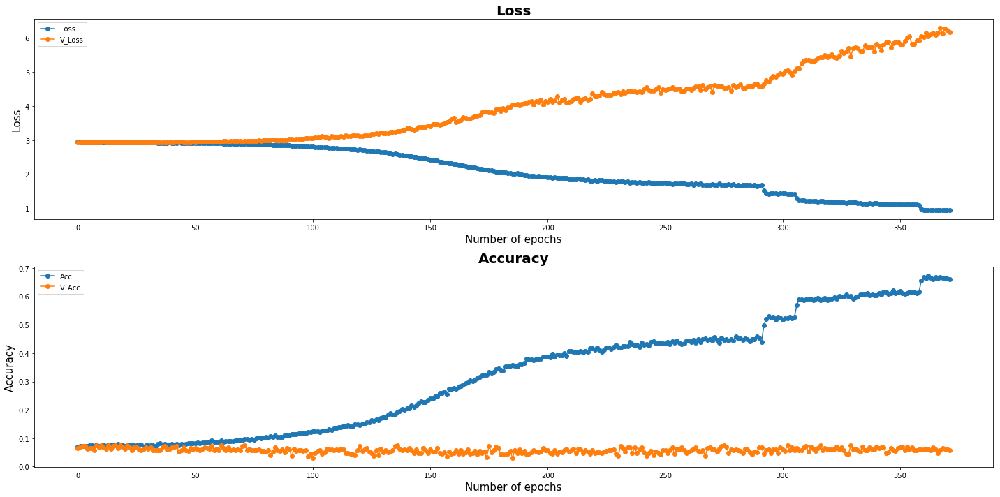

| Epoch [372] | Step [29800] | lr [0.003361] | Loss: [0.9740] | Acc: [0.6328] | Time: 0.0s
| Epoch [372] | Validation | Step [0] |  Loss: [6.3751] | Acc: [0.0781] | Time: 0.0s
| Epoch [372] | Validation | Step [1] |  Loss: [5.9235] | Acc: [0.0469] | Time: 0.0s
| Epoch [372] | Validation | Step [2] |  Loss: [6.5801] | Acc: [0.0703] | Time: 0.0s
| Epoch [372] | Validation | Step [3] |  Loss: [6.0475] | Acc: [0.0391] | Time: 0.0s


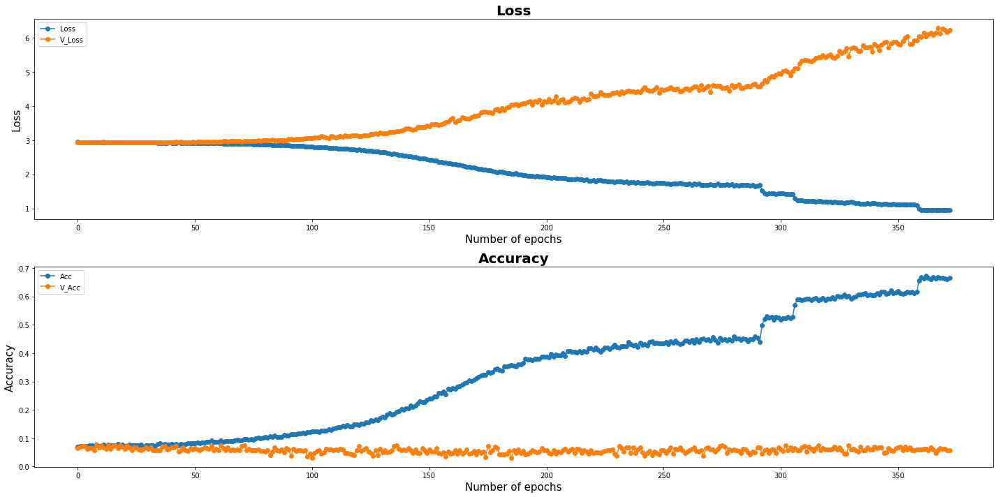

| Epoch [373] | Step [29850] | lr [0.003361] | Loss: [1.0053] | Acc: [0.6406] | Time: 0.0s
| Epoch [373] | Step [29900] | lr [0.003361] | Loss: [0.9364] | Acc: [0.6953] | Time: 0.0s
| Epoch [373] | Validation | Step [0] |  Loss: [5.9786] | Acc: [0.0469] | Time: 0.0s
| Epoch [373] | Validation | Step [1] |  Loss: [6.2132] | Acc: [0.0703] | Time: 0.0s
| Epoch [373] | Validation | Step [2] |  Loss: [6.4535] | Acc: [0.0391] | Time: 0.0s
| Epoch [373] | Validation | Step [3] |  Loss: [6.5287] | Acc: [0.0703] | Time: 0.0s


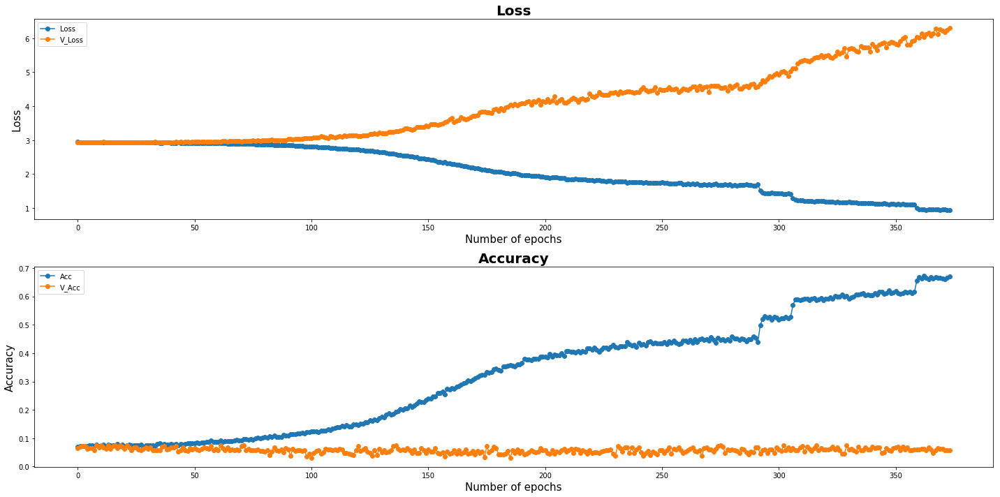

| Epoch [374] | Step [29950] | lr [0.002353] | Loss: [0.9352] | Acc: [0.6250] | Time: 0.0s
| Epoch [374] | Step [30000] | lr [0.002353] | Loss: [0.8759] | Acc: [0.6953] | Time: 0.0s
| Epoch [374] | Validation | Step [0] |  Loss: [6.9266] | Acc: [0.0703] | Time: 0.0s
| Epoch [374] | Validation | Step [1] |  Loss: [5.9946] | Acc: [0.0547] | Time: 0.0s
| Epoch [374] | Validation | Step [2] |  Loss: [6.2541] | Acc: [0.0469] | Time: 0.0s
| Epoch [374] | Validation | Step [3] |  Loss: [5.9696] | Acc: [0.0703] | Time: 0.0s


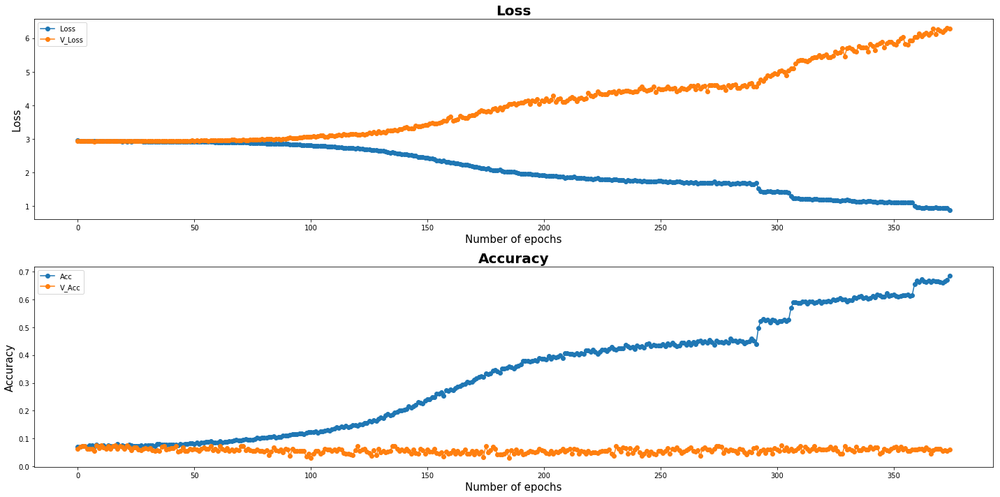

| Epoch [375] | Step [30050] | lr [0.002353] | Loss: [0.8727] | Acc: [0.6875] | Time: 0.0s
| Epoch [375] | Validation | Step [0] |  Loss: [5.9489] | Acc: [0.0781] | Time: 0.0s
| Epoch [375] | Validation | Step [1] |  Loss: [6.2154] | Acc: [0.0391] | Time: 0.0s
| Epoch [375] | Validation | Step [2] |  Loss: [6.6599] | Acc: [0.0547] | Time: 0.0s
| Epoch [375] | Validation | Step [3] |  Loss: [6.3405] | Acc: [0.0391] | Time: 0.0s


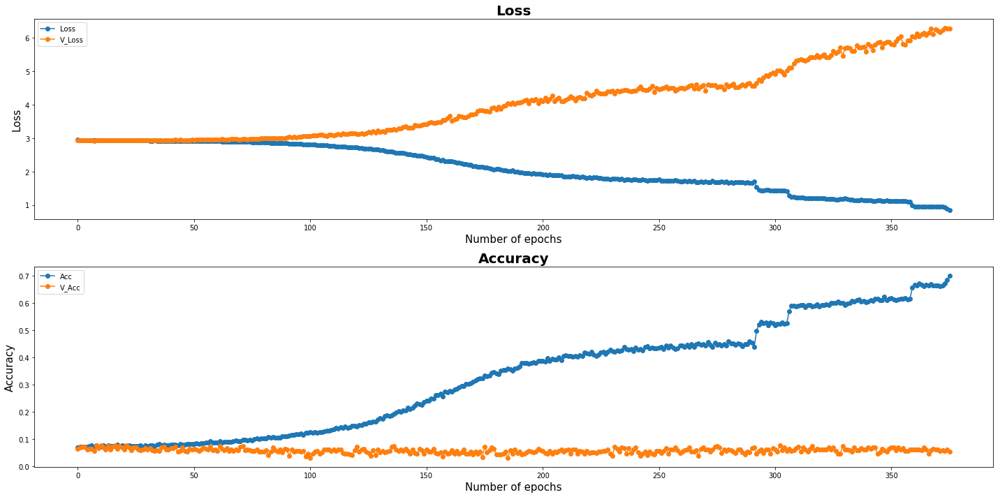

| Epoch [376] | Step [30100] | lr [0.002353] | Loss: [0.8014] | Acc: [0.7031] | Time: 0.0s
| Epoch [376] | Step [30150] | lr [0.002353] | Loss: [0.9382] | Acc: [0.5938] | Time: 0.0s
| Epoch [376] | Validation | Step [0] |  Loss: [6.5344] | Acc: [0.0625] | Time: 0.0s
| Epoch [376] | Validation | Step [1] |  Loss: [6.7147] | Acc: [0.0234] | Time: 0.0s
| Epoch [376] | Validation | Step [2] |  Loss: [6.2414] | Acc: [0.0703] | Time: 0.0s
| Epoch [376] | Validation | Step [3] |  Loss: [6.2205] | Acc: [0.0938] | Time: 0.0s


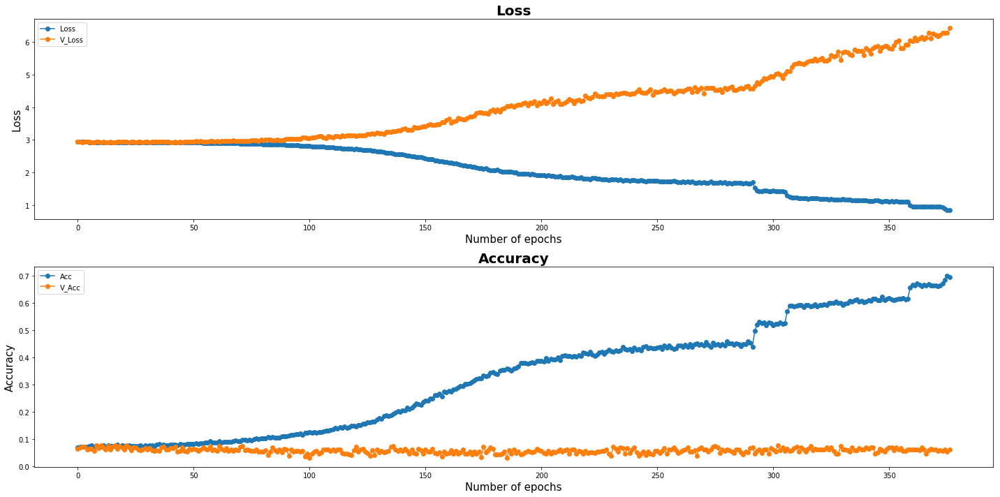

| Epoch [377] | Step [30200] | lr [0.002353] | Loss: [0.8300] | Acc: [0.6953] | Time: 0.0s
| Epoch [377] | Validation | Step [0] |  Loss: [6.2810] | Acc: [0.0312] | Time: 0.0s
| Epoch [377] | Validation | Step [1] |  Loss: [6.2370] | Acc: [0.0859] | Time: 0.0s
| Epoch [377] | Validation | Step [2] |  Loss: [6.6479] | Acc: [0.0469] | Time: 0.0s
| Epoch [377] | Validation | Step [3] |  Loss: [6.5826] | Acc: [0.0859] | Time: 0.0s


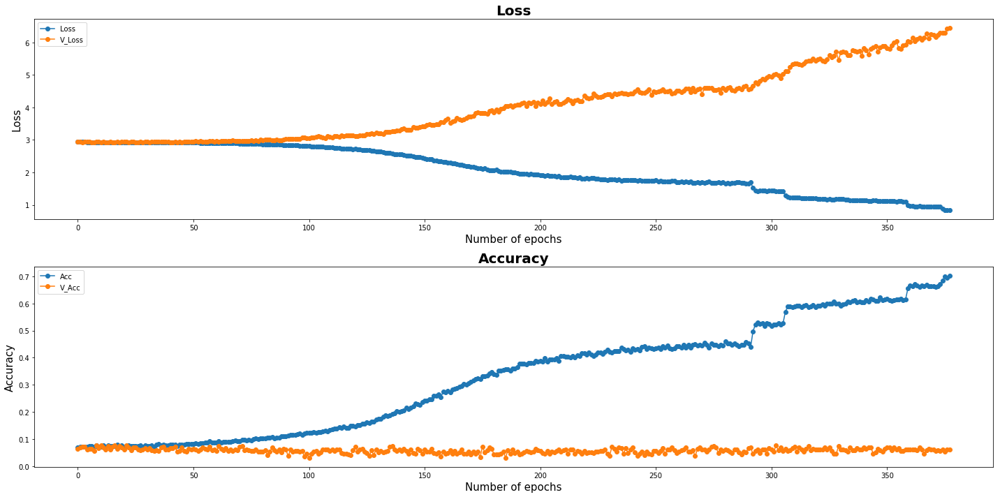

| Epoch [378] | Step [30250] | lr [0.002353] | Loss: [0.7303] | Acc: [0.7734] | Time: 0.0s
| Epoch [378] | Step [30300] | lr [0.002353] | Loss: [0.9137] | Acc: [0.6406] | Time: 0.0s
| Epoch [378] | Validation | Step [0] |  Loss: [6.8865] | Acc: [0.0469] | Time: 0.0s
| Epoch [378] | Validation | Step [1] |  Loss: [6.2327] | Acc: [0.0938] | Time: 0.0s
| Epoch [378] | Validation | Step [2] |  Loss: [6.2802] | Acc: [0.0547] | Time: 0.0s
| Epoch [378] | Validation | Step [3] |  Loss: [6.1786] | Acc: [0.0625] | Time: 0.0s


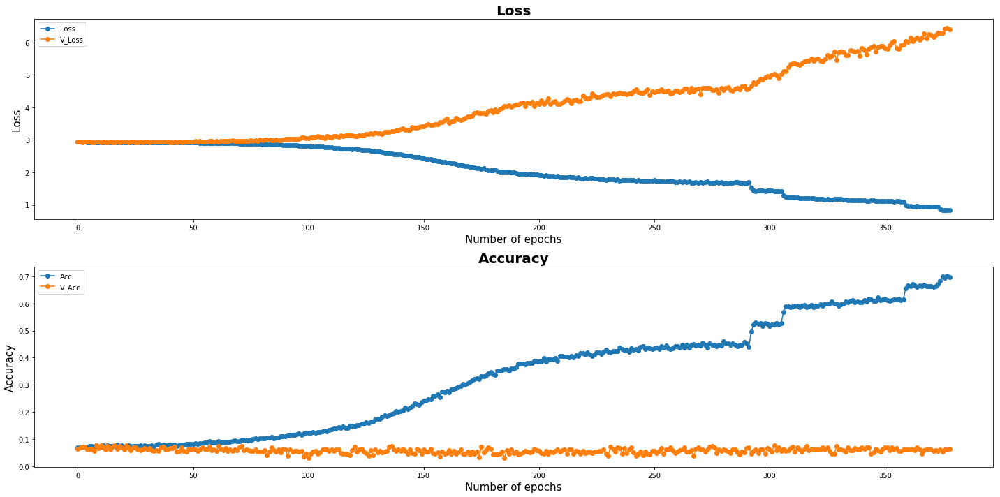

| Epoch [379] | Step [30350] | lr [0.002353] | Loss: [0.8834] | Acc: [0.6875] | Time: 0.0s
| Epoch [379] | Step [30400] | lr [0.002353] | Loss: [0.8416] | Acc: [0.6562] | Time: 0.0s
| Epoch [379] | Validation | Step [0] |  Loss: [6.0239] | Acc: [0.0859] | Time: 0.0s
| Epoch [379] | Validation | Step [1] |  Loss: [6.6408] | Acc: [0.0547] | Time: 0.0s
| Epoch [379] | Validation | Step [2] |  Loss: [6.7091] | Acc: [0.0469] | Time: 0.0s
| Epoch [379] | Validation | Step [3] |  Loss: [6.2607] | Acc: [0.0547] | Time: 0.0s


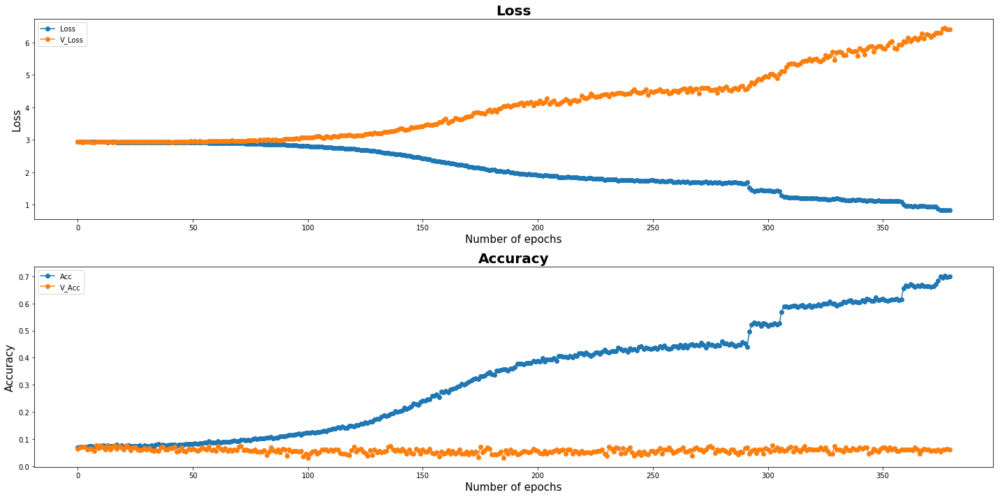

Model Saved
| Epoch [380] | Step [30450] | lr [0.002353] | Loss: [0.7857] | Acc: [0.7109] | Time: 0.0s
| Epoch [380] | Validation | Step [0] |  Loss: [5.9953] | Acc: [0.0547] | Time: 0.0s
| Epoch [380] | Validation | Step [1] |  Loss: [6.4931] | Acc: [0.0469] | Time: 0.0s
| Epoch [380] | Validation | Step [2] |  Loss: [6.3728] | Acc: [0.1172] | Time: 0.0s
| Epoch [380] | Validation | Step [3] |  Loss: [6.8735] | Acc: [0.0156] | Time: 0.0s


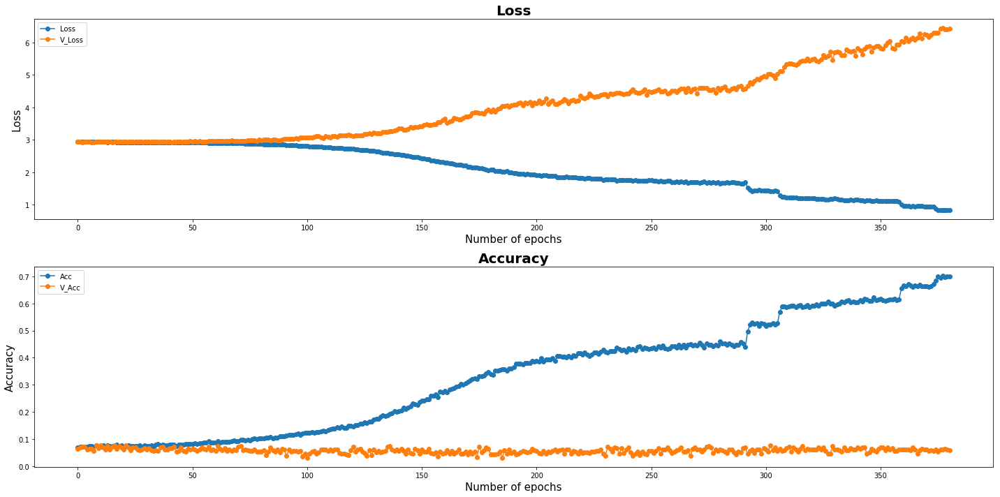

| Epoch [381] | Step [30500] | lr [0.002353] | Loss: [0.7521] | Acc: [0.6641] | Time: 0.0s
| Epoch [381] | Step [30550] | lr [0.002353] | Loss: [0.9283] | Acc: [0.6641] | Time: 0.0s
| Epoch [381] | Validation | Step [0] |  Loss: [6.5193] | Acc: [0.0703] | Time: 0.0s
| Epoch [381] | Validation | Step [1] |  Loss: [6.3658] | Acc: [0.0625] | Time: 0.0s
| Epoch [381] | Validation | Step [2] |  Loss: [6.7471] | Acc: [0.0938] | Time: 0.0s
| Epoch [381] | Validation | Step [3] |  Loss: [6.2625] | Acc: [0.0234] | Time: 0.0s


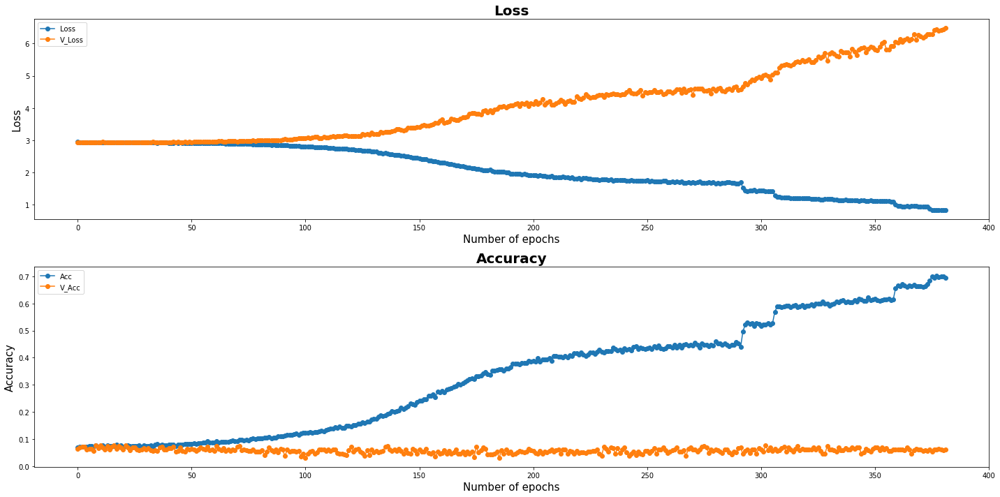

| Epoch [382] | Step [30600] | lr [0.002353] | Loss: [0.8684] | Acc: [0.6875] | Time: 0.0s
| Epoch [382] | Validation | Step [0] |  Loss: [6.7257] | Acc: [0.0703] | Time: 0.0s
| Epoch [382] | Validation | Step [1] |  Loss: [6.7399] | Acc: [0.0547] | Time: 0.0s
| Epoch [382] | Validation | Step [2] |  Loss: [6.2190] | Acc: [0.0547] | Time: 0.0s
| Epoch [382] | Validation | Step [3] |  Loss: [6.4537] | Acc: [0.0469] | Time: 0.0s


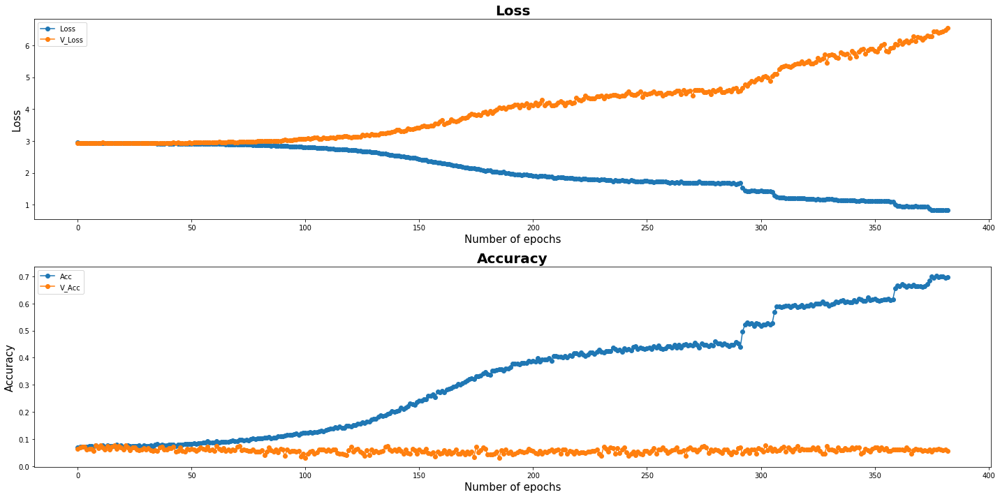

| Epoch [383] | Step [30650] | lr [0.002353] | Loss: [0.7640] | Acc: [0.6953] | Time: 0.0s
| Epoch [383] | Step [30700] | lr [0.002353] | Loss: [1.0088] | Acc: [0.6016] | Time: 0.0s
| Epoch [383] | Validation | Step [0] |  Loss: [6.6661] | Acc: [0.0469] | Time: 0.0s
| Epoch [383] | Validation | Step [1] |  Loss: [6.4959] | Acc: [0.0938] | Time: 0.0s
| Epoch [383] | Validation | Step [2] |  Loss: [6.0197] | Acc: [0.0625] | Time: 0.0s
| Epoch [383] | Validation | Step [3] |  Loss: [6.9620] | Acc: [0.0312] | Time: 0.0s


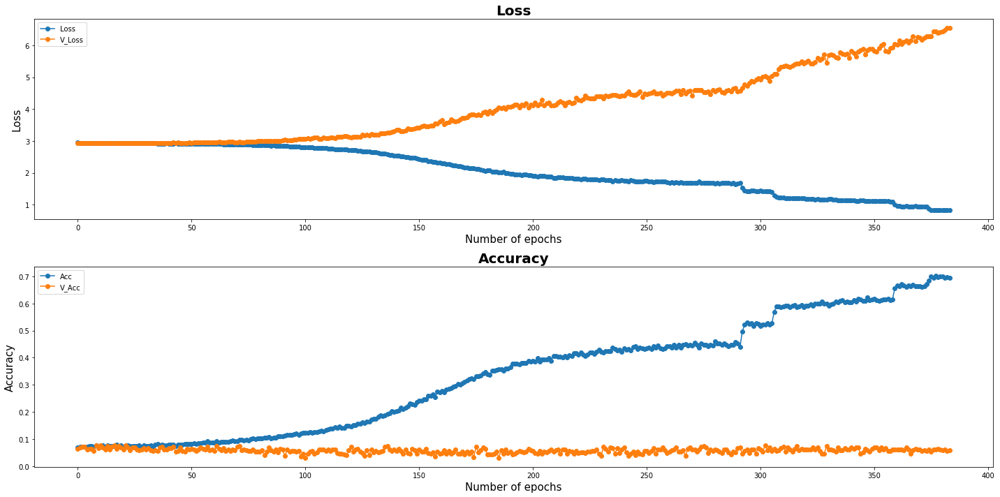

| Epoch [384] | Step [30750] | lr [0.002353] | Loss: [0.7689] | Acc: [0.7344] | Time: 0.0s
| Epoch [384] | Step [30800] | lr [0.002353] | Loss: [0.8915] | Acc: [0.6641] | Time: 0.0s
| Epoch [384] | Validation | Step [0] |  Loss: [6.5068] | Acc: [0.0781] | Time: 0.0s
| Epoch [384] | Validation | Step [1] |  Loss: [6.1675] | Acc: [0.0547] | Time: 0.0s
| Epoch [384] | Validation | Step [2] |  Loss: [6.7770] | Acc: [0.0703] | Time: 0.0s
| Epoch [384] | Validation | Step [3] |  Loss: [6.6972] | Acc: [0.0547] | Time: 0.0s


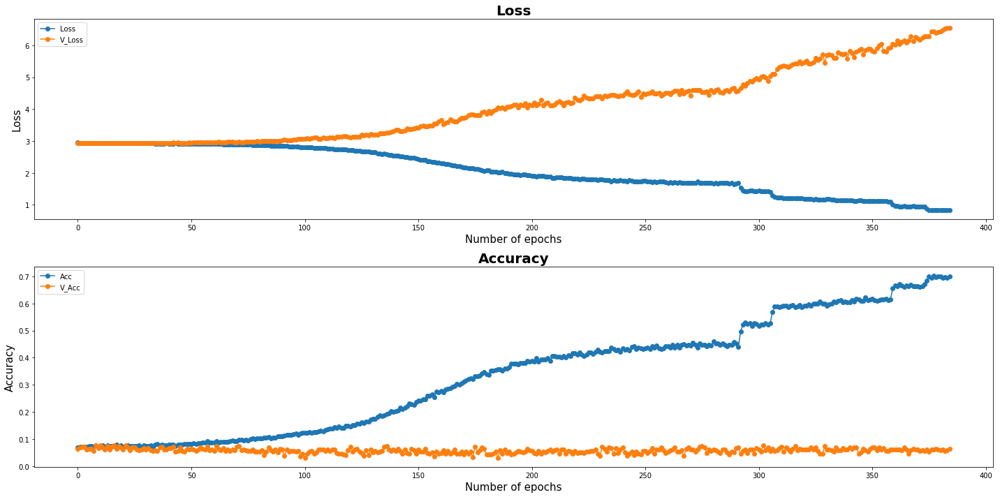

| Epoch [385] | Step [30850] | lr [0.002353] | Loss: [0.7852] | Acc: [0.7188] | Time: 0.0s
| Epoch [385] | Validation | Step [0] |  Loss: [6.8733] | Acc: [0.0469] | Time: 0.0s
| Epoch [385] | Validation | Step [1] |  Loss: [6.7759] | Acc: [0.0391] | Time: 0.0s
| Epoch [385] | Validation | Step [2] |  Loss: [6.1990] | Acc: [0.0703] | Time: 0.0s
| Epoch [385] | Validation | Step [3] |  Loss: [6.5041] | Acc: [0.0703] | Time: 0.0s


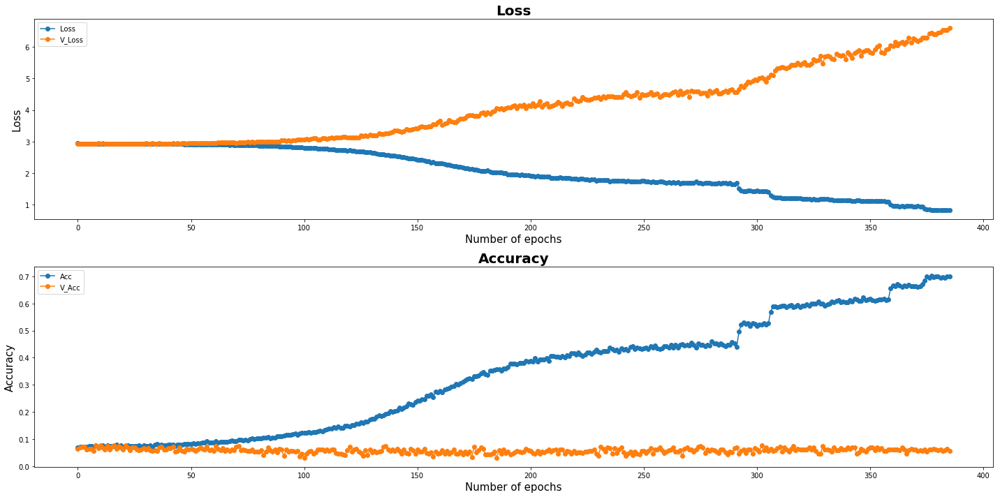

| Epoch [386] | Step [30900] | lr [0.002353] | Loss: [0.6614] | Acc: [0.8203] | Time: 0.0s
| Epoch [386] | Step [30950] | lr [0.002353] | Loss: [0.7736] | Acc: [0.7422] | Time: 0.0s
| Epoch [386] | Validation | Step [0] |  Loss: [7.4065] | Acc: [0.0234] | Time: 0.0s
| Epoch [386] | Validation | Step [1] |  Loss: [6.2198] | Acc: [0.0547] | Time: 0.0s
| Epoch [386] | Validation | Step [2] |  Loss: [5.9194] | Acc: [0.0781] | Time: 0.0s
| Epoch [386] | Validation | Step [3] |  Loss: [6.6997] | Acc: [0.0312] | Time: 0.0s


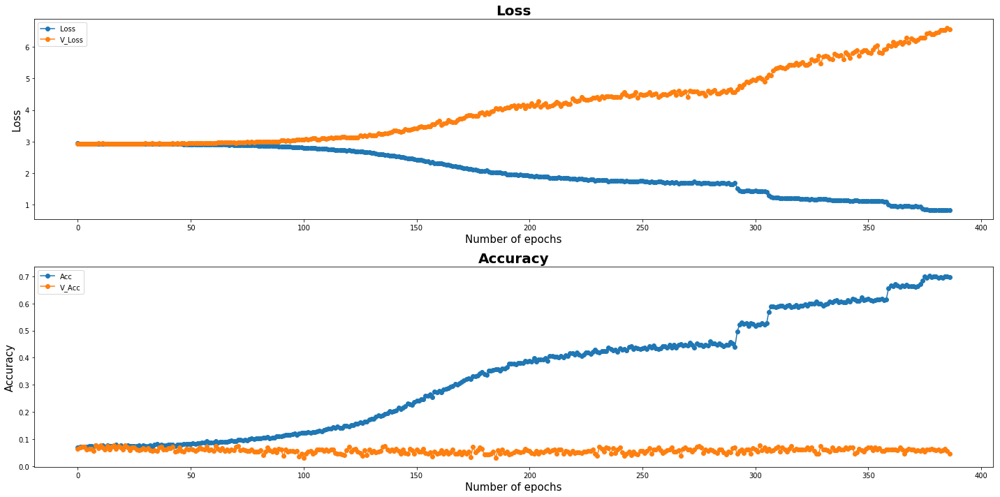

| Epoch [387] | Step [31000] | lr [0.002353] | Loss: [0.7989] | Acc: [0.7188] | Time: 0.0s
| Epoch [387] | Validation | Step [0] |  Loss: [6.4625] | Acc: [0.0547] | Time: 0.0s
| Epoch [387] | Validation | Step [1] |  Loss: [6.2602] | Acc: [0.0469] | Time: 0.0s
| Epoch [387] | Validation | Step [2] |  Loss: [6.6935] | Acc: [0.0859] | Time: 0.0s
| Epoch [387] | Validation | Step [3] |  Loss: [6.5644] | Acc: [0.0547] | Time: 0.0s


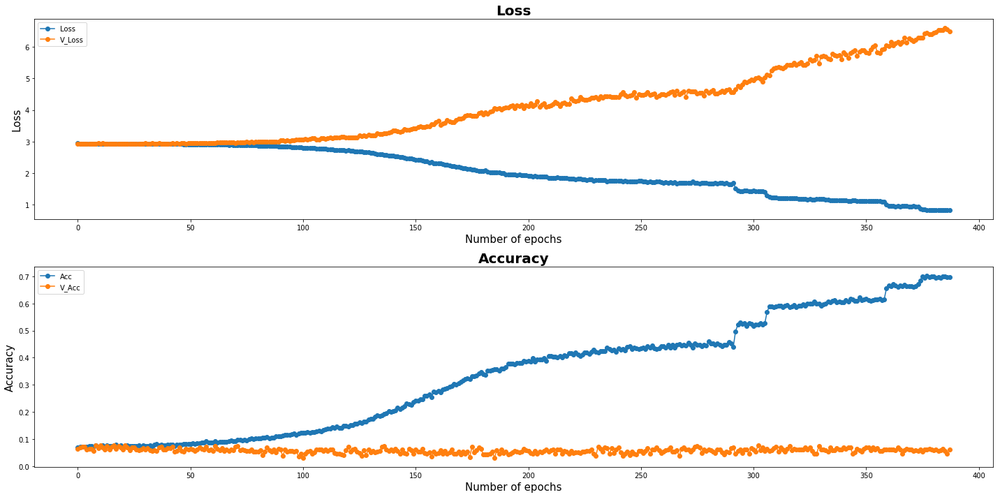

| Epoch [388] | Step [31050] | lr [0.002353] | Loss: [0.7483] | Acc: [0.7578] | Time: 0.0s
| Epoch [388] | Step [31100] | lr [0.002353] | Loss: [0.9861] | Acc: [0.6953] | Time: 0.0s
| Epoch [388] | Validation | Step [0] |  Loss: [6.0115] | Acc: [0.0938] | Time: 0.0s
| Epoch [388] | Validation | Step [1] |  Loss: [6.6480] | Acc: [0.0469] | Time: 0.0s
| Epoch [388] | Validation | Step [2] |  Loss: [6.5396] | Acc: [0.0469] | Time: 0.0s
| Epoch [388] | Validation | Step [3] |  Loss: [6.6579] | Acc: [0.0547] | Time: 0.0s


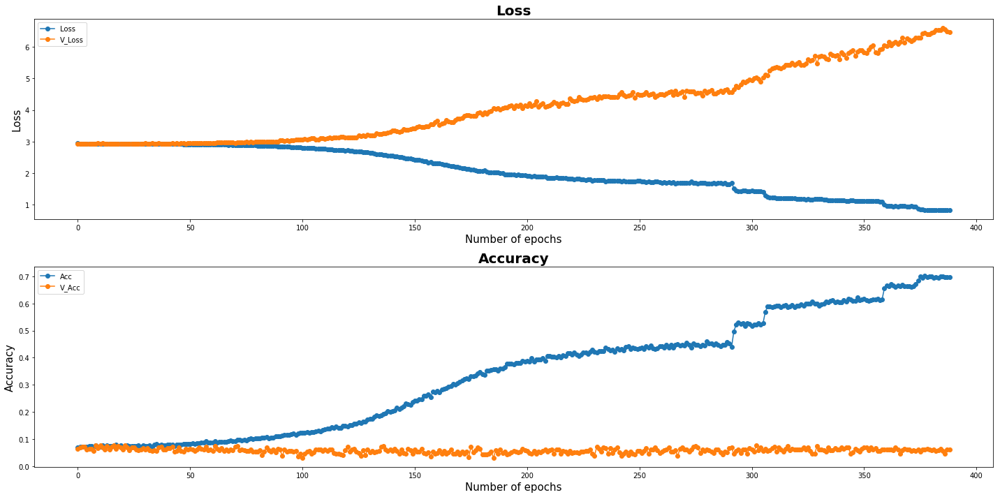

| Epoch [389] | Step [31150] | lr [0.001647] | Loss: [0.7692] | Acc: [0.7344] | Time: 0.0s
| Epoch [389] | Step [31200] | lr [0.001647] | Loss: [0.8219] | Acc: [0.6797] | Time: 0.0s
| Epoch [389] | Validation | Step [0] |  Loss: [6.6003] | Acc: [0.0547] | Time: 0.0s
| Epoch [389] | Validation | Step [1] |  Loss: [6.6704] | Acc: [0.0625] | Time: 0.0s
| Epoch [389] | Validation | Step [2] |  Loss: [6.4543] | Acc: [0.0547] | Time: 0.0s
| Epoch [389] | Validation | Step [3] |  Loss: [6.6398] | Acc: [0.0625] | Time: 0.0s


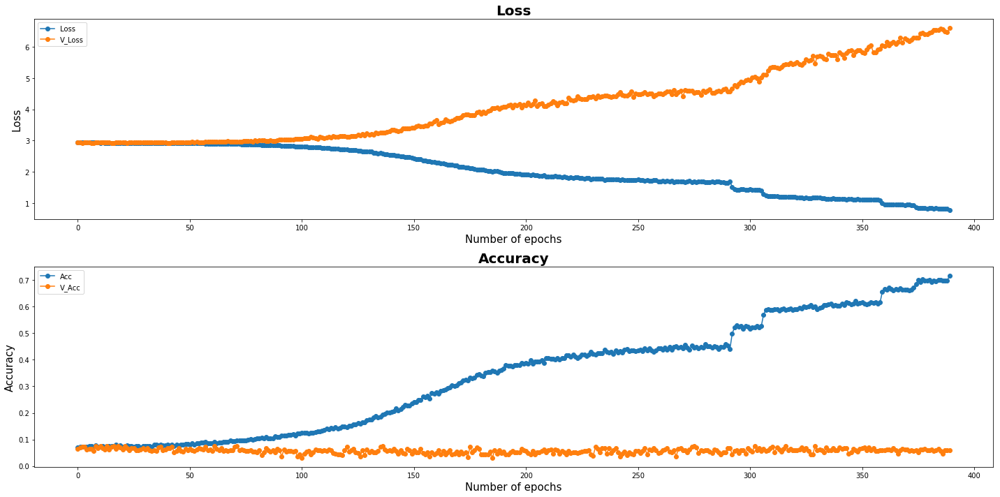

Model Saved
| Epoch [390] | Step [31250] | lr [0.001647] | Loss: [0.7360] | Acc: [0.7656] | Time: 0.0s
| Epoch [390] | Validation | Step [0] |  Loss: [6.5988] | Acc: [0.0547] | Time: 0.0s
| Epoch [390] | Validation | Step [1] |  Loss: [6.3183] | Acc: [0.0625] | Time: 0.0s
| Epoch [390] | Validation | Step [2] |  Loss: [6.7887] | Acc: [0.0391] | Time: 0.0s
| Epoch [390] | Validation | Step [3] |  Loss: [6.8720] | Acc: [0.0547] | Time: 0.0s


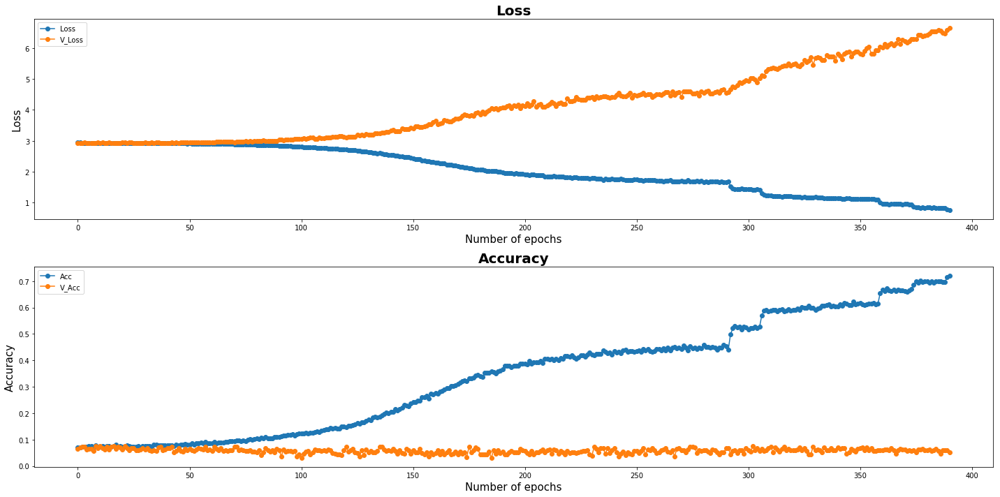

| Epoch [391] | Step [31300] | lr [0.001647] | Loss: [0.7850] | Acc: [0.7422] | Time: 0.0s
| Epoch [391] | Step [31350] | lr [0.001647] | Loss: [0.8998] | Acc: [0.6562] | Time: 0.0s
| Epoch [391] | Validation | Step [0] |  Loss: [6.9964] | Acc: [0.0391] | Time: 0.0s
| Epoch [391] | Validation | Step [1] |  Loss: [6.0384] | Acc: [0.0703] | Time: 0.0s
| Epoch [391] | Validation | Step [2] |  Loss: [6.7042] | Acc: [0.0625] | Time: 0.0s
| Epoch [391] | Validation | Step [3] |  Loss: [6.8515] | Acc: [0.0547] | Time: 0.0s


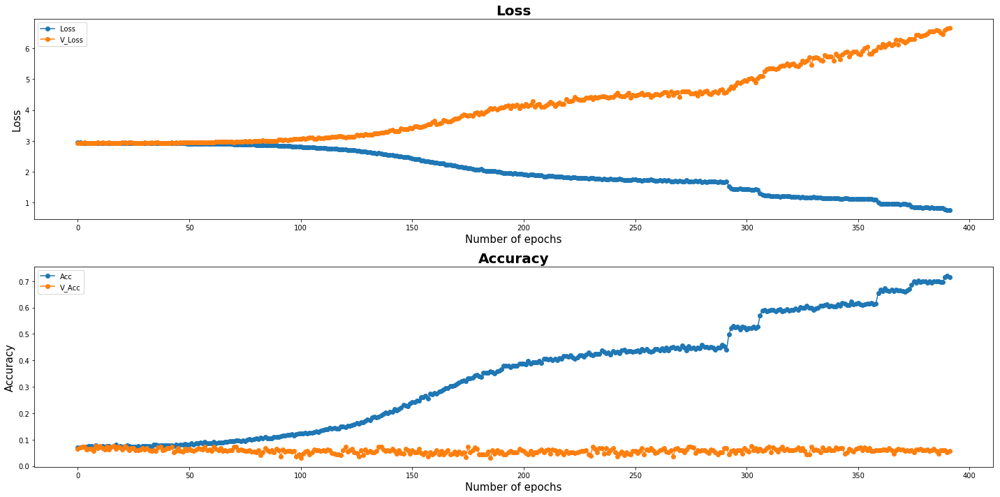

| Epoch [392] | Step [31400] | lr [0.001647] | Loss: [0.8105] | Acc: [0.6953] | Time: 0.0s
| Epoch [392] | Validation | Step [0] |  Loss: [6.6421] | Acc: [0.0547] | Time: 0.0s
| Epoch [392] | Validation | Step [1] |  Loss: [6.7563] | Acc: [0.0625] | Time: 0.0s
| Epoch [392] | Validation | Step [2] |  Loss: [6.7279] | Acc: [0.0312] | Time: 0.0s
| Epoch [392] | Validation | Step [3] |  Loss: [6.5185] | Acc: [0.0703] | Time: 0.0s


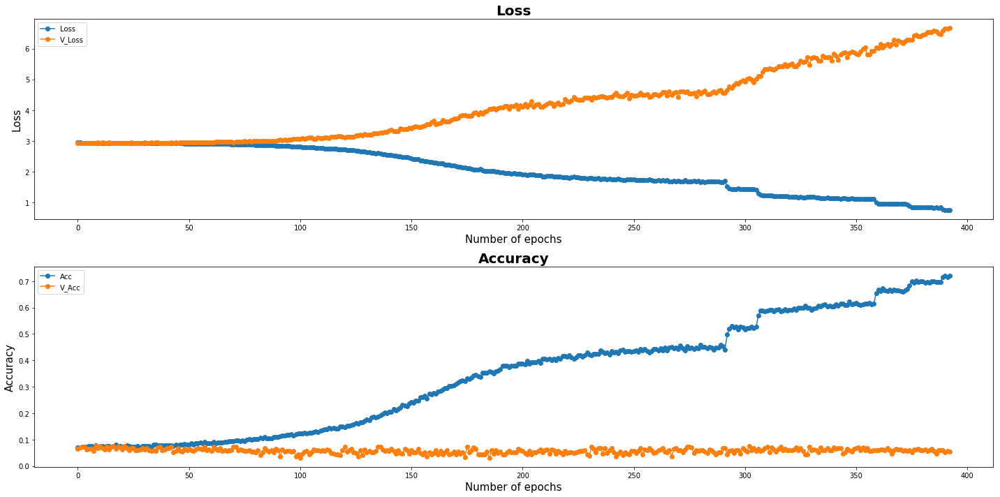

| Epoch [393] | Step [31450] | lr [0.001647] | Loss: [0.6545] | Acc: [0.7188] | Time: 0.0s
| Epoch [393] | Step [31500] | lr [0.001647] | Loss: [0.8807] | Acc: [0.6016] | Time: 0.0s
| Epoch [393] | Validation | Step [0] |  Loss: [6.3880] | Acc: [0.0625] | Time: 0.0s
| Epoch [393] | Validation | Step [1] |  Loss: [6.6880] | Acc: [0.0469] | Time: 0.0s
| Epoch [393] | Validation | Step [2] |  Loss: [7.2441] | Acc: [0.0234] | Time: 0.0s
| Epoch [393] | Validation | Step [3] |  Loss: [6.6440] | Acc: [0.0859] | Time: 0.0s


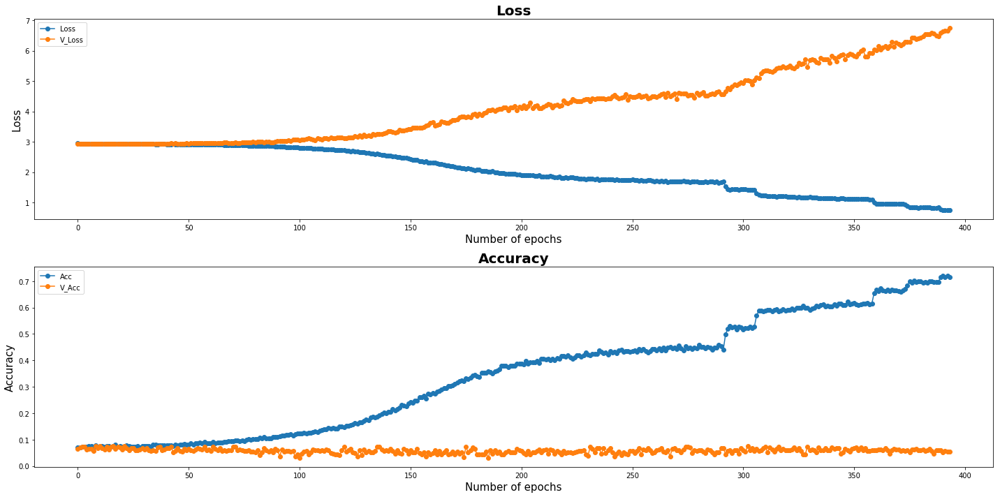

| Epoch [394] | Step [31550] | lr [0.001647] | Loss: [0.7874] | Acc: [0.7188] | Time: 0.0s
| Epoch [394] | Step [31600] | lr [0.001647] | Loss: [0.8289] | Acc: [0.7188] | Time: 0.0s
| Epoch [394] | Validation | Step [0] |  Loss: [7.0715] | Acc: [0.0469] | Time: 0.0s
| Epoch [394] | Validation | Step [1] |  Loss: [7.1675] | Acc: [0.0469] | Time: 0.0s
| Epoch [394] | Validation | Step [2] |  Loss: [6.2624] | Acc: [0.0703] | Time: 0.0s
| Epoch [394] | Validation | Step [3] |  Loss: [6.0975] | Acc: [0.0703] | Time: 0.0s


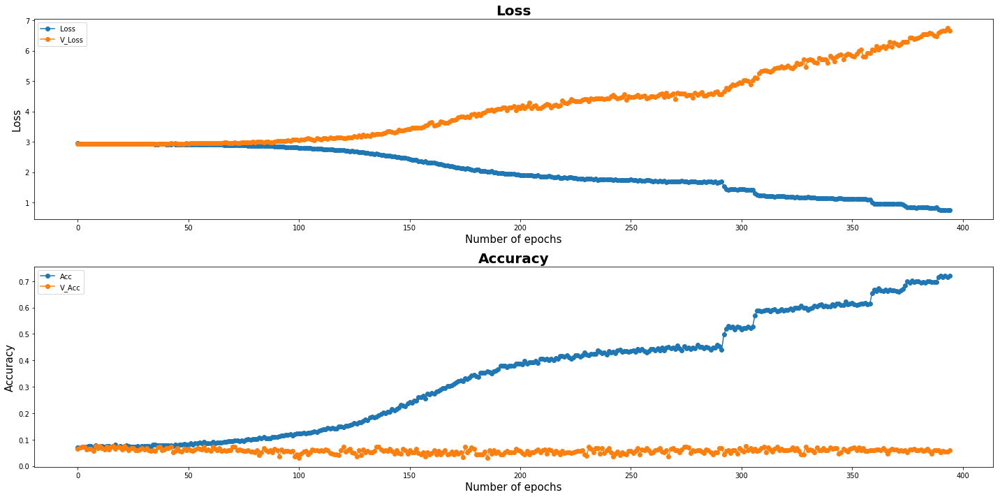

| Epoch [395] | Step [31650] | lr [0.001647] | Loss: [0.7297] | Acc: [0.7109] | Time: 0.0s
| Epoch [395] | Validation | Step [0] |  Loss: [6.5887] | Acc: [0.0625] | Time: 0.0s
| Epoch [395] | Validation | Step [1] |  Loss: [6.3550] | Acc: [0.0625] | Time: 0.0s
| Epoch [395] | Validation | Step [2] |  Loss: [7.0970] | Acc: [0.0703] | Time: 0.0s
| Epoch [395] | Validation | Step [3] |  Loss: [6.6691] | Acc: [0.0547] | Time: 0.0s


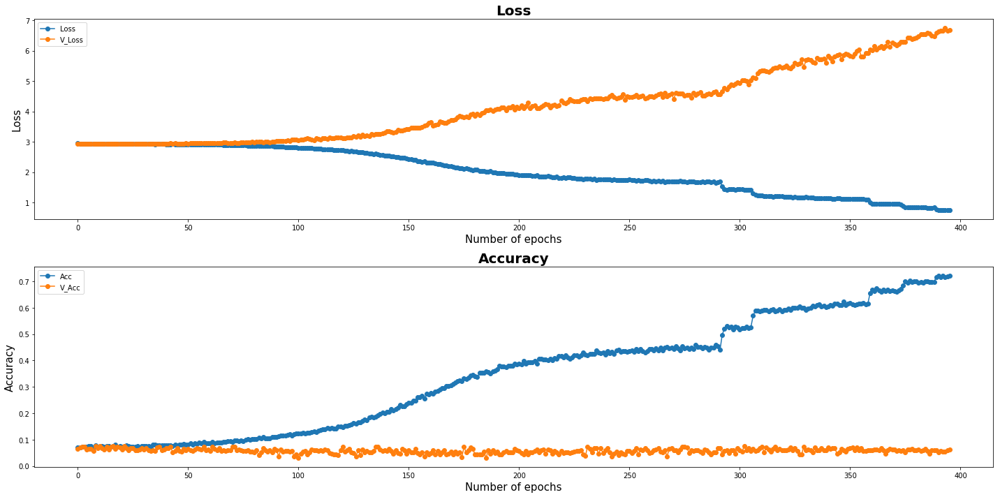

| Epoch [396] | Step [31700] | lr [0.001647] | Loss: [0.7270] | Acc: [0.7891] | Time: 0.0s
| Epoch [396] | Step [31750] | lr [0.001647] | Loss: [0.7857] | Acc: [0.6797] | Time: 0.0s
| Epoch [396] | Validation | Step [0] |  Loss: [6.6958] | Acc: [0.0469] | Time: 0.0s
| Epoch [396] | Validation | Step [1] |  Loss: [7.0377] | Acc: [0.0469] | Time: 0.0s
| Epoch [396] | Validation | Step [2] |  Loss: [6.6711] | Acc: [0.0859] | Time: 0.0s
| Epoch [396] | Validation | Step [3] |  Loss: [6.6486] | Acc: [0.0391] | Time: 0.0s


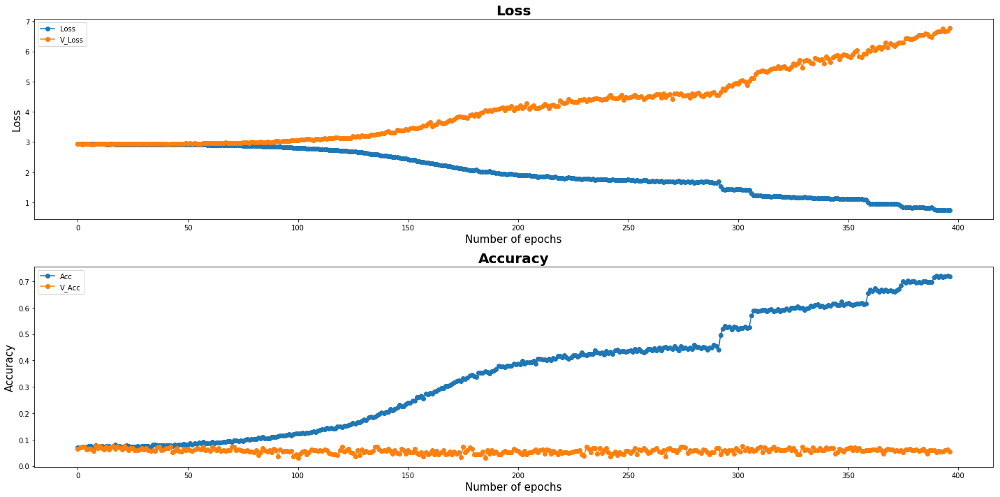

| Epoch [397] | Step [31800] | lr [0.001647] | Loss: [0.7654] | Acc: [0.6562] | Time: 0.0s
| Epoch [397] | Validation | Step [0] |  Loss: [7.1688] | Acc: [0.0391] | Time: 0.0s
| Epoch [397] | Validation | Step [1] |  Loss: [6.2537] | Acc: [0.0781] | Time: 0.0s
| Epoch [397] | Validation | Step [2] |  Loss: [6.8922] | Acc: [0.0391] | Time: 0.0s
| Epoch [397] | Validation | Step [3] |  Loss: [6.7251] | Acc: [0.0703] | Time: 0.0s


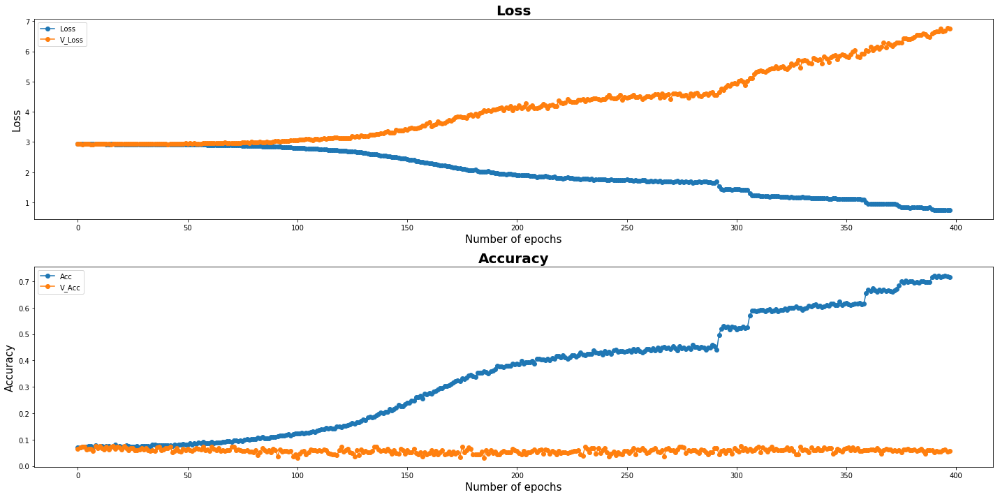

| Epoch [398] | Step [31850] | lr [0.001647] | Loss: [0.7113] | Acc: [0.7812] | Time: 0.0s
| Epoch [398] | Step [31900] | lr [0.001647] | Loss: [0.8392] | Acc: [0.6406] | Time: 0.0s
| Epoch [398] | Validation | Step [0] |  Loss: [6.7982] | Acc: [0.0703] | Time: 0.0s
| Epoch [398] | Validation | Step [1] |  Loss: [6.5328] | Acc: [0.0625] | Time: 0.0s
| Epoch [398] | Validation | Step [2] |  Loss: [6.9553] | Acc: [0.0625] | Time: 0.0s
| Epoch [398] | Validation | Step [3] |  Loss: [6.4544] | Acc: [0.0391] | Time: 0.0s


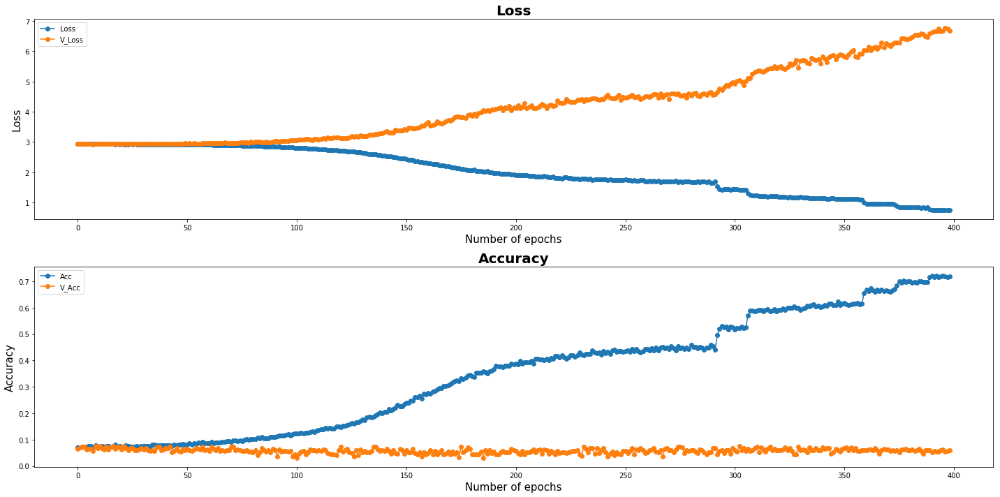

| Epoch [399] | Step [31950] | lr [0.001647] | Loss: [0.7513] | Acc: [0.7344] | Time: 0.0s
| Epoch [399] | Step [32000] | lr [0.001647] | Loss: [0.8481] | Acc: [0.6484] | Time: 0.0s
| Epoch [399] | Validation | Step [0] |  Loss: [7.3523] | Acc: [0.0312] | Time: 0.0s
| Epoch [399] | Validation | Step [1] |  Loss: [6.4770] | Acc: [0.0547] | Time: 0.0s
| Epoch [399] | Validation | Step [2] |  Loss: [6.9750] | Acc: [0.0469] | Time: 0.0s
| Epoch [399] | Validation | Step [3] |  Loss: [6.6176] | Acc: [0.0625] | Time: 0.0s


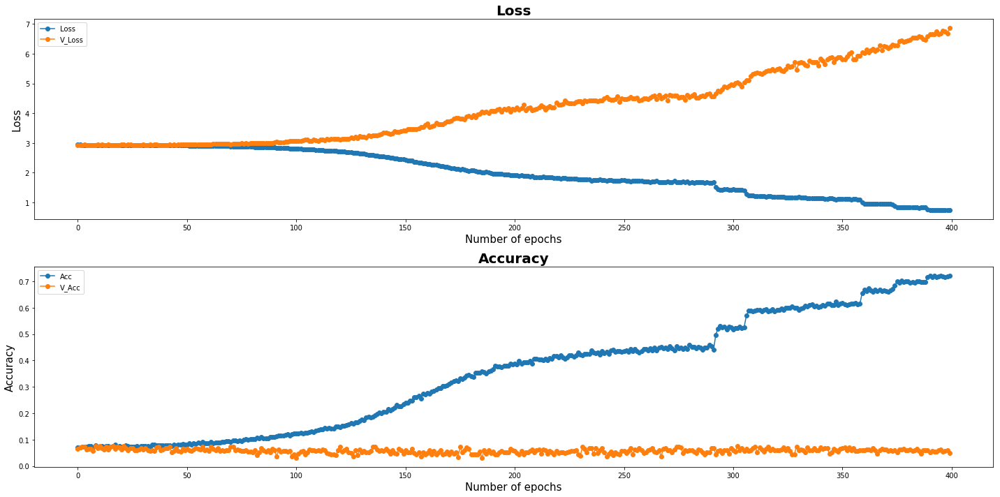

Model Saved
| Epoch [400] | Step [32050] | lr [0.001647] | Loss: [0.8606] | Acc: [0.6250] | Time: 0.0s
| Epoch [400] | Validation | Step [0] |  Loss: [7.2488] | Acc: [0.0312] | Time: 0.0s
| Epoch [400] | Validation | Step [1] |  Loss: [6.6496] | Acc: [0.0859] | Time: 0.0s
| Epoch [400] | Validation | Step [2] |  Loss: [6.4732] | Acc: [0.0391] | Time: 0.0s
| Epoch [400] | Validation | Step [3] |  Loss: [6.9792] | Acc: [0.0391] | Time: 0.0s


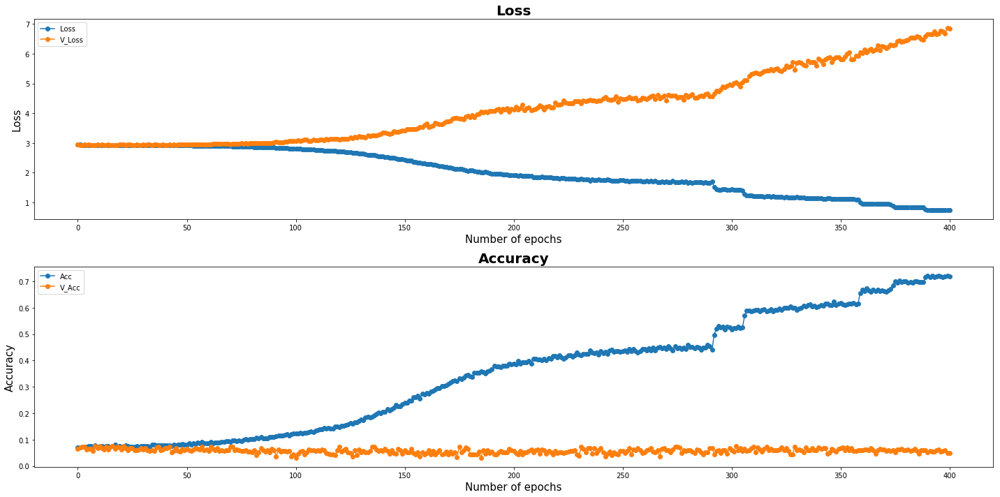

| Epoch [401] | Step [32100] | lr [0.001647] | Loss: [0.7499] | Acc: [0.7344] | Time: 0.0s
| Epoch [401] | Step [32150] | lr [0.001647] | Loss: [0.9207] | Acc: [0.6562] | Time: 0.0s
| Epoch [401] | Validation | Step [0] |  Loss: [7.0633] | Acc: [0.0391] | Time: 0.0s
| Epoch [401] | Validation | Step [1] |  Loss: [6.8310] | Acc: [0.0234] | Time: 0.0s
| Epoch [401] | Validation | Step [2] |  Loss: [6.8751] | Acc: [0.0547] | Time: 0.0s
| Epoch [401] | Validation | Step [3] |  Loss: [6.4520] | Acc: [0.0781] | Time: 0.0s


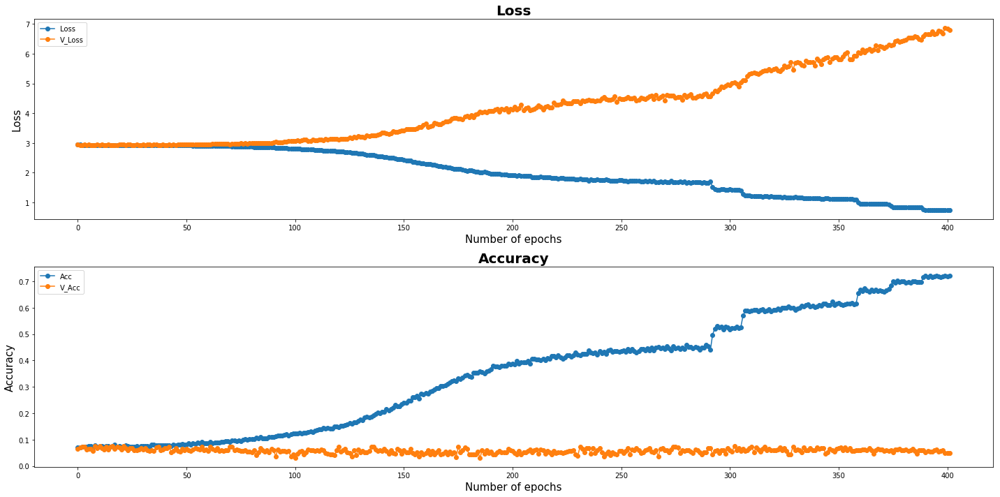

| Epoch [402] | Step [32200] | lr [0.001647] | Loss: [0.7659] | Acc: [0.7500] | Time: 0.0s
| Epoch [402] | Validation | Step [0] |  Loss: [7.1928] | Acc: [0.0312] | Time: 0.0s
| Epoch [402] | Validation | Step [1] |  Loss: [6.3357] | Acc: [0.0469] | Time: 0.0s
| Epoch [402] | Validation | Step [2] |  Loss: [6.8307] | Acc: [0.0781] | Time: 0.0s
| Epoch [402] | Validation | Step [3] |  Loss: [6.9810] | Acc: [0.0469] | Time: 0.0s


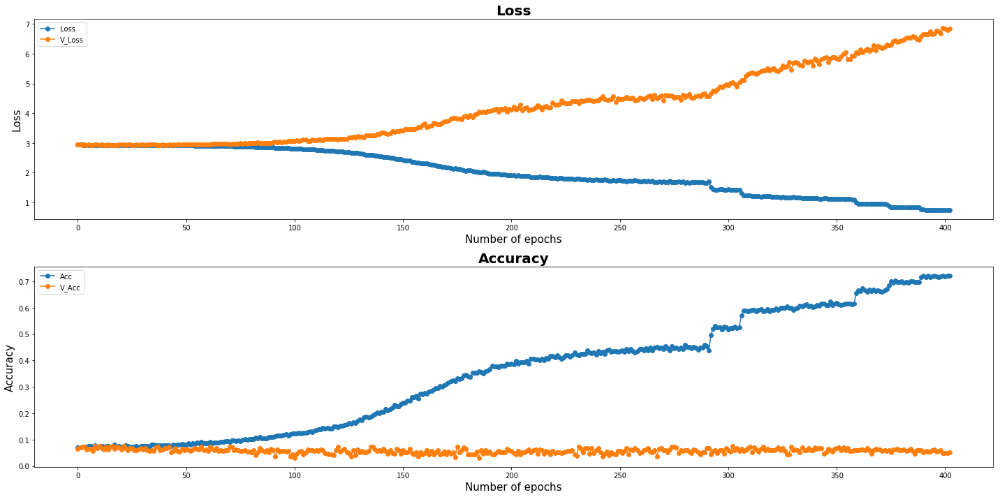

| Epoch [403] | Step [32250] | lr [0.001647] | Loss: [0.6812] | Acc: [0.7578] | Time: 0.0s
| Epoch [403] | Step [32300] | lr [0.001647] | Loss: [0.6841] | Acc: [0.7500] | Time: 0.0s
| Epoch [403] | Validation | Step [0] |  Loss: [6.7587] | Acc: [0.0312] | Time: 0.0s
| Epoch [403] | Validation | Step [1] |  Loss: [6.8558] | Acc: [0.0547] | Time: 0.0s
| Epoch [403] | Validation | Step [2] |  Loss: [6.7801] | Acc: [0.0391] | Time: 0.0s
| Epoch [403] | Validation | Step [3] |  Loss: [7.0502] | Acc: [0.0703] | Time: 0.0s


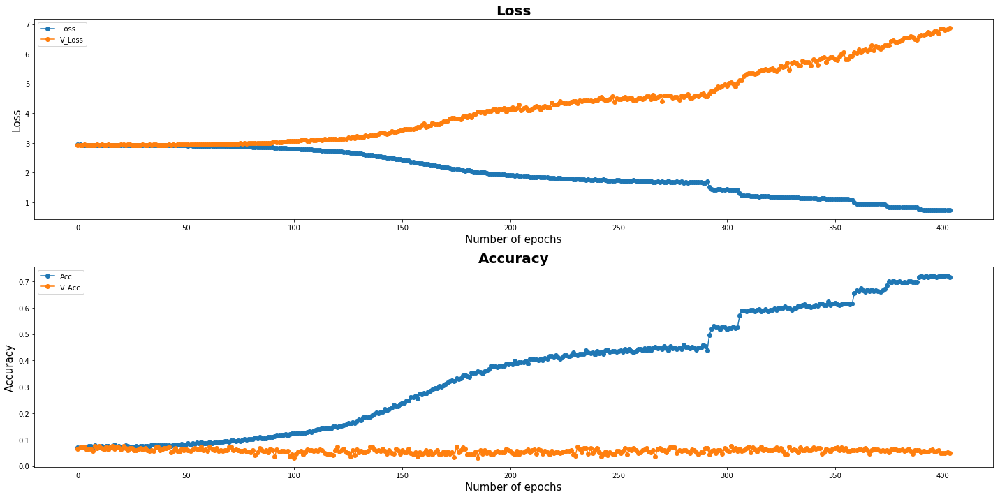

| Epoch [404] | Step [32350] | lr [0.001647] | Loss: [0.7710] | Acc: [0.6797] | Time: 0.0s
| Epoch [404] | Step [32400] | lr [0.001647] | Loss: [0.7861] | Acc: [0.6328] | Time: 0.0s
| Epoch [404] | Validation | Step [0] |  Loss: [7.1759] | Acc: [0.0625] | Time: 0.0s
| Epoch [404] | Validation | Step [1] |  Loss: [6.7887] | Acc: [0.0547] | Time: 0.0s
| Epoch [404] | Validation | Step [2] |  Loss: [6.4824] | Acc: [0.0859] | Time: 0.0s
| Epoch [404] | Validation | Step [3] |  Loss: [6.9132] | Acc: [0.0391] | Time: 0.0s


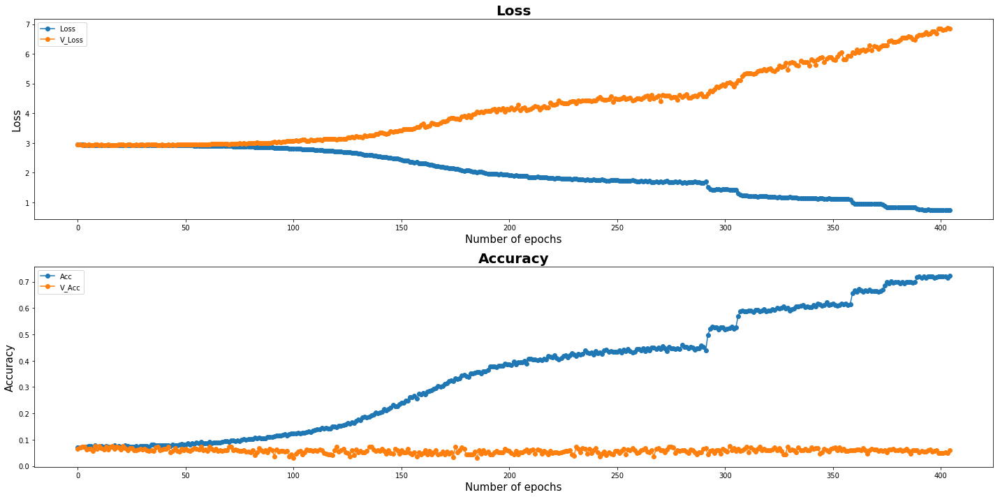

| Epoch [405] | Step [32450] | lr [0.001647] | Loss: [0.6867] | Acc: [0.7500] | Time: 0.0s
| Epoch [405] | Validation | Step [0] |  Loss: [7.2707] | Acc: [0.0469] | Time: 0.0s
| Epoch [405] | Validation | Step [1] |  Loss: [6.4574] | Acc: [0.0859] | Time: 0.0s
| Epoch [405] | Validation | Step [2] |  Loss: [7.2742] | Acc: [0.0078] | Time: 0.0s
| Epoch [405] | Validation | Step [3] |  Loss: [6.4700] | Acc: [0.0469] | Time: 0.0s


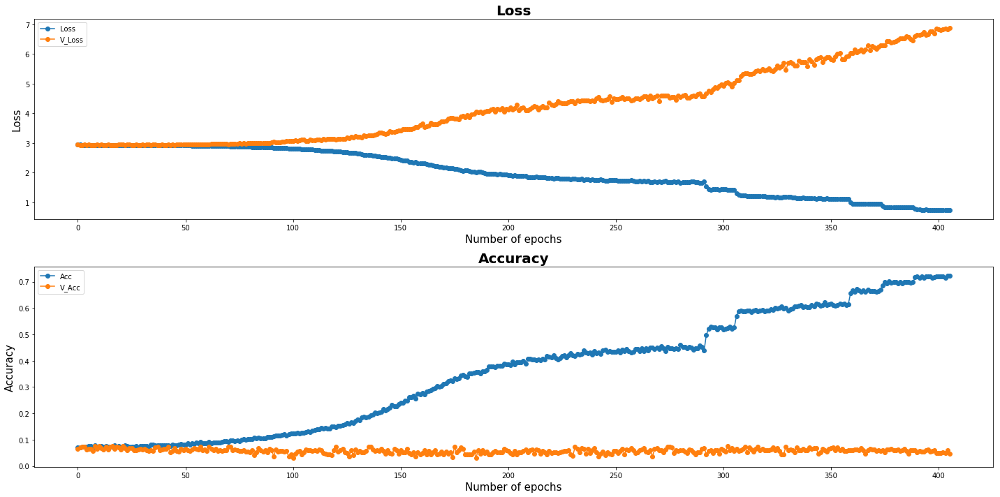

| Epoch [406] | Step [32500] | lr [0.001647] | Loss: [0.6060] | Acc: [0.7891] | Time: 0.0s
| Epoch [406] | Step [32550] | lr [0.001647] | Loss: [0.8018] | Acc: [0.6875] | Time: 0.0s
| Epoch [406] | Validation | Step [0] |  Loss: [6.7651] | Acc: [0.0547] | Time: 0.0s
| Epoch [406] | Validation | Step [1] |  Loss: [7.2089] | Acc: [0.0234] | Time: 0.0s
| Epoch [406] | Validation | Step [2] |  Loss: [7.2720] | Acc: [0.0391] | Time: 0.0s
| Epoch [406] | Validation | Step [3] |  Loss: [6.4572] | Acc: [0.0703] | Time: 0.0s


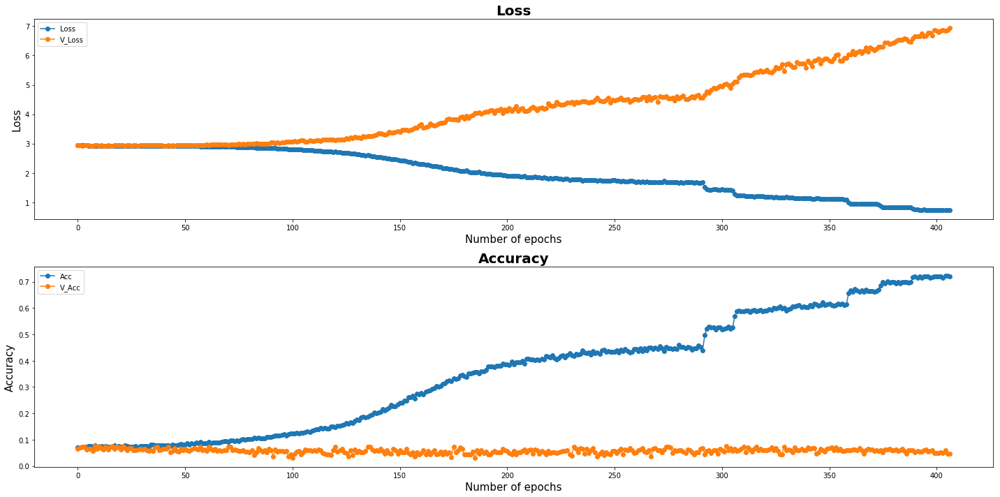

| Epoch [407] | Step [32600] | lr [0.001647] | Loss: [0.6302] | Acc: [0.7500] | Time: 0.0s
| Epoch [407] | Validation | Step [0] |  Loss: [6.7862] | Acc: [0.0547] | Time: 0.0s
| Epoch [407] | Validation | Step [1] |  Loss: [7.4158] | Acc: [0.0391] | Time: 0.0s
| Epoch [407] | Validation | Step [2] |  Loss: [6.8739] | Acc: [0.0469] | Time: 0.0s
| Epoch [407] | Validation | Step [3] |  Loss: [6.6874] | Acc: [0.0703] | Time: 0.0s


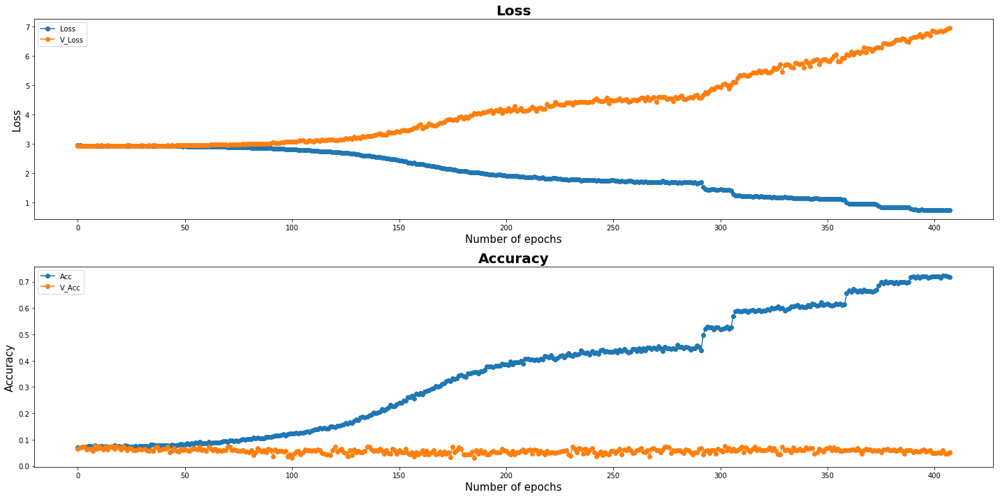

| Epoch [408] | Step [32650] | lr [0.001647] | Loss: [0.7508] | Acc: [0.7344] | Time: 0.0s
| Epoch [408] | Step [32700] | lr [0.001647] | Loss: [0.7888] | Acc: [0.6719] | Time: 0.0s
| Epoch [408] | Validation | Step [0] |  Loss: [7.4084] | Acc: [0.0234] | Time: 0.0s
| Epoch [408] | Validation | Step [1] |  Loss: [7.0747] | Acc: [0.0938] | Time: 0.0s
| Epoch [408] | Validation | Step [2] |  Loss: [6.3733] | Acc: [0.0469] | Time: 0.0s
| Epoch [408] | Validation | Step [3] |  Loss: [6.7946] | Acc: [0.0391] | Time: 0.0s


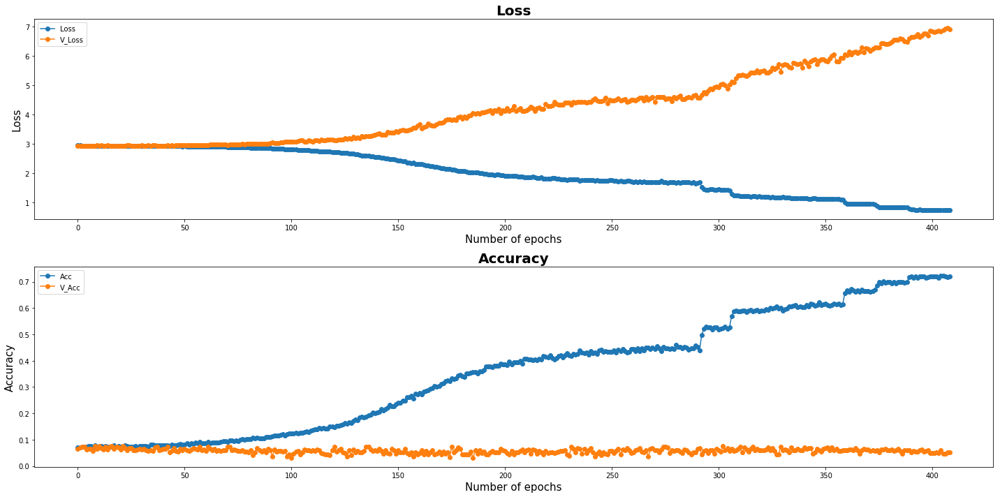

| Epoch [409] | Step [32750] | lr [0.001647] | Loss: [0.7498] | Acc: [0.7266] | Time: 0.0s
| Epoch [409] | Step [32800] | lr [0.001647] | Loss: [0.7736] | Acc: [0.6875] | Time: 0.0s
| Epoch [409] | Validation | Step [0] |  Loss: [6.9763] | Acc: [0.0625] | Time: 0.0s
| Epoch [409] | Validation | Step [1] |  Loss: [6.6177] | Acc: [0.0547] | Time: 0.0s
| Epoch [409] | Validation | Step [2] |  Loss: [7.5137] | Acc: [0.0469] | Time: 0.0s
| Epoch [409] | Validation | Step [3] |  Loss: [6.6806] | Acc: [0.0469] | Time: 0.0s


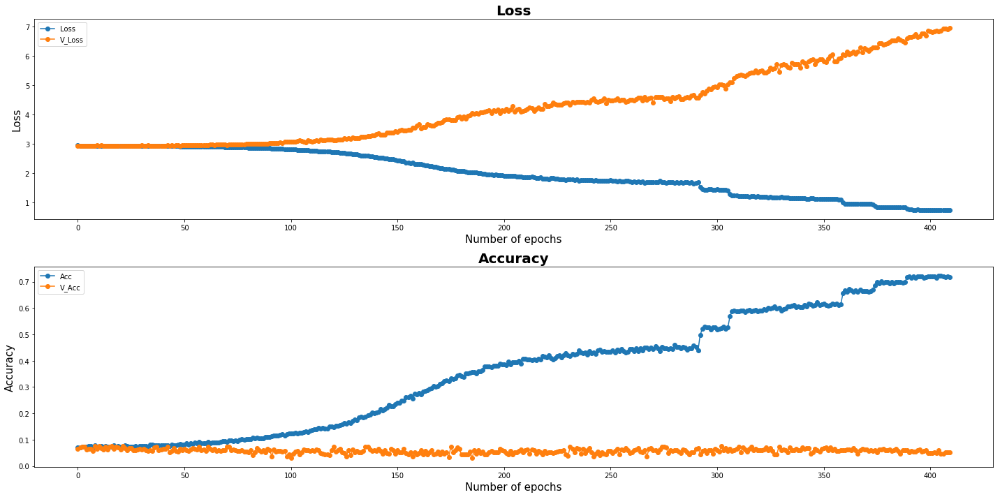

Model Saved
| Epoch [410] | Step [32850] | lr [0.001647] | Loss: [0.7291] | Acc: [0.7500] | Time: 0.0s
| Epoch [410] | Validation | Step [0] |  Loss: [6.9222] | Acc: [0.0703] | Time: 0.0s
| Epoch [410] | Validation | Step [1] |  Loss: [6.6643] | Acc: [0.0547] | Time: 0.0s
| Epoch [410] | Validation | Step [2] |  Loss: [7.0513] | Acc: [0.0312] | Time: 0.0s
| Epoch [410] | Validation | Step [3] |  Loss: [7.0854] | Acc: [0.0781] | Time: 0.0s


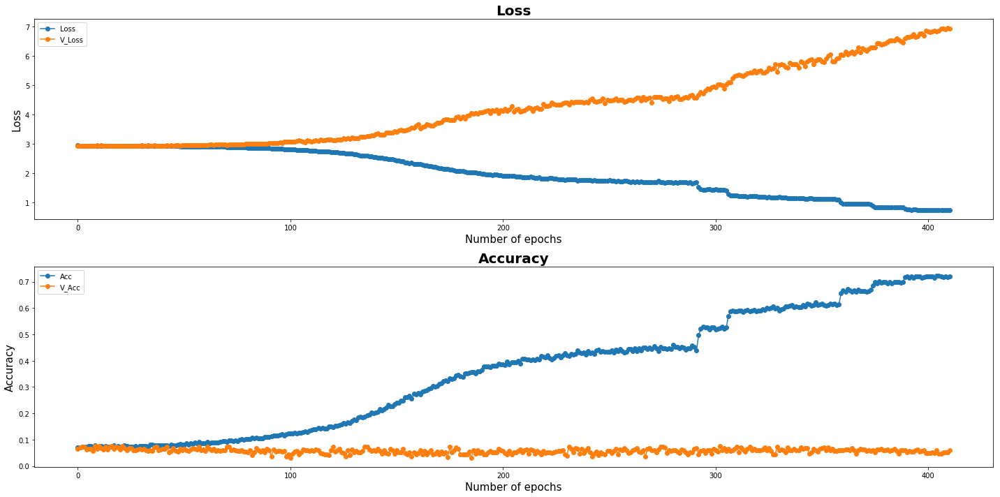

| Epoch [411] | Step [32900] | lr [0.001647] | Loss: [0.7301] | Acc: [0.7109] | Time: 0.0s
| Epoch [411] | Step [32950] | lr [0.001647] | Loss: [0.7831] | Acc: [0.6719] | Time: 0.0s
| Epoch [411] | Validation | Step [0] |  Loss: [6.5491] | Acc: [0.0547] | Time: 0.0s
| Epoch [411] | Validation | Step [1] |  Loss: [7.1370] | Acc: [0.0469] | Time: 0.0s
| Epoch [411] | Validation | Step [2] |  Loss: [6.6555] | Acc: [0.0469] | Time: 0.0s
| Epoch [411] | Validation | Step [3] |  Loss: [7.4196] | Acc: [0.0625] | Time: 0.0s


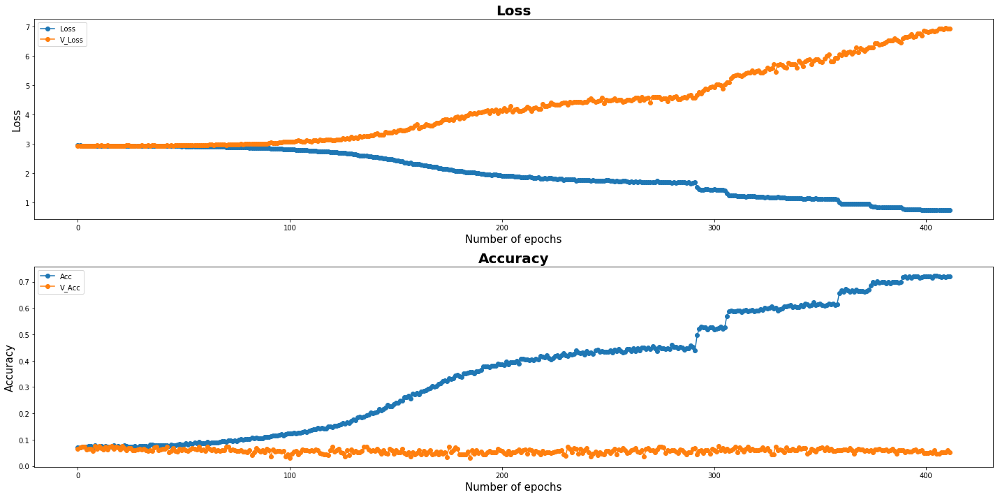

| Epoch [412] | Step [33000] | lr [0.001647] | Loss: [0.7533] | Acc: [0.7188] | Time: 0.0s
| Epoch [412] | Validation | Step [0] |  Loss: [5.9018] | Acc: [0.0547] | Time: 0.0s
| Epoch [412] | Validation | Step [1] |  Loss: [7.0241] | Acc: [0.0469] | Time: 0.0s
| Epoch [412] | Validation | Step [2] |  Loss: [7.0640] | Acc: [0.0703] | Time: 0.0s
| Epoch [412] | Validation | Step [3] |  Loss: [7.7289] | Acc: [0.0469] | Time: 0.0s


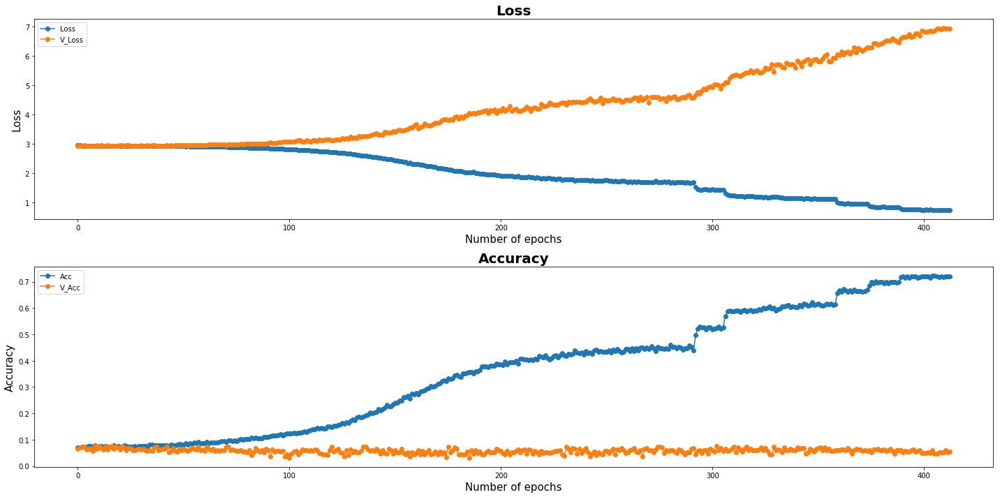

| Epoch [413] | Step [33050] | lr [0.001647] | Loss: [0.7162] | Acc: [0.7578] | Time: 0.0s
| Epoch [413] | Step [33100] | lr [0.001647] | Loss: [0.7174] | Acc: [0.7109] | Time: 0.0s
| Epoch [413] | Validation | Step [0] |  Loss: [6.1917] | Acc: [0.0625] | Time: 0.0s
| Epoch [413] | Validation | Step [1] |  Loss: [7.1938] | Acc: [0.0469] | Time: 0.0s
| Epoch [413] | Validation | Step [2] |  Loss: [7.4543] | Acc: [0.0391] | Time: 0.0s
| Epoch [413] | Validation | Step [3] |  Loss: [7.1908] | Acc: [0.0625] | Time: 0.0s


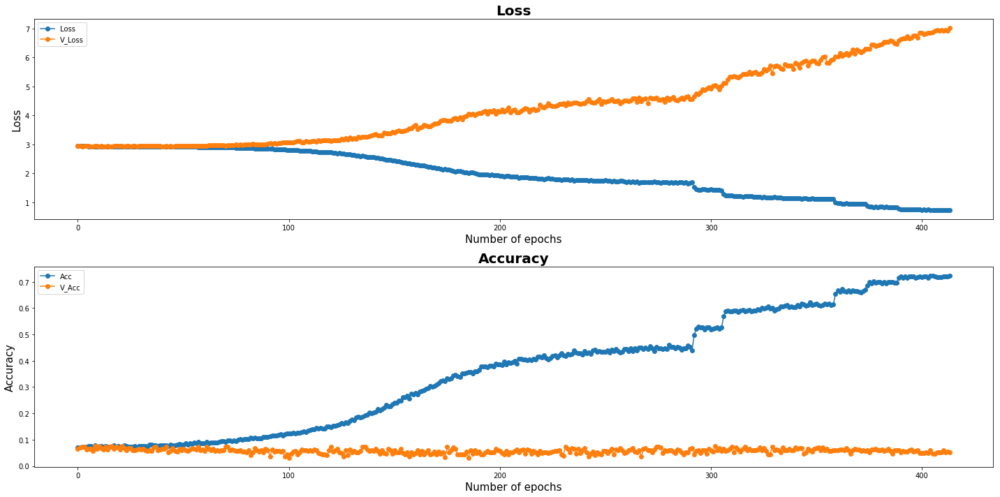

| Epoch [414] | Step [33150] | lr [0.001647] | Loss: [0.6809] | Acc: [0.7734] | Time: 0.0s
| Epoch [414] | Step [33200] | lr [0.001647] | Loss: [0.8855] | Acc: [0.6719] | Time: 0.0s
| Epoch [414] | Validation | Step [0] |  Loss: [6.6804] | Acc: [0.0547] | Time: 0.0s
| Epoch [414] | Validation | Step [1] |  Loss: [6.8599] | Acc: [0.0547] | Time: 0.0s
| Epoch [414] | Validation | Step [2] |  Loss: [7.2186] | Acc: [0.0391] | Time: 0.0s
| Epoch [414] | Validation | Step [3] |  Loss: [7.2463] | Acc: [0.0703] | Time: 0.0s


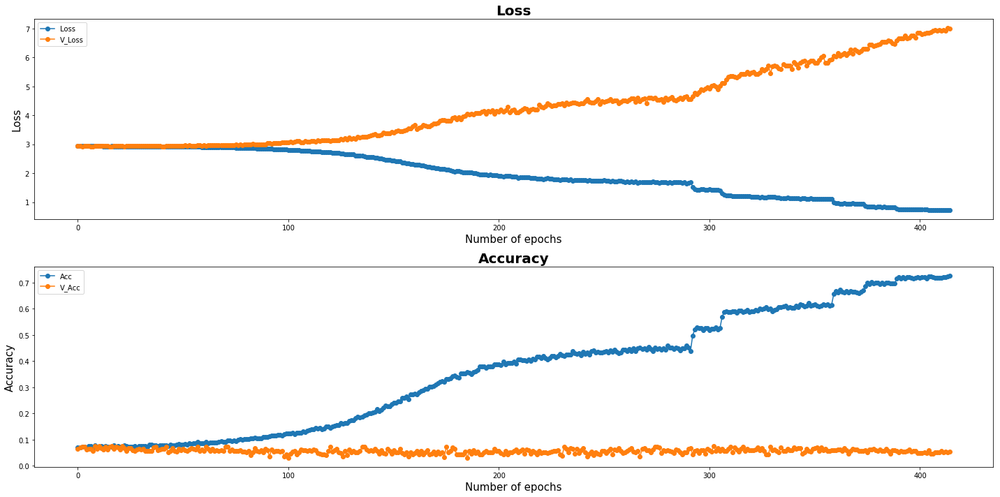

| Epoch [415] | Step [33250] | lr [0.001647] | Loss: [0.7247] | Acc: [0.7109] | Time: 0.0s
| Epoch [415] | Validation | Step [0] |  Loss: [7.1538] | Acc: [0.0312] | Time: 0.0s
| Epoch [415] | Validation | Step [1] |  Loss: [6.9523] | Acc: [0.0391] | Time: 0.0s
| Epoch [415] | Validation | Step [2] |  Loss: [6.5027] | Acc: [0.0781] | Time: 0.0s
| Epoch [415] | Validation | Step [3] |  Loss: [7.1882] | Acc: [0.0391] | Time: 0.0s


In [ ]:
while epoch < 1000:
    Pred.train()
    temp_loss = []
    temp_acc = []
    for i, (X_, X_len_, y_) in enumerate(train_loader):
#         scheduler.step()
        start_t = time.time()
        optimizer.zero_grad()
        loss, acc = Pred.get_loss(X_, X_len_, y_)
        temp_loss.append(loss.item())
        temp_acc.append(acc)
        
        
        loss.backward()
        optimizer.step()
        end_t = time.time()
        all_step += 1
        if all_step % 50 == 0:
            print('| Epoch [%d] | Step [%d] | lr [%.6f] | Loss: [%.4f] | Acc: [%.4f] | Time: %.1fs' %\
                  ( epoch, all_step, optimizer.param_groups[0]['lr'], loss.item() , acc ,
                    end_t - start_t))
        
    
    train_hist['Loss'].append(sum(temp_loss)/len(temp_loss))
    train_hist['Acc'].append(sum(temp_acc)/len(temp_acc))
    
    scheduler.step(train_hist['Acc'][-1])
    
    if i % 1 == 0:
        Pred.eval()
        temp_loss = []
        temp_acc = []
        for j, (V, V_len, V_y) in enumerate(valid_loader):
            start_t = time.time()
            
            loss, acc = Pred.get_loss(V, V_len, V_y)
            temp_loss.append(loss.item())
            temp_acc.append(acc)
            
            end_t = time.time()
            print('| Epoch [%d] | Validation | Step [%d] |  Loss: [%.4f] | Acc: [%.4f] | Time: %.1fs' %\
                  ( epoch, j, loss.item() , acc ,end_t - start_t))
            
            if j > args.val_steps:
                break
                
            if args.early_stop_acc is not None and acc.item() > args.early_stop_acc: # Stop early
                print('Early Stop')
                raise StopIteration
                
        train_hist['V_Loss'].append(sum(temp_loss)/len(temp_loss))
        train_hist['V_Acc'].append(sum(temp_acc)/len(temp_acc))
    
    if epoch >= 1:
        plot_train_hist(train_hist, 'Predicting')
            
    epoch += 1
    
    if epoch % 10 == 0 and epoch != 0:
        Pred.model_save(epoch)
        
    if all_step >= 100000:
        raise StopIteration

In [ ]:
args.pred

In [ ]:
# the larger model has a better ability on genralization? 

In [ ]:
args.y